In [1]:
import numpy as np
import math
import matplotlib.pyplot as plt
import cvxpy as cp
from numpy.linalg import norm
import tensorflow as tf
import tensorflow.keras
from tensorflow.keras.layers import Dense, Activation, Dropout
from tensorflow.keras import Sequential
from tensorflow.keras.models import load_model
from tensorflow.keras.optimizers import Adam
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error
from tensorflow.keras.callbacks import LearningRateScheduler
from datetime import datetime

In [2]:
mean_rate_ur = 0.6     #mean arrival rate of each uRLLC user [packs/frame]
mean_rate_em = 5       #mean arrival rate of each embb user [packs/frame]
length = 10000         #number of observations
T = 1000               #number of frames
corr_factor = 0.95     #correlation factor for time_series
rho = 0.99             #correlation factor for channel
U_ur = 2               #number of uRLLC users
U_em = 2               #number of eMBB users
U = U_ur+U_em          #total number of users
M = 3                  #number of RUs
k_0 = 8                #number of antenna in RU
K = 10**0.5            #Rician factor (db)
h_0 = 1                #Determinastic term of channel (LoS)
BW = 10e+03            #Bandwidth of RUs (MHz)
P_max = 10**4.3        #maximum RU transmit power (43dBm)
P_e = 10**-3           #error probibilaty
N0 = 1e-11             #Power of AWGN noise (W)
B_G = 180              #Guard band (kHz)
beta1 = 360            #RB’s BW of numerology index 1 (kHz)
beta2 = 720            #RB’s BW of numerology index 2 (kHz)
delta1 = 0.25          #mini-slot’s duration of numerology index 1 (ms)
delta2 = 0.125         #mini-slot’s duration of numerology index 2 (ms)
Delta = 1              #each frame duration (ms)
R_th = 1e+03           #minimum requirenment throughput for embb (1Mbps)
Z_ur = 32*8            #urllc packet size (32 B)
Z_em = 125*8           #embb packet size (125KB)
D_ur = 0.5             #delay requirenment of urllc (ms)
G0 = 10**(5/10)        #minimum SNR
Q_max = 1e+08          #Checking the buffer
R0 = 5e+03             #Refrence for data rate
t0 = 1e-02             #Refrence for latency
f1, f2 = 5, 2
t1, t2 = 2, 4

dim2, dim1 = M*U_ur*f2*t2, M*U_em*f1*t1

nA = dim2+dim1
nS = nA + U_ur

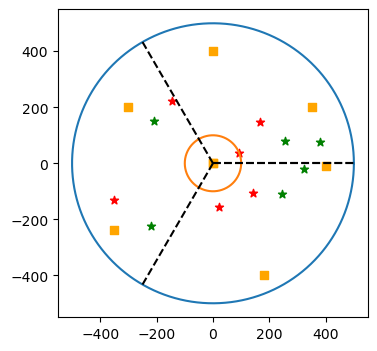

In [3]:
# Call topology 
%run topology.ipynb
dis_ur, dis_em = topology(6, 6)

In [ ]:
# predict lambda
%run LSTM.ipynb
actual_lambda_ur, actual_lambda_em, predicted_lambda_ur, predicted_lambda_em = rAPP1(U_em, U_ur, mean_rate_ur, mean_rate_em, corr_factor, length)

In [ ]:
np.savetxt("actual_lambda_ur.csv", actual_lambda_ur, delimiter=',')
np.savetxt("actual_lambda_em.csv", actual_lambda_em, delimiter=',')
np.savetxt("predicted_lambda_ur.csv", predicted_lambda_ur, delimiter=',')
np.savetxt("predicted_lambda_em.csv", predicted_lambda_em, delimiter=',')

In [ ]:
predicted_lambda_ur = np.loadtxt("predicted_lambda_ur.csv", delimiter=',')
predicted_lambda_em = np.loadtxt("predicted_lambda_em.csv", delimiter=',')

In [4]:
predicted_lambda_ur = np.ones((T,U_ur))*3
predicted_lambda_em = np.ones((T,U_em))*10
actual_lambda_ur = np.ones((T,U_ur))*3
actual_lambda_em = np.ones((T,U_em))*10

In [8]:
class ReplayBuffer(object):
    
    def __init__(self, max_size, input_dims2, n_actions2):
        self.mem_size = max_size
        self.mem_cntr = 0
        self.state_memory2 = np.zeros((self.mem_size,input_dims2))
        self.new_state_memory2 = np.zeros((self.mem_size,input_dims2))
        self.action_memory2 = np.zeros((self.mem_size,n_actions2)) 
        self.reward_memory2 = np.zeros(self.mem_size)
        self.terminal_memory = np.zeros(self.mem_size) 
        
    def store_transition(self, state2, action2, reward2, state_2, done): 
        index = self.mem_cntr % self.mem_size 
        self.state_memory2[index] = state2
        self.new_state_memory2[index] = state_2
        self.action_memory2[index] = action2
        self.reward_memory2[index] = reward2
        self.terminal_memory[index] = 1 - int(done) 
        self.mem_cntr += 1
        
    def sample_buffer(self, batch_size):
        max_mem = min(self.mem_cntr, self.mem_size)
        batch = np.random.choice(max_mem, batch_size, replace = False)
        states2 = self.state_memory2[batch]
        new_states2 = self.new_state_memory2[batch]
        actions2 = self.action_memory2[batch]
        rewards2 = self.reward_memory2[batch]
        terminal = self.terminal_memory[batch]
        
        return states2, actions2, rewards2, new_states2, terminal

def binary_softmax2(x):
    b_size = tf.shape(x)[0]
    #tf.shape(x)[1]==>nA
    x2, x1 = x[:,0:dim2], x[:,dim2::]
    y2, y1 = tf.zeros_like(x2), tf.zeros_like(x1)       
    for i in range(0, dim2, M*U_ur):
        pair = x2[:, i:i+M*U_ur]
        e_pair = tf.exp(pair - tf.reduce_max(pair, axis=1, keepdims=True))
        softmax_pair = e_pair / tf.reduce_sum(e_pair, axis=1, keepdims=True)
        for j in range(M*U_ur):
            indices = tf.stack([tf.range(b_size), tf.fill([b_size], i+j)], axis=1)
            y2 = tf.tensor_scatter_nd_update(y2, indices, softmax_pair[:, j])
    for i in range(0, dim1, M*U_em):
        pair = x1[:, i:i+M*U_em]
        e_pair = tf.exp(pair - tf.reduce_max(pair, axis=1, keepdims=True))
        softmax_pair = e_pair / tf.reduce_sum(e_pair, axis=1, keepdims=True)
        for j in range(M*U_em):
            indices = tf.stack([tf.range(b_size), tf.fill([b_size], i+j)], axis=1)
            y1 = tf.tensor_scatter_nd_update(y1, indices, softmax_pair[:, j])
    y2_ = tf.reshape(y2, (b_size,dim2)) 
    y1_ = tf.reshape(y1, (b_size,dim1)) 
    y = tf.concat([y2_, y1_], axis=1)
    return y

def build_ddqn2(lr, n_actions2, input_dims2):
    model = Sequential()
    model.add(Dense(units=100, input_shape=(input_dims2,) , activation='relu'))
    #model.add(Dense(units=50, activation='relu'))
    model.add(Dense(units=n_actions2, activation= binary_softmax2))
    model.compile(optimizer=Adam(learning_rate=lr), loss = 'binary_crossentropy')
    return model 
        
class DDQNAgent_frq(object):
    def __init__(self, alpha, gamma, epsilon, batch_size, n_actions2, input_dims2,
                  epsilon_end=0.01, mem_size=100000, fname2='agent_time.h5'):
        self.alpha = alpha
        self.gamma = gamma
        self.n_actions2 = n_actions2
        self.input_dims2 = input_dims2
        self.epsilon = epsilon
        self.epsilon_min = epsilon_end
        self.batch_size = batch_size
        self.model_file2 = fname2
        self.memory = ReplayBuffer(mem_size, input_dims2, n_actions2)
        self.eval_net2 = build_ddqn2(self.alpha, self.n_actions2, self.input_dims2)
        self.target_net2 = build_ddqn2(self.alpha, self.n_actions2, self.input_dims2)
        self.target_net2.set_weights(self.eval_net2.get_weights())
        self.counter = 0

    def remember(self, state2, action2, reward2, new_state2, done):        
        oupt = self.memory.store_transition(state2, action2, reward2, new_state2, done)
        return oupt
        
    def choose_action2(self, state2, input_dims2): 
        if np.random.random() <= self.epsilon:
            temp2 = np.zeros(dim2)
            temp_ = np.random.randn(dim2)
            for i in range(0, dim2, M*U_ur):
                pair = temp_[i:i+M*U_ur]
                temp2[i:i+M*U_ur] = np.exp(pair) / np.sum(np.exp(pair))
            temp1 = np.random.random(dim1)
            Action = np.concatenate((temp2,temp1)).reshape(1,self.n_actions2)
            moode = 'explore' 
        else:
            state2 = state2.reshape(1,input_dims2)
            Action = self.eval_net2.predict(state2)
            moode = 'exploit'
        #convert to binary
        a2, a1 = Action[0][0:dim2], Action[0][dim2::]
        b2, b1 = np.zeros(dim2), np.zeros(dim1)
        for i in range(0, dim2, M*U_ur):
            pair = a2[i:i+M*U_ur]
            loc = np.where(pair >= 0.5)
            b2[loc[0]+i] = 1
        for i in range(0, dim1, M*U_em):
            pair = a1[i:i+M*U_em]
            loc = np.where(pair == np.amax(pair))
            b1[loc[0]+i] = 1
        action = np.concatenate([b2, b1],axis=0)      
        return action, moode

    def save_model(self):
        self.eval_net2.save(self.model_file2)

    def load_model(self):
        self.eval_net2 = load_model(self.model_file2)
        
    def learn(self):
        if self.memory.mem_cntr < self.batch_size:
            return
        else:
            #optimizer = Adam(learning_rate=self.lr)
            #self.eval_net2.compile(optimizer=optimizer, loss='binary_crossentropy')
            
            self.counter += 1
            State2, Action2, Reward2, State_2, Done = self.memory.sample_buffer(self.batch_size)

            q_pred2 = self.eval_net2.predict(State2)
            q_eval2 = self.eval_net2.predict(State_2)
            q_next2 = self.target_net2.predict(State_2)

            q_target2 = np.copy(q_pred2)

            batch_index = np.arange(self.batch_size)

            for i in batch_index:
                #convert to binary
                a2, a1 = q_eval2[i][0:dim2], q_eval2[i][dim2::]
                b2, b1 = np.zeros(dim2), np.zeros(dim1)
                for ii in range(0, dim2, M*U_ur):
                    pair = a2[ii:ii+M*U_ur]
                    loc = np.where(pair >= 0.5)
                    b2[loc[0]+ii] = 1
                for ii in range(0, dim1, M*U_em):
                    pair = a1[ii:ii+M*U_em]
                    loc = np.where(pair == np.amax(pair))
                    b1[loc[0]+ii] = 1
                q_eval2_binary = np.concatenate([b2, b1],axis=0)
                bb = q_eval2_binary*q_next2[i] # DDQN model
                
                for j in range(self.n_actions2):
                    if int(Action2[i][j])==1:
                        q_target2[i][j] = Reward2[i] + (self.gamma*(bb[j]))*Done[i]

            history2 = self.eval_net2.fit(State2, q_target2, verbose=0)
            loss2 = history2.history['loss']
            #loss2 = self.eval_net2.train_on_batch(State2, q_target2)

            if self.counter % 500 == 0:
                self.target_net2.set_weights(self.eval_net2.get_weights())
                
            decay_steps = 3500
            if self.memory.mem_cntr%decay_steps == 0:
                epoch = self.memory.mem_cntr
                def lr_update(epoch):
                    initial_lr = 0.001
                    decay_rate = 0.5
                    new_lr = initial_lr * math.pow(decay_rate, math.floor(epoch / decay_steps))
                    return new_lr
                # Create learning rate scheduler callback
                lr_scheduler = LearningRateScheduler(lr_update)
                history2 = self.eval_net2.fit(State2, q_target2, verbose=0, callbacks=[lr_scheduler])
                loss2 = history2.history['loss']
                print('learning rate is updating...')
                
            #self.epsilon = self.epsilon_min + (1 - self.epsilon_min) * math.exp(-0.001 * self.counter) if self.epsilon > self.epsilon_min else self.epsilon_min
            self.epsilon = self.epsilon * 0.9995 if self.epsilon > self.epsilon_min else self.epsilon_min
            
            if self.epsilon <= self.epsilon_min:
                self.target_net2.set_weights(self.eval_net2.get_weights())
            
            return np.mean(loss2)

In [9]:
def initial_frq(frame):
    
    #fixed Q----------------> Q[-1]
    V = np.zeros((M,U))      
    for u in range(U):
        for m in range(M):
            V[m,u] = 1/M
    V_ = V.reshape((M*U),1)
    #empty queue at first---------> q[-1]
    q = np.zeros((M,U))
    q_ = q.reshape((M*U),1)
    #Channel gain of previous frame--->G[-1]
    g_em1 = np.zeros((M,U_em,f1, t1))
    g_ur2 = np.zeros((M,U_ur,f2, t2))
    H_ur2, H_em1 = [], []
    pl_em1, pl_ur2 = np.zeros((M,U_em)), np.zeros((M,U_ur))
    for m in range(M):
        for u in range(U_em):
            PL = 128.1 + (37.6 * np.log10(dis_em[m][u]* (10**-3)))  #pathloss
            PLdec = np.sqrt(10**(-PL/10)/N0)
            pl_em1[m,u] = PLdec
            for f in range(f1):
                H, Hfading = [], []
                h = np.sqrt(k_0/2)* (np.random.randn(1)+ 1j*np.random.randn(1))
                H.append(PLdec*h)
                Hfading.append(h)
                g_em1[m,u,f,0] = (norm(H[0],2)**2)
                for t in range(1,t1):
                    temp = np.sqrt(rho)*Hfading[t-1]+(np.sqrt(1-rho)* \
                            (np.sqrt(k_0/2))* (np.random.randn(1)+ 1j*np.random.randn(1)))
                    Hfading.append(temp)
                    H.append(PLdec*temp)
                    g_em1[m,u,f,t] = (norm(H[t],2)**2)
                H_em1.append(temp)
        for u in range(U_ur):
            PL = 128.1 + (37.6 * np.log10(dis_ur[m][u]* (10**-3)))  #pathloss
            PLdec = np.sqrt(10**(-PL/10)/N0)
            pl_ur2[m,u] = PLdec
            for f in range(f2):
                H, Hfading = [], []
                h = np.sqrt(k_0/2)* (np.random.randn(1)+ 1j*np.random.randn(1))
                H.append(PLdec*h)
                Hfading.append(h)
                g_ur2[m,u,f,0] = (norm(H[0],2)**2)
                for t in range(1,t2):
                    temp = np.sqrt(rho)*Hfading[t-1]+(np.sqrt(1-rho)* \
                            (np.sqrt(k_0/2))* (np.random.randn(1)+ 1j*np.random.randn(1)))
                    Hfading.append(temp)
                    H.append(PLdec*temp)
                    g_ur2[m,u,f,t] = (norm(H[t],2)**2)
                H_ur2.append(PLdec*temp)            
    p_em1 = np.zeros((M,U_em,f1, t1))
    p_ur2 = np.zeros((M,U_ur,f2, t2))
    for m in range(M):
        for t in range(t1):
            p_em1[m,:,:,t] = (P_max/(U_em*f1))*np.ones((U_em,f1))
        for t in range(t2):
            p_ur2[m,:,:,t] = (P_max/(2*U_ur*f2))*np.ones((U_ur,f2))
    
    G_ur2 = (g_ur2*p_ur2).reshape(dim2,1)
    G_em1 = (g_em1*p_em1).reshape(dim1,1)  
    scaler = MinMaxScaler(feature_range=(0, 1))
    scaler = scaler.fit(G_ur2)
    G_ur2_norm = scaler.transform(G_ur2) 
    scaler = MinMaxScaler(feature_range=(0, 1))
    scaler = scaler.fit(G_em1)
    G_em1_norm = scaler.transform(G_em1)
    
    e_ur2 = np.zeros(U_ur)
    s0 = 0
    for u in range(U_ur):
        w = (predicted_lambda_ur[frame,u]/np.sum(predicted_lambda_ur[frame,:]))*f2*t2
        e_ur2[u] = np.floor(np.minimum(predicted_lambda_ur[frame,u],w))
        s0 += e_ur2[u]       
    e_ur2 = e_ur2.reshape(U_ur,1)

    #lam_ur = predicted_lambda_ur[frame,:].reshape(U_ur,1)
    #lam_em = predicted_lambda_em[frame,:].reshape(U_em,1)
    #EE = np.vstack((e_ur2, e_em1))
    scaler = MinMaxScaler(feature_range=(0, 1))
    scaler = scaler.fit(e_ur2)
    EE_norm = scaler.transform(e_ur2)
    '''scaler = MinMaxScaler(feature_range=(0, 1))
    scaler = scaler.fit(lam_ur)
    lam_ur_norm = scaler.transform(lam_ur)
    scaler = MinMaxScaler(feature_range=(0, 1))
    scaler = scaler.fit(lam_em)
    lam_em_norm = scaler.transform(lam_em)'''
    
    state2 = np.concatenate((EE_norm, G_ur2_norm, G_em1_norm))
    
    return state2, H_ur2, H_em1, pl_ur2, pl_em1, V, q

In [10]:
def envornmt_frq(pi_ur2, pi_em1, frame, end_frame, P_max, H_ur2, H_em1, pl_ur2, pl_em1,V,q):
    
    Reward2 = 0
    #Check the feasibility of \pi based on constrains of 9b, 9g 
    TEMP = 1
    e_ur2 = np.zeros(U_ur)
    s0 = 0
    for u in range(U_ur):
        w = (actual_lambda_ur[frame,u]/np.sum(actual_lambda_ur[frame,:]))*f2*t2
        e_ur2[u] = np.floor(np.minimum(actual_lambda_ur[frame,u],w))
        s0 += e_ur2[u]
    print('e_ur2', e_ur2)
    
    # new reward function
    for u in range(U_ur):
        if np.sum(pi_ur2[:,u,:,:]) >= e_ur2[u]:
            TEMP *= 1
        else:
            TEMP *=0
            print('OooooOps ...  e_ur2 is not met!!!!')
        
    if TEMP==1:
        Reward2 += 4
    else:
        Reward2 += -10
        
    #check the uRLLC constraint
    temp = []
    temp2 = 1
    for u in range(U_ur):
        aa = []
        for m in range(M):
            for f in range(f2):
                a = pi_ur2[m,u,f,:]
                if int(np.max(a))==1:
                    noise = np.array(range(len(a)))*1e-12
                    aa.append((np.argmax(a+noise)+1)*delta2)
                else:
                    aa.append((np.argmax(a))*delta2)
        temp.append(np.max(aa))
        if np.max(aa)>0 and np.max(aa)<= D_ur:
            TEMP *= 1
        else:
            TEMP *= 0
    t_ur = np.max(temp)
    print('t_ur' ,t_ur)   
    if TEMP==1:
        Reward2 += 4
        if t_ur== 3/4*D_ur:
            Reward2 += 4
        elif t_ur== 1/2*D_ur:
            Reward2 += 6
        elif t_ur== 1/4*D_ur:
            Reward2 += 8
    
    # creating channel for current state-----> G[0]
    g_em1, g_ur2 = np.zeros((M,U_em,f1, t1)), np.zeros((M,U_ur,f2, t2))
    h_em1, h_ur2 = np.array(H_em1), np.array(H_ur2)
    hh_em1, hh_ur2 = h_em1.reshape(M,U_em,f1, 1), h_ur2.reshape(M,U_ur,f2, 1)
    H_em1, H_ur2 = [], []   
    for m in range(M):
        for u in range(U_em):
            for f in range(f1):
                H, Hfading = [], []
                for t in range(t1):
                    if t==0:
                        temp = np.sqrt(rho)*hh_em1[m,u,f]+(np.sqrt(1-rho)* \
                            (np.sqrt(k_0/2))* (np.random.randn(1)+ 1j*np.random.randn(1)))
                        Hfading.append(temp)
                        H.append(pl_em1[m,u]*temp)
                        g_em1[m,u,f,t] = (norm(H[t],2)**2)
                    else:
                        temp = np.sqrt(rho)*Hfading[t-1]+(np.sqrt(1-rho)* \
                            (np.sqrt(k_0/2))* (np.random.randn(1)+ 1j*np.random.randn(1)))
                        Hfading.append(temp)
                        H.append(pl_em1[m,u]*temp)
                        g_em1[m,u,f,t] = (norm(H[t],2)**2)
                H_em1.append(temp)
        for u in range(U_ur):
            for f in range(f2):
                H, Hfading = [], []
                for t in range(t2):
                    if t==0:
                        temp = np.sqrt(rho)*hh_ur2[m,u,f]+(np.sqrt(1-rho)* \
                            (np.sqrt(k_0/2))* (np.random.randn(1)+ 1j*np.random.randn(1)))
                        Hfading.append(temp)
                        H.append(pl_ur2[m,u]*temp)
                        g_ur2[m,u,f,t] = (norm(H[t],2)**2)
                    else:
                        temp = np.sqrt(rho)*Hfading[t-1]+(np.sqrt(1-rho)* \
                            (np.sqrt(k_0/2))* (np.random.randn(1)+ 1j*np.random.randn(1)))
                        Hfading.append(temp)
                        H.append(pl_ur2[m,u]*temp)
                        g_ur2[m,u,f,t] = (norm(H[t],2)**2)
                H_ur2.append(temp)
    rr_em =0            
    if TEMP==1:
        ReWard2, TEMP, V, q, p_em1, p_ur2, rr_em = xAPP(pi_ur2,pi_em1,frame,P_max,TEMP,g_ur2,g_em1,e_ur2,V,q)
        Reward2 += (ReWard2/R0)
        print('ReWard2/R0', ReWard2/R0)
    else:
        #update q
        for m in range(M):
            for u in range(U_ur):
                q[m,u] += (V[m,u]*actual_lambda_ur[frame,u]*Z_ur*Delta*1e-03)
            for u in range(U_em):
                q[m,u+U_ur] += (V[m,u+U_ur]*actual_lambda_em[frame,u]*Z_em*Delta)
        #update varphi
        V = np.zeros((M,U))      
        for u in range(U):
            for m in range(M):
                V[m,u] = 1/M
        p_em1 = np.zeros((M,U_em,f1, t1))
        p_ur2 = np.zeros((M,U_ur,f2, t2))
        for m in range(M):
            for t in range(t1):
                p_em1[m,:,:,t] = (P_max/(U_em*f1))*np.ones((U_em,f1))
            for t in range(t2):
                p_ur2[m,:,:,t] = (P_max/(2*U_ur*f2))*np.ones((U_ur,f2)) 
        
    if frame == end_frame-1:
        done= True
    else:
        done= False
        
    #new_state
    G_ur2 = (g_ur2*p_ur2).reshape(dim2,1)
    G_em1 = (g_em1*p_em1).reshape(dim1,1)
    scaler = MinMaxScaler(feature_range=(0, 1))
    scaler = scaler.fit(G_ur2)
    G_ur2_norm = scaler.transform(G_ur2)
    
    scaler = MinMaxScaler(feature_range=(0, 1))
    scaler = scaler.fit(G_em1)
    G_em1_norm = scaler.transform(G_em1)
    
    e_ur2= np.zeros(U_ur)
    s0 = 0
    for u in range(U_ur):
        w = (predicted_lambda_ur[frame+1,u]/np.sum(predicted_lambda_ur[frame+1,:]))*f2*t2
        e_ur2[u] = np.floor(np.minimum(predicted_lambda_ur[frame+1,u],w))
        s0 += e_ur2[u]      
    e_ur2 = e_ur2.reshape(U_ur,1)

    #lam_ur = predicted_lambda_ur[frame+1,:].reshape(U_ur,1)
    #lam_em = predicted_lambda_em[frame+1,:].reshape(U_em,1)
    #EE = np.vstack((e_ur2, e_em1))
    scaler = MinMaxScaler(feature_range=(0, 1))
    scaler = scaler.fit(e_ur2)
    EE_norm = scaler.transform(e_ur2)
    '''scaler = MinMaxScaler(feature_range=(0, 1))
    scaler = scaler.fit(lam_ur)
    lam_ur_norm = scaler.transform(lam_ur)
    scaler = MinMaxScaler(feature_range=(0, 1))
    scaler = scaler.fit(lam_em)
    lam_em_norm = scaler.transform(lam_em)
    
    q_ = q.reshape((M*U),1)
    scaler = MinMaxScaler(feature_range=(0, 1))
    scaler = scaler.fit(q_)
    q_norm = scaler.transform(q_)
    
    V_ = V.reshape((M*U,1))'''
    
    state_2 = np.concatenate((EE_norm, G_ur2_norm, G_em1_norm))
    
    return Reward2, done, state_2, TEMP, H_ur2, H_em1,V,q, rr_em, t_ur

In [11]:
def xAPP(pi_ur2,pi_em1,frame,P_max,TEMP, g_ur2,g_em1,e_ur2,V,q):

    J = 0.3257
    try:
        y_ur2, y_em1 = {}, {}
        for m in range(M):
            for u in range(U_em):
                for f in range(f1):
                    for t in range(t1):
                            y_em1[(m,u,f,t)]= cp.Variable()
            for u in range(U_ur):
                for f in range(f2):
                    for t in range(t2):
                            y_ur2[(m,u,f,t)]= cp.Variable()

        #objective function
        obj = 0
        for m in range(M):
            for u in range(U_em):
                for f in range(f1):
                    for t in range(t1):
                        obj += ((beta1/0.6931)*(cp.log(1+(g_em1[m,u,f,t]*y_em1[m,u,f,t])))) 

        objective= cp.Maximize(obj)
        constraint= []

        for m in range(M):
            for u in range(U_em):
                for f in range(f1):
                    for t in range(t1):                       
                        constraint.append(y_em1[m,u,f,t] <= (P_max*pi_em1[m,u,f,t]))  
                        constraint.append(y_em1[m,u,f,t] >=0)
            for u in range(U_ur):
                for f in range(f2):
                    for t in range(t2):                       
                        constraint.append(y_ur2[m,u,f,t] <= (P_max*pi_ur2[m,u,f,t]))  
                        constraint.append(y_ur2[m,u,f,t] >=0) 

        for m in range(M):
            for t in range(t1):
                temp0= 0
                for f in range(f2):
                    for u in range(U_ur):
                        temp0 += y_ur2[m,u,f,2*t] + y_ur2[m,u,f,2*t+1]
                constraint.append(temp0<=P_max)
            for t in range(t1):
                temp0= 0
                for f in range(f1):
                    for u in range(U_em):
                        temp0 += y_em1[m,u,f,t]
                constraint.append(temp0<=P_max)
        #embb & urllc QoS Constraints
        for u in range(U_em):
            temp2= 0
            for m in range(M):
                #temp2= 0
                for t in range(t1):
                    for f in range(f1):
                        temp2 += ((beta1/0.6931)*cp.log(1+(g_em1[m,u,f,t]*y_em1[m,u,f,t])))
            constraint.append(temp2>=actual_lambda_em[frame,u]*Z_em*Delta)
        for u in range(U_ur):
            temp3 = 0
            for m in range(M):
                for f in range(f2):
                    for t in range(t2):
                        temp3 += ((beta2/0.6931)*(cp.log(1+(g_ur2[m,u,f,t]*y_ur2[m,u,f,t]))))-\
                                 (beta2*pi_ur2[m,u,f,t]*J)
            constraint.append(temp3>= actual_lambda_ur[frame,u]*Z_ur*Delta*1e-03)
        for m in range(M):
            temp5 = 0
            for u in range(U_ur):
                temp4 = 0
                for t in range(t2):
                    for f in range(f2):
                        temp4 += ((beta2/0.6931)*(cp.log(1+(g_ur2[m,u,f,t]*y_ur2[m,u,f,t])))-\
                                    (beta2*pi_ur2[m,u,f,t]*J))*delta2
                temp5 += V[m,u]*actual_lambda_ur[frame,u]*Z_ur*Delta*1e-03 - temp4
            for u in range(U_em):
                temp4 = 0
                for t in range(t1):
                    for f in range(f1):
                        temp4 += ((beta1/0.6931)*(cp.log(1+(g_em1[m,u,f,t]*y_em1[m,u,f,t]))))*delta1
                temp5 += V[m,u+U_ur]*actual_lambda_em[frame,u]*Z_em*Delta - temp4
            constraint.append(cp.maximum(temp5,0)<=Q_max)
        # Solve problem
        prob = cp.Problem(objective, constraint)
        prob.solve(solver = cp.ECOS) 
        output = prob.status
        
    except cp.SolverError:
        output = 'non_feasible'   

    r_em, r_ur = np.zeros((M,U_em)), np.zeros((M,U_ur))
    print('Output is:', output)
    if  output== 'optimal' or output == 'optimal_inaccurate':
        p_em1 = np.zeros((M,U_em,f1, t1))
        p_ur2 = np.zeros((M,U_ur,f2, t2))
        #urllc and embb rate 
        for m in range(M):
            for u in range(U_em):
                temp = 0
                for f in range(f1):
                    for t in range(t1):
                        p_em1[m,u,f,t]=y_em1[m,u,f,t].value
                        temp += beta1*np.log2(1+g_em1[m,u,f,t]*p_em1[m,u,f,t])
                r_em[m,u] = temp
            for u in range(U_ur):
                temp = 0
                for f in range(f2):
                    for t in range(t2):
                        p_ur2[m,u,f,t]=y_ur2[m,u,f,t].value
                        temp += beta2*np.log2(1+g_ur2[m,u,f,t]*p_ur2[m,u,f,t])-(beta2*pi_ur2[m,u,f,t]*J)
                r_ur[m,u] = temp
                if r_ur[m,u]<0:
                    r_ur[m,u]=0
        print('r_ur', np.sum(r_ur))
        print('r_em', np.sum(r_em))
        ReWard2 = np.sum(r_em)
        print(ReWard2)
        TEMP *= 1
        #Update queue_length
        for m in range(M):
            for u in range(U_ur):
                temp4 = 0
                for t in range(t2):
                    for f in range(f2):
                        temp4 += (beta2*(np.log2(1+(g_ur2[m,u,f,t]*p_ur2[m,u,f,t])))-\
                                    (beta2*pi_ur2[m,u,f,t]*J))*delta2
                q[m,u] = q[m,u] + V[m,u]*actual_lambda_ur[frame,u]*Z_ur*Delta*1e-03 - temp4
            for u in range(U_em):
                temp4 = 0
                for t in range(t1):
                    for f in range(f1):
                        temp4 += (beta1*(np.log2(1+(g_em1[m,u,f,t]*p_em1[m,u,f,t]))))*delta1
                q[m,u+U_ur] = q[m,u+U_ur] + V[m,u+U_ur]*actual_lambda_em[frame,u]*Z_em*Delta - temp4
        for m in range(M):
            for u in range(U):
                if q[m,u] < 0:
                    q[m,u] = 0
        #Update \varphi
        for m in range(M):
            for u in range(U_ur):
                if r_ur[m,u] > 0 and np.sum(r_ur[:,u]) > 0:
                    V[m,u] = r_ur[m,u]/np.sum(r_ur[:,u])
                else:
                    V[m,u] = 0
            for u in range(U_em):
                if r_em[m,u] > 0 and np.sum(r_em[:,u]) > 0:
                    V[m,u+U_ur] = r_em[m,u]/np.sum(r_em[:,u])
                else:
                    V[m,u+U_ur] = 0
    else:
        TEMP *= 0
        ReWard2 = 0
        #update q
        for m in range(M):
            for u in range(U_ur):
                q[m,u] += (V[m,u]*actual_lambda_ur[frame,u]*Z_ur*Delta*1e-03)
            for u in range(U_em):
                q[m,u+U_ur] += (V[m,u+U_ur]*actual_lambda_em[frame,u]*Z_em*Delta)
        #update varphi
        V = np.zeros((M,U))      
        for u in range(U):
            for m in range(M):
                V[m,u] = 1/M
        p_em1 = np.zeros((M,U_em,f1, t1))
        p_ur2 = np.zeros((M,U_ur,f2, t2))
        for m in range(M):
            for t in range(t1):
                p_em1[m,:,:,t] = (P_max/(U_em*f1))*np.ones((U_em,f1))
            for t in range(t2):
                p_ur2[m,:,:,t] = (P_max/(2*U_ur*f2))*np.ones((U_ur,f2))
    
    return ReWard2, TEMP, V, q, p_em1, p_ur2, np.sum(r_em)

***** epoch 0 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
***** frame 4 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur

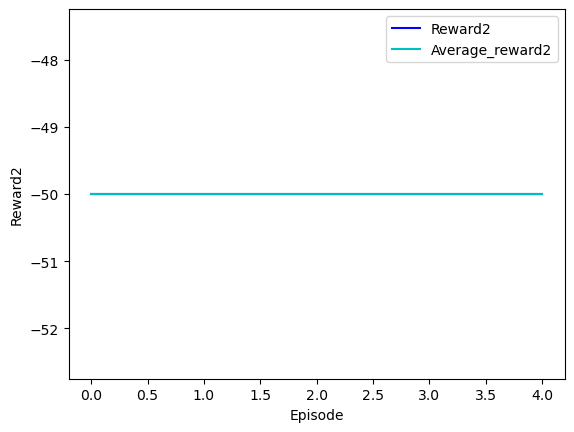

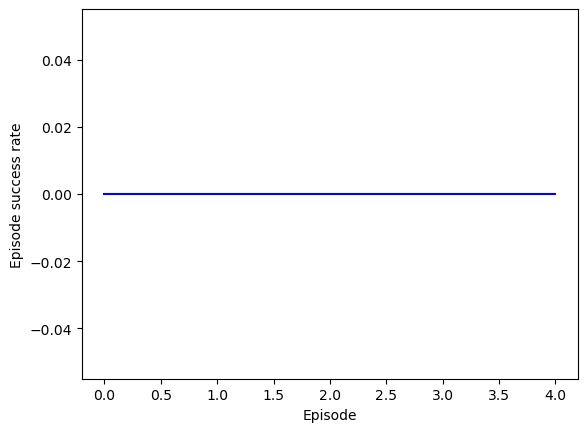

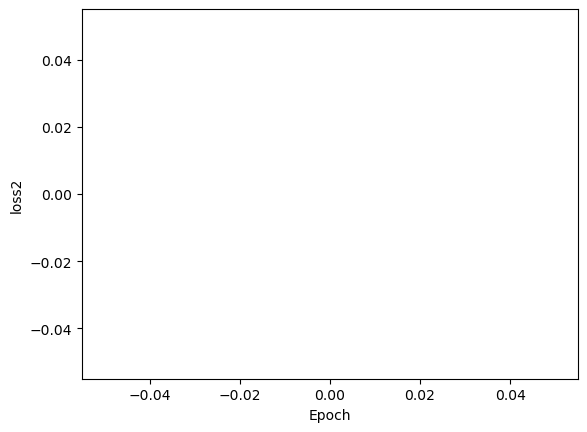

***** epoch 1 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
***** frame 4 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur

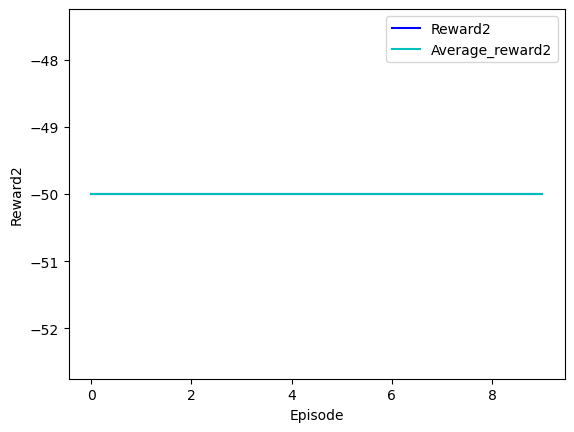

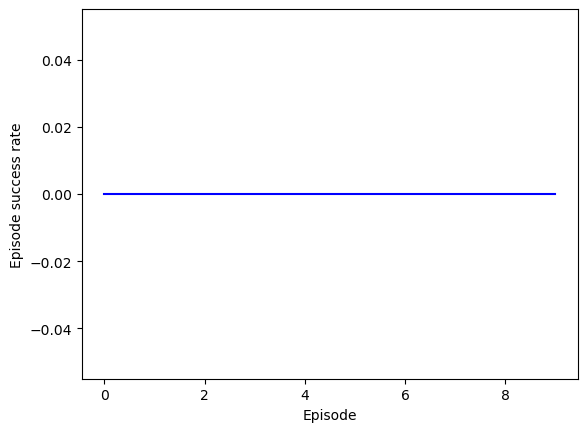

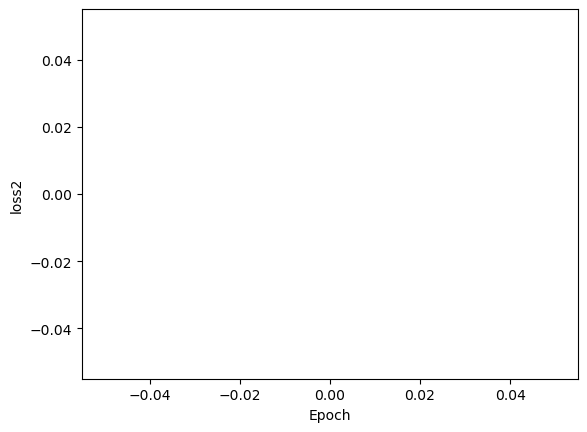

***** epoch 2 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
***** frame 4 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 

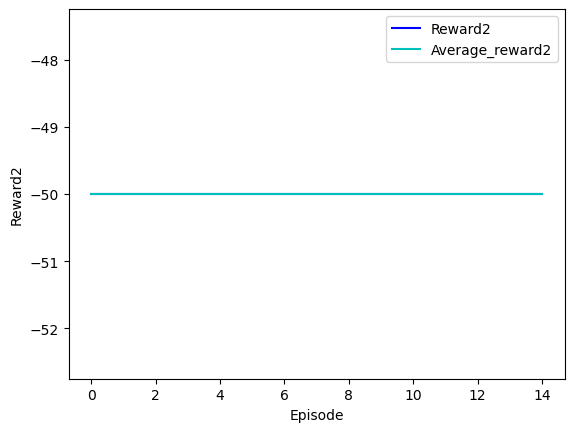

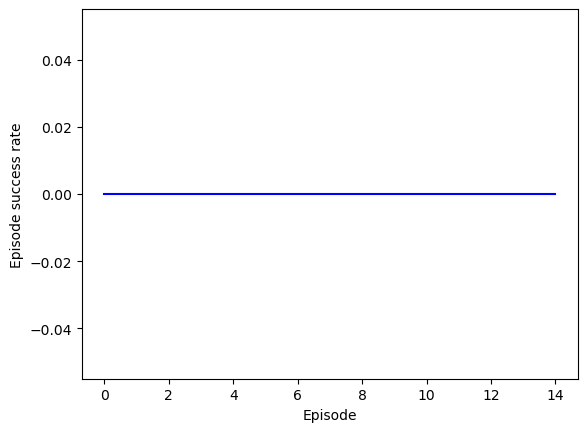

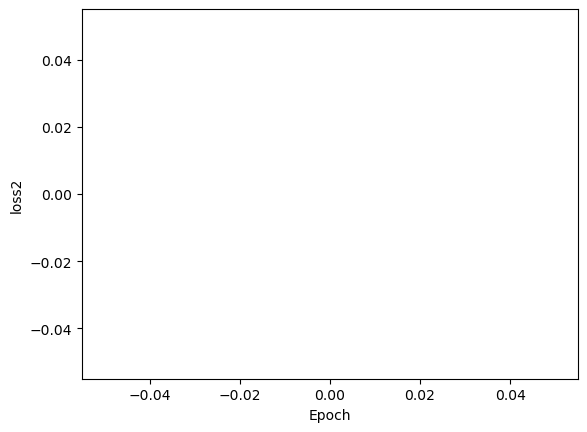

***** epoch 3 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
***** frame 4 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is

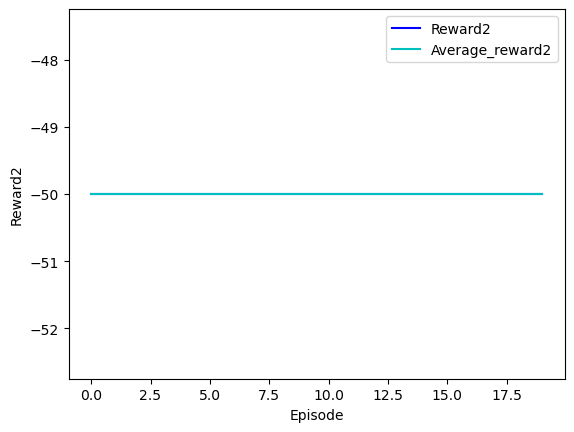

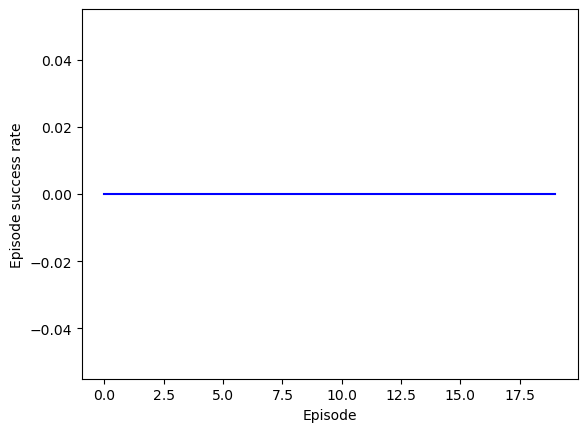

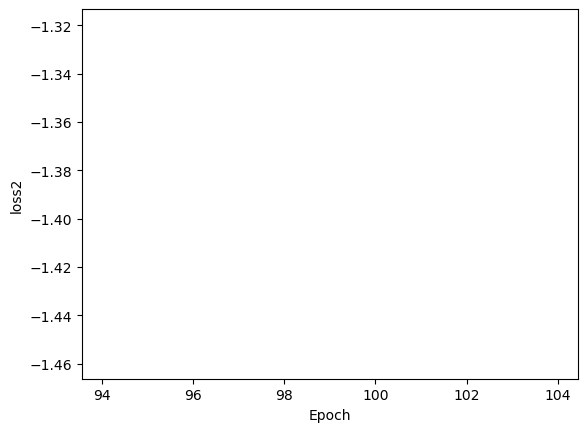

***** epoch 4 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: 

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 19 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
Epsilon_hist is: 0.9895523341234285
***** epoch 4 episode 4 *****
***** frame 20 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 5.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2

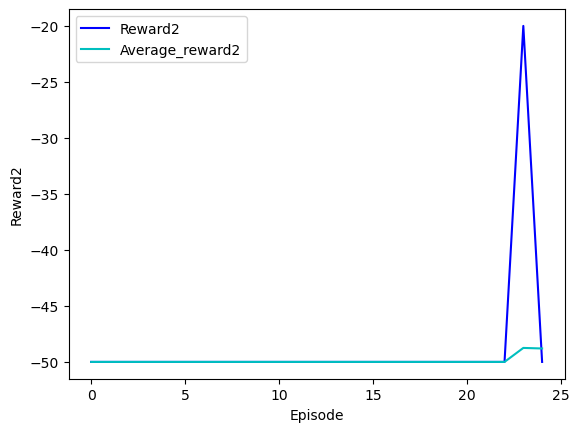

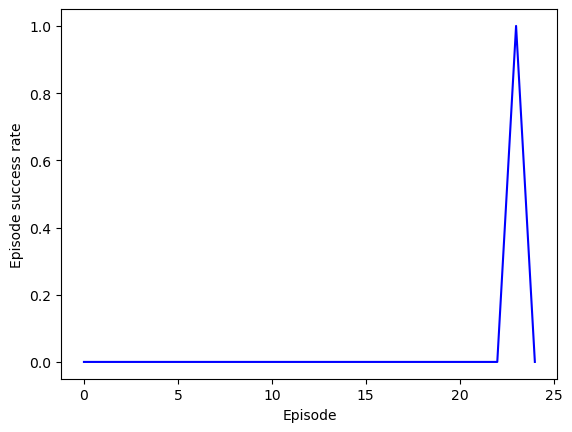

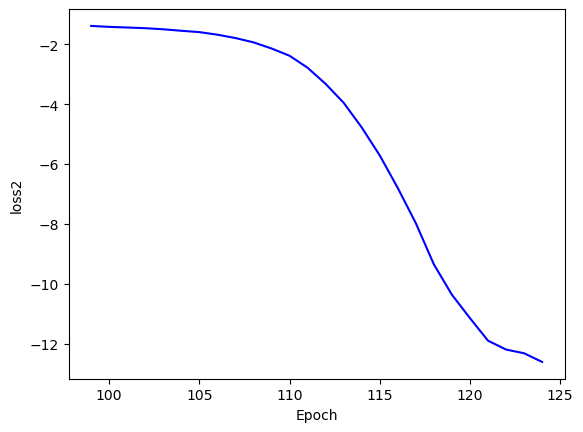

***** epoch 5 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 3 *****
1/1 [==============================] - 0s 15ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 4 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
Epsilon_hist is: 0.9846156900862658
***** epoch 5 episode 1 *****
***** frame 5 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 6 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 7 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur

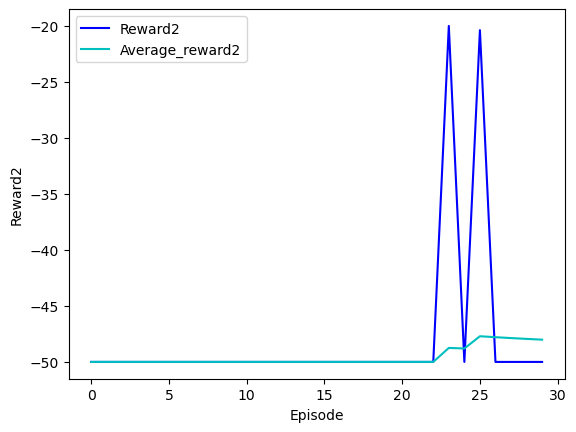

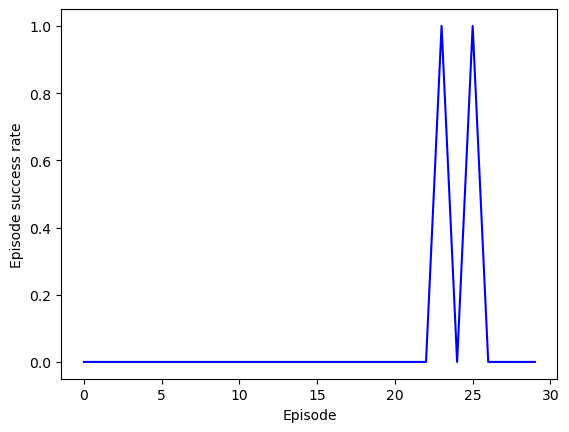

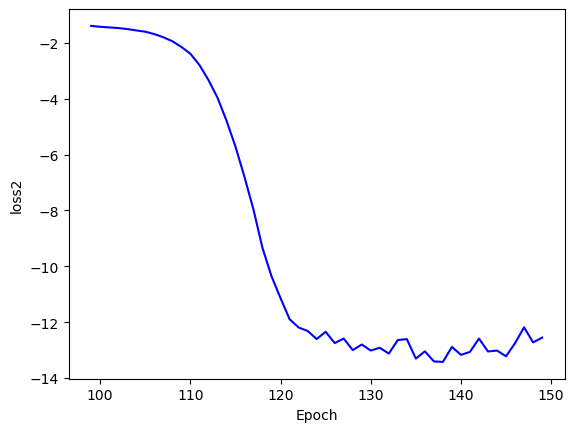

***** epoch 6 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 5.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0


4/4 [==============================] - 0s 2ms/step
***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 23 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.9627037921120016


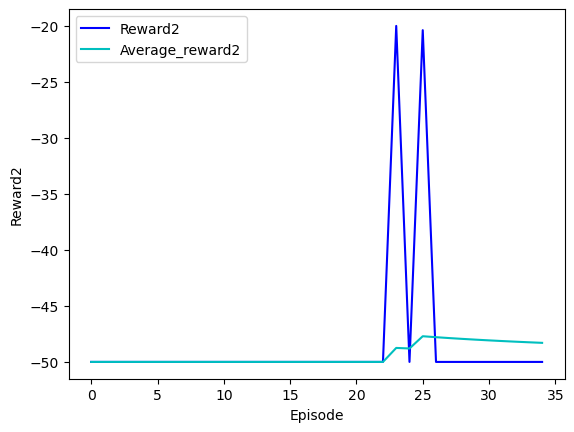

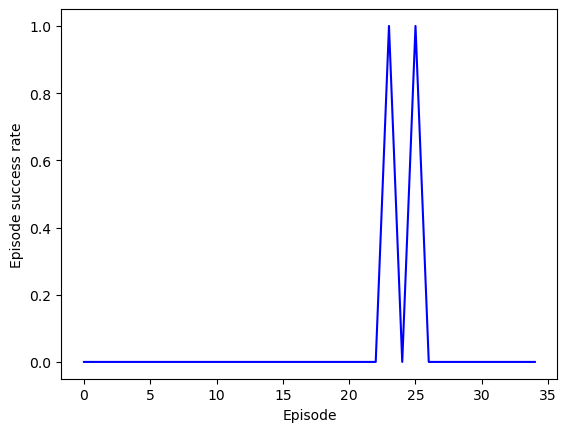

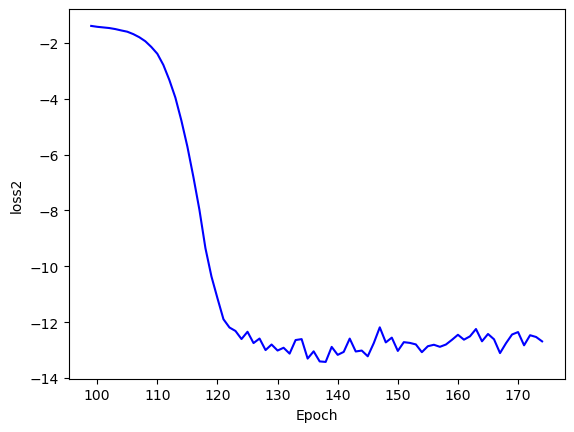

***** epoch 7 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 i

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.9531223457267703
***** epoch 7 episode 4 *****
***** frame 20 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 21 *****
1/1 [==============================] - 0s 15ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87761.9540800892
r_em 56631.865560384605
56631.865560384605
ReWard2/R0 11.32637311207692
reward2 is: 19.326373112076922
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 1ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 23 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.9507419214772129


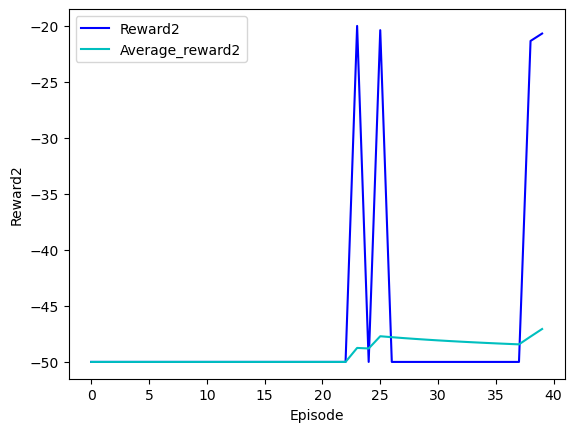

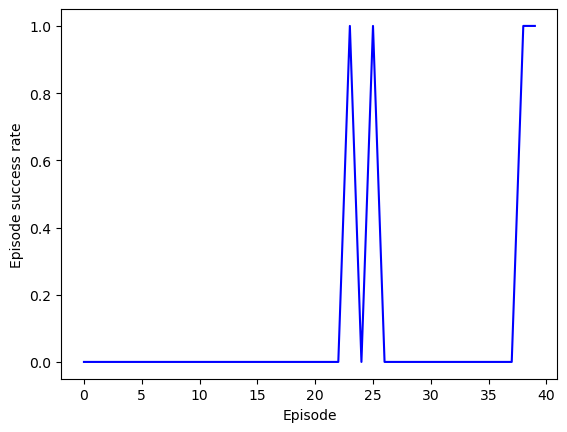

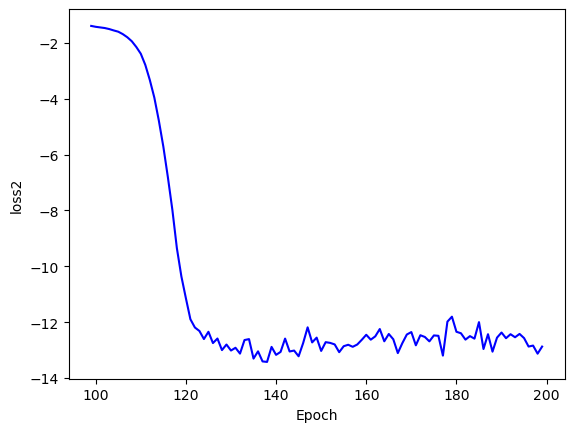

***** epoch 8 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
to

4/4 [==============================] - 0s 1ms/step
***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 23 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.938928680514662


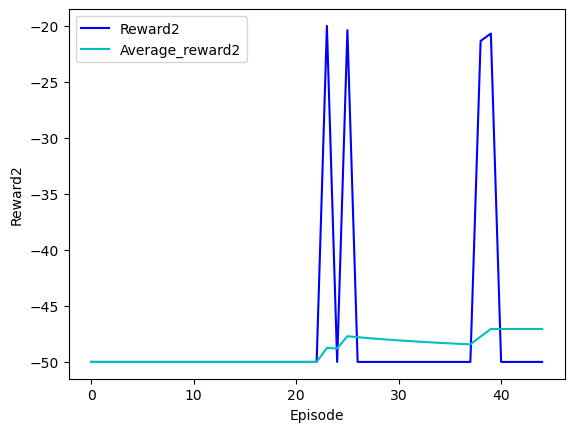

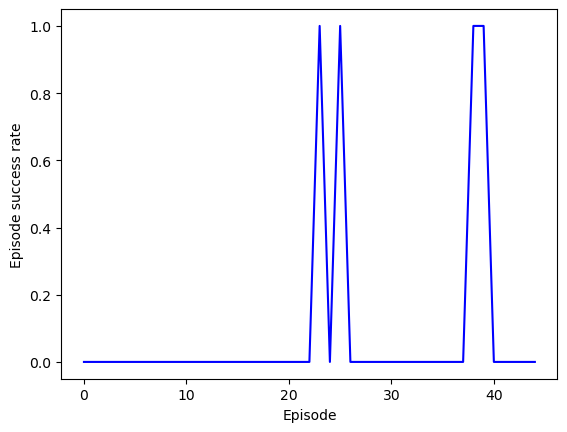

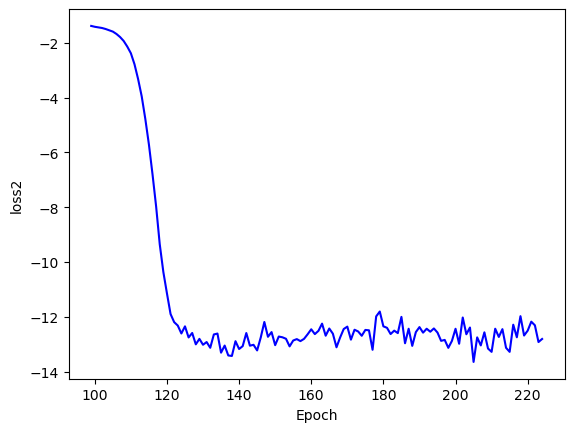

***** epoch 9 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.9295838593083691
***** epoch 9 episode 4 *****
***** frame 20 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 23 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e

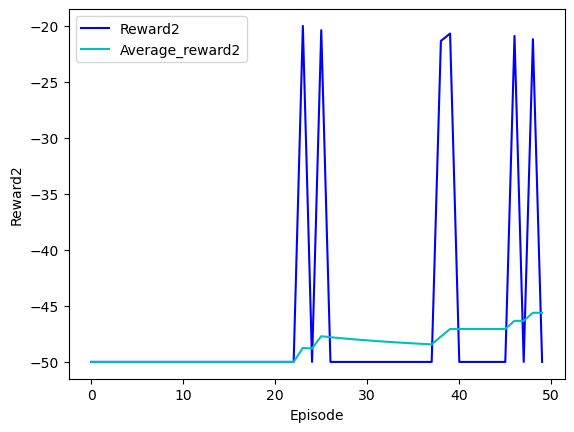

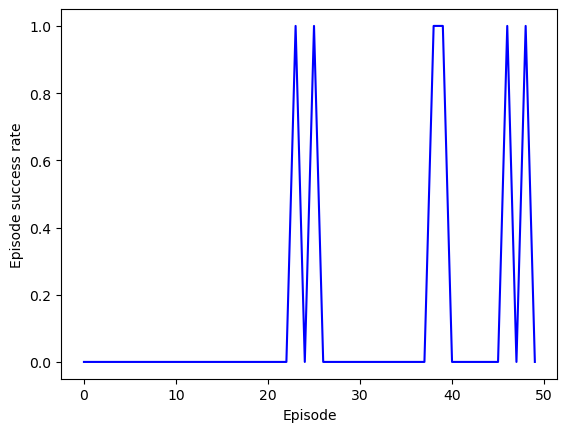

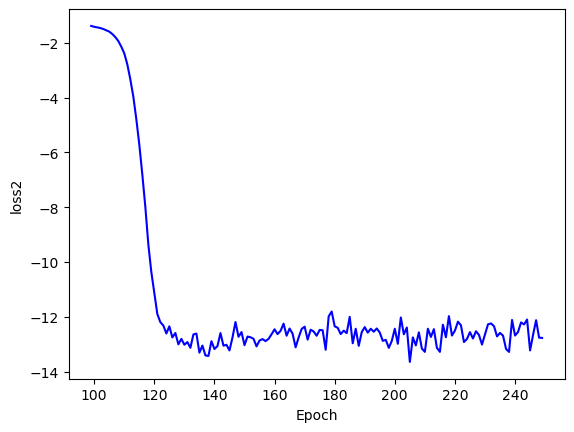

***** epoch 10 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is

reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 23 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
Epsilon_hist is: 0.9157407234877085


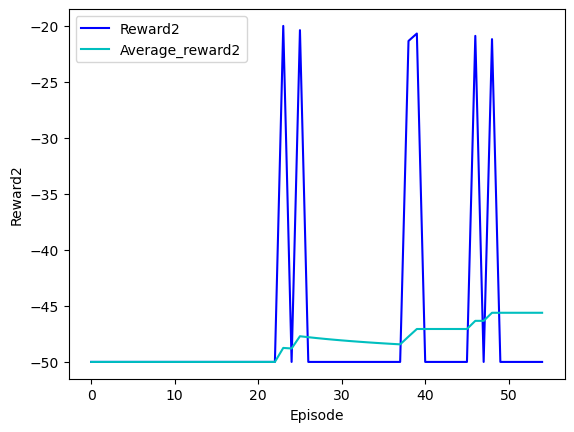

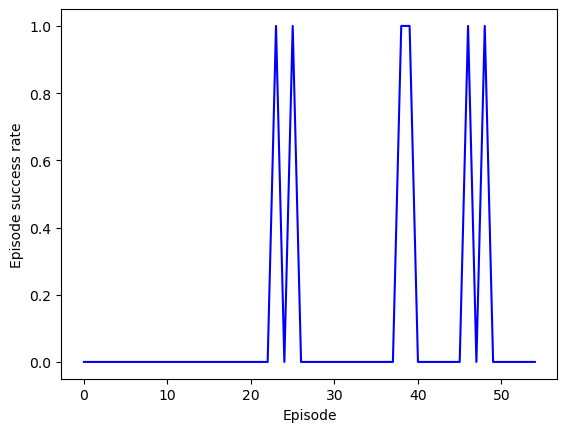

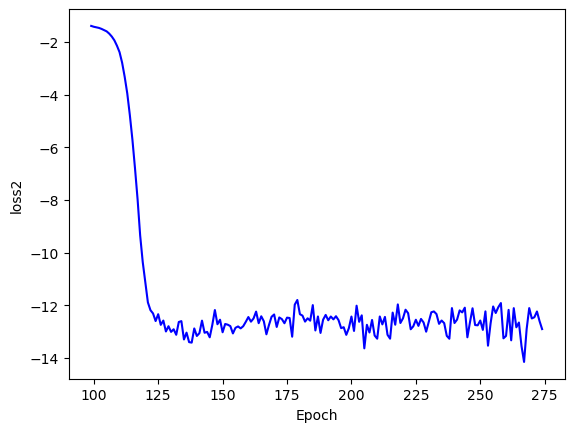

***** epoch 11 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 i

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 19 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.9066266837209999
***** epoch 11 episode 4 *****
***** frame 20 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 22 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3.

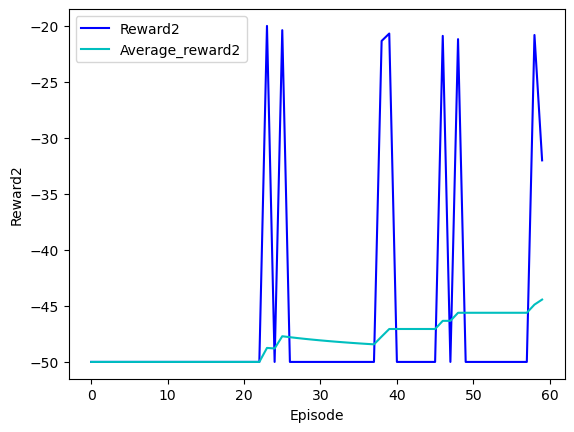

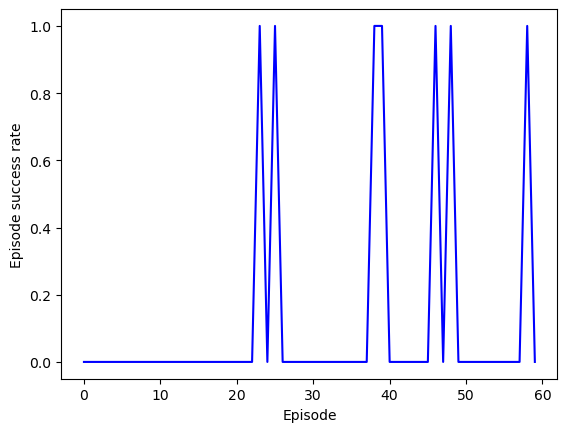

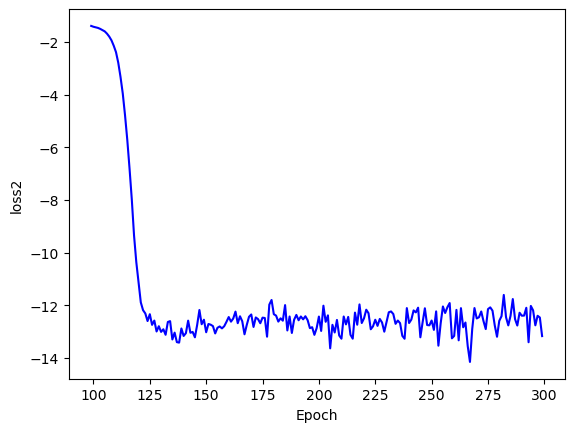

***** epoch 12 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 2 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88244.41384373794
r_em 58982.99881547235
58982.99881547235
ReWard2/R0 11.79659976309447
reward2 is: 19.79659976309447
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 1ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 3 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87526.60517675427
r_em 58908.39100072617
58908.39100072617
ReWard2/R0 11.781678200145235
reward2 is: 19.781678200145237
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 4 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.9021037362650792
***** epoch 12 episode 1 *****
***** frame 5 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 6 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 7 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 23 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
Epsilon_hist is: 0.8931254205528514


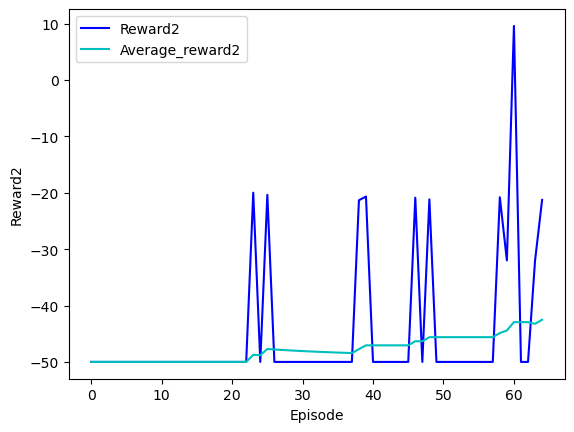

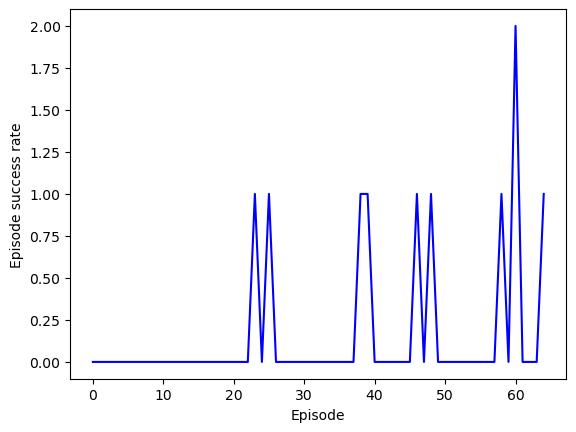

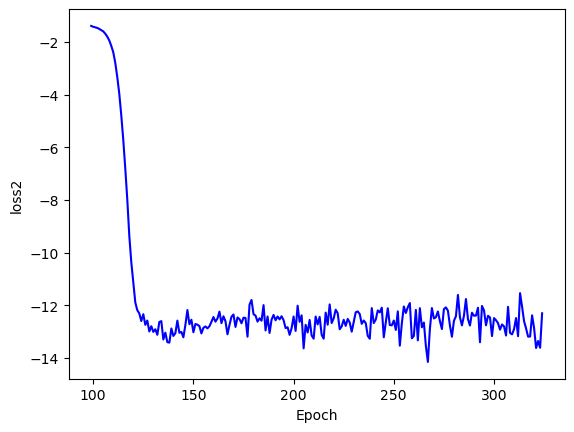

***** epoch 13 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 5

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 13 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 14 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.8864503737205981
***** epoch 13 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85332.55897188827
r_em 55138.116292848856
55138.116292848856
ReWard2/R0 11.027623258569772
reward2 is: 19.027623258569772
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [===================

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 17 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 18 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 19 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number o

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 23 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.882028081133572


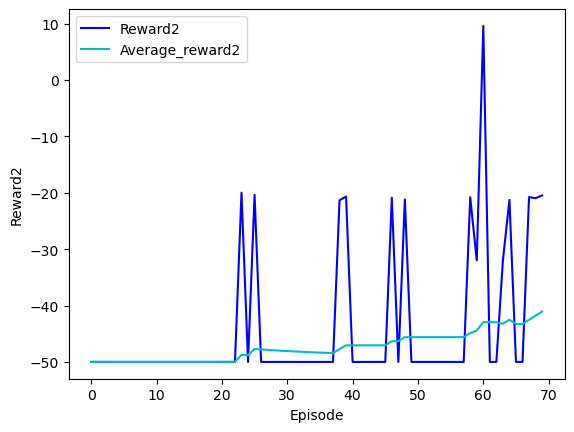

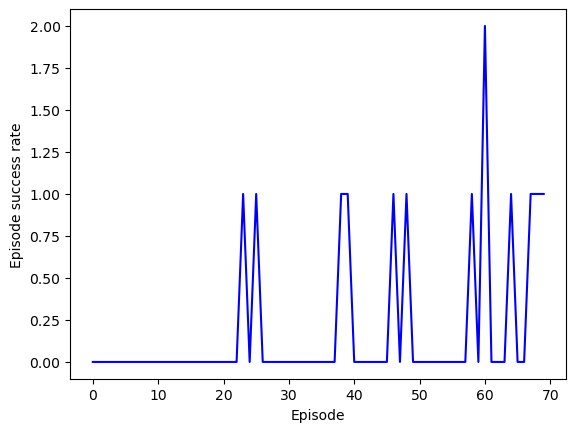

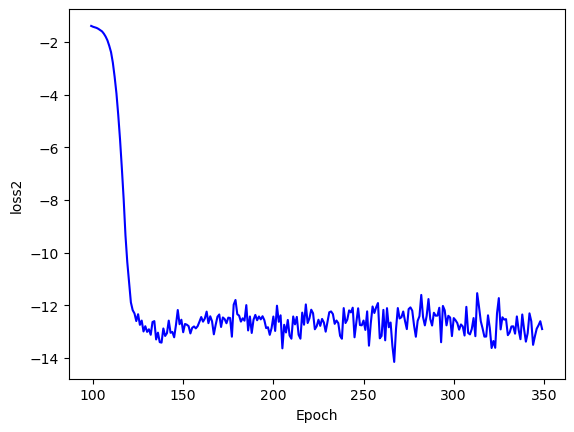

***** epoch 14 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 

4/4 [==============================] - 0s 1ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 23 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2

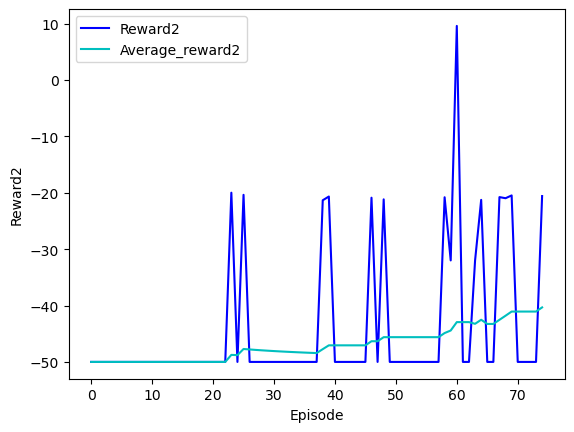

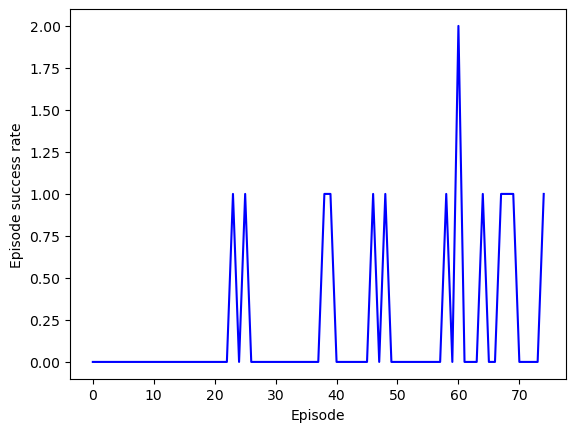

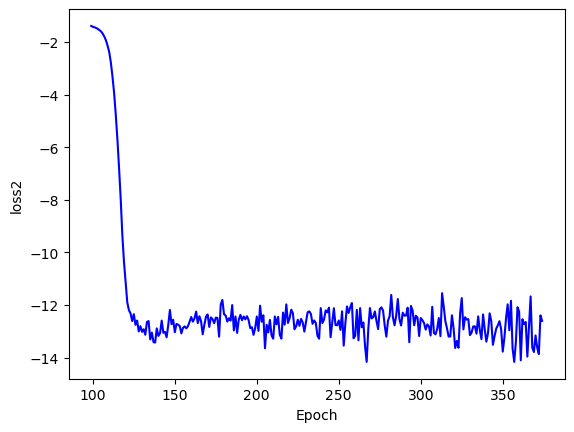

***** epoch 15 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs:

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 6 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 7 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 8 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 73403.94368207104
r_em 53007.42291352261
53007.42291352261
ReWard2/R0 10.601484582704522
reward2 is: 18.601484582704522
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 1ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 9 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.8667230726590923
***** epoch 15 episode 2 *****
***** frame 10 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 11 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 12 *****
1/1 [==============================] - 0s 15ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 17 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 18 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 98338.93282916708
r_em 54022.991161326805
54022.991161326805
ReWard2/R0 10.804598232265361
reward2 is: 18.804598232265363
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 1ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 19 *****
1/1 [==============================] - 0s 15ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 97057.69151893602
r_em 53367.69542073092
53367.69542073092
ReWard2/R0 10.673539084146183
reward2 is: 18.673539084146185
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.8623991949408877
***** epoch 15 episode 4 *****
***** frame 20 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 23 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ... 

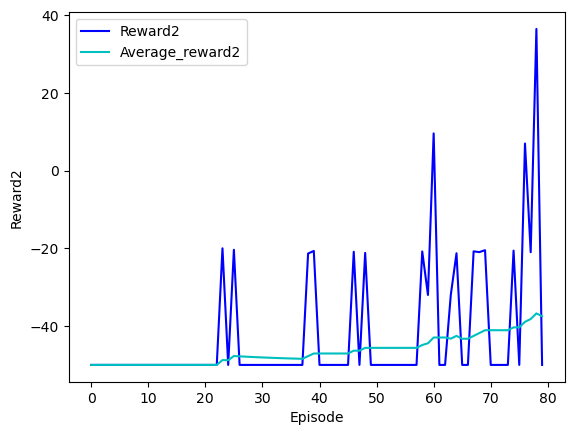

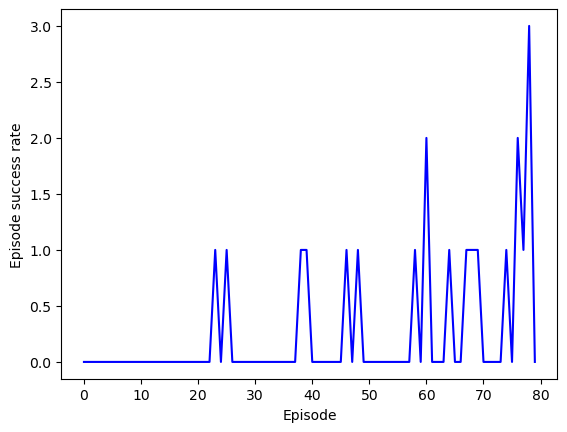

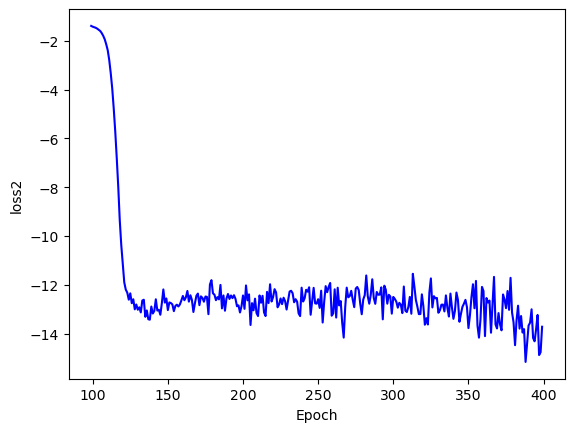

***** epoch 16 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 83266.5857919123
r_em 52194.59047528272
52194.59047528272
ReWard2/R0 10.438918095056543
reward2 is: 18.438918095056543
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 1ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 3 *****
we cho

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 7 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 8 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 100000.85815913184
r_em 54765.51073717272
54765.51073717272
ReWard2/R0 10.953102147434544
reward2 is: 18.953102147434542
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 9 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.8559537899822373
***** epoch 16 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 11 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 12 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not m

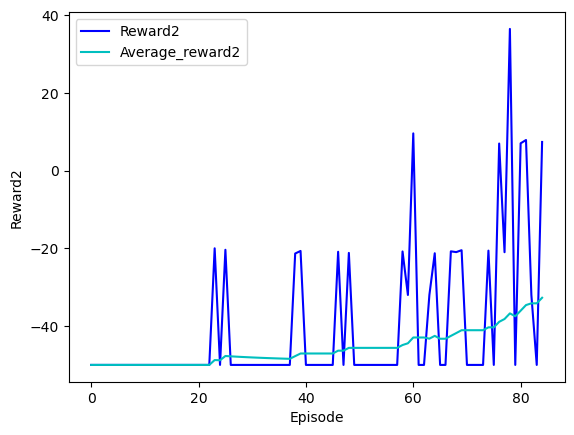

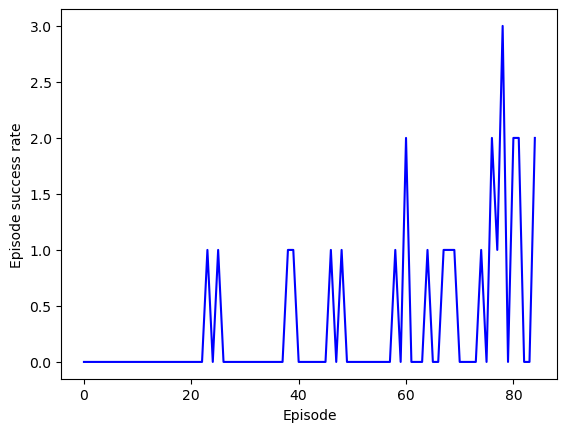

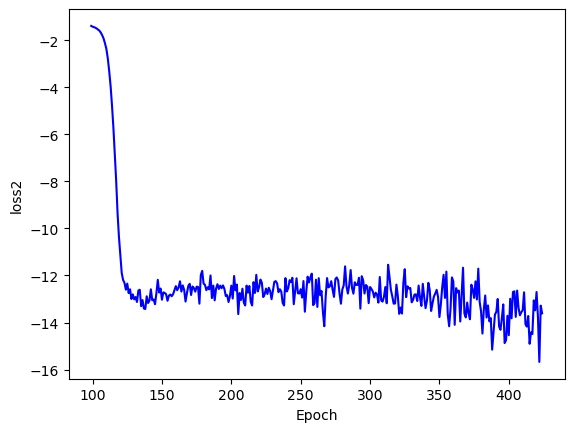

***** epoch 17 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 2 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 89776.44897915084
r_em 52769.25990765829
52769.25990765829
ReWard2/R0 10.553851981531658
reward2 is: 18.553851981531658
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 1ms/step
***** frame 3 *****
we ch

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 17 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 18 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 19 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88620.19812603598
r_em 55854.565135582896
55854.565135582896
ReWard2/R0 11.17091302711658
reward2 is: 19.17091302711658
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.8411012242990624
***** epoch 17 episode 4 *****
***** frame 20 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 23 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
Epsilon_hist is: 0.839000572940262


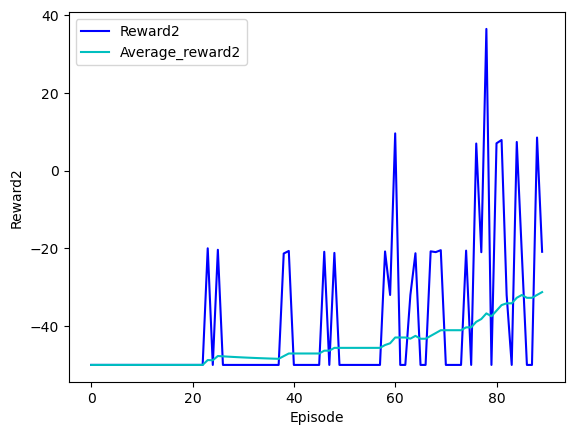

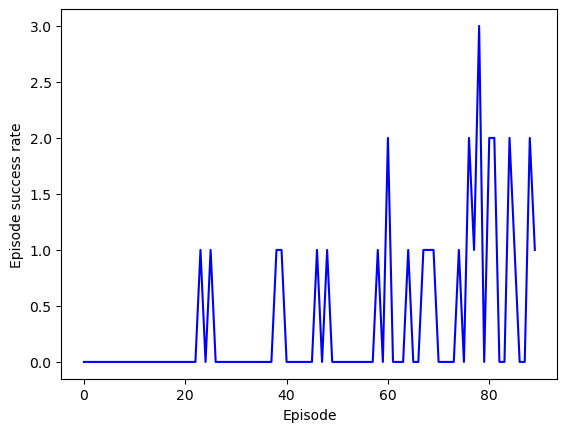

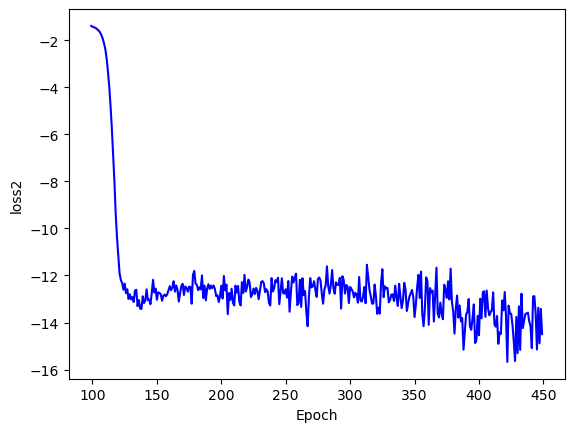

***** epoch 18 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94952.80773430974
r_em 56775.880269857604
56775.880269857604
ReWard2/R0 11.35517605397152
reward2 is: 19.35517605397152
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 4 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RB

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 17 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 18 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 19 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 23 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.8285757502707601


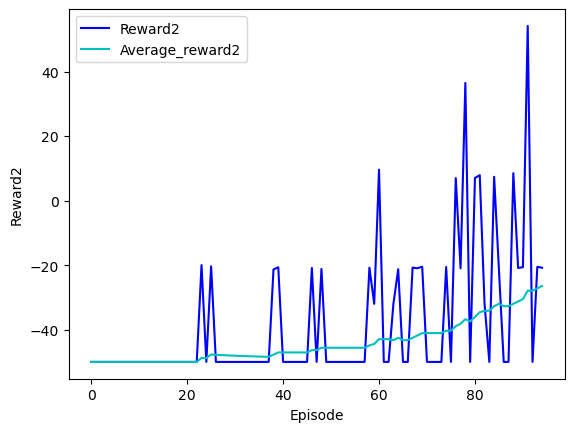

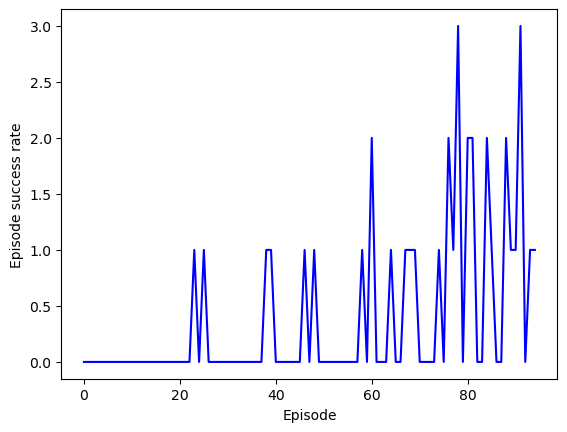

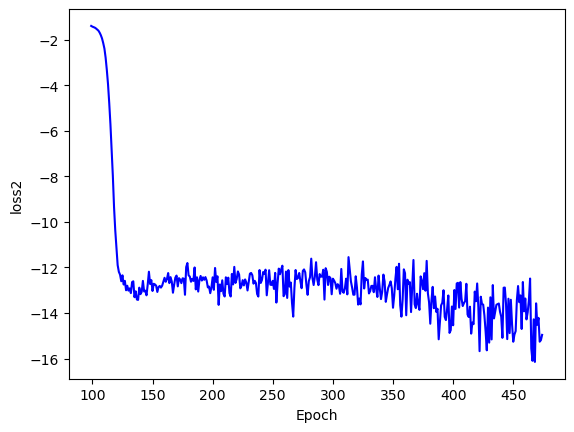

***** epoch 19 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 11 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 12 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 13 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 14 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of 

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 17 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93178.79467302444
r_em 50643.699984021434
50643.699984021434
ReWard2/R0 10.128739996804287
reward2 is: 18.128739996804285
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 18 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 19 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.8203292322946492
***** epoch 19 episode 4 *****
***** frame 20 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ..

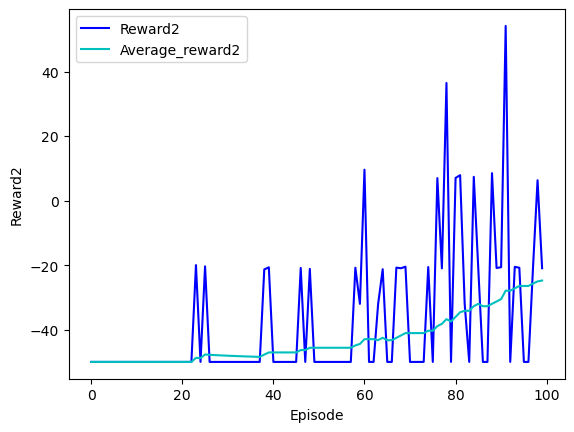

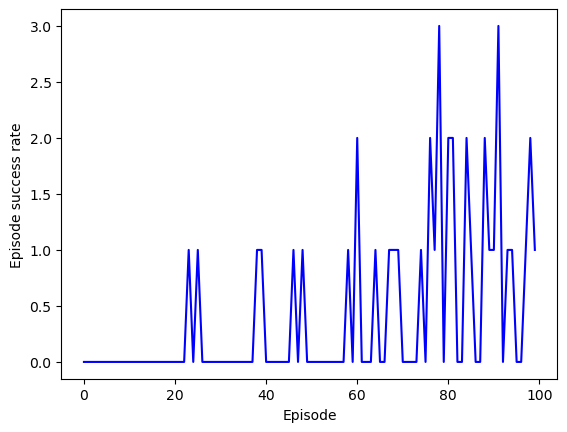

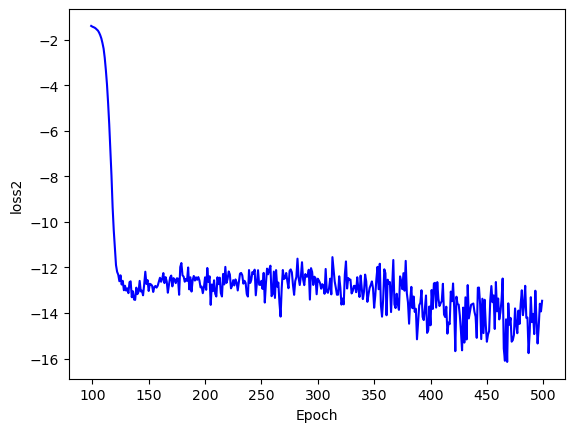

***** epoch 20 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 14 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.8121647889613309
***** epoch 20 episode 3 *****
***** frame 15 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 16 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92326.02395931225
r_em 54957.75518788049
54957.75518788049
ReWard2/R0 10.991551037576098
reward2 is: 18.991551037576098
total number of ur2 RBs: 8.0
total number of em2 RBs:

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 17 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 18 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 19 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.8101364063859481
***** epoch 20 episode 4 *****
***** frame 20 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
re

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 23 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
Epsilon_hist is: 0.808113089698582


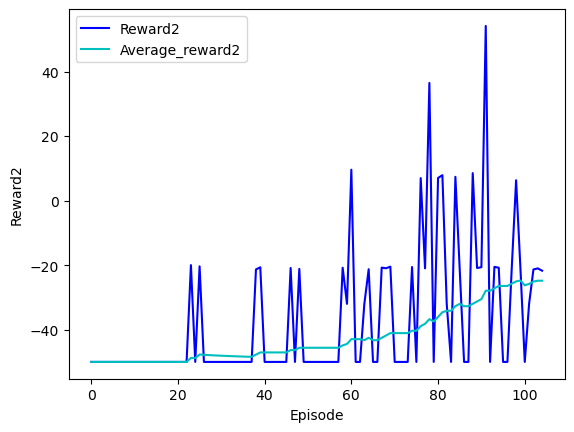

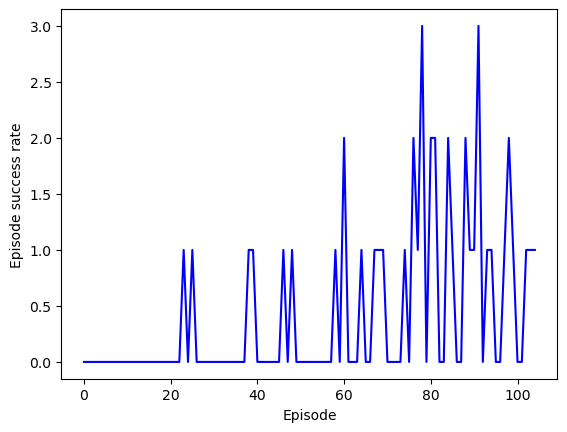

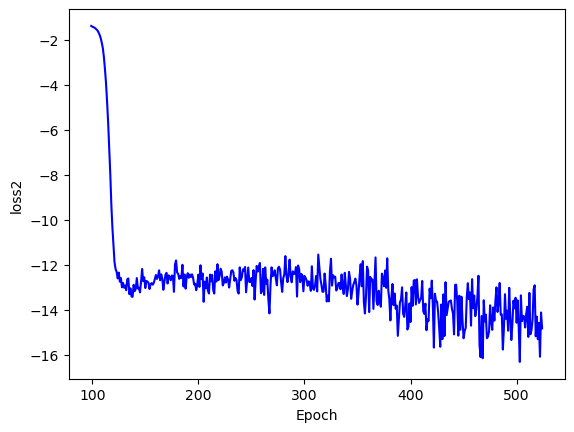

***** epoch 21 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 9 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
Epsilon_hist is: 0.8040816034112525
***** epoch 21 episode 2 *****
***** frame 10 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 11 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 12 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 14 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.8020734086018824
***** epoch 21 episode 3 *****
***** frame 15 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 17 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 19 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.8000702292615582
***** epoch 21 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87624.52301744319
r_em 55815.85509503548
55815.85509503548
ReWard2/R0 11.163171019007095
reward2 is: 19.163171019007095
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 21 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89661.00651429244
r_em 56063.02353218204
56063.02353218204
ReWard2/R0 11.212604706436407
reward2 is: 19.21260470643641
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 23 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
Epsilon_hist is: 0.79807205286414


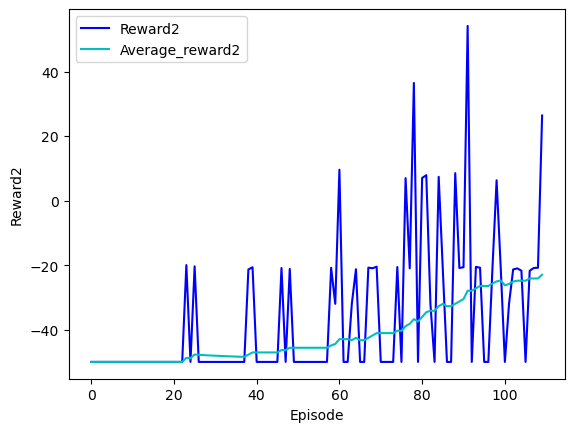

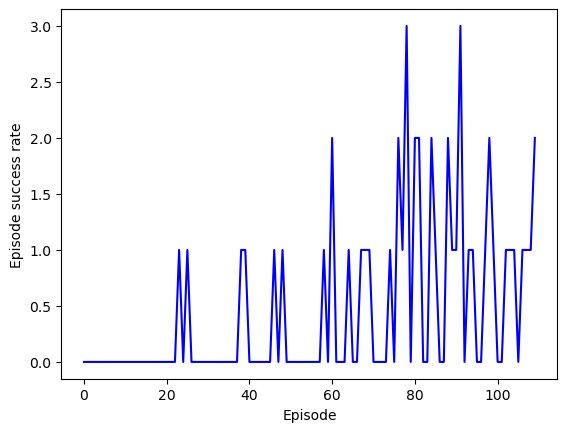

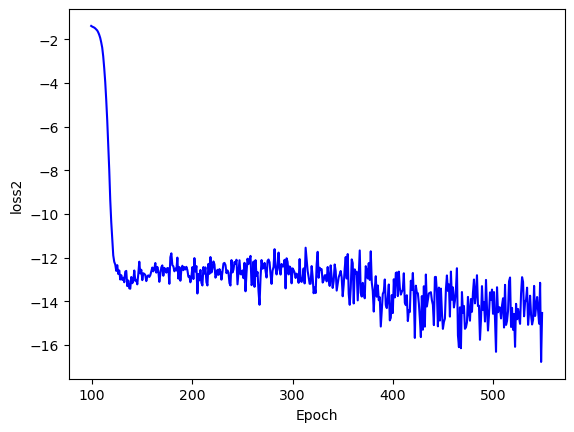

***** epoch 22 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!

4/4 [==============================] - 0s 2ms/step
***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 23 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84319.57624812491
r_em 54827.1847062449
54827.1847062449
ReWard2/R0 10.96543694124898
reward2 is: 18.96543694124898
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.7881557787912421


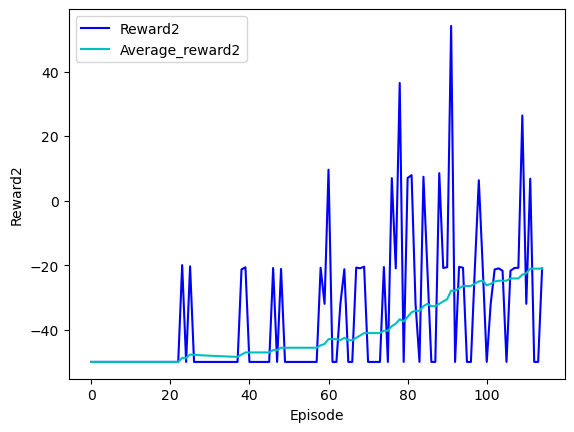

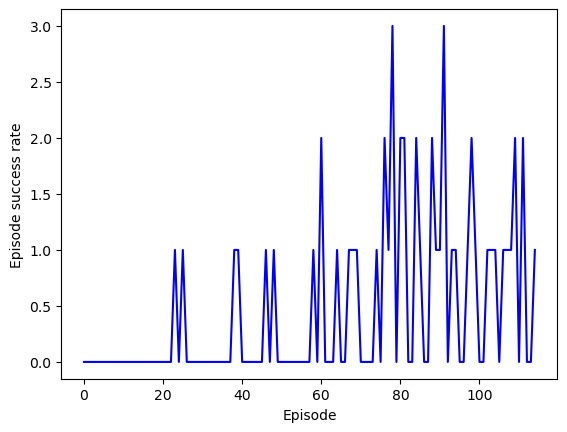

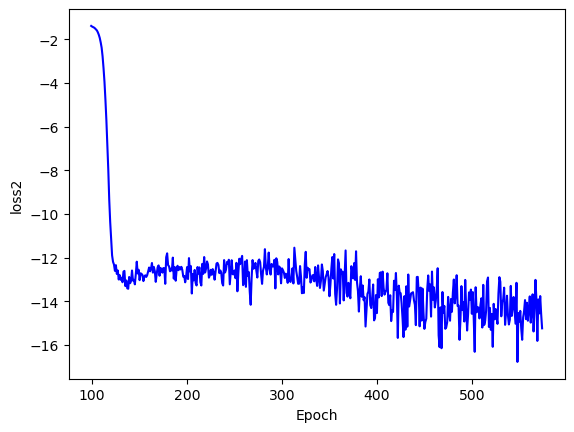

***** epoch 23 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 3 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccura

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 4 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84827.25102065036
r_em 55987.32215339286
55987.32215339286
ReWard2/R0 11.197464430678572
reward2 is: 19.197464430678572
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.7861873587487627
***** epoch 23 episode 1 *****
***** frame 5 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 6 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 7 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 8 *****
1/1 [==============================] - 0s 28ms/

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 9 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.7842238548377993
***** epoch 23 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86909.78768929205
r_em 55513.93182435934
55513.93182435934
ReWard2/R0 11.102786364871868
reward2 is: 19.102786364871868
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 11 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 12 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 13 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 14 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 21 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82026.97441263791
r_em 57701.88167007241
57701.88167007241
ReWard2/R0 11.540376334014482
reward2 is: 19.540376334014482
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 23 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.7783627172668048


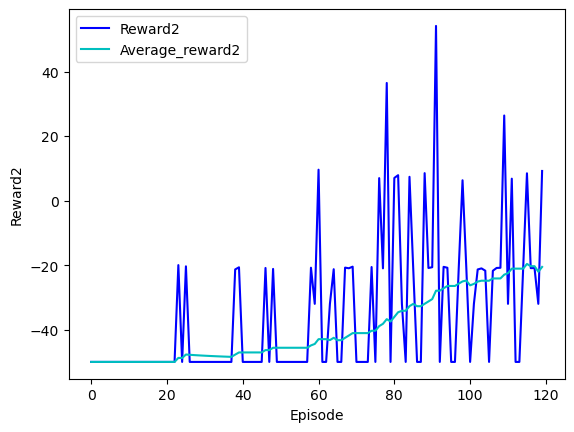

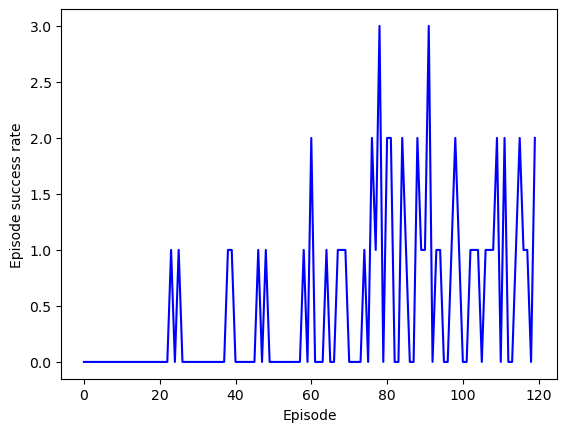

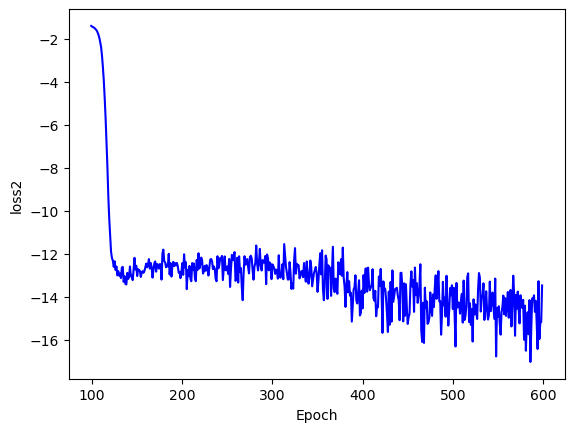

***** epoch 24 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90944.51639669656
r_em 57388.575565125044
57388.575565125044
ReWard2/R0 11.477715113025008
reward2 is: 19.477715113025006
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 1 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91434.99367989741
r_em 58055.20783168717
58055.20783168717
ReWard2/R0 11.611041566337434
reward2 is: 19.611041566337434
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 4 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.776418755407721
***** epoch 24 episode 1 *****
***** frame 5 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 7 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80683.94796501187
r_em 54971.466661118844
54971.466661118844
ReWard2/R0 10.99429333222377
reward2 is: 18.99429333222377
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 8 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 9 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.7744796485958095
***** epoch 24 episode 2 *****
***** frame 10 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 11 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 17 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 18 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 19 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.

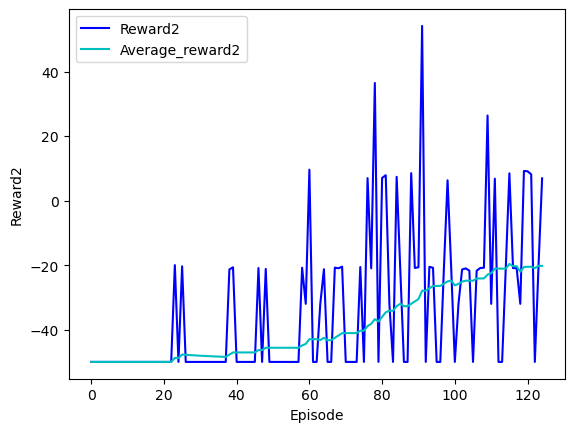

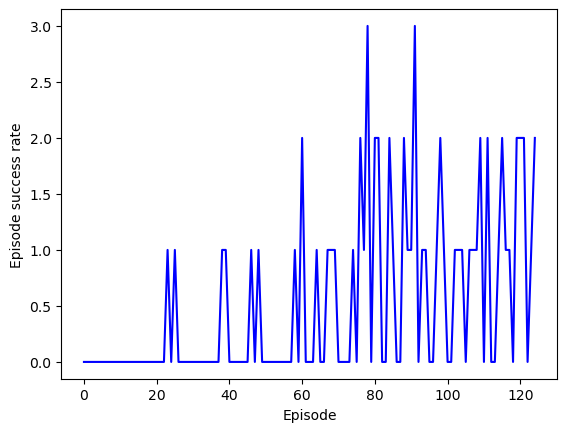

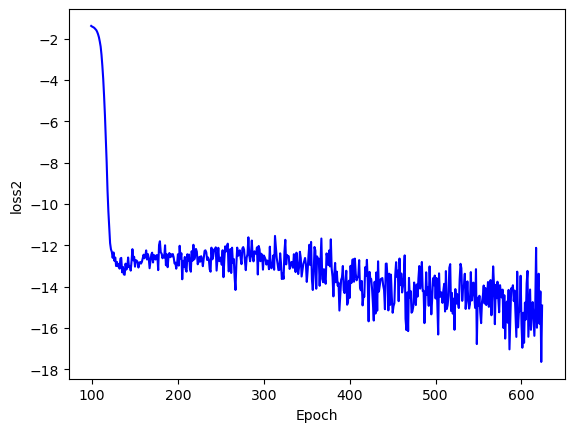

***** epoch 25 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85683.80168586735
r_em 53993.718628597904
53993.718628597904
ReWard2/R0 10.79874372571958
reward2 is: 18.798743725719582
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 3 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88823.69844182847
r_em 52989.07686955464
52989.07686955464
ReWard2/R0 10.597815373910928
reward2 is: 18.597815373910926
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 4 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
Epsilon_hist is: 0.7667715297639581
***** epoch 25 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84752.47316805038
r_em 55054.43105686658
55054.43105686658
ReWard2/R0 11.010886211373316
reward2 is: 19.010886211373318
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 6 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 7 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 8 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 9 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85021.22543225405
r_em 52826.90225920774
52826.90225920774
R

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.764856516910148
***** epoch 25 episode 2 *****
***** frame 10 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 11 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 12 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 13 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ... 

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.7629462868033335
***** epoch 25 episode 3 *****
***** frame 15 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 17 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 18 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.761040827498598
***** epoch 25 episode 4 *****
***** frame 20 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 23 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
re

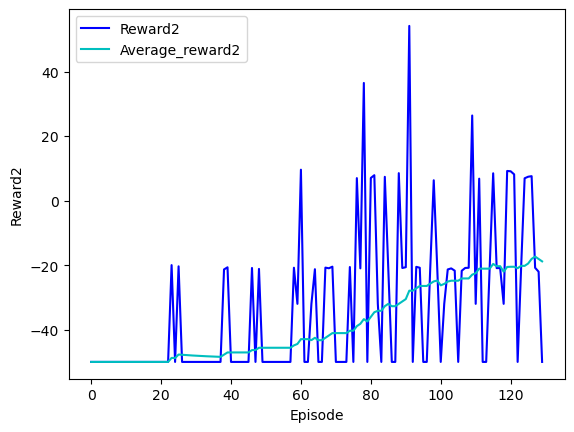

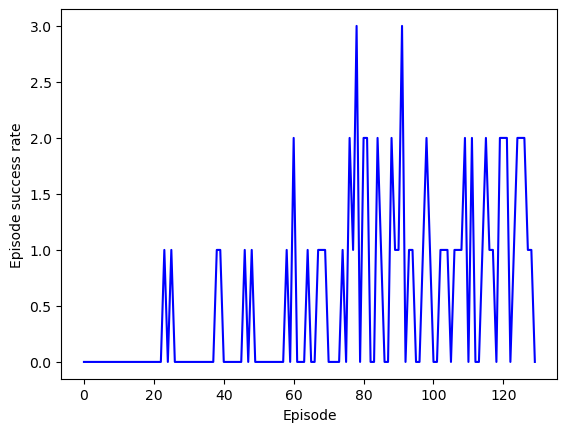

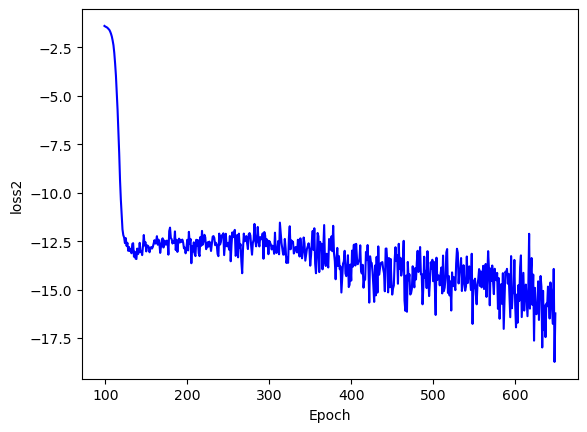

***** epoch 26 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 2 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 92470.48793936761
r_em 53642.16082026083
53642.16082026083
ReWard2/R0 10.728432164052167
reward2 is: 18.728432164052165
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 1ms/step
****

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 14 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.7534664604446856
***** epoch 26 episode 3 *****
***** frame 15 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 17 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.7515846770181276
***** epoch 26 episode 4 *****
***** frame 20 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 23 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ... 

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.7497075933480289


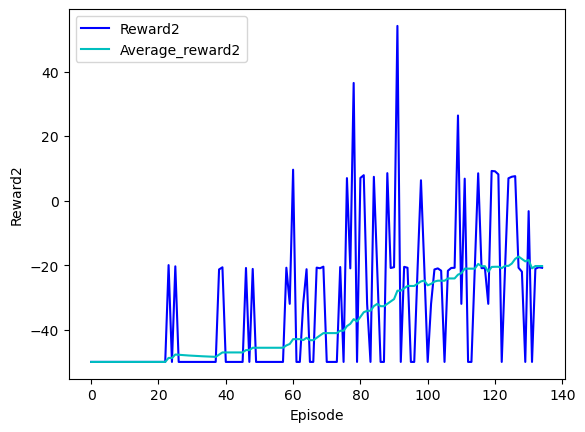

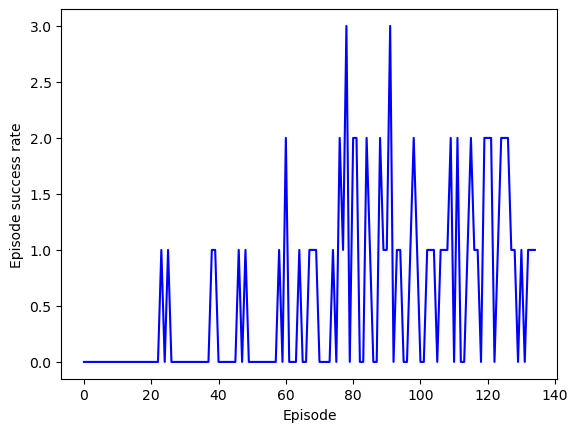

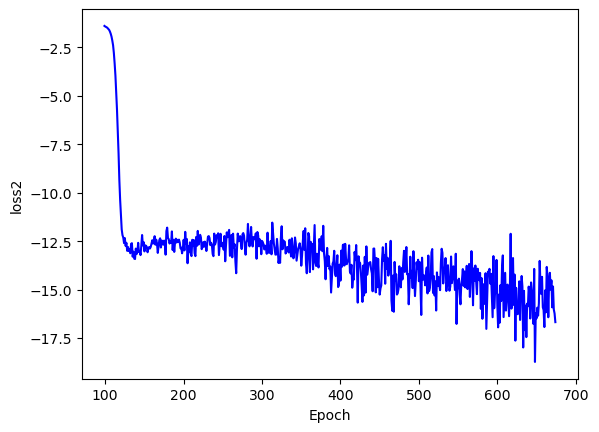

***** epoch 27 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 2 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89014.21902866387
r_em 57538.79201717777
57538.79201717777
ReWard2/R0 11.507758403435554
reward2 is: 19.507758403435552
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 1ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 4 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.7478351976967421
***** epoch 27 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 87497.2747153097
r_em 53757.279567987396
53757.279567987396
ReWard2/R0 10.751455913597479
reward2 is: 18.75145591359748
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] -

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 12 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 13 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 14 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90238.1636233943
r_em 57749.18695738608
57749.18695738608
ReWard2/R0 11.549837391477217
reward2 is: 19.54983739147722
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.7441044236465144
***** epoch 27 episode 3 *****
***** frame 15 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 17 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88759.97908236444
r_em 56458.69317860023
56458.69317860023
ReWard2/R0 11.291738635720046
reward2 is: 19.291738635720044
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>............

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 18 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 19 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.7422460219185594
***** epoch 27 episode 4 *****
***** frame 20 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 

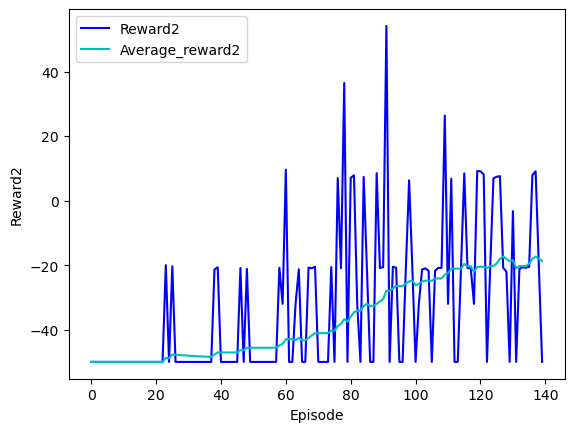

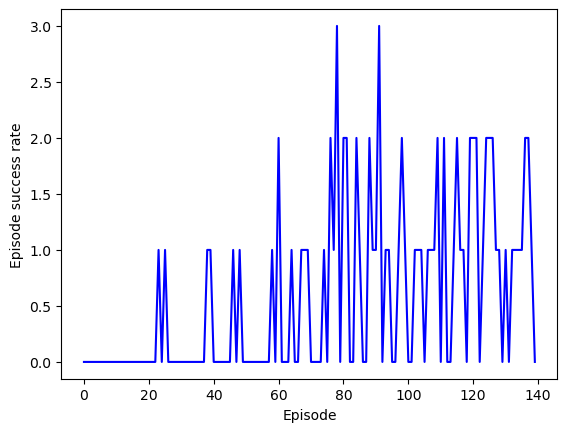

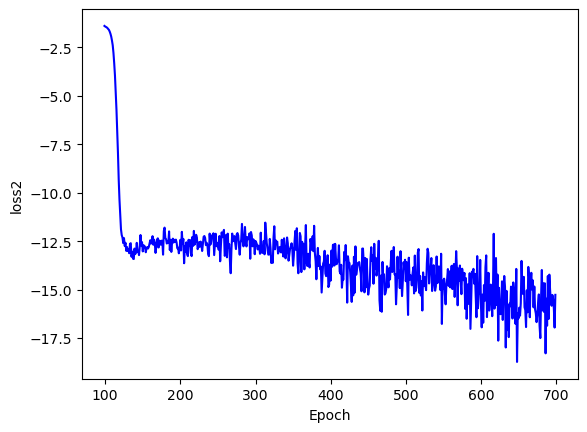

***** epoch 28 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88708.98346601587
r_em 55098.27001402223
55098.27001402223
ReWard2/R0 11.019654002804446
reward2 is: 19.019654002804444
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 3 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88358.3226570576
r_em 54837.97123276338
54837.97123276338
ReWard2/R0 10.967594246552677
reward2 is: 18.96759424655268
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 4 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 5.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.7385431309527595
***** epoch 28 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 74620.88330467322
r_em 55132.511569849776
55132.511569849776
ReWard2/R0 11.026502313969955
reward2 is: 19.026502313969957
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 6 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86612.40836375748
r_em 55605.43416467719
55605.43416467719
ReWard2/R0 11.121086832935438
reward2 is: 19.12108683293544
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 1ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 7 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 5.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 8 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85409.27343602519
r_em 55439.76819055788
55439.76819055788
ReWard2/R0 11.087953638111577
reward2 is: 19.08795363811158
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 9 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
Epsilon_hist is: 0.7366986185602569
***** epoch 28 episode 2 *****
***** frame 10 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 5.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 11 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 97819.41221344616
r_em 57274.38316678454
57274.38316678454
ReWard2/R0 11.454876633356907
reward2 is: 19.454876633356907
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 12 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 99365.25877850593
r_em 56985.9688856885
56985.9688856885
ReWard2/R0 11.3971937771377
reward2 is: 19.3971937771377
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 13 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 14 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.7348587128397597
***** epoch 28 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 99077.3916701577
r_em 57174.94448209981
57174.94448209981
ReWard2/R0 11.434988896419963
reward2 is: 19.434988896419963
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] 

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 23 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.7311926754228393


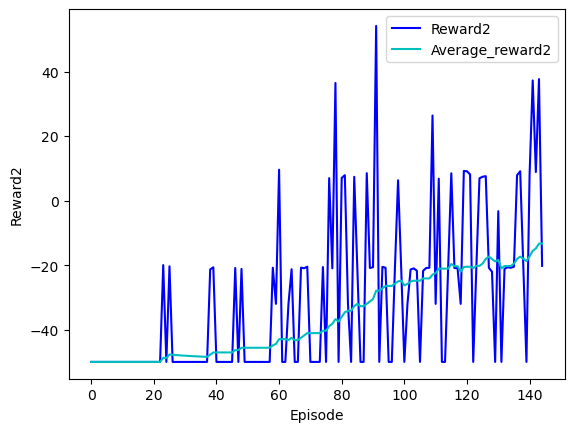

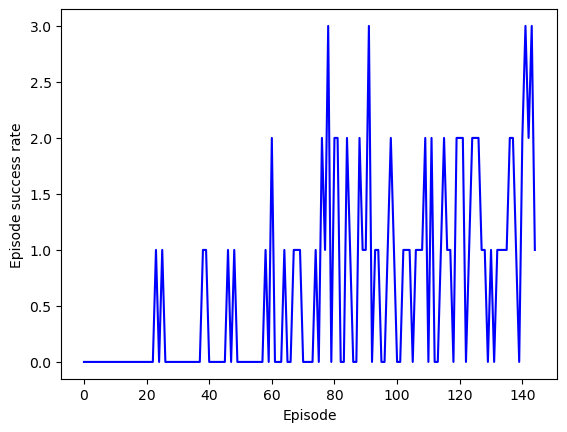

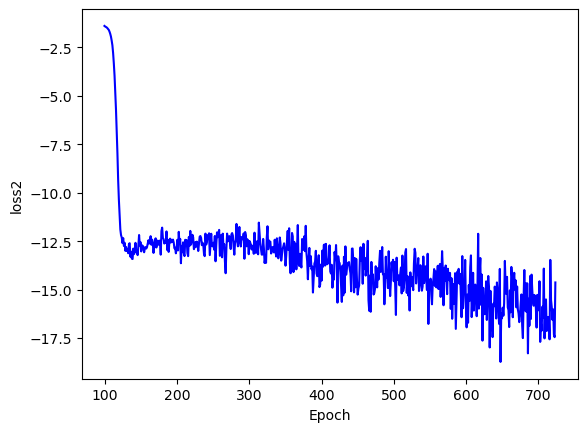

***** epoch 29 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85580.58316394598
r_em 56526.40156649655
56526.40156649655
ReWard2/R0 11.30528031329931
reward2 is: 19.30528031329931
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 1 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87882.96304479675
r_em 56730.919178770666
56730.919178770666
ReWard2/R0 11.346183835754132
reward2 is: 19.346183835754132
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 3 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 89103.51063601564
r_em 55408.16143182164
55408.16143182164
ReWard2/R0 11.081632286364327
reward2 is: 19.081632286364325
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step
***** frame 4 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Ep

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 13 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 14 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.7257278826406264
***** epoch 29 episode 3 *****
***** frame 15 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 R

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 19 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91732.15050162573
r_em 55318.40622158116
55318.40622158116
ReWard2/R0 11.063681244316232
reward2 is: 19.063681244316232
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.7239153763467987
***** epoch 29 episode 4 *****
***** frame 20 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 22 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96148.48457785172
r_em 56566.640800506706
56566.640800506706
ReWard2/R0 11.31332816010134
reward2 is: 19.313328160101342
total number of ur2 RBs: 8.0
total number of em2 RBs

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 23 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.7221073967897048


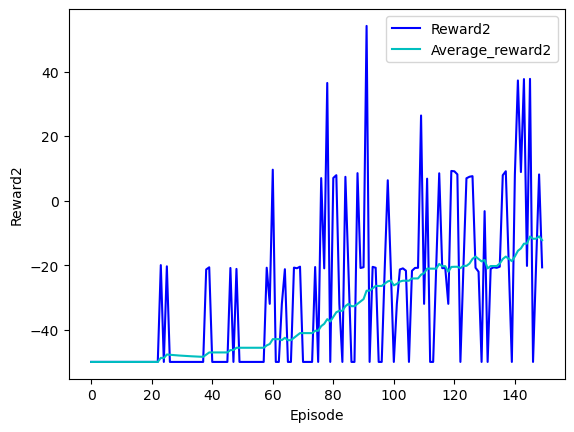

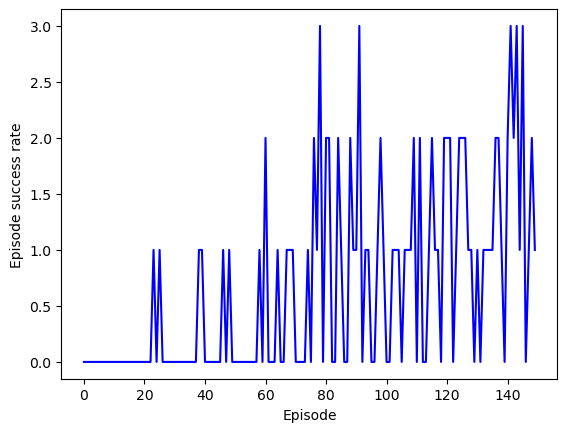

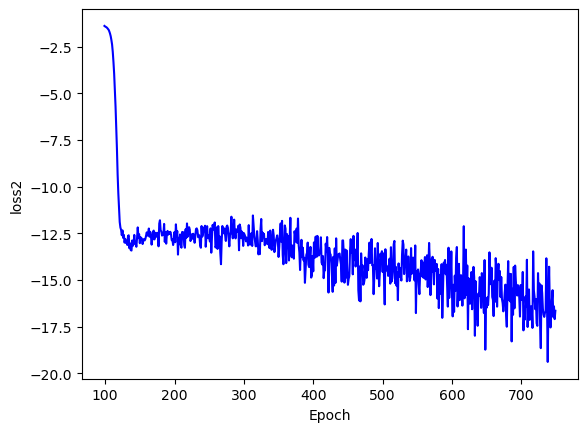

***** epoch 30 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 5.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 7 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 8 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 9 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91422.70928386826
r_em 50540.19129230353
50540.19129230353
ReWard2/R0 10.108038258460706
reward2 is: 18.108038258460706
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.7185049726918316
***** epoch 30 episode 2 *****
***** frame 10 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 11 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82935.74573243545
r_em 53245.54552143491
53245.54552143491
ReWard2/R0 10.649109104286982
reward2 is: 18.649109104286982
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 12 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 13 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 6.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 14 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.7167105056246272
***** epoch 30 episode 3 *****
***** frame 15 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
re

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 23 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 97080.66779649466
r_em 56062.59222261075
56062.59222261075
ReWard2/R0 11.21251844452215
reward2 is: 19.21251844452215
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.7131350053484364


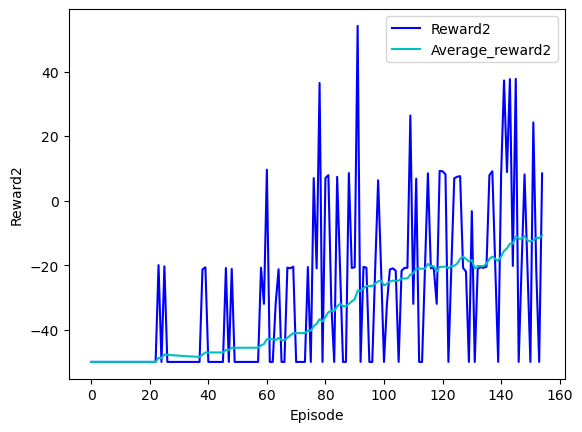

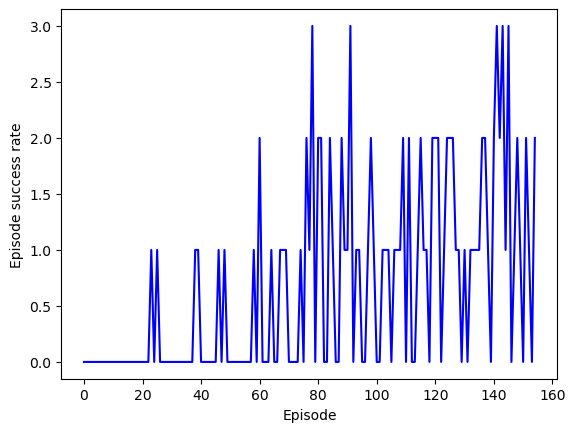

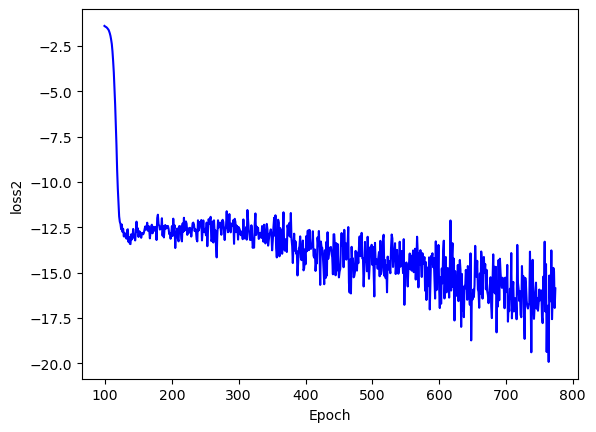

***** epoch 31 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88285.60432006064
r_em 52396.73341705182
52396.73341705182
ReWard2/R0 10.479346683410364
reward2 is: 18.479346683410363
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 4 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90834.23008753982
r_em 52149.31364222859
52149.31364222859
ReWard2/R0 10.429862728445718
reward2 is: 18.42986272844572
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 1m

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.7113539497813829
***** epoch 31 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79611.86290656496
r_em 54819.941495018415
54819.941495018415
ReWard2/R0 10.963988299003683
reward2 is: 18.96398829900368
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 6 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 7 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 8 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 9 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 12 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 5.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 13 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86656.8498070784
r_em 52890.172129657345
52890.172129657345
ReWard2/R0 10.578034425931468
reward2 is: 18.57803442593147
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 14 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.707805172103433
***** epoch 31 episode 3 *****
***** frame 15 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 17 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ..

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 23 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.7042740984433092


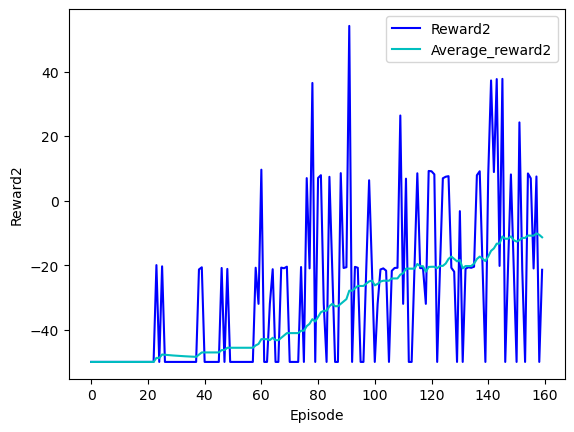

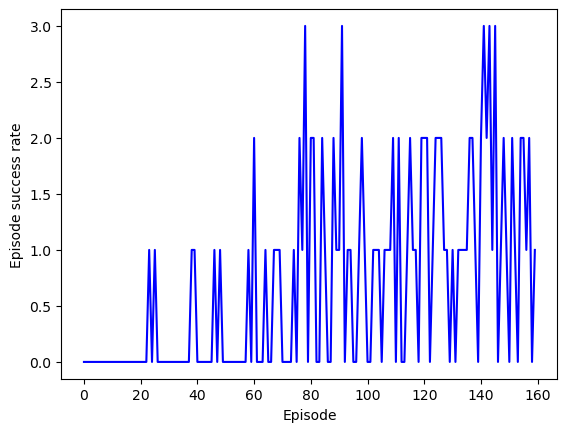

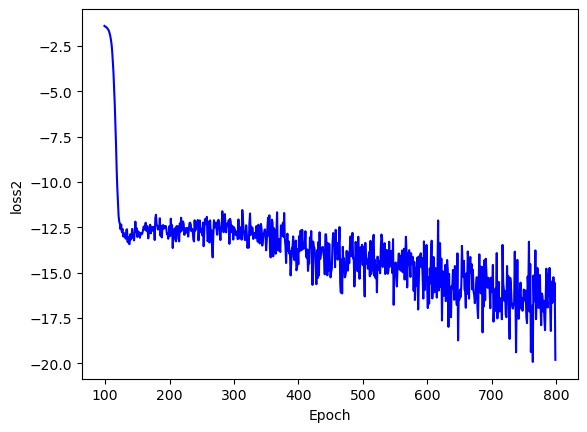

***** epoch 32 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83169.82649148289
r_em 54720.85565757545
54720.85565757545
ReWard2/R0 10.94417113151509
reward2 is: 18.94417113151509
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 2 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84862.01230897263
r_em 55225.222802193806
55225.222802193806
ReWard2/R0 11.045044560438761
reward2 is: 19.04504456043876
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 4 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.7025151730023247
***** epoch 32 episode 1 *****
***** frame 5 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 6 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 9 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85223.69115530554
r_em 53418.6457954536
53418.6457954536
ReWard2/R0 10.68372915909072
reward2 is: 18.68372915909072
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.7007606404798272
***** epoch 32 episode 2 *****
***** frame 10 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 11 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 12 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79702.3780365408
r_em 49918.99229531005
49918.99229531005
ReWard2/R0 9.98379845906201
reward2 is: 17.983798459062008
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [======================

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 13 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 14 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.6990104899044971
***** epoch 32 episode 3 *****
***** frame 15 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RB

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 19 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.697264710332416
***** epoch 32 episode 4 *****
***** frame 20 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 22 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 23 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 24 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91547.09896057186
r_em 52990.78389450848
52990.78389450848
ReWard2/R0 10.598156778901696
reward2 is: 18.598156778901696
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.6955232908469979


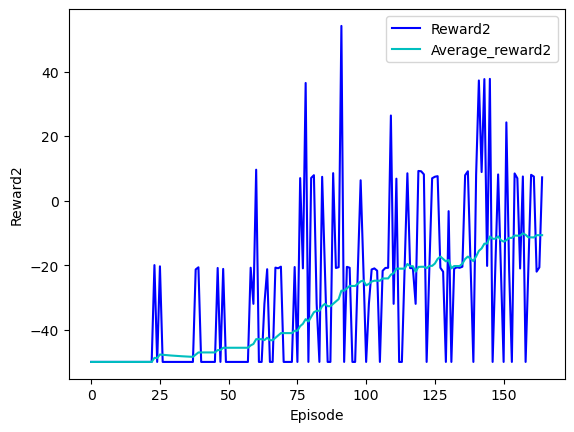

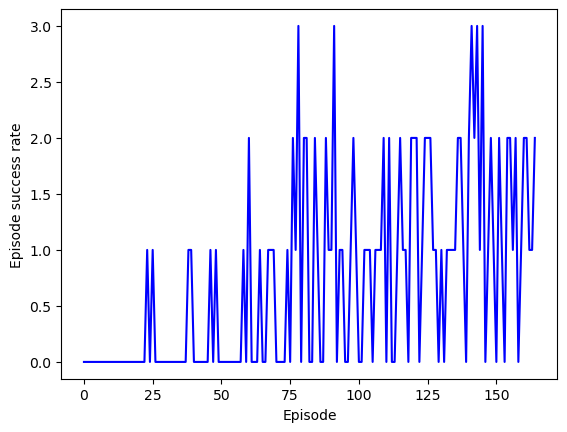

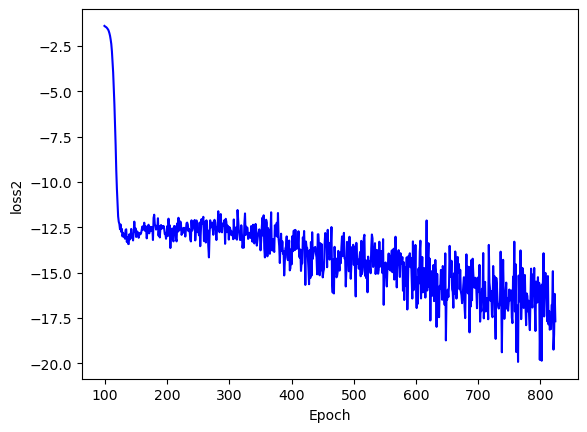

***** epoch 33 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 i

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 8 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 9 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.6920534886060592
***** epoch 33 episode 2 *****
***** frame 10 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 11 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
rewa

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 13 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 14 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.6903250841534151
***** epoch 33 episode 3 *****
***** frame 15 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 18 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79909.93252399478
r_em 54723.66865762157
54723.66865762157
ReWard2/R0 10.944733731524314
reward2 is: 18.944733731524316
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 19 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.6886009963930515
***** epoch 33 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89391.09807902966
r_em 54239.83685538687
54239.83685538687
ReWard2/R0 10.847967371077374
reward2 is: 18.847967371077374
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 22 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 23 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -1

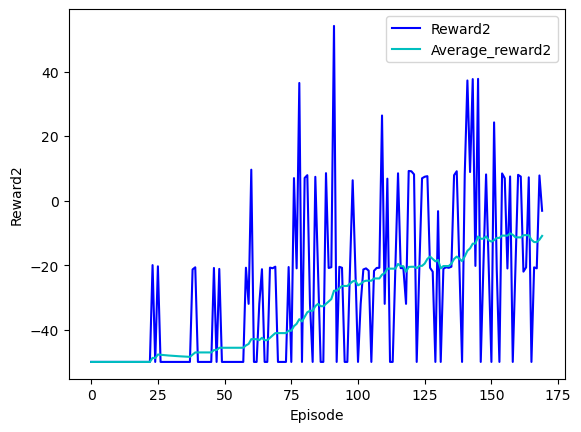

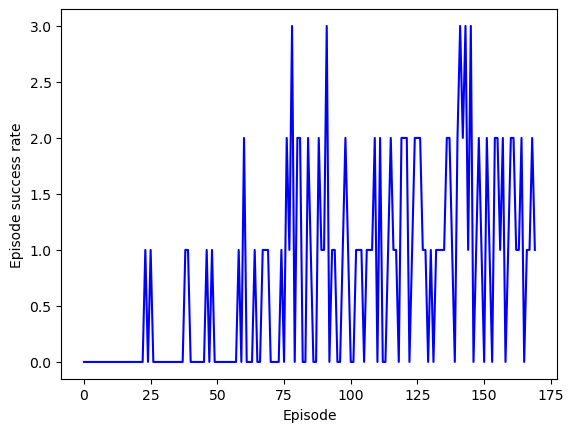

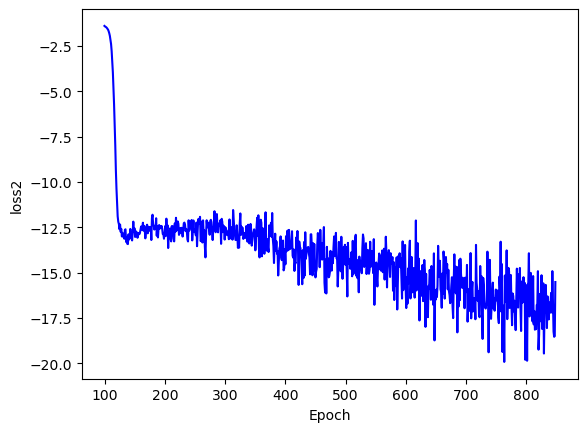

***** epoch 34 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 90397.10337156616
r_em 55304.48791819708
55304.48791819708
ReWard2/R0 11.060897583639417
reward2 is: 19.060897583639417
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 3 *****
we choose action2 with: explore
e_ur2 

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 11 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90345.12882012693
r_em 52284.64648204303
52284.64648204303
ReWard2/R0 10.456929296408605
reward2 is: 18.456929296408603
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 12 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 13 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 14 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90333.18919400532
r_em 52938.56458535086
52938.56458535086
ReWard2/R0 10.587712917070172
reward2 is: 18.58771291707017
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.6817475970589922
***** epoch 34 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85223.49423609758
r_em 57944.99978819346
57944.99978819346
ReWard2/R0 11.588999957638693
reward2 is: 19.58899995763869
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 17 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 18 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85267.5201956768
r_em 57879.35534705567
57879.35534705567
ReWard2/R0 11.575871069411134
reward2 is: 19.575871069411136
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ET

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 19 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80515.43600291404
r_em 57881.55442624611
57881.55442624611
ReWard2/R0 11.576310885249223
reward2 is: 19.57631088524922
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.6800449315833662
***** epoch 34 episode 4 *****
***** frame 20 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 23 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ..

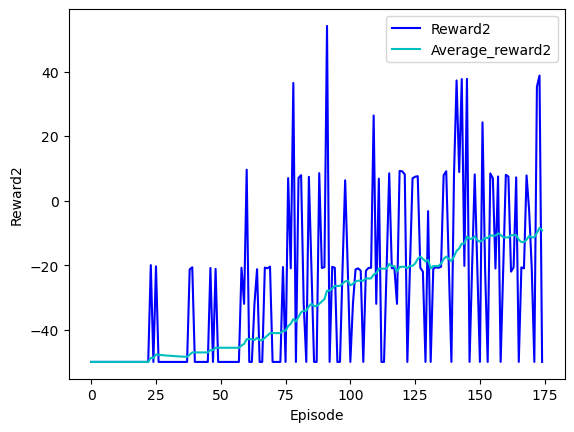

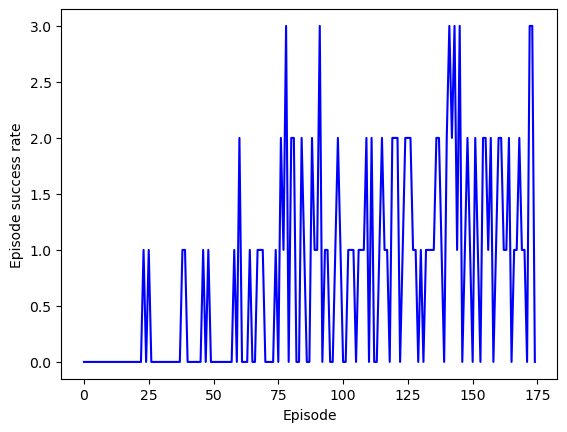

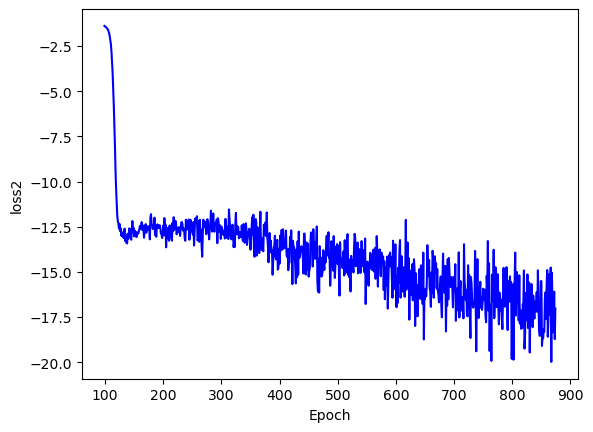

***** epoch 35 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 2 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89428.86834648902
r_em 52971.344962454816
52971.344962454816
ReWard2/R0 10.594268992490964
reward2 is: 18.594268992490964
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 4 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.6766523472391763
***** epoch 35 episode 1 *****
***** frame 5 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 6 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 3.0

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 9 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.6749624071563427
***** epoch 35 episode 2 *****
***** frame 10 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 11 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 84845.02965836732
r_em 54908.158040023365
54908.158040023365
ReWard2/R0 10.981631608004673
reward2 is: 18.981631608004673
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step
***** frame 12 ***

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 17 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82681.01836709213
r_em 55371.41553573549
55371.41553573549
ReWard2/R0 11.074283107147098
reward2 is: 19.074283107147096
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 1ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 18 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83060.8306642621
r_em 54701.6331733344
54701.6331733344
ReWard2/R0 10.94032663466688
reward2 is: 18.94032663466688
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 19 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85674.54491627231
r_em 55505.45789972851
55505.45789972851
ReWard2/R0 11.101091579945702
reward2 is: 19.101091579945702
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.6715951783320595
***** epoch 35 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84850.35941980084
r_em 55413.635883862735
55413.635883862735
ReWard2/R0 11.082727176772547
reward2 is: 19.082727176772547
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 21 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84989.8314835775
r_em 54954.599273647575
54954.599273647575
ReWard2/R0 10.990919854729515
reward2 is: 18.990919854729515
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 23 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85874.12794505719
r_em 54220.60952492398
54220.60952492398
ReWard2/R0 10.844121904984796
reward2 is: 18.844121904984796
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.6699178685348912


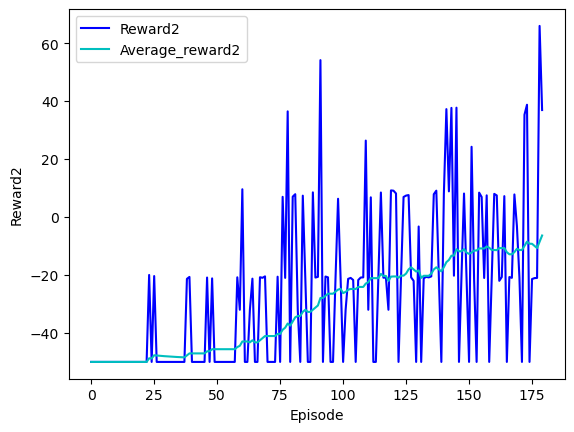

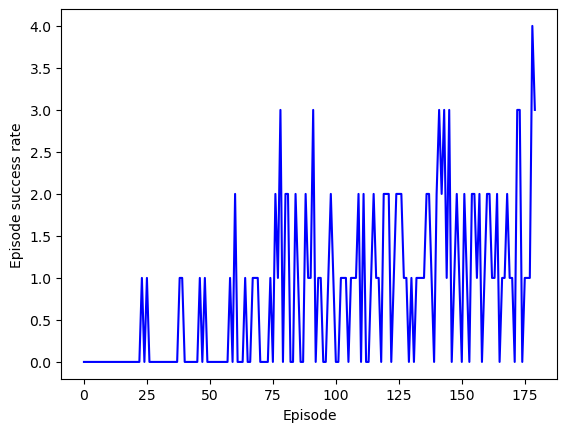

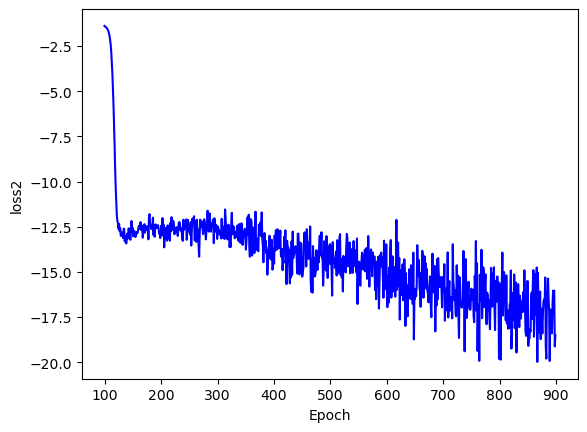

***** epoch 36 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 2 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ... 

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 13 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90097.76686552644
r_em 56799.81154384369
56799.81154384369
ReWard2/R0 11.359962308768738
reward2 is: 19.359962308768736
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 14 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.6649110318204399
***** epoch 36 episode 3 *****
***** frame 15 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 16 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94571.23056387069
r_em 52945.03123651618
52945.03123651618
ReWard2/R0 10.589006247303237
reward2 is: 18.58900624730324
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [======================

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 17 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 18 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 19 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.6632504156875374
***** epoch 36 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 21 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87961.3743527464
r_em 55559.22106812919
55559.22106812919
ReWard2/R0 11.111844213625838
reward2 is: 19.111844213625837
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 23 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85751.59778223479
r_em 55448.81638736707
55448.81638736707
ReWard2/R0 11.089763277473415
reward2 is: 19.089763277473416
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.6615939469455022


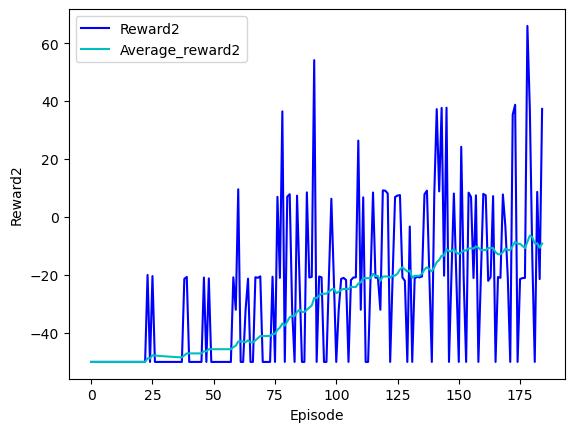

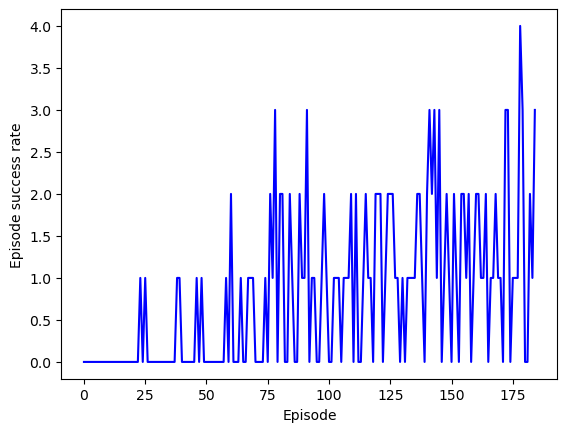

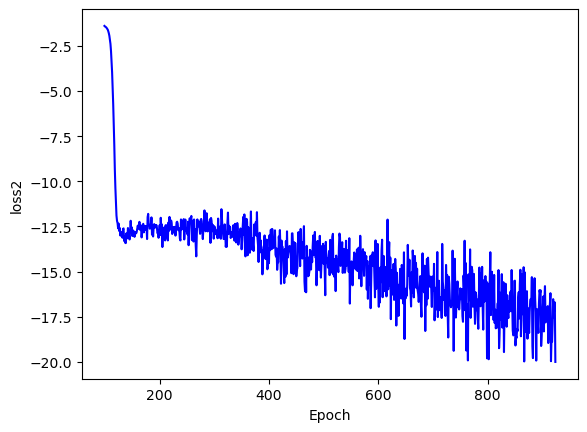

***** epoch 37 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 2 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78243.08821195007
r_em 56922.82414096034
56922.82414096034
ReWard2/R0 11.384564828192069
reward2 is: 19.38456482819207
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 4 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78024.36302832427
r_em 57297.2331061099
57297.2331061099
ReWard2/R0 11.45944662122198
reward2 is: 19.45944662122198
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.6599416152362202
***** epoch 37 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83300.14609684376
r_em 57163.31744200009
57163.31744200009
ReWard2/R0 11.432663488400017
reward2 is: 19.432663488400017
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 6 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83675.8846703264
r_em 56893.60790340833
56893.60790340833
ReWard2/R0 11.378721580681667
reward2 is: 19.378721580681667
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 7 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 8 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90872.53734578038
r_em 56263.85540184073
56263.85540184073
ReWard2/R0 11.252771080368147
reward2 is: 19.25277108036815
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 9 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92410.80698066977
r_em 56018.62378821265
56018.62378821265
ReWard2/R0 11.203724757642531
reward2 is: 19.203724757642533
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.658293410227447
***** epoch 37 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 11 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 12 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88321.30972087762
r_em 54328.62452733441
54328.62452733441
ReWard2/R0 10.865724905466882
reward2 is: 18.865724905466884
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss,

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 13 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 14 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.6566493216127431
***** epoch 37 episode 3 *****
***** frame 15 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not 

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
Epsilon_hist is: 0.6533734524684215


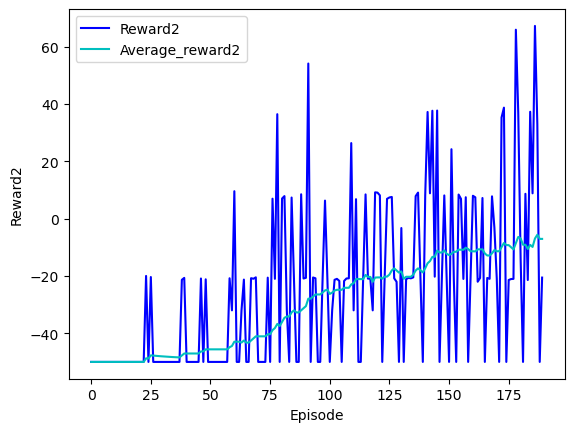

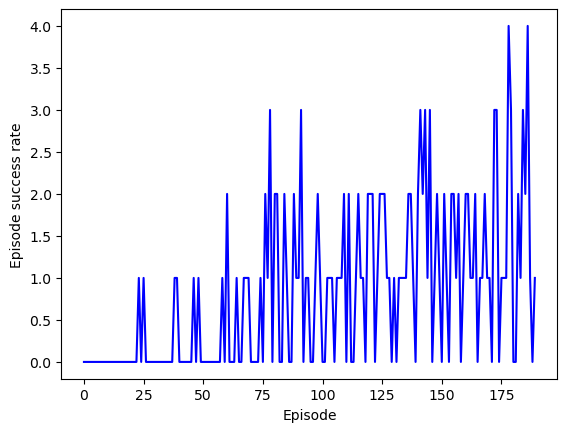

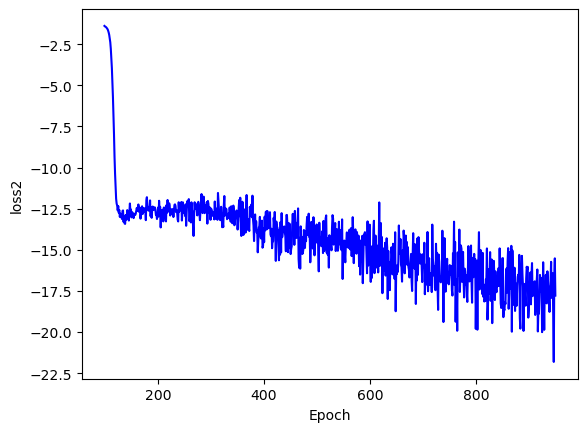

***** epoch 38 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 94831.12185511335
r_em 52875.681025896294
52875.681025896294
ReWard2/R0 10.575136205179259
reward2 is: 18.57513620517926
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 2 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 91196.9431240439
r_em 51363.012925915566
51363.012925915566
ReWard2/R0 10.272602585183114
reward2 is: 18.272602585183115
total number of ur2 R

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 9 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84085.75037606657
r_em 54017.72018125298
54017.72018125298
ReWard2/R0 10.803544036250596
reward2 is: 18.803544036250596
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.6501139258653886
***** epoch 38 episode 2 *****
***** frame 10 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 11 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 12 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 13 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [

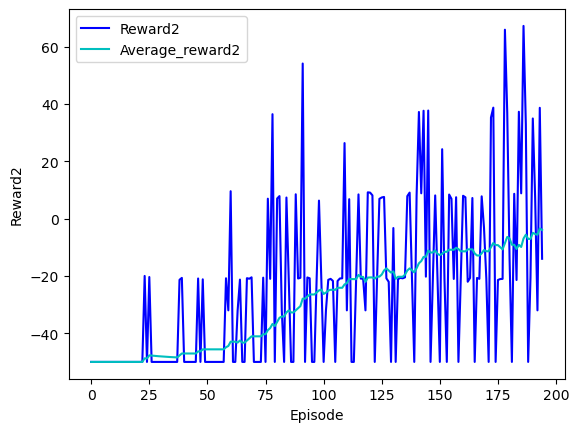

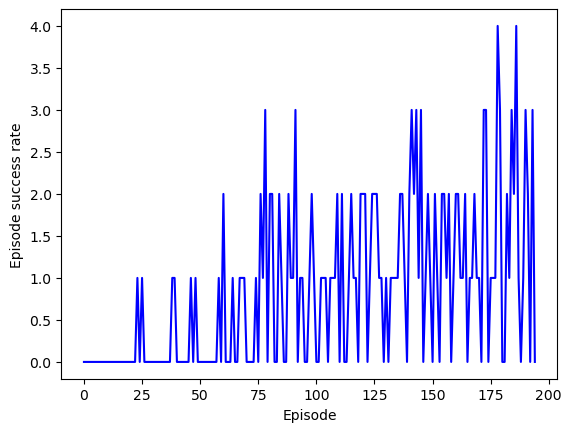

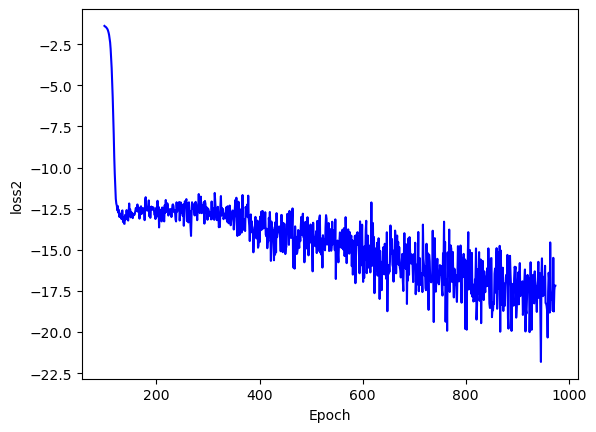

***** epoch 39 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 2 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80302.68323736676
r_em 55108.22795633805
55108.22795633805
ReWard2/R0 11.02164559126761
reward2 is: 19.02164559126761
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 4 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.6436435745735278
***** epoch 39 episode 1 *****
***** frame 5 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 6 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 7 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 8 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92639.68254798916
r_em 57300.86265439396
57300.86265439396
ReWard2/R0 11.460172530878792
reward2 is: 19.460172530878793
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 9 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
Epsilon_hist is: 0.6420360739416774
***** epoch 39 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92098.86919215016
r_em 55742.54387658781
55742.54387658781
ReWard2/R0 11.148508775317563
reward2 is: 19.148508775317563
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 11 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92256.8322043778
r_em 55753.19849157005
55753.19849157005
ReWard2/R0 11.150639698314011
reward2 is: 19.15063969831401
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 12 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 13 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 14 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.6404325880446637
***** epoch 39 episode 3 *****
***** frame 15 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 17 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 18 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 19 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
Epsilon_hist is: 0.6388331068556816
***** epoch 39 episode 4 *****
***** frame 20 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.6372376203729679


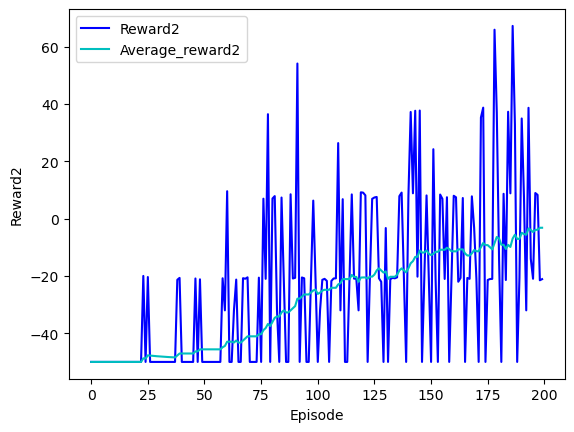

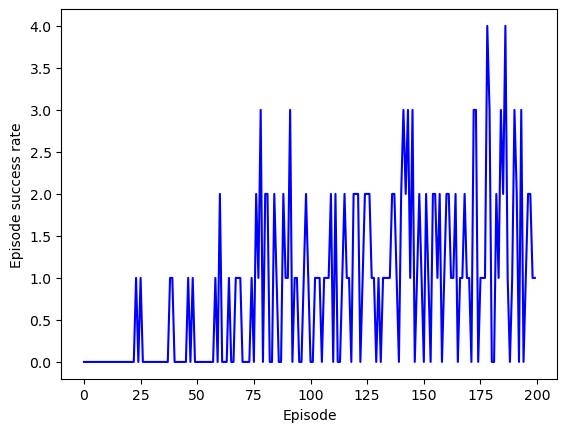

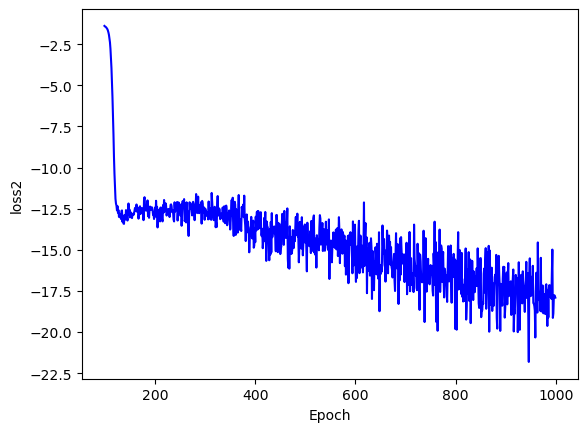

***** epoch 40 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 2 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 94169.50778252518
r_em 54438.42913439359
54438.42913439359
ReWard2/R0 10.887685826878718
reward2 is: 18.887685826878716
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step
***** frame 3 *****
we

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 8 *****
1/1 [==============================] - 0s 61ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81554.38558286267
r_em 55029.58173429236
55029.58173429236
ReWard2/R0 11.005916346858472
reward2 is: 19.00591634685847
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 9 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.6340585916441271
***** epoch 40 episode 2 *****
***** frame 10 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 11 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 89890.11740682596
r_em 54503.84681911782
54503.84681911782
ReWard2/R0 10.900769363823564
reward2 is: 18.900769363823564
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss,

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 5.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 17 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 18 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 19 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 951

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.630895422342501
***** epoch 40 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 91455.27334724908
r_em 51363.3531352953
51363.3531352953
ReWard2/R0 10.27267062705906
reward2 is: 18.27267062705906
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step
***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 22 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 89698.9613241075
r_em 51514.308341097334
51514.308341097334


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.6293197602367786


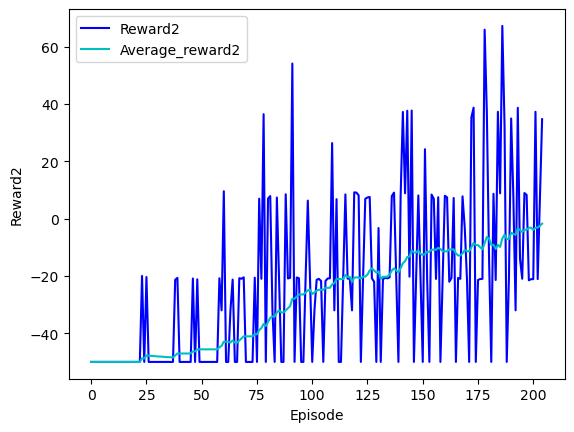

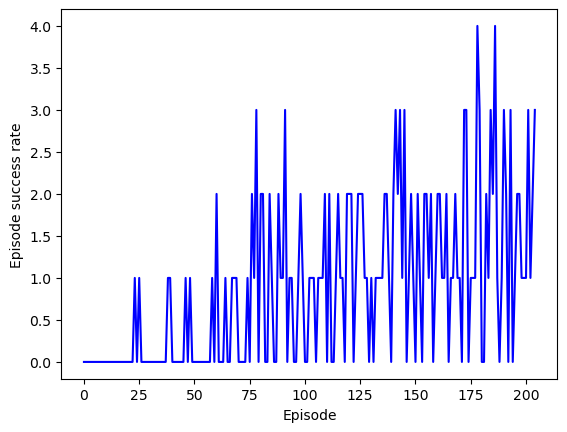

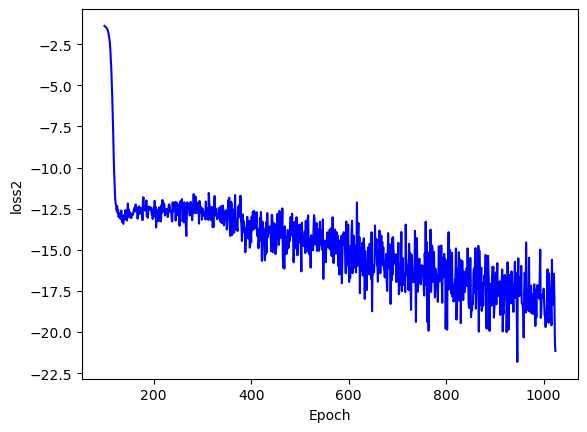

***** epoch 41 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 i

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 6 *****
1/1 [==============================] - 0s 44ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 93301.30634024518
r_em 57545.30908396837
57545.30908396837
ReWard2/R0 11.509061816793674
reward2 is: 19.509061816793675
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step
***** frame 7 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 8 *****
1/1 [==============================] - 0s 50ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 91105.05568911711
r_em 56483.73893287252
56483.73893287252
ReWard2/R0 11.296747786574503
reward2 is: 19.296747786574503
tot

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 11 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 12 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 13 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 14 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not 

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 17 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 76340.53404132664
r_em 56668.51073118524
56668.51073118524
ReWard2/R0 11.333702146237048
reward2 is: 19.333702146237048
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 18 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 19 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.6230563658352183
***** epoch 41 episode 4 *****
***** frame 20 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3

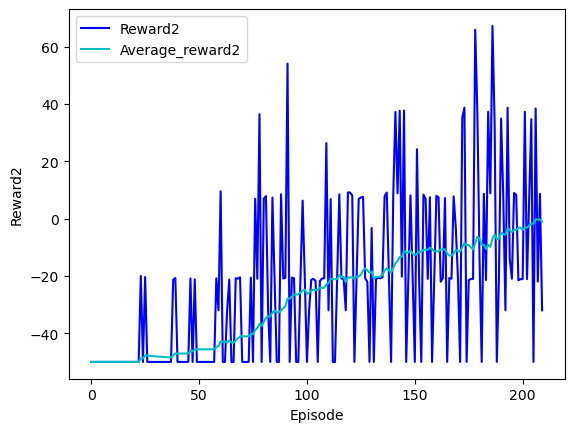

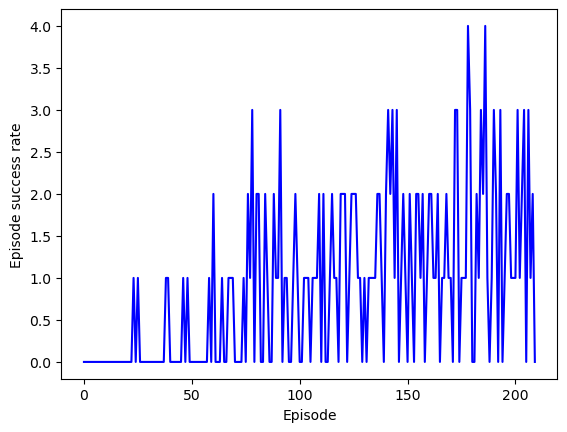

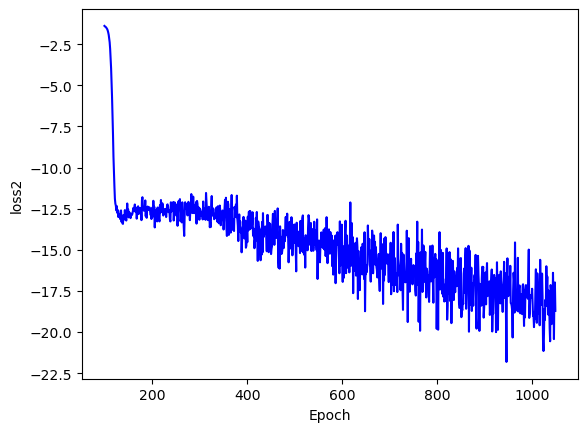

***** epoch 42 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80153.98264677101
r_em 55169.11207491013
55169.11207491013
ReWard2/R0 11.033822414982026
reward2 is: 19.033822414982026
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 4 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 90682.5045228579
r_em 55691.14520460618
55691.14520460618
ReWard2/R0 11.138229040921237
reward2 is: 19.13822904092124
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step
Epsilon

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.6183997629378232
***** epoch 42 episode 2 *****
***** frame 10 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 11 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 12 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87783.9394525956
r_em 55238.52991884669
55238.52991884669
ReWard2/R0 11.047705983769339
reward2 is: 19.04770598376934
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [=====

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 13 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 14 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91671.03339714938
r_em 54980.43718894302
54980.43718894302
ReWard2/R0 10.996087437788603
reward2 is: 18.996087437788603
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.6168553087570796
***** epoch 42 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87466.9769404731
r_em 55607.791335063426
55607.791335063426
ReWard2/R0 11.121558267012686
reward2 is: 19.121558267012688
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 17 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86707.60233838347
r_em 55314.02198145463
55314.02198145463
ReWard2/R0 11.062804396290925
reward2 is: 19.062804396290925
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 18 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 19 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.6153147118525827
***** epoch 42 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90457.59124110852
r_em 55315.00919153459
55315.00919153459
ReWard2/R0 11.063001838306919
reward2 is: 19.063001838306917
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [=====================

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 21 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90376.33331442697
r_em 55372.778678479255
55372.778678479255
ReWard2/R0 11.074555735695851
reward2 is: 19.074555735695853
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 22 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91312.27613070152
r_em 55111.69616247727
55111.69616247727
ReWard2/R0 11.022339232495453
reward2 is: 19.022339232495455
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 23 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91717.78938757461
r_em 55424.14588027715
55424.14588027715
ReWard2/R0 11.08482917605543
reward2 is: 19.08482917605543
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 1ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.6137779625907799


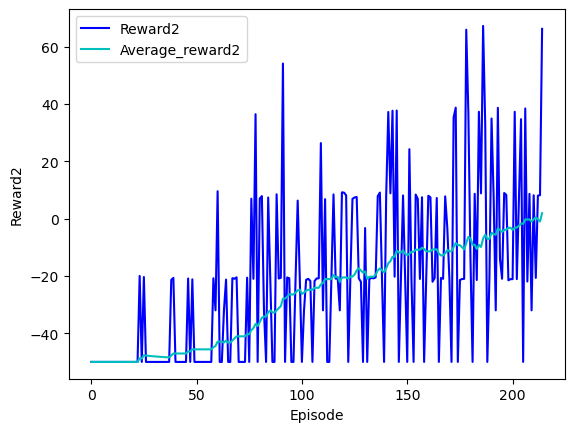

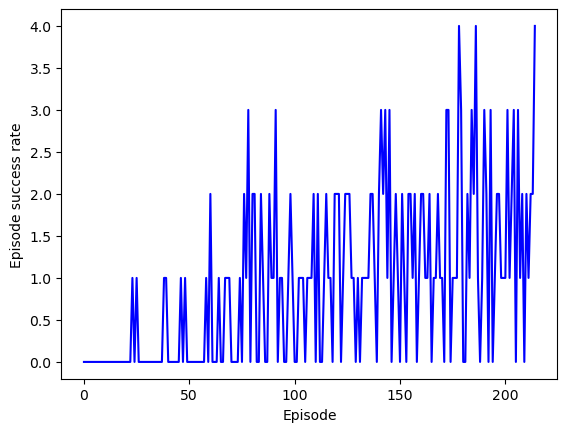

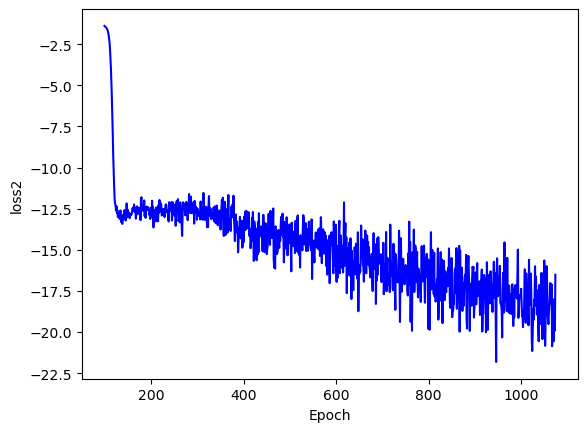

***** epoch 43 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80884.52204347
r_em 56487.46080584711
56487.46080584711
ReWard2/R0 11.297492161169423
reward2 is: 19.297492161169423
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 4 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 74612.03779291765
r_e

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.6122450513621789
***** epoch 43 episode 1 *****
***** frame 5 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 6 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 7 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 8 *****
1/1 [==============================] - 0s 21ms/

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 9 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94005.88770745443
r_em 55355.77456651354
55355.77456651354
ReWard2/R0 11.071154913302708
reward2 is: 19.071154913302706
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.6107159685812871
***** epoch 43 episode 2 *****
***** frame 10 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 11 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 12 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 5.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 13 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 17 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 18 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88015.2807028267
r_em 54229.26895081387
54229.26895081387
ReWard2/R0 10.845853790162774
reward2 is: 18.845853790162774
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 19 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
Epsilon_hist is: 0.6076692501402988
***** epoch 43 episode 4 *****
***** frame 20 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 21 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 73464.35444684603
r_em 54552.351730628725
54552.351730628725
ReWard2/R0 10.910470346125745
reward2 is: 18.910470346125745
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [=================

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 23 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.606151595428677


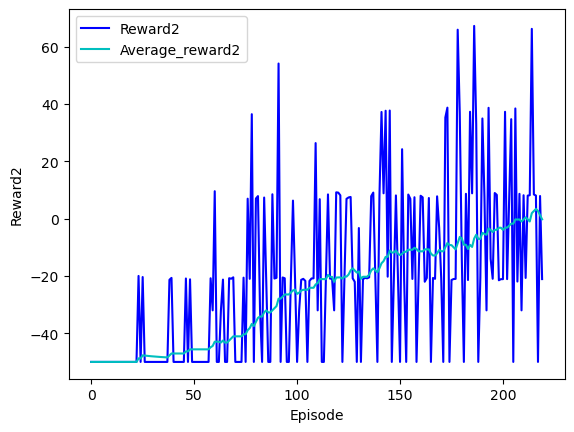

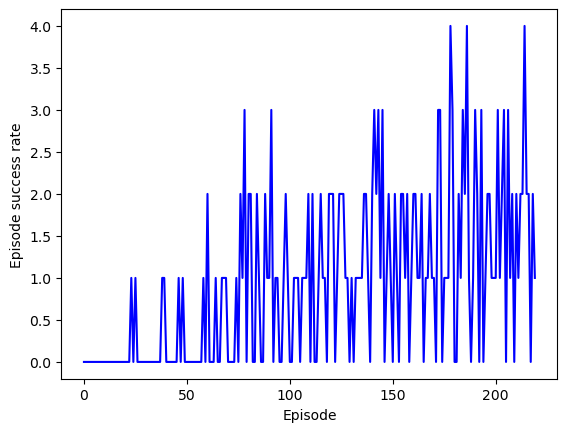

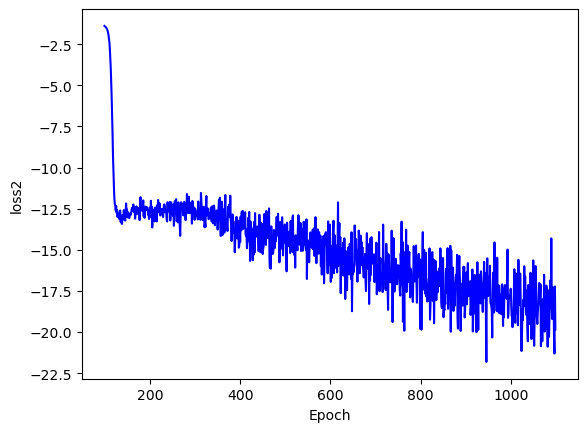

***** epoch 44 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84026.31724514908
r_em 54568.33610569954
54568.33610569954
ReWard2/R0 10.913667221139908
reward2 is: 18.91366722113991
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 1 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77911.70136414684
r_em 54435.591448694686
54435.591448694686
ReWard2/R0 10.887118289738938
reward2 is: 18.887118289738936
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 2 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83572.8563877582
r_em 55277.5581018441
55277.5581018441
ReWard2/R0 11.05551162036882
reward2 is: 19.05551162036882
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 4 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84010.08062347335
r_em 55039.22342376465
55039.22342376465
ReWard2/R0 11.00784468475293
reward2 is: 19.007844684752932
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.604637731061594
***** epoch 44 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 83352.41716570716
r_em 54090.48973174396
54090.48973174396
ReWard2/R0 10.818097946348793
reward2 is: 18.818097946348793
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step
***** frame 6 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84863.3010426373
r_em 54569.90470589625
54569.90470589625
ReWard2/R0 10.91398094117925
reward2 is: 18.91398094117925
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 7 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86224.72370197656
r_em 54257.294329747565
54257.294329747565
ReWard2/R0 10.851458865949512
reward2 is: 18.85145886594951
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 8 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 9 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 88127.97914124215
r_em 54953.474486701925
54953.474486701925
ReWard2/R0 10.990694897340385
reward2 is: 18.990694897340383
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.6031276475726596
***** epoch 44 episode 2 *****
***** frame 10 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 13 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 14 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.601621335519126
***** epoch 44 episode 3 *****
***** frame 15 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
rewar

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 18 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 19 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89487.64467659613
r_em 53755.90177042784
53755.90177042784
ReWard2/R0 10.751180354085568
reward2 is: 18.75118035408557
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.6001187854818283
***** epoch 44 episode 4 *****
***** frame 20 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 23 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps 

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.5986199880651266


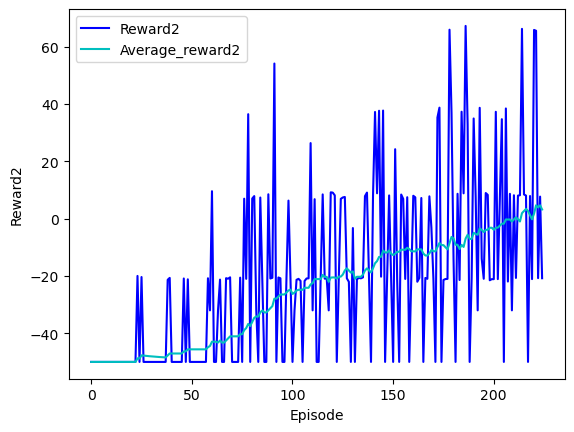

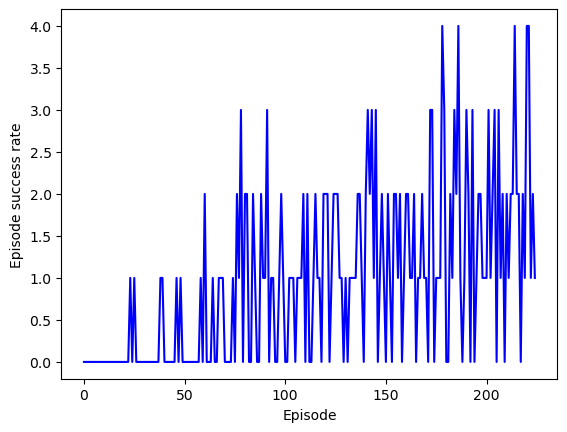

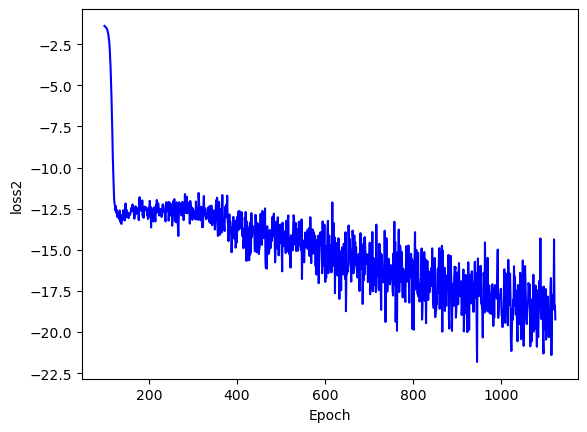

***** epoch 45 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is:

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.5971249338968463
***** epoch 45 episode 1 *****
***** frame 5 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 6 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 7 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91029.89949818808
r_em 52135.74109799411
52135.74109799411
ReWard2/R0 10.427148219598822
reward2 is: 18.42714821959882
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 8 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91985.99901432852
r_em 50545.63299091353
50545.63299091353
ReWard2/R0 10.109126598182707
reward2 is: 18.109126598182705
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 9 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.5956336136282195
***** epoch 45 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87135.80811468796
r_em 56200.02456907301
56200.02456907301
ReWard2/R0 11.240004913814602
reward2 is: 19.2400049138146
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 1ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 11 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 12 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 5.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 13 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86348.292250569
r_em 56633.77790815784
56633.77790815784
ReWard2/R0 11.326755581631568
reward2 is: 19.326755581631566
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 14 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.5941460179338273
***** epoch 45 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83860.44806976152
r_em 54841.74112660524
54841.74112660524
ReWard2/R0 10.968348225321048
reward2 is: 18.968348225321048
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 16 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85273.01271248191
r_em 53903.04474598322
53903.04474598322
ReWard2/R0 10.780608949196644
reward2 is: 18.780608949196644
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 17 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87107.90159473033
r_em 53272.48651235656
53272.48651235656
ReWard2/R0 10.654497302471313
reward2 is: 18.654497302471313
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 1ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 18 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 19 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.5926621375115408
***** epoch 45 episode 4 *****
***** frame 20 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 21 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3.

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 23 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85532.35228521343
r_em 56834.151734016705
56834.151734016705
ReWard2/R0 11.366830346803342
reward2 is: 19.36683034680334
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 24 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85944.04162464438
r_em 57640.02173302766
57640.02173302766
ReWard2/R0 11.528004346605531
reward2 is: 19.52800434660553
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.5911819630824635


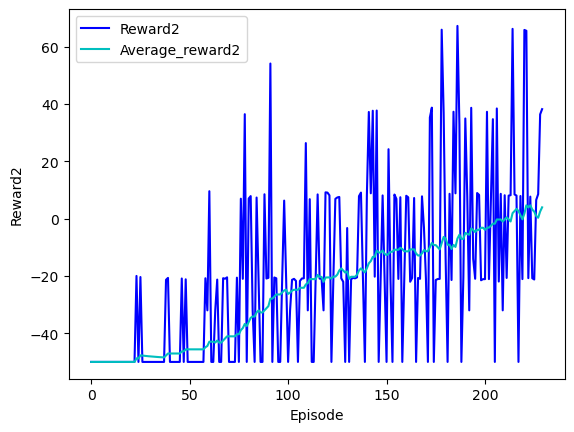

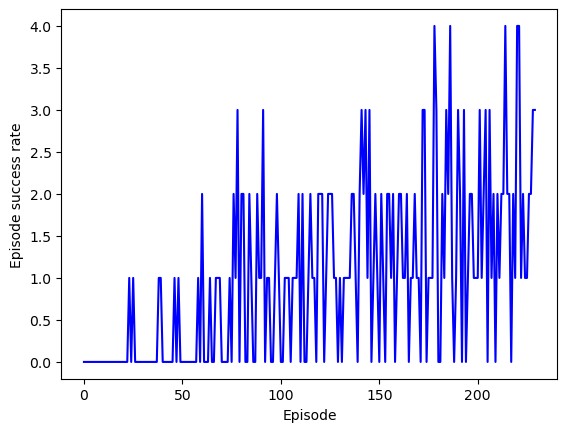

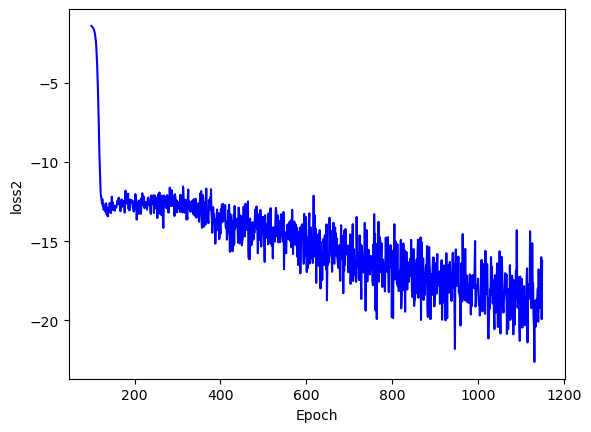

***** epoch 46 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93075.0467576743
r_em 54602.814744129035
54602.814744129035
ReWard2/R0 10.920562948825808
reward2 is: 18.920562948825808
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 2 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92100.3856104521
r_em 54079.698329411476
54079.698329411476
ReWard2/R0 10.815939665882295
reward2 is: 18.815939665882297
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 3 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91288.08330399662
r_em 54982.73768504499
54982.73768504499
ReWard2/R0 10.996547537008997
reward2 is: 18.996547537008997
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 4 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.5897054853908725
***** epoch 46 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92769.49018880124
r_em 57186.32028546441
57186.32028546441
ReWard2/R0 11.437264057092882
reward2 is: 19.437264057092882
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 6 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 7 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94040.51306366184
r_em 56712.01521180878
56712.01521180878
ReWard2/R0 11.342403042361756
reward2 is: 19.342403042361756
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 8 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 5.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 9 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93372.69290223415
r_em 54836.518404521215
54836.518404521215
ReWard2/R0 10.967303680904243
reward2 is: 18.967303680904244
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.5882326952041615
***** epoch 46 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89868.22827162006
r_em 54564.72740822041
54564.72740822041
ReWard2/R0 10.912945481644082
reward2 is: 18.91294548164408
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 11 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95078.83787185799
r_em 53529.70325869506
53529.70325869506
ReWard2/R0 10.705940651739011
reward2 is: 18.705940651739013
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 12 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95575.36093123771
r_em 52067.94252657254
52067.94252657254
ReWard2/R0 10.413588505314507
reward2 is: 18.413588505314507
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 13 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 14 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95375.40736344931
r_em 52687.31775518453
52687.31775518453
ReWard2/R0 10.537463551036906
reward2 is: 18.537463551036907
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.5867635833127822
***** epoch 46 episode 3 *****
***** frame 15 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 17 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 18 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.5852981405301875
***** epoch 46 episode 4 *****
***** frame 20 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 21 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82096.38581594912
r_em 55493.37292203512
55493.37292203512
ReWard2/R0 11.098674584407025
reward2 is: 19.098674584407025
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 23 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.5838363576927736


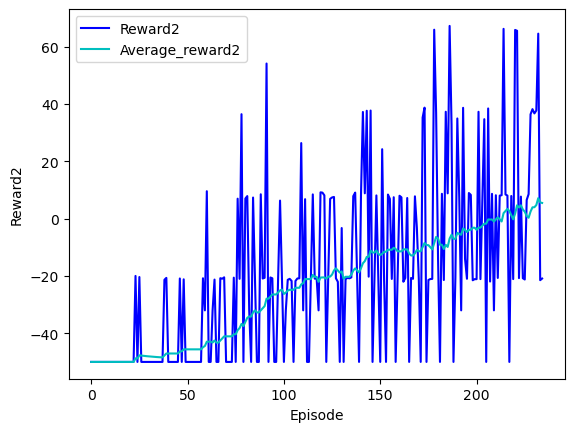

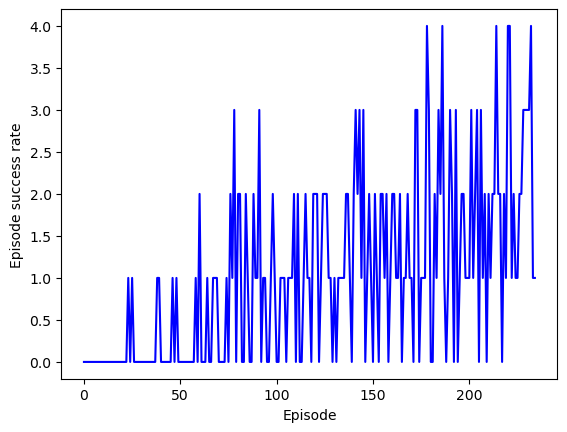

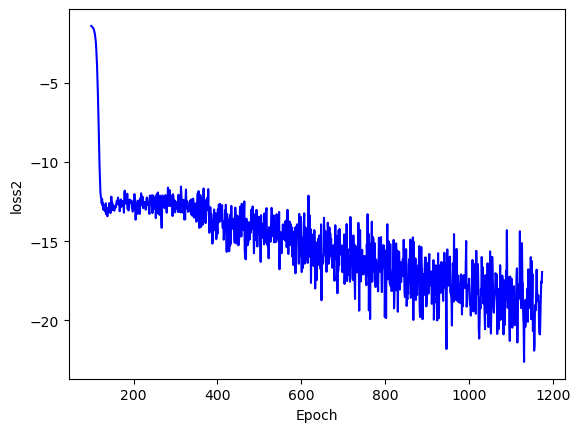

***** epoch 47 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 2 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84523.14578566529
r_em 54094.93446353862
54094.93446353862
ReWard2/R0 10.818986892707725
reward2 is: 18.818986892707727
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2m

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 4 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86745.52537942285
r_em 54858.99865195228
54858.99865195228
ReWard2/R0 10.971799730390456
reward2 is: 18.971799730390458
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.582378225659823
***** epoch 47 episode 1 *****
***** frame 5 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 6 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 5.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 7 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87643.79238961369
r_em 56517.5356278325
56517.5356278325
ReWard2/R0 11.3035071255665
reward2 is: 19.303507125566497
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 8 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88249.18775833628
r_em 56890.39537758152
56890.39537758152
ReWard2/R0 11.378079075516304
reward2 is: 19.378079075516304
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 9 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88199.31174440694
r_em 57101.62895194811
57101.62895194811
ReWard2/R0 11.420325790389622
reward2 is: 19.420325790389622
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.5809237353134469
***** epoch 47 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87808.26317969065
r_em 53975.0247846973
53975.0247846973
ReWard2/R0 10.79500495693946
reward2 is: 18.795004956939458
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 11 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88504.4811746164
r_em 53076.4155835099
53076.4155835099
ReWard2/R0 10.61528311670198
reward2 is: 18.61528311670198
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 12 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 13 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89087.09278751748
r_em 52260.78594196517
52260.78594196517
ReWard2/R0 10.452157188393034
reward2 is: 18.452157188393034
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 14 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.5794728775585286
***** epoch 47 episode 3 *****
***** frame 15 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 17 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 18 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 98530.15927276095
r_em 57037.00629037922
57037.00629037922
ReWard2/R0 11.407401258075843
reward2 is: 19.407401258075843
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 19 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.5780256433226661
***** epoch 47 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87735.86392791285
r_em 54546.95566454312
54546.95566454312
ReWard2/R0 10.909391132908624
reward2 is: 18.909391132908624
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 23 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RB

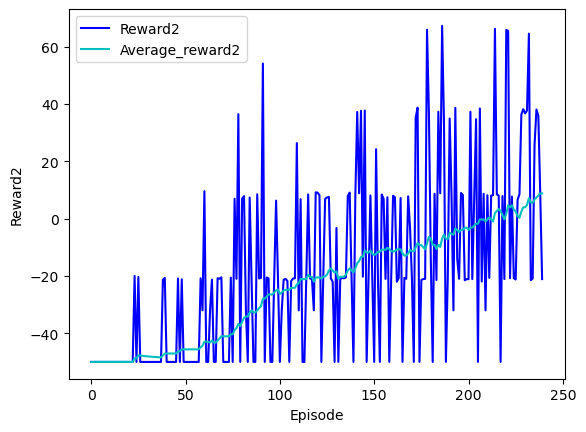

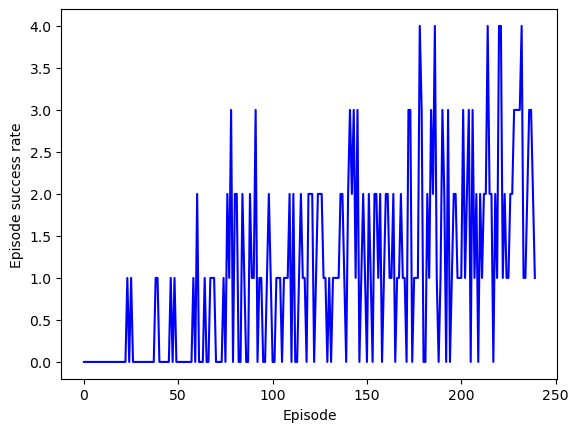

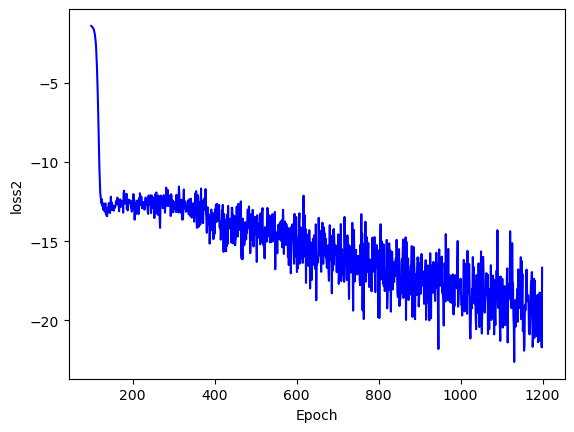

***** epoch 48 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 84370.11948928161
r_em 56263.79521003572
56263.79521003572
ReWard2/R0 11.252759042007144
reward2 is: 19.252759042007142
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 3 *****
we ch

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.5737055913449342
***** epoch 48 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 11 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 12 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 13 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 17 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 18 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 19 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 23 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 24 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93124.63632241826
r_em 58224.98551137744
58224.98551137744
ReWard2/R0 11.644997102275488
reward2 is: 19.64499710227549
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.5694178266010056


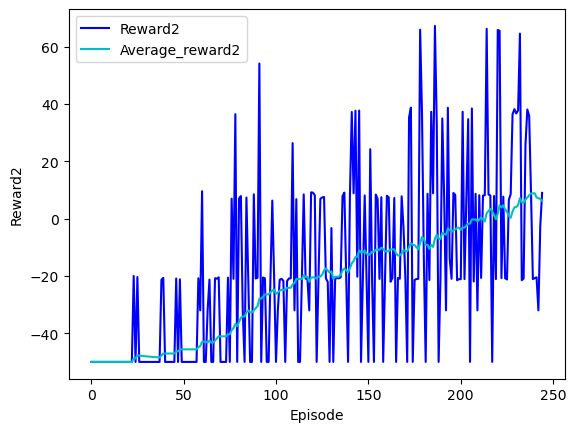

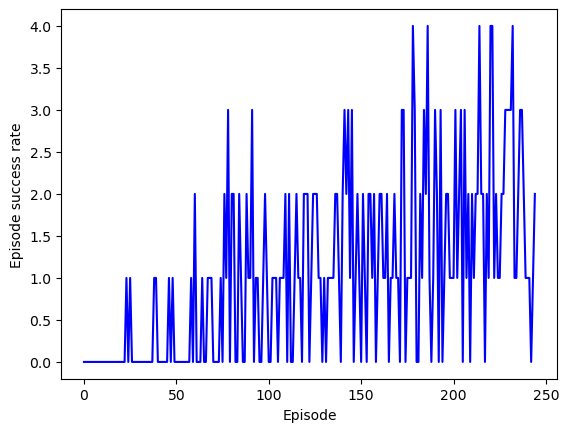

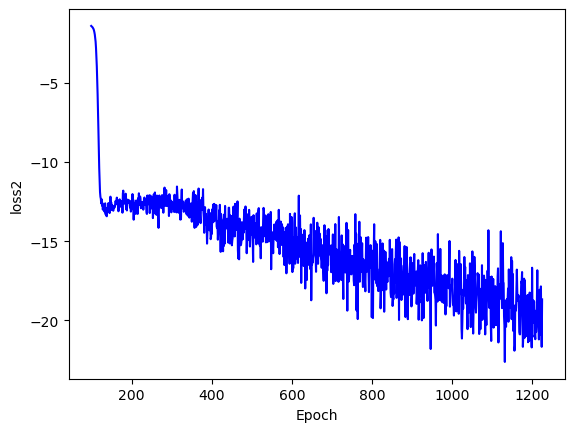

***** epoch 49 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 15ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90159.08758186248
r_em 54207.763064756306
54207.763064756306
ReWard2/R0 10.841552612951261
reward2 is: 18.84155261295126
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 1 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90641.6083770995
r_em 53013.52153425083
53013.52153425083
ReWard2/R0 10.602704306850166
reward2 is: 18.602704306850164
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 2 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91158.16311126185
r_em 51894.72474597401
51894.72474597401
ReWard2/R0 10.378944949194802
reward2 is: 18.378944949194803
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 1ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 3 *****
1/1 [==============================] - 0s 15ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91455.12579300546
r_em 52857.008838650225
52857.008838650225
ReWard2/R0 10.571401767730045
reward2 is: 18.571401767730045
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 4 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91245.90582905468
r_em 51744.64351937467
51744.64351937467
ReWard2/R0 10.348928703874934
reward2 is: 18.348928703874932
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.5679957048674754
***** epoch 49 episode 1 *****
***** frame 5 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 6 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81735.17160802442
r_em 54143.24430549008
54143.24430549008
ReWard2/R0 10.828648861098015
reward2 is: 18.828648861098017
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 7 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82798.10732493634
r_em 53538.49377569911
53538.49377569911
ReWard2/R0 10.707698755139823
reward2 is: 18.707698755139823
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 8 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83687.31944684207
r_em 53573.89843076159
53573.89843076159
ReWard2/R0 10.714779686152317
reward2 is: 18.71477968615232
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 9 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84368.98627934145
r_em 54318.965656970984
54318.965656970984
ReWard2/R0 10.863793131394196
reward2 is: 18.863793131394196
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.5665771348847519
***** epoch 49 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 68029.99694091598
r_em 54118.79006596803
54118.79006596803
ReWard2/R0 10.823758013193606
reward2 is: 18.823758013193604
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 11 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 71822.69891343453
r_em 54046.658744862405
54046.658744862405
ReWard2/R0 10.80933174897248
reward2 is: 18.809331748972483
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 12 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 72640.91788775586
r_em 52321.486190964206
52321.486190964206
ReWard2/R0 10.464297238192842
reward2 is: 18.46429723819284
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 13 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 74843.20066698799
r_em 54033.40019133029
54033.40019133029
ReWard2/R0 10.806680038266059
reward2 is: 18.80668003826606
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 14 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.5651621077823331
***** epoch 49 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 16 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 17 *****
1/1 [==============================] - 0s 17ms/step
we

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 18 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 5.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 19 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.5637506147118709
***** epoch 49 episode 4 *****
***** frame 20 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 21 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
O

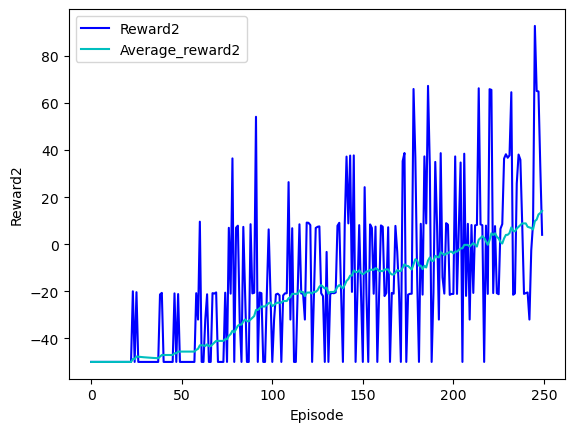

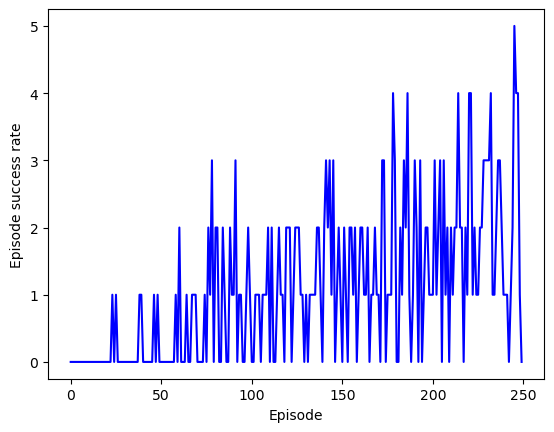

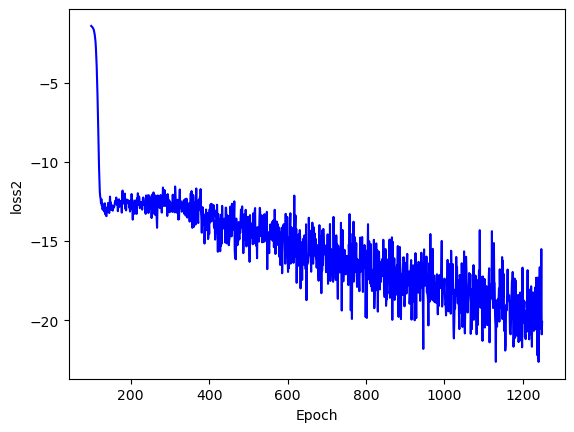

***** epoch 50 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84280.27894202914
r_em 57745.03866463991
57745.03866463991
ReWard2/R0 11.549007732927983
reward2 is: 19.549007732927983
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 1 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85730.03889484548
r_em 57453.49552694025
57453.49552694025
ReWard2/R0 11.49069910538805
reward2 is: 19.49069910538805
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 2 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82211.19024211499
r_em 57354.55026325056
57354.55026325056
ReWard2/R0 11.470910052650112
reward2 is: 19.47091005265011
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 4 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.5609381953838629
***** epoch 50 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86550.51225178246
r_em 58236.61233574067
58236.61233574067
ReWard2/R0 11.647322467148134
reward2 is: 19.647322467148136
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [========================

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 6 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89603.55541371627
r_em 58325.789456510145
58325.789456510145
ReWard2/R0 11.665157891302028
reward2 is: 19.66515789130203
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 1ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 7 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 8 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 9 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
Epsilon_hist is: 0.5595372515398943
***** epoch 50 episode 2 *****
***** frame 10 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not me

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 13 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83571.65574833036
r_em 57725.32602889008
57725.32602889008
ReWard2/R0 11.545065205778016
reward2 is: 19.545065205778016
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 14 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83600.1753847573
r_em 57660.36605210431
57660.36605210431
ReWard2/R0 11.532073210420863
reward2 is: 19.53207321042086
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.5581398065549269
***** epoch 50 episode 3 *****
***** frame 15 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 16 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94600.64549688033
r_em 54955.41667736355
54955.41667736355
ReWard2/R0 10.99108333547271
reward2 is: 18.99108333547271
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 17 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95165.55417991508
r_em 54447.70722339849
54447.70722339849
ReWard2/R0 10.889541444679697
reward2 is: 18.889541444679697
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 1ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 18 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 19 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96843.7124366418
r_em 54305.84800086716
54305.84800086716
ReWard2/R0 10.861169600173433
reward2 is: 18.861169600173433
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.5567458516905558
***** epoch 50 episode 4 *****
***** frame 20 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 21 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 76504.16608343387
r_em 57493.75219676172
57493.75219676172
ReWard2/R0 11.498750439352344
reward2 is: 19.498750439352342
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 22 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77659.3647827944
r_em 58111.35113191477
58111.35113191477
ReWard2/R0 11.622270226382955
reward2 is: 19.622270226382955
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 23 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.5553553782302005


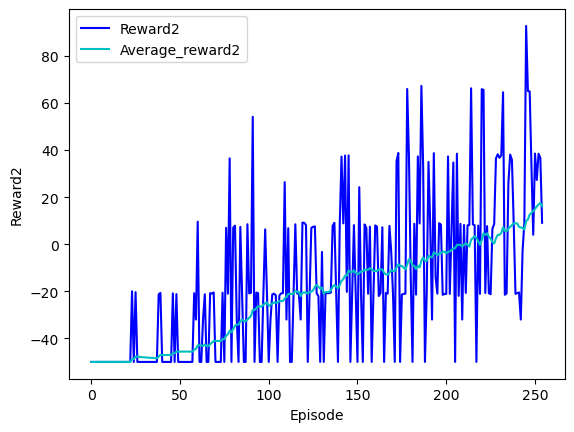

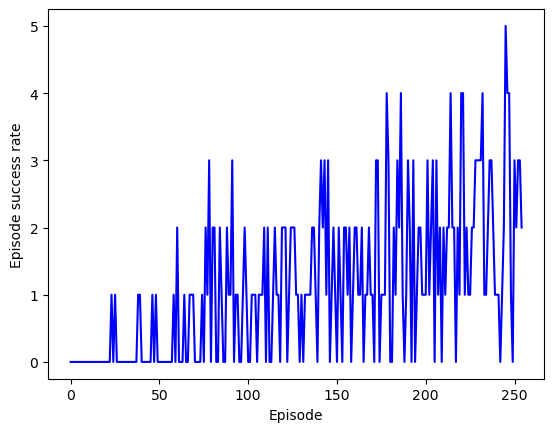

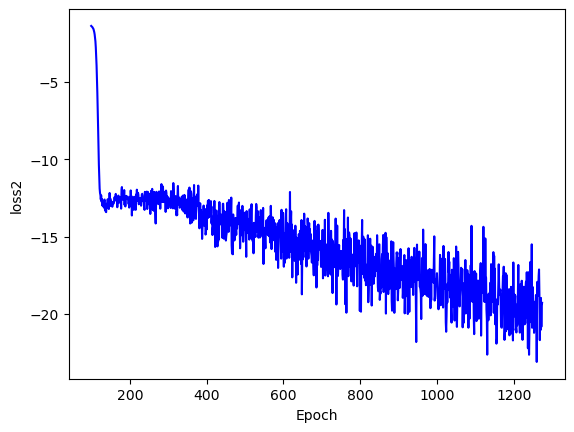

***** epoch 51 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85499.32842264979
r_em 55225.607558415664
55225.607558415664
ReWard2/R0 11.045121511683133
reward2 is: 19.045121511683135
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 1ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 3 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84134.28746175815
r_em 55190.73033605282
55190.73033605282
ReWard2/R0 11.038146067210564
reward2 is: 19.038146067210562
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 4 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.55396837747905
***** epoch 51 episode 1 *****
***** frame 5 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 6 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 7 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 i

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 11 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 12 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93280.855559576
r_em 56384.151033295
56384.151033295
ReWard2/R0 11.276830206659
reward2 is: 19.276830206659
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 1ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 13 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 14 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94094.68123528725
r_em 55659.27370817008
55659.27370817008
ReWard2/R0 11.131854741634017
reward2 is: 19.131854741634015
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.5512047594336427
***** epoch 51 episode 3 *****
***** frame 15 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 17 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 18 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3.

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 19 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.5498281248581236
***** epoch 51 episode 4 *****
***** frame 20 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 22 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 23 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93139.19079640604
r_em 56163.45262478594
56163.45262478594
ReWard2/R0 11.232690524957189
reward2 is: 19.23269052495719
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.5484549284291772


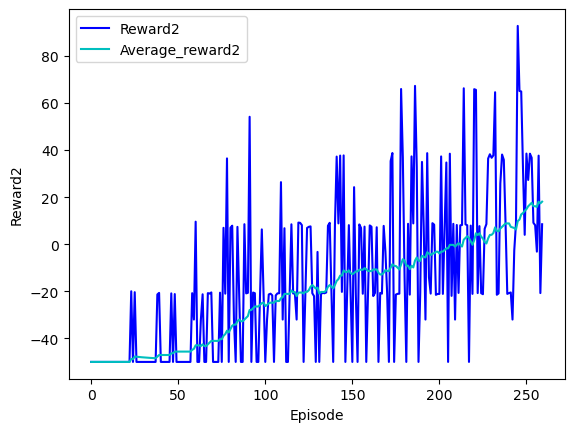

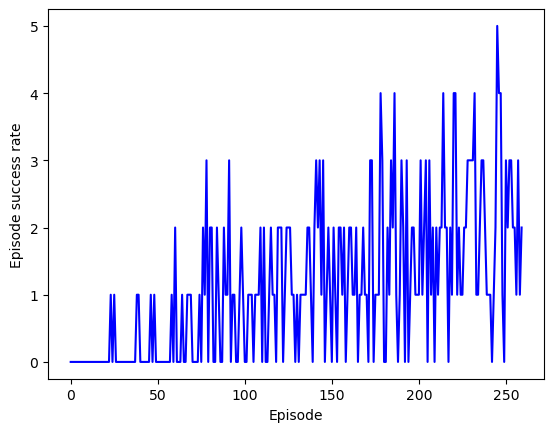

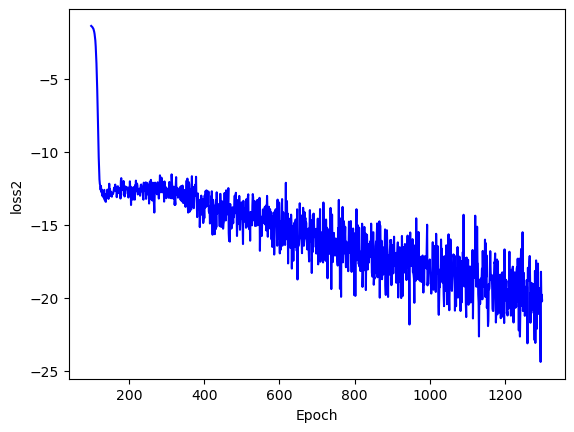

***** epoch 52 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 i

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.5470851615600282
***** epoch 52 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 95229.2201262662
r_em 56511.97191781773
56511.97191781773
ReWard2/R0 11.302394383563547
reward2 is: 19.302394383563545
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step
***** frame 6 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 7 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [=============

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 13 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91018.63785296363
r_em 55509.77724313221
55509.77724313221
ReWard2/R0 11.101955448626441
reward2 is: 19.10195544862644
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 14 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91880.94254247464
r_em 55882.510541666394
55882.510541666394
ReWard2/R0 11.17650210833328
reward2 is: 19.17650210833328
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.5443558822611947
***** epoch 52 episode 3 *****
***** frame 15 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 16 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87456.32894105013
r_em 51163.912215500946
51163.912215500946
ReWard2/R0 10.23278244310019
reward2 is: 18.23278244310019
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 17 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87266.95378055534
r_em 51317.172896086544
51317.172896086544
ReWard2/R0 10.263434579217309
reward2 is: 18.26343457921731
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 18 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88167.93994324475
r_em 51729.197618529455
51729.197618529455
ReWard2/R0 10.34583952370589
reward2 is: 18.34583952370589
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 19 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89908.65773490984
r_em 52571.09967965498
52571.09967965498
ReWard2/R0 10.514219935930996
reward2 is: 18.514219935930996
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.5429963527649727
***** epoch 52 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91309.751958111
r_em 54744.73660430469
54744.73660430469
ReWard2/R0 10.948947320860938
reward2 is: 18.94894732086094
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 23 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of 

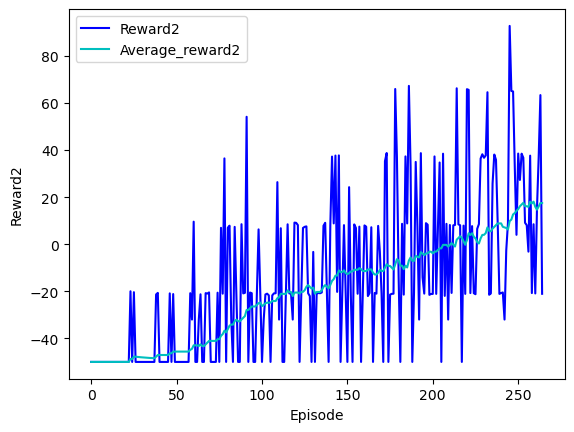

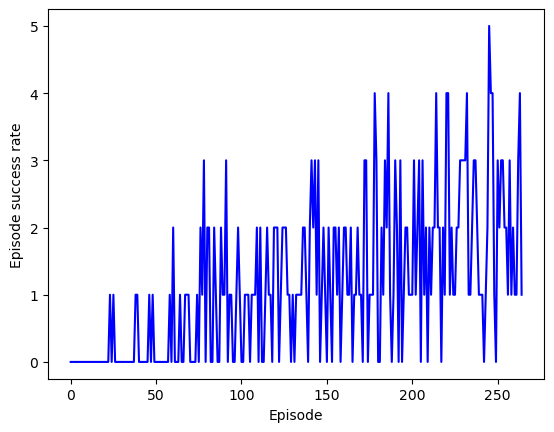

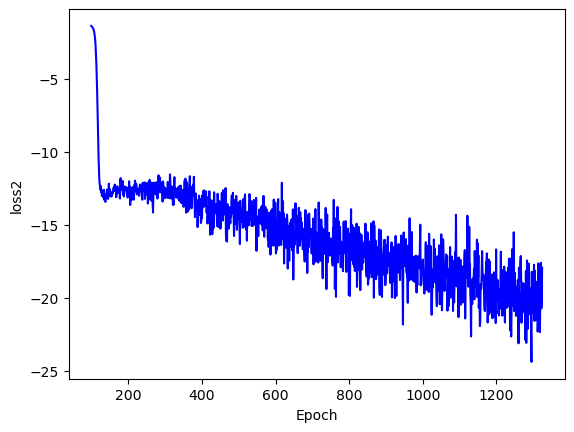

***** epoch 53 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87471.41307881987
r_em 56620.2341464655
56620.2341464655
ReWard2/R0 11.3240468292931
reward2 is: 19.3240468292931
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 1 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86931.83191653204
r_em 56166.34199082331
56166.34199082331
ReWard2/R0 11.233268398164663
reward2 is: 19.23326839816466
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 2 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86737.71781535163
r_em 55427.04379937182
55427.04379937182
ReWard2/R0 11.085408759874365
reward2 is: 19.085408759874365
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 3 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85145.8237996421
r_em 55024.071947700206
55024.071947700206
ReWard2/R0 11.00481438954004
reward2 is: 19.00481438954004
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 4 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85198.60363427692
r_em 55580.51143972299
55580.51143972299
ReWard2/R0 11.116102287944598
reward2 is: 19.1161022879446
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.5402874715722938
***** epoch 53 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87741.94022232827
r_em 57575.34053316685
57575.34053316685
ReWard2/R0 11.51506810663337
reward2 is: 19.51506810663337
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 6 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89314.79738982298
r_em 57602.340122384405
57602.340122384405
ReWard2/R0 11.52046802447688
reward2 is: 19.52046802447688
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 7 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88679.74185384977
r_em 57818.62711018221
57818.62711018221
ReWard2/R0 11.563725422036443
reward2 is: 19.56372542203644
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 8 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 9 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88798.61038893962
r_em 58340.483346088564
58340.483346088564
ReWard2/R0 11.668096669217713
reward2 is: 19.66809666921771
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.5389381029368515
***** epoch 53 episode 2 *****
***** frame 10 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 11 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 12 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 13 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 14 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 98840.7573531351
r_em 52800.97880602017
52800.97880602017
ReWard2/R0 10.560195761204033
reward2 is: 18.560195761204035
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.5375921043512626
***** epoch 53 episode 3 *****
***** frame 15 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 17 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80758.9854746254
r_em 53091.85550791719
53091.85550791719
ReWard2/R0 10.618371101583438
reward2 is: 18.61837110158344
total number of ur2 RBs: 8.0
total number of em2 RBs: 1

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 18 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 19 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.5362494673988234
***** epoch 53 episode 4 *****
***** frame 20 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 24 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88670.22227813897
r_em 54933.83745944591
54933.83745944591
ReWard2/R0 10.986767491889182
reward2 is: 18.986767491889182
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.5349101836838507


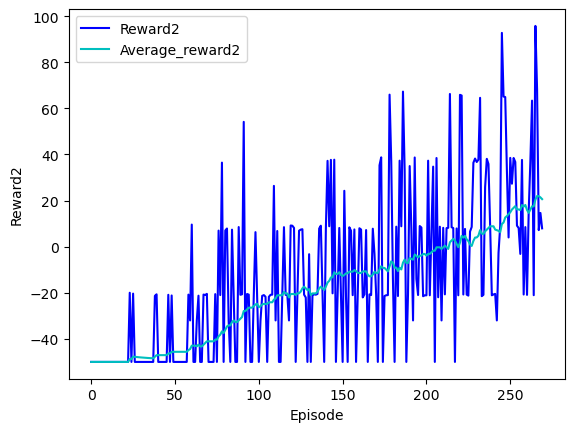

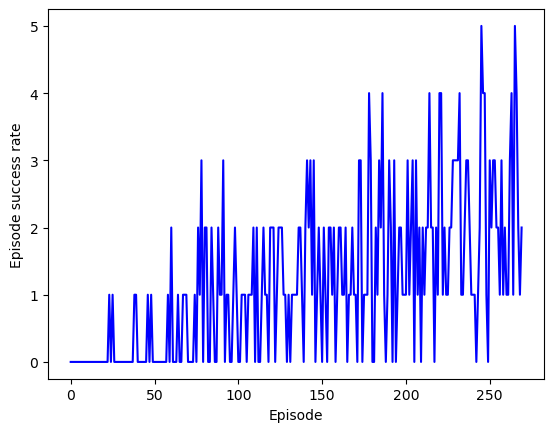

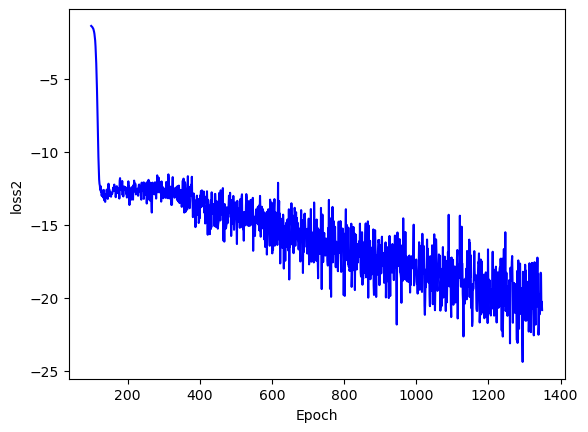

***** epoch 54 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87846.08019347278
r_em 56860.00430318176
56860.00430318176
ReWard2/R0 11.372000860636353
reward2 is: 19.372000860636355
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 2 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89557.30472551977
r_em 56684.596629426705
56684.596629426705
ReWard2/R0 11.336919325885342
reward2 is: 19.33691932588534
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 4 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.5335742448316299
***** epoch 54 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89321.727031219
r_em 49477.22424865105
49477.22424865105
ReWard2/R0 9.895444849730211
reward2 is: 17.89544484973021
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [============================

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 6 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 7 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88275.16792425074
r_em 51787.953263384145
51787.953263384145
ReWard2/R0 10.357590652676828
reward2 is: 18.357590652676826
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 8 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 9 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91796.81702182893
r_em 52313.46030110055
52313.46030110055
ReWard2/R0 10.46269206022011
reward2 is: 18.46269206022011
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.5322416424883619
***** epoch 54 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84036.69271792102
r_em 57171.93866943516
57171.93866943516
ReWard2/R0 11.434387733887032
reward2 is: 19.434387733887032
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 11 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81864.783535731
r_em 56677.6656477058
56677.6656477058
ReWard2/R0 11.33553312954116
reward2 is: 19.33553312954116
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 12 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82004.34598730484
r_em 57012.918077046226
57012.918077046226
ReWard2/R0 11.402583615409245
reward2 is: 19.402583615409245
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 13 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84582.60310046664
r_em 55724.45533622977
55724.45533622977
ReWard2/R0 11.144891067245954
reward2 is: 19.144891067245954
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 14 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.5309123683211118
***** epoch 54 episode 3 *****
***** frame 15 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 16 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 82323.46399491298
r_em 56730.24375571375
56730.24375571375
ReWard2/R0 11.346048751142751
reward2 is: 19.346048751142753
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [=============================

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 21 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85999.2772291158
r_em 56468.5476911326
56468.5476911326
ReWard2/R0 11.29370953822652
reward2 is: 19.29370953822652
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 23 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 24 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87153.6322536391
r_em 56855.917093603326
56855.917093603326
ReWard2/R0 11.371183418720666
reward2 is: 19.371183418720666
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.5282637712869286


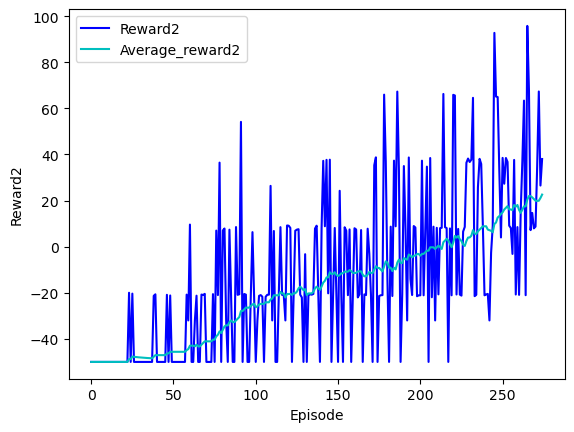

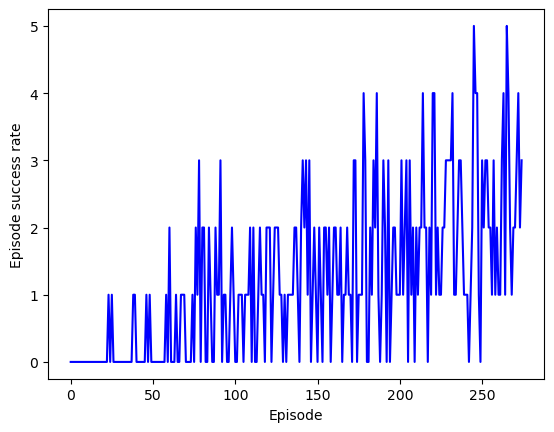

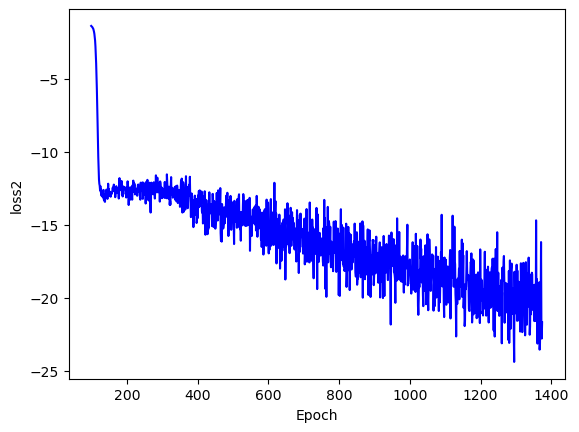

***** epoch 55 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82905.92093188972
r_em 57857.6176285437
57857.6176285437
ReWard2/R0 11.571523525708741
reward2 is: 19.57152352570874
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 5.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 4 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.526944431857975
***** epoch 55 episode 1 *****
***** frame 5 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 2.

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 7 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93882.6940472872
r_em 57935.314297834615
57935.314297834615
ReWard2/R0 11.587062859566924
reward2 is: 19.587062859566924
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 8 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 9 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.525628387480894
***** epoch 55 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 79231.75684804394
r_em 54328.90043284801
54328.90043284801
ReWard2/R0 10.865780086569602
reward2 is: 18.8657800865696
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 17 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 18 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91332.4498063564
r_em 53395.527971630974
53395.527971630974
ReWard2/R0 10.679105594326195
reward2 is: 18.679105594326195
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 19 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91047.13088557651
r_em 52968.132606741216
52968.132606741216
ReWard2/R0 10.593626521348243
reward2 is: 18.59362652134824
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.5230061509853179
***** epoch 55 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90773.3193023502
r_em 54550.695149127045
54550.695149127045
ReWard2/R0 10.910139029825409
reward2 is: 18.91013902982541
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 23 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur

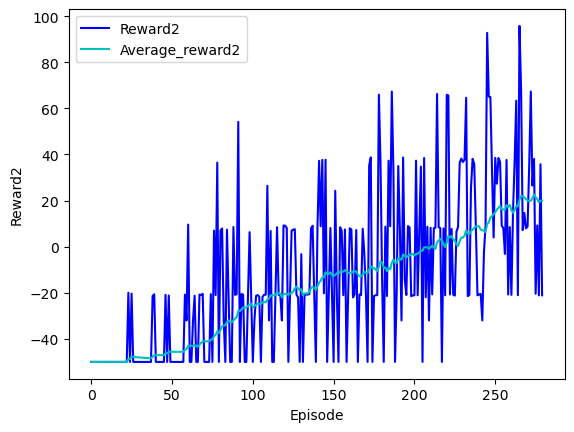

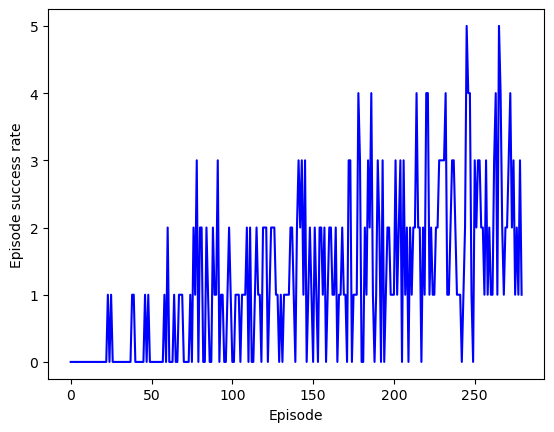

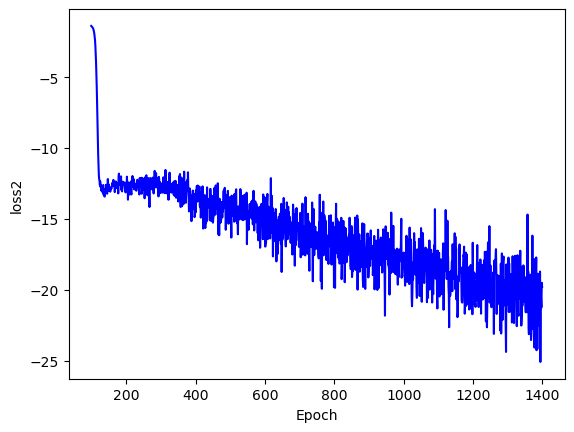

***** epoch 56 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 96124.36119772762
r_em 57572.347842555406
57572.347842555406
ReWard2/R0 11.514469568511082
reward2 is: 19.514469568511082
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 99008.63631705426
r_em 57277.36010919467
57277.36010919467
ReWard2/R0 11.455472021838935
reward2 is: 19.455472021838936
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
to

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 18 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 19 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91933.83859824452
r_em 54312.29897630536
54312.29897630536
ReWard2/R0 10.862459795261072
reward2 is: 18.862459795261074
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.5165076496076924
***** epoch 56 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78624.25384974206
r_em 52902.06882147062
52902.06882147062
ReWard2/R0 10.580413764294123
reward2 is: 18.58041376429412
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 21 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80593.90273401722
r_em 51705.80807074827
51705.80807074827
ReWard2/R0 10.341161614149655
reward2 is: 18.341161614149655
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 23 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84053.83969825329
r_em 51961.864560517926
51961.864560517926
ReWard2/R0 10.392372912103585
reward2 is: 18.392372912103585
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 24 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83242.94667180974
r_em 54001.6174259814
54001.6174259814
ReWard2/R0 10.80032348519628
reward2 is: 18.80032348519628
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.5152176711073241


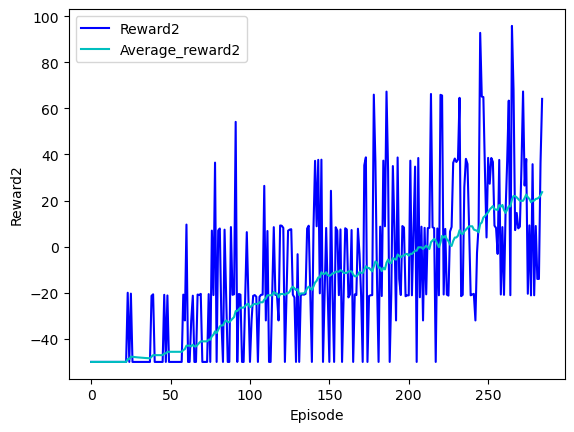

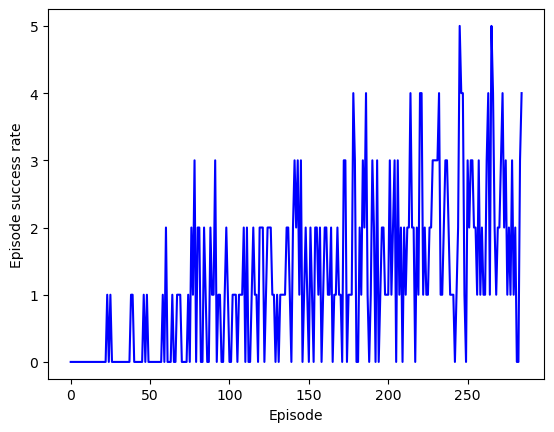

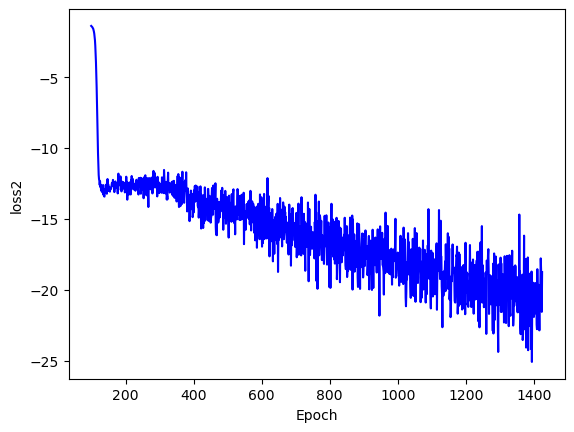

***** epoch 57 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 2 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total 

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 11 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 12 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88587.30498568853
r_em 53264.0405455129
53264.0405455129
ReWard2/R0 10.65280810910258
reward2 is: 18.65280810910258
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 13 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 14 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91968.93966559017
r_em 53742.77987201303
53742.77987201303
ReWard2/R0 10.748555974402606
reward2 is: 18.748555974402606
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.5113670337787873
***** epoch 57 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90307.71479405346
r_em 56434.30495506503
56434.30495506503
ReWard2/R0 11.286860991013006
reward2 is: 19.286860991013008
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 16 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89494.56037586316
r_em 56534.8590698476
56534.8590698476
ReWard2/R0 11.30697181396952
reward2 is: 19.30697181396952
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 17 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 18 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91877.18285458809
r_em 55658.92975431656
55658.92975431656
ReWard2/R0 11.131785950863312
reward2 is: 19.13178595086331
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 19 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.510089893972876
***** epoch 57 episode 4 *****
***** frame 20 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 21 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 97066.69825313808
r_em 56043.89438550642
56043.89438550642
ReWard2/R0 11.208778877101285
reward2 is: 19.208778877101285
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [======================

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 22 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 97257.24675734018
r_em 55950.4020698829
55950.4020698829
ReWard2/R0 11.19008041397658
reward2 is: 19.19008041397658
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 23 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 24 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96933.85317731084
r_em 57511.16103428996
57511.16103428996
ReWard2/R0 11.502232206857991
reward2 is: 19.50223220685799
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.508815943825226


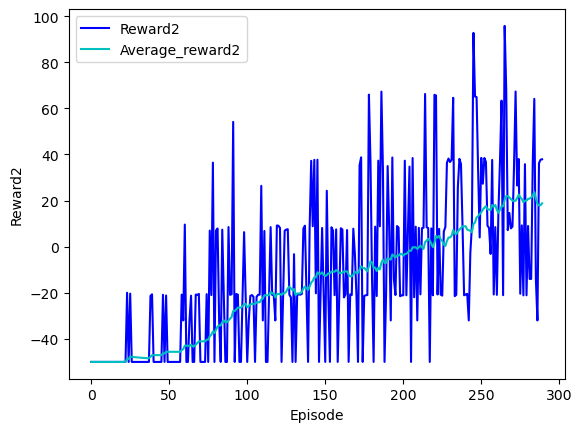

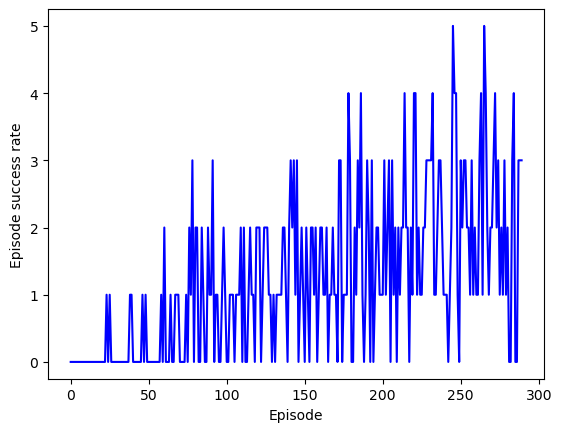

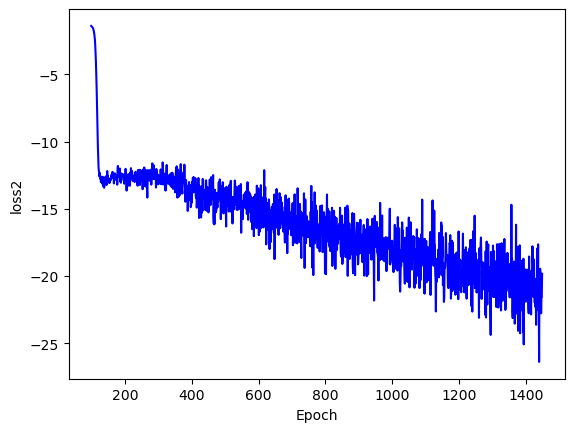

***** epoch 58 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 7 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90686.51520634814
r_em 50545.12187473327
50545.12187473327
ReWard2/R0 10.109024374946653
reward2 is: 18.109024374946653
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 8 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 9 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91711.17596591335
r_em 51987.12606165371
51987.12606165371
ReWard2/R0 10.397425212330742
reward2 is: 18.39742521233074
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.506277580659903
***** epoch 58 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93898.20882887748
r_em 56038.85079766667
56038.85079766667
ReWard2/R0 11.207770159533334
reward2 is: 19.207770159533332
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 11 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 12 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93484.87278143411
r_em 56670.696480355386
56670.696480355386
ReWard2/R0 11.334139296071077
reward2 is: 19.33413929607108
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 13 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 14 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94852.71729980188
r_em 56984.79801566313
56984.79801566313
ReWard2/R0 11.396959603132625
reward2 is: 19.396959603132625
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.5050131517695162
***** epoch 58 episode 3 *****
***** frame 15 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 16 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92954.80136216781
r_em 53744.98605887785
53744.98605887785
ReWard2/R0 10.748997211775569
reward2 is: 18.748997211775567
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 17 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 18 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 19 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.5037518807918635
***** epoch 58 episode 4 *****
***** frame 20 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 22 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82898.3771714313
r_em 54338.12127839506
54338.12127839506
ReWard2/R0 10.867624255679011
reward2 is: 18.86762425567901
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 23 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 24 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86124.3096155414
r_em 53729.71895573753
53729.71895573753
ReWard2/R0 10.745943791147507
reward2 is: 18.745943791147507
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 1ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.5024937598400535


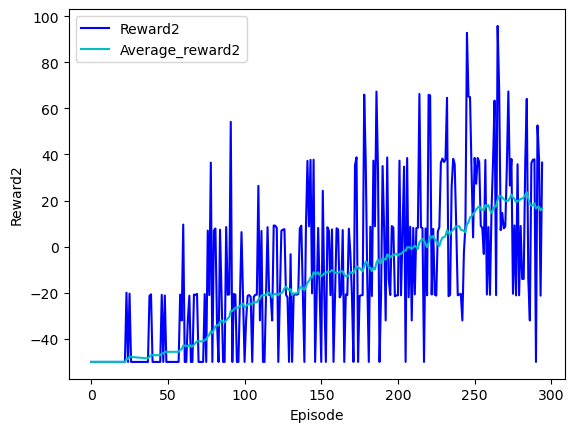

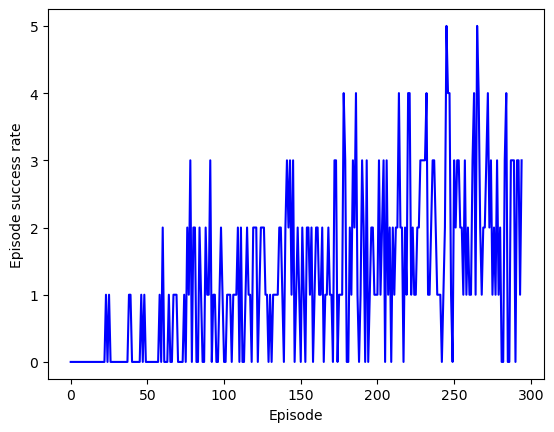

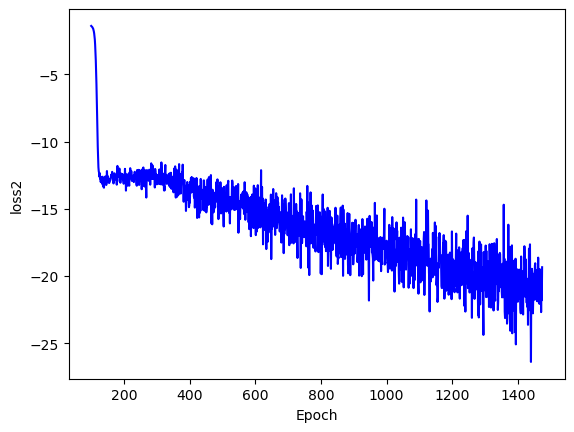

***** epoch 59 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88323.489868468
r_em 54149.549860200284
54149.549860200284
ReWard2/R0 10.829909972040056
reward2 is: 18.829909972040056
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 2 *****
1/1 [==============================] - 0s 15ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91319.84247076625
r_em 52441.22814888001
52441.22814888001
ReWard2/R0 10.488245629776001
reward2 is: 18.488245629776003
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 3 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93835.28484902412
r_em 52990.37530323573
52990.37530323573
ReWard2/R0 10.598075060647146
reward2 is: 18.598075060647147
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 4 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93897.29099324111
r_em 53557.935973028216
53557.935973028216
ReWard2/R0 10.711587194605643
reward2 is: 18.71158719460564
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.5012387810468929
***** epoch 59 episode 1 *****
***** frame 5 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 6 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90190.83132246118
r_em 50954.60758499876
50954.60758499876
ReWard2/R0 10.190921516999753
reward2 is: 18.19092151699975
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 7 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 8 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 9 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.49998693656483667
***** epoch 59 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 11 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95335.7646203858
r_em 55772.72911296536
55772.72911296536
ReWard2/R0 11.154545822593072
reward2 is: 19.15454582259307
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 12 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95760.51765564807
r_em 55455.00754654148
55455.00754654148
ReWard2/R0 11.091001509308295
reward2 is: 19.091001509308295
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 13 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 14 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93744.9745441398
r_em 55396.96678912229
55396.96678912229
ReWard2/R0 11.079393357824458
reward2 is: 19.079393357824458
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.4987382185659387
***** epoch 59 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77237.70216708281
r_em 55069.85217844636
55069.85217844636
ReWard2/R0 11.013970435689272
reward2 is: 19.013970435689274
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 17 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 18 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79021.16702541646
r_em 53291.05995455346
53291.05995455346
ReWard2/R0 10.658211990910692
reward2 is: 18.658211990910694
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 19 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 81090.31592987594
r_em 53249.774789995005
53249.774789995005
ReWard2/R0 10.649954957999
reward2 is: 18.649954957999
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.4974926192418035
***** epoch 59 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88872.92849227521
r_em 53690.893329893275
53690.893329893275
ReWard2/R0 10.738178665978655
reward2 is: 18.738178665978655
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 21 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90833.99320530928
r_em 53485.62662968812
53485.62662968812
ReWard2/R0 10.697125325937625
reward2 is: 18.697125325937627
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 23 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.4962501308035369


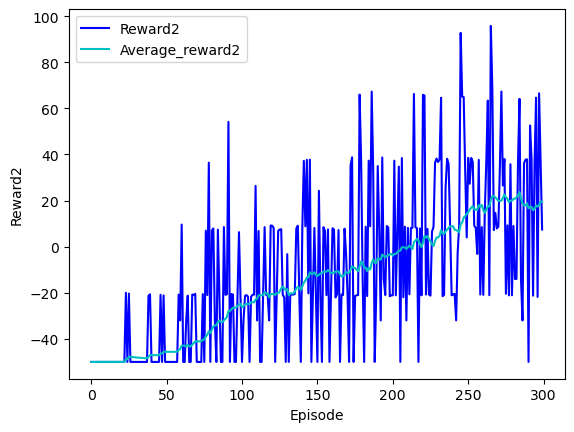

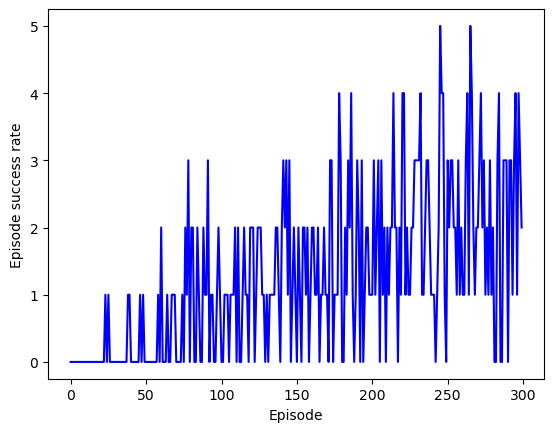

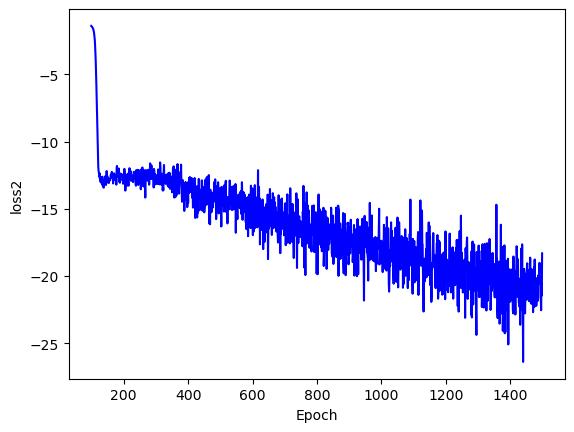

***** epoch 60 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 i

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.4937744555262485
***** epoch 60 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83168.91573559231
r_em 51532.49442181881
51532.49442181881
ReWard2/R0 10.306498884363762
reward2 is: 18.306498884363762
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 11 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 12 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 13 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82468.84828434052
r_em 52554.8296656852
52554.8296656852
ReWard2/R0 10.51096593313704
reward2 is: 18.51096593313704
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 14 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80931.59150757403
r_em 52412.5533144588
52412.5533144588
ReWard2/R0 10.482510662891759
reward2 is: 18.48251066289176
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.492541253206508
***** epoch 60 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 90526.45954111067
r_em 51774.29166923278
51774.29166923278
ReWard2/R0 10.354858333846556
reward2 is: 18.354858333846558
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step
***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 17 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 90158.34680363166
r_em 52593.997142059256
52593.997142059256
ReWard2/R0 10.518799428411851
reward2 is: 18.5

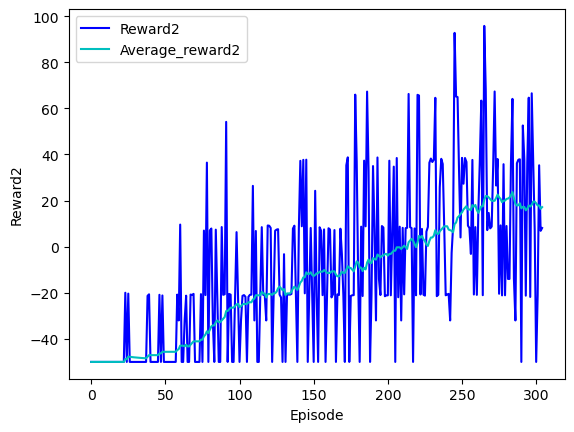

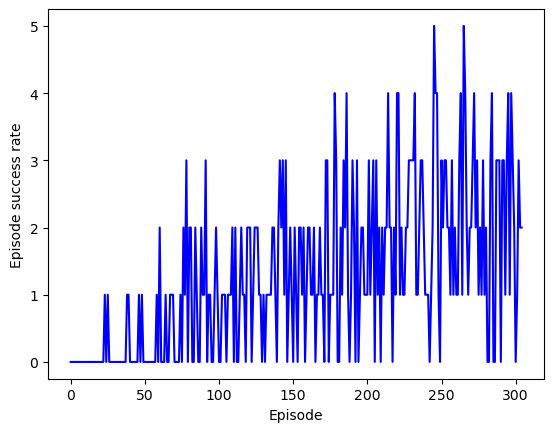

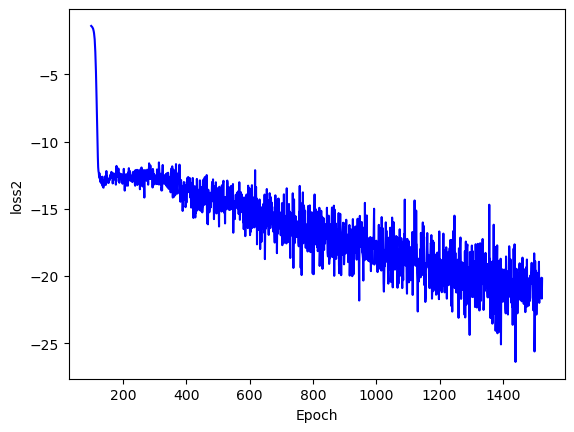

***** epoch 61 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 108517.7227075932
r_em 56377.532555015496
56377.532555015496
ReWard2/R0 11.2755065110031
reward2 is: 19.2755065110031
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 107250.24793410502
r_em 56019.636587635294
56019.636587635294
ReWard2/R0 11.203927317527059
reward2 is: 19.20392731752706
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step
***** frame 2 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 107424.8454464

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 7 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 8 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 9 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83754.48399826414
r_em 56412.397928558814
56412.397928558814
ReWard2/R0 11.282479585711762
reward2 is: 19.282479585711762
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.4876391663457515
***** epoch 61 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 74745.57106152903
r_em 56829.8921071233
56829.8921071233
ReWard2/R0 11.365978421424659
reward2 is: 19.365978421424657
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 11 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 73585.77872056795
r_em 56205.312911837435
56205.312911837435
ReWard2/R0 11.241062582367487
reward2 is: 19.241062582367487
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 12 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 13 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 71650.23181166787
r_em 56245.7631001412
56245.7631001412
ReWard2/R0 11.24915262002824
reward2 is: 19.24915262002824
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 14 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 71753.2625402573
r_em 56482.48115274468
56482.48115274468
ReWard2/R0 11.296496230548936
reward2 is: 19.296496230548936
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.4864212869184065
***** epoch 61 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 98622.57010229808
r_em 53134.92266026462
53134.92266026462
ReWard2/R0 10.626984532052925
reward2 is: 18.626984532052923
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 17 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 101973.36861731292
r_em 52291.611967310244
52291.611967310244
ReWard2/R0 10.45832239346205
reward2 is: 18.458322393462048
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 1ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 18 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 101204.02472452701
r_em 53107.98634690928
53107.98634690928
ReWard2/R0 10.621597269381857
reward2 is: 18.62159726938186
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 19 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96977.8195431544
r_em 53531.22943669607
53531.22943669607
ReWard2/R0 10.706245887339215
reward2 is: 18.706245887339215
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.48520644914645333
***** epoch 61 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89191.16608578719
r_em 56656.19842034804
56656.19842034804
ReWard2/R0 11.331239684069608
reward2 is: 19.331239684069608
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 23 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86136.53771758212
r_em 54588.72471569031
54588.72471569031
ReWard2/R0 10.917744943138063
reward2 is: 18.91774494313806
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 24 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92097.3469793319
r_em 55580.956188759665
55580.956188759665
ReWard2/R0 11.116191237751933
reward2 is: 19.116191237751934
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.48399464543335374


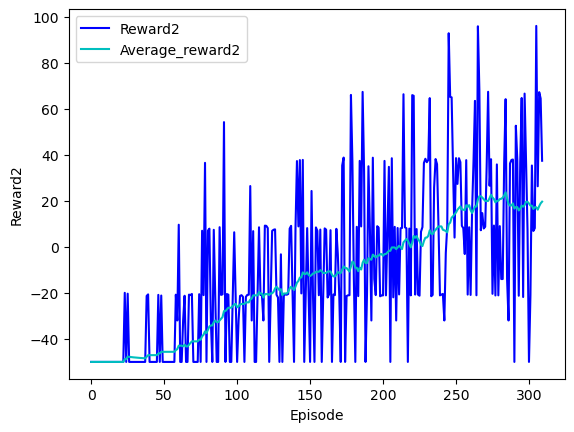

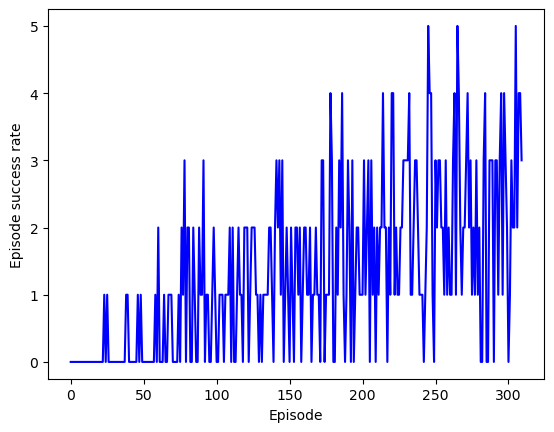

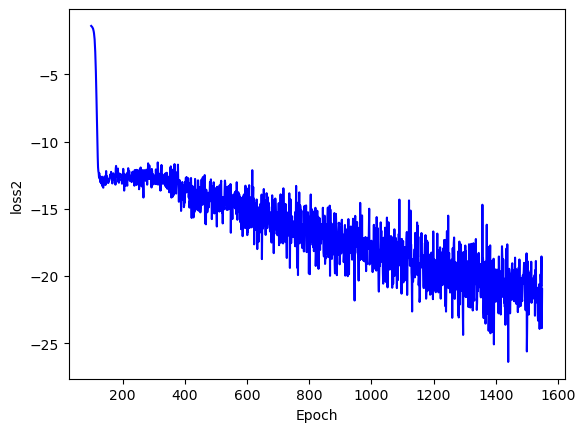

***** epoch 62 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 91707.501560534
r_em 56961.827845113155
56961.827845113155
ReWard2/R0 11.392365569022632
reward2 is: 19.39236556902263
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 3 *****
we ch

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 11 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 12 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 13 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90640.02244042298
r_em 57939.90387927751
57939.90387927751
ReWard2/R0 11.587980775855502
reward2 is: 19.587980775855502
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 1ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 14 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89754.70010971525
r_em 57489.8878144517
57489.8878144517
ReWard2/R0 11.49797756289034
reward2 is: 19.49797756289034
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.48037736296609657
***** epoch 62 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87813.71486983438
r_em 56248.14984068424
56248.14984068424
ReWard2/R0 11.249629968136848
reward2 is: 19.249629968136848
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 17 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88051.44935910654
r_em 57089.73341481522
57089.73341481522
ReWard2/R0 11.417946682963045
reward2 is: 19.417946682963045
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 18 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 19 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87227.09307596528
r_em 56958.365124553806
56958.365124553806
ReWard2/R0 11.39167302491076
reward2 is: 19.39167302491076
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.47917761990176727
***** epoch 62 episode 4 *****
***** frame 20 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 22 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85596.54264308212
r_em 52833.05620841753
52833.05620841753
ReWard2/R0 10.566611241683507
reward2 is: 18.566611241683507
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [===================

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 23 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87843.60446107588
r_em 53172.30968668579
53172.30968668579
ReWard2/R0 10.634461937337157
reward2 is: 18.634461937337157
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 24 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87994.59046471315
r_em 53293.55951645522
53293.55951645522
ReWard2/R0 10.658711903291044
reward2 is: 18.658711903291042
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.4779808731972405


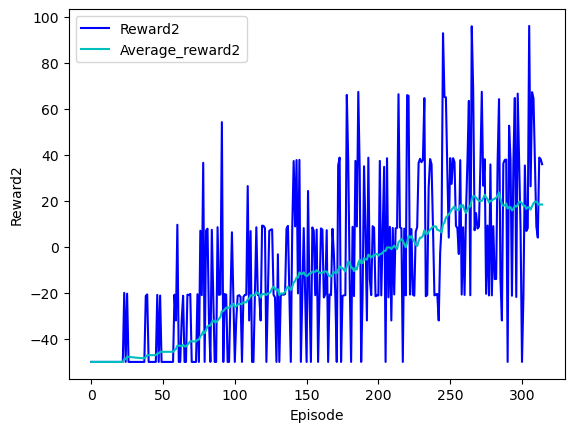

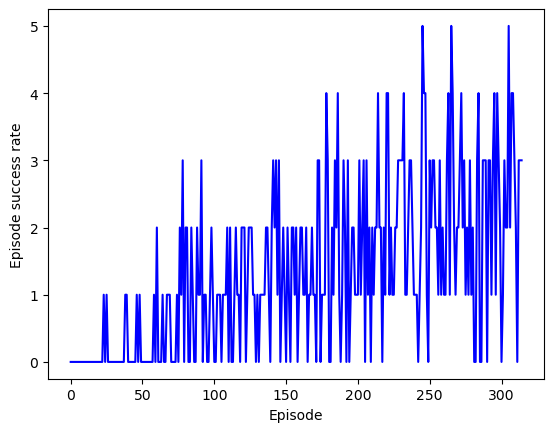

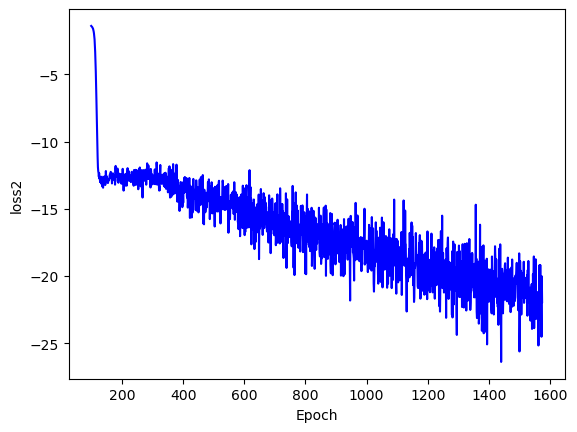

***** epoch 63 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 2 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87473.53879752028
r_em 56968.96185623311
56968.96185623311
ReWard2/R0 11.393792371246622
reward2 is: 19.393792371246622
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 4 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87956.38318259755
r_em 56240.13235905706
56240.13235905706
ReWard2/R0 11.248026471811412
reward2 is: 19.248026471811414
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.47678711536910373
***** epoch 63 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 88753.11362361544
r_em 52982.38755356193
52982.38755356193
ReWard2/R0 10.596477510712386
reward2 is: 18.596477510712386
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step
***** frame 6 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 88239.08988252048
r_em 54220.40307497614
54220.40307497614
ReWard2/R0 10.844080614995228
reward2 is: 18.844080614995228
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step
***** frame 7 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ..

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 17 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 18 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 19 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 22 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93732.7911632399
r_em 55135.79245020037
55135.79245020037
ReWard2/R0 11.027158490040074
reward2 is: 19.027158490040073
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 23 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92673.09148743961
r_em 54378.010562906864
54378.010562906864
ReWard2/R0 10.875602112581372
reward2 is: 18.875602112581372
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 24 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90038.54101068313
r_em 54150.29883256331
54150.29883256331
ReWard2/R0 10.830059766512662
reward2 is: 18.83005976651266
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.47204182380537574


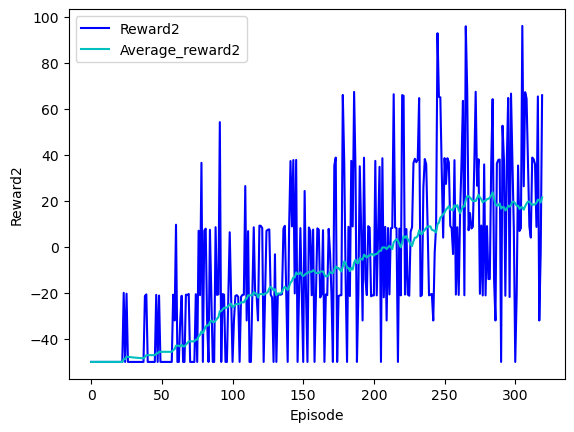

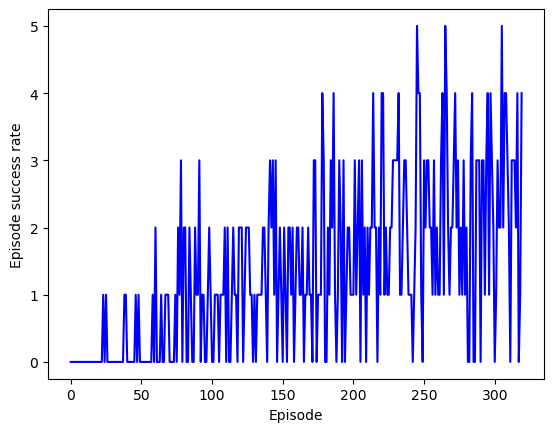

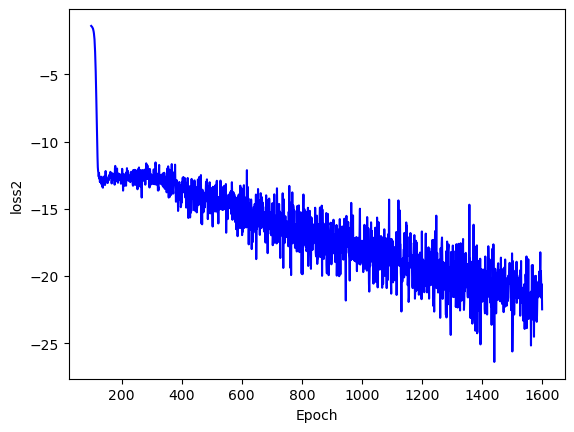

***** epoch 64 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 100039.35130569903
r_em 53263.677495337106
53263.677495337106
ReWard2/R0 10.652735499067422
reward2 is: 18.652735499067422
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 2 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 101127.31510037364
r_em 52185.28667158176
52185.28667158176
ReWard2/R0 10.437057334316352
reward2 is: 18.43705733431635
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 4 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 102266.19032953
r_em 52259.62904874313
52259.62904874313
ReWard2/R0 10.451925809748627
reward2 is: 18.451925809748627
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.4708628987605172
***** epoch 64 episode 1 *****
***** frame 5 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 6 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 7 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 8 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 17 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78964.70036405537
r_em 57364.57378193438
57364.57378193438
ReWard2/R0 11.472914756386876
reward2 is: 19.472914756386878
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 18 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 19 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.4673437604307052
***** epoch 64 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82471.39649918437
r_em 50933.746653560076
50933.746653560076
ReWard2/R0 10.186749330712015
reward2 is: 18.186749330712015
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [=================

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 22 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82676.69808951777
r_em 48407.08512635415
48407.08512635415
ReWard2/R0 9.68141702527083
reward2 is: 17.681417025270832
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 23 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83495.99630861985
r_em 50611.58873706626
50611.58873706626
ReWard2/R0 10.122317747413252
reward2 is: 18.122317747413252
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 24 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83652.6604362718
r_em 51833.725410478895
51833.725410478895
ReWard2/R0 10.366745082095779
reward2 is: 18.36674508209578
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.4661765688049959


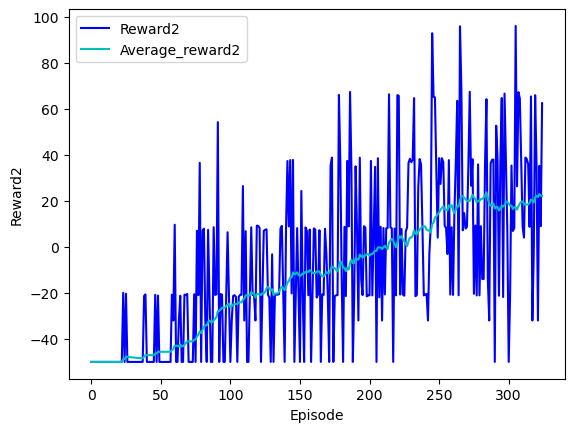

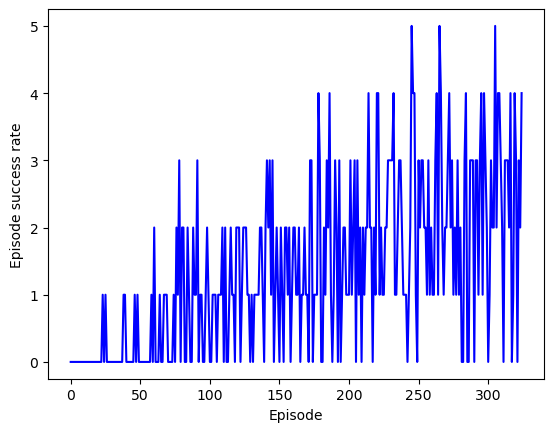

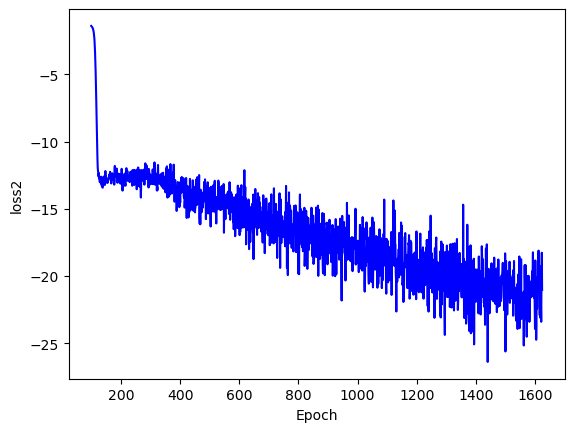

***** epoch 65 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82965.45488898267
r_em 56089.37268581989
56089.37268581989
ReWard2/R0 11.21787453716398
reward2 is: 19.21787453716398
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 1 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85946.49311383143
r_em 55638.71057638647
55638.71057638647
ReWard2/R0 11.127742115277293
reward2 is: 19.127742115277293
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 3 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87688.15344097854
r_em 55486.884077637136
55486.884077637136
ReWard2/R0 11.097376815527427
reward2 is: 19.097376815527426
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 4 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.4650122922418305
***** epoch 65 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 6 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 7 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 14 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.46269245519982455
***** epoch 65 episode 3 *****
***** frame 15 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 17 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optima

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 19 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.46153688021474204
***** epoch 65 episode 4 *****
***** frame 20 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 22 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3.

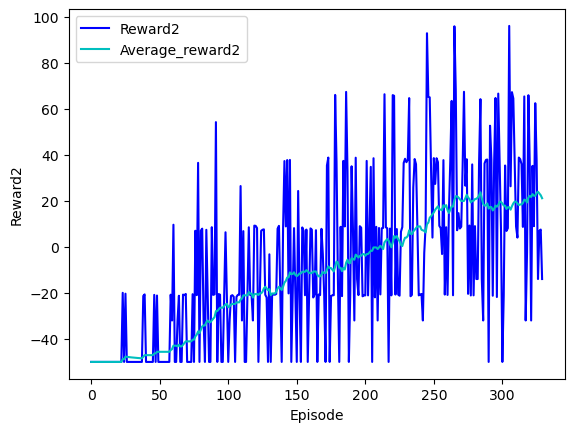

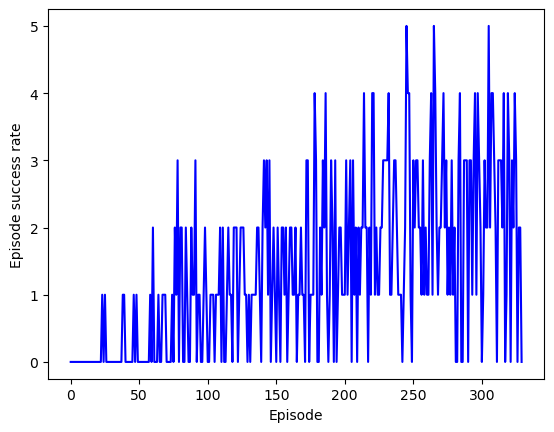

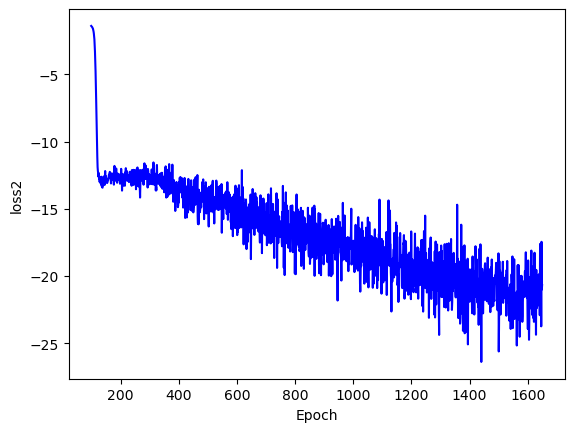

***** epoch 66 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 2 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86390.34433552538
r_em 54066.90118607737
54066.90118607737
ReWard2/R0 10.813380237215474
reward2 is: 18.813380237215476
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 3 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87617.29360288123
r_em 54770.24751244831
54770.24751244831
ReWard2/R0 10.954049502489662
reward2 is: 18.95404950248966
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 4 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88224.85961345087
r_em 54569.85465880904
54569.85465880904
ReWard2/R0 10.913970931761808
reward2 is: 18.91397093176181
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.4592343811865719
***** epoch 66 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93242.0040576422
r_em 50732.74129964897
50732.74129964897
ReWard2/R0 10.146548259929794
reward2 is: 18.146548259929794
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 6 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 7 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 8 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 9 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs:

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 11 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 1ms/step
***** frame 12 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87826.98514513572
r_em 55928.23670223879
55928.23670223879
ReWard2/R0 11.185647340447758
reward2 is: 19.18564734044776
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 13 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84891.70769862908
r_em 56989.20734926874
56989.20734926874
ReWard2/R0 11.397841469853748
reward2 is: 19.39784146985375
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 14 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.45694336878493574
***** epoch 66 episode 3 *****
***** frame 15 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 17 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ... 

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 22 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85642.42125846319
r_em 55090.43643212021
55090.43643212021
ReWard2/R0 11.018087286424041
reward2 is: 19.01808728642404
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 23 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84353.86533924034
r_em 55228.34952122009
55228.34952122009
ReWard2/R0 11.045669904244017
reward2 is: 19.045669904244015
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 24 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83377.81374916401
r_em 55211.04833341003
55211.04833341003
ReWard2/R0 11.042209666682005
reward2 is: 19.042209666682005
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.4546637857057534


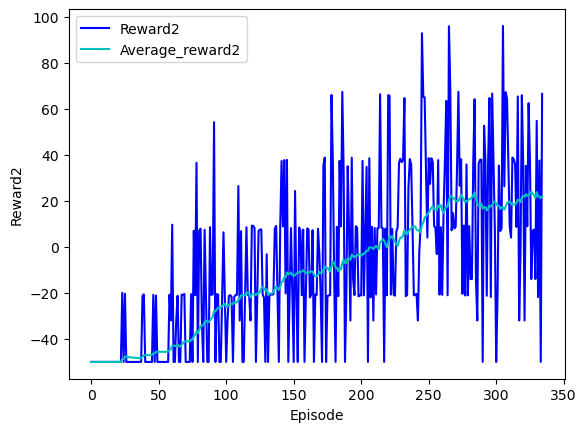

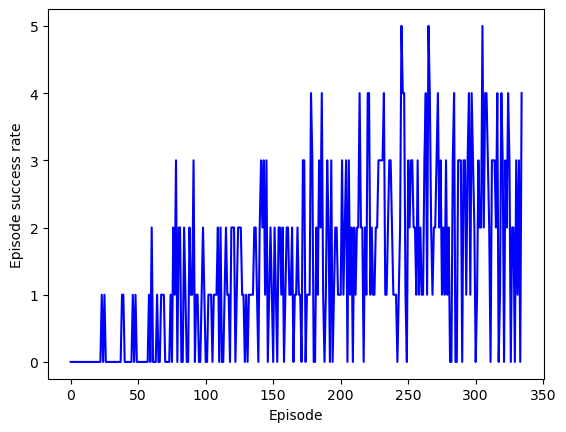

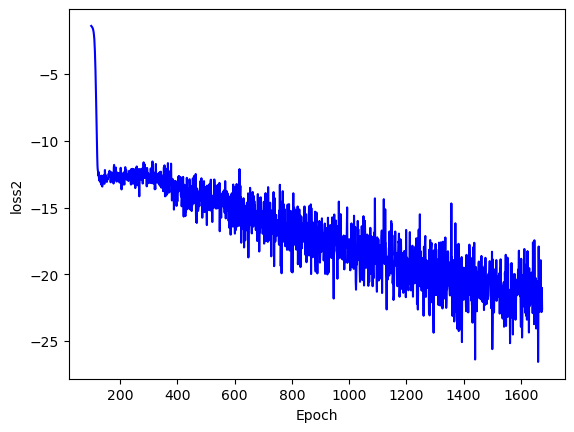

***** epoch 67 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 5.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 3 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88011.94527028844
r_em 592

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 4 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.4535282623327658
***** epoch 67 episode 1 *****
***** frame 5 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 6 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 7 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 8 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 9 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.4523955749308212
***** epoch 67 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 88831.23595851824
r_em 54078.64326170017
54078.64326170017
ReWard2/R0 10.815728652340034
reward2 is: 18.815728652340034
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step
***** frame 11 *****
1/

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 13 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91264.35386184367
r_em 54824.081661117976
54824.081661117976
ReWard2/R0 10.964816332223595
reward2 is: 18.964816332223595
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 14 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90999.20870441869
r_em 55247.78909008569
55247.78909008569
ReWard2/R0 11.049557818017137
reward2 is: 19.049557818017135
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 1ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.4512657164170785
***** epoch 67 episode 3 *****
***** frame 15 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 17 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 18 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 19 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.4501386797263858
***** epoch 67 episode 4 *****
***** frame 20 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 22 *****
1/1 [==============================] - 0s 

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 23 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 24 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86375.60425511852
r_em 57585.88415497891
57585.88415497891
ReWard2/R0 11.517176830995782
reward2 is: 19.51717683099578
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.4490144578112366


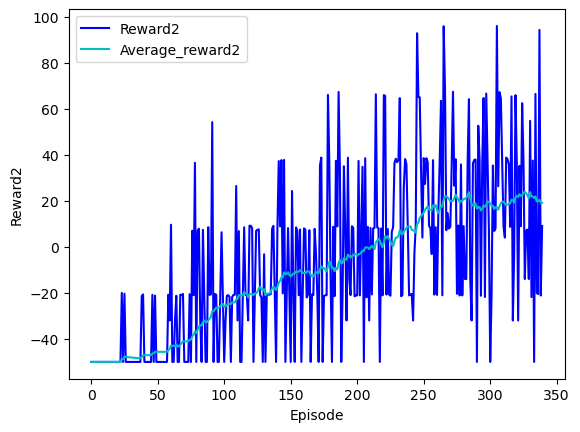

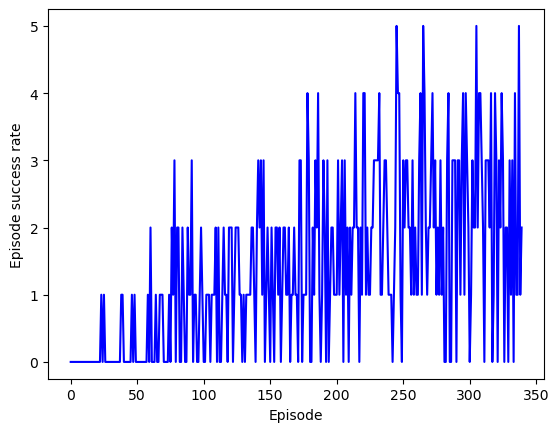

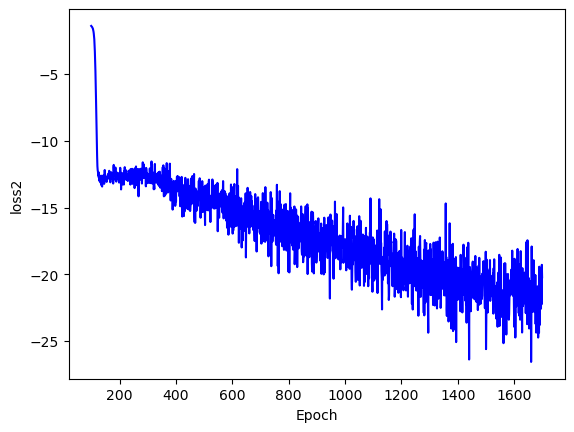

***** epoch 68 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92446.40740516773
r_em 54125.00810991334
54125.00810991334
ReWard2/R0 10.825001621982668
reward2 is: 18.82500162198267
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 4 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93297.16862613446
r_em 55185.487640734595
55185.487640734595
ReWard2/R0 11.03709752814692
reward2 is: 19.03709752814692
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.4478930436417254
***** epoch 68 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85223.92139462454
r_em 53701.60316215382
53701.60316215382
ReWard2/R0 10.740320632430764
reward2 is: 18.740320632430766
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 6 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 7 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84562.19524105726
r_em 54338.63498431491
54338.63498431491
ReWard2/R0 10.86772699686298
reward2 is: 18.86772699686298
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 8 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86084.70886918144
r_em 54943.70896432193
54943.70896432193
ReWard2/R0 10.988741792864387
reward2 is: 18.98874179286439
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 9 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86162.58125264003
r_em 54630.493362199944
54630.493362199944
ReWard2/R0 10.92609867243999
reward2 is: 18.92609867243999
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.4467744302055039
***** epoch 68 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 11 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 12 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 13 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooO

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 17 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92705.70851852171
r_em 52961.49449388483
52961.49449388483
ReWard2/R0 10.592298898776965
reward2 is: 18.592298898776967
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 18 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 19 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89305.49072794305
r_em 53711.481428320556
53711.481428320556
ReWard2/R0 10.74229628566411
reward2 is: 18.74229628566411
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.44454557757106034
***** epoch 68 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93304.11155740365
r_em 55702.36335204535
55702.36335204535
ReWard2/R0 11.14047267040907
reward2 is: 19.140472670409068
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 21 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93204.2352366214
r_em 55307.36079146829
55307.36079146829
ReWard2/R0 11.061472158293657
reward2 is: 19.061472158293657
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 22 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92830.18464675736
r_em 55864.52376115194
55864.52376115194
ReWard2/R0 11.172904752230387
reward2 is: 19.172904752230387
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 23 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91967.69114405997
r_em 55909.16160953665
55909.16160953665
ReWard2/R0 11.18183232190733
reward2 is: 19.18183232190733
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 24 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91335.83959608556
r_em 55527.41020751629
55527.41020751629
ReWard2/R0 11.105482041503258
reward2 is: 19.105482041503258
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.44343532443553363


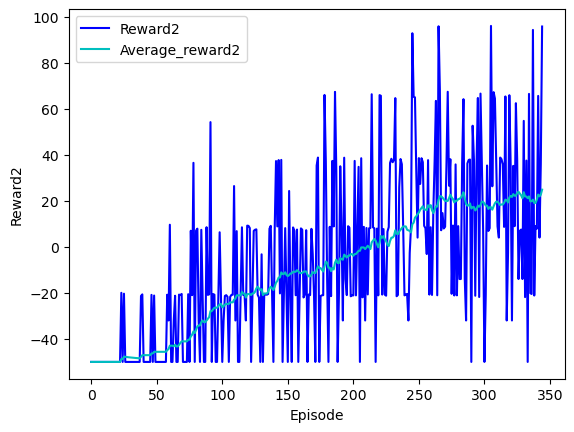

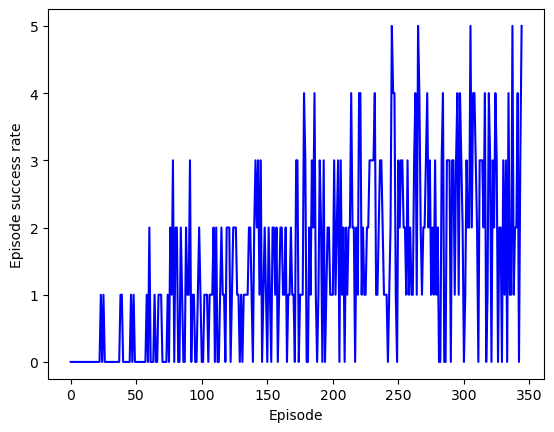

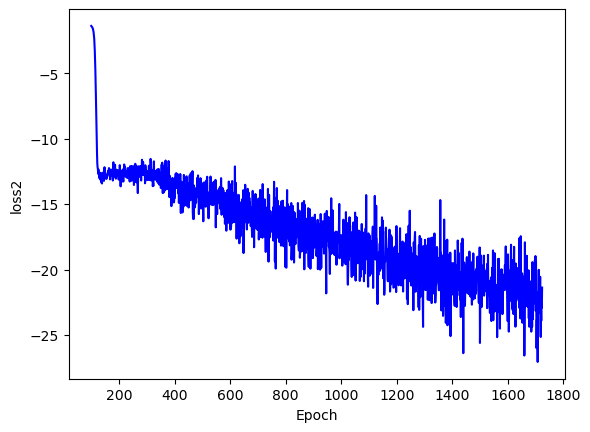

***** epoch 69 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 2 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 91363.16266395657
r_em 53089.12958054349
53089.12958054349
ReWard2/R0 10.617825916108698
reward2 is: 18.6178259161087
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step
***** frame 3 *****
1/1 [==============================] - 

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 9 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.44122312981504286
***** epoch 69 episode 2 *****
***** frame 10 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 11 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83406.27242549544
r_em 51175.91513562596
51175.91513562596
ReWard2/R0 10.235183027125192
reward2 is: 18.235183027125192
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>............

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 12 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78201.41846893707
r_em 51232.105924967174
51232.105924967174
ReWard2/R0 10.246421184993435
reward2 is: 18.246421184993437
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 13 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 14 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.4401211744969389
***** epoch 69 episode 3 *****
***** frame 15 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 16 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 17 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 18 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 19 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79117.95498213018
r_em 54387.69417245653
54387.69417245653
ReWard2/R0 10.877538834491306
reward2 is: 18.877538834491304
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.4390219713136189
***** epoch 69 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92947.65169655671
r_em 55235.62617330175
55235.62617330175
ReWard2/R0 11.047125234660351
reward2 is: 19.04712523466035
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 21 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 101131.25729791954
r_em 55126.38675607489
55126.38675607489
ReWard2/R0 11.025277351214978
reward2 is: 19.025277351214978
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step
***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 23 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 101907.39202250597
r_em 54545.2840311619
54545.2840311619
ReWard2/R0 10.90905680623238
reward2 is: 18.90905680623238
total number of ur2 RBs: 8.0
total number of em2 RBs: 1

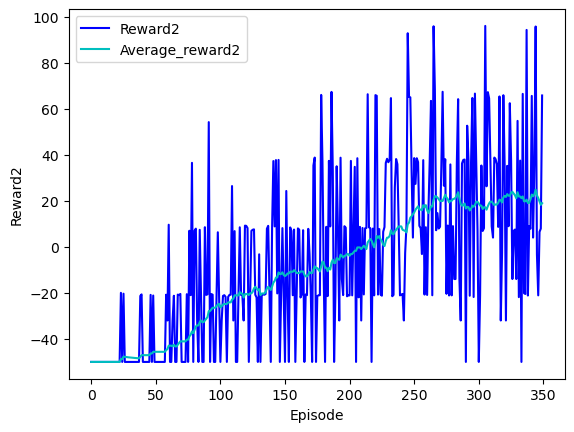

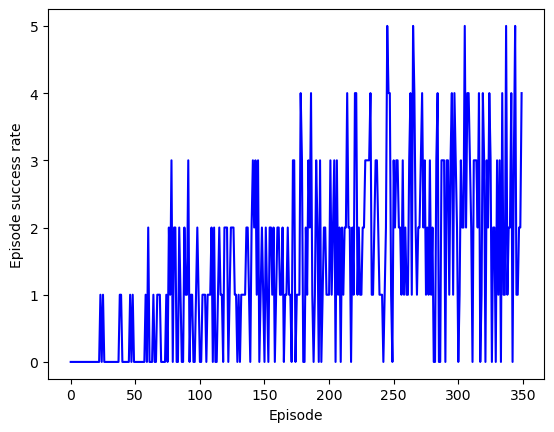

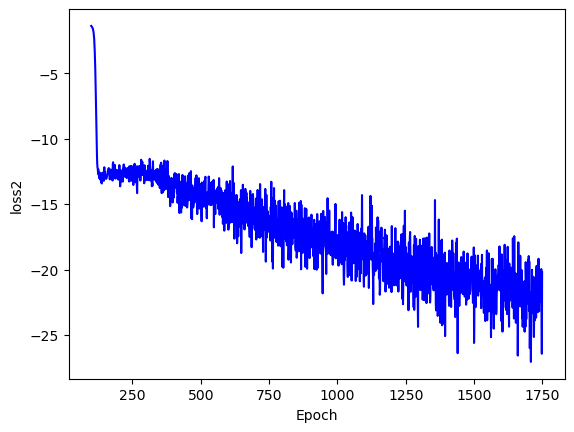

***** epoch 70 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96924.18166691608
r_em 52568.06237606016
52568.06237606016
ReWard2/R0 10.513612475212032
reward2 is: 18.51361247521203
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 1 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95390.85246791223
r_em 52534.73030610826
52534.73030610826
ReWard2/R0 10.506946061221651
reward2 is: 18.50694606122165
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 2 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96443.03463296432
r_em 52930.11960694461
52930.11960694461
ReWard2/R0 10.586023921388922
reward2 is: 18.58602392138892
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 3 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 97499.91908960333
r_em 52625.13551953747
52625.13551953747
ReWard2/R0 10.525027103907494
reward2 is: 18.525027103907494
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 4 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96937.0966640338
r_em 53173.51354297016
53173.51354297016
ReWard2/R0 10.634702708594032
reward2 is: 18.634702708594034
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.4368317938746575
***** epoch 70 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 100439.15013646093
r_em 58832.646978292796
58832.646978292796
ReWard2/R0 11.766529395658559
reward2 is: 19.76652939565856
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 6 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 101183.84010847419
r_em 58725.670260795916
58725.670260795916
ReWard2/R0 11.745134052159184
reward2 is: 19.745134052159184
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 7 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 100016.52123481405
r_em 58657.150666674905
58657.150666674905
ReWard2/R0 11.731430133334982
reward2 is: 19.73143013333498
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 8 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 99316.58065463252
r_em 58446.801188533806
58446.801188533806
ReWard2/R0 11.689360237706762
reward2 is: 19.68936023770676
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 9 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.43574080592355235
***** epoch 70 episode 2 *****
***** frame 10 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 11 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 12 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 18 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 19 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91955.5878311272
r_em 56759.634613559545
56759.634613559545
ReWard2/R0 11.35192692271191
reward2 is: 19.35192692271191
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.43356699744760513
***** epoch 70 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87798.94466880905
r_em 54127.812120244445
54127.812120244445
ReWard2/R0 10.82556242404889
reward2 is: 18.82556242404889
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 21 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 22 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 23 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88150.0717757346
r_em 53924.53252500399
53924.53252500399
ReWard2/R0 10.784906505000798
reward2 is: 18.784906505000798
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 24 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88950.9954245748
r_em 53669.56546947287
53669.56546947287
ReWard2/R0 10.733913093894575
reward2 is: 18.733913093894575
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.43248416332965656


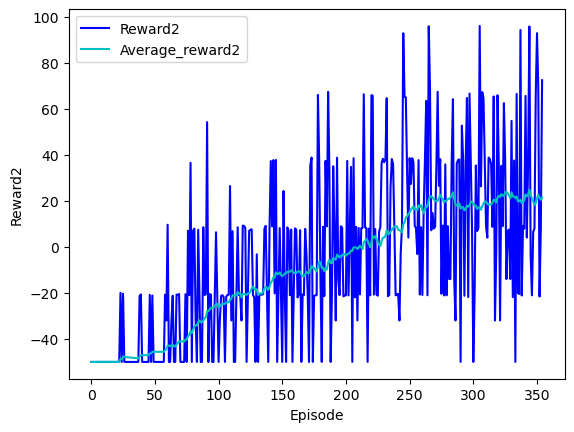

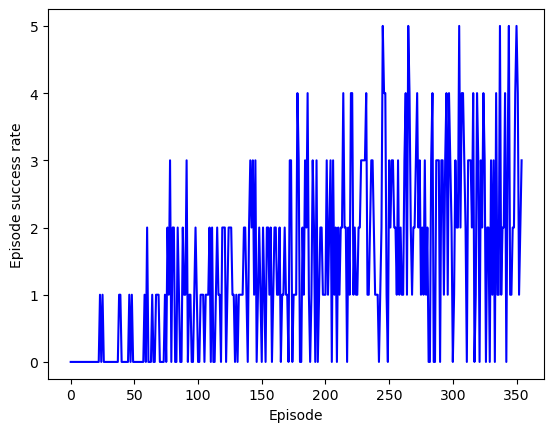

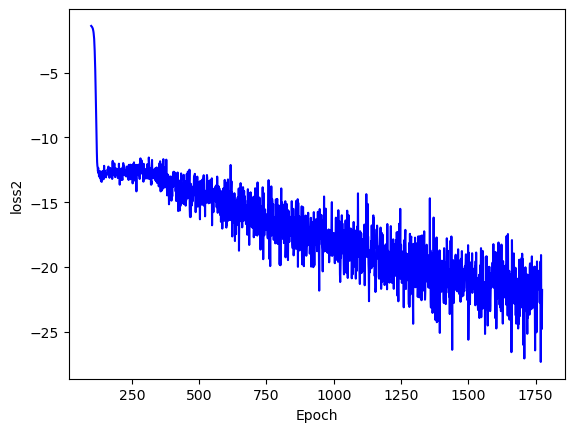

***** epoch 71 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 91375.20495884708
r_em 51379.131973652686
51379.131973652686
ReWard2/R0 10.275826394730537
reward2 is: 18.275826394730537
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 2 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83717.91447551943
r_em 52339.52457452462
52339.52457452462
ReWard2/R0 10.467904914904924
reward2 is: 18.467904914904924
total number

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 3 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82691.26553220657
r_em 53095.025049849195
53095.025049849195
ReWard2/R0 10.61900500996984
reward2 is: 18.61900500996984
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 4 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.4314040335912707
***** epoch 71 episode 1 *****
***** frame 5 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 6 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83277.3906984932
r_em 57215.85425806998
57215.85425806998
ReWard2/R0 11.443170851613996
reward2 is: 19.443170851613996
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [=========================

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 7 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84302.14568039993
r_em 57069.77953638351
57069.77953638351
ReWard2/R0 11.413955907276701
reward2 is: 19.4139559072767
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 8 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85953.29939764358
r_em 57810.50847882684
57810.50847882684
ReWard2/R0 11.562101695765369
reward2 is: 19.56210169576537
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 9 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.4303266014782564
***** epoch 71 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89069.4389098322
r_em 54068.92977352826
54068.92977352826
ReWard2/R0 10.813785954705653
reward2 is: 18.81378595470565
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 11 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 12 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90208.03740596955
r_em 55210.538533432686
55210.538533432686
ReWard2/R0 11.042107706686537
reward2 is: 19.042107706686537
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 13 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 14 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91249.44221540654
r_em 54808.94691476051
54808.94691476051
ReWard2/R0 10.961789382952102
reward2 is: 18.9617893829521
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.42925186025329076
***** epoch 71 episode 3 *****
***** frame 15 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 17 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89785.08987622308
r_em 56265.14805338174
56265.14805338174
ReWard2/R0 11.253029610676348
reward2 is: 19.25302961067635
total number of ur2 RBs: 8.0
total number of em2 RBs

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 18 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89592.56443903371
r_em 56295.98483238793
56295.98483238793
ReWard2/R0 11.259196966477585
reward2 is: 19.259196966477585
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 19 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90132.21953015684
r_em 56700.27591040548
56700.27591040548
ReWard2/R0 11.340055182081096
reward2 is: 19.340055182081095
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.4281798031958776
***** epoch 71 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 23 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with

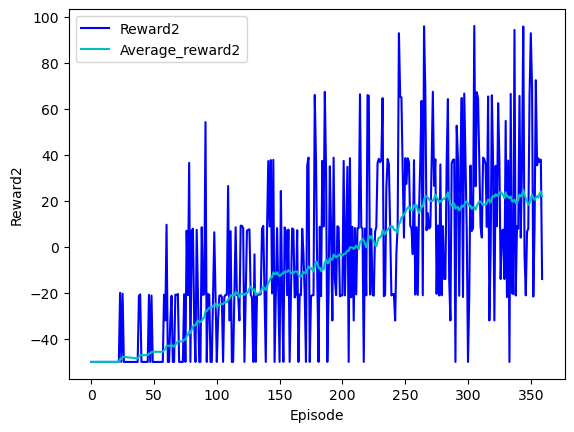

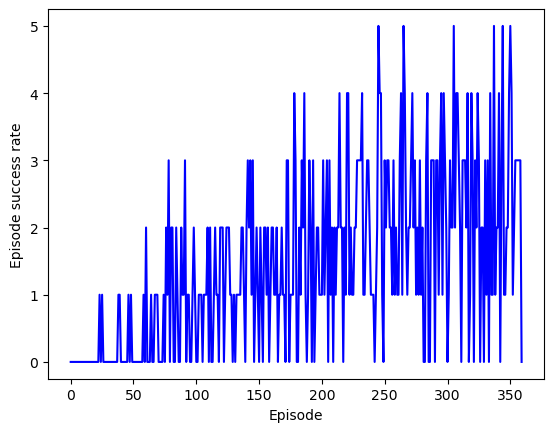

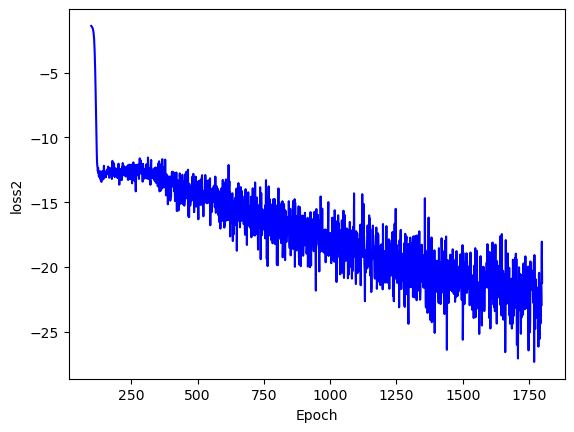

***** epoch 72 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.4260437147856038
***** epoch 72 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96117.40935996207
r_em 56896.00228223489
56896.00228223489
ReWard2/R0 11.379200456446979
reward2 is: 19.37920045644698
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 6 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96592.17202395259
r_em 57365.5357319565
57365.5357319565
ReWard2/R0 11.4731071463913
reward2 is: 19.4731071463913
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 7 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96957.0144370399
r_em 57216.35905416105
57216.35905416105
ReWard2/R0 11.44327181083221
reward2 is: 19.443271810832208
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 8 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 97059.83362418307
r_em 57657.88447033583
57657.88447033583
ReWard2/R0 11.531576894067166
reward2 is: 19.531576894067165
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 9 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96800.28485726748
r_em 57182.69638669725
57182.69638669725
ReWard2/R0 11.43653927733945
reward2 is: 19.43653927733945
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.4249796700755054
***** epoch 72 episode 2 *****
***** frame 10 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 11 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 12 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91294.3046026649
r_em 54248.20185099797
54248.20185099797
ReWard2/R0 10.849640370199594
reward2 is: 18.849640370199594
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 13 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 14 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.42391828281840016
***** epoch 72 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86840.12359975916
r_em 51029.27614543131
51029.27614543131
ReWard2/R0 10.20585522908626
reward2 is: 18.20585522908626
total number of ur2 RBs: 8.0
tota

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 17 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88470.85870137066
r_em 52572.560748528056
52572.560748528056
ReWard2/R0 10.514512149705611
reward2 is: 18.51451214970561
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 18 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87388.57516995142
r_em 53129.382783556204
53129.382783556204
ReWard2/R0 10.62587655671124
reward2 is: 18.62587655671124
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 19 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88820.24943689485
r_em 53103.5674149389
53103.5674149389
ReWard2/R0 10.62071348298778
reward2 is: 18.62071348298778
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.4228595463772959
***** epoch 72 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 75517.1397096875
r_em 55532.88297565517
55532.88297565517
ReWard2/R0 11.106576595131035
reward2 is: 19.106576595131035
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 21 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 75433.4597752082
r_em 55112.75143150882
55112.75143150882
ReWard2/R0 11.022550286301763
reward2 is: 19.022550286301765
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 22 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77509.5147567853
r_em 55198.25616557976
55198.25616557976
ReWard2/R0 11.039651233115952
reward2 is: 19.039651233115954
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 23 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78521.80691218078
r_em 54234.879903227884
54234.879903227884
ReWard2/R0 10.846975980645578
reward2 is: 18.846975980645578
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.42180345413177645


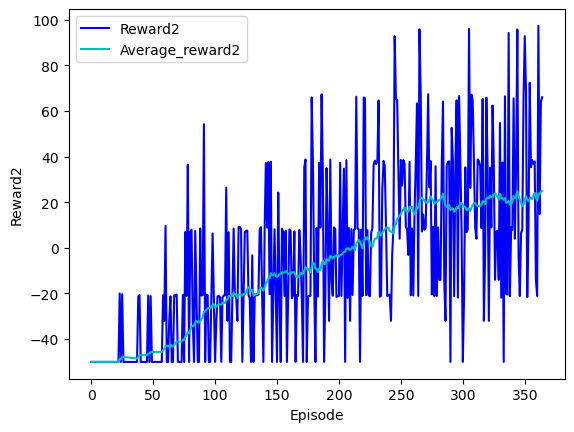

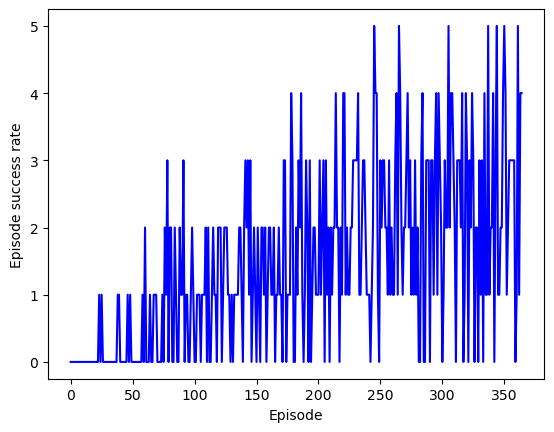

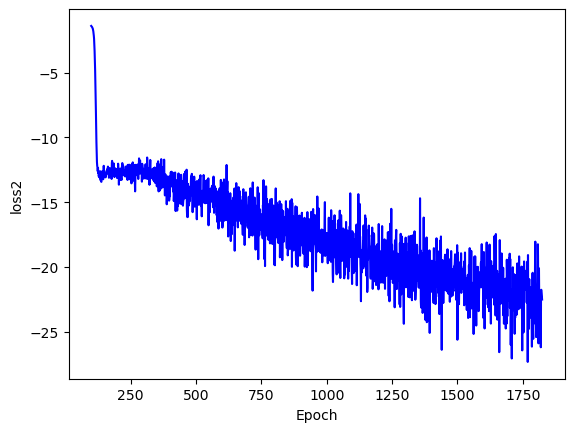

***** epoch 73 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79022.59296368806
r_em 55156.649410680875
55156.649410680875
ReWard2/R0 11.031329882136175
reward2 is: 19.031329882136177
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 2 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81620.1147130746
r_em 55713.47613090893
55713.47613090893
ReWard2/R0 11.142695226181786
reward2 is: 19.142695226181786
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 4 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82387.3264686971
r_em 55373.694866098944
55373.694866098944
ReWard2/R0 11.07473897321979
reward2 is: 19.074738973219787
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.42074999947795994
***** epoch 73 episode 1 *****
***** frame 5 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 6 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 7 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 8 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 12 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 13 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83285.41817778633
r_em 55105.511107593586
55105.511107593586
ReWard2/R0 11.021102221518717
reward2 is: 19.021102221518717
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 14 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83495.99766878365
r_em 54799.80912446484
54799.80912446484
ReWard2/R0 10.959961824892968
reward2 is: 18.959961824892968
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.41865097661233347
***** epoch 73 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83267.33569302807
r_em 54277.59422422907
54277.59422422907
ReWard2/R0 10.855518844845815
reward2 is: 18.855518844845815
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 16 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82682.86088686303
r_em 54485.49116948018
54485.49116948018
ReWard2/R0 10.897098233896035
reward2 is: 18.897098233896035
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 17 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82718.1855955614
r_em 54191.40470222363
54191.40470222363
ReWard2/R0 10.838280940444726
reward2 is: 18.838280940444726
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 18 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82714.00318450191
r_em 53691.72338891035
53691.72338891035
ReWard2/R0 10.73834467778207
reward2 is: 18.73834467778207
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 19 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.41760539527506135
***** epoch 73 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94460.68346799654
r_em 57390.92716582674
57390.92716582674
ReWard2/R0 11.478185433165347
reward2 is: 19.478185433165347
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 22 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90179.95849242962
r_em 57275.46375648974
57275.46375648974
ReWard2/R0 11.455092751297949
reward2 is: 19.455092751297947
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 23 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87294.26686480863
r_em 58308.31541160877
58308.31541160877
ReWard2/R0 11.661663082321754
reward2 is: 19.661663082321752
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.41656242527848575


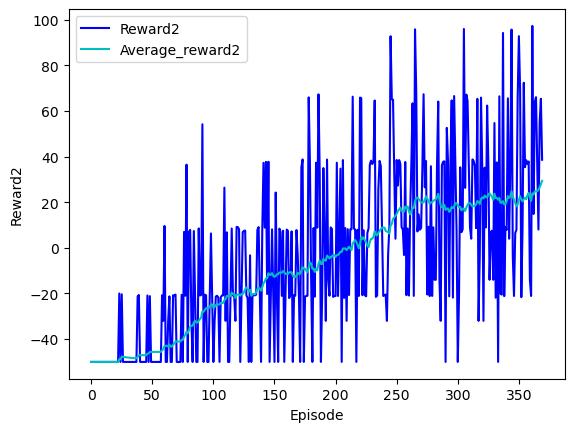

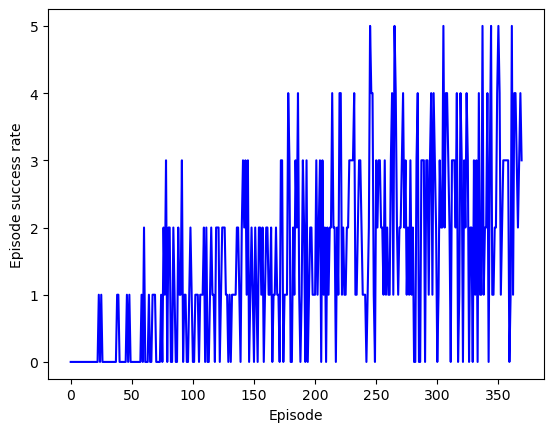

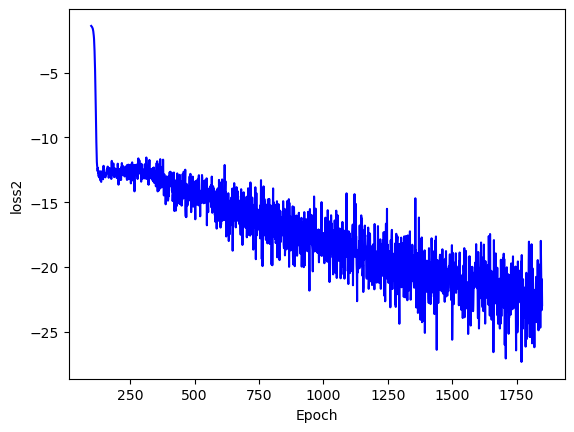

***** epoch 74 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82874.68878341591
r_em 54092.977612733
54092.977612733
ReWard2/R0 10.8185955225466
reward2 is: 18.8185955225466
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 3 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82577.26008989014
r_em 55838.507307041
55838.507307041
ReWard2/R0 11.1677014614082
reward2 is: 19.1677014614082
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 4 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.41552206010077997
***** epoch 74 episode 1 *****
***** frame 5 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 6 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91322.76286605759
r_em 54333.82231647141
54333.82231647141
ReWard2/R0 10.866764463294281
reward2 is: 18.86676446329428
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [========================

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 7 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90840.77491320122
r_em 54740.57020166722
54740.57020166722
ReWard2/R0 10.948114040333444
reward2 is: 18.948114040333444
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 8 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 9 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90318.05278677738
r_em 54037.85274583862
54037.85274583862
ReWard2/R0 10.807570549167725
reward2 is: 18.807570549167725
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.4144842932364056
***** epoch 74 episode 2 *****
***** frame 10 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 11 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83367.12305100929
r_em 52265.6298514832
52265.6298514832
ReWard2/R0 10.45312597029664
reward2 is: 18.45312597029664
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 12 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83205.6734970391
r_em 52601.146135333845
52601.146135333845
ReWard2/R0 10.52022922706677
reward2 is: 18.52022922706677
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 13 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86862.66942296081
r_em 52425.06877265944
52425.06877265944
ReWard2/R0 10.485013754531888
reward2 is: 18.485013754531888
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 14 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 87077.67312453873
r_em 50859.0396248975
50859.0396248975
ReWard2/R0 10.1718079249795
reward2 is: 18.1718079249795
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.41344911819607194
***** epoch 74 episode 3 *****
***** frame 15 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 21 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88607.49468263441
r_em 55880.727418215814
55880.727418215814
ReWard2/R0 11.176145483643163
reward2 is: 19.17614548364316
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 22 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91510.41711880993
r_em 55371.2311234589
55371.2311234589
ReWard2/R0 11.07424622469178
reward2 is: 19.07424622469178
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 23 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.411386517711358


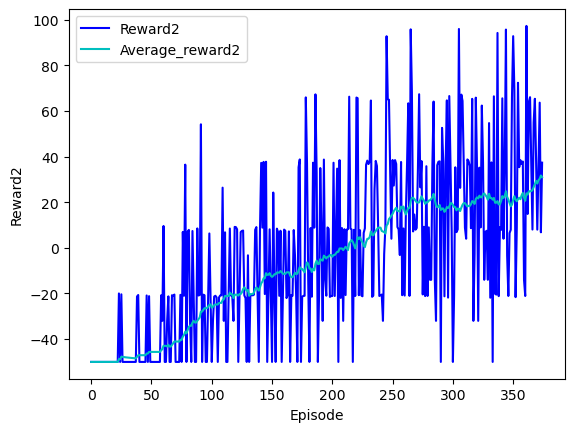

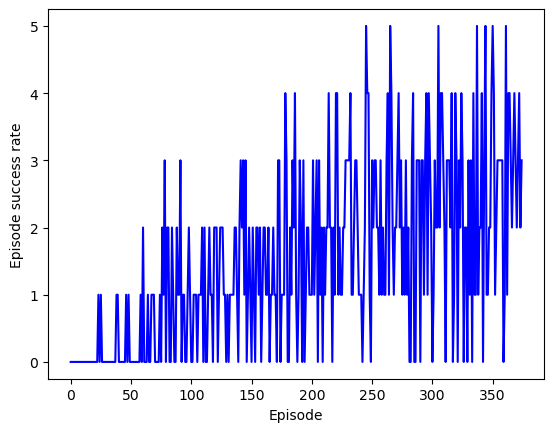

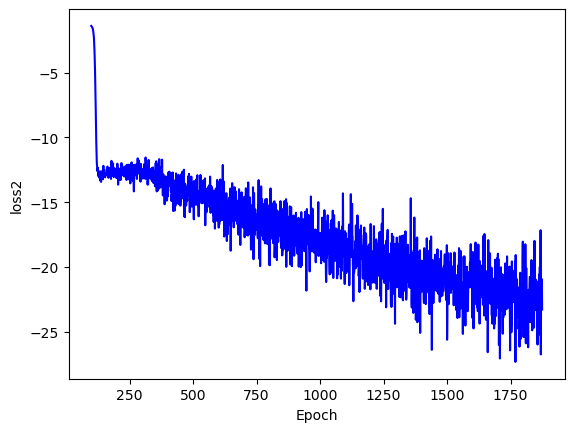

***** epoch 75 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95391.98717763717
r_em 57022.23623242532
57022.23623242532
ReWard2/R0 11.404447246485065
reward2 is: 19.404447246485063
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 1 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95223.31554766871
r_em 57656.60124153628
57656.60124153628
ReWard2/R0 11.531320248307257
reward2 is: 19.531320248307257
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 2 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95032.41844442321
r_em 57408.593724290724
57408.593724290724
ReWard2/R0 11.481718744858144
reward2 is: 19.481718744858142
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 3 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95234.17147166329
r_em 57707.8680276423
57707.8680276423
ReWard2/R0 11.541573605528459
reward2 is: 19.54157360552846
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 4 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96251.67487671095
r_em 57656.25183182791
57656.25183182791
ReWard2/R0 11.531250366365581
reward2 is: 19.531250366365583
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.4103590793692694
***** epoch 75 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88756.71141487657
r_em 56019.193984680605
56019.193984680605
ReWard2/R0 11.203838796936122
reward2 is: 19.20383879693612
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 6 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88278.98877193965
r_em 56092.442672333746
56092.442672333746
ReWard2/R0 11.218488534466749
reward2 is: 19.21848853446675
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 7 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88374.69626599186
r_em 55649.519336429854
55649.519336429854
ReWard2/R0 11.129903867285972
reward2 is: 19.12990386728597
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 8 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 9 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88998.56930856792
r_em 56540.11316832114
56540.11316832114
ReWard2/R0 11.308022633664228
reward2 is: 19.30802263366423
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.40933420705572415
***** epoch 75 episode 2 *****
***** frame 10 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 11 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96267.93764094095
r_em 53631.64623395515
53631.64623395515
ReWard2/R0 10.72632924679103
reward2 is: 18.726329246791032
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 12 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96067.10149253973
r_em 52816.49274324794
52816.49274324794
ReWard2/R0 10.563298548649588
reward2 is: 18.563298548649588
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 13 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95670.03413901947
r_em 52866.178750074316
52866.178750074316
ReWard2/R0 10.573235750014863
reward2 is: 18.573235750014863
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 14 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.4083118943620627
***** epoch 75 episode 3 *****
***** frame 15 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 16 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88538.71679663705
r_em 53477.59139975395
53477.59139975395
ReWard2/R0 10.69551827995079
reward2 is: 18.69551827995079
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [===

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 17 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 18 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87475.47643186955
r_em 54191.6075766625
54191.6075766625
ReWard2/R0 10.8383215153325
reward2 is: 18.838321515332503
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 19 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.4072921348956314
***** epoch 75 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 43ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79561.6183381896
r_em 57615.86334137193
57615.86334137193
ReWard2/R0 11.523172668274386
reward2 is: 19.523172668274384
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 21 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83564.92749544446
r_em 57952.907044201325
57952.907044201325
ReWard2/R0 11.590581408840265
reward2 is: 19.590581408840265
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 22 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89192.91970212545
r_em 57851.56577746991
57851.56577746991
ReWard2/R0 11.57031315549398
reward2 is: 19.57031315549398
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 23 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89944.1821409071
r_em 57865.11179408338
57865.11179408338
ReWard2/R0 11.573022358816676
reward2 is: 19.573022358816676
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 24 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83082.79664813523
r_em 57583.35837304478
57583.35837304478
ReWard2/R0 11.516671674608956
reward2 is: 19.516671674608958
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.40627492227974177


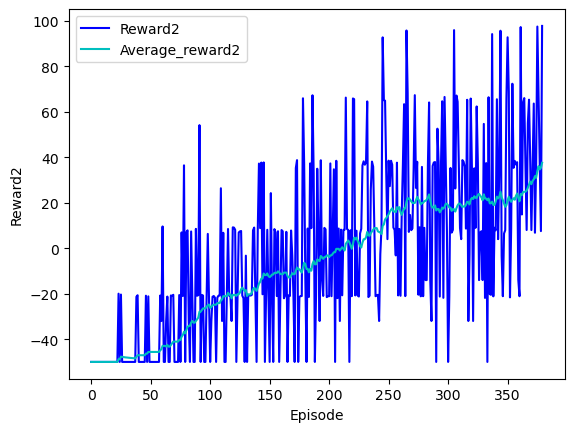

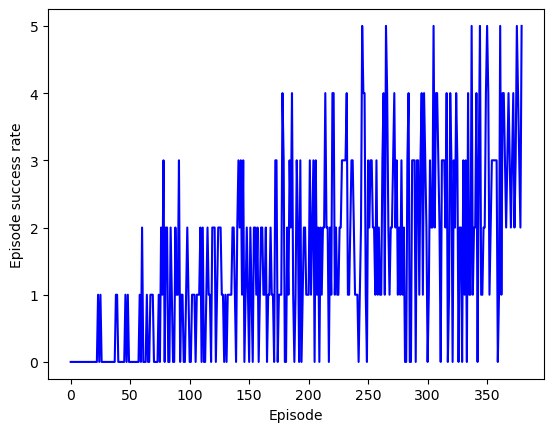

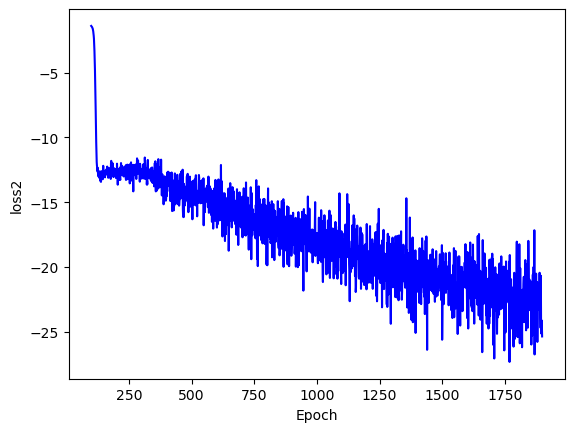

***** epoch 76 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 1 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88285.39997986385
r_em 54559.08646682968
54559.08646682968
ReWard2/R0 10.911817293365935
reward2 is: 18.911817293365935
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 2 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90859.22672231926
r_em 53564.63659451497
53564.63659451497
ReWard2/R0 10.712927318902993
reward2 is: 18.71292731890299
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 3 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84197.73236557397
r_em 54719.45655526649
54719.45655526649
ReWard2/R0 10.9438913110533
reward2 is: 18.9438913110533
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 4 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88848.02850896583
r_em 54584.70549387813
54584.70549387813
ReWard2/R0 10.916941098775625
reward2 is: 18.916941098775624
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.4052602501536315
***** epoch 76 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86208.59041244784
r_em 52430.46155116304
52430.46155116304
ReWard2/R0 10.486092310232609
reward2 is: 18.486092310232607
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 6 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 7 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 8 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85893.83133149263
r_em 51063.189628266184
51063.189628266184
ReWard2/R0 10.212637925653237
reward2 is: 18.212637925653237
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - E

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 9 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86567.32583959549
r_em 50736.78619470854
50736.78619470854
ReWard2/R0 10.147357238941709
reward2 is: 18.14735723894171
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.40424811217242423
***** epoch 76 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77995.3710122756
r_em 50141.939237182094
50141.939237182094
ReWard2/R0 10.028387847436418
reward2 is: 18.02838784743642
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 11 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 73340.91174812004
r_em 51418.21320307147
51418.21320307147
ReWard2/R0 10.283642640614294
reward2 is: 18.283642640614296
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 12 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 13 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80886.4941251337
r_em 51841.5192655534
51841.5192655534
ReWard2/R0 10.36830385311068
reward2 is: 18.36830385311068
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 14 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80124.40030596356
r_em 51442.62653886873
51442.62653886873
ReWard2/R0 10.288525307773746
reward2 is: 18.288525307773746
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.4032385020070898
***** epoch 76 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 16 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 17 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 21 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86257.29260433328
r_em 58745.67602373534
58745.67602373534
ReWard2/R0 11.749135204747068
reward2 is: 19.74913520474707
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 23 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 24 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.401226839886914


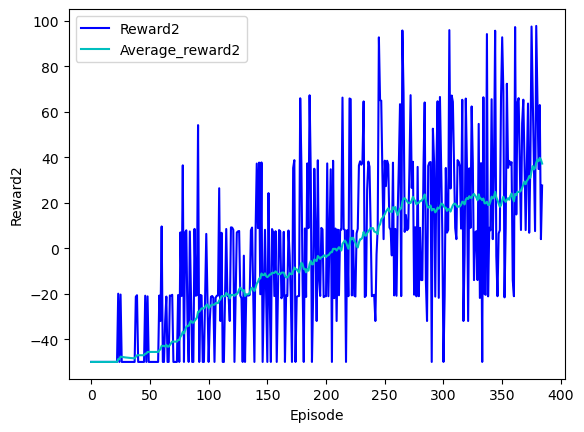

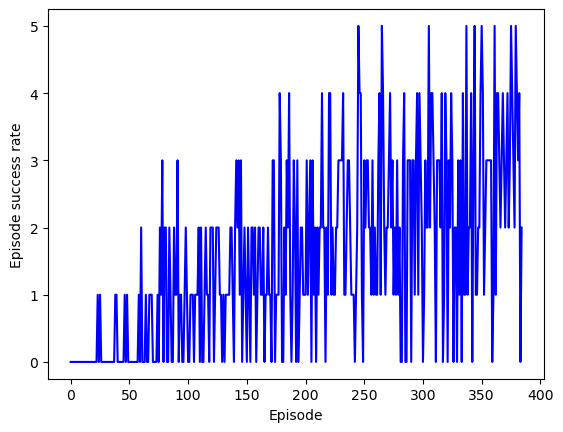

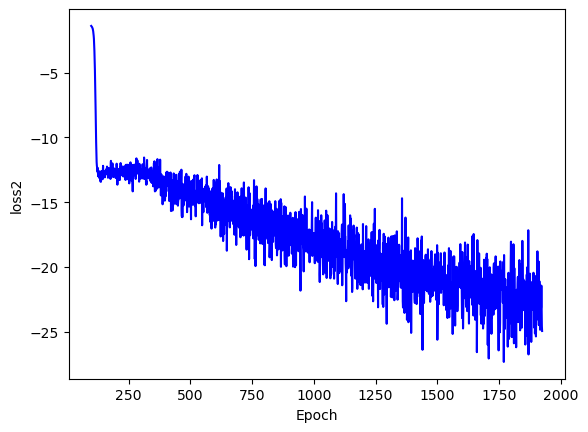

***** epoch 77 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91712.40402163714
r_em 53663.92483514844
53663.92483514844
ReWard2/R0 10.732784967029689
reward2 is: 18.732784967029687
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 2 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89321.70754315978
r_em 54536.104095442926
54536.104095442926
ReWard2/R0 10.907220819088586
reward2 is: 18.907220819088586
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 3 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91886.47601312013
r_em 55095.702274906966
55095.702274906966
ReWard2/R0 11.019140454981393
reward2 is: 19.019140454981393
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 4 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92285.62033747733
r_em 54073.40972771085
54073.40972771085
ReWard2/R0 10.814681945542171
reward2 is: 18.81468194554217
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.4002247753528884
***** epoch 77 episode 1 *****
***** frame 5 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 6 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81278.18125315252
r_em 51685.796036937565
51685.796036937565
ReWard2/R0 10.337159207387513
reward2 is: 18.337159207387515
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 7 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 8 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 9 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 74790.33258556621
r_em 52070.59020994558
52070.59020994558
ReWard2/R0 10.414118041989116
reward2 is: 18.414118041989116
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.39922521347628875
***** epoch 77 episode 2 *****
***** frame 10 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 11 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 75422.52675038207
r_em 55980.75701643035
55980.75701643035
ReWard2/R0 11.19615140328607
reward2 is: 19.19615140328607
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 12 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 13 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 14 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 76831.6544015661
r_em 56485.68994442819
56485.68994442819
ReWard2/R0 11.297137988885638
reward2 is: 19.297137988885638
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ET

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.3982281480067251
***** epoch 77 episode 3 *****
***** frame 15 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 16 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94053.76193619941
r_em 53510.22069036267
53510.22069036267
ReWard2/R0 10.702044138072534
reward2 is: 18.702044138072534
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 17 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94653.95308014947
r_em 53673.63271355092
53673.63271355092
ReWard2/R0 10.734726542710185
reward2 is: 18.734726542710185
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 18 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 19 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94914.48998887553
r_em 52747.47024159695
52747.47024159695
ReWard2/R0 10.54949404831939
reward2 is: 18.54949404831939
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.3972335727094176
***** epoch 77 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79948.4297909867
r_em 57507.78369328846
57507.78369328846
ReWard2/R0 11.501556738657692
reward2 is: 19.50155673865769
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 22 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80355.61306371195
r_em 56726.48480481151
56726.48480481151
ReWard2/R0 11.345296960962301
reward2 is: 19.3452969609623
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 23 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 24 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81595.007469034
r_em 57393.59406925595
57393.59406925595
ReWard2/R0 11.47871881385119
reward2 is: 19.478718813851188
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.39624148136515813


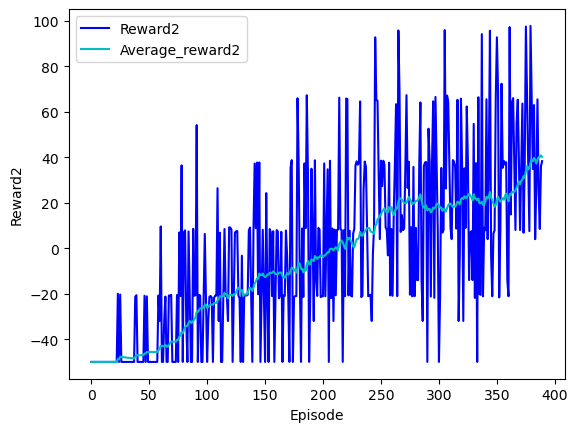

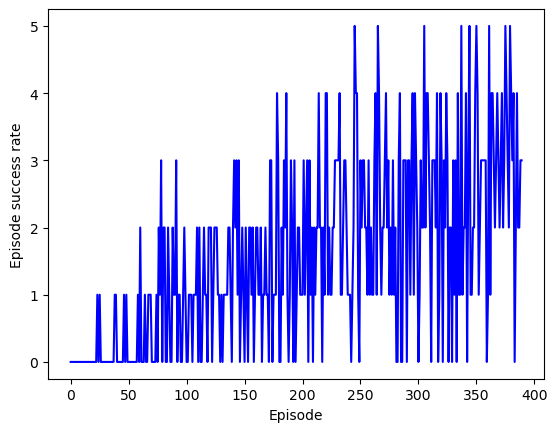

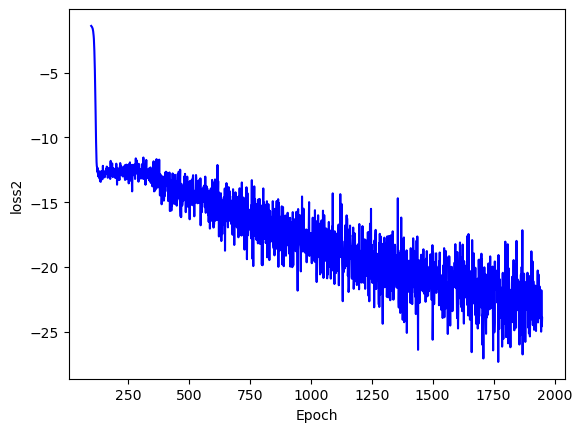

***** epoch 78 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 75981.92332670983
r_em 55677.59930890255
55677.59930890255
ReWard2/R0 11.13551986178051
reward2 is: 19.13551986178051
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 4 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83796.69963186345
r_em 56470.545831280324
56470.545831280324
ReWard2/R0 11.294109166256066
reward2 is: 19.294109166256064
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.3952518677702707
***** epoch 78 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84364.3632040414
r_em 56214.65594345009
56214.65594345009
ReWard2/R0 11.242931188690017
reward2 is: 19.242931188690015
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 6 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 7 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86062.9656271876
r_em 56601.30428676716
56601.30428676716
ReWard2/R0 11.320260857353432
reward2 is: 19.320260857353432
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 8 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84815.17603233384
r_em 56613.991482508456
56613.991482508456
ReWard2/R0 11.322798296501691
reward2 is: 19.32279829650169
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 9 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83412.52077375019
r_em 56553.04652356173
56553.04652356173
ReWard2/R0 11.310609304712345
reward2 is: 19.310609304712344
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.39426472573657323
***** epoch 78 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89951.15045336608
r_em 55702.52356942516
55702.52356942516
ReWard2/R0 11.140504713885033
reward2 is: 19.140504713885033
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 11 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 12 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 13 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 14 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
O

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.3932800490913385
***** epoch 78 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 73779.67527506902
r_em 55305.69395901561
55305.69395901561
ReWard2/R0 11.061138791803122
reward2 is: 19.061138791803124
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 16 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 75637.6639760071
r_em 55273.73021868125
55273.73021868125
ReWard2/R0 11.05474604373625
reward2 is: 19.05474604373625
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 17 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 18 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77229.855494417
r_em 56184.81811169538
56184.81811169538
ReWard2/R0 11.236963622339076
reward2 is: 19.236963622339076
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 19 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81353.75514252805
r_em 55496.29314354763
55496.29314354763
ReWard2/R0 11.099258628709526
reward2 is: 19.099258628709528
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.39229783167725585
***** epoch 78 episode 4 *****
***** frame 20 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 23 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
re

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.3913180673523923


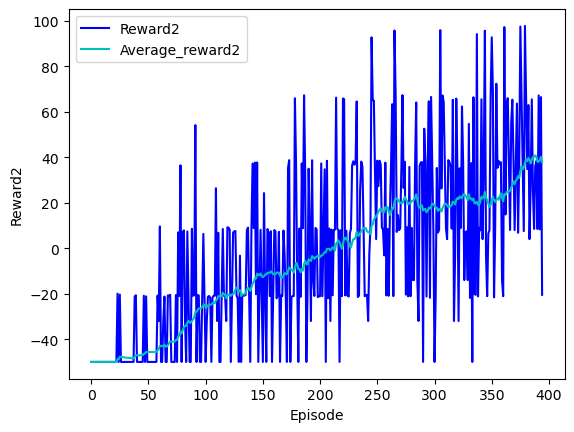

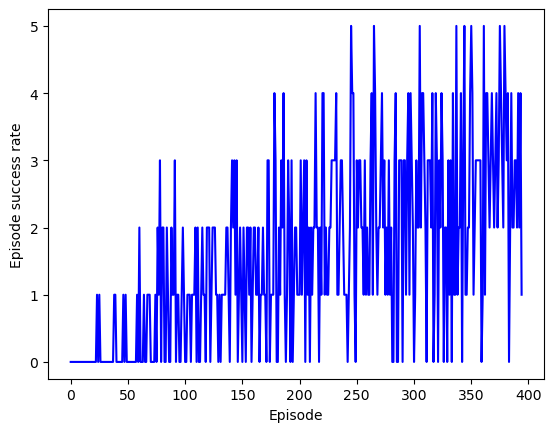

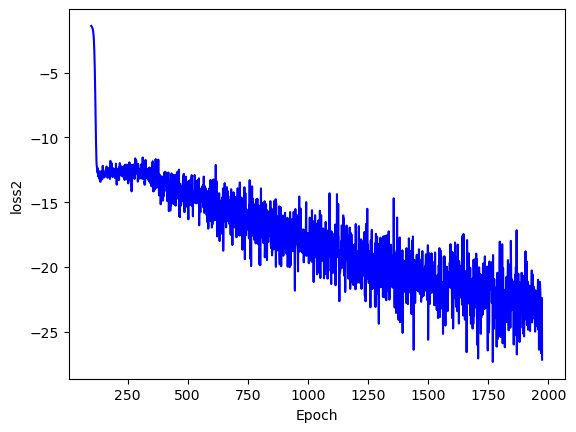

***** epoch 79 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83436.38399111448
r_em 57043.50199682867
57043.50199682867
ReWard2/R0 11.408700399365735
reward2 is: 19.408700399365735
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84745.47671382768
r_em 57072.695272110155
57072.695272110155
ReWard2/R0 11.41453905442203
reward2 is: 19.41453905442203
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 2 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79383.57846218593
r_em 57307.732309657455
57307.732309657455
ReWard2/R0 11.46154646193149
reward2 is: 19.46154646193149
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 4 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84819.58125004811
r_em 57807.1524781232
57807.1524781232
ReWard2/R0 11.56143049562464
reward2 is: 19.56143049562464
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.3903407499901545
***** epoch 79 episode 1 *****
***** frame 5 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 6 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 7 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83573.01052698787
r_em 53674.09536187828
53674.09536187828
ReWard2/R0 10.734819072375656
reward2 is: 18.734819072375657
total number of ur2 RBs: 8.0
total number of em2 RBs: 10

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 8 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 9 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.38936587347925017
***** epoch 79 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81469.64770663332
r_em 55817.99123632736
55817.99123632736
ReWard2/R0 11.163598247265472
reward2 is: 19.163598247265472
total number of ur2 RBs: 8.0
total number of em2 RBs: 

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 11 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 12 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81200.00772779174
r_em 56749.846115175445
56749.846115175445
ReWard2/R0 11.349969223035089
reward2 is: 19.34996922303509
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 13 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80560.90616578766
r_em 56697.185340231306
56697.185340231306
ReWard2/R0 11.33943706804626
reward2 is: 19.33943706804626
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 14 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.3883934317236502
***** epoch 79 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82319.03716339568
r_em 54165.32140257099
54165.32140257099
ReWard2/R0 10.833064280514197
reward2 is: 18.833064280514197
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 16 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78903.39704750772
r_em 52950.34425759857
52950.34425759857
ReWard2/R0 10.590068851519714
reward2 is: 18.590068851519714
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 17 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 18 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 19 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.38742341864255003
***** epoch 79 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 21 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91582.93703546835
r_em 49908.39794818132
49908.39794818132
ReWard2/R0 9.981679589636265
reward2 is: 17.981679589636265
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 22 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91423.0372836918
r_em 49561.906603662675
49561.906603662675
ReWard2/R0 9.912381320732536
reward2 is: 17.912381320732536
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 23 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 24 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91445.00270297666
r_em 52607.85572206765
52607.85572206765
ReWard2/R0 10.52157114441353
reward2 is: 18.521571144413528
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.3864558281703322


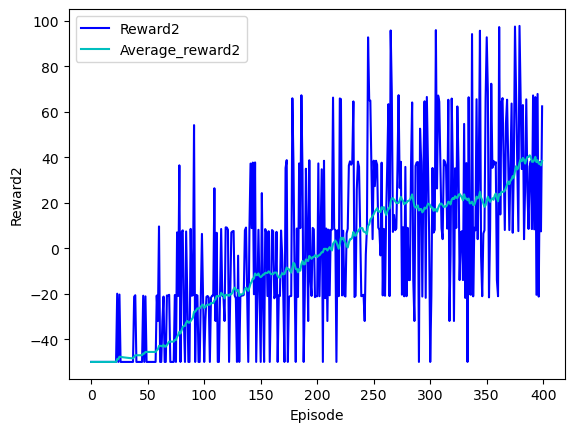

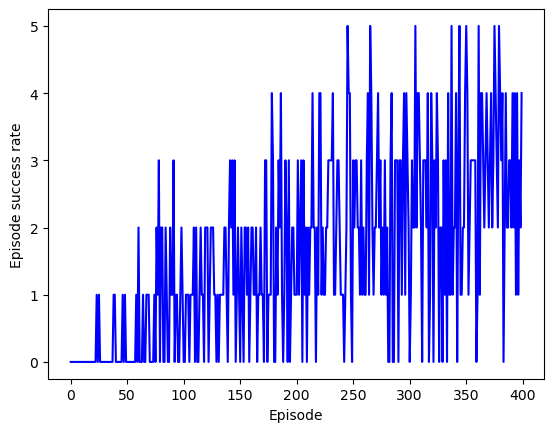

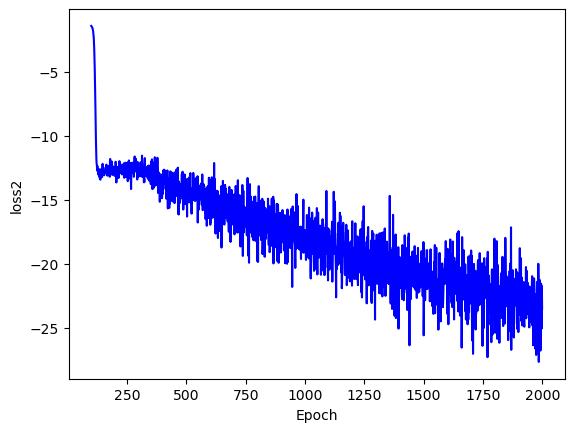

***** epoch 80 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.38549065425652784
***** epoch 80 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91980.09432504265
r_em 53823.18091697701
53823.18091697701
ReWard2/R0 10.764636183395403
reward2 is: 18.764636183395403
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 6 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93336.6212198964
r_em 53856.626449853924
53856.626449853924
ReWard2/R0 10.771325289970784
reward2 is: 18.771325289970783
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 7 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93022.4170435432
r_em 54124.471180634806
54124.471180634806
ReWard2/R0 10.824894236126962
reward2 is: 18.824894236126962
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 8 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 9 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.3845278908657794
***** epoch 80 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77039.92492606009
r_em 56039.989927001974
56039.989927001974
ReWard2/R0 11.207997985400395
reward2 is: 19.207997985400397
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 11 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 12 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 76720.88026269384
r_em 57299.49597425375
57299.49597425375
ReWard2/R0 11.459899194850749
reward2 is: 19.45989919485075
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 13 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79652.23939003478
r_em 56786.20196484255
56786.20196484255
ReWard2/R0 11.35724039296851
reward2 is: 19.35724039296851
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 14 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.38356753197780247
***** epoch 80 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92269.5924575609
r_em 54481.26809485023
54481.26809485023
ReWard2/R0 10.896253618970047
reward2 is: 18.896253618970047
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 16 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94258.53407877711
r_em 54539.66376437211
54539.66376437211
ReWard2/R0 10.907932752874423
reward2 is: 18.907932752874423
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 17 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94875.80723950922
r_em 53709.1175870291
53709.1175870291
ReWard2/R0 10.74182351740582
reward2 is: 18.74182351740582
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 18 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95435.34707549853
r_em 53704.629816333036
53704.629816333036
ReWard2/R0 10.740925963266607
reward2 is: 18.740925963266605
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 19 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96807.08065775016
r_em 54787.46658153937
54787.46658153937
ReWard2/R0 10.957493316307874
reward2 is: 18.957493316307875
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.38260957158734843
***** epoch 80 episode 4 *****
***** frame 20 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 22 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91562.10372383747
r_em 56361.760393824516
56361.760393824516
ReWard2/R0 11.272352078764904
reward2 is: 19.272352078764904
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 23 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90813.30584121005
r_em 56512.2182259816
56512.2182259816
ReWard2/R0 11.302443645196321
reward2 is: 19.30244364519632
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.3816540037041667


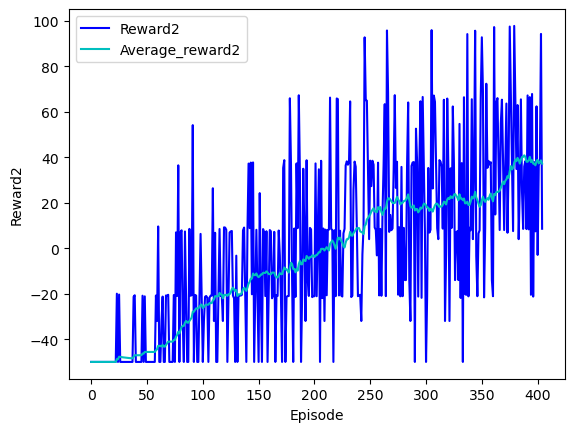

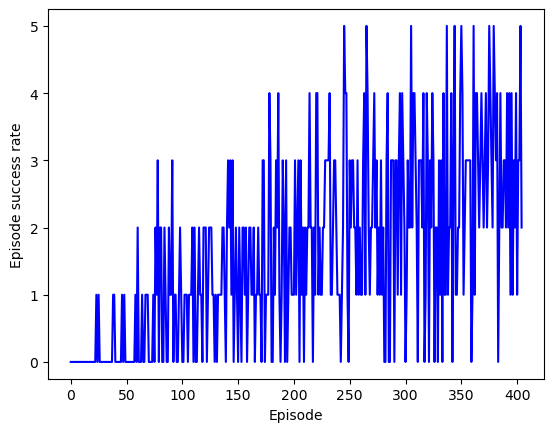

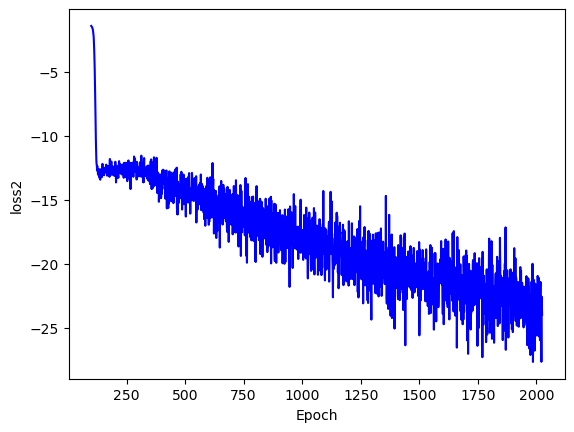

***** epoch 81 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 2 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89715.9337940412
r_em 52745.3655068481
52745.3655068481
ReWard2/R0 10.54907310136962
reward2 is: 18.549073101369622
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/st

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 3 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88668.81307116964
r_em 53296.26569295836
53296.26569295836
ReWard2/R0 10.659253138591673
reward2 is: 18.659253138591673
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 4 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89163.98036790738
r_em 52469.7717976266
52469.7717976266
ReWard2/R0 10.49395435952532
reward2 is: 18.49395435952532
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.38070082235296737
***** epoch 81 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95215.71080350102
r_em 53743.71997147971
53743.71997147971
ReWard2/R0 10.748743994295943
reward2 is: 18.748743994295943
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 6 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93589.50894543398
r_em 53850.18926933428
53850.18926933428
ReWard2/R0 10.770037853866857
reward2 is: 18.770037853866857
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 7 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 8 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 9 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.37975002157338383
***** epoch 81 episode 2 *****
***** frame 10 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 12 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91271.14022204533
r_em 54302.439306593056
54302.439306593056
ReWard2/R0 10.860487861318612
reward2 is: 18.86048786131861
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 13 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92251.52049885245
r_em 53827.67348836912
53827.67348836912
ReWard2/R0 10.765534697673823
reward2 is: 18.76553469767382
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 14 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 96252.28393184232
r_em 54480.31033548974
54480.31033548974
ReWard2/R0 10.896062067097947
reward2 is: 18.896062067097947
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.3788015954199355
***** epoch 81 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 16 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 18 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93323.49499106838
r_em 54322.27757245097
54322.27757245097
ReWard2/R0 10.864455514490194
reward2 is: 18.864455514490196
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 19 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.37785553796199073
***** epoch 81 episode 4 *****
***** frame 20 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 21 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92632.08873126496
r_em 53407.1599887241
53407.1599887241
ReWard2/R0 10.68143199774482
reward2 is: 18.68143199774482
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [======================

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 22 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91417.48784677986
r_em 53344.87364951493
53344.87364951493
ReWard2/R0 10.668974729902985
reward2 is: 18.668974729902985
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 23 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 24 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.3769118432837294


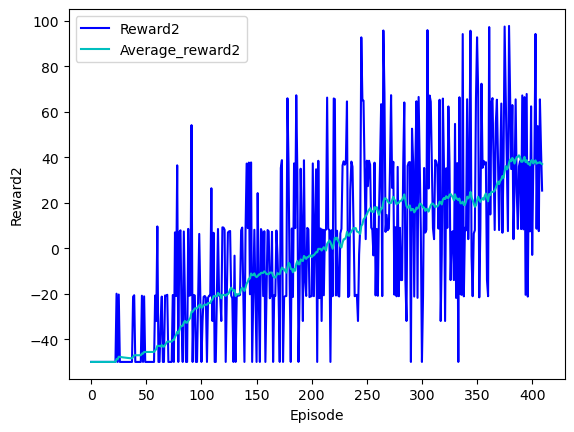

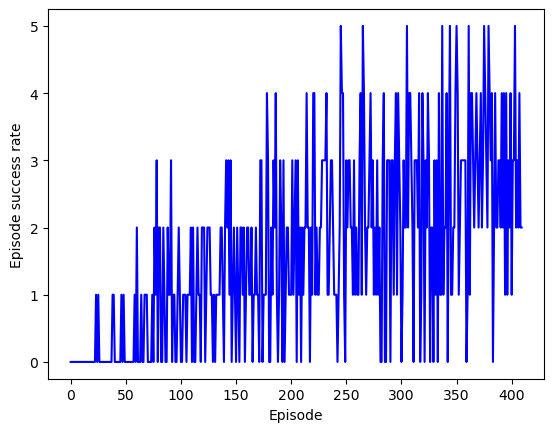

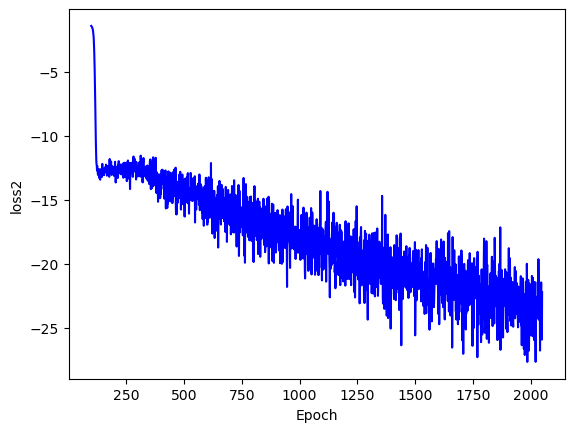

***** epoch 82 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81991.16173378316
r_em 58786.0617835665
58786.0617835665
ReWard2/R0 11.757212356713302
reward2 is: 19.757212356713303
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 2 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85159.32923185485
r_em 58388.05740211673
58388.05740211673
ReWard2/R0 11.677611480423346
reward2 is: 19.677611480423344
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 3 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85416.987072362
r_em 58386.119232648525
58386.119232648525
ReWard2/R0 11.677223846529705
reward2 is: 19.677223846529706
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 4 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82833.83253566457
r_em 58088.5106813715
58088.5106813715
ReWard2/R0 11.6177021362743
reward2 is: 19.6177021362743
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.3759705054841063
***** epoch 82 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 75598.63355909179
r_em 53829.33997127949
53829.33997127949
ReWard2/R0 10.765867994255899
reward2 is: 18.7658679942559
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 6 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 75307.67388486862
r_em 54836.13273918188
54836.13273918188
ReWard2/R0 10.967226547836376
reward2 is: 18.967226547836376
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 7 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 8 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 9 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79096.06617873936
r_em 54560.426684923325
54560.426684923325
ReWard2/R0 10.912085336984665
reward2 is: 18.912085336984667
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [=================

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.3750315186768142
***** epoch 82 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 11 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 12 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 13 *****
1/1 [============================

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 16 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88782.44869158577
r_em 55745.89742512027
55745.89742512027
ReWard2/R0 11.149179485024053
reward2 is: 19.149179485024053
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 17 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90224.96285102585
r_em 56221.02329140761
56221.02329140761
ReWard2/R0 11.244204658281522
reward2 is: 19.24420465828152
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 18 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89918.95538861465
r_em 55660.40816657835
55660.40816657835
ReWard2/R0 11.132081633315671
reward2 is: 19.13208163331567
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 19 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.37316057456746204
***** epoch 82 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92397.43743378347
r_em 57745.42024129666
57745.42024129666
ReWard2/R0 11.549084048259333
reward2 is: 19.54908404825933
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 22 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91013.86368349088
r_em 58309.74955242607
58309.74955242607
ReWard2/R0 11.661949910485212
reward2 is: 19.661949910485212
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 23 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94924.7258633444
r_em 58690.89974559622
58690.89974559622
ReWard2/R0 11.738179949119244
reward2 is: 19.738179949119242
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 24 *****
1/1 [==============================] - 0s 46ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95066.97643406143
r_em 58730.07068460402
58730.07068460402
ReWard2/R0 11.746014136920804
reward2 is: 19.746014136920806
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.37222860556614584


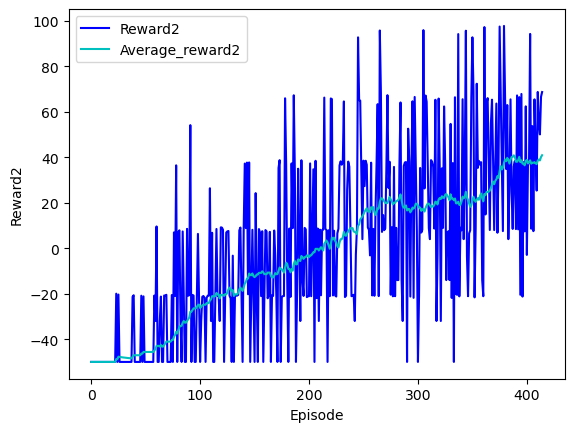

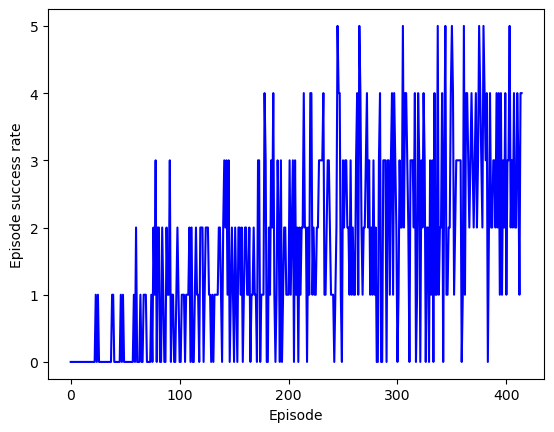

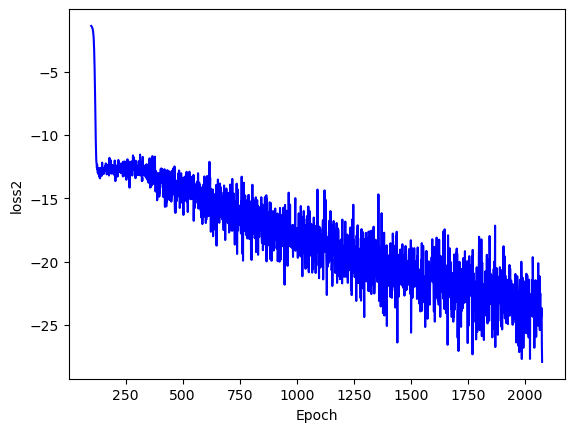

***** epoch 83 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 96182.04478425338
r_em 56953.20560115029
56953.20560115029
ReWard2/R0 11.390641120230057
reward2 is: 19.390641120230057
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 2 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86649.02184860666
r_em 56525.32361382171
56525.32361382171
ReWard2/R0 11.305064722764342
reward2 is: 19.305064722764342
total number 

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 4 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 95111.98566094776
r_em 57014.17952684499
57014.17952684499
ReWard2/R0 11.402835905368999
reward2 is: 19.402835905369
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.37129896415857505
***** epoch 83 episode 1 *****
***** frame 5 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 10ms/step
***** frame 6 *****
1

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 7 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 8 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 9 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.3703716445315814
***** epoch 83 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 13 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 14 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.3694466408865151
***** epoch 83 episode 3 *****
***** frame 15 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 16 *****
1/1 [==============================] - 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 18 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88657.08153609406
r_em 54203.41914548038
54203.41914548038
ReWard2/R0 10.840683829096076
reward2 is: 18.840683829096076
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 19 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92918.9595642952
r_em 53798.73255585443
53798.73255585443
ReWard2/R0 10.759746511170887
reward2 is: 18.75974651117089
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.36852394743920824
***** epoch 83 episode 4 *****
***** frame 20 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 21 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96601.28987056554
r_em 54543.20330493391
54543.20330493391
ReWard2/R0 10.908640660986782
reward2 is: 18.908640660986784
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 23 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 24 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 98610.09629667115
r_em 54511.267195286135
54511.267195286135
ReWard2/R0 10.902253439057226
reward2 is: 18.902253439057226
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


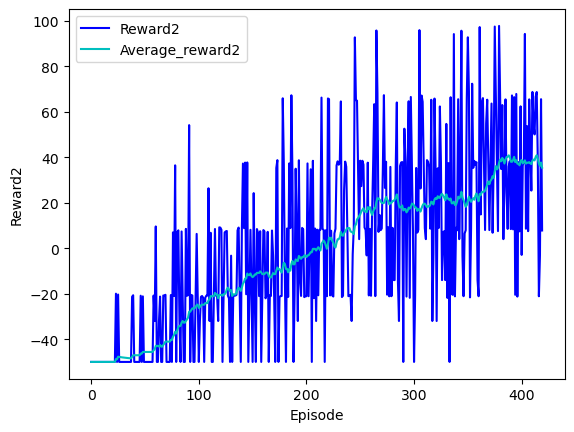

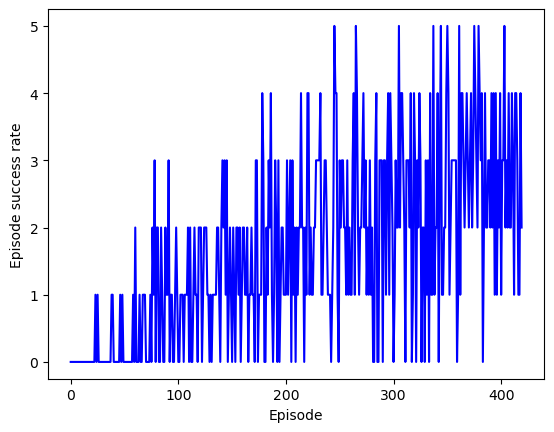

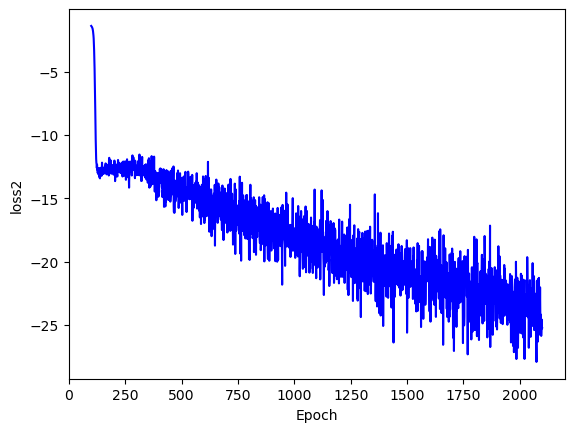

***** epoch 84 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 97723.3865885849
r_em 56246.93227214246
56246.93227214246
ReWard2/R0 11.249386454428492
reward2 is: 19.249386454428492
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 2 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 97796.75851303712
r_em 56322.23876454954
56322.23876454954
ReWard2/R0 11.264447752909907
reward2 is: 19.26444775290991
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 3 *****
1/1 [==============================] - 0s 110ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 98921.04600852863
r_em 56282.37750255207
56282.37750255207
ReWard2/R0 11.256475500510415
reward2 is: 19.256475500510415
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 4 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.36668546807339586
***** epoch 84 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82056.74989351348
r_em 55154.61975022314
55154.61975022314
ReWard2/R0 11.030923950044627
reward2 is: 19.030923950044627
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 6 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80649.97993389312
r_em 54840.130046847546
54840.130046847546
ReWard2/R0 10.96802600936951
reward2 is: 18.96802600936951
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 7 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81479.42050425847
r_em 56215.164939577466
56215.164939577466
ReWard2/R0 11.243032987915493
reward2 is: 19.24303298791549
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 8 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80175.4587784894
r_em 55779.907614847114
55779.907614847114
ReWard2/R0 11.155981522969423
reward2 is: 19.155981522969423
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 9 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.36576967065864036
***** epoch 84 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81178.93325807237
r_em 55714.546508725194
55714.546508725194
ReWard2/R0 11.14290930174504
reward2 is: 19.14290930174504
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 11 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 12 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 13 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 14 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79989.0609559468
r_em

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.3648561604490727
***** epoch 84 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 89377.31538248471
r_em 48498.747613386935
48498.747613386935
ReWard2/R0 9.699749522677386
reward2 is: 17.699749522677386
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step
***** frame 16 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 90143.99080203888
r_em 51297.613871829526
51297.613871829526
ReWard2/R0 10.259522774365905
reward2 is: 18.259522774365905
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step
***** frame 17 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 22 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 23 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 24 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.3630359788105761


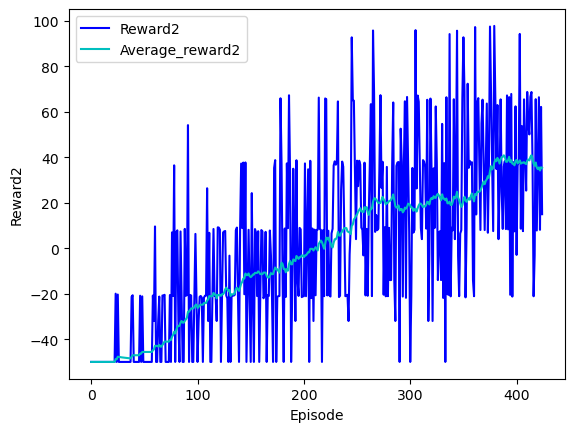

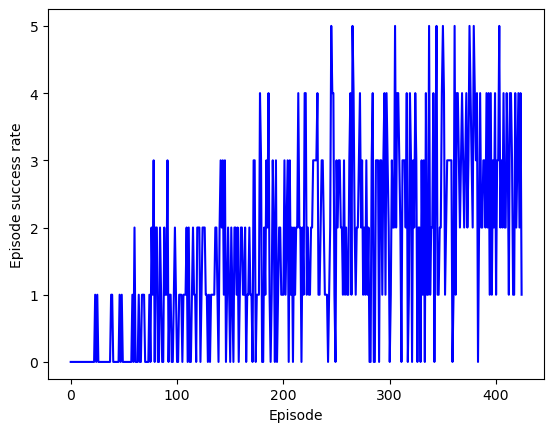

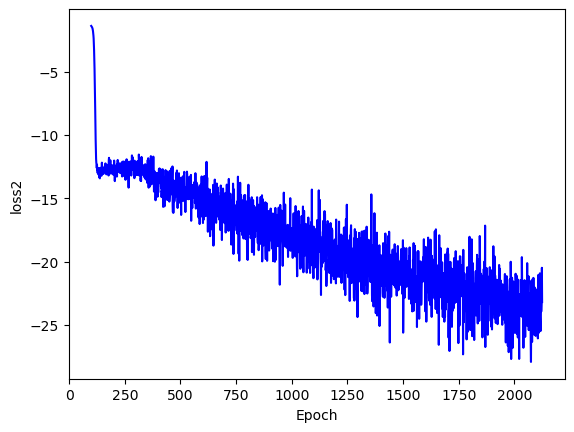

***** epoch 85 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86450.00359936702
r_em 53410.86157328584
53410.86157328584
ReWard2/R0 10.682172314657167
reward2 is: 18.682172314657166
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 1 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86817.40197147575
r_em 54924.14198446601
54924.14198446601
ReWard2/R0 10.984828396893203
reward2 is: 18.984828396893203
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 2 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85518.7494646868
r_em 54502.366168204186
54502.366168204186
ReWard2/R0 10.900473233640836
reward2 is: 18.900473233640838
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 3 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85492.73767424261
r_em 55681.928664192026
55681.928664192026
ReWard2/R0 11.136385732838406
reward2 is: 19.136385732838406
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 4 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85082.64148633466
r_em 55956.36979452152
55956.36979452152
ReWard2/R0 11.191273958904304
reward2 is: 19.191273958904304
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.36212929599981525
***** epoch 85 episode 1 *****
***** frame 5 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 6 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 7 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85465.80549351954
r_em 55350.6285797738
55350.6285797738
ReWard2/R0 11.070125715954761
reward2 is: 19.07012571595476
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>...................

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 8 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87051.4891434283
r_em 55758.64028919037
55758.64028919037
ReWard2/R0 11.151728057838074
reward2 is: 19.151728057838074
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 9 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.3612248776305073
***** epoch 85 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83455.3020182423
r_em 54172.77152947611
54172.77152947611
ReWard2/R0 10.834554305895221
reward2 is: 18.83455430589522
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 11 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80813.38274878076
r_em 52749.808636758105
52749.808636758105
ReWard2/R0 10.54996172735162
reward2 is: 18.549961727351622
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 12 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 13 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 14 *****
1/1 [==============================] - 0s 51ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.36032271804720695
***** epoch 85 episode 3 *****
***** frame 15 *****
we choose action2 wit

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 18 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82235.60721824961
r_em 53611.813792128996
53611.813792128996
ReWard2/R0 10.722362758425799
reward2 is: 18.7223627584258
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 19 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84557.69026858876
r_em 54365.36492224838
54365.36492224838
ReWard2/R0 10.873072984449676
reward2 is: 18.873072984449678
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.3594228116085933
***** epoch 85 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90362.7030560991
r_em 55829.58647387048
55829.58647387048
ReWard2/R0 11.165917294774095
reward2 is: 19.165917294774097
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 21 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90352.00591233754
r_em 55550.34328892426
55550.34328892426
ReWard2/R0 11.110068657784852
reward2 is: 19.11006865778485
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 22 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90264.18920066927
r_em 55575.01579656279
55575.01579656279
ReWard2/R0 11.115003159312558
reward2 is: 19.115003159312558
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 23 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89393.48228006305
r_em 55247.1803817459
55247.1803817459
ReWard2/R0 11.04943607634918
reward2 is: 19.04943607634918
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.35852515268743473


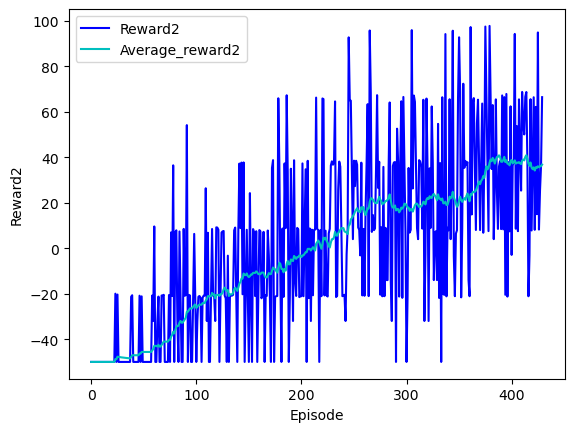

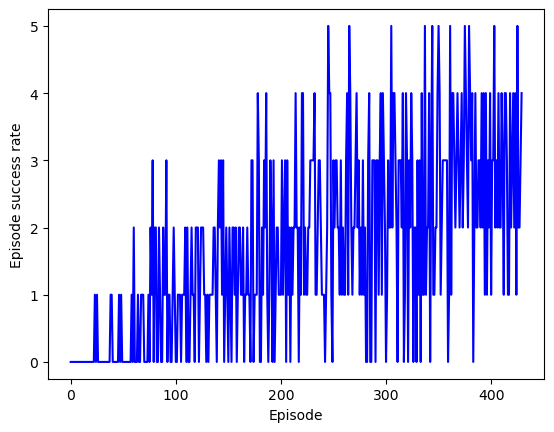

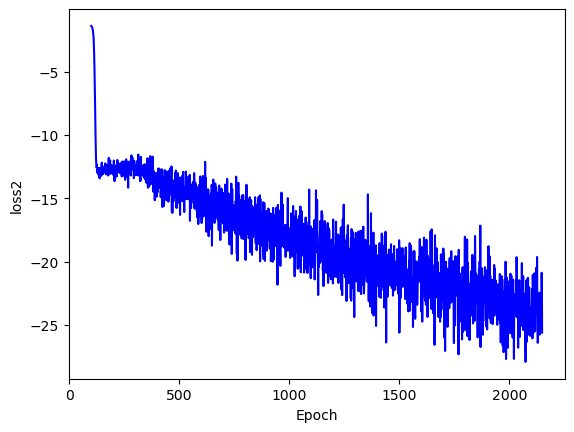

***** epoch 86 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95169.91393934825
r_em 57399.63015353674
57399.63015353674
ReWard2/R0 11.479926030707349
reward2 is: 19.479926030707347
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 1 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94984.39233832488
r_em 57612.546778385244
57612.546778385244
ReWard2/R0 11.522509355677048
reward2 is: 19.522509355677048
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 2 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94162.65597710661
r_em 57192.49103617259
57192.49103617259
ReWard2/R0 11.438498207234518
reward2 is: 19.438498207234517
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 4 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.3576297356705535
***** epoch 86 episode 1 *****
***** frame 5 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 6 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inacc

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 7 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80352.72884512745
r_em 54486.64994983668
54486.64994983668
ReWard2/R0 10.897329989967336
reward2 is: 18.897329989967336
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 8 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82910.91654647911
r_em 54885.74613710991
54885.74613710991
ReWard2/R0 10.977149227421982
reward2 is: 18.977149227421982
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 9 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83441.81313138195
r_em 54166.830227973376
54166.830227973376
ReWard2/R0 10.833366045594675
reward2 is: 18.833366045594673
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.356736554958791
***** epoch 86 episode 2 *****
***** frame 10 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 11 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92830.88706806203
r_em 61123.74299858008
61123.74299858008
ReWard2/R0 12.224748599716015
reward2 is: 20.224748599716015
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 12 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 13 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92668.04633309394
r_em 60739.42887883044
60739.42887883044
ReWard2/R0 12.147885775766088
reward2 is: 20.14788577576609
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 14 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93055.62877858232
r_em 60164.141918770736
60164.141918770736
ReWard2/R0 12.032828383754147
reward2 is: 20.032828383754147
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.35584560496697226
***** epoch 86 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 80507.7865910688
r_em 53636.94570031341
53636.94570031341
ReWard2/R0 10.727389140062682
reward2 is: 18.727389140062684
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step
***** frame 16 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 80672.99804660844
r_em 54232.0366867582
54232.0366867582
ReWard2/R0 10.84640733735164
reward2 is: 18.84640733735164
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step
***** frame 17 *****
1/1 [==============================] - 0s 18ms/step
we choo

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 18 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81967.28435238483
r_em 56017.204282413375
56017.204282413375
ReWard2/R0 11.203440856482676
reward2 is: 19.203440856482676
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 19 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.35495688012387155
***** epoch 86 episode 4 *****
***** frame 20 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 21 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83817.54280481968
r_em 48097.809690428985
48097.809690428985
ReWard2/R0 9.619561938085797
reward2 is: 17.619561938085795
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==================

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 22 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79626.42593958546
r_em 49307.98417678925
49307.98417678925
ReWard2/R0 9.861596835357851
reward2 is: 17.86159683535785
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 23 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79199.68123241876
r_em 48986.371003241715
48986.371003241715
ReWard2/R0 9.797274200648342
reward2 is: 17.797274200648342
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.3540703748721771


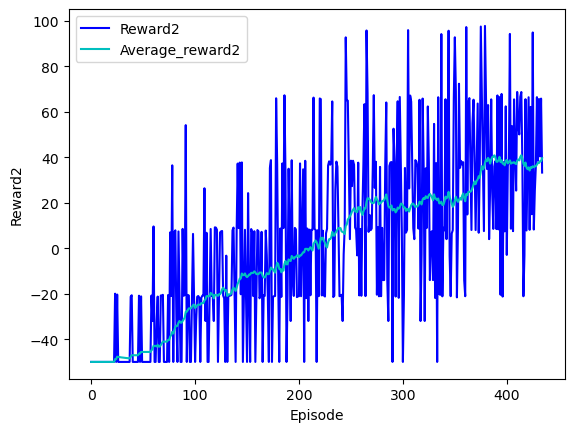

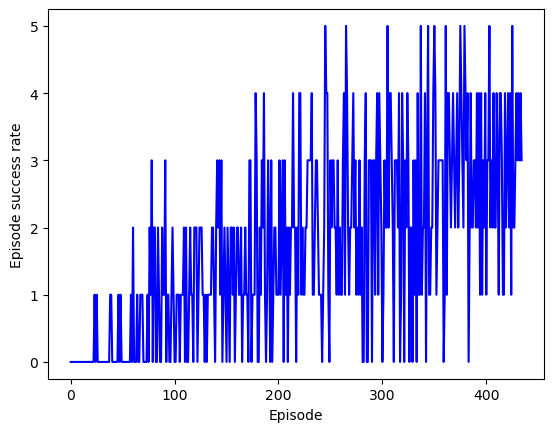

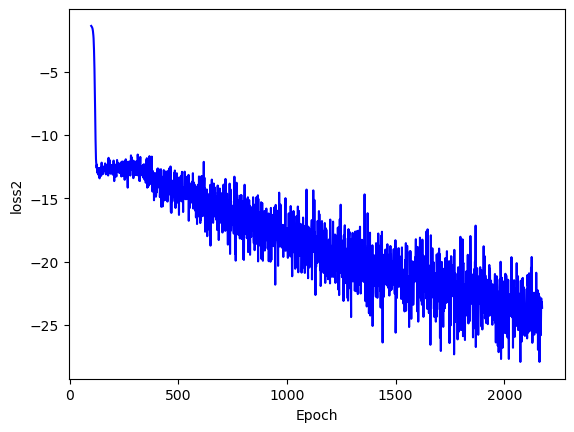

***** epoch 87 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92036.19912586057
r_em 58953.422163030176
58953.422163030176
ReWard2/R0 11.790684432606035
reward2 is: 19.790684432606035
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 1 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91981.33891883415
r_em 58790.91670777476
58790.91670777476
ReWard2/R0 11.758183341554952
reward2 is: 19.758183341554954
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 2 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89494.07412981377
r_em 58561.15950914032
58561.15950914032
ReWard2/R0 11.712231901828064
reward2 is: 19.712231901828062
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 4 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90596.24986646534
r_em 58817.99782145791
58817.99782145791
ReWard2/R0 11.763599564291582
reward2 is: 19.76359956429158
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.3531860836684566
***** epoch 87 episode 1 *****
***** frame 5 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 6 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 7 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 8 *****
1/1 [==============================] - 0s 23ms/

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 9 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83672.16846861955
r_em 52932.09069854465
52932.09069854465
ReWard2/R0 10.586418139708929
reward2 is: 18.58641813970893
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.3523040009831225
***** epoch 87 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 71991.76959250086
r_em 54143.96078070603
54143.96078070603
ReWard2/R0 10.828792156141207
reward2 is: 18.828792156141205
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 11 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 71053.60092743936
r_em 54232.07891377053
54232.07891377053
ReWard2/R0 10.846415782754105
reward2 is: 18.846415782754107
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 12 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 70136.03688131136
r_em 54085.42081195223
54085.42081195223
ReWard2/R0 10.817084162390445
reward2 is: 18.817084162390444
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 13 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 73981.11031900457
r_em 54651.14905207171
54651.14905207171
ReWard2/R0 10.930229810414342
reward2 is: 18.930229810414342
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 14 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.3514241213003973
***** epoch 87 episode 3 *****
***** frame 15 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 16 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 90323.56320957342
r_em 54201.059100075414
54201.059100075414
ReWard2/R0 10.840211820015083
reward2 is: 18.840211820015085
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [============================

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 18 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 19 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.35054643911827926
***** epoch 87 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 99489.61012633376
r_em 54811.64894096227
54811.64894096227
ReWard2/R0 10.962329788192454
reward2 is: 18.962329788192456
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - 

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 21 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 100752.54536858719
r_em 55120.64010143594
55120.64010143594
ReWard2/R0 11.024128020287188
reward2 is: 19.024128020287186
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 22 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 100154.19515238317
r_em 56002.23011260502
56002.23011260502
ReWard2/R0 11.200446022521005
reward2 is: 19.200446022521007
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 23 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 99416.66238968741
r_em 56291.94086232842
56291.94086232842
ReWard2/R0 11.258388172465684
reward2 is: 19.258388172465686
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 24 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 99964.7708599349
r_em 56284.249005992664
56284.249005992664
ReWard2/R0 11.256849801198532
reward2 is: 19.256849801198534
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.349670948948508


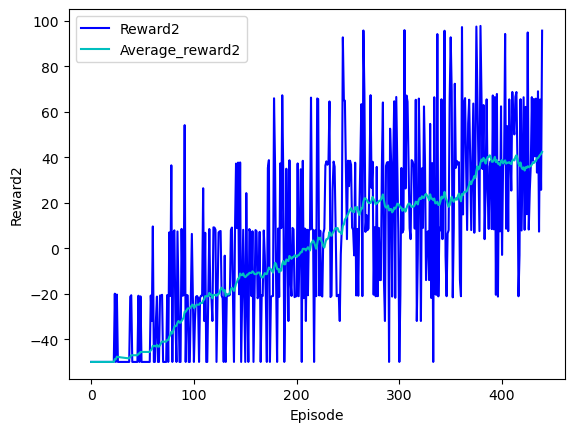

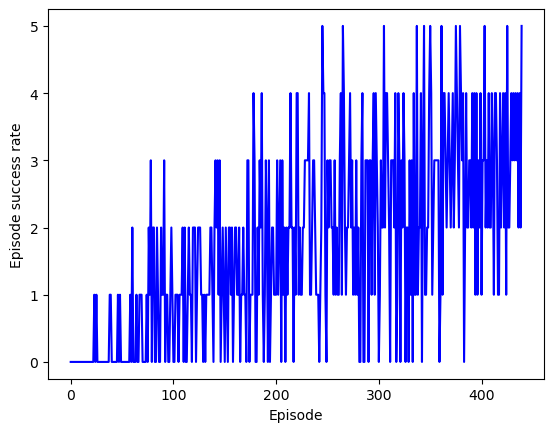

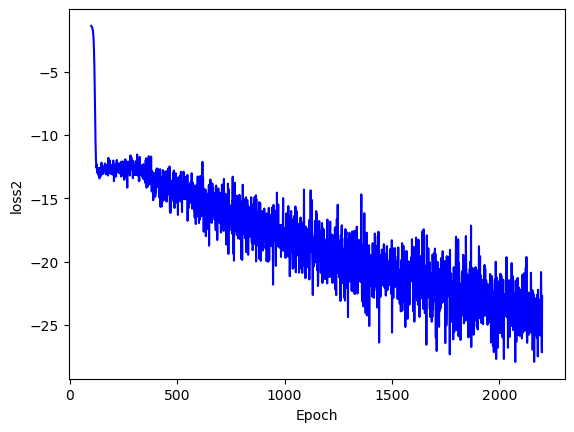

***** epoch 88 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81976.53155264806
r_em 53145.94025165843
53145.94025165843
ReWard2/R0 10.629188050331686
reward2 is: 18.629188050331685
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 1 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82924.63137819836
r_em 53941.15922939584
53941.15922939584
ReWard2/R0 10.788231845879167
reward2 is: 18.788231845879167
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 3 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90612.1761637296
r_em 53273.75747120532
53273.75747120532
ReWard2/R0 10.654751494241063
reward2 is: 18.65475149424106
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 4 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.3487976453165298
***** epoch 88 episode 1 *****
***** frame 5 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 5.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 6 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80452.87421968259
r_em 55926.277296394925
55926.277296394925
ReWard2/R0 11.185255459278984
reward2 is: 19.185255459278984
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 7 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 8 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 9 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.3479265227614638
***** epoch 88 episode 2 *****
***** frame 10 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 13 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 14 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80334.86493559867
r_em 47946.75033498771
47946.75033498771
ReWard2/R0 9.589350066997541
reward2 is: 17.58935006699754
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.3470575758360677
***** epoch 88 episode 3 *****
***** frame 15 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 17 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 18 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
rewa

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.3461907991067037
***** epoch 88 episode 4 *****
***** frame 20 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 5.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 22 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78402.77071749938
r_em 58393.40113879107
58393.40113879107
ReWard2/R0 11.678680227758214
reward2 is: 19.678680227758214
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 23 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78162.69184145698
r_em 57844.19386957922
57844.19386957922
ReWard2/R0 11.568838773915845
reward2 is: 19.568838773915843
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.34532618715330443


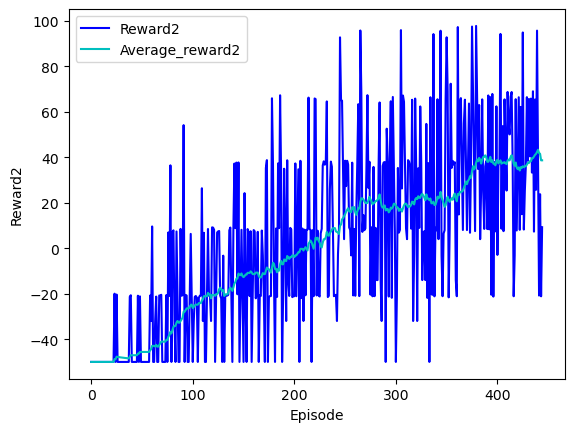

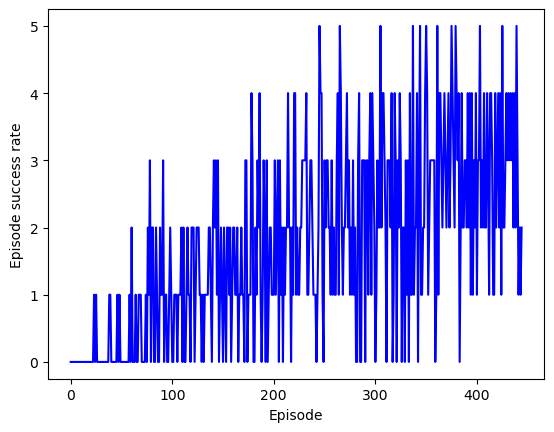

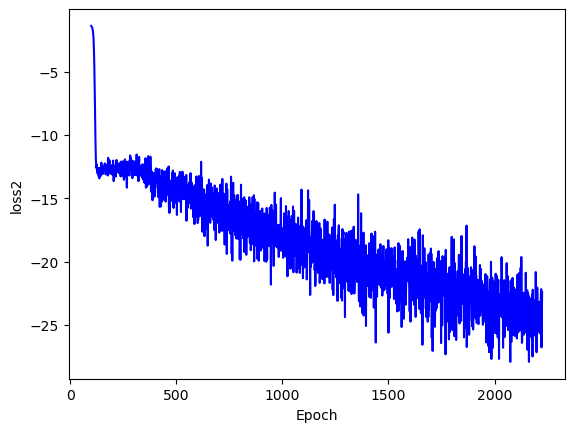

***** epoch 89 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85602.33093885901
r_em 53788.43308606156
53788.43308606156
ReWard2/R0 10.757686617212311
reward2 is: 18.75768661721231
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 1 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85316.83321147342
r_em 54023.373778187175
54023.373778187175
ReWard2/R0 10.804674755637436
reward2 is: 18.804674755637436
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 2 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85467.35099295799
r_em 55083.0597122913
55083.0597122913
ReWard2/R0 11.01661194245826
reward2 is: 19.016611942458262
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 4 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86592.81399354507
r_em 55281.41689642901
55281.41689642901
ReWard2/R0 11.056283379285802
reward2 is: 19.0562833792858
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.3444637345693393
***** epoch 89 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89057.18381345406
r_em 54313.29645779159
54313.29645779159
ReWard2/R0 10.862659291558318
reward2 is: 18.862659291558316
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 6 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 92069.98100126663
r_em 54335.19397487438
54335.19397487438
ReWard2/R0 10.867038794974876
reward2 is: 18.867038794974874
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step
***** frame 7 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 92438.19459186043
r_em 53794.31445594689
53794.31445594689
ReWard2/R0 10.758862891189379
reward2 is: 18.75886289118938
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step
***** frame 8 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93057.05733603967
r_em 54406.902425

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 9 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91052.39772098341
r_em 54904.20610161485
54904.20610161485
ReWard2/R0 10.98084122032297
reward2 is: 18.980841220322972
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.3436034359617805
***** epoch 89 episode 2 *****
***** frame 10 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 11 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82169.44969659095
r_em 54864.91500107022
54864.91500107022
ReWard2/R0 10.972983000214045
reward2 is: 18.972983000214043
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 12 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82673.44109996724
r_em 54235.58348285341
54235.58348285341
ReWard2/R0 10.847116696570684
reward2 is: 18.847116696570684
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 13 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83465.09443999287
r_em 54135.22237447164
54135.22237447164
ReWard2/R0 10.827044474894327
reward2 is: 18.82704447489433
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 14 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81668.00907567289
r_em 54445.97431603559
54445.97431603559
ReWard2/R0 10.889194863207118
reward2 is: 18.889194863207116
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.3427452859510691
***** epoch 89 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 100539.03166391292
r_em 57814.66222227374
57814.66222227374
ReWard2/R0 11.562932444454749
reward2 is: 19.56293244445475
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 17 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 100132.58318319324
r_em 58499.071781125815
58499.071781125815
ReWard2/R0 11.699814356225163
reward2 is: 19.69981435622516
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 18 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 99339.81947932561
r_em 58457.41539681422
58457.41539681422
ReWard2/R0 11.691483079362843
reward2 is: 19.691483079362843
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 19 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 98578.11055838622
r_em 57996.825617381444
57996.825617381444
ReWard2/R0 11.59936512347629
reward2 is: 19.59936512347629
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.3418892791710819
***** epoch 89 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84699.70975607415
r_em 57045.40367456255
57045.40367456255
ReWard2/R0 11.409080734912509
reward2 is: 19.409080734912507
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 21 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86059.62262162803
r_em 57289.75732582484
57289.75732582484
ReWard2/R0 11.457951465164967
reward2 is: 19.457951465164967
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 22 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87724.55803101952
r_em 57376.89394563797
57376.89394563797
ReWard2/R0 11.475378789127593
reward2 is: 19.475378789127593
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 23 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.3410354102690975


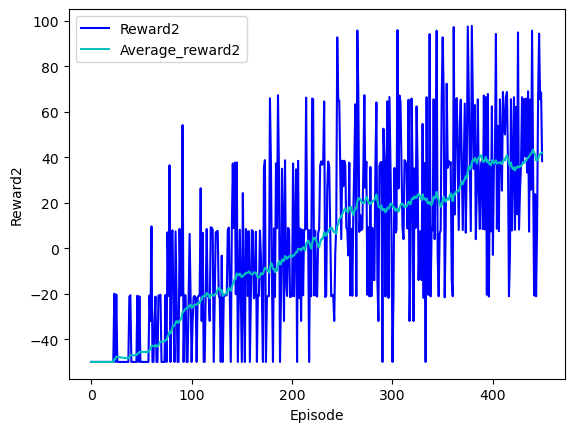

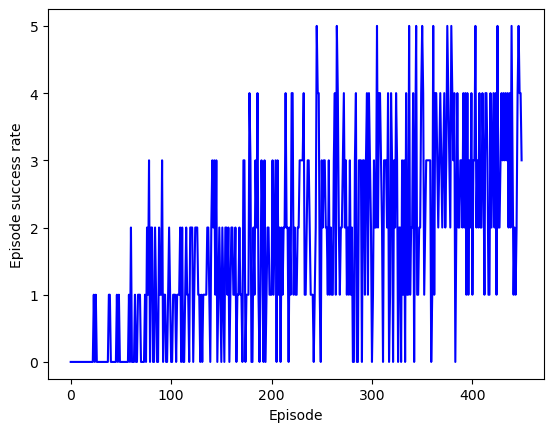

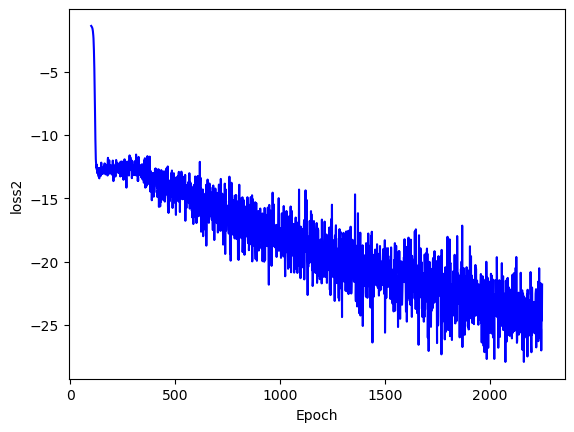

***** epoch 90 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 2 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91651.1332689224
r_em 56502.245966779235
56502.245966779235
ReWard2/R0 11.300449193355847
reward2 is: 19.300449193355846
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 4 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91481.35504371996
r_em 56018.895958815905
56018.895958815905
ReWard2/R0 11.20377919176318
reward2 is: 19.203779191763182
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.3401836739057629
***** epoch 90 episode 1 *****
***** frame 5 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 6 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88673.22388258111
r_em 57119.341337639555
57119.341337639555
ReWard2/R0 11.423868267527912
reward2 is: 19.42386826752791
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 7 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 8 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89531.60208534081
r_em 56855.129786836544
56855.129786836544
ReWard2/R0 11.371025957367308
reward2 is: 19.37102595736731
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 9 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.33933406475506
***** epoch 90 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95075.8850426501
r_em 55378.70226088054
55378.70226088054
ReWard2/R0 11.075740452176108
reward2 is: 19.075740452176106
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 11 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93838.04165583309
r_em 54788.425431865646
54788.425431865646
ReWard2/R0 10.957685086373129
reward2 is: 18.95768508637313
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 12 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94818.52996341255
r_em 55096.38252174628
55096.38252174628
ReWard2/R0 11.019276504349255
reward2 is: 19.019276504349257
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 13 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 14 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92471.66622989443
r_em 55662.24316165532
55662.24316165532
ReWard2/R0 11.132448632331064
reward2 is: 19.132448632331062
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.33848657750427275
***** epoch 90 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 16 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 89769.47971509695
r_em 50076.09687683334
50076.09687683334
ReWard2/R0 10.015219375366668
reward2 is: 18.01521937536667
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step
***** frame 17 *****
1/1 [==============================] - 0s 49ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
tot

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 21 *****
1/1 [==============================] - 0s 45ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79724.32913689227
r_em 54920.98040310862
54920.98040310862
ReWard2/R0 10.984196080621723
reward2 is: 18.98419608062172
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 22 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77729.9947843272
r_em 56297.12662089945
56297.12662089945
ReWard2/R0 11.25942532417989
reward2 is: 19.25942532417989
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 23 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80303.27338171405
r_em 56134.37590093179
56134.37590093179
ReWard2/R0 11.226875180186358
reward2 is: 19.226875180186358
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 24 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80960.45218524225
r_em 55885.70749965741
55885.70749965741
ReWard2/R0 11.177141499931482
reward2 is: 19.17714149993148
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.33679794751788983


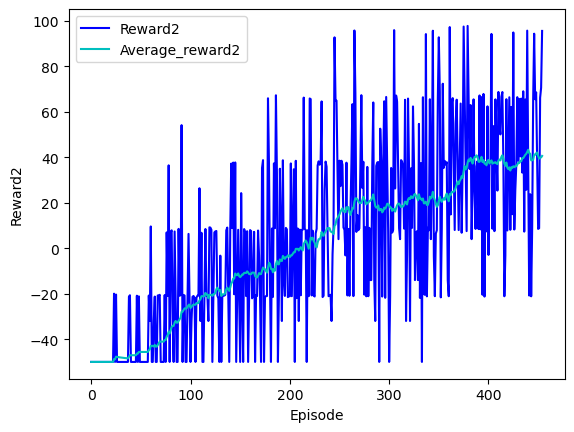

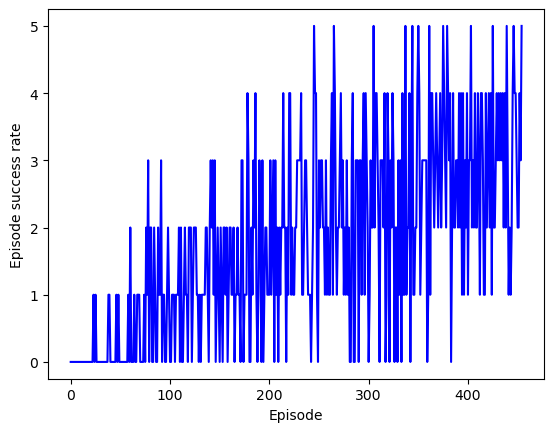

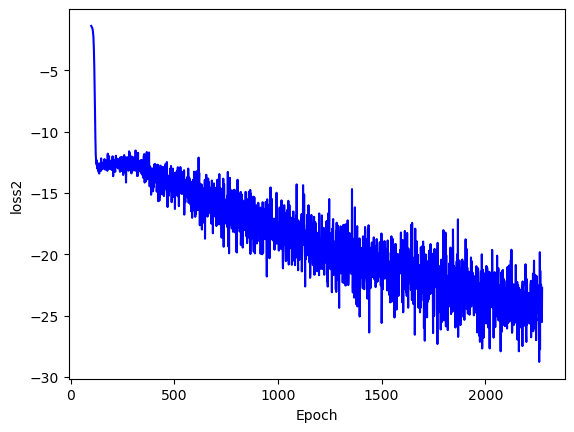

***** epoch 91 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 5.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77953.5973403579
r_em 56728.2961347963
56728.2961347963
ReWard2/R0 11.34565922695926
reward2 is: 19.34565922695926
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 2 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82117.78808124345
r_em 57255.59377887749
57255.59377887749
ReWard2/R0 11.451118755775498
reward2 is: 19.451118755775497
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 3 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83558.66227683632
r_em 57387.94425987862
57387.94425987862
ReWard2/R0 11.477588851975725
reward2 is: 19.477588851975725
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 4 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80496.19365342351
r_em 57178.65999470083
57178.65999470083
ReWard2/R0 11.435731998940167
reward2 is: 19.435731998940167
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.3359567942230718
***** epoch 91 episode 1 *****
***** frame 5 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 6 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85135.35892180825
r_em 53070.822349273294
53070.822349273294
ReWard2/R0 10.614164469854659
reward2 is: 18.614164469854657
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 7 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85192.49223666875
r_em 54245.55560201856
54245.55560201856
ReWard2/R0 10.849111120403713
reward2 is: 18.849111120403713
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 8 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 9 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87063.63107045907
r_em 54760.72954928986
54760.72954928986
ReWard2/R0 10.952145909857972
reward2 is: 18.952145909857972
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.3351177417096587
***** epoch 91 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95452.5710024547
r_em 56800.962473563326
56800.962473563326
ReWard2/R0 11.360192494712665
reward2 is: 19.360192494712663
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 11 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 12 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 13 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96995.43737143022
r_em 53757.35531634084
53757.35531634084
ReWard2/R0 10.751471063268168
reward2 is: 18.75147106326817
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [=================

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 14 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.33428078473094647
***** epoch 91 episode 3 *****
***** frame 15 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 17 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 23 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86534.60804907721
r_em 52334.954892917754
52334.954892917754
ReWard2/R0 10.466990978583551
reward2 is: 18.466990978583553
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.3326131364562932


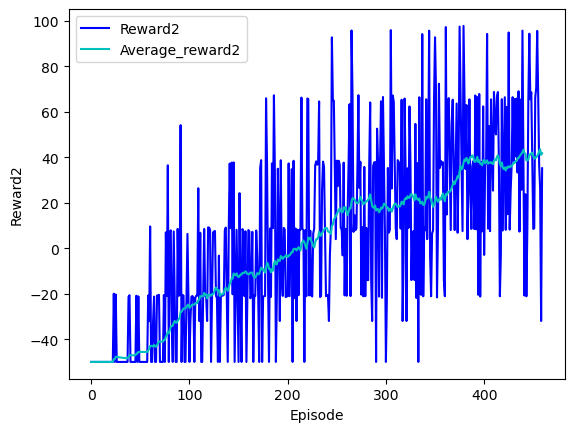

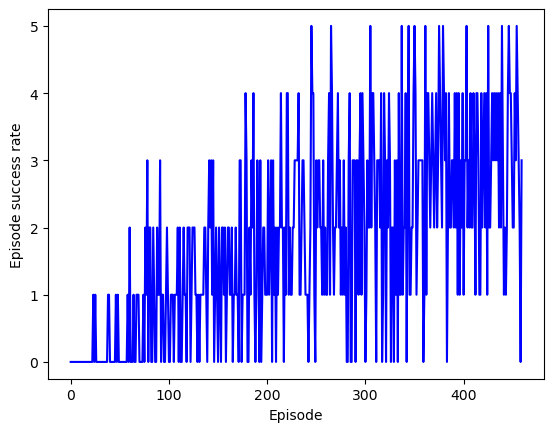

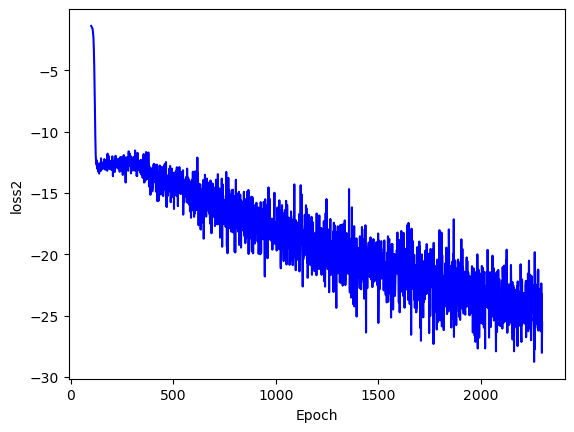

***** epoch 92 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 2 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ..

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 6 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81242.69932637038
r_em 54682.53171901395
54682.53171901395
ReWard2/R0 10.936506343802789
reward2 is: 18.93650634380279
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 7 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 8 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88990.99170433547
r_em 54020.38023718758
54020.38023718758
ReWard2/R0 10.804076047437515
reward2 is: 18.804076047437515
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 9 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88026.49231863447
r_em 54851.97854915502
54851.97854915502
ReWard2/R0 10.970395709831005
reward2 is: 18.970395709831003
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.3309538076869629
***** epoch 92 episode 2 *****
***** frame 10 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 11 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 12 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87636.74414909723
r_em 53335.11196027785
53335.11196027785
ReWard2/R0 10.66702239205557
reward2 is: 18.66702239205557
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [====================

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 13 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87371.21058624928
r_em 53449.449260752575
53449.449260752575
ReWard2/R0 10.689889852150515
reward2 is: 18.689889852150515
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 14 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.330127250138676
***** epoch 92 episode 3 *****
***** frame 15 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 17 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 23 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 87982.04833445125
r_em 54585.86549890053
54585.86549890053
ReWard2/R0 10.917173099780106
reward2 is: 18.917173099780108
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step
***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.3284803228719684


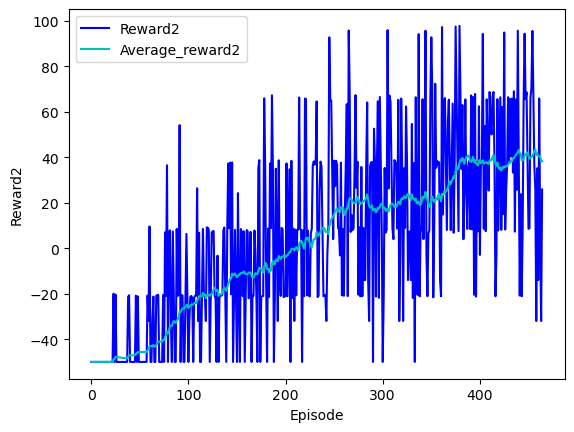

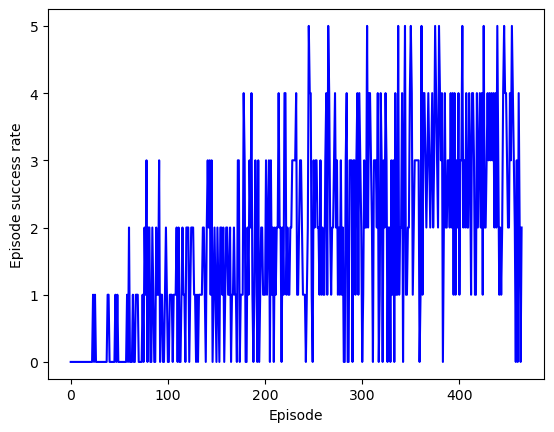

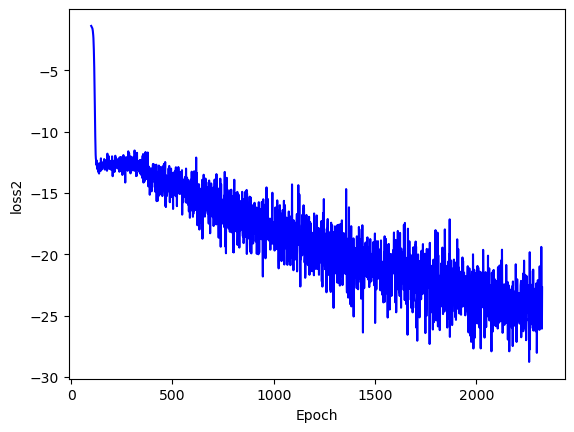

***** epoch 93 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 88627.42624933348
r_em 53152.029081757035
53152.029081757035
ReWard2/R0 10.630405816351407
reward2 is: 18.630405816351406
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step
***** frame 1 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 87097.72475635045
r_em 51732.40325804562
51732.40325804562
ReWard2/R0 10.346480651609124
reward2 is: 18.346480651609124
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step
***** frame 2 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 89685.775394

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 8 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 9 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 75252.17182352998
r_em 54368.17361524589
54368.17361524589
ReWard2/R0 10.873634723049179
reward2 is: 18.87363472304918
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.32684161173834486
***** epoch 93 episode 2 *****
***** frame 10 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 11 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83764.29417292742
r_em 53555.939002073435
53555.939002073435
ReWard2/R0 10.711187800414686
reward2 is: 18.711187800414685
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 12 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 83863.81013394108
r_em 53692.59452953865
53692.59452953865
ReWard2/R0 10.73851890590773
reward2 is: 18.738518905907732
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step
***** frame 13 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85605.25629754437
r_em 54724.268800542275
54724.268800542275
ReWard2/R0 10.944853760108455
reward2 is: 18.944853760108455
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 14 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85462.56296137927
r_em 55368.37849125497
55368.37849125497
ReWard2/R0 11.073675698250993
reward2 is: 19.073675698250995
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.3260253244045785
***** epoch 93 episode 3 *****
***** frame 15 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 16 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 17 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 18 *****
1/1 [==============================] - 0s 28ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 23 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.32439886068135193


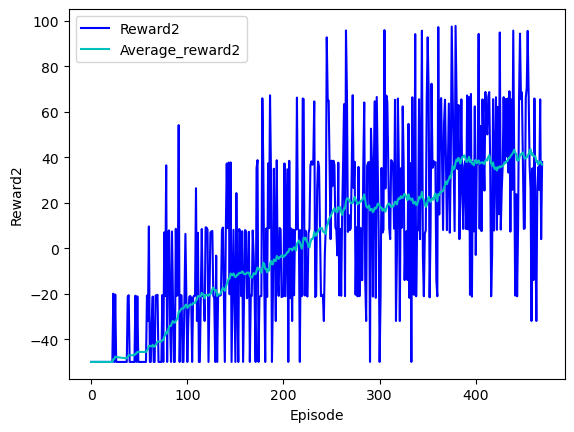

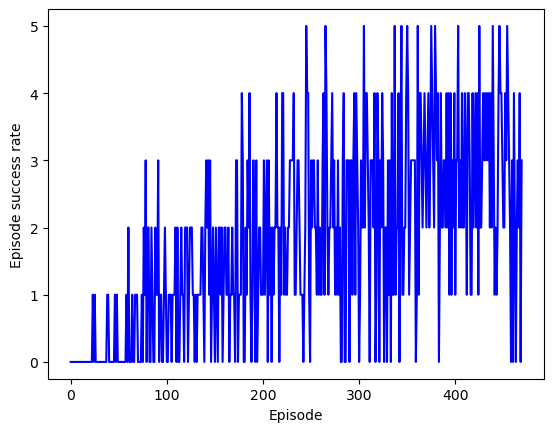

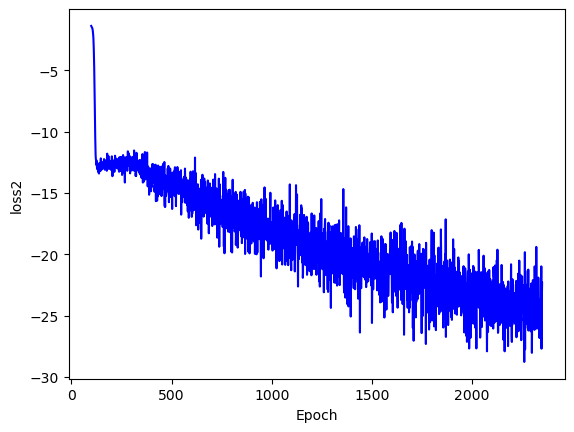

***** epoch 94 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89595.38049692637
r_em 56896.59438863276
56896.59438863276
ReWard2/R0 11.379318877726552
reward2 is: 19.379318877726554
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 1 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89350.03524734074
r_em 56112.8876871969
56112.8876871969
ReWard2/R0 11.22257753743938
reward2 is: 19.222577537439378
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 2 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89090.68799106508
r_em 56047.07204754079
56047.07204754079
ReWard2/R0 11.209414409508158
reward2 is: 19.209414409508156
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 3 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90602.39310084387
r_em 56265.23260904255
56265.23260904255
ReWard2/R0 11.25304652180851
reward2 is: 19.25304652180851
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 4 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90576.07934612664
r_em 56435.695776536275
56435.695776536275
ReWard2/R0 11.287139155307255
reward2 is: 19.287139155307255
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.32358867412140313
***** epoch 94 episode 1 *****
***** frame 5 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 6 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 6.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 7 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92769.16021204519
r_em 59368.99630295659
59368.99630295659
ReWard2/R0 11.87379926059132
reward2 is: 19.87379926059132
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 8 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92674.37951797809
r_em 58410.23470003554
58410.23470003554
ReWard2/R0 11.682046940007107
reward2 is: 19.682046940007105
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 9 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93525.18334706106
r_em 59074.798562929114
59074.798562929114
ReWard2/R0 11.814959712585823
reward2 is: 19.814959712585825
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.3227805110034003
***** epoch 94 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89669.25010529617
r_em 54918.31320235321
54918.31320235321
ReWard2/R0 10.983662640470643
reward2 is: 18.98366264047064
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 11 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 12 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90356.13097699096
r_em 56688.75058618942
56688.75058618942
ReWard2/R0 11.337750117237883
reward2 is: 19.33775011723788
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 13 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 14 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.3219743662737947
***** epoch 94 episode 3 *****
***** frame 15 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 16 *****
1/1 [===============

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 17 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83279.65167119933
r_em 52925.7259183455
52925.7259183455
ReWard2/R0 10.5851451836691
reward2 is: 18.5851451836691
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 18 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 19 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.3211702348916586
***** epoch 94 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88648.77775987677
r_em 51731.26658530866
51731.26658530866
ReWard2/R0 10.346253317061732
reward2 is: 18.34625331706173
total number of ur2 RBs: 8.0
total number of em2 RBs: 1

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 22 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88040.51748168046
r_em 52179.6425709286
52179.6425709286
ReWard2/R0 10.43592851418572
reward2 is: 18.43592851418572
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 23 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.32036811182865427


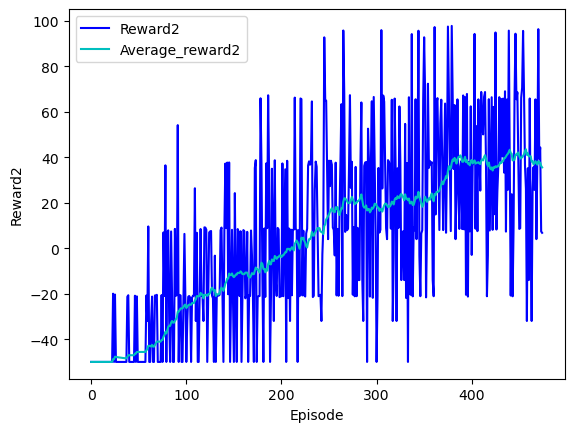

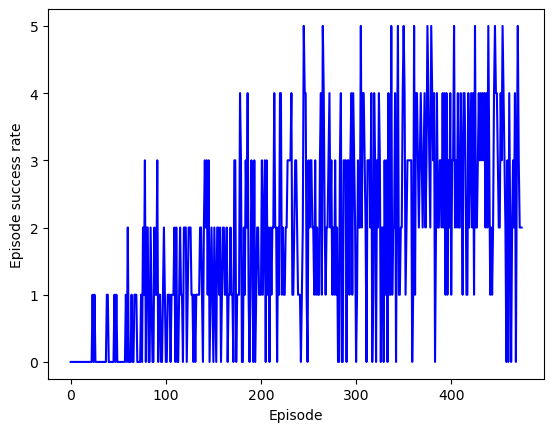

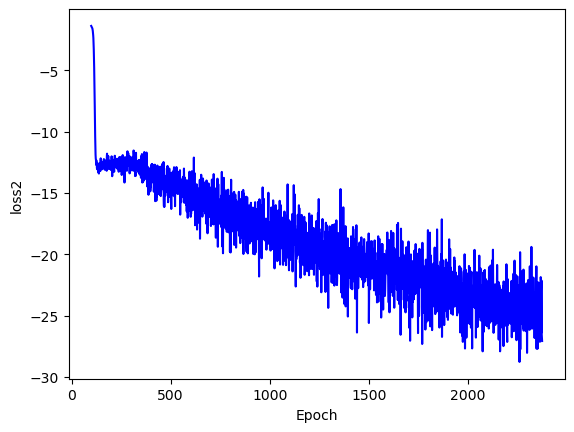

***** epoch 95 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 102419.57240358245
r_em 56088.68460277592
56088.68460277592
ReWard2/R0 11.217736920555183
reward2 is: 19.217736920555183
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 2 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 99917.40483062578
r_em 54455.396279938715
54455.396279938715
ReWard2/R0 10.891079255987743
reward2 is: 18.89107925598774
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step
***** frame 3 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 100698.38781476613
r_em 55171.64702409526
55171.64702409526
ReWard2/R0 11.034329404819053
reward2 is: 19.0343294

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 4 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 100950.272069786
r_em 55684.38854068771
55684.38854068771
ReWard2/R0 11.136877708137542
reward2 is: 19.13687770813754
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.31956799206900227
***** epoch 95 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81400.72292281785
r_em 56621.394550578596
56621.394550578596
ReWard2/R0 11.32427891011572
reward2 is: 19.32427891011572
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 6 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 7 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82235.18067420684
r_em 56669.417654040175
56669.417654040175
ReWard2/R0 11.333883530808034
reward2 is: 19.333883530808034
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 8 *****
1/1 [==============================] - 0s 43ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82587.02772235736
r_em 57293.55531111107
57293.55531111107
ReWard2/R0 11.458711062222214
reward2 is: 19.458711062222214
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 9 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83081.9134018329
r_em 57679.24475590691
57679.24475590691
ReWard2/R0 11.535848951181382
reward2 is: 19.535848951181382
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.31876987060944983
***** epoch 95 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87813.05285811274
r_em 53818.16474219929
53818.16474219929
ReWard2/R0 10.763632948439858
reward2 is: 18.763632948439856
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 11 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87733.56455193998
r_em 54065.57146670319
54065.57146670319
ReWard2/R0 10.81311429334064
reward2 is: 18.81311429334064
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 12 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 13 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 14 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89905.52651129436
r_em 53733.41553312808
53733.41553312808
ReWard2/R0 10.746683106625616
reward2 is: 18.746683106625618
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.3179737424592401
***** epoch 95 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 99963.24422508874
r_em 55285.285381965296
55285.285381965296
ReWard2/R0 11.05705707639306
reward2 is: 19.057057076393058
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 16 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94518.79699754232
r_em 55511.70031387509
55511.70031387509
ReWard2/R0 11.102340062775017
reward2 is: 19.102340062775017
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 17 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 18 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 19 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 97398.3418070328
r_em 53950.968196982925
53950.968196982925
ReWard2/R0 10.790193639396586
reward2 is: 18.790193639396584
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.3171796026400804
***** epoch 95 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92720.0657378913
r_em 56374.02474327893
56374.02474327893
ReWard2/R0 11.274804948655786
reward2 is: 19.274804948655785
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 5.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 22 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91895.77182875515
r_em 55984.28462694904
55984.28462694904
ReWard2/R0 11.196856925389808
reward2 is: 19.19685692538981
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 23 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 24 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87291.3730232369
r_em 55803.2505972809
55803.2505972809
ReWard2/R0 11.16065011945618
reward2 is: 19.16065011945618
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.31638744618611153


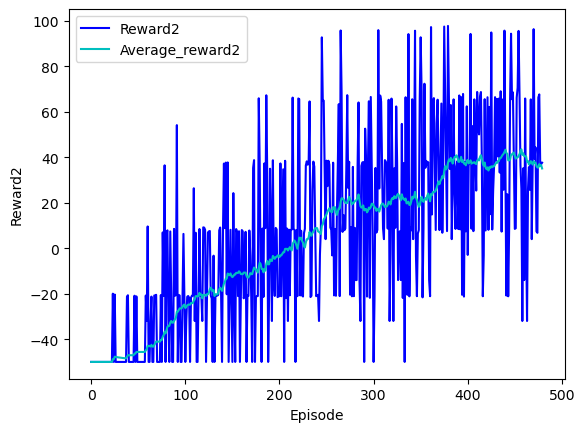

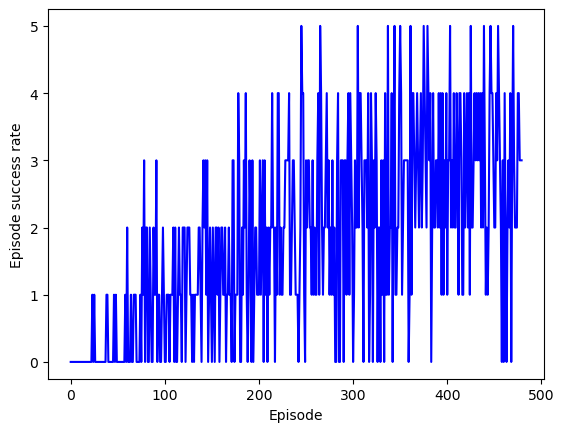

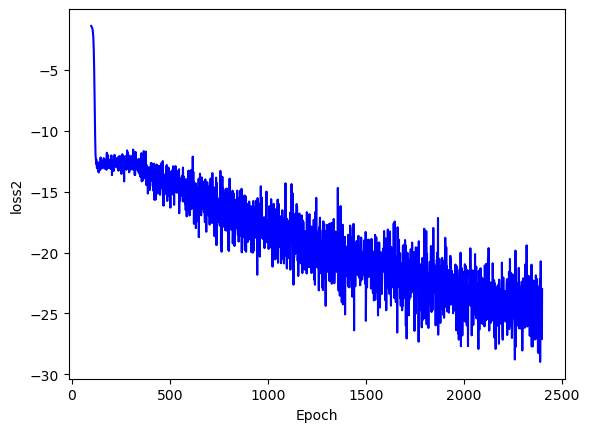

***** epoch 96 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total num

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 6 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 7 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90092.99264613212
r_em 53573.30202430887
53573.30202430887
ReWard2/R0 10.714660404861773
reward2 is: 18.714660404861775
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 8 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 9 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90996.14700847719
r_em 54354.964760158146
54354.964760158146
ReWard2/R0 10.87099295203163
reward2 is: 18.870992952031628
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.3148090635722891
***** epoch 96 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 89258.70910470253
r_em 54699.8075577867
54699.8075577867
ReWard2/R0 10.939961511557339
reward2 is: 18.93996151155734
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step
***** frame 11 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 12 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89234.32482877412
r_em 55750.06452516488
55750

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 13 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 14 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 86491.76591732215
r_em 54950.44447467314
54950.44447467314
ReWard2/R0 10.990088894934628
reward2 is: 18.99008889493463
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.31402282754260447
***** epoch 96 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81061.20403974695
r_em 54282.380604731494
54282.380604731494
ReWard2/R0 10.856476120946299
rewa

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 17 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 18 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 19 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 23 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81168.58805862525
r_em 55744.72721318415
55744.72721318415
ReWard2/R0 11.14894544263683
reward2 is: 19.14894544263683
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 24 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80285.00150986775
r_em 54866.434507084115
54866.434507084115
ReWard2/R0 10.973286901416824
reward2 is: 18.973286901416824
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.3124562414554782


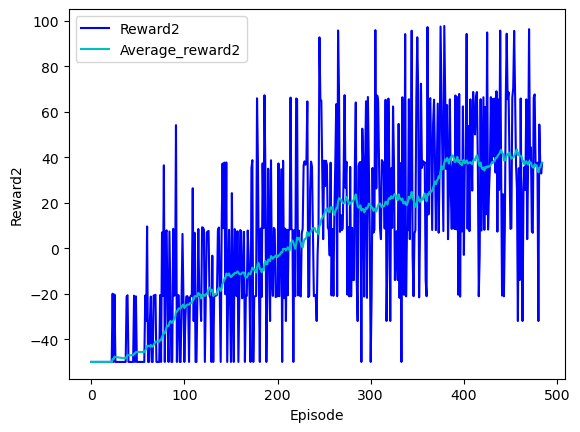

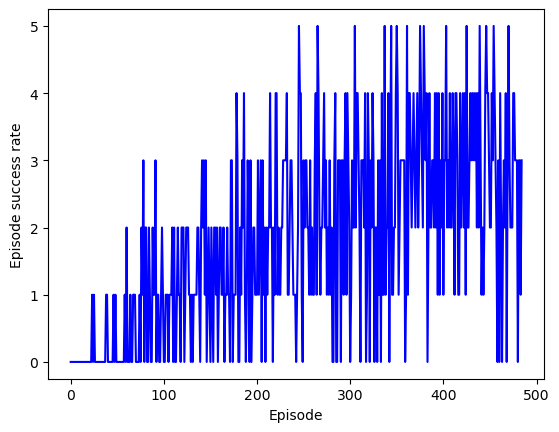

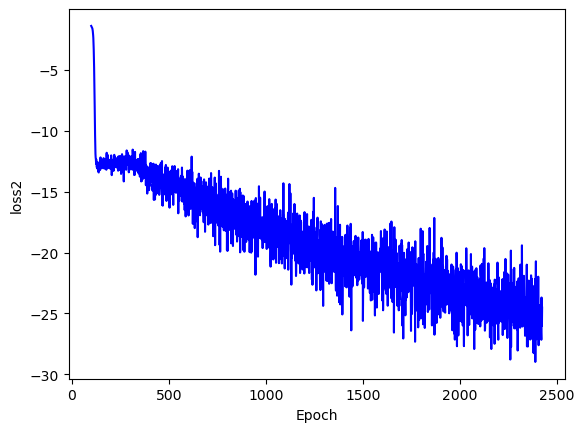

***** epoch 97 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86783.75548268789
r_em 55969.681599380565
55969.681599380565
ReWard2/R0 11.193936319876112
reward2 is: 19.193936319876112
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 1 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85649.53378981659
r_em 55565.074388080764
55565.074388080764
ReWard2/R0 11.113014877616152
reward2 is: 19.113014877616152
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 3 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86332.40997700221
r_em 54474.33158584338
54474.33158584338
ReWard2/R0 10.894866317168676
reward2 is: 18.894866317168677
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 4 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.3116758816019705
***** epoch 97 episode 1 *****
***** frame 5 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 6 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80835.06019353867
r_em 52833.33013154245
52833.33013154245
ReWard2/R0 10.56666602630849
reward2 is: 18.56666602630849
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [=======================

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 7 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 8 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86393.59645755879
r_em 52206.491146741355
52206.491146741355
ReWard2/R0 10.441298229348272
reward2 is: 18.44129822934827
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 9 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.31089747069817225
***** epoch 97 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84620.59459589935
r_em 54774.7026716654
54774.7026716654
ReWard2/R0 10.95494053433308
reward2 is: 18.95494053433308
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 11 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82870.42687898621
r_em 55389.70223353515
55389.70223353515
ReWard2/R0 11.07794044670703
reward2 is: 19.077940446707032
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 12 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 13 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86342.67168961398
r_em 56947.01201602814
56947.01201602814
ReWard2/R0 11.389402403205628
reward2 is: 19.38940240320563
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 14 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87958.65270135374
r_em 57053.838889211176
57053.838889211176
ReWard2/R0 11.410767777842235
reward2 is: 19.410767777842235
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.3101210038765789
***** epoch 97 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 76683.48508118012
r_em 51967.15926183262
51967.15926183262
ReWard2/R0 10.393431852366524
reward2 is: 18.393431852366525
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 16 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 76884.66195688285
r_em 49436.59901108245
49436.59901108245
ReWard2/R0 9.88731980221649
reward2 is: 17.88731980221649
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step
***** frame 17 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77241.45146348645
r_em 51185.38065298783
51185.38065298783
ReWard2/R0 10.237076130597565
reward2 is: 18.237076130597565
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 18 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 19 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.3093464762818429
***** epoch 97 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84984.37382287969
r_em 53900.592584242535
53900.592584242535
ReWard2/R0 10.780118516848507
reward2 is: 18.780118516848507
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [===============

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 23 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83617.55564618138
r_em 54725.964501887094
54725.964501887094
ReWard2/R0 10.94519290037742
reward2 is: 18.94519290037742
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ET

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.3085738830707427


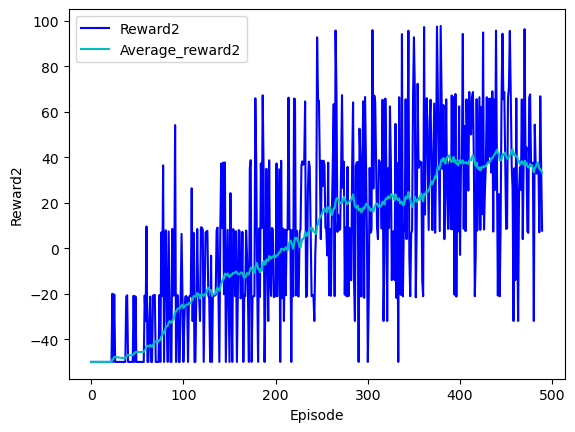

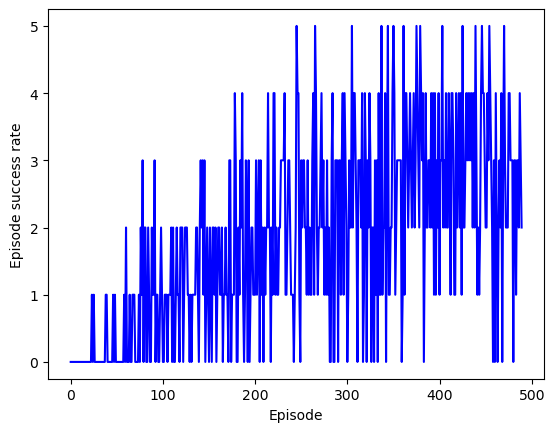

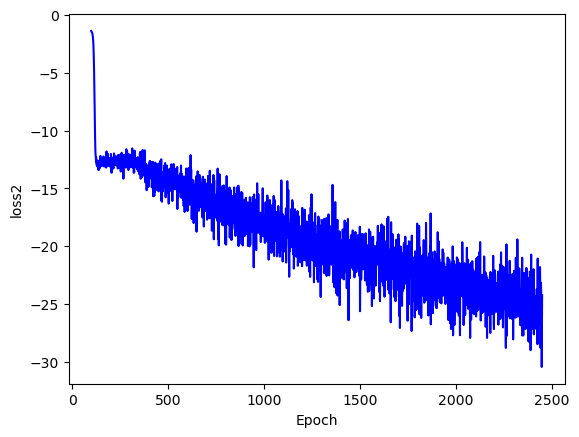

***** epoch 98 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 2 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89415.66806036873
r_em 57614.44488089747
57614.44488089747
ReWard2/R0 11.522888976179495
reward2 is: 19.522888976179495
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 3 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87693.78477616621
r_em 58018.145467165166
58018.145467165166
ReWard2/R0 11.603629093433034
reward2 is: 19.603629093433035
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 4 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86541.09441252312
r_em 58238.67274977124
58238.67274977124
ReWard2/R0 11.647734549954249
reward2 is: 19.64773454995425
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.30780321941215266
***** epoch 98 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 86688.53615519832
r_em 48531.194546684375
48531.194546684375
ReWard2/R0 9.706238909336875
reward2 is: 17.706238909336875
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step
***** frame 6 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 85264.88628227246
r_em 49908.60200237434
49908.60200237434
ReWard2/R0 9.981720400474869
reward2 is: 17.98172040047487
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step
***** frame 7 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not m

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 11 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 12 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 13 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 14 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Outp

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.30626766148829976
***** epoch 98 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83032.11654646069
r_em 56896.894774471955
56896.894774471955
ReWard2/R0 11.37937895489439
reward2 is: 19.379378954894392
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 16 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82777.40802087911
r_em 56605.21873939114
56605.21873939114
ReWard2/R0 11.321043747878228
reward2 is: 19.321043747878228
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 17 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81806.71288952738
r_em 56052.19323743132
56052.19323743132
ReWard2/R0 11.210438647486264
reward2 is: 19.210438647486264
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 18 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84471.4993739026
r_em 55540.89171803595
55540.89171803595
ReWard2/R0 11.10817834360719
reward2 is: 19.10817834360719
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 19 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86334.8483109974
r_em 55276.454943705685
55276.454943705685
ReWard2/R0 11.055290988741136
reward2 is: 19.055290988741135
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.305502757620994
***** epoch 98 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 5.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 5.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 23 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 5.0
total numbe

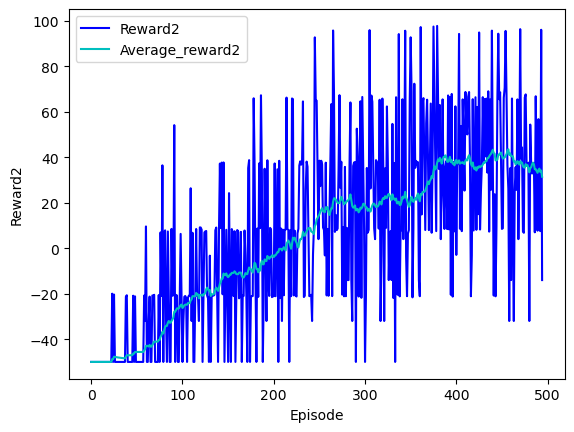

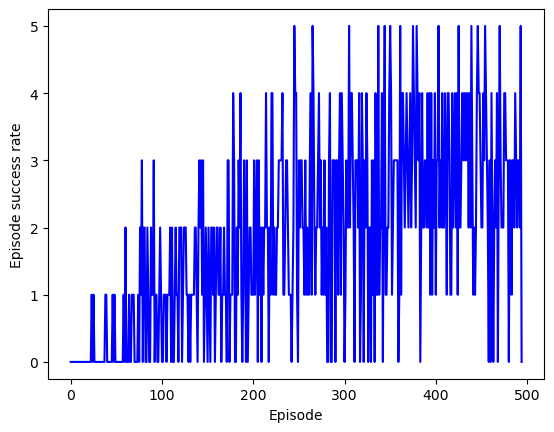

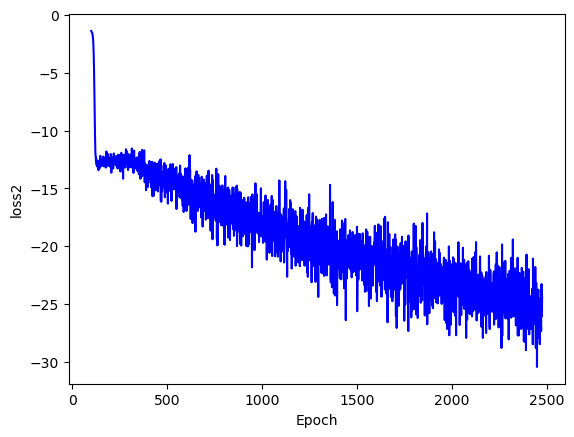

***** epoch 99 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95267.23079434581
r_em 57732.50402867895
57732.50402867895
ReWard2/R0 11.546500805735791
reward2 is: 19.54650080573579
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 1 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96522.12667811032
r_em 57602.2582627797
57602.2582627797
ReWard2/R0 11.52045165255594
reward2 is: 19.52045165255594
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 2 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 97441.5207395358
r_em 56842.493600785136
56842.493600785136
ReWard2/R0 11.368498720157028
reward2 is: 19.368498720157028
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step
***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 4 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 95698.53010090787
r_em 56598.218988186745
56598.218988186745
ReWard2/R0 11.31964379763735
reward2 is: 19.319643797637347
total number of ur2 RBs: 8.0
total number of em2 RBs: 

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 6 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 76990.50916040002
r_em 57603.87657830174
57603.87657830174
ReWard2/R0 11.520775315660348
reward2 is: 19.520775315660348
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 7 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79401.7585853498
r_em 57736.645013644484
57736.645013644484
ReWard2/R0 11.547329002728898
reward2 is: 19.547329002728898
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 8 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 9 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77625.15868827788
r_em 57268.28970748102
57268.28970748102
ReWard2/R0 11.453657941496203
reward2 is: 19.453657941496203
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.3032194890367895
***** epoch 99 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83819.41888111929
r_em 54553.68903454942
54553.68903454942
ReWard2/R0 10.910737806909884
reward2 is: 18.910737806909886
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 11 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78520.15571516879
r_em 53466.21446235388
53466.21446235388
ReWard2/R0 10.693242892470776
reward2 is: 18.693242892470778
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 12 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83607.01119044935
r_em 53378.21222288972
53378.21222288972
ReWard2/R0 10.675642444577944
reward2 is: 18.675642444577946
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 13 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78880.53034412536
r_em 54040.53324264406
54040.53324264406
ReWard2/R0 10.808106648528812
reward2 is: 18.808106648528813
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 14 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80030.35331733275
r_em 53990.214366759996
53990.214366759996
ReWard2/R0 10.798042873352
reward2 is: 18.798042873352
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.30246219798399054
***** epoch 99 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81879.66492019942
r_em 52628.75885142827
52628.75885142827
ReWard2/R0 10.525751770285654
reward2 is: 18.525751770285652
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 17 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82150.30208760721
r_em 52831.562907858584
52831.562907858584
ReWard2/R0 10.566312581571717
reward2 is: 18.566312581571715
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 18 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83002.56847992024
r_em 50744.4960492297
50744.4960492297
ReWard2/R0 10.14889920984594
reward2 is: 18.14889920984594
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 19 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Output is: optimal_inaccurate
r_ur 83919.83143315087
r_em 52669.77788537611
52669.77788537611
ReWard2/R0 10.533955577075222
reward2 is: 18.533955577075222
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.30170679826654245
***** epoch 99 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 97272.693337026
r_em 54695.38926207616
54695.38926207616
ReWard2/R0 10.939077852415233
reward2 is: 18.93907785241523
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 21 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 98347.81725983194
r_em 54083.594551750895
54083.594551750895
ReWard2/R0 10.816718910350179
reward2 is: 18.81671891035018
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 22 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 99856.52451148708
r_em 52615.004557652996
52615.004557652996
ReWard2/R0 10.523000911530598
reward2 is: 18.5230009115306
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 23 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 100039.75194884642
r_em 52361.917742013946
52361.917742013946
ReWard2/R0 10.472383548402789
reward2 is: 18.47238354840279
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 24 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 99302.77210632124
r_em 52615.263056259355
52615.263056259355
ReWard2/R0 10.52305261125187
reward2 is: 18.52305261125187
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.30095328516083264


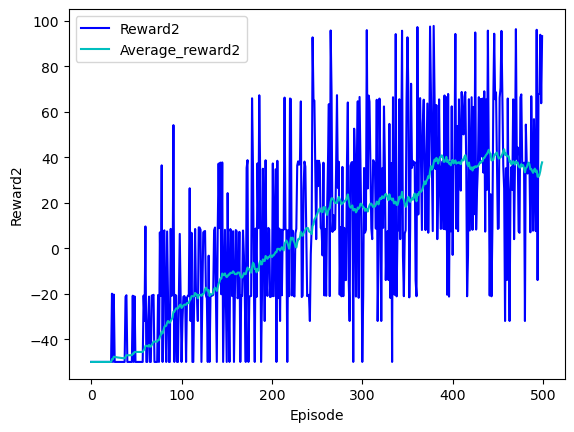

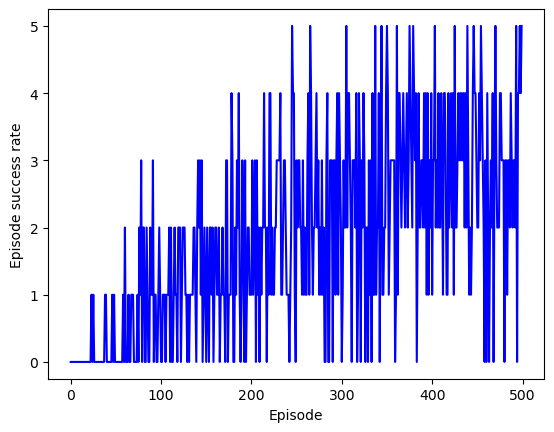

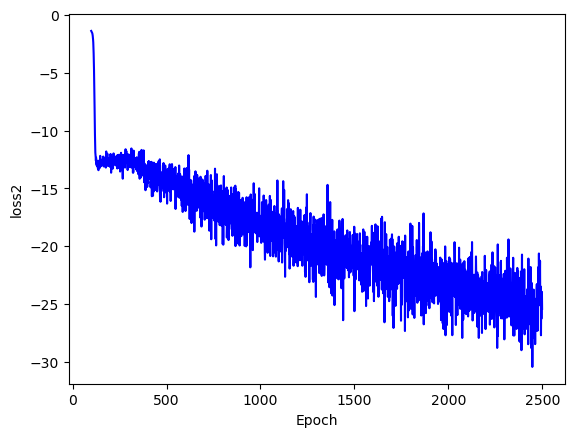

***** epoch 100 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 70316.76958367381
r_em 55132.209193049166
55132.209193049166
ReWard2/R0 11.026441838609832
reward2 is: 19.026441838609834
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 2 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 3 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 4 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.300201653955046
***** epoch 100 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 19ms/step
we cho

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 11 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85328.59112326147
r_em 53281.480847380255
53281.480847380255
ReWard2/R0 10.65629616947605
reward2 is: 18.65629616947605
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 12 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85521.59064419627
r_em 52344.1072240395
52344.1072240395
ReWard2/R0 10.468821444807901
reward2 is: 18.4688214448079
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 13 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 14 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.29870401845479094
***** epoch 100 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94975.48676734048
r_em 56461.629618373074
56461.629618373074
ReWard2/R0 11.292325923674614
reward2 is: 19.292325923674614
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [===============

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 17 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94037.15000272692
r_em 56000.22375884295
56000.22375884295
ReWard2/R0 11.20004475176859
reward2 is: 19.20004475176859
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 18 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94211.34262498374
r_em 56503.614475345435
56503.614475345435
ReWard2/R0 11.300722895069088
reward2 is: 19.300722895069086
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 19 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 94484.81524874295
r_em 56080.57143092094
56080.57143092094
ReWard2/R0 11.216114286184188
reward2 is: 19.216114286184187
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.29795800479541346
***** epoch 100 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 91809.10807282935
r_em 55729.5586809565
55729.5586809565
ReWard2/R0 11.1459117361913
reward2 is: 19.1459117361913
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step
***** frame 21 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Out

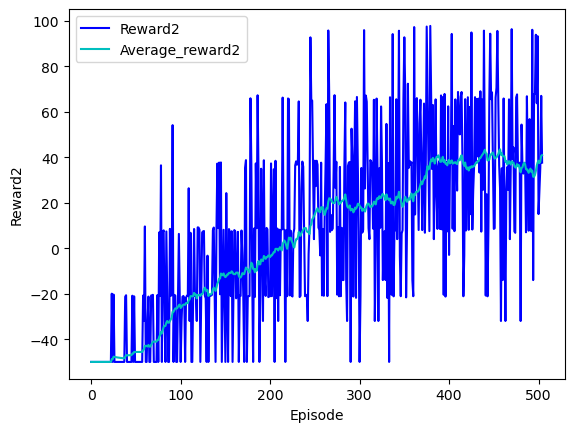

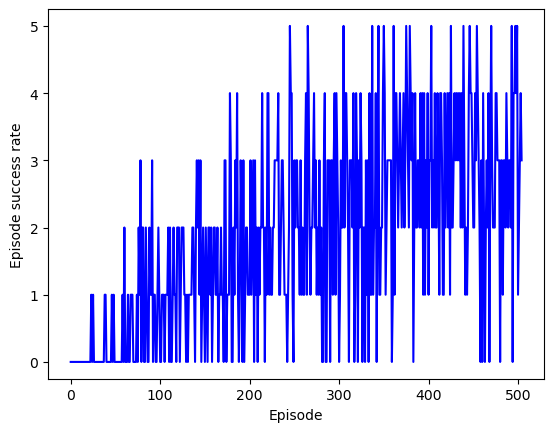

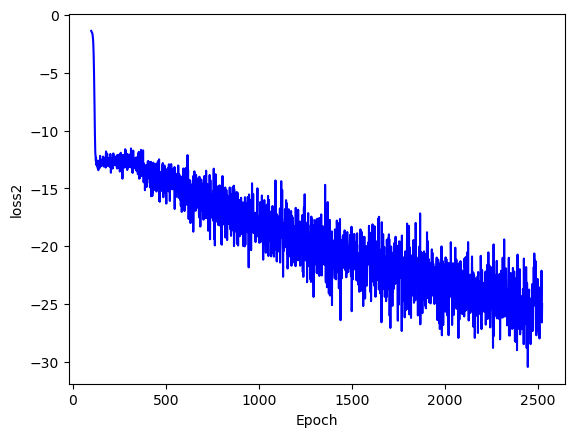

***** epoch 101 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 74097.47000028672
r_em 53955.823229425834
53955.823229425834
ReWard2/R0 10.791164645885166
reward2 is: 18.791164645885168
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 2 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 72005.23296863548
r_em 54770.81737802258
54770.81737802258
ReWard2/R0 10.954163475604515
reward2 is: 18.954163475604517
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 4 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77832.61107479242
r_em 54649.72836262048
54649.72836262048
ReWard2/R0 10.929945672524097
reward2 is: 18.9299456725241
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.2964715623335288
***** epoch 101 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88124.98827599177
r_em 55724.23147350344
55724.23147350344
ReWard2/R0 11.144846294700688
reward2 is: 19.144846294700688
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 6 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82080.3925136311
r_em 55354.330685469
55354.330685469
ReWard2/R0 11.0708661370938
reward2 is: 19.0708661370938
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 7 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77378.30379347148
r_em 55172.87427507267
55172.87427507267
ReWard2/R0 11.034574855014533
reward2 is: 19.034574855014533
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 8 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 9 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88760.33243553285
r_em 55685.05263707566
55685.05263707566
ReWard2/R0 11.137010527415132
reward2 is: 19.137010527415132
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.2957311242361041
***** epoch 101 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91376.52212540772
r_em 56756.48206935256
56756.48206935256
ReWard2/R0 11.351296413870513
reward2 is: 19.351296413870514
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 11 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 12 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91309.27560014784
r_em 57000.57464422112
57000.57464422112
ReWard2/R0 11.400114928844223
reward2 is: 19.400114928844225
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 13 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92010.6812632318
r_em 55995.94947717182
55995.94947717182
ReWard2/R0 11.199189895434364
reward2 is: 19.199189895434365
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 14 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.29499253538375303
***** epoch 101 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93472.77664128094
r_em 57780.46556537025
57780.46556537025
ReWard2/R0 11.55609311307405
reward2 is: 19.55609311307405
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 17 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 18 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93715.389832705
r_em 56723.39090026766
56723.39090026766
ReWard2/R0 11.344678180053531
reward2 is: 19.34467818005353
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [===================

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 19 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93388.4792555965
r_em 56180.804623376374
56180.804623376374
ReWard2/R0 11.236160924675275
reward2 is: 19.236160924675275
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.2942557911579837
***** epoch 101 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87659.06792335532
r_em 54260.123507602206
54260.123507602206
ReWard2/R0 10.852024701520442
reward2 is: 18.852024701520442
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 21 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88889.51284658107
r_em 53727.12459181907
53727.12459181907
ReWard2/R0 10.745424918363813
reward2 is: 18.745424918363813
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 23 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90575.57910644112
r_em 53310.42616716719
53310.42616716719
ReWard2/R0 10.662085233433439
reward2 is: 18.662085233433437
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 24 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90190.63075979079
r_em 53505.87964087854
53505.87964087854
ReWard2/R0 10.701175928175708
reward2 is: 18.701175928175708
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.293520886951839


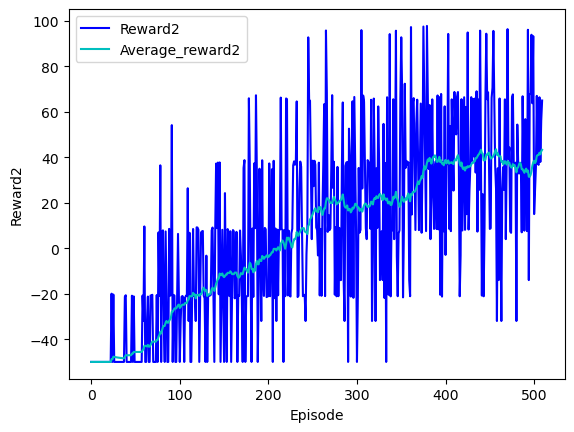

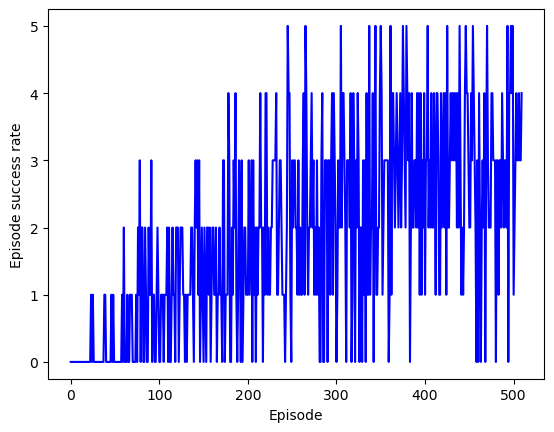

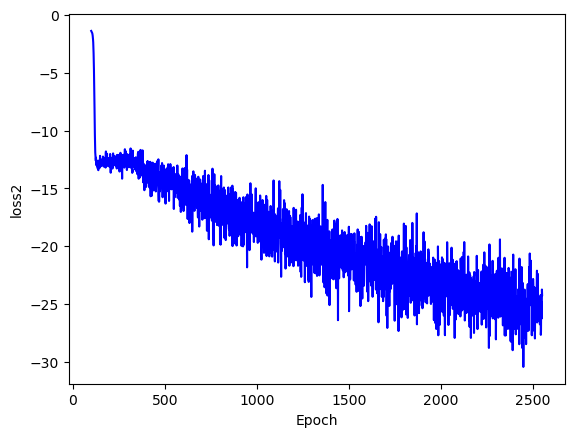

***** epoch 102 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85699.54599899931
r_em 53991.812846082845
53991.812846082845
ReWard2/R0 10.798362569216568
reward2 is: 18.798362569216568
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 2 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84678.66334310322
r_em 54349.96440085845
54349.96440085845
ReWard2/R0 10.86999288017169
reward2 is: 18.86999288017169
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 3 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85164.41900353738
r_em 53986.05897375528
53986.05897375528
ReWard2/R0 10.797211794751057
reward2 is: 18.797211794751057
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 4 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83060.14596698694
r_em 53092.022486394395
53092.022486394395
ReWard2/R0 10.61840449727888
reward2 is: 18.61840449727888
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.2927878181698675
***** epoch 102 episode 1 *****
***** frame 5 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 6 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 7 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88117.69551813966
r_em 55445.66519652789
55445.66519652789
ReWard2/R0 11.089133039305578
reward2 is: 19.08913303930558
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [======================

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 8 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88971.74252428116
r_em 55457.81525661993
55457.81525661993
ReWard2/R0 11.091563051323986
reward2 is: 19.091563051323988
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 9 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.292056580228095
***** epoch 102 episode 2 *****
***** frame 10 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 11 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 92703.5160851897
r_em 51739.35780167959
51739.35780167959
ReWard2/R0 10.347871560335918
reward2 is: 18.347871560335918
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] 

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 14 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.29132716855399593
***** epoch 102 episode 3 *****
***** frame 15 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 16 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 76989.06307805888
r_em 53049.321354849664
53049.321354849664
ReWard2/R0 10.609864270969933
reward2 is: 18.609864270969933
total number of ur2 RBs: 8.0
total number of em2 R

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 17 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78063.1418342941
r_em 51409.143083470466
51409.143083470466
ReWard2/R0 10.281828616694094
reward2 is: 18.281828616694092
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 18 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 19 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 90696.16064711948
r_em 51014.38564031949
51014.38564031949
ReWard2/R0 10.202877128063898
reward2 is: 18.202877128063896
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.2905995785864645
***** epoch 102 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84772.41891345104
r_em

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 23 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82637.89568696472
r_em 55163.19544927082
55163.19544927082
ReWard2/R0 11.032639089854163
reward2 is: 19.032639089854165
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 24 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81310.57469728771
r_em 55092.515986558494
55092.515986558494
ReWard2/R0 11.018503197311698
reward2 is: 19.0185031973117
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.28987380577578625


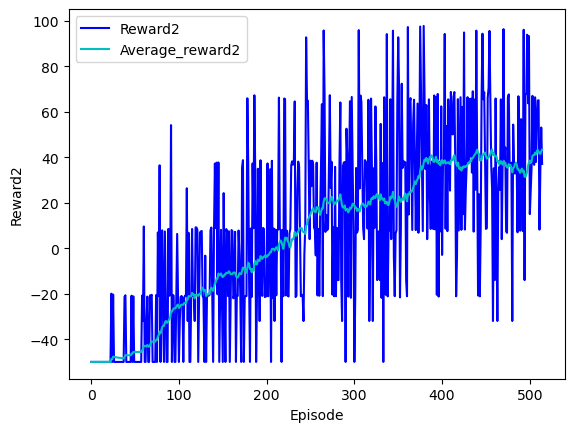

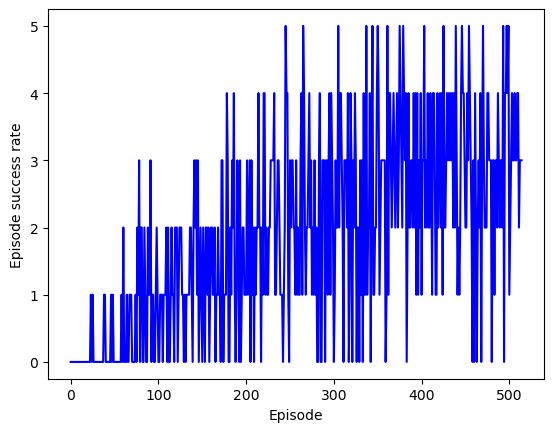

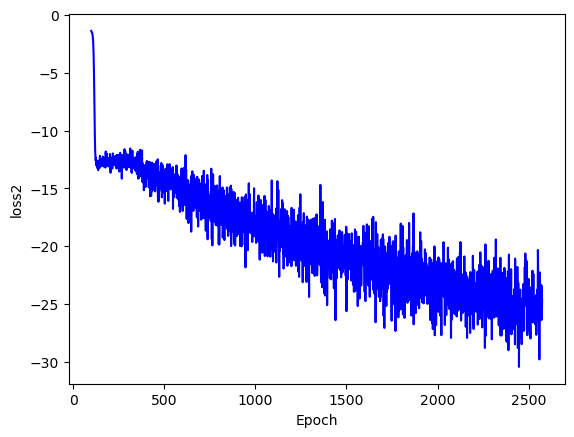

***** epoch 103 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83181.06204458834
r_em 53591.57073249793
53591.57073249793
ReWard2/R0 10.718314146499585
reward2 is: 18.718314146499587
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 1 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84129.35043866678
r_em 53702.64626122978
53702.64626122978
ReWard2/R0 10.740529252245956
reward2 is: 18.740529252245956
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 2 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82995.84085215151
r_em 52693.04448803172
52693.04448803172
ReWard2/R0 10.538608897606345
reward2 is: 18.538608897606345
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 4 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83878.42120738546
r_em 52894.536102363156
52894.536102363156
ReWard2/R0 10.578907220472631
reward2 is: 18.57890722047263
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.2891498455836096
***** epoch 103 episode 1 *****
***** frame 5 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 6 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 7 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82962.665819833
r_em 56996.45989040801
56996.45989040801
ReWard2/R0 11.399291978081603
reward2 is: 19.399291978081603
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>................

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 8 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85517.54879034228
r_em 56309.706329693414
56309.706329693414
ReWard2/R0 11.261941265938683
reward2 is: 19.26194126593868
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 9 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 5.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.28842769348291764
***** epoch 103 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 100609.14799472228
r_em 54358.27553615001
54358.27553615001
ReWard2/R0 10.871655107230001
reward2 is: 18.87165510723
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 11 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 102381.32902559226
r_em 55051.933922149496
55051.933922149496
ReWard2/R0 11.0103867844299
reward2 is: 19.010386784429897
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 12 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 98935.80937054285
r_em 54656.48464918121
54656.48464918121
ReWard2/R0 10.931296929836243
reward2 is: 18.931296929836243
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 13 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 14 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.2877073449579996
***** epoch 103 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 75054.95658202426
r_em 57422.45074772953
57422.45074772953
ReWard2/R0 11.484490149545906
reward2 is: 19.484490149545906
total number of ur2 RBs: 8.0
total number of em2 R

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 16 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 73275.87439666425
r_em 57299.09579071951
57299.09579071951
ReWard2/R0 11.459819158143903
reward2 is: 19.4598191581439
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 17 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 72533.03761501763
r_em 57826.501181110565
57826.501181110565
ReWard2/R0 11.565300236222113
reward2 is: 19.565300236222114
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 18 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 72236.54023803417
r_em 57275.437248922026
57275.437248922026
ReWard2/R0 11.455087449784406
reward2 is: 19.455087449784408
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 19 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.28698879550442286
***** epoch 103 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 22 *****
1/1 [==============

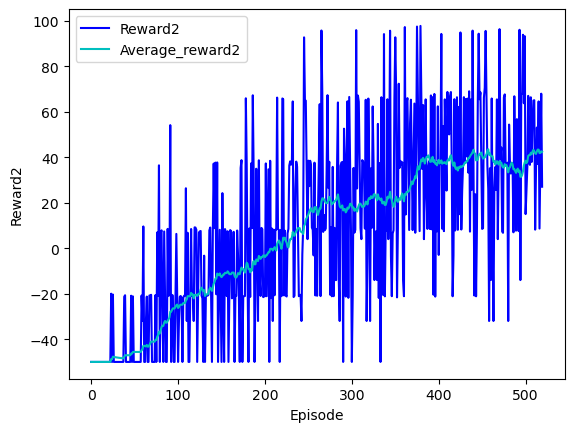

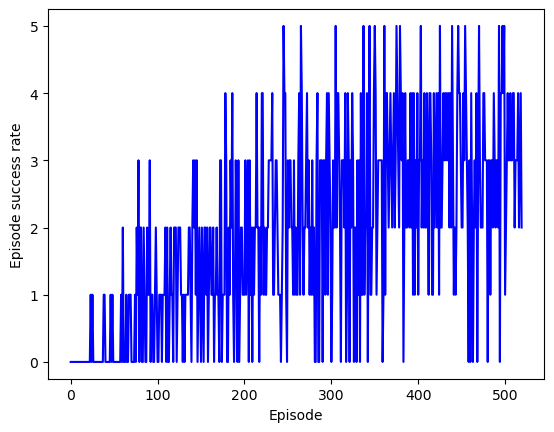

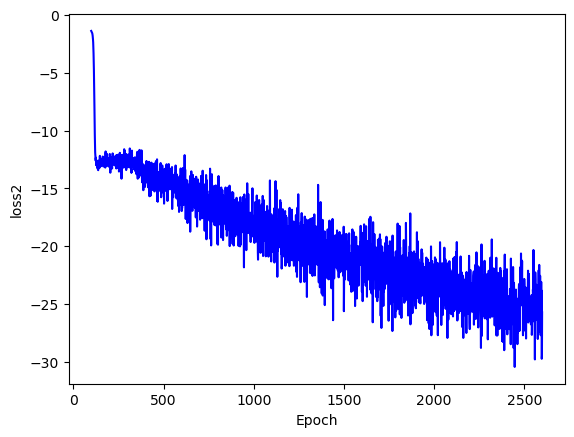

***** epoch 104 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 78091.51671612372
r_em 50316.57043473068
50316.57043473068
ReWard2/R0 10.063314086946136
reward2 is: 18.063314086946136
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step
***** frame 1 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 74448.47428218994
r_em 51914.29860904501
51914.29860904501
ReWard2/R0 10.382859721809002
reward2 is: 18.382859721809
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step
***** frame 2 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 74856.3920898925

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 7 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 8 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81834.53903815233
r_em 55896.68726397976
55896.68726397976
ReWard2/R0 11.179337452795952
reward2 is: 19.179337452795952
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 9 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81346.01162268434
r_em 56409.34981140131
56409.34981140131
ReWard2/R0 11.281869962280263
reward2 is: 19.28186996228026
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.284843896695991
***** epoch 104 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 75411.29287006482
r_em 53522.326781524636
53522.326781524636
ReWard2/R0 10.704465356304928
reward2 is: 18.70446535630493
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 11 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 74174.48520971759
r_em 52418.01911057942
52418.01911057942
ReWard2/R0 10.483603822115885
reward2 is: 18.483603822115885
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 12 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 74355.87651319717
r_em 54780.2624742214
54780.2624742214
ReWard2/R0 10.95605249484428
reward2 is: 18.95605249484428
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 13 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 76999.82065500232
r_em 55525.465928566366
55525.465928566366
ReWard2/R0 11.105093185713272
reward2 is: 19.105093185713272
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 14 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.284132498708027
***** epoch 104 episode 3 *****
***** frame 15 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 16 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91108.62985410483
r_em 54896.44542965447
54896.44542965447
ReWard2/R0 10.979289085930894
reward2 is: 18.979289085930894
total number of ur2 RBs: 8.0
total number of em2 RBs:

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 17 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 18 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91545.77122128193
r_em 54550.16998421804
54550.16998421804
ReWard2/R0 10.910033996843607
reward2 is: 18.91003399684361
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 19 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.28342287743742695
***** epoch 104 episode 4 *****
***** frame 20 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 21 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 88907.4348935653
r_em 56238.51579594468
56238.51579594468
ReWard2/R0 11.247703159188935
reward2 is: 19.247703159188937
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yess

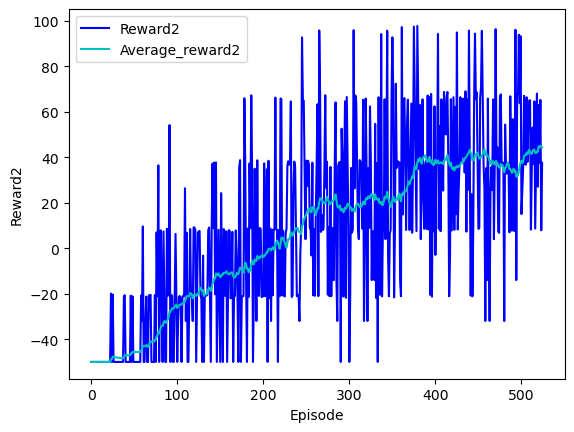

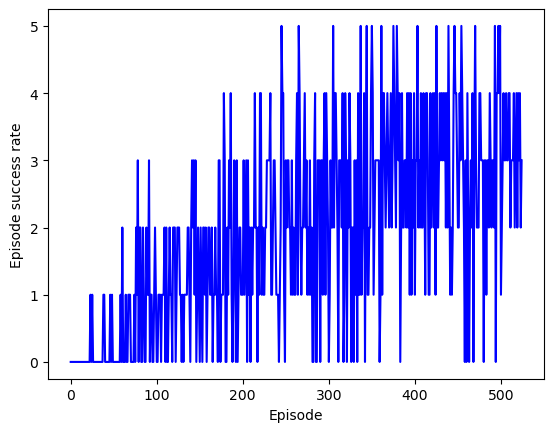

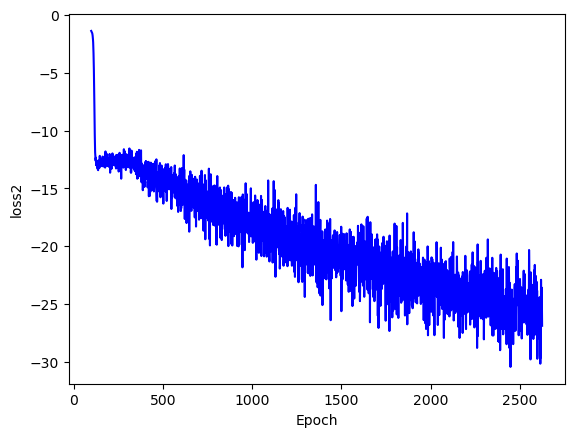

***** epoch 105 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 2 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91102.58071586021
r_em 54793.23966542008
54793.23966542008
ReWard2/R0 10.958647933084016
reward2 is: 18.958647933084016
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 4 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.2820089473099857
***** epoch 105 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94717.26253871384
r_em 57312.62775757206
57312.62775757206
ReWard2/R0 11.462525551514412
reward2 is: 19.46252555151441
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [====================

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 6 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93946.7860984554
r_em 57384.39932767747
57384.39932767747
ReWard2/R0 11.476879865535494
reward2 is: 19.476879865535494
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 7 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 8 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89202.775956228
r_em 57103.1593870594
57103.1593870594
ReWard2/R0 11.42063187741188
reward2 is: 19.42063187741188
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 9 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89223.61411822024
r_em 56090.38595683297
56090.38595683297
ReWard2/R0 11.218077191366595
reward2 is: 19.218077191366596
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.28130462961165603
***** epoch 105 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85484.22316464123
r_em 52296.21567801113
52296.21567801113
ReWard2/R0 10.459243135602227
reward2 is: 18.45924313560223
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 11 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86845.78687487662
r_em 51226.692800424746
51226.692800424746
ReWard2/R0 10.24533856008495
reward2 is: 18.24533856008495
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 12 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 13 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86052.4943937671
r_em 51485.58831695865
51485.58831695865
ReWard2/R0 10.297117663391731
reward2 is: 18.29711766339173
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 14 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86583.64615145432
r_em 51620.259630924425
51620.259630924425
ReWard2/R0 10.324051926184884
reward2 is: 18.324051926184886
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.2806020709476581
***** epoch 105 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80368.51784968626
r_em 56690.127706375664
56690.127706375664
ReWard2/R0 11.338025541275133
reward2 is: 19.338025541275133
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 16 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80746.59841078981
r_em 56189.85897491686
56189.85897491686
ReWard2/R0 11.237971794983372
reward2 is: 19.237971794983373
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 17 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80536.37857950521
r_em 56032.04565504152
56032.04565504152
ReWard2/R0 11.206409131008304
reward2 is: 19.206409131008304
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 18 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80134.9892828714
r_em 56382.74794883849
56382.74794883849
ReWard2/R0 11.276549589767699
reward2 is: 19.276549589767697
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 19 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.2799012669248015
***** epoch 105 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 85326.9868678309
r_em 55826.995439594924
55826.995439594924
ReWard2/R0 11.165399087918985
reward2 is: 19.165399087918985
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step
***** frame 21 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 85246.3343562133
r_em 55959.84711333032
55959.84711333032
ReWard2/R0 11.191969422666064
reward2 is: 19

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 23 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 81543.09176484382
r_em 56155.30197742993
56155.30197742993
ReWard2/R0 11.231060395485986
reward2 is: 19.231060395485986
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step
***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.2792022131608678


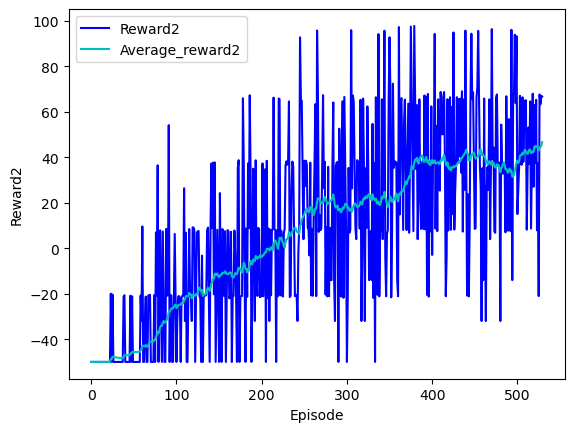

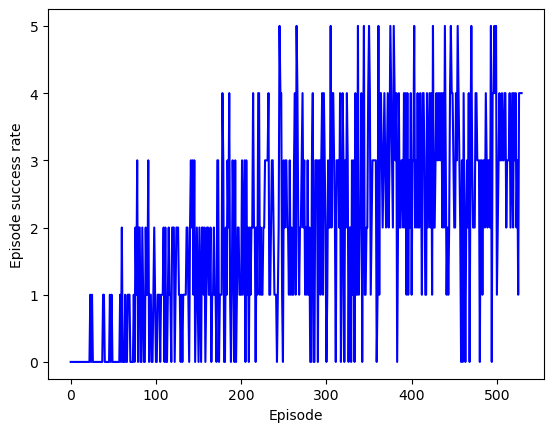

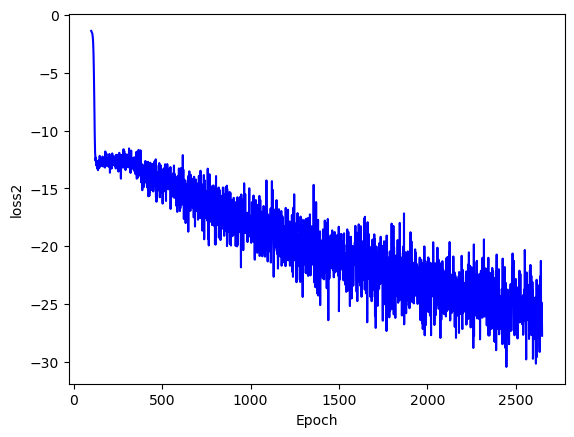

***** epoch 106 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 2 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84804.38468405485
r_em 55237.84934969559
55237.84934969559
ReWard2/R0 11.04756986993912
reward2 is: 19.047569869939117
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 3 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 4 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.2785049052845831
***** epoch 106 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86411.52592490162
r_em 54026.94540471157
54026.94540471157
ReWard2/R0 10.805389080942314
reward2 is: 18.805389080942312
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 6 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86581.88524032428
r_em 53485.54669141464
53485.54669141464
ReWard2/R0 10.697109338282928
reward2 is: 18.697109338282928
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 7 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85838.206464579
r_em 53679.05556075992
53679.05556075992
ReWard2/R0 10.735811112151985
reward2 is: 18.735811112151985
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 8 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88196.8348705385
r_em 54182.89608084029
54182.89608084029
ReWard2/R0 10.836579216168058
reward2 is: 18.836579216168058
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 9 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87721.22813261689
r_em 53167.79128772144
53167.79128772144
ReWard2/R0 10.633558257544289
reward2 is: 18.633558257544287
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.2778093389355908
***** epoch 106 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 69849.26003610634
r_em 56965.42135426356
56965.42135426356
ReWard2/R0 11.393084270852713
reward2 is: 19.39308427085271
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 11 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 71129.6215043425
r_em 56031.94545828857
56031.94545828857
ReWard2/R0 11.206389091657714
reward2 is: 19.206389091657712
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 12 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 13 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 14 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77359.83260417543
r_em 54930.1045873472
54930.1045873472
ReWard2/R0 10.98602091746944
reward2 is: 18.98602091746944
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.2771155097644244
***** epoch 106 episode 3 *****
***** frame 15 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 16 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94721.78633185888
r_em 56405.47592235173
56405.47592235173
ReWard2/R0 11.281095184470347
reward2 is: 19.281095184470345
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 17 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94563.68266937957
r_em 56767.75336680263
56767.75336680263
ReWard2/R0 11.353550673360527
reward2 is: 19.353550673360527
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 18 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93800.80693392348
r_em 56307.99382474422
56307.99382474422
ReWard2/R0 11.261598764948843
reward2 is: 19.261598764948843
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 19 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.27642341343248
***** epoch 106 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78797.87309181939
r_em 51264.357707968724
51264.357707968724
ReWard2/R0 10.252871541593745
reward2 is: 18.252871541593745
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 22 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81595.68555333871
r_em 52958.24370359493
52958.24370359493
ReWard2/R0 10.591648740718986
reward2 is: 18.591648740718988
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 23 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81131.24093688186
r_em 53759.10604925166
53759.10604925166
ReWard2/R0 10.751821209850332
reward2 is: 18.751821209850334
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.2757330456119896


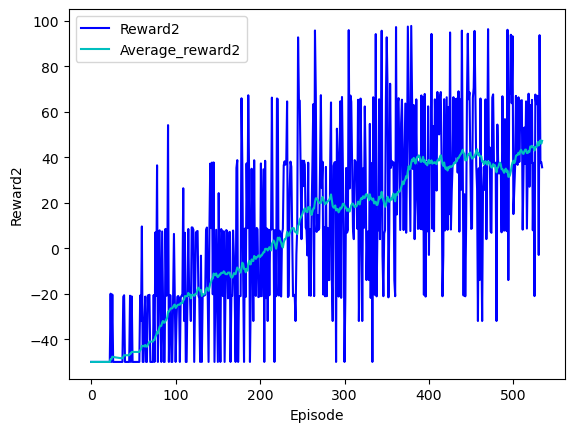

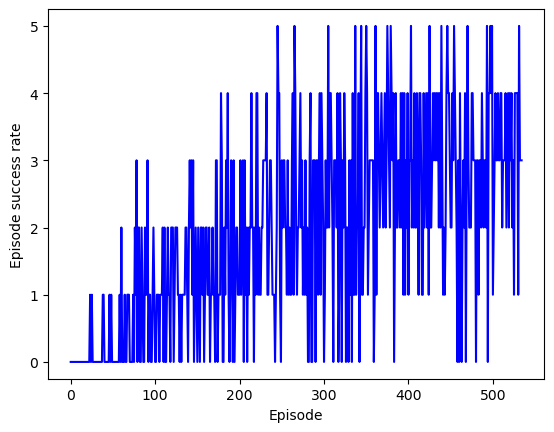

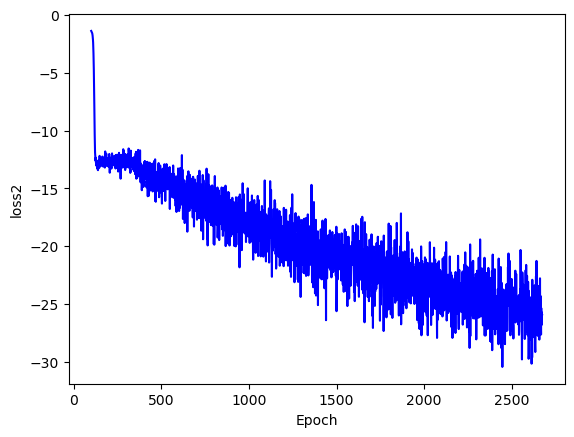

***** epoch 107 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84040.18153623273
r_em 56505.78777312265
56505.78777312265
ReWard2/R0 11.30115755462453
reward2 is: 19.30115755462453
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 1 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 92059.14664077242
r_em 55701.66569738512
55701.66569738512
ReWard2/R0 11.140333139477024
reward2 is: 19.140333139477022
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step
***** frame 2 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90597.13643370564
r_em 55836.69907852885
55836.69907852885
ReWard2/R0 11.16733981570577
reward2 is: 19.16733981570577
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 4 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81693.52981785563
r_em 55407.384996383036
55407.384996383036
ReWard2/R0 11.081476999276607
reward2 is: 19.081476999276607
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.2750444019859935
***** epoch 107 episode 1 *****
***** frame 5 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 6 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 7 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 93506.82792180676
r_em 55508.87516996564
55508.87516996564
ReWard2/R0 11.101775033993128
reward2 is: 19.10177503399313
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] -

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 9 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94141.89727701677
r_em 55356.26696244618
55356.26696244618
ReWard2/R0 11.071253392489236
reward2 is: 19.071253392489236
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.27435747824831397
***** epoch 107 episode 2 *****
***** frame 10 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 11 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79054.52635914183
r_em 56446.89197573371
56446.89197573371
ReWard2/R0 11.289378395146743
reward2 is: 19.28937839514674
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 12 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77811.60034751013
r_em 56282.49876673612
56282.49876673612
ReWard2/R0 11.256499753347224
reward2 is: 19.256499753347224
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 13 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77946.57214295721
r_em 56329.1976226881
56329.1976226881
ReWard2/R0 11.26583952453762
reward2 is: 19.26583952453762
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 14 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.2736722701035277
***** epoch 107 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84433.8486310715
r_em 54875.28031109633
54875.28031109633
ReWard2/R0 10.975056062219267
reward2 is: 18.975056062219267
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 16 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84296.69071093206
r_em 54654.30766652236
54654.30766652236
ReWard2/R0 10.930861533304473
reward2 is: 18.930861533304473
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 17 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 18 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84036.97794521626
r_em 55437.63630149719
55437.63630149719
ReWard2/R0 11.087527260299437
reward2 is: 19.08752726029944
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 19 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84363.02505495201
r_em 55371.43271924281
55371.43271924281
ReWard2/R0 11.074286543848562
reward2 is: 19.07428654384856
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.2729887732669394
***** epoch 107 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83247.28720631989
r_em 52248.71052198591
52248.71052198591
ReWard2/R0 10.449742104397181
reward2 is: 18.44974210439718
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 22 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86159.39257047506
r_em 52369.63770205644
52369.63770205644
ReWard2/R0 10.473927540411287
reward2 is: 18.47392754041129
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 23 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 24 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87965.85502744875
r_em 52223.06893257339
52223.06893257339
ReWard2/R0 10.444613786514678
reward2 is: 18.44461378651468
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.2723069834645546


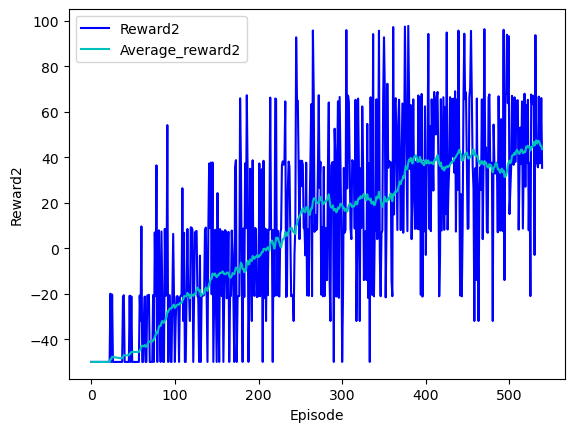

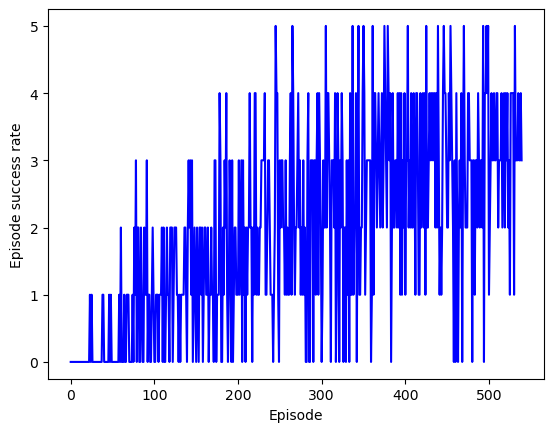

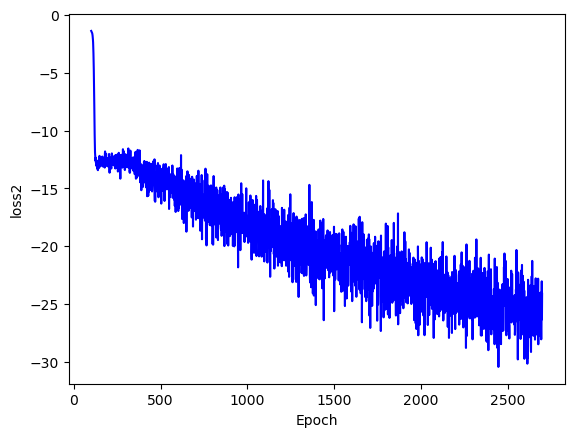

***** epoch 108 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94968.85715777661
r_em 53081.361676370645
53081.361676370645
ReWard2/R0 10.616272335274129
reward2 is: 18.61627233527413
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 2 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96607.87595839567
r_em 51813.201797401474
51813.201797401474
ReWard2/R0 10.362640359480295
reward2 is: 18.362640359480295
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 4 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94932.5452658464
r_em 51266.154770181485
51266.154770181485
ReWard2/R0 10.253230954036297
reward2 is: 18.253230954036297
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.2716268964330533
***** epoch 108 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85611.5310066178
r_em 57470.911011271804
57470.911011271804
ReWard2/R0 11.494182202254361
reward2 is: 19.49418220225436
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 6 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 7 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 8 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 9 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output 

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.2709485079197631
***** epoch 108 episode 2 *****
***** frame 10 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 11 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 12 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90161.77375627999
r_em 58101.141179442304
58101.141179442304
ReWard2/R0 11.620228235888462
reward2 is: 19.62022823588846
total number of ur2 RBs: 8.0
total number of em2 RBs

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 13 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89536.40159996058
r_em 58030.02882441068
58030.02882441068
ReWard2/R0 11.606005764882136
reward2 is: 19.606005764882134
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 14 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91345.0641685451
r_em 57302.33702045442
57302.33702045442
ReWard2/R0 11.460467404090883
reward2 is: 19.460467404090885
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.2702718136826326
***** epoch 108 episode 3 *****
***** frame 15 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 16 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91064.0113176207
r_em 57512.98247105905
57512.98247105905
ReWard2/R0 11.50259649421181
reward2 is: 19.502596494211808
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 17 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90105.23359420631
r_em 57768.46596168731
57768.46596168731
ReWard2/R0 11.553693192337462
reward2 is: 19.553693192337462
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 18 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89251.1412684947
r_em 57556.67089868407
57556.67089868407
ReWard2/R0 11.511334179736814
reward2 is: 19.511334179736814
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 19 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87025.01005952116
r_em 57781.5925301647
57781.5925301647
ReWard2/R0 11.55631850603294
reward2 is: 19.556318506032937
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.269596809490205
***** epoch 108 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88373.79913488854
r_em 54224.68005856623
54224.68005856623
ReWard2/R0 10.844936011713246
reward2 is: 18.844936011713244
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 21 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 88176.79161641849
r_em 53936.83163430198
53936.83163430198
ReWard2/R0 10.787366326860397
reward2 is: 18.787366326860397
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step
***** frame 22 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86909.83597751298
r_em 54242.06532836621
54242.06532836621
ReWard2/R0 10.848413065673242
reward2 is: 18.848413065673242
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 23 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88134.91436260934
r_em 53606.024547650064
53606.024547650064
ReWard2/R0 10.721204909530012
reward2 is: 18.721204909530012
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.2689234911215915


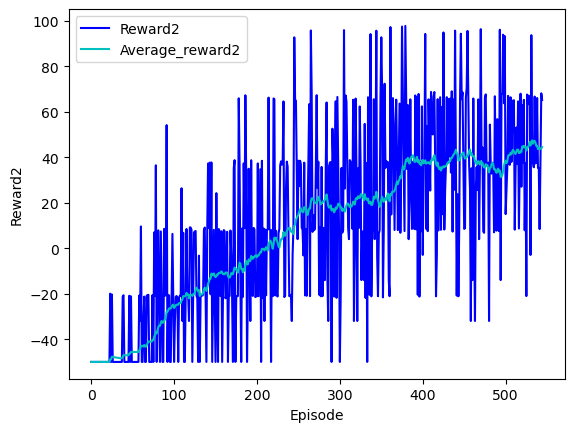

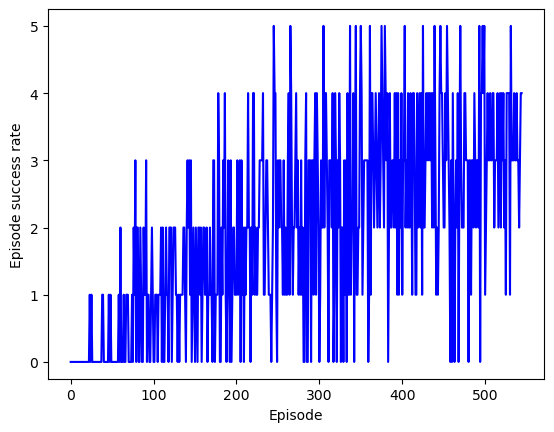

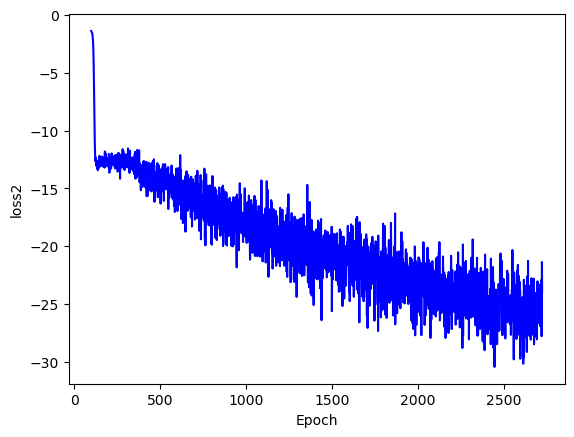

***** epoch 109 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 1 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 13 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89979.30609753467
r_em 56322.87880043119
56322.87880043119
ReWard2/R0 11.264575760086236
reward2 is: 19.264575760086238
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 14 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92715.77321216336
r_em 57201.7815580632
57201.7815580632
ReWard2/R0 11.440356311612641
reward2 is: 19.44035631161264
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.26691360890771537
***** epoch 109 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89058.72369965153
r_em 55081.33755979102
55081.33755979102
ReWard2/R0 11.016267511958205
reward2 is: 19.016267511958205
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 2ms/step
***** frame 16 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 17 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 18 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88897.08220623268
r_em 54684.41822081462
54684.41822081462
ReWard2/R0 10.936883644162924
reward2 is: 18.936883644162926
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 19 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.26624699183590983
***** epoch 109 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83102.62728464347
r_em 55700.20002463719
55700.20002463719
ReWard2/R0 11.140040004927439
reward2 is: 19.14004000492744
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 21 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82196.129084107
r_em 55277.22015894542
55277.22015894542
ReWard2/R0 11.055444031789085
reward2 is: 19.055444031789087
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 23 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84782.62136058313
r_em 54888.54576985977
54888.54576985977
ReWard2/R0 10.977709153971954
reward2 is: 18.977709153971954
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 24 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84763.51496158798
r_em 55052.15869554695
55052.15869554695
ReWard2/R0 11.01043173910939
reward2 is: 19.01043173910939
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.26558203964107413


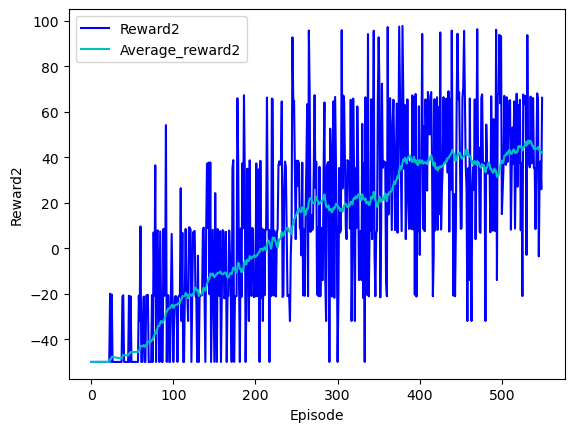

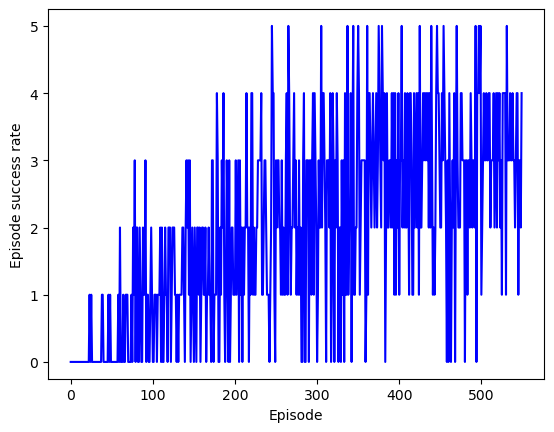

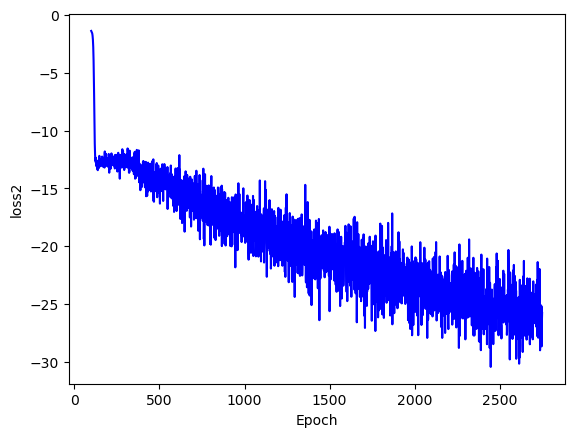

***** epoch 110 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91089.54611005727
r_em 54036.76043551034
54036.76043551034
ReWard2/R0 10.807352087102068
reward2 is: 18.807352087102068
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 4 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91481.84322404963
r_em 51254.94029485721
51254.94029485721

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.2649187481651761
***** epoch 110 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86794.06100773107
r_em 56139.34849818819
56139.34849818819
ReWard2/R0 11.227869699637639
reward2 is: 19.227869699637637
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 6 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86178.0364088607
r_em 55570.06426586736
55570.06426586736
ReWard2/R0 11.114012853173472
reward2 is: 19.11401285317347
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 7 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85985.02812251446
r_em 55984.63139311722
55984.63139311722
ReWard2/R0 11.196926278623444
reward2 is: 19.196926278623444
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 8 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 9 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85364.27289873033
r_em 55549.28541927885
55549.28541927885
ReWard2/R0 11.10985708385577
reward2 is: 19.109857083855772
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.26425711326056794
***** epoch 110 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80303.79185334599
r_em 57848.455842590396
57848.455842590396
ReWard2/R0 11.569691168518078
reward2 is: 19.569691168518077
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 11 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79557.19199232596
r_em 57528.19033690737
57528.19033690737
ReWard2/R0 11.505638067381474
reward2 is: 19.505638067381476
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 12 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 13 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 14 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78800.32133062584
r_em 57734.75483842948
57734.75483842948
ReWard2/R0 11.546950967685897
reward2 is: 19.546950967685895
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.2635971307899609
***** epoch 110 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 75774.31372978073
r_em 54642.05967995338
54642.05967995338
ReWard2/R0 10.928411935990676
reward2 is: 18.928411935990674
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 16 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77266.18384481412
r_em 55056.98831171929
55056.98831171929
ReWard2/R0 11.011397662343857
reward2 is: 19.011397662343857
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 17 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 18 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77659.30195840076
r_em 56211.43777546972
56211.43777546972
ReWard2/R0 11.242287555093943
reward2 is: 19.242287555093945
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 19 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78013.8806980894
r_em 55348.26912243125
55348.26912243125
ReWard2/R0 11.06965382448625
reward2 is: 19.069653824486252
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.26293879662639896
***** epoch 110 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80569.49133798102
r_em 54188.67558894156
54188.67558894156
ReWard2/R0 10.837735117788311
reward2 is: 18.837735117788313
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 23 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 76954.37812257069
r_em 53861.72182767575
53861.72182767575
ReWard2/R0 10.77234436553515
reward2 is: 18.772344365535147
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 24 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77277.49992696178
r_em 52755.606261350935
52755.606261350935
ReWard2/R0 10.551121252270187
reward2 is: 18.551121252270185
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.2622821066532332


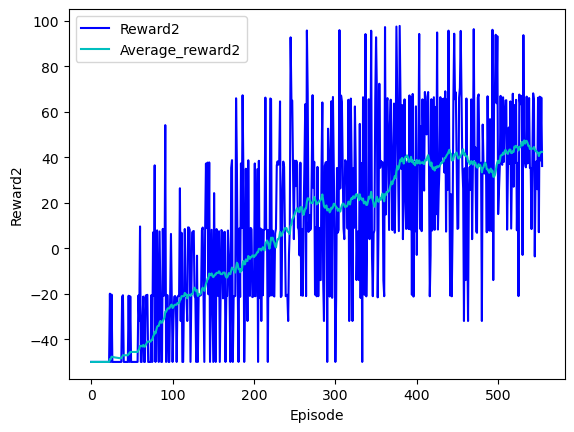

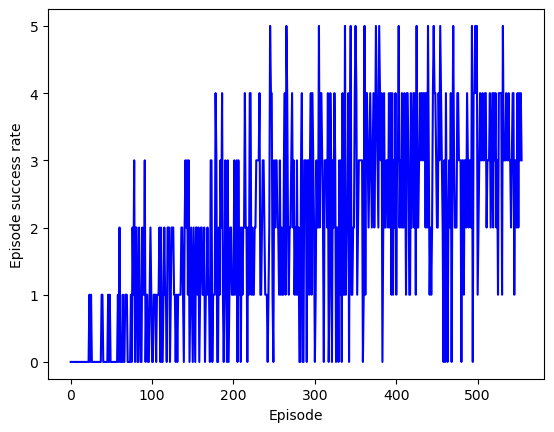

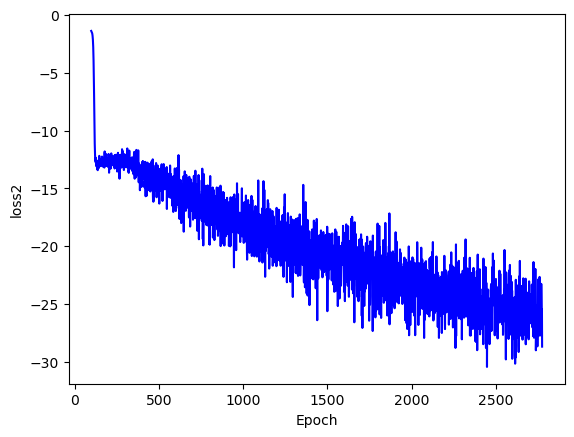

***** epoch 111 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 1 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84976.43589861125
r_em 56390.699456393224
56390.699456393224
ReWard2/R0 11.278139891278645
reward2 is: 19.278139891278645
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 3 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85165.23840787054
r_em 56144.638651511545
56144.638651511545
ReWard2/R0 11.228927730302308
reward2 is: 19.22892773030231
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 4 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88634.34613732951
r_em 56422.70407198342
56422.70407198342
ReWard2/R0 11.284540814396683
reward2 is: 19.284540814396685
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.26162705676409614
***** epoch 111 episode 1 *****
***** frame 5 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 6 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 7 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85668.3532241515
r_em 57144.7544140977
57144.7544140977
ReWard2/R0 11.428950882819539
reward2 is: 19.42895088281954
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.................

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 8 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85723.99269649535
r_em 56648.36991178054
56648.36991178054
ReWard2/R0 11.329673982356107
reward2 is: 19.329673982356105
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 9 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86689.19336438723
r_em 56702.67859475631
56702.67859475631
ReWard2/R0 11.340535718951262
reward2 is: 19.340535718951262
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.2609736428628759
***** epoch 111 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94518.4936589339
r_em 56931.846111269726
56931.846111269726
ReWard2/R0 11.386369222253945
reward2 is: 19.386369222253947
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 11 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94330.70869394345
r_em 55864.46202667673
55864.46202667673
ReWard2/R0 11.172892405335347
reward2 is: 19.172892405335347
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 12 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94209.71261588334
r_em 56194.174907921755
56194.174907921755
ReWard2/R0 11.23883498158435
reward2 is: 19.23883498158435
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 13 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 14 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94935.97142389613
r_em 56967.58909066427
56967.58909066427
ReWard2/R0 11.393517818132853
reward2 is: 19.393517818132853
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.2603218608636904
***** epoch 111 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91197.06764466655
r_em 55799.927681988345
55799.927681988345
ReWard2/R0 11.159985536397668
reward2 is: 19.15998553639767
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 16 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 92406.1973439582
r_em 56052.77615064491
56052.77615064491
ReWard2/R0 11.210555230128982
reward2 is: 19.210555230128982
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step
***** frame 17 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91213.42440276754
r_em 55992.26971616631
55992.26971616631
ReWard2/R0 11.198453943233261
reward2 is: 19.19845394323326
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 18 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91831.43879720502
r_em 55910.96803656461
55910.96803656461
ReWard2/R0 11.182193607312923
reward2 is: 19.182193607312925
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 19 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 5.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.2596717066908624
***** epoch 111 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83500.02435281716
r_em 57662.165214126726
57662.165214126726
ReWard2/R0 11.532433042825344
reward2 is: 19.532433042825346
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 21 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85224.6493022958
r_em 56847.02096006963
56847.02096006963
ReWard2/R0 11.369404192013926
reward2 is: 19.369404192013924
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 22 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85867.60392812925
r_em 56932.7683585225
56932.7683585225
ReWard2/R0 11.386553671704501
reward2 is: 19.3865536717045
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 23 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84244.78925530349
r_em 57043.27124153026
57043.27124153026
ReWard2/R0 11.408654248306052
reward2 is: 19.40865424830605
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 24 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85334.25743022715
r_em 57834.25082595311
57834.25082595311
ReWard2/R0 11.566850165190623
reward2 is: 19.566850165190623
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.25902317627889354


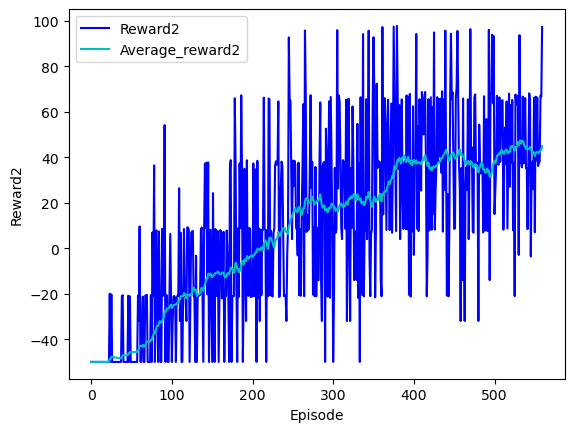

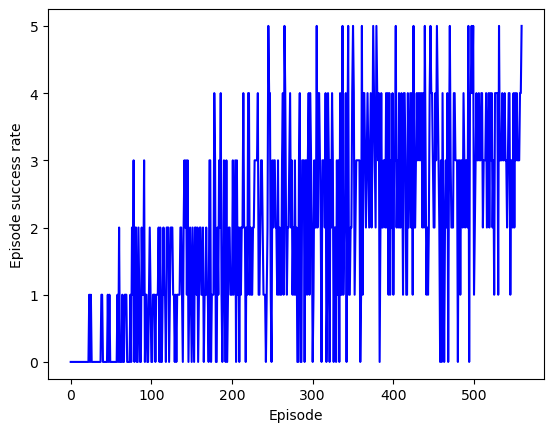

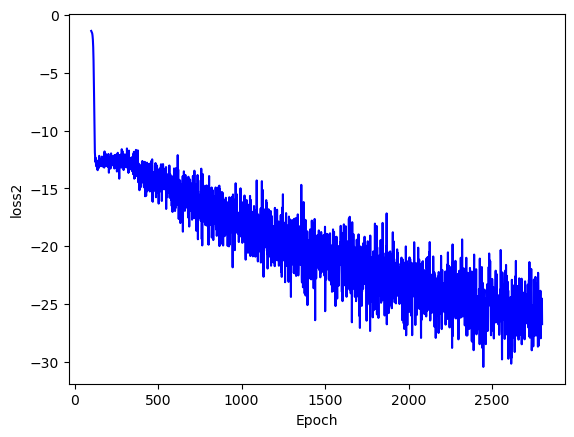

***** epoch 112 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 1 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88679.31984611342
r_em 54944.12757822474
54944.12757822474
ReWard2/R0 10.988825515644947
reward2 is: 18.988825515644947
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 2 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88041.95758606598
r_em 55098.89592162751
55098.89592162751
ReWard2/R0 11.019779184325502
reward2 is: 19.0197791843255
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 3 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86560.54796377593
r_em 55884.35156404797
55884.35156404797
ReWard2/R0 11.176870312809594
reward2 is: 19.176870312809594
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 4 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84539.57700271538
r_em 55645.861151331505
55645.861151331505
ReWard2/R0 11.1291722302663
reward2 is: 19.1291722302663
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.258376265572439
***** epoch 112 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 6 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92247.27521764867
r_em 53367.68665022268
53367.68665022268
ReWard2/R0 10.673537330044535
reward2 is: 18.673537330044535
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 7 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 8 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 9 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92465.77775415251
r_em 54083.00700225853
54083.00700225853
ReWard2/R0 10.816601400451706
reward2 is: 18.816601400451706
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.25773097052628235
***** epoch 112 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 11 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 5.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 12 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88541.41348443198
r_em 54656.02829155299
54656.02829155299
ReWard2/R0 10.931205658310597
reward2 is: 18.931205658310596
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] -

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 13 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89790.98883908938
r_em 55258.343824766205
55258.343824766205
ReWard2/R0 11.051668764953241
reward2 is: 19.05166876495324
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 14 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 91367.98414194651
r_em 55624.27715023472
55624.27715023472
ReWard2/R0 11.124855430046944
reward2 is: 19.124855430046942
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.2570872871053098
***** epoch 112 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90614.27522398741
r_em 54514.78024255621
54514.78024255621
ReWard2/R0 10.902956048511243
reward2 is: 18.902956048511243
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 16 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 90561.982230717
r_em 55417.881469561
55417.881469561
ReWard2/R0 11.0835762939122
reward2 is: 19.083576293912202
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step
***** frame 17 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90275.28439165668
r_em 56171.26206927134
56171.26206927134
ReWard2/R0 11.234252413854268
reward2 is: 19.234252413854268
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 18 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89386.96628959017
r_em 55994.13829902761
55994.13829902761
ReWard2/R0 11.198827659805522
reward2 is: 19.198827659805524
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 19 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89062.35918077645
r_em 55946.85247182154
55946.85247182154
ReWard2/R0 11.189370494364308
reward2 is: 19.189370494364308
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.2564452112844856
***** epoch 112 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81537.92386489175
r_em 54207.61334945736
54207.61334945736
ReWard2/R0 10.841522669891472
reward2 is: 18.84152266989147
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 21 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82326.55568592835
r_em 54603.96354088798
54603.96354088798
ReWard2/R0 10.920792708177595
reward2 is: 18.920792708177594
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 23 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82306.10986244009
r_em 54923.92131977488
54923.92131977488
ReWard2/R0 10.984784263954976
reward2 is: 18.984784263954978
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 24 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81970.36433074903
r_em 54700.91808881603
54700.91808881603
ReWard2/R0 10.940183617763207
reward2 is: 18.940183617763207
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.25580473904882634


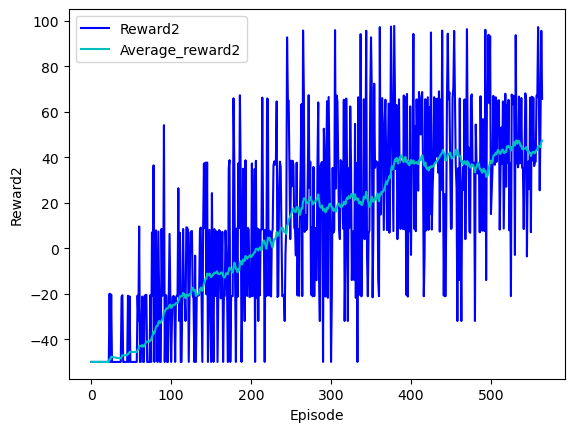

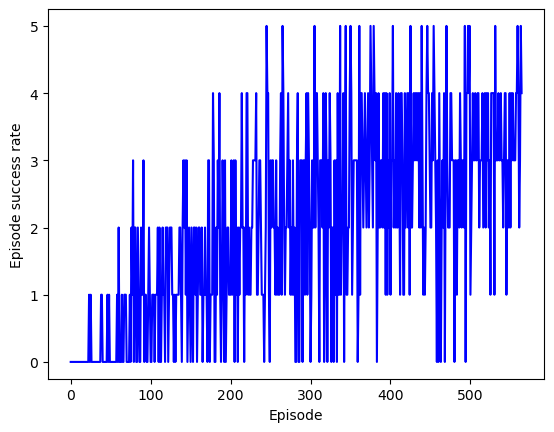

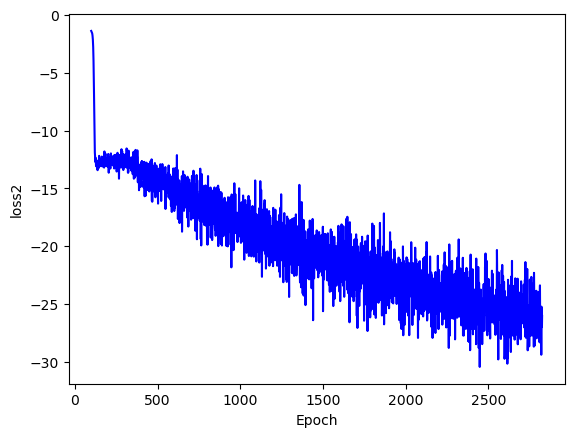

***** epoch 113 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89084.89801464847
r_em 55050.271609509466
55050.271609509466
ReWard2/R0 11.010054321901894
reward2 is: 19.010054321901894
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 3 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 4 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89728.60618896234
r_em 55201.67813878671
55201.67813878671
ReWard2/R0 11.040335627757342
reward2 is: 19.040335627757344
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>............

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.25516586639337596
***** epoch 113 episode 1 *****
***** frame 5 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 6 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92738.62703934686
r_em 55899.49049144126
55899.49049144126
ReWard2/R0 11.179898098288252
reward2 is: 19.179898098288252
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 7 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 8 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94900.29137050683
r_em 55563.065207401385
55563.065207401385
ReWard2/R0 11.112613041480277
reward2 is: 19.112613041480277
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 9 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93538.44992153539
r_em 55860.8968710406
55860.8968710406
ReWard2/R0 11.172179374208119
reward2 is: 19.17217937420812
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.25452858932318095
***** epoch 113 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89299.66400648466
r_em 55352.80544395248
55352.80544395248
ReWard2/R0 11.070561088790496
reward2 is: 19.070561088790498
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 11 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88958.74690088881
r_em 55972.612378340586
55972.612378340586
ReWard2/R0 11.194522475668117
reward2 is: 19.194522475668116
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 12 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89163.63444631768
r_em 56341.54397009092
56341.54397009092
ReWard2/R0 11.268308794018184
reward2 is: 19.268308794018182
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 13 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 14 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.2538929038532652
***** epoch 113 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not m

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 19 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.2532588060086049
***** epoch 113 episode 4 *****
***** frame 20 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 21 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 22 *****
1/1 [================

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 23 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 24 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90471.95335377382
r_em 53648.048306108816
53648.048306108816
ReWard2/R0 10.729609661221764
reward2 is: 18.729609661221765
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.2526262918241041


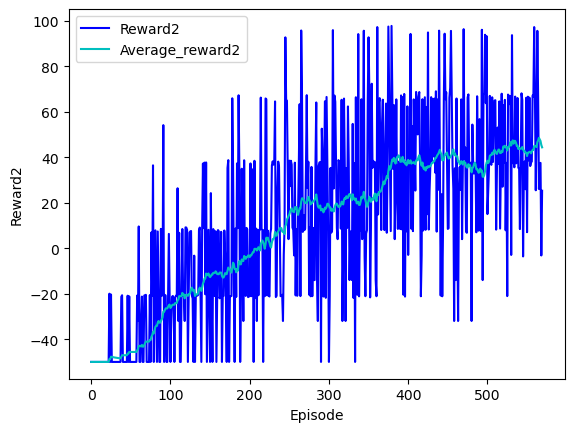

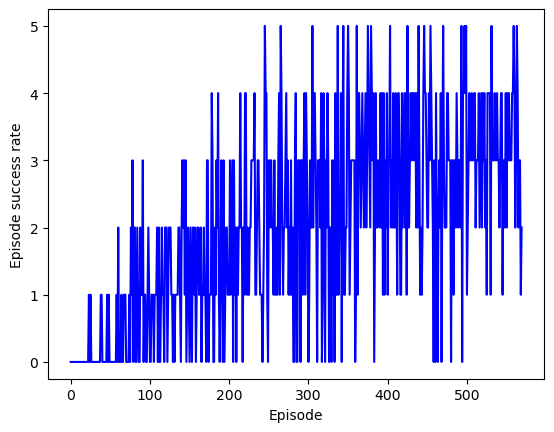

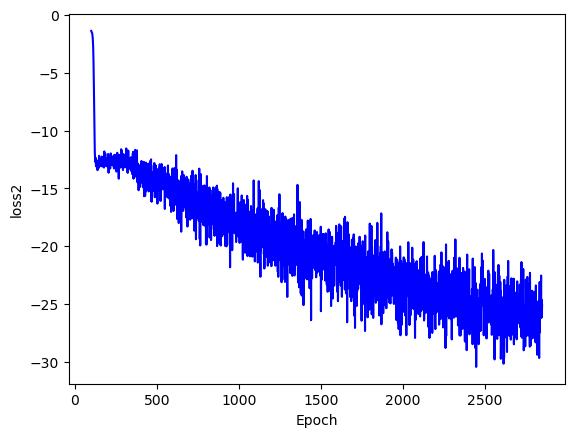

***** epoch 114 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 90158.85664630048
r_em 57679.68061860616
57679.68061860616
ReWard2/R0 11.535936123721232
reward2 is: 19.535936123721232
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step
***** frame 1 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 91305.56558790807
r_em 57196.73613004577
57196.73613004577
ReWard2/R0 11.439347226009154
reward2 is: 19.439347226009154
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step
***** frame 2 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 91338.7489327

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 8 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 93154.50983599106
r_em 51704.56301320954
51704.56301320954
ReWard2/R0 10.340912602641907
reward2 is: 18.340912602641907
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step
***** frame 9 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 90204.50517557432
r_em 51049.21683570014
51049.21683570014
ReWard2/R0 10.209843367140028
reward2 is: 18.209843367140028
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.2513659986246861
***** epoch 114 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 11 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 12 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82468.15449177008
r_em 54623.849849593695
54623.849849593695
ReWard2/R0 10.924769969918739
reward2 is: 18.92476996991874
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 13 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 14 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81086.26947186829
r_em 54632.86055743486
54632.86055743486
ReWard2/R0 10.926572111486973
reward2 is: 18.926572111486973
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.250738211728992
***** epoch 114 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89472.95012390886
r_em 56602.42147928729
56602.42147928729
ReWard2/R0 11.320484295857458
reward2 is: 19.320484295857458
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 16 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 90892.0429826878
r_em 57128.98483464199
57128.98483464199
ReWard2/R0 11.425796966928399
reward2 is: 19.4257969669284
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step
***** frame 17 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 18 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91666.8770967252
r_em 56702.3263318468
56702.3263318468
ReWard2/R0 11.34046526636936
reward2 is: 19.34046526636936
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 19 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.2501119927318545
***** epoch 114 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84964.03440230752
r_em 53125.54122505987
53125.54122505987
ReWard2/R0 10.625108245011974
reward2 is: 18.625108245011972
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 21 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89533.9235800792
r_em 53025.656271265056
53025.656271265056
ReWard2/R0 10.605131254253012
reward2 is: 18.60513125425301
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 22 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88035.41104502429
r_em 53783.649577739976
53783.649577739976
ReWard2/R0 10.756729915547995
reward2 is: 18.756729915547993
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 23 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86289.88738336024
r_em 54321.98651601753
54321.98651601753
ReWard2/R0 10.864397303203507
reward2 is: 18.864397303203507
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 24 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87316.56572631597
r_em 54064.685464045135
54064.685464045135
ReWard2/R0 10.812937092809028
reward2 is: 18.81293709280903
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.24948733771744494


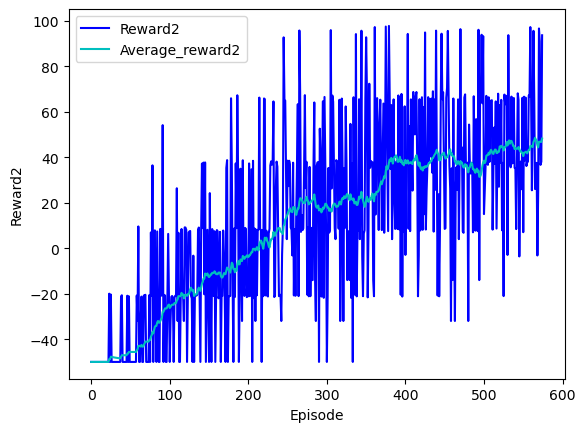

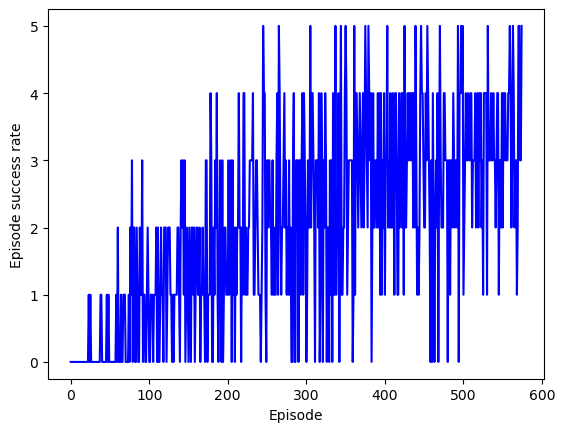

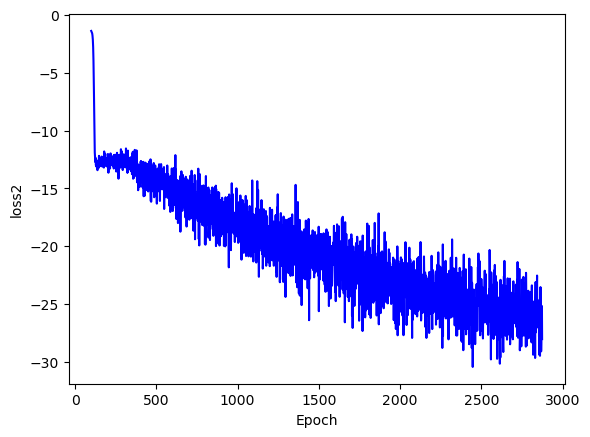

***** epoch 115 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87031.49922406115
r_em 57853.57263957459
57853.57263957459
ReWard2/R0 11.570714527914918
reward2 is: 19.570714527914916
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 1 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87646.83629067749
r_em 57438.669272131505
57438.669272131505
ReWard2/R0 11.4877338544263
reward2 is: 19.487733854426303
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 2 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89159.62934771822
r_em 56838.620872204694
56838.620872204694
ReWard2/R0 11.367724174440939
reward2 is: 19.367724174440937
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 3 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88239.18961345594
r_em 55811.84392995902
55811.84392995902
ReWard2/R0 11.162368785991804
reward2 is: 19.162368785991802
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 4 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89592.98250610635
r_em 55635.89354450074
55635.89354450074
ReWard2/R0 11.127178708900148
reward2 is: 19.127178708900146
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.24886424277971447
***** epoch 115 episode 1 *****
***** frame 5 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 6 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88365.39423508121
r_em 55408.37977974894
55408.37977974894
ReWard2/R0 11.081675955949787
reward2 is: 19.081675955949787
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 7 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87509.72107897152
r_em 54993.57517665264
54993.57517665264
ReWard2/R0 10.998715035330527
reward2 is: 18.998715035330527
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 8 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 9 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.24824270402236964
***** epoch 115 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 16ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 83020.27437827576
r_em 55432.8267959464
55432.8267959464
ReWard2/R0 11.08656535918928
reward2 is: 19.08656535918928
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 12 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84128.14380659905
r_em 54950.1975662449
54950.1975662449
ReWard2/R0 10.990039513248979
reward2 is: 18.99003951324898
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 13 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 14 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.24762271755884804
***** epoch 115 episode 3 *****
***** frame 15 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not 

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 18 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82908.0897728517
r_em 53620.9043874051
53620.9043874051
ReWard2/R0 10.72418087748102
reward2 is: 18.724180877481018
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 19 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82754.59133165033
r_em 53688.008044370305
53688.008044370305
ReWard2/R0 10.73760160887406
reward2 is: 18.73760160887406
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.2470042795122939
***** epoch 115 episode 4 *****
***** frame 20 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 5.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 21 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 22 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 23 *****
1/1 [==============================] 

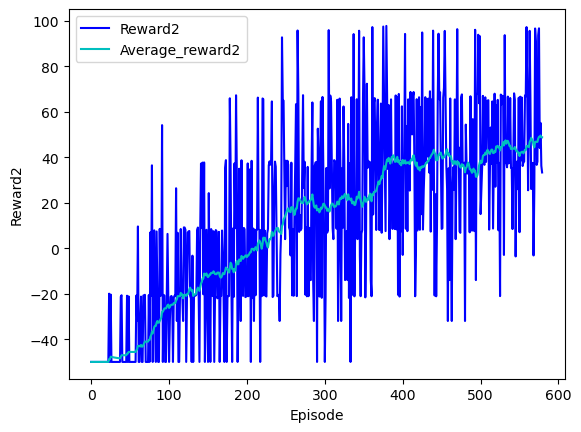

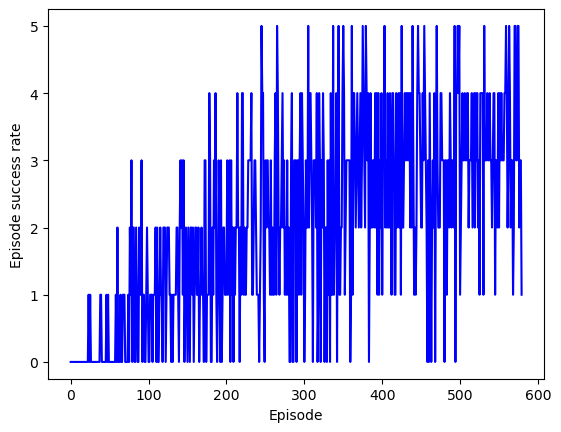

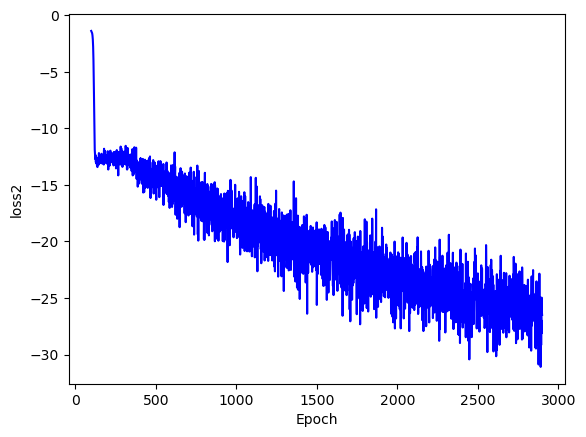

***** epoch 116 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95232.35538503234
r_em 54963.31315354854
54963.31315354854
ReWard2/R0 10.992662630709708
reward2 is: 18.99266263070971
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 2 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93888.82059585427
r_em 55970.508362798166
55970.508362798166
ReWard2/R0 11.194101672559633
reward2 is: 19.194101672559633
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 4 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94797.4582472636
r_em 54817.07119146369
54817.07119146369
ReWard2/R0 10.963414238292739
reward2 is: 18.96341423829274
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.2457720332110529
***** epoch 116 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 90836.7186225059
r_em 55571.49200744694
55571.49200744694
ReWard2/R0 11.114298401489389
reward2 is: 19.11429840148939
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step
***** frame 6 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90772.80981723241
r_em 54204.60682207059
54204.60682207059
ReWard2/R0 10.840921364414118
reward2 is: 18.84092136441412
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 7 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 8 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 9 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 93438.2271940194
r_em 55138.78072255929
55138.78072255929
ReWard2/R0 11.027756144511859
reward2 is: 19.02775614451186
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.24515821725097012


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 12 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95605.6136662159
r_em 55096.260280706905
55096.260280706905
ReWard2/R0 11.019252056141381
reward2 is: 19.019252056141383
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 13 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 14 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.24454593429701468
***** epoch 116 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88981.09161504125
r_em 51790.426441936135
51790.426441936135
ReWard2/R0 10.358085288387228
reward2 is: 18.35808528838723
total numb

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 16 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88388.9030077582
r_em 53524.53800008442
53524.53800008442
ReWard2/R0 10.704907600016885
reward2 is: 18.704907600016885
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 17 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89179.73769429221
r_em 53730.26450435733
53730.26450435733
ReWard2/R0 10.746052900871465
reward2 is: 18.746052900871465
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 18 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 19 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.24393518052050198
***** epoch 116 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84779.63094592234
r_em 56139.08581055687
56139.08581055687
ReWard2/R0 11.227817162111373
reward2 is: 19.22781716211137
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 21 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85868.4893437762
r_em 56048.65973056353
56048.65973056353
ReWard2/R0 11.209731946112706
reward2 is: 19.209731946112704
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 22 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83886.44070478057
r_em 54894.59388226149
54894.59388226149
ReWard2/R0 10.978918776452298
reward2 is: 18.978918776452296
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 23 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87485.4783291496
r_em 55374.52363693554
55374.52363693554
ReWard2/R0 11.074904727387109
reward2 is: 19.074904727387107
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.24332595210230934


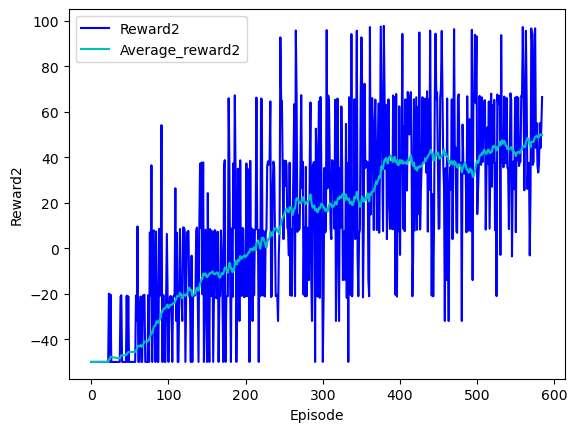

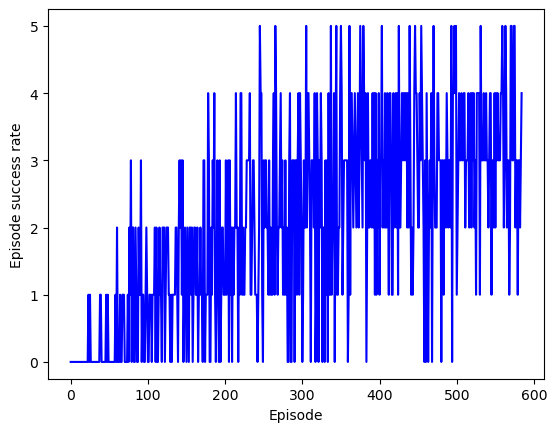

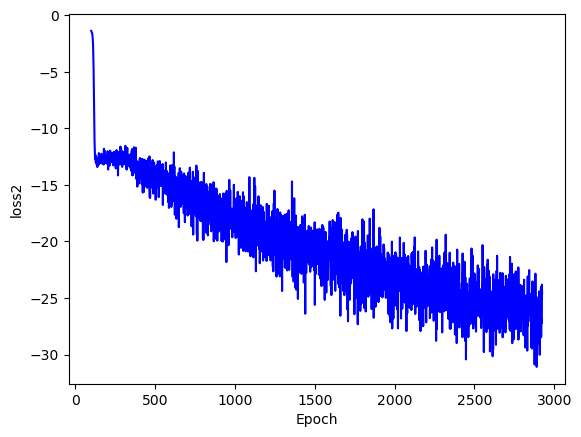

***** epoch 117 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84208.64557270269
r_em 53126.24442507358
53126.24442507358
ReWard2/R0 10.625248885014717
reward2 is: 18.625248885014717
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 1 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84252.82441919799
r_em 53173.73938792002
53173.73938792002
ReWard2/R0 10.634747877584003
reward2 is: 18.634747877584005
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 2 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86239.99591868646
r_em 54174.854832237215
54174.854832237215
ReWard2/R0 10.834970966447443
reward2 is: 18.834970966447443
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 3 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87130.50405351394
r_em 53548.24383062775
53548.24383062775
ReWard2/R0 10.70964876612555
reward2 is: 18.70964876612555
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 4 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86561.81951514413
r_em 52691.23009388257
52691.23009388257
ReWard2/R0 10.538246018776514
reward2 is: 18.538246018776512
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.24271824523285251
***** epoch 117 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85365.57875698838
r_em 57010.52991413542
57010.52991413542
ReWard2/R0 11.402105982827084
reward2 is: 19.402105982827084
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 6 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 7 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85499.69026765233
r_em 57175.31700195385
57175.31700195385
ReWard2/R0 11.43506340039077
reward2 is: 19.43506340039077
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 8 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 9 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.24211205611206157
***** epoch 117 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 11 *****
1/1 [==================

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 13 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 14 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.24150738094935736
***** epoch 117 episode 3 *****
***** frame 15 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 16 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 wit

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 17 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 18 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 19 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 72592.70558644207
r_em 56906.55382847663
56906.55382847663
ReWard2/R0 11.381310765695327
reward2 is: 19.381310765695325
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.24090421596362763
***** epoch 117 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93049.28455167783
r_em 55654.30207458792
55654.30207458792
ReWard2/R0 11.130860414917583
reward2 is: 19.130860414917585
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 21 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93999.92650119858
r_em 56473.87520600855
56473.87520600855
ReWard2/R0 11.29477504120171
reward2 is: 19.29477504120171
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 22 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93561.70461174785
r_em 55637.79573089819
55637.79573089819
ReWard2/R0 11.127559146179639
reward2 is: 19.12755914617964
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 23 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95022.34329469119
r_em 55367.328243573815
55367.328243573815
ReWard2/R0 11.073465648714762
reward2 is: 19.073465648714762
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 24 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95344.06740890813
r_em 56325.57943153285
56325.57943153285
ReWard2/R0 11.265115886306571
reward2 is: 19.26511588630657
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.24030255738320352


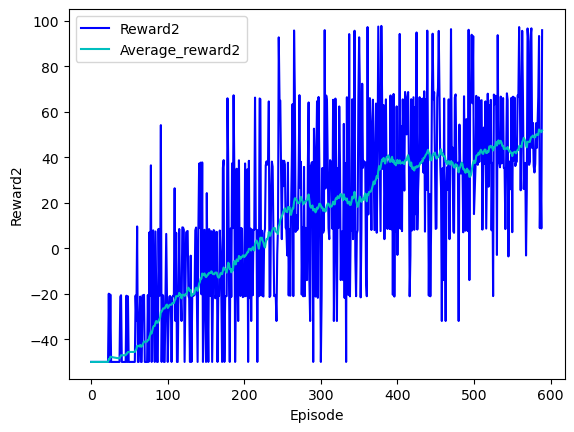

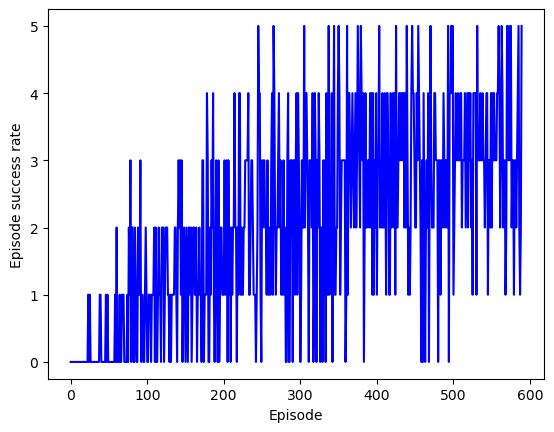

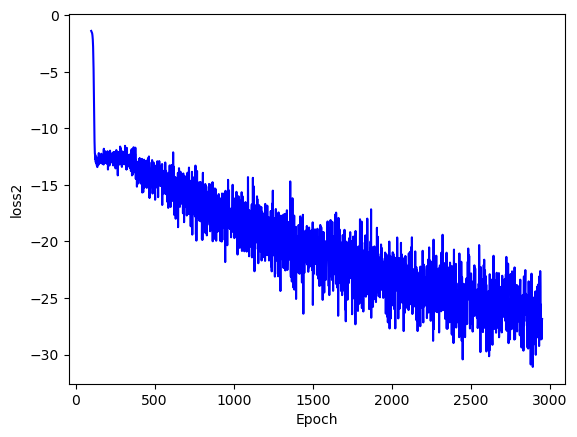

***** epoch 118 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82164.22709000933
r_em 55872.04894354905
55872.04894354905
ReWard2/R0 11.174409788709811
reward2 is: 19.17440978870981
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 1 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79348.50851144447
r_em 55797.93537076402
55797.93537076402
ReWard2/R0 11.159587074152803
reward2 is: 19.159587074152803
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 2 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81217.16599899948
r_em 56459.008204639715
56459.008204639715
ReWard2/R0 11.291801640927943
reward2 is: 19.291801640927943
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 3 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78993.15747281916
r_em 56554.575736022176
56554.575736022176
ReWard2/R0 11.310915147204435
reward2 is: 19.310915147204433
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 4 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.23970240144583596
***** epoch 118 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 75729.44181075858
r_em 51107.45163808529
51107.45163808529
ReWard2/R0 10.221490327617058
reward2 is: 18.221490327617058
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 6 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 74949.9359903464
r_em 51370.48354866124
51370.48354866124
ReWard2/R0 10.274096709732248
reward2 is: 18.274096709732248
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 7 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 72934.83873148636
r_em 52467.62050290473
52467.62050290473
ReWard2/R0 10.493524100580945
reward2 is: 18.493524100580945
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 8 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83279.83840682897
r_em 53185.53995841482
53185.53995841482
ReWard2/R0 10.637107991682964
reward2 is: 18.637107991682964
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 9 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.23910374439867194
***** epoch 118 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77671.32829150949
r_em 56209.787402123926
56209.787402123926
ReWard2/R0 11.241957480424785
reward2 is: 19.241957480424787
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 11 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 12 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78951.78477459516
r_em 56715.08673776518
56715.08673776518
ReWard2/R0 11.343017347553037
reward2 is: 19.343017347553037
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 13 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78270.37632504248
r_em 56817.47934647974
56817.47934647974
ReWard2/R0 11.363495869295948
reward2 is: 19.363495869295946
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 14 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.23850658249823134
***** epoch 118 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79747.90527111813
r_em 56203.698486843205
56203.698486843205
ReWard2/R0 11.24073969736864
reward2 is: 19.24073969736864
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 16 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79577.54802040124
r_em 56788.99232107805
56788.99232107805
ReWard2/R0 11.357798464215609
reward2 is: 19.35779846421561
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 17 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 18 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77747.28042406001
r_em 57551.91294340534
57551.91294340534
ReWard2/R0 11.510382588681068
reward2 is: 19.51038258868107
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 19 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79417.15142950654
r_em 57634.90577801091
57634.90577801091
ReWard2/R0 11.526981155602181
reward2 is: 19.52698115560218
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.2379109120103834
***** epoch 118 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85573.96393240197
r_em 54443.602801523404
54443.602801523404
ReWard2/R0 10.88872056030468
reward2 is: 18.88872056030468
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 21 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87822.9484942126
r_em 55249.598458035274
55249.598458035274
ReWard2/R0 11.049919691607055
reward2 is: 19.049919691607055
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 22 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87281.67973486774
r_em 55786.40460726752
55786.40460726752
ReWard2/R0 11.157280921453504
reward2 is: 19.157280921453506
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 23 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 24 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88814.78895452106
r_em 55789.8774122899
55789.8774122899
ReWard2/R0 11.15797548245798
reward2 is: 19.157975482457978
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.23731672921032318


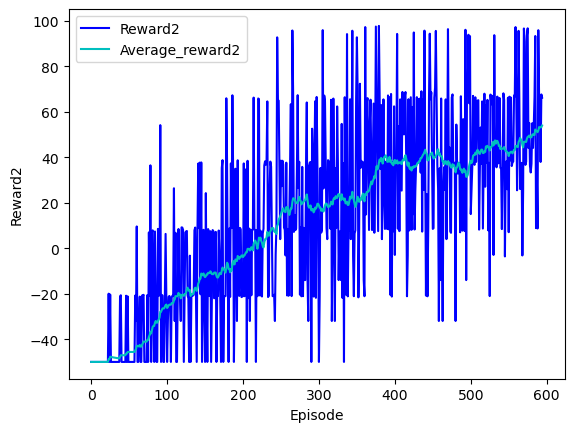

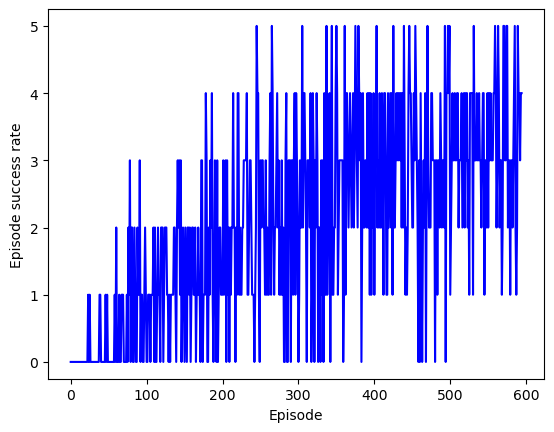

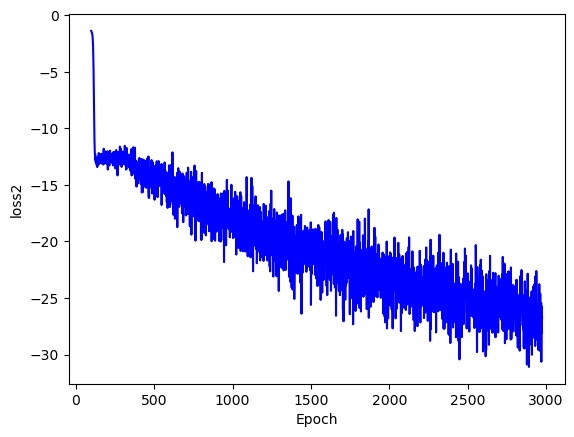

***** epoch 119 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 1 *****
1/1 [==============================] - 0s 39ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90631.42968880375
r_em 52997.66361646787
52997.66361646787
ReWard2/R0 10.599532723293574
reward2 is: 18.599532723293574
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 2 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92254.56757209198
r_em 53738.41345396588
53738.41345396588
ReWard2/R0 10.747682690793175
reward2 is: 18.747682690793177
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 4 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90829.91615738069
r_em 53731.910641236616
53731.910641236616
ReWard2/R0 10.746382128247323
reward2 is: 18.746382128247323
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.2367240303825487
***** epoch 119 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93695.63289359328
r_em 54084.6284828895
54084.6284828895
ReWard2/R0 10.8169256965779
reward2 is: 18.8169256965779
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 6 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 7 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94354.46454064289
r_em 55285.502056095655
55285.502056095655
ReWard2/R0 11.057100411219132
reward2 is: 19.057100411219132
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 8 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94371.74308978238
r_em 55630.001372720115
55630.001372720115
ReWard2/R0 11.126000274544023
reward2 is: 19.126000274544023
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 9 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.23613281182083729
***** epoch 119 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92469.27403272873
r_em 54907.97566705292
54907.97566705292
ReWard2/R0 10.981595133410583
reward2 is: 18.981595133410583
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 11 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 12 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93144.82717670794
r_em 55427.505567702334
55427.505567702334
ReWard2/R0 11.085501113540467
reward2 is: 19.085501113540467
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 13 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 14 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 92777.09976323906
r_em 54941.224368767595
54941.224368767595
ReWard2/R0 10.98824487375352
reward2 is: 18.98824487375352
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.23554306982822257
***** epoch 119 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88650.09045722643
r_em 52619.35010059597
52619.35010059597
ReWard2/R0 10

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 16 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 17 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89098.26571785423
r_em 52770.949600566564
52770.949600566564
ReWard2/R0 10.554189920113313
reward2 is: 18.554189920113313
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 18 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 19 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.2349548007169714
***** epoch 119 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
**

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 23 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 24 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.23436800080856074


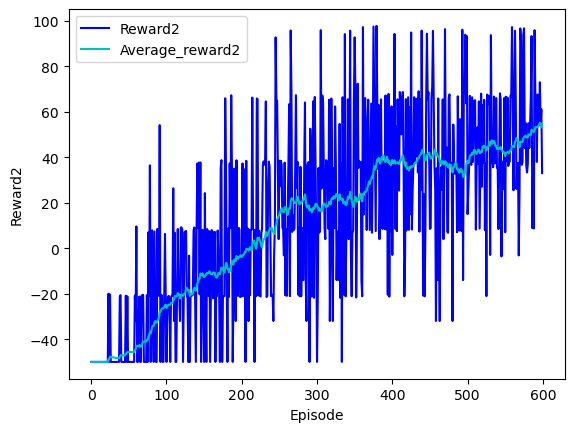

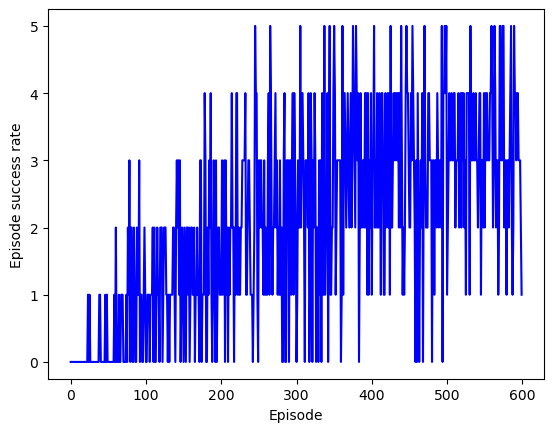

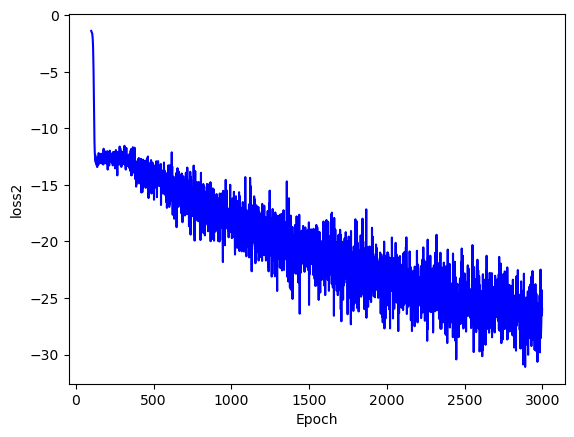

***** epoch 120 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94137.13676027811
r_em 52668.438018940295
52668.438018940295
ReWard2/R0 10.533687603788058
reward2 is: 18.53368760378806
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 1 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90766.27042910061
r_em 54842.96299209776
54842.96299209776
ReWard2/R0 10.968592598419551
reward2 is: 18.96859259841955
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 2 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92117.39060530442
r_em 55332.74204498358
55332.74204498358
ReWard2/R0 11.066548408996715
reward2 is: 19.066548408996717
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 4 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93310.11947507203
r_em 54040.74687610912
54040.74687610912
ReWard2/R0 10.808149375221824
reward2 is: 18.808149375221824
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.23378266643365464
***** epoch 120 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94748.68697139551
r_em 57187.351002196185
57187.351002196185
ReWard2/R0 11.437470200439236
reward2 is: 19.437470200439236
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 6 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94471.49983582817
r_em 57620.241363649766
57620.241363649766
ReWard2/R0 11.524048272729953
reward2 is: 19.524048272729953
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 7 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94856.87988219285
r_em 57547.196259365555
57547.196259365555
ReWard2/R0 11.509439251873111
reward2 is: 19.50943925187311
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 8 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94506.2809068742
r_em 57495.48732762484
57495.48732762484
ReWard2/R0 11.499097465524969
reward2 is: 19.49909746552497
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 9 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95272.24896090274
r_em 56835.84478812139
56835.84478812139
ReWard2/R0 11.367168957624278
reward2 is: 19.36716895762428
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.23319879393208137
***** epoch 120 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 11 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87440.81657510833
r_em 52927.437104590164
52927.437104590164
ReWard2/R0 10.585487420918033
reward2 is: 18.585487420918035
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 12 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 13 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 14 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.2326163796528104
***** epoch 120 episode 3 *****
***** frame 15 *****
1/

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 16 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81787.43871512699
r_em 55212.304804732004
55212.304804732004
ReWard2/R0 11.042460960946402
reward2 is: 19.0424609609464
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 17 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80164.43855953407
r_em 55022.0457181788
55022.0457181788
ReWard2/R0 11.00440914363576
reward2 is: 19.004409143635762
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 18 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 19 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82868.72761750405
r_em 54619.81865171762
54619.81865171762
ReWard2/R0 10.923963730343525
reward2 is: 18.923963730343523
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.2320354199539298
***** epoch 120 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89664.73780599642
r_em 52435.57084091089
52435.57084091089
ReWard2/R0 10.487114168182178
reward2 is: 18.487114168182178
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 21 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 90183.43598286205
r_em 53176.41130299841
53176.41130299841
ReWard2/R0 10.63528226059968
reward2 is: 18.63528226059968
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step
***** frame 22 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 89917.78454756923
r_em 53690.657044863445
53690.657044863445
ReWard2/R0 10.73813140897269
reward2 is: 18.73813140897269
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step
***** frame 23 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total

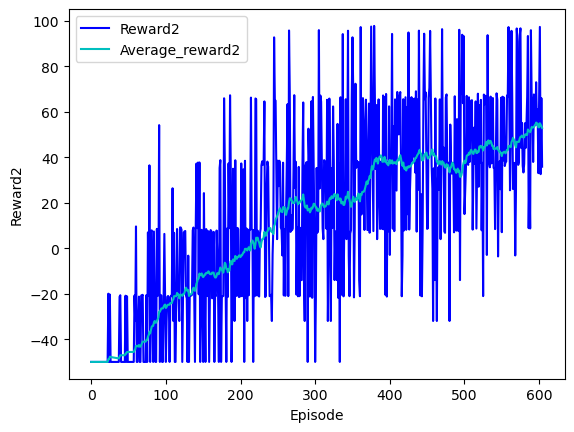

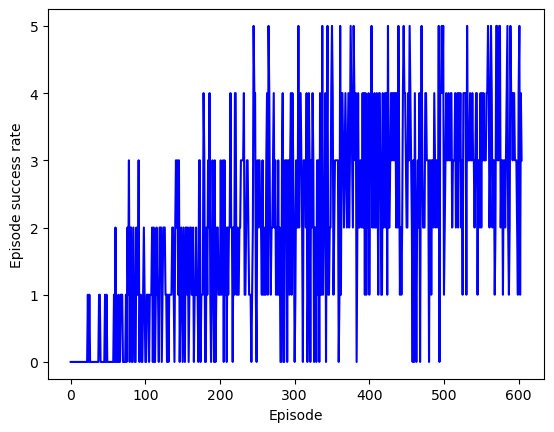

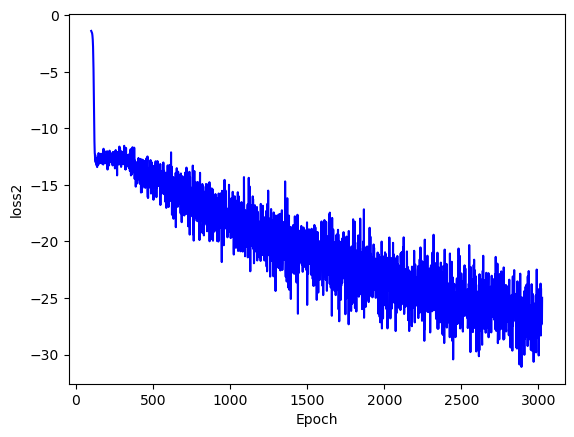

***** epoch 121 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89677.18501358118
r_em 53859.95036197875
53859.95036197875
ReWard2/R0 10.77199007239575
reward2 is: 18.771990072395752
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 1 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89803.48171432196
r_em 54296.9261367102
54296.9261367102
ReWard2/R0 10.85938522734204
reward2 is: 18.859385227342038
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 2 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91105.03153587792
r_em 54366.4546984187
54366.4546984187
ReWard2/R0 10.873290939683741
reward2 is: 18.87329093968374
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 3 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88604.51035375072
r_em 54509.17349032376
54509.17349032376
ReWard2/R0 10.901834698064752
reward2 is: 18.901834698064754
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 4 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91213.8100357609
r_em 54371.617515758975
54371.617515758975
ReWard2/R0 10.874323503151794
reward2 is: 18.874323503151793
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.23087784977514708
***** epoch 121 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 6 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 7 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
****

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 12 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 13 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 91582.13778677791
r_em 57449.65734058985
57449.65734058985
ReWard2/R0 11.489931468117971
reward2 is: 19.489931468117973
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step
***** frame 14 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 91205.24132639717
r_em 57668.784169040395
57668.784169040395
ReWard2/R0 11.533756833808079
reward2 is: 19.533756833808077
total number of ur2 RBs: 8.0
total number of em2 R

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 16 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92969.26300737355
r_em 53758.19344666055
53758.19344666055
ReWard2/R0 10.751638689332111
reward2 is: 18.75163868933211
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 17 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94467.63724685862
r_em 53875.03465122668
53875.03465122668
ReWard2/R0 10.775006930245336
reward2 is: 18.775006930245336
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 18 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 19 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93512.47990415376
r_em 53791.43671889978
53791.43671889978
ReWard2/R0 10.758287343779955
reward2 is: 18.758287343779955
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.22915231333388766
***** epoch 121 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95282.73118546918
r_em 55057.92346620311
55057.92346620311
ReWard2/R0 11.011584693240621
reward2 is: 19.01158469324062
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 21 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95268.0377970821
r_em 55384.97869654247
55384.97869654247
ReWard2/R0 11.076995739308494
reward2 is: 19.076995739308494
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 22 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94963.07647260686
r_em 53565.82873966466
53565.82873966466
ReWard2/R0 10.713165747932933
reward2 is: 18.713165747932933
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 23 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93107.77848628437
r_em 54436.25329128629
54436.25329128629
ReWard2/R0 10.887250658257258
reward2 is: 18.88725065825726
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.22858000514496757


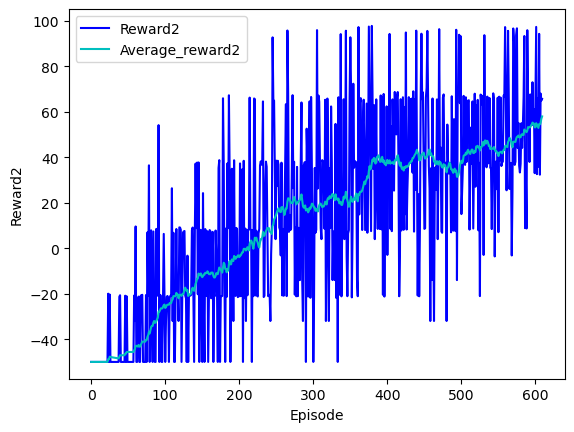

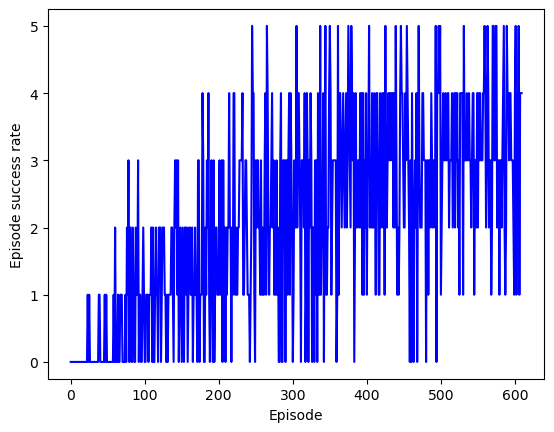

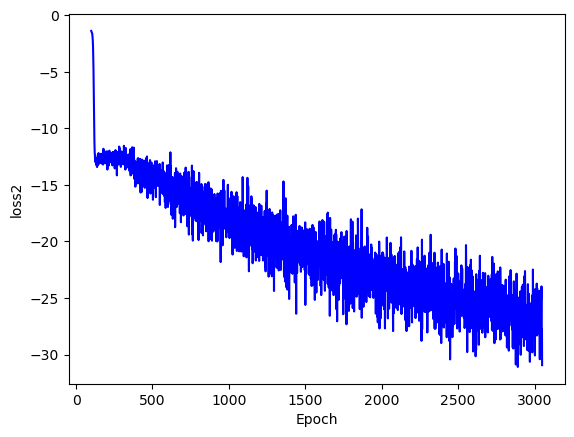

***** epoch 122 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 1 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91743.45908165349
r_em 54759.93024628974
54759.93024628974
ReWard2/R0 10.951986049257949
reward2 is: 18.951986049257947
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 3 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90042.95461626713
r_em 54340.93247313807
54340.93247313807
ReWard2/R0 10.868186494627613
reward2 is: 18.868186494627615
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 4 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90308.76094258361
r_em 55076.95664043711
55076.95664043711
ReWard2/R0 11.015391328087421
reward2 is: 19.01539132808742
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.22800912629646453
***** epoch 122 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79732.21240035084
r_em 58099.509265114524
58099.509265114524
ReWard2/R0 11.619901853022904
reward2 is: 19.619901853022903
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 6 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88706.69710462079
r_em 58400.13597202927
58400.13597202927
ReWard2/R0 11.680027194405854
reward2 is: 19.680027194405852
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 7 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83298.17832930319
r_em 57972.50310088411
57972.50310088411
ReWard2/R0 11.594500620176822
reward2 is: 19.594500620176824
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 8 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80856.53462745372
r_em 57876.915851314705
57876.915851314705
ReWard2/R0 11.57538317026294
reward2 is: 19.57538317026294
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 9 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87672.7152730414
r_em 57945.21746588063
57945.21746588063
ReWard2/R0 11.589043493176126
reward2 is: 19.589043493176128
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.227439673218599
***** epoch 122 episode 2 *****
***** frame 10 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 11 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85611.72536569039
r_em 54404.97118190632
54404.97118190632
ReWard2/R0 10.880994236381264
reward2 is: 18.880994236381262
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 12 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86450.61654631168
r_em 55177.37983573307
55177.37983573307
ReWard2/R0 11.035475967146613
reward2 is: 19.035475967146613
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 13 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85941.10200719631
r_em 54718.73054558103
54718.73054558103
ReWard2/R0 10.943746109116205
reward2 is: 18.943746109116205
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 14 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85898.27837518405
r_em 55083.58447576589
55083.58447576589
ReWard2/R0 11.016716895153179
reward2 is: 19.01671689515318
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.22687164235050708
***** epoch 122 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88732.09420248852
r_em 54066.626286913546
54066.626286913546
ReWard2/R0 10.81332525738271
reward2 is: 18.813325257382708
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 16 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87820.12646081233
r_em 54190.80311820409
54190.80311820409
ReWard2/R0 10.838160623640817
reward2 is: 18.838160623640817
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 17 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90383.135030721
r_em 54348.473063405596
54348.473063405596
ReWard2/R0 10.86969461268112
reward2 is: 18.86969461268112
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 18 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 19 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.2263050301402181
***** epoch 122 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91778.41044232302
r_em 54250.23893605833
54250.23893605833
ReWard2/R0 10.850047787211667
reward2 is: 18.850047787211665
total number of ur2 RBs: 8.0
tota

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 21 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91399.16814412666
r_em 53918.79900317188
53918.79900317188
ReWard2/R0 10.783759800634376
reward2 is: 18.783759800634378
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 22 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91453.74042333834
r_em 50398.24911580222
50398.24911580222
ReWard2/R0 10.079649823160443
reward2 is: 18.079649823160445
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 23 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91673.9277894886
r_em 52952.34249041707
52952.34249041707
ReWard2/R0 10.590468498083414
reward2 is: 18.590468498083414
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 24 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91508.21908462934
r_em 53693.14151297563
53693.14151297563
ReWard2/R0 10.738628302595126
reward2 is: 18.738628302595124
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.2257398330446324


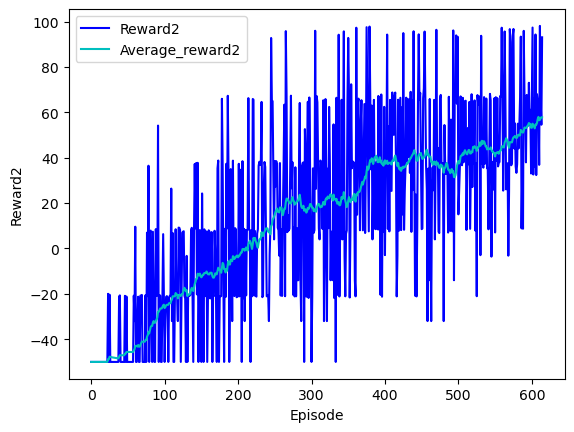

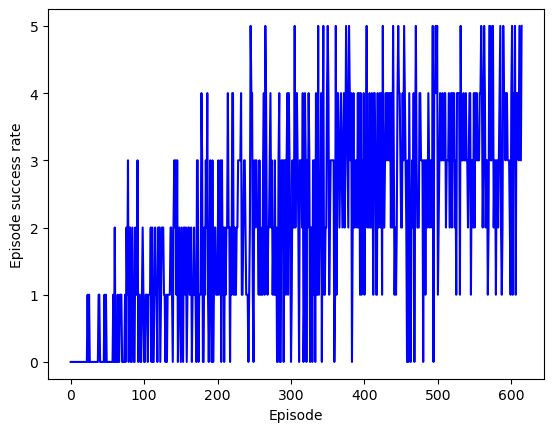

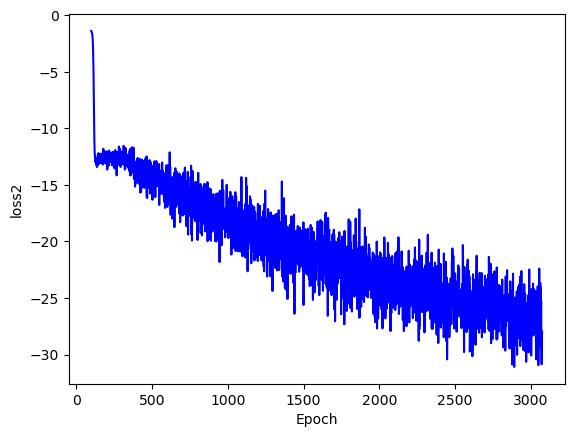

***** epoch 123 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82554.24420333147
r_em 57434.99781858815
57434.99781858815
ReWard2/R0 11.48699956371763
reward2 is: 19.48699956371763
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 2 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81457.5990368406
r_em 56791.45230416496
56791.45230416496
ReWard2/R0 11.358290460832992
reward2 is: 19.35829046083299
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 3 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82326.37740578658
r_em 56572.80412183619
56572.80412183619
ReWard2/R0 11.314560824367238
reward2 is: 19.314560824367238
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 4 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.22517604752949924
***** epoch 123 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83021.55944782805
r_em 54416.18171323939
54416.18171323939
ReWard2/R0 10.883236342647878
reward2 is: 18.883236342647876
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 6 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 7 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85329.47465573608
r_em 55139.41534725353
55139.41534725353
ReWard2/R0 11.027883069450706
reward2 is: 19.027883069450706
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 8 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85543.03705894556
r_em 55101.36553243016
55101.36553243016
ReWard2/R0 11.020273106486032
reward2 is: 19.02027310648603
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 9 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83272.25055488745
r_em 54968.46127021857
54968.46127021857
ReWard2/R0 10.993692254043713
reward2 is: 18.993692254043715
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.22461367006939464
***** epoch 123 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92604.54729559996
r_em 53214.009245224486
53214.009245224486
ReWard2/R0 10.642801849044897
reward2 is: 18.642801849044897
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 11 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 12 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 13 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93298.92668418057
r_em 54865.918218030965
54865.918218030965
ReWard2/R0 10.973183643606193
reward2 is: 18.97318364360619
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ET

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 14 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.2240526971476995
***** epoch 123 episode 3 *****
***** frame 15 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 17 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exp

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 18 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96748.59812119298
r_em 57012.470478310766
57012.470478310766
ReWard2/R0 11.402494095662153
reward2 is: 19.402494095662153
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 19 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96532.48404920679
r_em 57287.85937899407
57287.85937899407
ReWard2/R0 11.457571875798815
reward2 is: 19.457571875798813
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.2234931252565773
***** epoch 123 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88557.85005637641
r_em 56235.78350901988
56235.78350901988
ReWard2/R0 11.247156701803975
reward2 is: 19.247156701803974
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 22 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89555.19247257322
r_em 55580.189076878276
55580.189076878276
ReWard2/R0 11.116037815375655
reward2 is: 19.116037815375655
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 23 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87171.69593519991
r_em 55821.701298479056
55821.701298479056
ReWard2/R0 11.16434025969581
reward2 is: 19.164340259695813
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 24 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88603.75057337669
r_em 56247.321406050876
56247.321406050876
ReWard2/R0 11.249464281210175
reward2 is: 19.249464281210173
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.22293495089695248


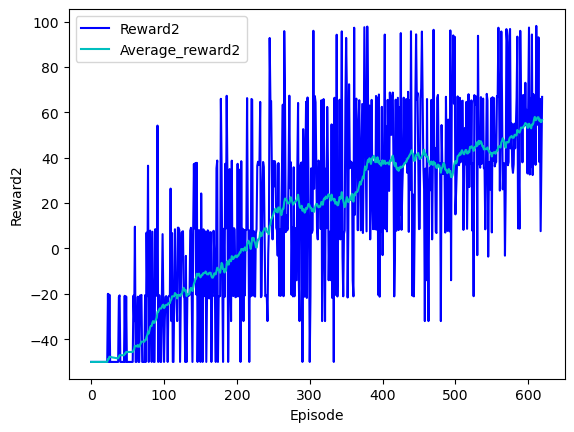

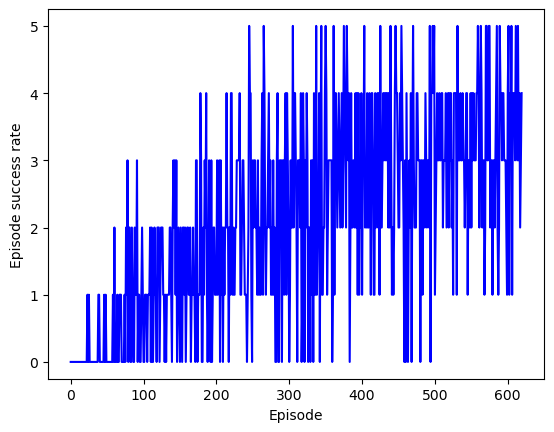

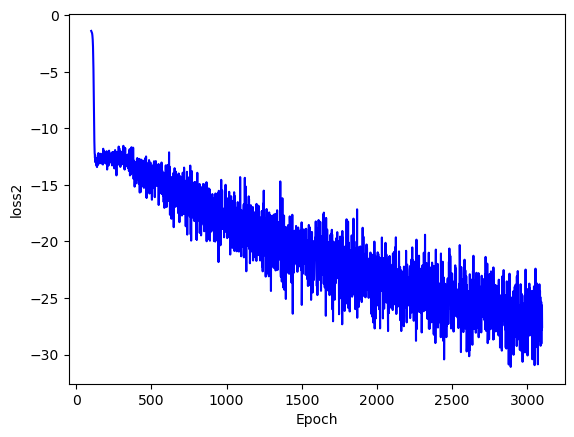

***** epoch 124 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 2 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89340.83631014763
r_em 59443.646585061164
59443.646585061164
ReWard2/R0 11.888729317012233
reward2 is: 19.888729317012235
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 3 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92354.613264972
r_em 59222.66268428482
59222.66268428482
ReWard2/R0 11.844532536856963
reward2 is: 19.844532536856963
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 4 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91707.62878063333
r_em 58983.95420112664
58983.95420112664
ReWard2/R0 11.796790840225327
reward2 is: 19.796790840225327
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.22237817057848835
***** epoch 124 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 6 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 7 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
****

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.22126877814725937
***** epoch 124 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90881.06205078492
r_em 57527.22941369729
57527.22941369729
ReWard2/R0 11.505445882739458
reward2 is: 19.50544588273946
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 16 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90461.05129595907
r_em 56727.71054814627
56727.71054814627
ReWard2/R0 11.345542109629255
reward2 is: 19.345542109629257
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 17 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92698.07014042139
r_em 56646.25848367308
56646.25848367308
ReWard2/R0 11.329251696734616
reward2 is: 19.329251696734616
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 18 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93073.79785864058
r_em 57328.40700502657
57328.40700502657
ReWard2/R0 11.465681401005314
reward2 is: 19.465681401005313
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 19 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92570.42553682912
r_em 57801.78532337498
57801.78532337498
ReWard2/R0 11.560357064674996
reward2 is: 19.560357064674996
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.22071615909731984
***** epoch 124 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84079.20582317223
r_em 54397.19459723215
54397.19459723215
ReWard2/R0 10.87943891944643
reward2 is: 18.87943891944643
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 21 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85011.91179962017
r_em 54762.141196252654
54762.141196252654
ReWard2/R0 10.952428239250532
reward2 is: 18.95242823925053
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 23 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82077.27588362581
r_em 55121.49008298427
55121.49008298427
ReWard2/R0 11.024298016596855
reward2 is: 19.024298016596855
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 24 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82845.6702265235
r_em 56223.53977099521
56223.53977099521
ReWard2/R0 11.244707954199042
reward2 is: 19.244707954199043
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.22016492021414813


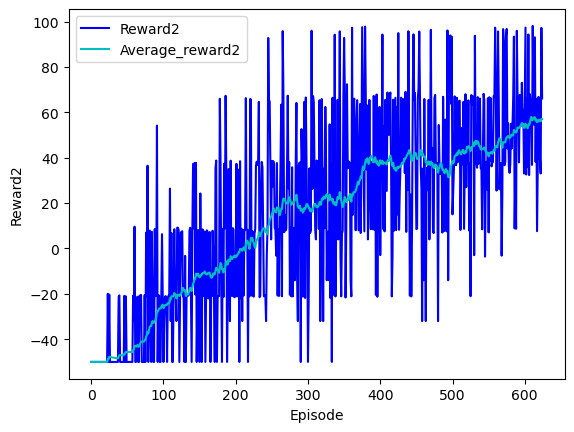

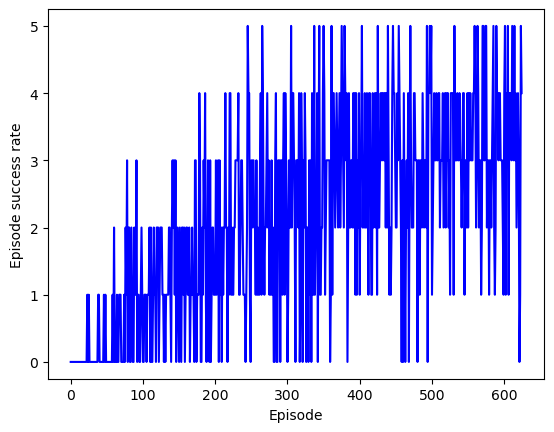

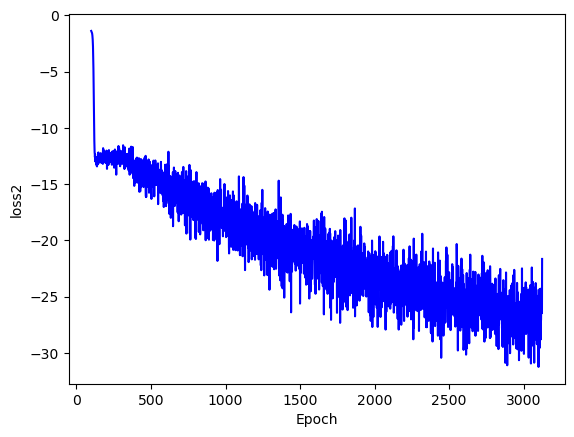

***** epoch 125 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 1 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80690.69360338997
r_em 61671.0695629675
61671.0695629675
ReWard2/R0 12.334213912593501
reward2 is: 20.3342139125935
total number of ur2 RBs: 7.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 3 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 4 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.21961505805077597
***** epoch 125 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79910.52840912165
r_em 56879.06723411365
56879.06723411365
ReWard2/R0 11.37581344682273
reward2 is: 19.375813446822733
total number of

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 6 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80065.71444272774
r_em 55990.01045744375
55990.01045744375
ReWard2/R0 11.19800209148875
reward2 is: 19.19800209148875
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 7 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78256.00137312996
r_em 55989.07582221032
55989.07582221032
ReWard2/R0 11.197815164442064
reward2 is: 19.197815164442062
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 8 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 9 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.21906656916884404
***** epoch 125 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85628.92599721548
r_em 57224.59904619038
57224.59904619038
ReWard2/R0 11.444919809238076
reward2 is: 19.444919809238076
total number of ur2 RBs: 8.0
total number of em2 RBs:

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 11 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90513.44281349673
r_em 57017.46968411488
57017.46968411488
ReWard2/R0 11.403493936822978
reward2 is: 19.403493936822976
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 12 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85659.94799371914
r_em 57214.14283535818
57214.14283535818
ReWard2/R0 11.442828567071636
reward2 is: 19.442828567071636
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 13 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87346.05011503944
r_em 56820.05705739404
56820.05705739404
ReWard2/R0 11.364011411478808
reward2 is: 19.364011411478806
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 14 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.21851945013858012
***** epoch 125 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90493.4618644687
r_em 56373.94203783431
56373.94203783431
ReWard2/R0 11.274788407566863
reward2 is: 19.274788407566863
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 16 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92418.67784993026
r_em 56166.94770332786
56166.94770332786
ReWard2/R0 11.233389540665572
reward2 is: 19.23338954066557
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 17 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91965.42333583666
r_em 55801.856410654145
55801.856410654145
ReWard2/R0 11.160371282130829
reward2 is: 19.16037128213083
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 18 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 19 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92162.72075687615
r_em 55867.21194573003
55867.21194573003
ReWard2/R0 11.173442389146006
reward2 is: 19.173442389146004
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.21797369753877804
***** epoch 125 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85831.46230301922
r_em 51339.61159675599
51339.61159675599
ReWard2/R0 10.267922319351198
reward2 is: 18.2679223193512
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 23 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86120.93885523819
r_em 51346.38403457268
51346.38403457268
ReWard2/R0 10.269276806914535
reward2 is: 18.269276806914533
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 24 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86308.73586516146
r_em 51355.323735177015
51355.323735177015
ReWard2/R0 10.271064747035403
reward2 is: 18.271064747035403
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.217429307956776


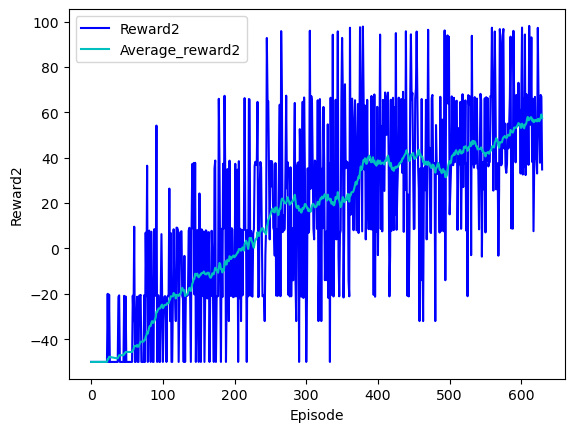

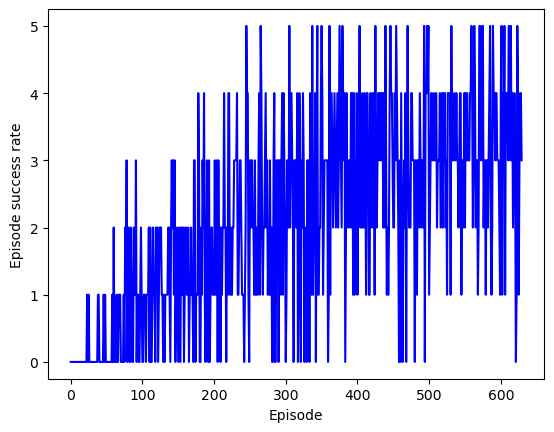

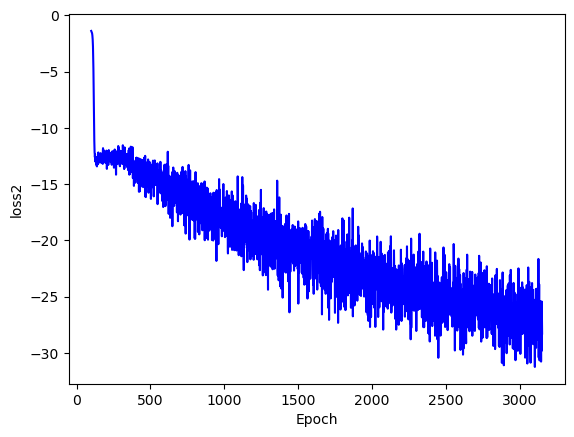

***** epoch 126 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 83360.84229465773
r_em 50665.82925643536
50665.82925643536
ReWard2/R0 10.133165851287073
reward2 is: 18.133165851287075
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step
***** frame 1 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 84358.40655116658
r_em 49542.455165871695
49542.455165871695
ReWard2/R0 9.90849103317434
reward2 is: 17.90849103317434
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step
***** frame 2 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 83896.50749820

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.21688627798843532
***** epoch 126 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94090.17415079335
r_em 56594.28200140023
56594.28200140023
ReWard2/R0 11.318856400280046
reward2 is: 19.318856400280048
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 6 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94207.81134398354
r_em 55613.50646006004
55613.50646006004
ReWard2/R0 11.122701292012007
reward2 is: 19.122701292012007
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 7 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92936.3429678081
r_em 55555.3064179411
55555.3064179411
ReWard2/R0 11.11106128358822
reward2 is: 19.11106128358822
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 8 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 9 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95965.4993923505
r_em 54352.18113020305
54352.18113020305
ReWard2/R0 10.87043622604061
reward2 is: 18.87043622604061
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.21634460423811916
***** epoch 126 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 93168.99543587714
r_em 54241.120629665274
54241.120629665274
ReWard2/R0 10.848224125933054
reward2 is: 18.848224125933054
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step
***** frame 11 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 90875.91485078866
r_em 54359.79667304202
54359.79667304202
ReWard2/R0 10.871959334608405
reward2 is: 18.871959334608405
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step
***** frame 12 *****
1/1 [==============================] - 0s 24ms/step

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.21580428331867138
***** epoch 126 episode 3 *****
***** frame 15 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 17 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84009.01468681474
r_em 57179.63048502249
57179.63048502249
ReWard2/R0 11.435926097004499
reward2 is: 19.435926097004497
total number of ur2 RBs: 8.0
total number of em2 RBs:

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 18 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82407.93173132965
r_em 56340.65775320989
56340.65775320989
ReWard2/R0 11.268131550641979
reward2 is: 19.26813155064198
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 19 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.21526531185139514
***** epoch 126 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91345.94953666512
r_em 54628.48428964247
54628.48428964247
ReWard2/R0 10.925696857928493
reward2 is: 18.925696857928493
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 21 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91844.04055454378
r_em 54649.08239279203
54649.08239279203
ReWard2/R0 10.929816478558406
reward2 is: 18.929816478558408
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 22 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 23 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 24 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91135.75860076153
r_em 55369.019270575394
55369.019270575394
ReWard2/R0 11.073803854115079
reward2 is: 19.073803854115077
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.21472768646603194


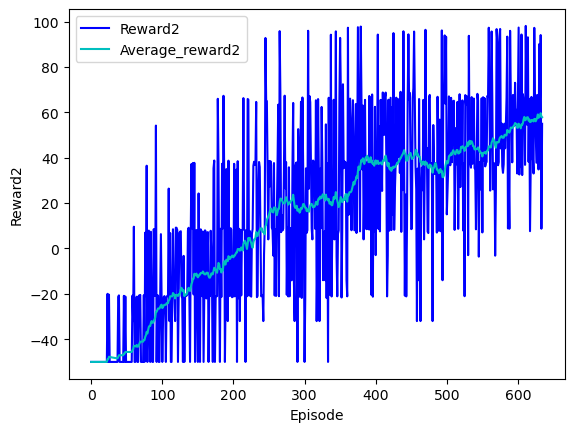

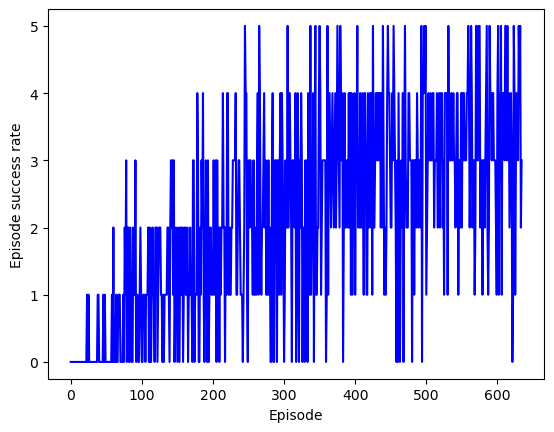

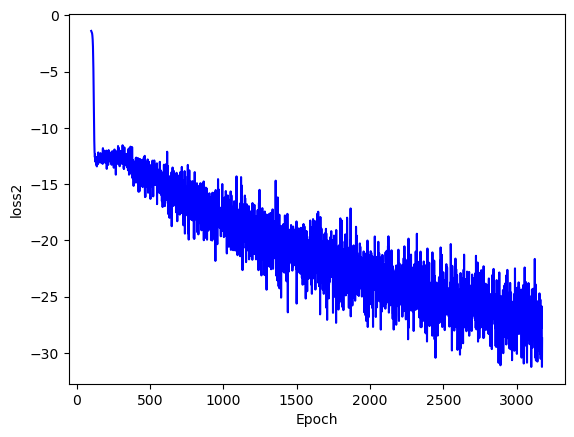

***** epoch 127 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79369.27224993682
r_em 55110.84643635473
55110.84643635473
ReWard2/R0 11.022169287270946
reward2 is: 19.02216928727095
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 1 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78101.26675908986
r_em 55421.979711079424
55421.979711079424
ReWard2/R0 11.084395942215885
reward2 is: 19.084395942215885
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 2 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78319.99776089986
r_em 54806.541796335325
54806.541796335325
ReWard2/R0 10.961308359267065
reward2 is: 18.961308359267065
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 3 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79398.40541239665
r_em 55212.18506449582
55212.18506449582
ReWard2/R0 11.042437012899164
reward2 is: 19.042437012899164
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 4 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82507.3073964572
r_em 54973.983324518485
54973.983324518485
ReWard2/R0 10.994796664903697
reward2 is: 18.994796664903696
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.2141914038007406
***** epoch 127 episode 1 *****
***** frame 5 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 6 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84807.57094813294
r_em 55978.04064744324
55978.04064744324
ReWard2/R0 11.195608129488647
reward2 is: 19.195608129488647
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 7 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83481.7613891805
r_em 55648.22950446512
55648.22950446512
ReWard2/R0 11.129645900893024
reward2 is: 19.129645900893024
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 8 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 9 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85060.75969332823
r_em 55552.436124626714
55552.436124626714
ReWard2/R0 11.110487224925343
reward2 is: 19.110487224925343
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.21365646050207598
***** epoch 127 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87492.88676162303
r_em 56538.75880633424
56538.75880633424
ReWard2/R0 11.307751761266848
reward2 is: 19.30775176126685
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 11 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88541.48611384688
r_em 56987.60312999064
56987.60312999064
ReWard2/R0 11.397520625998128
reward2 is: 19.397520625998126
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 12 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89099.24720362623
r_em 57074.67111807676
57074.67111807676
ReWard2/R0 11.414934223615353
reward2 is: 19.414934223615354
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 13 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90094.43288851297
r_em 56833.41939036044
56833.41939036044
ReWard2/R0 11.366683878072088
reward2 is: 19.366683878072088
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 14 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89678.89395645403
r_em 56943.58057338648
56943.58057338648
ReWard2/R0 11.388716114677297
reward2 is: 19.388716114677297
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.2131228532249683
***** epoch 127 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80224.91778717402
r_em 52896.956295107484
52896.956295107484
ReWard2/R0 10.579391259021497
reward2 is: 18.5793912590215
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 16 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81474.04927294045
r_em 52388.41218017322
52388.41218017322
ReWard2/R0 10.477682436034643
reward2 is: 18.47768243603464
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 17 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81519.185805958
r_em 52934.808256284065
52934.808256284065
ReWard2/R0 10.586961651256813
reward2 is: 18.586961651256814
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 18 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 19 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.212590578632702
***** epoch 127 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 98286.44624171678
r_em 58281.34486134275
58281.34486134275
ReWard2/R0 11.65626897226855
reward2 is: 19.65626897226855
total number of ur2 RBs: 8.0
total

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 23 *****
1/1 [==============================] - 0s 17ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 98687.86163148412
r_em 57824.25915513707
57824.25915513707
ReWard2/R0 11.564851831027415
reward2 is: 19.564851831027415
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
Epsilon_hist is: 0.21205963339689513


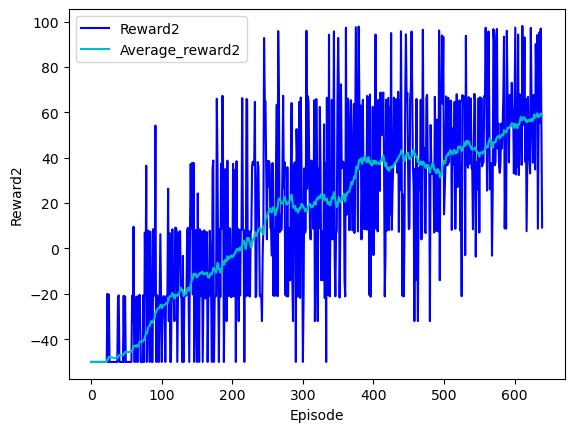

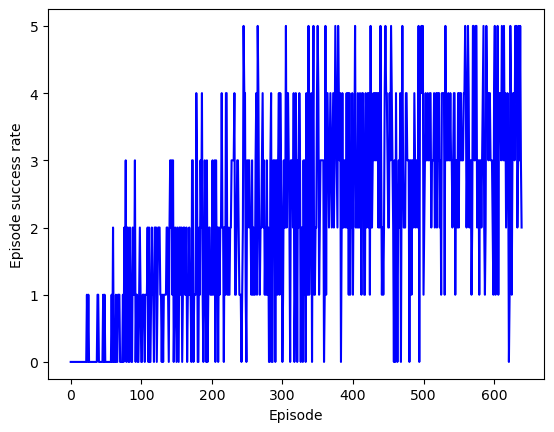

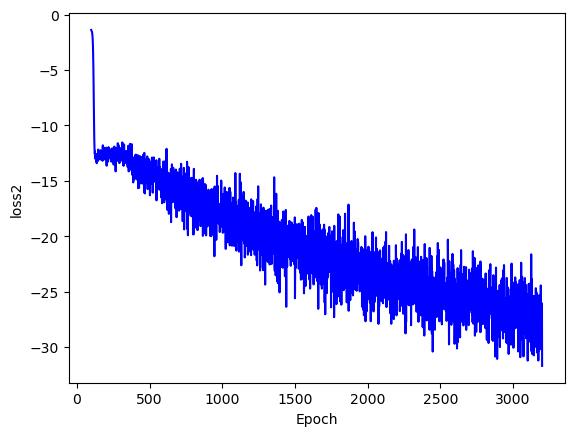

***** epoch 128 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 2ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 2 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 88644.8942506884
r_em 51789.13978998467
51789.13978998467
ReWard2/R0 10.357827957996934
reward2 is: 18.357827957996932
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step
***** frame 3 *****
1/1 

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 7 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93385.08447001014
r_em 55885.908838405354
55885.908838405354
ReWard2/R0 11.177181767681072
reward2 is: 19.17718176768107
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 8 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91434.6435952862
r_em 56465.888117221635
56465.888117221635
ReWard2/R0 11.293177623444327
reward2 is: 19.29317762344433
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 9 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 99171.86957123857
r_em 57805.92516487525
57805.92516487525
ReWard2/R0 11.561185032975049
reward2 is: 19.561185032975047
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.2110017177226736
***** epoch 128 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87831.001580617
r_em 59222.271780445546
59222.271780445546
ReWard2/R0 11.84445435608911
reward2 is: 19.84445435608911
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 11 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 87531.86176597039
r_em 55854.35642530695
55854.35642530695
ReWard2/R0 11.17087128506139
reward2 is: 19.170871285061388
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step
***** frame 12 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 88814.11599191271
r_em 55552.263747921985
55552.263747921985
ReWard2/R0 11.110452749584397
reward2 is: 19.110452749584397
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step
***** frame 13 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: opt

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 16 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80112.12496020828
r_em 52069.50115354443
52069.50115354443
ReWard2/R0 10.413900230708885
reward2 is: 18.413900230708883
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 17 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78845.57324074765
r_em 51468.80303922536
51468.80303922536
ReWard2/R0 10.293760607845071
reward2 is: 18.293760607845073
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 2ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 18 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77489.39025571536
r_em 52365.08182934934
52365.08182934934
ReWard2/R0 10.473016365869869
reward2 is: 18.473016365869867
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 19 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78070.50099994846
r_em 52467.095320651315
52467.095320651315
ReWard2/R0 10.493419064130263
reward2 is: 18.493419064130265
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.20994907974112673
***** epoch 128 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 97195.6250668721
r_em 57448.988916039496
57448.988916039496
ReWard2/R0 11.4897977832079
reward2 is: 19.489797783207898
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 21 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96724.33122184651
r_em 57545.37700556889
57545.37700556889
ReWard2/R0 11.509075401113778
reward2 is: 19.509075401113776
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 22 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 98203.5246702481
r_em 57699.73023241917
57699.73023241917
ReWard2/R0 11.539946046483834
reward2 is: 19.539946046483834
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 23 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 97640.13281897738
r_em 57043.12385781052
57043.12385781052
ReWard2/R0 11.408624771562105
reward2 is: 19.408624771562103
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 24 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 97880.78777085294
r_em 56855.100873621835
56855.100873621835
ReWard2/R0 11.371020174724366
reward2 is: 19.371020174724364
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.20942473165210254


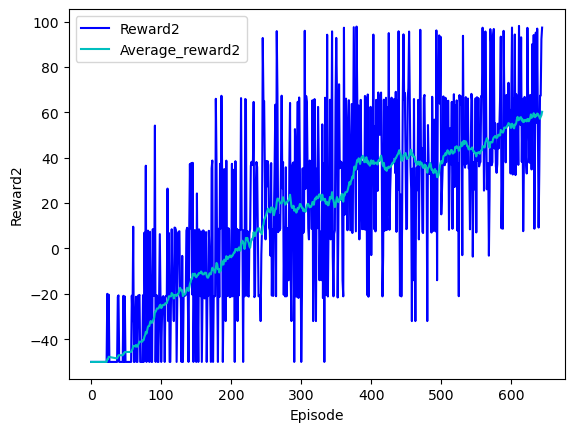

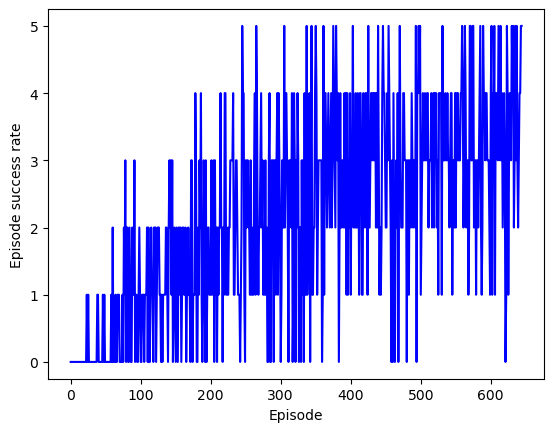

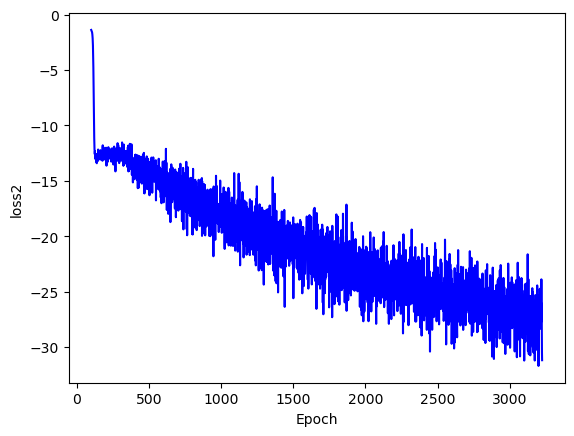

***** epoch 129 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 96378.67464658679
r_em 55048.02677514087
55048.02677514087
ReWard2/R0 11.009605355028175
reward2 is: 19.009605355028175
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step
***** frame 1 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 96091.1279847144
r_em 54493.34791486502
54493.34791486502
ReWard2/R0 10.898669582973005
reward2 is: 18.898669582973007
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step
***** frame 2 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.208901693123086
***** epoch 129 episode 1 *****
***** frame 5 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 6 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77926.25739630562
r_em 56817.00028092455
56817.00028092455
ReWard2/R0 11.36340005618491
reward2 is: 19.363400056184908
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 7 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 8 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 72884.08806548174
r_em 55757.8358519554
55757.8358519554
ReWard2/R0 11.15156717039108
reward2 is: 19.151567170391083
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 9 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 72761.88825662786
r_em 56477.90076103042
56477.90076103042
ReWard2/R0 11.295580152206083
reward2 is: 19.295580152206085
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.20837996088344932
***** epoch 129 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86780.5396838458
r_em 52203.01373573043
52203.01373573043
ReWard2/R0 10.440602747146086
reward2 is: 18.440602747146087
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 11 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88076.66322817217
r_em 55405.65644665458
55405.65644665458
ReWard2/R0 11.081131289330916
reward2 is: 19.081131289330916
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 12 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88546.25686345967
r_em 56367.013000723
56367.013000723
ReWard2/R0 11.2734026001446
reward2 is: 19.2734026001446
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 13 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 14 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88625.31472044704
r_em 57358.36400666655
57358.36400666655
ReWard2/R0 11.471672801333309
reward2 is: 19.47167280133331
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.20785953167073312
***** epoch 129 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82188.09003343483
r_em 54679.90552374388
54679.90552374388
ReWard2/R0 10.935981104748777
reward2 is: 18.935981104748777
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 16 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82595.35879780736
r_em 54594.35567552289
54594.35567552289
ReWard2/R0 10.91887113510458
reward2 is: 18.91887113510458
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 17 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82823.37291374836
r_em 54817.1112255575
54817.1112255575
ReWard2/R0 10.9634222451115
reward2 is: 18.963422245111502
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 18 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84154.88896275562
r_em 54984.48415598261
54984.48415598261
ReWard2/R0 10.996896831196521
reward2 is: 18.996896831196523
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 19 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86119.6617977655
r_em 54958.73931855828
54958.73931855828
ReWard2/R0 10.991747863711655
reward2 is: 18.991747863711655
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.20734040223062608
***** epoch 129 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85111.82953905434
r_em 61358.41856265756
61358.41856265756
ReWard2/R0 12.271683712531512
reward2 is: 20.271683712531512
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 21 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85753.45327442516
r_em 56633.853621679285
56633.853621679285
ReWard2/R0 11.326770724335857
reward2 is: 19.32677072433586
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 22 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84588.53207486696
r_em 56449.65344556926
56449.65344556926
ReWard2/R0 11.289930689113852
reward2 is: 19.289930689113852
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 23 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85965.55573328008
r_em 56295.16860507477
56295.16860507477
ReWard2/R0 11.259033721014953
reward2 is: 19.25903372101495
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 24 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86162.36556487056
r_em 55503.39610269886
55503.39610269886
ReWard2/R0 11.100679220539773
reward2 is: 19.100679220539774
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.20682256931694443


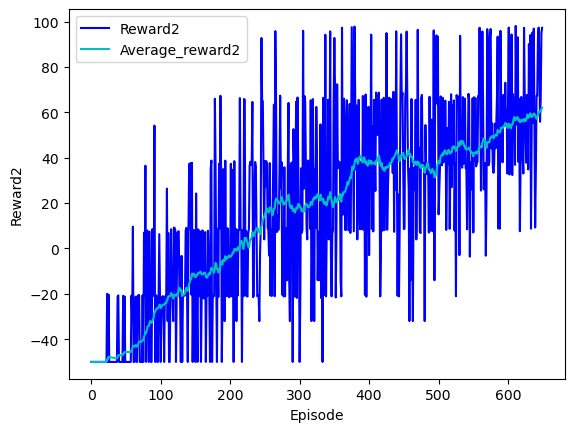

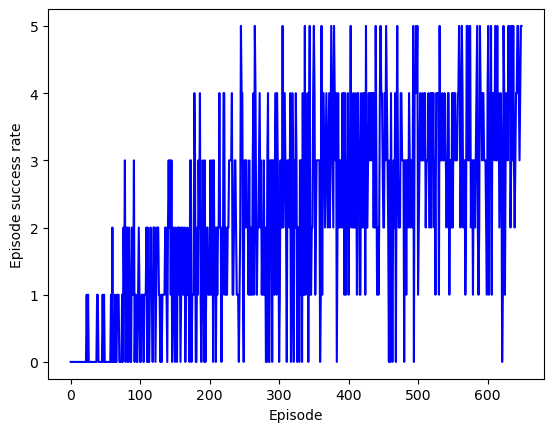

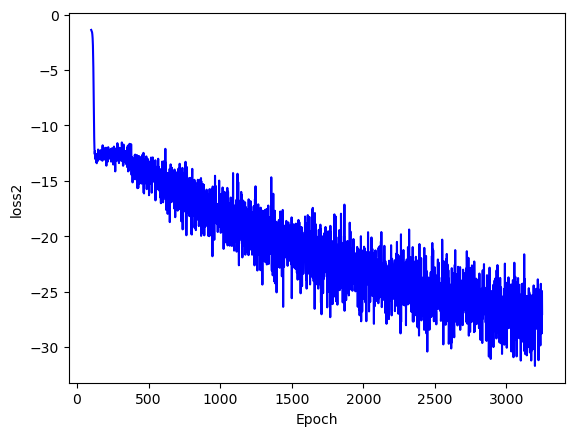

***** epoch 130 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94782.07001066054
r_em 54791.653179946574
54791.653179946574
ReWard2/R0 10.958330635989315
reward2 is: 18.958330635989313
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 1 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93279.30177414269
r_em 54214.85250418414
54214.85250418414
ReWard2/R0 10.84297050083683
reward2 is: 18.842970500836827
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 2 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93615.96802210798
r_em 54731.21836034835
54731.21836034835
ReWard2/R0 10.94624367206967
reward2 is: 18.94624367206967
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 3 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93018.31407590228
r_em 54014.29367260497
54014.29367260497
ReWard2/R0 10.802858734520994
reward2 is: 18.802858734520996
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 4 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91112.38413651666
r_em 54214.06399130228
54214.06399130228
ReWard2/R0 10.842812798260457
reward2 is: 18.842812798260457
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.2063060296916118
***** epoch 130 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88773.19368888649
r_em 56518.65784908759
56518.65784908759
ReWard2/R0 11.303731569817518
reward2 is: 19.30373156981752
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 6 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89748.10803502853
r_em 56278.40608603058
56278.40608603058
ReWard2/R0 11.255681217206117
reward2 is: 19.255681217206117
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 7 *****
1/1 [==============================] - 0s 39ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91002.23490448289
r_em 55116.37313399981
55116.37313399981
ReWard2/R0 11.023274626799962
reward2 is: 19.02327462679996
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 8 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91900.166641981
r_em 54796.86066477028
54796.86066477028
ReWard2/R0 10.959372132954057
reward2 is: 18.95937213295406
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 9 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91985.91777175639
r_em 54294.27664034815
54294.27664034815
ReWard2/R0 10.85885532806963
reward2 is: 18.85885532806963
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.20579078012463903
***** epoch 130 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 11 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 12 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 13 *****
1/1 [==============================] - 0s 22ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 16 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83499.32888829306
r_em 56732.73655997279
56732.73655997279
ReWard2/R0 11.34654731199456
reward2 is: 19.34654731199456
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 17 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82928.8110242195
r_em 57030.502770347135
57030.502770347135
ReWard2/R0 11.406100554069427
reward2 is: 19.406100554069425
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 18 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83543.92132572648
r_em 56701.880868060085
56701.880868060085
ReWard2/R0 11.340376173612016
reward2 is: 19.340376173612015
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 19 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 83796.96402129854
r_em 57165.368931336925
57165.368931336925
ReWard2/R0 11.433073786267386
reward2 is: 19.433073786267386
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.20476413828613005
***** epoch 130 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88998.41547899593
r_em 54421.431385916374
54421.431385916374
ReWard2/R0 10.884286277183275
reward2 is: 18.884286277183275
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 21 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89388.47669550296
r_em 54711.782065366635
54711.782065366635
ReWard2/R0 10.942356413073327
reward2 is: 18.942356413073327
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 22 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90401.09383024683
r_em 54375.63509868443
54375.63509868443
ReWard2/R0 10.875127019736887
reward2 is: 18.875127019736887
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 23 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89467.97180899681
r_em 52866.92917923299
52866.92917923299
ReWard2/R0 10.573385835846597
reward2 is: 18.573385835846597
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 24 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.20425273959486928


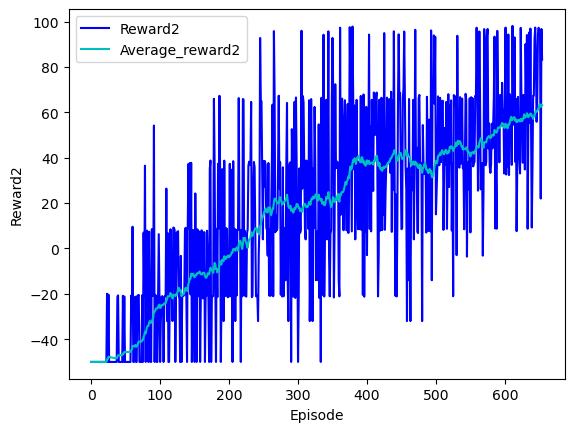

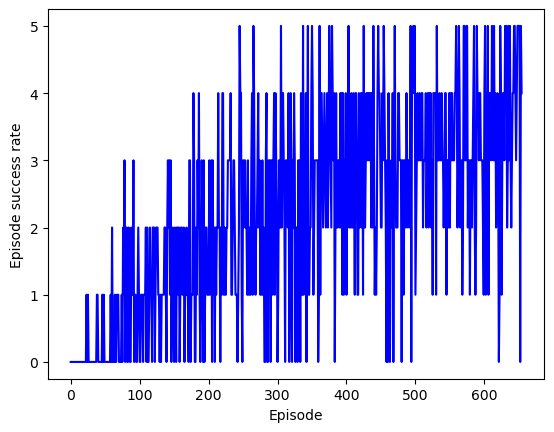

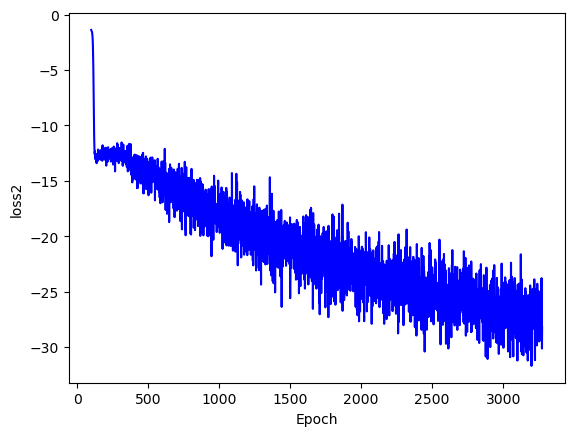

***** epoch 131 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 2 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 101464.17524491303
r_em 53793.752894723984
53793.752894723984
ReWard2/R0 10.758750578944797
reward2 is: 18.7587505789448
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 4 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 99953.56281032946
r_em 53643.09590886832
53643.09590886832
ReWard2/R0 10.728619181773665
reward2 is: 18.728619181773666
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.20374261812247907
***** epoch 131 episode 1 *****
***** frame 5 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 6 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 7 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 8 *****
1/1 [==============================] - 0s 25m

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 9 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.20323377067910361
***** epoch 131 episode 2 *****
***** frame 10 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 11 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89753.57906941196
r_em 53653.58740571996
53653.58740571996
ReWard2/R0 10.730717481143992
reward2 is: 18.73071748114399
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 12 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90576.68907757054
r_em 54065.27218129978
54065.27218129978
ReWard2/R0 10.813054436259955
reward2 is: 18.813054436259954
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 13 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92079.43071930666
r_em 54753.08739738881
54753.08739738881
ReWard2/R0 10.950617479477762
reward2 is: 18.950617479477764
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 14 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.2027261940828539
***** epoch 131 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96190.94416201454
r_em 57816.89461567479
57816.89461567479
ReWard2/R0 11.563378923134959
reward2 is: 19.56337892313496
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 16 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 98445.30740798413
r_em 55729.525281826
55729.525281826
ReWard2/R0 11.1459050563652
reward2 is: 19.1459050563652
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 17 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 18 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 99682.91298611414
r_em 56298.384178182176
56298.384178182176
ReWard2/R0 11.259676835636435
reward2 is: 19.259676835636434
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 19 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96990.55552847455
r_em 56351.597702196756
56351.597702196756
ReWard2/R0 11.27031954043935
reward2 is: 19.270319540439353
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.20221988515978762
***** epoch 131 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90298.92467140502
r_em 55779.851111686374
55779.851111686374
ReWard2/R0 11.155970222337274
reward2 is: 19.155970222337274
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 21 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90200.455241297
r_em 55835.10099566023
55835.10099566023
ReWard2/R0 11.167020199132045
reward2 is: 19.167020199132047
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 22 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 23 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 24 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88795.81789699514
r_em 57159.456259581464
57159.456259581464
ReWard2/R0 11.431891251916293
reward2 is: 19.43189125191629
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.20171484074388943


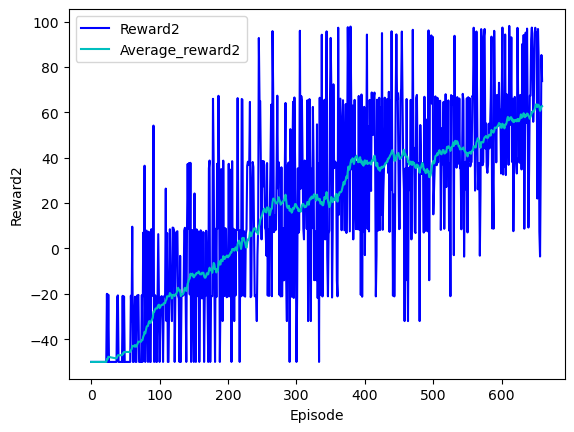

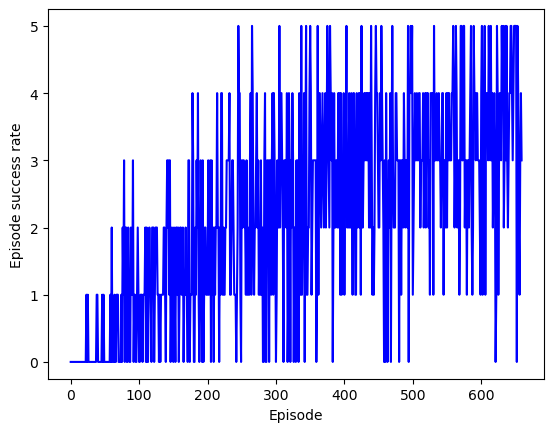

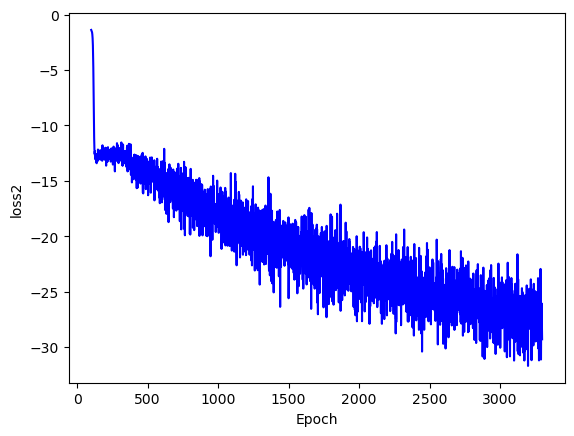

***** epoch 132 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 1 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 3 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Outpu

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 6 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79075.51696565298
r_em 56156.59076168161
56156.59076168161
ReWard2/R0 11.231318152336323
reward2 is: 19.23131815233632
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 7 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78451.29543789377
r_em 56237.886017829835
56237.886017829835
ReWard2/R0 11.247577203565967
reward2 is: 19.247577203565967
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 8 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 9 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77042.11396027918
r_em 56776.81926183719
56776.81926183719
ReWard2/R0 11.355363852367438
reward2 is: 19.35536385236744
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.20070853280905182
***** epoch 132 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 11 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 12 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
*

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 16 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80540.69316105742
r_em 56470.0374600264
56470.0374600264
ReWard2/R0 11.29400749200528
reward2 is: 19.294007492005278
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 17 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80341.27892673358
r_em 56296.40269234043
56296.40269234043
ReWard2/R0 11.259280538468087
reward2 is: 19.259280538468087
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 18 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 19 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77892.91598023626
r_em 56333.56677185106
56333.56677185106
ReWard2/R0 11.266713354370212
reward2 is: 19.26671335437021
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.1997072451080055
***** epoch 132 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 21 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83529.54979917165
r_em 55407.700111124956
55407.700111124956
ReWard2/R0 11.08154002222499
reward2 is: 19.081540022224992
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 22 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82719.60646207875
r_em 53953.25714622454
53953.25714622454
ReWard2/R0 10.790651429244908
reward2 is: 18.79065142924491
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 23 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83980.71858877197
r_em 54239.26342449345
54239.26342449345
ReWard2/R0 10.84785268489869
reward2 is: 18.84785268489869
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 24 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82804.31329842162
r_em 53673.788450470085
53673.788450470085
ReWard2/R0 10.734757690094018
reward2 is: 18.734757690094018
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.19920847601377664


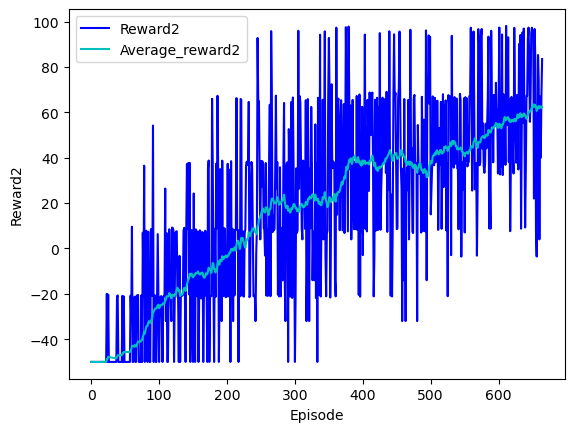

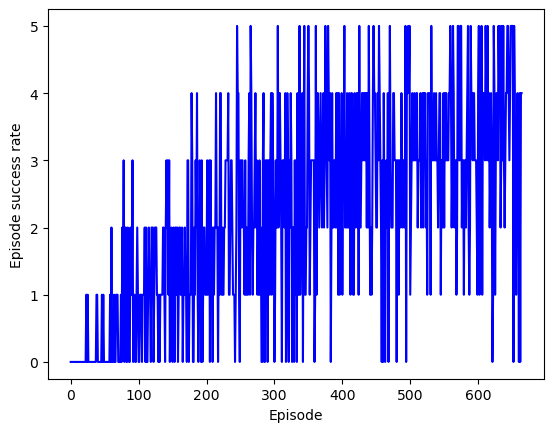

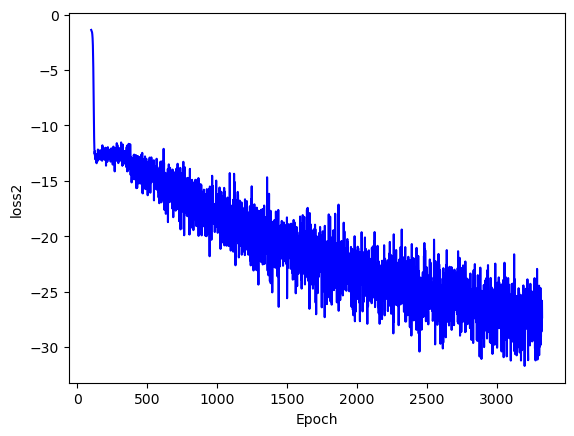

***** epoch 133 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 96785.70064232312
r_em 55686.527829166116
55686.527829166116
ReWard2/R0 11.137305565833223
reward2 is: 19.137305565833223
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 2 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 96294.20007094808
r_em 55962.63091083355
55962.63091083355
ReWard2/R0 11.19252618216671
reward2 is: 19.19252618216671
total number of ur2 RB

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.19871095259598395
***** epoch 133 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 74945.16956455461
r_em 54529.83801035396
54529.83801035396
ReWard2/R0 10.905967602070792
reward2 is: 18.905967602070792
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 6 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 7 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77123.35428516622
r_em 55661.79193189528
55661.79193189528
ReWard2/R0 11.132358386379055
reward2 is: 19.132358386379053
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 8 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 9 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81911.84269379728
r_em 54651.10662909794
54651.10662909794
ReWard2/R0 10.93022132581959
reward2 is: 18.930221325819588
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.19821467174354895
***** epoch 133 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 97336.2339229944
r_em 55342.89096553403
55342.89096553403
ReWard2/R0 11.068578193106806
reward2 is: 19.068578193106806
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step
***** frame 11 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 96985.81864178032
r_em 55764.559314263606
55764.559314263606
ReWard2/R0 11.15291186285272
reward2 is: 19.15291186285272
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step
***** frame 12 *****
1/1 [==============================] - 0s 21ms/step
we

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 17 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 18 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 19 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 86543.70303842623
r_em 55349.02196322231
55349.02196322231
ReWard2/R0 11.069804392644462
reward2 is: 19.069804392644464
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 21 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85160.03872848541
r_em 55912.86695631959
55912.86695631959
ReWard2/R0 11.182573391263917
reward2 is: 19.182573391263915
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 22 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85902.01914904351
r_em 56399.96525875827
56399.96525875827
ReWard2/R0 11.279993051751653
reward2 is: 19.279993051751653
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 23 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 90464.2812564009
r_em 56447.73066907183
56447.73066907183
ReWard2/R0 11.289546133814367
reward2 is: 19.28954613381437
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step
***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.1967332535840379


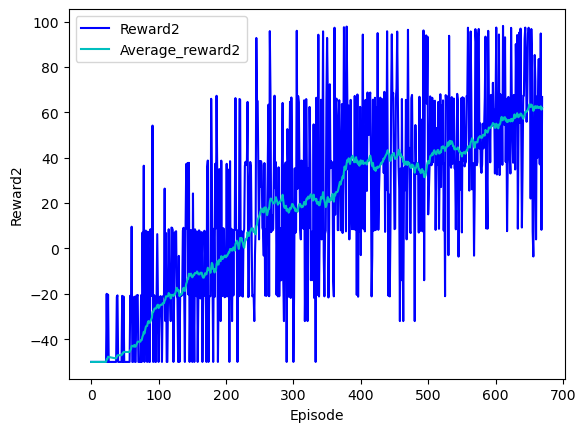

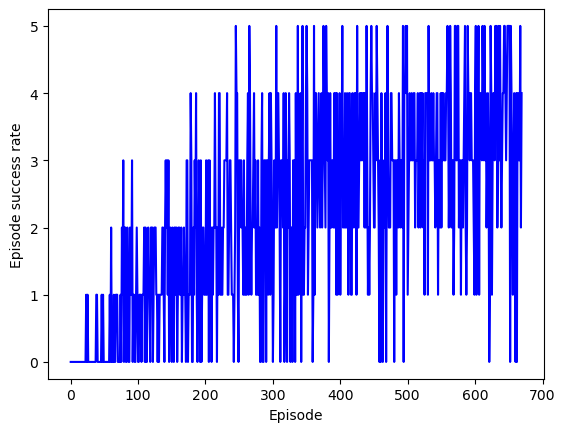

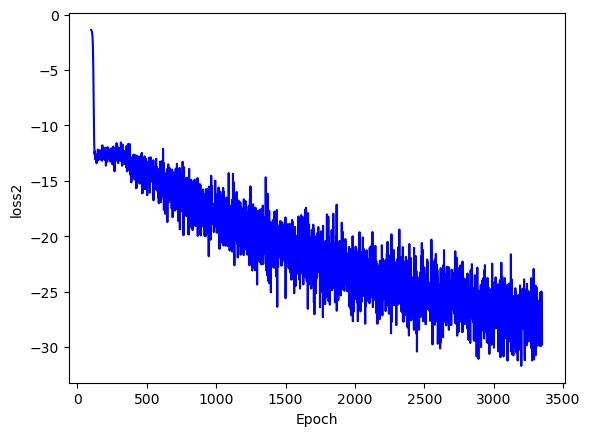

***** epoch 134 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 2 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81355.66504422479
r_em 57289.27815585051
57289.27815585051
ReWard2/R0 11.457855631170101
reward2 is: 19.4578556311701
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 3 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79477.95508214954
r_em 56946.291174028855
56946.291174028855
ReWard2/R0 11.389258234805771
reward2 is: 19.389258234805773
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 4 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78983.18889415856
r_em 57070.612609512194
57070.612609512194
ReWard2/R0 11.414122521902438
reward2 is: 19.41412252190244
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.19624191203735675
***** epoch 134 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79921.98272591691
r_em 58092.25480619114
58092.25480619114
ReWard2/R0 11.618450961238228
reward2 is: 19.618450961238228
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 6 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82609.7929946309
r_em 58408.40230602524
58408.40230602524
ReWard2/R0 11.681680461205048
reward2 is: 19.681680461205048
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 7 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82932.93216137461
r_em 58142.54884731487
58142.54884731487
ReWard2/R0 11.628509769462974
reward2 is: 19.628509769462973
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 8 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83775.36165974861
r_em 58130.416779718
58130.416779718
ReWard2/R0 11.6260833559436
reward2 is: 19.6260833559436
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 9 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84618.60525181537
r_em 58415.842578667136
58415.842578667136
ReWard2/R0 11.683168515733428
reward2 is: 19.683168515733428
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.19575179761680242
***** epoch 134 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 11 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 12 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 13 *****
w

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 17 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80780.55920173814
r_em 55662.77769476873
55662.77769476873
ReWard2/R0 11.132555538953746
reward2 is: 19.132555538953746
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 18 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82117.86072714541
r_em 55940.745752185365
55940.745752185365
ReWard2/R0 11.188149150437074
reward2 is: 19.188149150437074
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 19 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82804.88704466549
r_em 56789.37181839634
56789.37181839634
ReWard2/R0 11.357874363679269
reward2 is: 19.35787436367927
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.1947752379027324
***** epoch 134 episode 4 *****
***** frame 20 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 21 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 22 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 23 *****
we

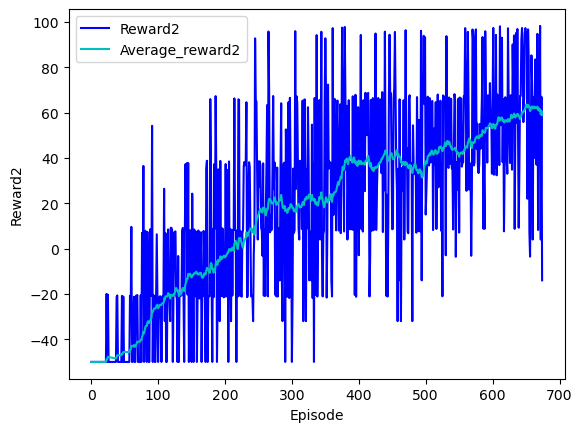

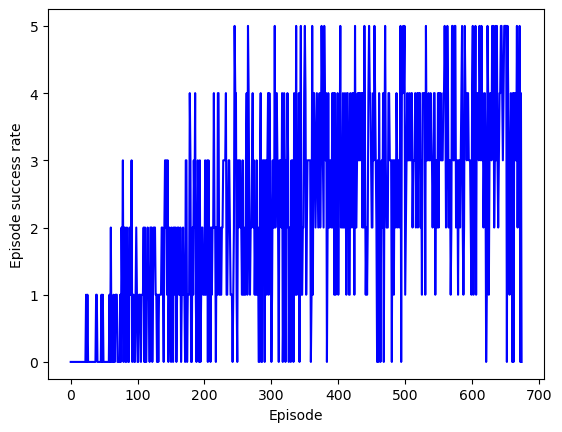

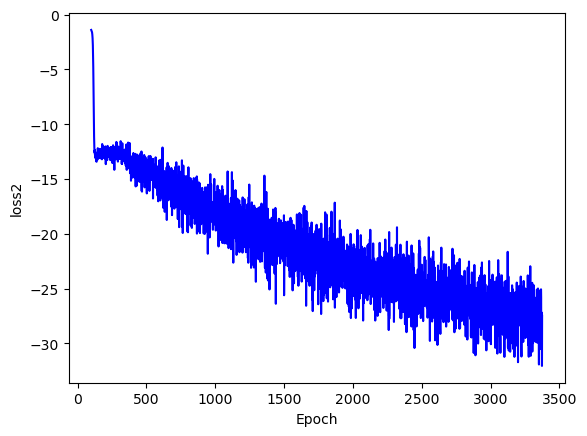

***** epoch 135 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 1 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96459.70577425236
r_em 57867.13033168861
57867.13033168861
ReWard2/R0 11.573426066337722
reward2 is: 19.573426066337724
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 2 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 97465.25791502476
r_em 57722.2579969299
57722.2579969299
ReWard2/R0 11.54445159938598
reward2 is: 19.54445159938598
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 3 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 4 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96485.19195967531
r_em 56330.47407236618
56330.47407236618
ReWard2/R0 11.266094814473236
reward2 is: 19.266094814473234
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.1938035500155716
***** epoch 135 episode 1 *****
***** frame 5 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 6 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96238.79130938229
r_em 56002.128016426126
56002.128016426126
ReWard2/R0 11.200425603285225
reward2 is: 19.200425603285225
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 7 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96564.08454525615
r_em 55844.95856939864
55844.95856939864
ReWard2/R0 11.168991713879727
reward2 is: 19.168991713879727
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 8 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 9 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.19331952540721387
***** epoch 135 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94014.84979586801
r_em 53066.340740350104
53066.340740350104
ReWard2/R0 10.61326814807002
reward2 is: 18.61326814807002
total number of ur2 RBs: 8.0
tot

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 11 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 12 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 13 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 14 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 16 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91638.90683341588
r_em 56698.61429172432
56698.61429172432
ReWard2/R0 11.339722858344864
reward2 is: 19.339722858344864
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 17 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91819.12207294093
r_em 56340.64240891042
56340.64240891042
ReWard2/R0 11.268128481782083
reward2 is: 19.268128481782085
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 18 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92808.67290376376
r_em 56586.06569602831
56586.06569602831
ReWard2/R0 11.317213139205661
reward2 is: 19.317213139205663
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 19 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93658.27638013149
r_em 56856.8823406967
56856.8823406967
ReWard2/R0 11.37137646813934
reward2 is: 19.37137646813934
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.19235509972758166
***** epoch 135 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92434.88993754059
r_em 52959.043361714415
52959.043361714415
ReWard2/R0 10.591808672342884
reward2 is: 18.591808672342886
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 21 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92504.03253111077
r_em 53976.56868274609
53976.56868274609
ReWard2/R0 10.795313736549218
reward2 is: 18.795313736549218
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 22 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92071.18753958838
r_em 53270.07733942247
53270.07733942247
ReWard2/R0 10.654015467884493
reward2 is: 18.65401546788449
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 23 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92875.80565709216
r_em 54097.98275447551
54097.98275447551
ReWard2/R0 10.819596550895103
reward2 is: 18.819596550895103
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.19187469262562828


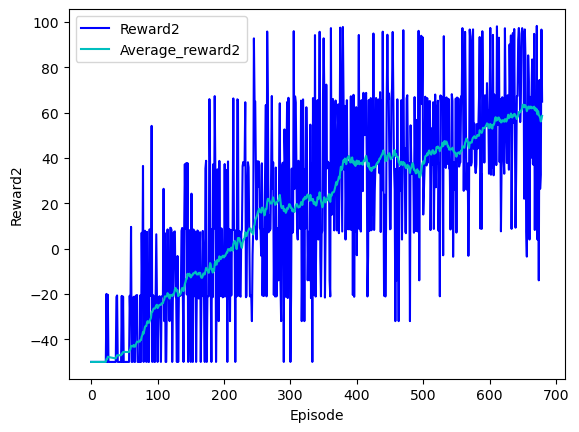

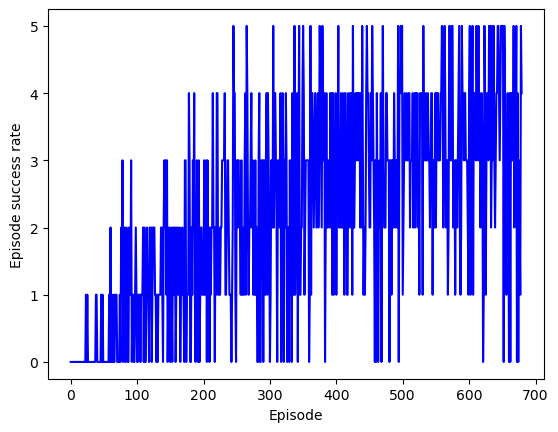

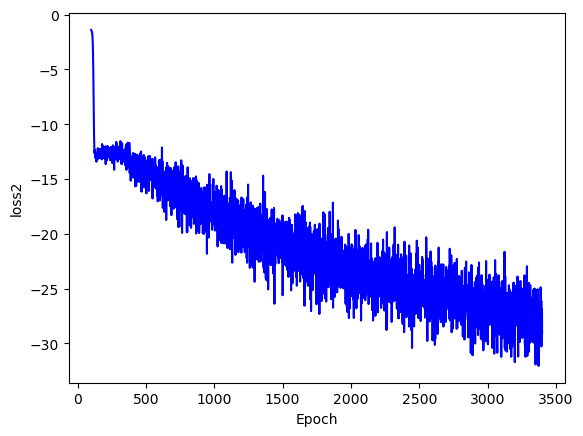

***** epoch 136 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 1 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 71664.23769920017
r_em 59007.508039273904
59007.508039273904
ReWard2/R0 11.80150160785478
reward2 is: 19.80150160785478
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 2 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 70520.03190798135
r_em 58290.57800104893
58290.57800104893
ReWard2/R0 11.658115600209786
reward2 is: 19.658115600209786
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 3 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 4 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 70578.00513323462
r_em 58153.20201698414
58153.20201698414
ReWard2/R0 11.630640403396828
reward2 is: 19.63064040339683
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.19139548534101242
***** epoch 136 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 73302.59704697577
r_em 51432.90258848296
51432.90258848296
ReWard2/R0 10.286580517696592
reward2 is: 18.286580517696592
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 6 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77919.46253431962
r_em 52024.49335801375
52024.49335801375
ReWard2/R0 10.40489867160275
reward2 is: 18.40489867160275
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 7 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78745.96389080203
r_em 51750.535571996705
51750.535571996705
ReWard2/R0 10.350107114399341
reward2 is: 18.350107114399343
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 8 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80426.45497007489
r_em 51094.97905394945
51094.97905394945
ReWard2/R0 10.21899581078989
reward2 is: 18.21899581078989
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 9 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84908.56955670098
r_em 51693.96781120735
51693.96781120735
ReWard2/R0 10.33879356224147
reward2 is: 18.33879356224147
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.19091747487718877
***** epoch 136 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81783.90452552742
r_em 52468.67472849766
52468.67472849766
ReWard2/R0 10.493734945699531
reward2 is: 18.49373494569953
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 11 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85444.3712393517
r_em 53095.500318033766
53095.500318033766
ReWard2/R0 10.619100063606753
reward2 is: 18.61910006360675
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 12 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 13 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87323.86714289484
r_em 52363.48737489131
52363.48737489131
ReWard2/R0 10.472697474978261
reward2 is: 18.47269747497826
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 14 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89492.55801941604
r_em 53157.8389523484
53157.8389523484
ReWard2/R0 10.63156779046968
reward2 is: 18.63156779046968
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.19044065824509587
***** epoch 136 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89817.09838195
r_em 52720.740435052474
52720.740435052474
ReWard2/R0 10.544148087010495
reward2 is: 18.544148087010495
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 16 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92523.09583535595
r_em 52115.63286393445
52115.63286393445
ReWard2/R0 10.42312657278689
reward2 is: 18.42312657278689
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 17 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89130.518074542
r_em 52973.70350780531
52973.70350780531
ReWard2/R0 10.594740701561062
reward2 is: 18.59474070156106
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 18 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91093.22361048404
r_em 54140.73130795647
54140.73130795647
ReWard2/R0 10.828146261591295
reward2 is: 18.828146261591293
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 19 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.18996503246313748
***** epoch 136 episode 4 *****
***** frame 20 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 21 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89707.5177818645
r_em 55710.99554615276
55710.99554615276
ReWard2/R0 11.142199109230551
reward2 is: 19.142199109230553
total number of ur2 RBs: 8.0
total number of em2 RBs

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 23 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91788.19401076128
r_em 55444.240390355626
55444.240390355626
ReWard2/R0 11.088848078071125
reward2 is: 19.088848078071123
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 24 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87282.25098775241
r_em 55553.87320923327
55553.87320923327
ReWard2/R0 11.110774641846655
reward2 is: 19.110774641846653
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.18949059455716394


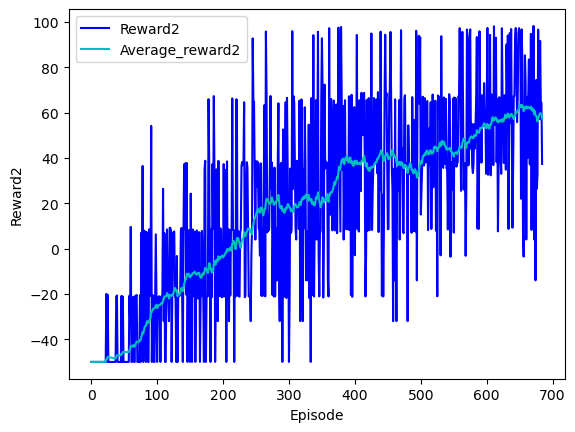

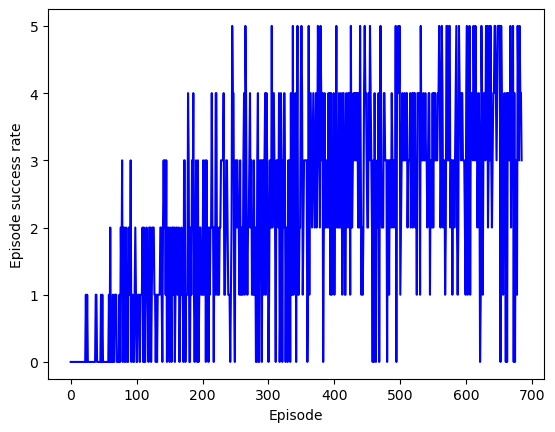

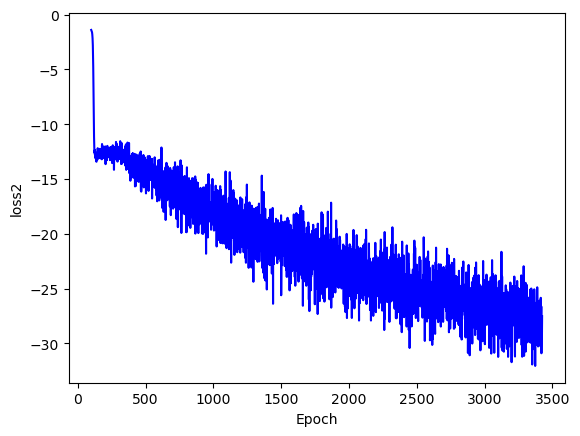

***** epoch 137 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84831.16964048501
r_em 54421.71640234547
54421.71640234547
ReWard2/R0 10.884343280469093
reward2 is: 18.884343280469093
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 1 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84582.26107170996
r_em 54472.27301048086
54472.27301048086
ReWard2/R0 10.894454602096172
reward2 is: 18.89445460209617
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 2 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85460.6751817321
r_em 53656.77060347407
53656.77060347407
ReWard2/R0 10.731354120694814
reward2 is: 18.731354120694814
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 3 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86550.30763544611
r_em 54685.59094427918
54685.59094427918
ReWard2/R0 10.937118188855836
reward2 is: 18.937118188855834
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 4 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86506.44819628383
r_em 54998.667148577435
54998.667148577435
ReWard2/R0 10.999733429715487
reward2 is: 18.999733429715487
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.18901734156045344
***** epoch 137 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81451.06382912499
r_em 59980.796924375216
59980.796924375216
ReWard2/R0 11.996159384875043
reward2 is: 19.996159384875043
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 6 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80801.04613150934
r_em 54732.463775933174
54732.463775933174
ReWard2/R0 10.946492755186634
reward2 is: 18.946492755186632
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 7 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79723.89422199299
r_em 54788.06299305758
54788.06299305758
ReWard2/R0 10.957612598611517
reward2 is: 18.95761259861152
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 8 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80378.56348197369
r_em 54968.275306635594
54968.275306635594
ReWard2/R0 10.993655061327118
reward2 is: 18.993655061327118
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 9 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80394.21611801916
r_em 54199.54070240385
54199.54070240385
ReWard2/R0 10.83990814048077
reward2 is: 18.83990814048077
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.18854527051369363
***** epoch 137 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92449.03679189685
r_em 56192.33890670136
56192.33890670136
ReWard2/R0 11.238467781340272
reward2 is: 19.238467781340272
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 11 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90648.80857479395
r_em 55816.794817331865
55816.794817331865
ReWard2/R0 11.163358963466374
reward2 is: 19.163358963466372
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 12 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90501.69038162724
r_em 55972.7986204917
55972.7986204917
ReWard2/R0 11.19455972409834
reward2 is: 19.19455972409834
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 13 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89701.91630166833
r_em 56216.06438540037
56216.06438540037
ReWard2/R0 11.243212877080074
reward2 is: 19.243212877080076
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 14 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87043.20714295768
r_em 56417.24503411166
56417.24503411166
ReWard2/R0 11.283449006822332
reward2 is: 19.28344900682233
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.18807437846496305
***** epoch 137 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 86411.9994277948
r_em 52075.592746180395
52075.592746180395
ReWard2/R0 10.415118549236078
reward2 is: 18.415118549236077
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step
***** frame 16 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 87545.42885329413
r_em 52050.866491940025
52050.866491940025
ReWard2/R0 10.410173298388004
reward2 is: 18.410173298388003
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step
***** frame 17 *****
1/1 [==============================] - 0s 21ms/ste

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 22 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83106.88480782043
r_em 52058.94872058582
52058.94872058582
ReWard2/R0 10.411789744117163
reward2 is: 18.411789744117165
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 23 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83843.02312483889
r_em 52070.730162164335
52070.730162164335
ReWard2/R0 10.414146032432868
reward2 is: 18.414146032432868
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 24 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86418.42306277866
r_em 50911.42597781139
50911.42597781139
ReWard2/R0 10.182285195562278
reward2 is: 18.18228519556228
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.18713611959074739


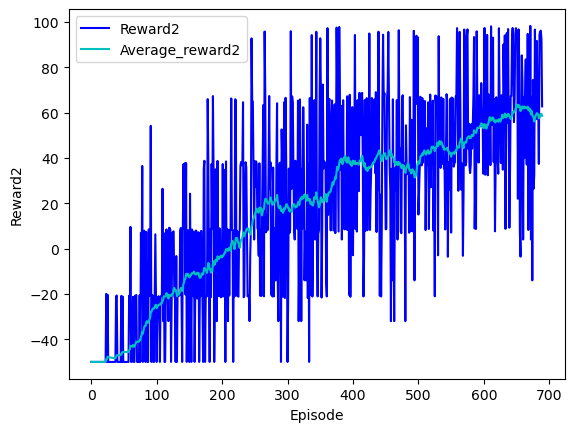

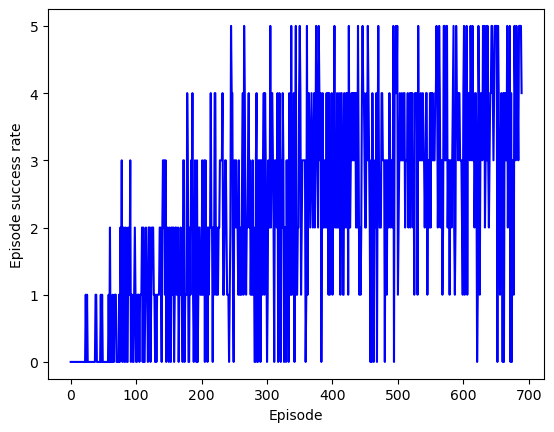

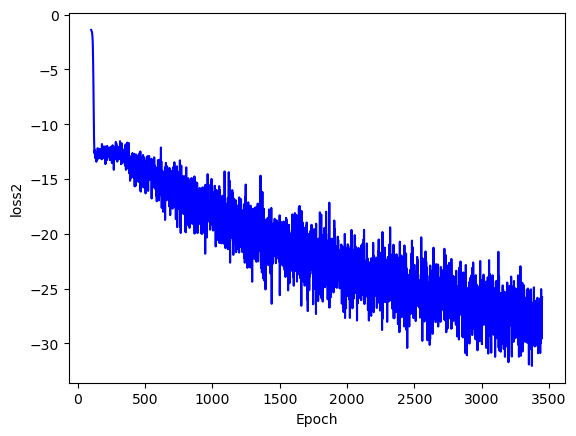

***** epoch 138 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 85745.38326104658
r_em 47854.268603384844
47854.268603384844
ReWard2/R0 9.570853720676968
reward2 is: 17.57085372067697
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step
***** frame 1 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 2 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [============================

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 6 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 86605.81081766814
r_em 53385.45951110973
53385.45951110973
ReWard2/R0 10.677091902221946
reward2 is: 18.677091902221946
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step
***** frame 7 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83935.63747794527
r_em 54148.76114206122
54148.76114206122
ReWard2/R0 10.829752228412245
reward2 is: 18.829752228412246
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 8 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 9 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 85219.48689177999
r_em 53056.79199738152
53056.79199738152
ReWard2/R0 10.611358399476304
reward2 is: 18.611358399476302
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.18620254146955204
***** epoch 138 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84456.18689687792
r_em 56151.14669902226
5

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 11 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84197.00787476759
r_em 56195.92861898388
56195.92861898388
ReWard2/R0 11.239185723796776
reward2 is: 19.239185723796776
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 12 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82912.93936402522
r_em 56224.541008901986
56224.541008901986
ReWard2/R0 11.244908201780397
reward2 is: 19.244908201780397
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 13 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82781.85905554488
r_em 55095.972494061185
55095.972494061185
ReWard2/R0 11.019194498812237
reward2 is: 19.019194498812237
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 14 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84801.93664870207
r_em 54824.45398724338
54824.45398724338
ReWard2/R0 10.964890797448676
reward2 is: 18.964890797448675
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.18573750038953687
***** epoch 138 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86129.13218890113
r_em 57195.16615529905
57195.16615529905
ReWard2/R0 11.43903323105981
reward2 is: 19.43903323105981
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 16 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85131.02213075376
r_em 57354.11240589944
57354.11240589944
ReWard2/R0 11.470822481179887
reward2 is: 19.470822481179887
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 17 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84892.53616979117
r_em 57640.70687720779
57640.70687720779
ReWard2/R0 11.528141375441558
reward2 is: 19.528141375441557
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 18 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84874.86607606223
r_em 57518.78284116593
57518.78284116593
ReWard2/R0 11.503756568233186
reward2 is: 19.503756568233186
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 19 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84686.92651767374
r_em 57029.48850871051
57029.48850871051
ReWard2/R0 11.405897701742102
reward2 is: 19.405897701742102
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.1852736207502002
***** epoch 138 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87495.02789187914
r_em 54057.89748448148
54057.89748448148
ReWard2/R0 10.811579496896297
reward2 is: 18.811579496896297
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 21 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 22 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89231.00608532525
r_em 53992.13640599578
53992.13640599578
ReWard2/R0 10.798427281199155
reward2 is: 18.798427281199153
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 23 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88777.2237851843
r_em 54874.46203445551
54874.46203445551
ReWard2/R0 10.974892406891101
reward2 is: 18.9748924068911
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 24 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.1848108996508425


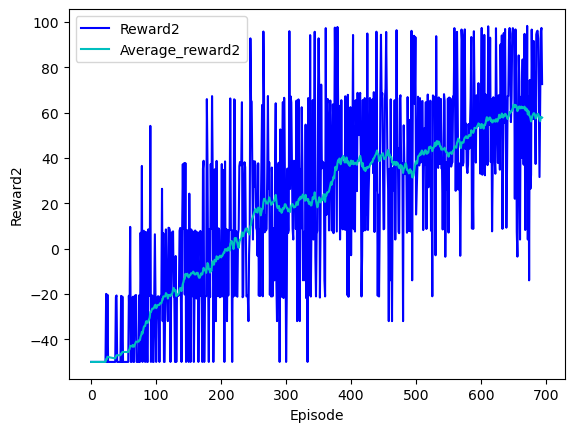

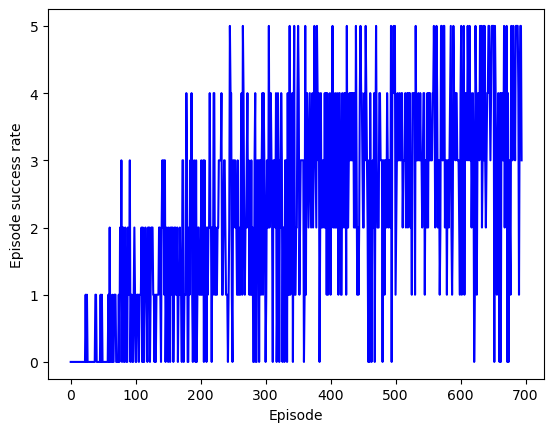

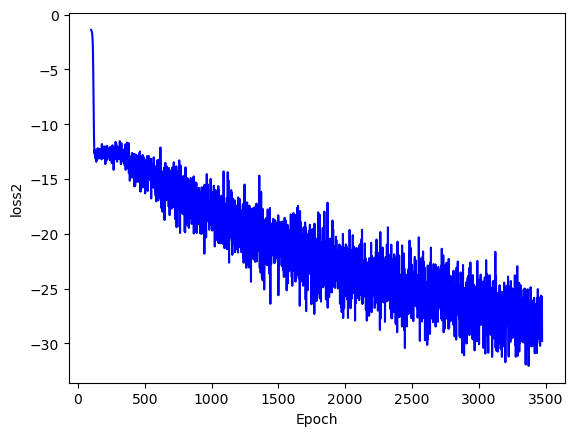

***** epoch 139 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87618.11058115141
r_em 59750.85105082908
59750.85105082908
ReWard2/R0 11.950170210165815
reward2 is: 19.950170210165815
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 1 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83560.05621589712
r_em 59764.121188677345
59764.121188677345
ReWard2/R0 11.952824237735468
reward2 is: 19.95282423773547
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 2 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86381.53473110631
r_em 59476.18236748845
59476.18236748845
ReWard2/R0 11.89523647349769
reward2 is: 19.89523647349769
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 3 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88509.34048899027
r_em 58671.92878764259
58671.92878764259
ReWard2/R0 11.734385757528518
reward2 is: 19.734385757528518
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 4 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.18434933419800867
***** epoch 139 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93723.82178088254
r_em 56715.31334957679
56715.31334957679
ReWard2/R0 11.343062669915358
reward2 is: 19.34306266991536
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 6 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92840.36696046483
r_em 56389.23774662986
56389.23774662986
ReWard2/R0 11.277847549325971
reward2 is: 19.27784754932597
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 7 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 8 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92907.26453919889
r_em 56350.78777838378
56350.78777838378
ReWard2/R0 11.270157555676757
reward2 is: 19.270157555676757
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 9 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91247.72608431207
r_em 55362.73784532116
55362.73784532116
ReWard2/R0 11.07254756906423
reward2 is: 19.07254756906423
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.18388892150547012
***** epoch 139 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77265.35561874846
r_em 56407.64816187874
56407.64816187874
ReWard2/R0 11.281529632375747
reward2 is: 19.281529632375747
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 11 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79468.34787493093
r_em 56255.54871854606
56255.54871854606
ReWard2/R0 11.251109743709211
reward2 is: 19.25110974370921
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 12 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 13 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 14 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78359.92910686739
r_em 54719.776414109925
54719.776414109925
ReWard2/R0 10.943955282821985
reward2 is: 18.943955282821985
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.....

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.18342965869420658
***** epoch 139 episode 3 *****
***** frame 15 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 16 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 89437.39585240293
r_em 55455.1063739465
55455.1063739465
ReWard2/R0 11.0910212747893
reward2 is: 19.0910212747893
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step
***** frame 17 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 90401.7475471801
r_em 55007.40889438725
55007.40889438725
R

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 23 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90686.27239080952
r_em 55026.426847409544
55026.426847409544
ReWard2/R0 11.005285369481909
reward2 is: 19.00528536948191
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 24 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91549.59672500889
r_em 55019.013874794735
55019.013874794735
ReWard2/R0 11.003802774958947
reward2 is: 19.00380277495895
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
learning rate is updating...
Epsilon_hist is: 0.1825145712353572


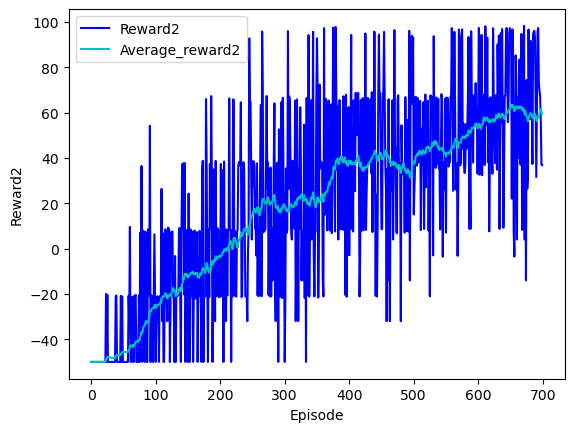

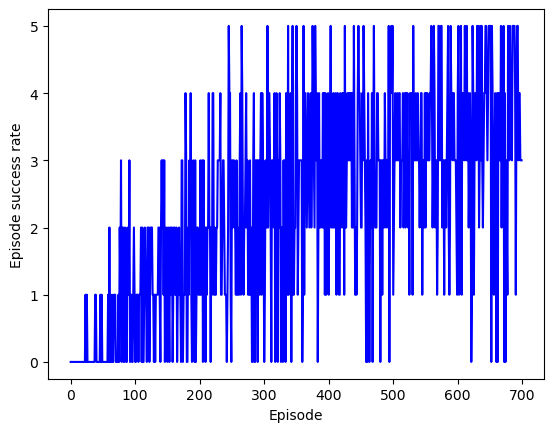

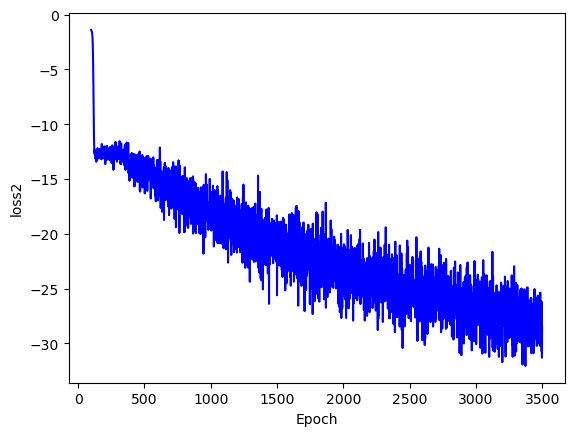

***** epoch 140 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 1 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89247.79126326347
r_em 56255.59445390232
56255.59445390232
ReWard2/R0 11.251118890780464
reward2 is: 19.251118890780464
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 3 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90158.59722100325
r_em 55597.593547558165
55597.593547558165
ReWard2/R0 11.119518709511633
reward2 is: 19.11951870951163
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 4 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 5.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.18205874086561075
***** epoch 140 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86048.74105055218
r_em 55950.795595130636
55950.795595130636
ReWard2/R0 11.190159119026127
reward2 is: 19.190159119026127
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 6 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90113.79479529528
r_em 55891.934069833405
55891.934069833405
ReWard2/R0 11.17838681396668
reward2 is: 19.178386813966682
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 7 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 8 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91037.61965852352
r_em 55373.35297735862
55373.35297735862
ReWard2/R0 11.074670595471725
reward2 is: 19.074670595471723
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 9 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.1816040489327824
***** epoch 140 episode 2 *****
***** frame 10 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 11 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 12 *****
1/1 [===============

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 13 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 14 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91300.69938252334
r_em 52523.53006890301
52523.53006890301
ReWard2/R0 10.504706013780602
reward2 is: 18.504706013780602
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.18115049259362453
***** epoch 140 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 17 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 18 *****

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.1806980690119905
***** epoch 140 episode 4 *****
***** frame 20 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 22 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95969.49097461079
r_em 54679.60263814159
54679.60263814159
ReWard2/R0 10.935920527628317
reward2 is: 18.93592052762832
total number of ur2 RBs: 8.0
total number of em2 RBs: 1

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 23 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96355.82945911273
r_em 55922.31533843397
55922.31533843397
ReWard2/R0 11.184463067686794
reward2 is: 19.184463067686792
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 24 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96708.21805619351
r_em 55200.38831317248
55200.38831317248
ReWard2/R0 11.040077662634497
reward2 is: 19.040077662634495
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.18024677535881697


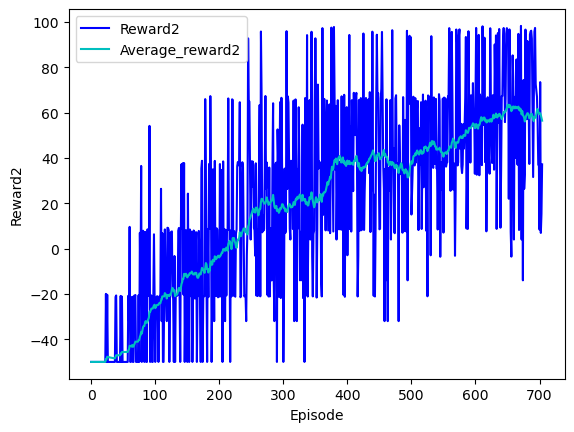

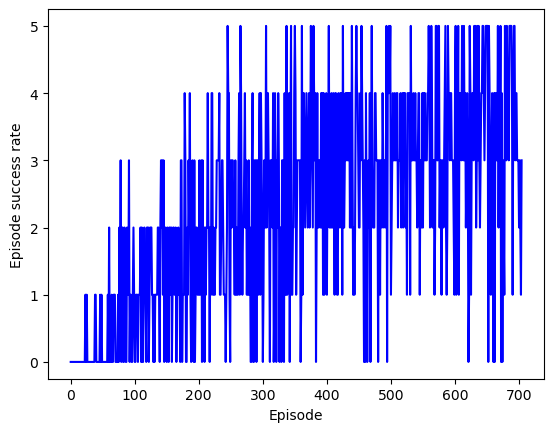

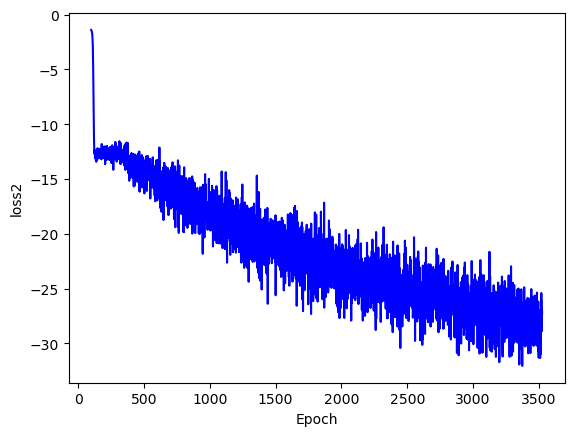

***** epoch 141 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 73572.13079777505
r_em 56668.09516396193
56668.09516396193
ReWard2/R0 11.333619032792386
reward2 is: 19.333619032792384
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 1 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 73998.3291036554
r_em 56765.25022625426
56765.25022625426
ReWard2/R0 11.353050045250852
reward2 is: 19.353050045250853
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 2 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 72390.60341042538
r_em 56546.15806075112
56546.15806075112
ReWard2/R0 11.309231612150224
reward2 is: 19.309231612150224
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 3 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 73042.69945322038
r_em 56311.85709671578
56311.85709671578
ReWard2/R0 11.262371419343156
reward2 is: 19.262371419343154
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 4 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.17979660881210627
***** epoch 141 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86485.11276587032
r_em 56398.858330267154
56398.858330267154
ReWard2/R0 11.279771666053431
reward2 is: 19.27977166605343
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 6 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87713.32846898868
r_em 56527.99354948191
56527.99354948191
ReWard2/R0 11.305598709896381
reward2 is: 19.30559870989638
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 7 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87876.27916211652
r_em 56929.28505312352
56929.28505312352
ReWard2/R0 11.385857010624704
reward2 is: 19.385857010624704
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 8 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 9 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86947.54502885297
r_em 57113.13133127918
57113.13133127918
ReWard2/R0 11.422626266255836
reward2 is: 19.422626266255836
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.1793475665569085
***** epoch 141 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91066.28270078982
r_em 58815.023077343954
58815.023077343954
ReWard2/R0 11.763004615468791
reward2 is: 19.76300461546879
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 11 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90639.85462595029
r_em 59053.77092232504
59053.77092232504
ReWard2/R0 11.810754184465008
reward2 is: 19.810754184465008
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 12 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91515.98940048773
r_em 58251.56168002914
58251.56168002914
ReWard2/R0 11.650312336005827
reward2 is: 19.650312336005825
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 13 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 98928.41214197161
r_em 58442.67784559719
58442.67784559719
ReWard2/R0 11.688535569119438
reward2 is: 19.688535569119438
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 14 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 98314.95677849728
r_em 58527.045909458415
58527.045909458415
ReWard2/R0 11.705409181891683
reward2 is: 19.70540918189168
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.17889964578530423
***** epoch 141 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82015.46755196029
r_em 53125.15975386442
53125.15975386442
ReWard2/R0 10.625031950772884
reward2 is: 18.625031950772886
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 16 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80247.9885147008
r_em 53486.86633768252
53486.86633768252
ReWard2/R0 10.697373267536504
reward2 is: 18.697373267536506
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 17 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80306.34842246691
r_em 53996.22626511315
53996.22626511315
ReWard2/R0 10.799245253022631
reward2 is: 18.799245253022633
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 18 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80133.95005901794
r_em 53137.449409789035
53137.449409789035
ReWard2/R0 10.627489881957807
reward2 is: 18.627489881957807
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 19 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78509.86425335567
r_em 52250.45885240152
52250.45885240152
ReWard2/R0 10.450091770480304
reward2 is: 18.450091770480306
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.17845284369638684
***** epoch 141 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 21 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 22 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
*

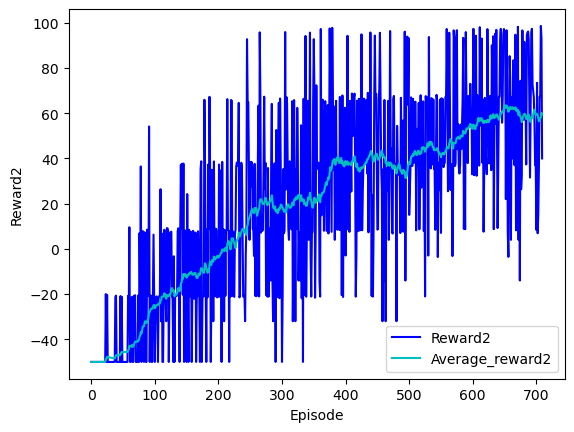

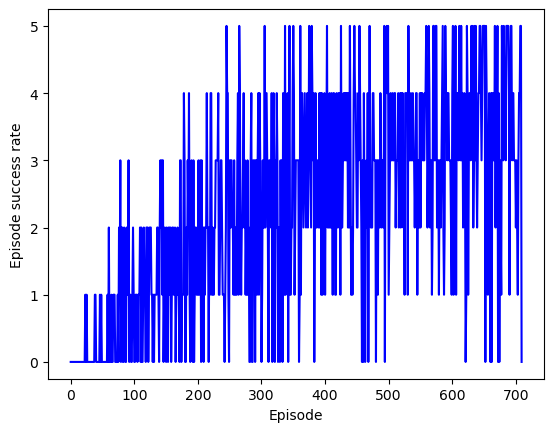

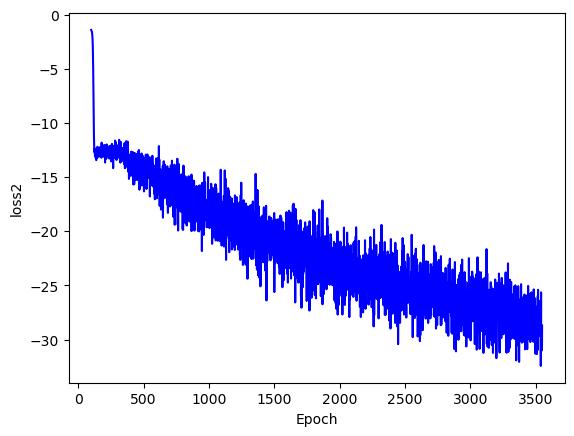

***** epoch 142 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91813.08056767494
r_em 55192.156536442315
55192.156536442315
ReWard2/R0 11.038431307288462
reward2 is: 19.038431307288462
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 1 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95181.9578300265
r_em 55087.130859150915
55087.130859150915
ReWard2/R0 11.017426171830182
reward2 is: 19.01742617183018
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 2 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90719.03031364048
r_em 55046.03313053998
55046.03313053998
ReWard2/R0 11.009206626107996
reward2 is: 19.009206626107996
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 3 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90694.08078021536
r_em 54875.4341927778
54875.4341927778
ReWard2/R0 10.97508683855556
reward2 is: 18.975086838555562
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 4 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90438.21120320176
r_em 55593.0063317298
55593.0063317298
ReWard2/R0 11.118601266345959
reward2 is: 19.11860126634596
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.17756258439794476
***** epoch 142 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81449.43555398102
r_em 58717.39457807254
58717.39457807254
ReWard2/R0 11.743478915614508
reward2 is: 19.74347891561451
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 6 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80772.6726519585
r_em 58558.42890380744
58558.42890380744
ReWard2/R0 11.711685780761488
reward2 is: 19.71168578076149
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 7 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 76266.22899943373
r_em 58954.00370533205
58954.00370533205
ReWard2/R0 11.790800741066409
reward2 is: 19.79080074106641
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 8 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79371.18568229418
r_em 59457.14176591463
59457.14176591463
ReWard2/R0 11.891428353182926
reward2 is: 19.891428353182924
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 9 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80359.15621751803
r_em 58727.867078247116
58727.867078247116
ReWard2/R0 11.745573415649423
reward2 is: 19.745573415649424
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.17711912162151316
***** epoch 142 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90458.7166318483
r_em 53079.38297803104
53079.38297803104
ReWard2/R0 10.615876595606208
reward2 is: 18.61587659560621
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 11 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89526.62650703255
r_em 50269.51814843559
50269.51814843559
ReWard2/R0 10.053903629687118
reward2 is: 18.05390362968712
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 12 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 13 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93025.15337383136
r_em 52757.33304885996
52757.33304885996
ReWard2/R0 10.551466609771992
reward2 is: 18.551466609771992
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 14 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 96197.66239114848
r_em 51026.417598246124
51026.417598246124
ReWard2/R0 10.205283519649225
reward2 is: 18.205283519649225
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.17667676639391994
***** epoch 142 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84342.62911612022
r_em 56303.230101666275
56303.230101666275
ReWard2/R0 11.260646020333255
reward2 is: 19.260646020333255
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 16 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77642.84645943527
r_em 56358.99760746506
56358.99760746506
ReWard2/R0 11.271799521493012
reward2 is: 19.271799521493012
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 17 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78169.70607653192
r_em 55916.84518266388
55916.84518266388
ReWard2/R0 11.183369036532776
reward2 is: 19.183369036532774
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 18 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92030.68310656428
r_em 56390.18358936552
56390.18358936552
ReWard2/R0 11.278036717873105
reward2 is: 19.278036717873107
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 19 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92344.44865147417
r_em 56384.3204441661
56384.3204441661
ReWard2/R0 11.27686408883322
reward2 is: 19.27686408883322
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.17623551594906042
***** epoch 142 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 66334.62081038355
r_em 58032.072207824254
58032.072207824254
ReWard2/R0 11.606414441564851
reward2 is: 19.60641444156485
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 22 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 71615.31571742485
r_em 58017.474045717776
58017.474045717776
ReWard2/R0 11.603494809143555
reward2 is: 19.603494809143555
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 23 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 72911.54799806444
r_em 57785.46383805161
57785.46383805161
ReWard2/R0 11.557092767610323
reward2 is: 19.55709276761032
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 24 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 73656.75601128319
r_em 56747.73102677682
56747.73102677682
ReWard2/R0 11.349546205355363
reward2 is: 19.349546205355363
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.17579536752773836


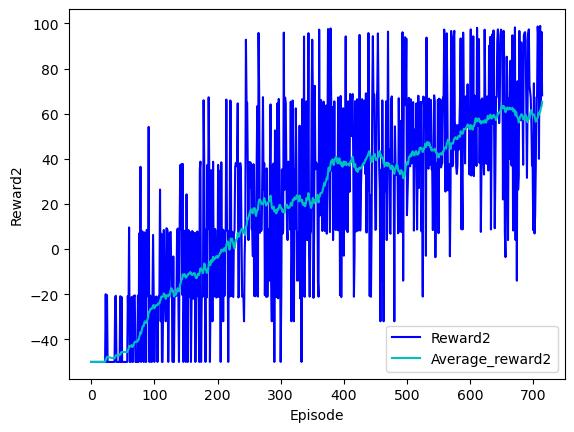

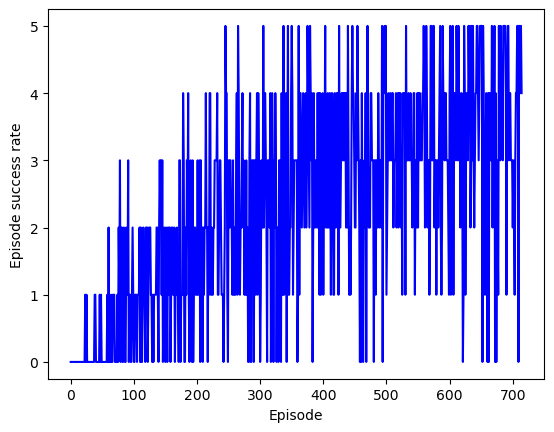

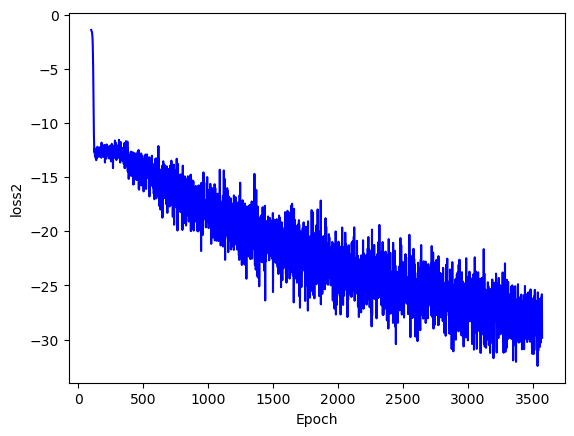

***** epoch 143 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89399.45138993455
r_em 53122.40383183143
53122.40383183143
ReWard2/R0 10.624480766366286
reward2 is: 18.624480766366286
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 1 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88352.04698485558
r_em 54352.72324468856
54352.72324468856
ReWard2/R0 10.870544648937711
reward2 is: 18.87054464893771
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 2 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88744.1375935819
r_em 55015.804521051
55015.804521051
ReWard2/R0 11.003160904210201
reward2 is: 19.0031609042102
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 3 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89661.68795488168
r_em 56019.09549496491
56019.09549496491
ReWard2/R0 11.203819098992982
reward2 is: 19.20381909899298
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 4 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88305.4527623902
r_em 56251.8962021357
56251.8962021357
ReWard2/R0 11.25037924042714
reward2 is: 19.25037924042714
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.17535631837764862
***** epoch 143 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92283.44974665449
r_em 54654.46471859551
54654.46471859551
ReWard2/R0 10.930892943719103
reward2 is: 18.9308929437191
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 6 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91414.15063291084
r_em 54708.55992251357
54708.55992251357
ReWard2/R0 10.941711984502714
reward2 is: 18.941711984502714
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 7 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91320.63660517464
r_em 54115.36061100363
54115.36061100363
ReWard2/R0 10.823072122200726
reward2 is: 18.823072122200728
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 8 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91473.7307917681
r_em 53870.59414641021
53870.59414641021
ReWard2/R0 10.774118829282042
reward2 is: 18.774118829282042
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 9 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 95545.0639664314
r_em 53672.46115994103
53672.46115994103
ReWard2/R0 10.734492231988206
reward2 is: 18.734492231988206
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.1749183657533599
***** epoch 143 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 86112.17917921697
r_em 52777.55779491499
52777.55779491499
ReWard2/R0 10.555511558982998
reward2 is: 18.555511558983
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step
***** frame 11 *****
1/1 [==============================] - 0s 23ms/step
we choo

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 16 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 17 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 18 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 19 *****
we choose action2 with: explore
e_ur2 [3. 3.]
Ooo

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 23 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88016.36245885555
r_em 55278.35944871173
55278.35944871173
ReWard2/R0 11.055671889742346
reward2 is: 19.055671889742346
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.1736110596837351


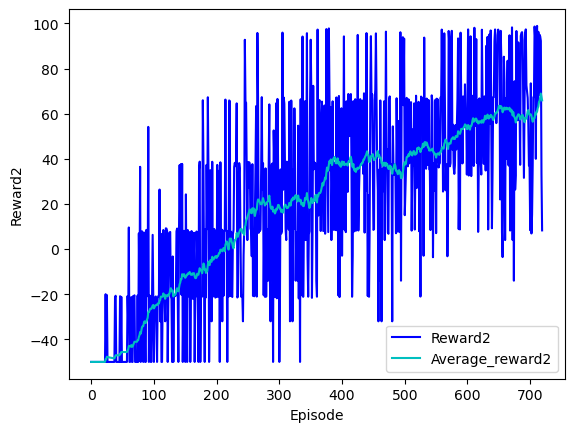

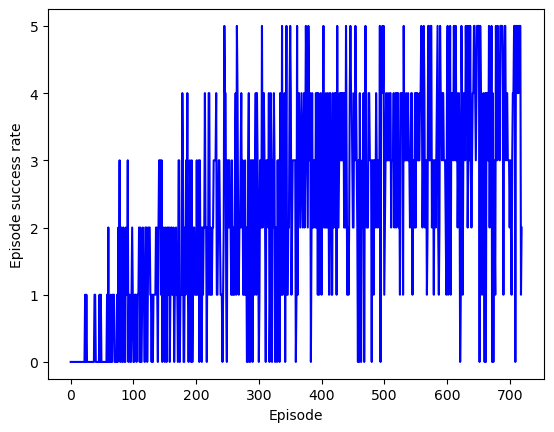

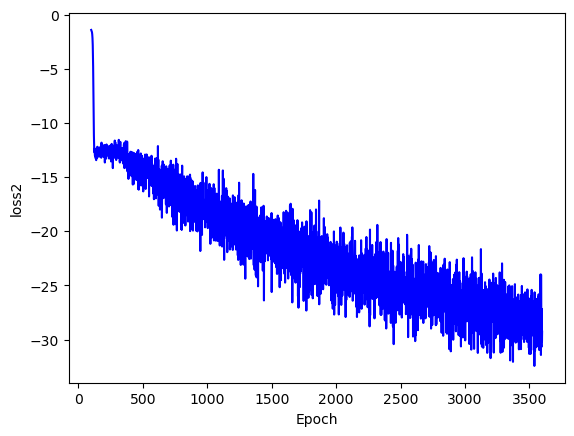

***** epoch 144 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93316.1634834424
r_em 58057.47406181656
58057.47406181656
ReWard2/R0 11.611494812363311
reward2 is: 19.61149481236331
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 1 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92912.61716163458
r_em 58303.8907823729
58303.8907823729
ReWard2/R0 11.66077815647458
reward2 is: 19.660778156474578
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 4 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95472.35581886164
r_em 58949.166043863755
58949.166043863755
ReWard2/R0 11.789833208772752
reward2 is: 19.78983320877275
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5m

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.17317746584521543
***** epoch 144 episode 1 *****
***** frame 5 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 6 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 7 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90603.97929676967
r_em 52553.37531609705
52553.37531609705
ReWard2/R0 10.510675063219411
reward2 is: 18.51067506321941
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 8 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85344.3244846036
r_em 53563.588614754255
53563.588614754255
ReWard2/R0 10.71271772295085
reward2 is: 18.71271772295085
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 9 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84597.89813982145
r_em 53934.067873188746
53934.067873188746
ReWard2/R0 10.78681357463775
reward2 is: 18.786813574637748
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.1727449549078493
***** epoch 144 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 11 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87283.19335368098
r_em 52841.40059023716
52841.40059023716
ReWard2/R0 10.568280118047431
reward2 is: 18.568280118047433
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 12 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90609.71252844717
r_em 53506.20459093094
53506.20459093094
ReWard2/R0 10.701240918186187
reward2 is: 18.701240918186187
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 13 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 14 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.17231352416708978
***** epoch 144 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89380.05709862045
r_em 56460.1389651834
56460.1389651834
ReWard2/R0 11.29202779303668
reward2 is: 19.29202779303668
total number of

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 16 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89635.98466437594
r_em 57839.21358892495
57839.21358892495
ReWard2/R0 11.56784271778499
reward2 is: 19.56784271778499
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 17 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90387.79380912441
r_em 58236.5702422783
58236.5702422783
ReWard2/R0 11.64731404845566
reward2 is: 19.647314048455662
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 18 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88869.05545382098
r_em 57984.37541173364
57984.37541173364
ReWard2/R0 11.59687508234673
reward2 is: 19.596875082346727
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 19 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87684.31565202573
r_em 57385.04284364636
57385.04284364636
ReWard2/R0 11.477008568729273
reward2 is: 19.477008568729275
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.17188317092514446
***** epoch 144 episode 4 *****
***** frame 20 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 21 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86814.66683731545
r_em 53701.87158670422
53701.87158670422
ReWard2/R0 10.740374317340844
reward2 is: 18.740374317340844
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 22 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88743.51911859521
r_em 53570.56687463875
53570.56687463875
ReWard2/R0 10.71411337492775
reward2 is: 18.71411337492775
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 23 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89493.8596547441
r_em 52457.16070736326
52457.16070736326
ReWard2/R0 10.491432141472652
reward2 is: 18.49143214147265
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 24 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89840.15865929534
r_em 54155.42428345166
54155.42428345166
ReWard2/R0 10.831084856690332
reward2 is: 18.83108485669033
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.17145389249095871


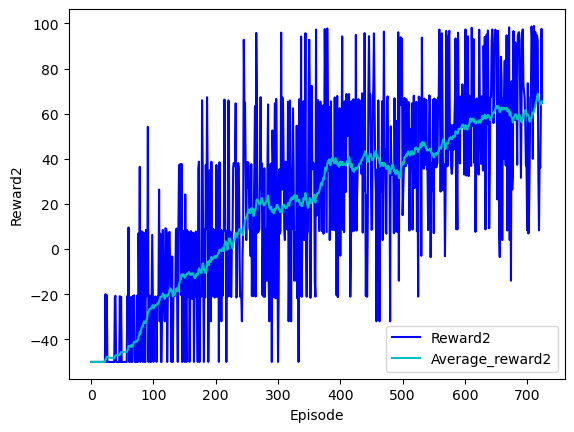

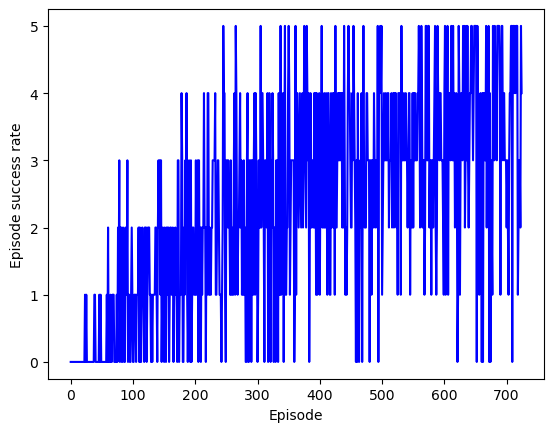

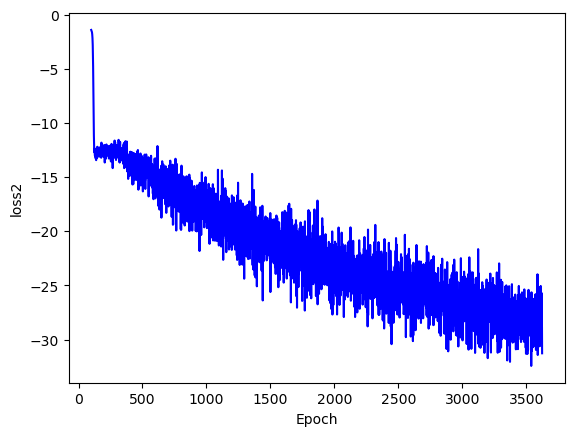

***** epoch 145 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82213.31230612699
r_em 56748.66874811835
56748.66874811835
ReWard2/R0 11.349733749623669
reward2 is: 19.349733749623667
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 1 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87552.54160150909
r_em 56652.98390060567
56652.98390060567
ReWard2/R0 11.330596780121134
reward2 is: 19.330596780121134
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 2 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89091.6140386358
r_em 56567.58115419927
56567.58115419927
ReWard2/R0 11.313516230839854
reward2 is: 19.313516230839852
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 4 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88894.08433078538
r_em 56115.31707305044
56115.31707305044
ReWard2/R0 11.223063414610088
reward2 is: 19.22306341461009
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.17102568618019878
***** epoch 145 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84295.67853208109
r_em 54010.88018952166
54010.88018952166
ReWard2/R0 10.802176037904331
reward2 is: 18.80217603790433
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 6 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 7 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86157.22292579574
r_em 54485.270401339665
54485.270401339665
ReWard2/R0 10.897054080267933
reward2 is: 18.897054080267935
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 8 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85926.16628747767
r_em 54623.96336464971
54623.96336464971
ReWard2/R0 10.924792672929941
reward2 is: 18.92479267292994
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 9 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85839.26821928979
r_em 54976.88060065058
54976.88060065058
ReWard2/R0 10.995376120130116
reward2 is: 18.995376120130118
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.17059854931523513
***** epoch 145 episode 2 *****
***** frame 10 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 11 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 12 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90436.65712688319
r_em 52503.43880354402
52503.43880354402
ReWard2/R0 10.500687760708804
reward2 is: 18.500687760708804
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [===

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 13 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 14 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.17017247922512546
***** epoch 145 episode 3 *****
***** frame 15 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 16 *****
1/1 [=================

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 17 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81199.7241876696
r_em 57762.29273643228
57762.29273643228
ReWard2/R0 11.552458547286456
reward2 is: 19.552458547286456
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 18 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85466.42596400723
r_em 58152.62944145051
58152.62944145051
ReWard2/R0 11.630525888290101
reward2 is: 19.6305258882901
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 19 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 96010.55244226493
r_em 58547.49686694063
58547.49686694063
ReWard2/R0 11.709499373388127
reward2 is: 19.709499373388127
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.16974747324559833
***** epoch 145 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96656.87484640538
r_em 53239.27820492529
53239.27820492529
ReWard2/R0 10.647855640985059
reward2 is: 18.647855640985057
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 21 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 97591.42070749274
r_em 53125.62147489733
53125.62147489733
ReWard2/R0 10.625124294979466
reward2 is: 18.625124294979464
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 22 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 97734.37845891001
r_em 52901.72351893115
52901.72351893115
ReWard2/R0 10.58034470378623
reward2 is: 18.58034470378623
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 23 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 97589.5160529655
r_em 53289.86369282369
53289.86369282369
ReWard2/R0 10.657972738564737
reward2 is: 18.657972738564737
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.16932352871903616


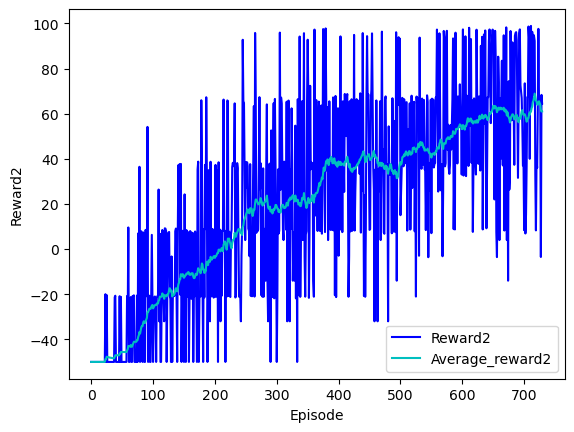

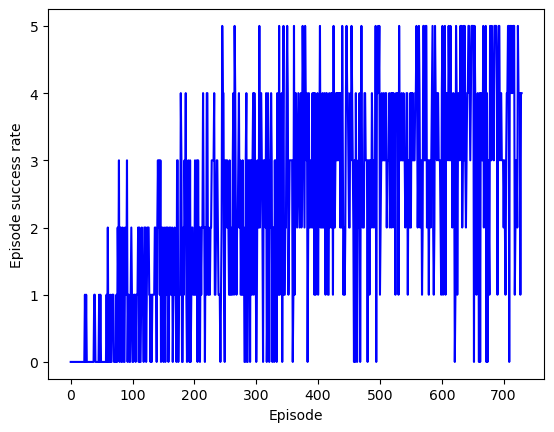

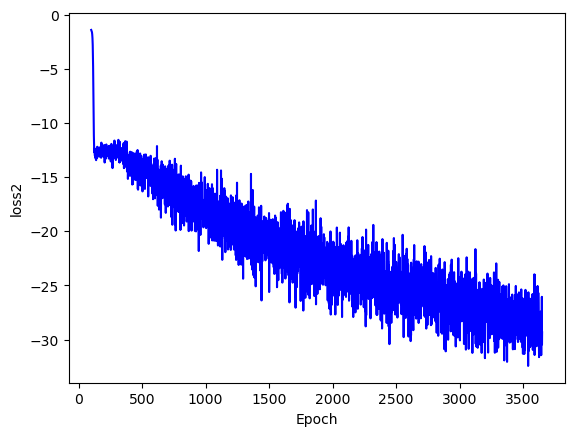

***** epoch 146 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 1 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82030.03551232412
r_em 49543.04146147742
49543.04146147742
ReWard2/R0 9.908608292295485
reward2 is: 17.908608292295483
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 2 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83206.66317065654
r_em 48884.053164447716
48884.053164447716
ReWard2/R0 9.776810632889543
reward2 is: 17.776810632889543
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 3 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83162.28643089067
r_em 48242.70881238961
48242.70881238961
ReWard2/R0 9.648541762477922
reward2 is: 17.648541762477922
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 4 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84718.42272820217
r_em 45885.48166331865
45885.48166331865
ReWard2/R0 9.17709633266373
reward2 is: 17.17709633266373
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.16890064299445892
***** epoch 146 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85863.80227710097
r_em 54644.76038336221
54644.76038336221
ReWard2/R0 10.928952076672443
reward2 is: 18.928952076672445
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 6 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86206.81847734455
r_em 55003.400555999244
55003.400555999244
ReWard2/R0 11.000680111199848
reward2 is: 19.00068011119985
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 7 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 8 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85859.48304817121
r_em 54643.28448079567
54643.28448079567
ReWard2/R0 10.928656896159135
reward2 is: 18.928656896159133
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 9 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86255.33061011079
r_em 53950.66807192591
53950.66807192591
ReWard2/R0 10.790133614385182
reward2 is: 18.790133614385184
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.16847881342750726
***** epoch 146 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 98430.6879251693
r_em 53087.784719988354
53087.784719988354
ReWard2/R0 10.617556943997672
reward2 is: 18.61755694399767
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 11 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 98527.00100114384
r_em 54260.51418440406
54260.51418440406
ReWard2/R0 10.852102836880812
reward2 is: 18.85210283688081
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 12 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 13 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 97789.8589088755
r_em 53686.09306867416
53686.09306867416
ReWard2/R0 10.737218613734832
reward2 is: 18.737218613734832
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 14 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 98614.23649116089
r_em 53487.22721049932
53487.22721049932
ReWard2/R0 10.697445442099863
reward2 is: 18.697445442099863
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.16805803738042624
***** epoch 146 episode 3 *****
***** frame 15 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 16 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77973.60802477907
r_em 56529.16405685351
56529.16405685351
ReWard2/R0 11.305832811370701
reward2 is: 19.3058328113707
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 17 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 18 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80283.06316498603
r_em 56042.750620300474
56042.750620300474
ReWard2/R0 11.208550124060094
reward2 is: 19.208550124060096
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 19 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78706.58426459957
r_em 55670.272136265005
55670.272136265005
ReWard2/R0 11.134054427253002
reward2 is: 19.134054427253
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.16763831222204864
***** epoch 146 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 88798.94559649396
r_em 51678.90300679021
51678.90300679021
ReWard2/R0 10.335780601358042
reward2 is: 18.335780601358042
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step
***** frame 21 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 90136.67497012654
r_em 52984.32412578
52984.32412578
ReWard2/R0 10.596864825155999
reward2 is: 18.596864825155997
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step
***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ... 

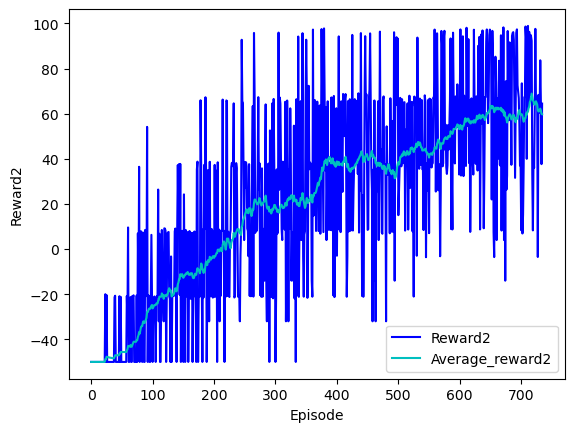

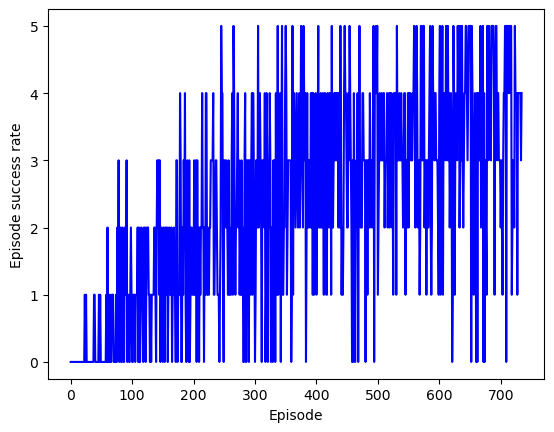

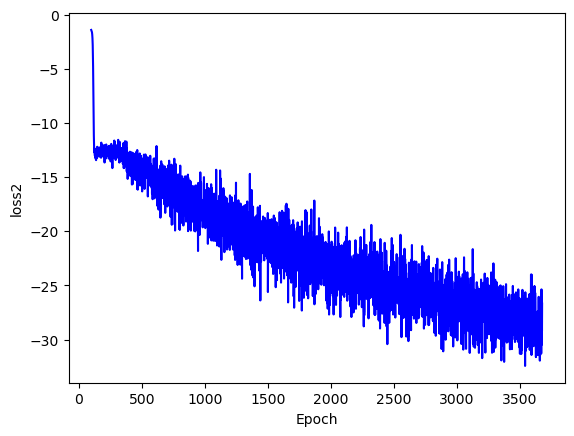

***** epoch 147 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 2 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90369.2277761216
r_em 55549.831627754524
55549.831627754524
ReWard2/R0 11.109966325550905
reward2 is: 19.109966325550907
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 3 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 4 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88108.73014828541
r_em 52780.15412407579
52780.15412407579
ReWard2/R0 10.556030824815158
reward2 is: 18.55603082481516
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.1668020040795752
***** epoch 147 episode 1 *****
***** frame 5 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 6 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 7 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93453.31416922127
r_em 57541.78143690995
57541.78143690995
ReWard2/R0 11.50835628738199
reward2 is: 19.50835628738199
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 8 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 9 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93839.439699559
r_em 57502.94320361482
57502.94320361482
ReWard2/R0 11.500588640722965
reward2 is: 19.500588640722967
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.16638541586593614
***** epoch 147 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Output is: optimal_inaccurate
r_ur 93364.24250087672
r_em 56658.118118749946
56658.118118749946
ReWard2/R0 11.331623623749989
reward2 is: 19.33162362374999
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step
***** frame 11 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92163.90955497834
r_em 56191.687572835806
56191.687572835806
ReWard2/R0 11.238337514567162
reward2 is: 19.238337514567164
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 12 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92888.60557650658
r_em 55687.823781889776
55687.823781889776
ReWard2/R0 11.137564756377955
reward2 is: 19.137564756377955
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 13 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 14 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93206.6451500509
r_em 56476.25577611003
56476.25577611003
ReWard2/R0 11.295251155222006
reward2 is: 19.295251155222005
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.16596986808188122
***** epoch 147 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77599.9839553918
r_em 51499.93432627755
51499.93432627755
ReWard2/R0 10.29998686525551
reward2 is: 18.299986865255512
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 16 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78885.49965512336
r_em 51644.781044161195
51644.781044161195
ReWard2/R0 10.328956208832238
reward2 is: 18.32895620883224
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 17 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86561.52860002854
r_em 52506.254488178274
52506.254488178274
ReWard2/R0 10.501250897635655
reward2 is: 18.501250897635657
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 18 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89121.06040519418
r_em 51376.64983941517
51376.64983941517
ReWard2/R0 10.275329967883033
reward2 is: 18.27532996788303
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 19 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88246.40007696062
r_em 51865.36677268058
51865.36677268058
ReWard2/R0 10.373073354536116
reward2 is: 18.373073354536118
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.1655553581289363
***** epoch 147 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79375.45217450972
r_em 54809.65297761971
54809.65297761971
ReWard2/R0 10.961930595523942
reward2 is: 18.961930595523942
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 21 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78428.46224436042
r_em 54778.11848960624
54778.11848960624
ReWard2/R0 10.955623697921249
reward2 is: 18.955623697921247
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 22 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81982.12665449224
r_em 55318.263963993784
55318.263963993784
ReWard2/R0 11.063652792798758
reward2 is: 19.063652792798756
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 23 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79960.05538565484
r_em 55064.666201789405
55064.666201789405
ReWard2/R0 11.012933240357881
reward2 is: 19.01293324035788
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 24 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84051.52844513209
r_em 54888.97662604445
54888.97662604445
ReWard2/R0 10.97779532520889
reward2 is: 18.977795325208888
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.16514188341511685


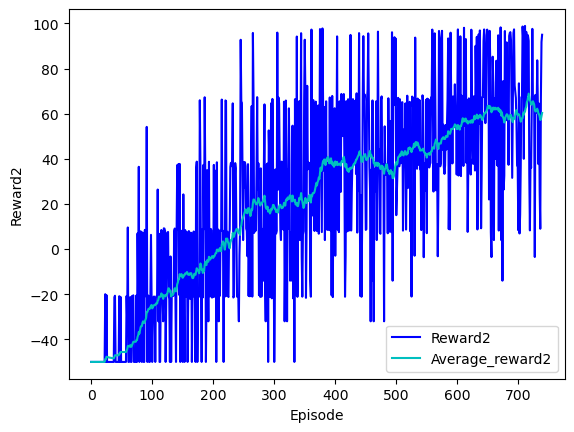

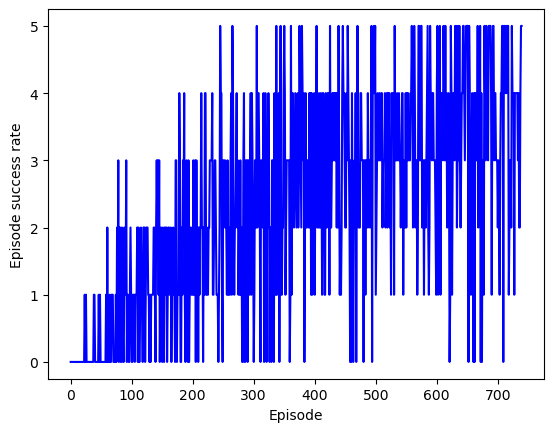

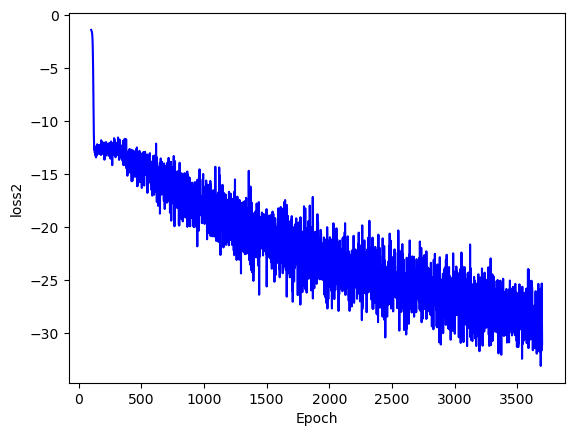

***** epoch 148 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 18ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 91935.9782193568
r_em 56268.757924296166
56268.757924296166
ReWard2/R0 11.253751584859232
reward2 is: 19.25375158485923
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step
***** frame 1 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90256.39111674852
r_em 55615.38325911497
55615.38325911497
ReWard2/R0 11.123076651822993
reward2 is: 19.12307665182299
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 2 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88476.76111217927
r_em 55698.88537043368
55698.88537043368
ReWard2/R0 11.139777074086735
reward2 is: 19.139777074086737
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 3 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87318.2273965294
r_em 54535.69103487468
54535.69103487468
ReWard2/R0 10.907138206974937
reward2 is: 18.907138206974935
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 4 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 83965.60696718933
r_em 54577.70308021827
54577.70308021827
ReWard2/R0 10.915540616043653
reward2 is: 18.915540616043653
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.1647294413549119
***** epoch 148 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 92498.55121579964
r_em 56681.78790648859
56681.78790648859
ReWard2/R0 11.336357581297719
reward2 is: 19.33635758129772
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step
***** frame 6 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 11 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93403.37959186854
r_em 52137.34682401854
52137.34682401854
ReWard2/R0 10.427469364803708
reward2 is: 18.427469364803706
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 12 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 13 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 14 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92937.0710646518
r_em 52349.85396748014
52349.85396748014
ReWard2/R0 10.469970793496028
reward2 is: 18.469970793496028
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA:

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.16390764488557183
***** epoch 148 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 103671.06833360401
r_em 56612.57219488728
56612.57219488728
ReWard2/R0 11.322514438977457
reward2 is: 19.322514438977457
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 17 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 104039.95354265367
r_em 56992.771977361524
56992.771977361524
ReWard2/R0 11.398554395472305
reward2 is: 19.398554395472303
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 18 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 104339.63669026943
r_em 57459.1390055805
57459.1390055805
ReWard2/R0 11.4918278011161
reward2 is: 19.491827801116102
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 19 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 104499.25819051595
r_em 57178.111957039444
57178.111957039444
ReWard2/R0 11.43562239140789
reward2 is: 19.43562239140789
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.1634982853376368
***** epoch 148 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 21 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 22 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
**

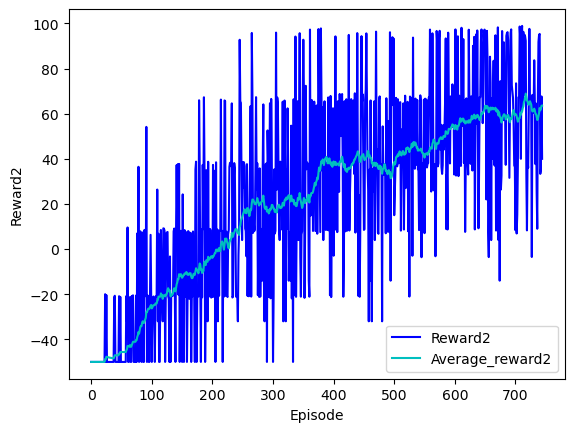

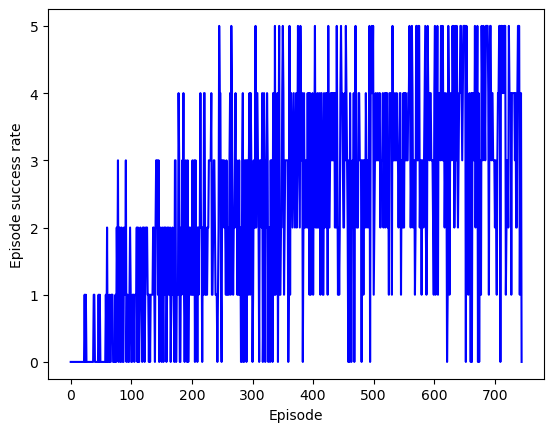

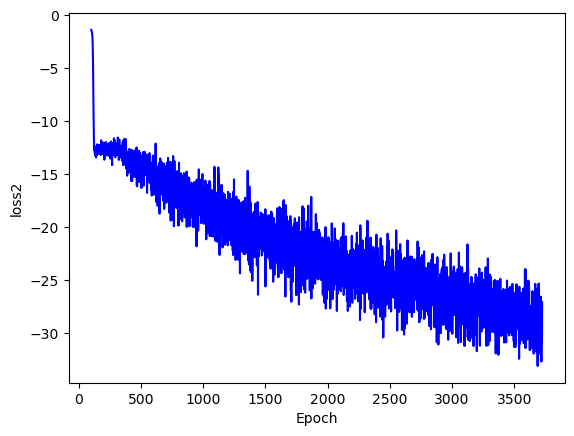

***** epoch 149 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91563.5447372107
r_em 51918.988074237604
51918.988074237604
ReWard2/R0 10.383797614847522
reward2 is: 18.383797614847524
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 1 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90379.59811464875
r_em 52148.50476320549
52148.50476320549
ReWard2/R0 10.429700952641099
reward2 is: 18.4297009526411
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 2 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 90599.14202371496
r_em 53123.120959175314
53123.120959175314
ReWard2/R0 10.624624191835062
reward2 is: 18.62462419183506
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step
***** frame 3 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 90453.8372102227
r_em 52764.29874744549
52764.29874744549
ReWard2/R0 10.552859749489098
reward2 is: 18.552859749489098
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step
***** frame 4 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.16268263081632905
***** epoch 149 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79515.7571832333
r_em 54595.59926019594
54595.59926019594
ReWard2/R0 10.919119852039188
reward2 is: 18.919119852039188
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 6 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80657.7611374997
r_em 55138.873196922556
55138.873196922556
ReWard2/R0 11.02777463938451
reward2 is: 19.02777463938451
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 7 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82514.90133244754
r_em 55118.697951830814
55118.697951830814
ReWard2/R0 11.023739590366162
reward2 is: 19.023739590366162
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 8 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 92945.07618764506
r_em 54863.9893101259
54863.9893101259
ReWard2/R0 10.97279786202518
reward2 is: 18.972797862025182
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step
***** frame 9 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83450.40869201472
r_em 54092.029524248515
54092.029524248515
ReWard2/R0 10.818405904849703
reward2 is: 18.818405904849705
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.16227633074256287
***** epoch 149 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 92996.13479508864
r_em 56980.18022334665
56980.18022334665
ReWard2/R0 11.39603604466933
reward2 is: 19.39603604466933
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step
***** frame 11 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 92074.91540732754
r_em 57447.78238485236
57447.78238485236
ReWard2/R0 11.489556476970472
reward2 is: 19.48955647697047
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step
***** frame 12 *****
1/1 [==============================] - 0s 21ms/step
we c

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 16 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89442.01459864201
r_em 55318.08209966684
55318.08209966684
ReWard2/R0 11.063616419933368
reward2 is: 19.063616419933368
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 17 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 98958.81143744323
r_em 55964.553859985106
55964.553859985106
ReWard2/R0 11.19291077199702
reward2 is: 19.19291077199702
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step
***** frame 18 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 99458.15734601923
r_em 55554.887787802785
55554.887787802785
ReWard2/R0 11.110977557560558
reward2 is: 19.11097755756056
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step
***** frame 19 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 99718.80302930763
r_em 55274.619128931656

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 22 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83984.31016979899
r_em 58090.70296091831
58090.70296091831
ReWard2/R0 11.618140592183662
reward2 is: 19.618140592183664
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 23 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 5.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.16106350880003847


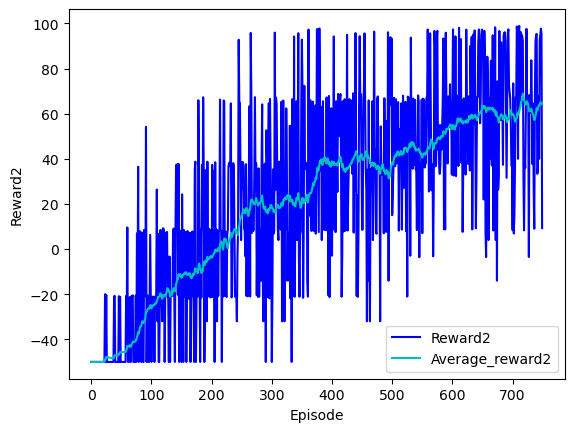

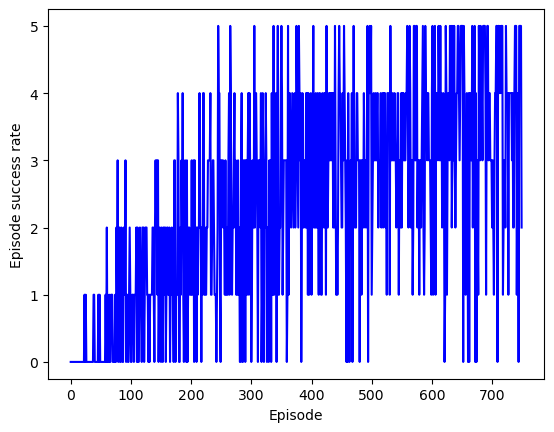

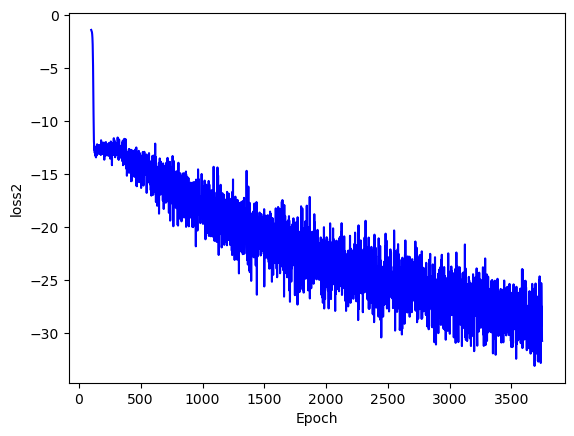

***** epoch 150 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79023.77386445527
r_em 56502.22836414922
56502.22836414922
ReWard2/R0 11.300445672829843
reward2 is: 19.300445672829845
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 1 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83724.68967819719
r_em 55739.794828060374
55739.794828060374
ReWard2/R0 11.147958965612075
reward2 is: 19.147958965612077
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 2 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85199.61351028748
r_em 54899.595544974625
54899.595544974625
ReWard2/R0 10.979919108994926
reward2 is: 18.979919108994928
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 3 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83639.11520460658
r_em 54439.799772565355
54439.799772565355
ReWard2/R0 10.887959954513072
reward2 is: 18.88795995451307
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 4 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82686.68123426884
r_em 55409.918583486564
55409.918583486564
ReWard2/R0 11.081983716697312
reward2 is: 19.081983716697312
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.16066125248553134
***** epoch 150 episode 1 *****
***** frame 5 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 6 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89656.50548157145
r_em 53077.60968658229
53077.60968658229
ReWard2/R0 10.615521937316458
reward2 is: 18.61552193731646
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 7 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90927.35155741089
r_em 52815.18929778072
52815.18929778072
ReWard2/R0 10.563037859556145
reward2 is: 18.563037859556147
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 8 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91516.05882814756
r_em 52306.276592794864
52306.276592794864
ReWard2/R0 10.461255318558973
reward2 is: 18.461255318558973
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 9 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92876.36470712205
r_em 51401.40251585924
51401.40251585924
ReWard2/R0 10.280280503171848
reward2 is: 18.28028050317185
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.16026000080667238
***** epoch 150 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85302.54790088545
r_em 55693.432355101635
55693.432355101635
ReWard2/R0 11.138686471020327
reward2 is: 19.13868647102033
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 11 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 93602.2271260929
r_em 55707.65578059385
55707.65578059385
ReWard2/R0 11.14153115611877
reward2 is: 19.14153115611877
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step
***** frame 12 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 13 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 14 *****
1/1 [============

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 17 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85838.33900905607
r_em 57509.997009850704
57509.997009850704
ReWard2/R0 11.50199940197014
reward2 is: 19.50199940197014
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 18 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89267.33128364729
r_em 57408.18012985439
57408.18012985439
ReWard2/R0 11.481636025970877
reward2 is: 19.48163602597088
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 19 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88619.23262602737
r_em 57303.35181492837
57303.35181492837
ReWard2/R0 11.460670362985674
reward2 is: 19.460670362985674
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.15946050132585032
***** epoch 150 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 21 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 22 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
*

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 24 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93432.4851814559
r_em 57004.90905196714
57004.90905196714
ReWard2/R0 11.400981810393427
reward2 is: 19.400981810393425
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.15906224852451326


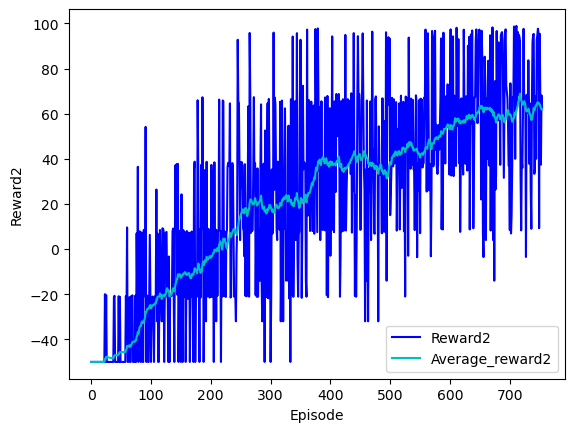

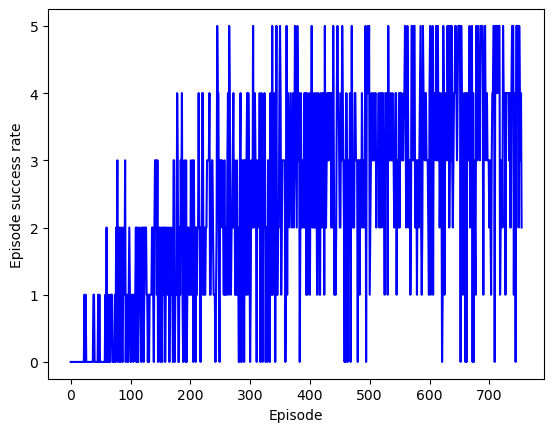

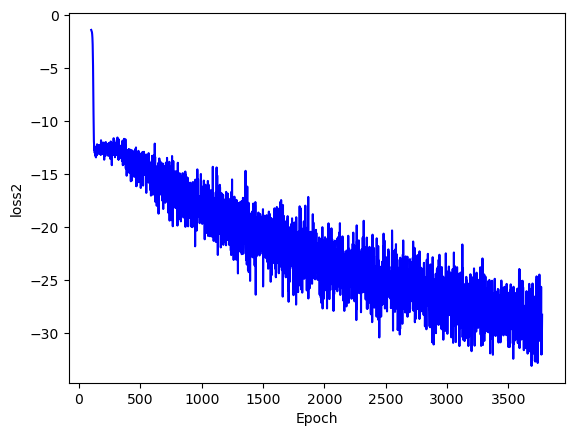

***** epoch 151 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 84970.22801501435
r_em 53487.39476172539
53487.39476172539
ReWard2/R0 10.697478952345078
reward2 is: 18.69747895234508
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step
***** frame 1 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84718.05591757852
r_em 53529.7692714046
53529.7692714046
ReWard2/R0 10.705953854280919
reward2 is: 18.70595385428092
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 2 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 87721.31535387257
r_em 54866.82284801952
54866.82284801952
ReWard2/R0 10.973364569603904
reward2 is: 18.973364569603902
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step
***** frame 3 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 87868.12325196686
r_em 54188.450799463775
54188.450799463775
ReWard2/R0 10.837690159892755
reward2 is: 18.837690159892755
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step
***** frame 4 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85687.75412263375
r_em 53086.141

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.15866499036004522
***** epoch 151 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87552.65847323908
r_em 57809.58298327824
57809.58298327824
ReWard2/R0 11.561916596655648
reward2 is: 19.56191659665565
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 6 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 7 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90478.38029330807
r_em 57248.856002313565
57248.856002313565
ReWard2/R0 11.449771200462713
reward2 is: 19.449771200462713
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 8 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90617.36483834044
r_em 56752.02044813782
56752.02044813782
ReWard2/R0 11.350404089627563
reward2 is: 19.350404089627563
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 9 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90009.22287273593
r_em 56206.31956604397
56206.31956604397
ReWard2/R0 11.241263913208794
reward2 is: 19.241263913208794
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.15826872434833938
***** epoch 151 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 93999.40422060402
r_em 55190.08454533133
55190.08454533133
ReWard2/R0 11.038016909066267
reward2 is: 19.038016909066265
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step
***** frame 11 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 94281.33870182221
r_em 55523.04930249098
55523.04930249098
ReWard2/R0 11.104609860498197
reward2 is: 19.104609860498197
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step
***** frame 12 *****
1/1 [==============================] - 0s 23ms/step
w

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 16 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80875.39008890513
r_em 57140.43584681969
57140.43584681969
ReWard2/R0 11.428087169363938
reward2 is: 19.428087169363938
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 17 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81801.55149693412
r_em 56692.1925053793
56692.1925053793
ReWard2/R0 11.33843850107586
reward2 is: 19.33843850107586
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 18 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 19 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.15747915887779185
***** epoch 151 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84299.46336997474
r_em 49447.7161953127
49447.7161953127
ReWard2/R0 9.88954323906254
reward2 is: 17.88954323906254
total number of ur2 RBs: 8.0
total nu

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 21 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85175.2943931667
r_em 49703.18975763091
49703.18975763091
ReWard2/R0 9.940637951526183
reward2 is: 17.940637951526185
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 22 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86378.11026536266
r_em 51498.03825565801
51498.03825565801
ReWard2/R0 10.299607651131602
reward2 is: 18.299607651131602
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 23 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87990.63033977951
r_em 49688.57276971423
49688.57276971423
ReWard2/R0 9.937714553942845
reward2 is: 17.937714553942847
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 24 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89155.64460698541
r_em 49248.3848253451
49248.3848253451
ReWard2/R0 9.84967696506902
reward2 is: 17.849676965069023
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.15708585448169488


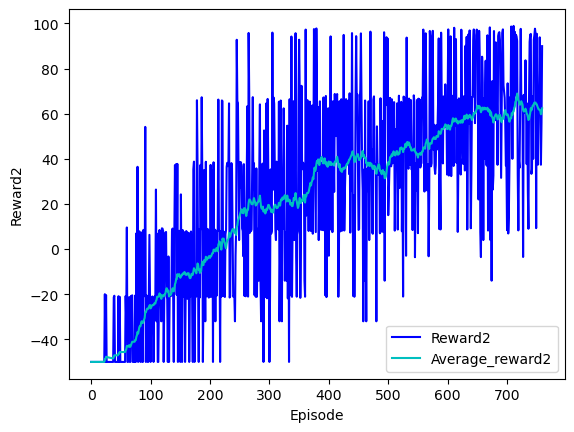

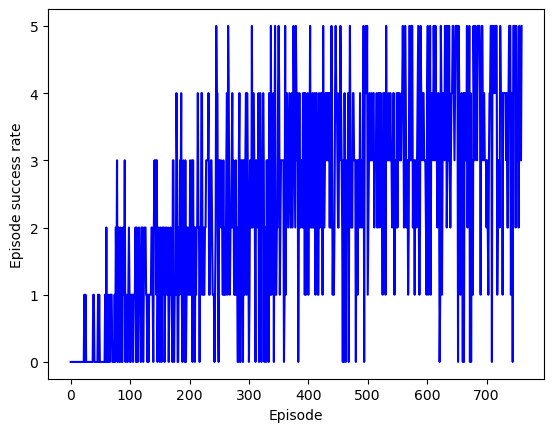

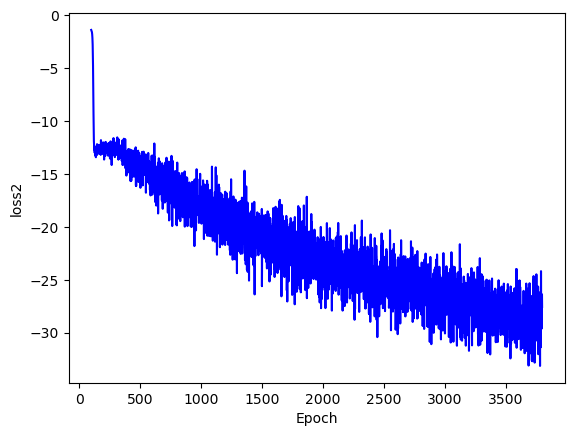

***** epoch 152 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90200.43745164222
r_em 57364.43181972176
57364.43181972176
ReWard2/R0 11.472886363944351
reward2 is: 19.47288636394435
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 1 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93079.67828752863
r_em 57067.972097993515
57067.972097993515
ReWard2/R0 11.413594419598702
reward2 is: 19.413594419598702
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 2 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91630.66125638042
r_em 56877.056929436585
56877.056929436585
ReWard2/R0 11.375411385887316
reward2 is: 19.37541138588732
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 4 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91150.90279581943
r_em 56990.52506359807
56990.52506359807
ReWard2/R0 11.398105012719615
reward2 is: 19.398105012719615
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.15669353236381867
***** epoch 152 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81222.36902812077
r_em 53714.44725692582
53714.44725692582
ReWard2/R0 10.742889451385164
reward2 is: 18.742889451385164
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 6 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81010.2128588786
r_em 54515.37299030412
54515.37299030412
ReWard2/R0 10.903074598060824
reward2 is: 18.903074598060826
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 7 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80837.96426490667
r_em 54010.933881400335
54010.933881400335
ReWard2/R0 10.802186776280067
reward2 is: 18.802186776280067
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 8 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80365.79017253857
r_em 53683.31292782087
53683.31292782087
ReWard2/R0 10.736662585564174
reward2 is: 18.736662585564176
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 9 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80519.94241274118
r_em 53111.58414571802
53111.58414571802
ReWard2/R0 10.622316829143605
reward2 is: 18.622316829143607
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.1563021900709221
***** epoch 152 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80538.49926974374
r_em 52680.3740537588
52680.3740537588
ReWard2/R0 10.53607481075176
reward2 is: 18.53607481075176
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 11 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84470.8007413742
r_em 50889.3389531169
50889.3389531169
ReWard2/R0 10.177867790623381
reward2 is: 18.17786779062338
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 12 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 13 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82210.92250155157
r_em 51778.350156802975
51778.350156802975
ReWard2/R0 10.355670031360596
reward2 is: 18.355670031360596
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 14 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82563.85770867391
r_em 51586.16693665582
51586.16693665582
ReWard2/R0 10.317233387331164
reward2 is: 18.317233387331164
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.1559118251558911
***** epoch 152 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 91981.97424124734
r_em 54611.036978153665
54611.036978153665
ReWard2/R0 10.922207395630734
reward2 is: 18.922207395630736
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step
***** frame 16 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91218.97167782919
r_em 54866.95146654792
54866.95146654792
ReWard2/R0 10.973390293309585
reward2 is: 18.973390293309585
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 17 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 18 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89836.12059386408
r_em 53712.18839331092
53712.18839331092
ReWard2/R0 10.742437678662185
reward2 is: 18.742437678662185
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 19 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88713.4644483441
r_em 52605.19882253571
52605.19882253571
ReWard2/R0 10.521039764507142
reward2 is: 18.521039764507144
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.15552243517772324
***** epoch 152 episode 4 *****
***** frame 20 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 21 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94011.58090282156
r_em 58814.407147043654
58814.407147043654
ReWard2/R0 11.762881429408731
reward2 is: 19.76288142940873
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 22 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92721.33221774697
r_em 58687.94049127337
58687.94049127337
ReWard2/R0 11.737588098254674
reward2 is: 19.737588098254676
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 23 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91424.31902789454
r_em 58827.5330753716
58827.5330753716
ReWard2/R0 11.765506615074319
reward2 is: 19.76550661507432
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 24 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90609.80086105838
r_em 58447.73013496727
58447.73013496727
ReWard2/R0 11.689546026993455
reward2 is: 19.689546026993455
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.15513401770151247


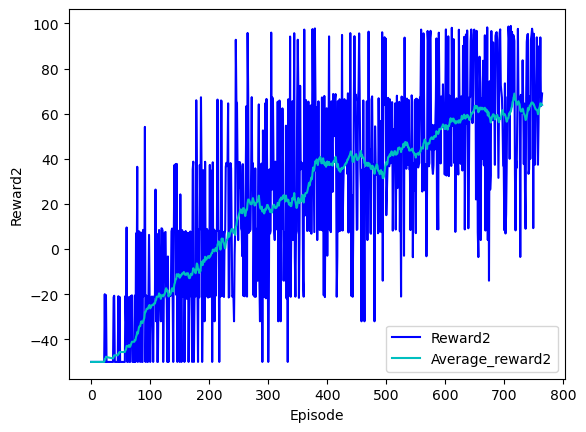

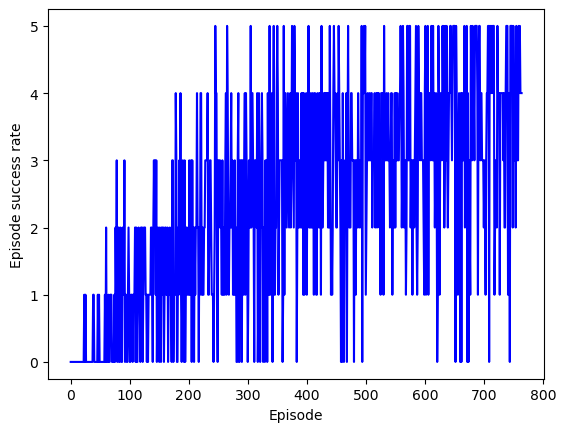

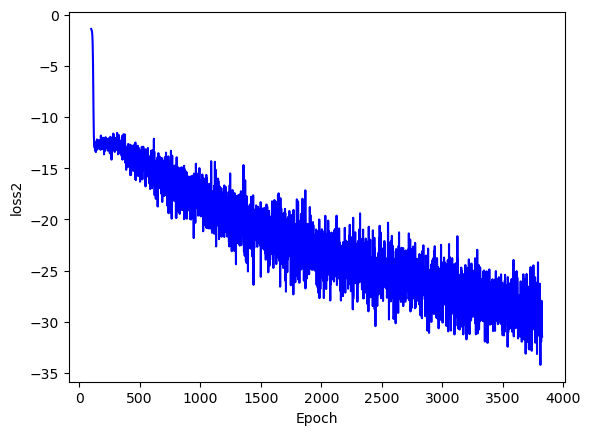

***** epoch 153 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 1 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85085.02092577779
r_em 58355.26867904998
58355.26867904998
ReWard2/R0 11.671053735809997
reward2 is: 19.67105373581
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 2 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88391.54089081493
r_em 58540.196463891625
58540.196463891625
ReWard2/R0 11.708039292778325
reward2 is: 19.708039292778324
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 3 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89514.5759098368
r_em 58163.18687323692
58163.18687323692
ReWard2/R0 11.632637374647384
reward2 is: 19.632637374647384
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 4 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89535.0594170786
r_em 57747.940027319964
57747.940027319964
ReWard2/R0 11.549588005463994
reward2 is: 19.549588005463995
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.15474657029843394
***** epoch 153 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88541.16928457799
r_em 55911.661063524356
55911.661063524356
ReWard2/R0 11.182332212704871
reward2 is: 19.18233221270487
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 6 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88407.42353805367
r_em 56484.41015079756
56484.41015079756
ReWard2/R0 11.296882030159512
reward2 is: 19.296882030159512
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 7 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90187.94898198995
r_em 56014.17531174571
56014.17531174571
ReWard2/R0 11.202835062349143
reward2 is: 19.202835062349145
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 8 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90523.4346888656
r_em 56432.11287641453
56432.11287641453
ReWard2/R0 11.286422575282906
reward2 is: 19.286422575282906
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 9 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91423.61342068005
r_em 55931.74170455198
55931.74170455198
ReWard2/R0 11.186348340910397
reward2 is: 19.1863483409104
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.15436009054572875
***** epoch 153 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85407.59700739164
r_em 57129.44073390705
57129.44073390705
ReWard2/R0 11.42588814678141
reward2 is: 19.42588814678141
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 11 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84931.85630766273
r_em 56958.31750634759
56958.31750634759
ReWard2/R0 11.391663501269518
reward2 is: 19.39166350126952
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 12 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86007.61029854625
r_em 56736.49338158442
56736.49338158442
ReWard2/R0 11.347298676316884
reward2 is: 19.347298676316882
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 13 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86381.59553373443
r_em 56376.32432523028
56376.32432523028
ReWard2/R0 11.275264865046056
reward2 is: 19.275264865046054
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 14 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87849.31102975398
r_em 55040.0847506605
55040.0847506605
ReWard2/R0 11.0080169501321
reward2 is: 19.008016950132102
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.15397457602668896
***** epoch 153 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85607.50461497696
r_em 54916.04376928269
54916.04376928269
ReWard2/R0 10.983208753856537
reward2 is: 18.983208753856537
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 16 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86323.69872718814
r_em 54949.808518193444
54949.808518193444
ReWard2/R0 10.98996170363869
reward2 is: 18.98996170363869
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 17 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 18 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88892.06760322332
r_em 54429.924473670624
54429.924473670624
ReWard2/R0 10.885984894734126
reward2 is: 18.885984894734126
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 19 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89697.64934617304
r_em 54233.22851101282
54233.22851101282
ReWard2/R0 10.846645702202565
reward2 is: 18.846645702202565
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.1535900243306422
***** epoch 153 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 98652.8747392249
r_em 54020.64060853702
54020.64060853702
ReWard2/R0 10.804128121707404
reward2 is: 18.804128121707404
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 21 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 97909.80794939835
r_em 53413.11260858239
53413.11260858239
ReWard2/R0 10.682622521716478
reward2 is: 18.68262252171648
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 23 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 101217.23722195563
r_em 54146.319409914126
54146.319409914126
ReWard2/R0 10.829263881982826
reward2 is: 18.829263881982826
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step
***** frame 24 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [=======================

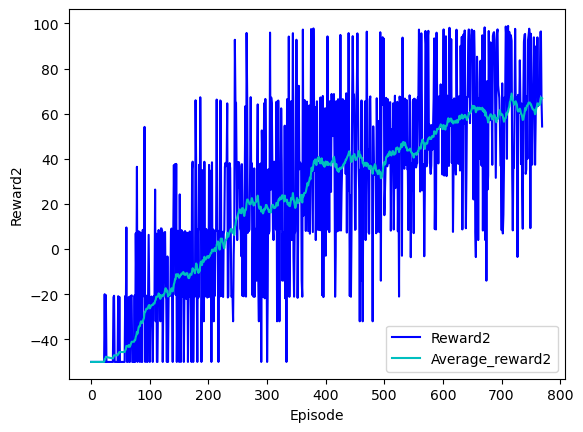

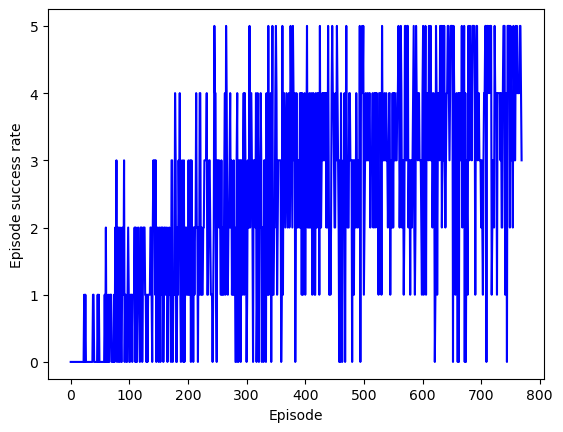

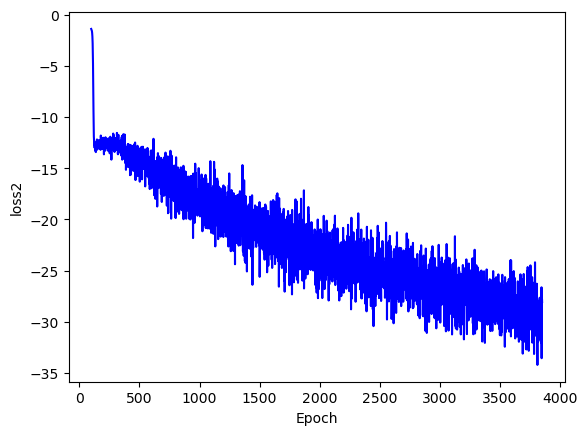

***** epoch 154 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 1 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 2 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 92178.42493185887
r_em 50321.41594595124
50321.41594595124
ReWard2/R0 10.064283189190247
reward2 is: 18.06428318919025
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step
****

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.15282379979492705
***** epoch 154 episode 1 *****
***** frame 5 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 6 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91387.58350058843
r_em 55498.486494883415
55498.486494883415
ReWard2/R0 11.099697298976682
reward2 is: 19.099697298976682
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 7 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92514.51240670218
r_em 55373.14979534235
55373.14979534235
ReWard2/R0 11.07462995906847
reward2 is: 19.07462995906847
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 8 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91825.37438078133
r_em 54426.87341917107
54426.87341917107
ReWard2/R0 10.885374683834213
reward2 is: 18.885374683834215
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 9 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91841.76999932108
r_em 54793.32354163913
54793.32354163913
ReWard2/R0 10.958664708327827
reward2 is: 18.958664708327827
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.15244212216395728
***** epoch 154 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 87352.71860931563
r_em 55659.888690172345
55659.888690172345
ReWard2/R0 11.131977738034468
reward2 is: 19.131977738034468
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step
***** frame 11 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 88799.582184914
r_em 55457.230485538836
55457.230485538836
ReWard2/R0 11.091446097107767
reward2 is: 19.091446097107767
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step
***** frame 12 *****
1/1 [==============================] - 0s 23ms/step

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 16 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 88008.81145337966
r_em 55514.10270498411
55514.10270498411
ReWard2/R0 11.102820540996822
reward2 is: 19.102820540996824
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step
***** frame 17 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 89310.31271788204
r_em 56177.64064054986
56177.64064054986
ReWard2/R0 11.235528128109971
reward2 is: 19.23552812810997
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step
***** frame 18 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optim

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 19 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 89016.76705185781
r_em 55966.123481582574
55966.123481582574
ReWard2/R0 11.193224696316515
reward2 is: 19.193224696316513
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.1516816242423797
***** epoch 154 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 91772.19932067113
r_em 57603.114932131095
57603.114932131095
ReWard2/R0 11.520622986426218
reward2 is: 19.52062298642622
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step
***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
Ooooo

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 23 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 24 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91359.93565115018
r_em 56717.96207604958
56717.96207604958
ReWard2/R0 11.343592415209917
reward2 is: 19.34359241520992
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.15130279919627976


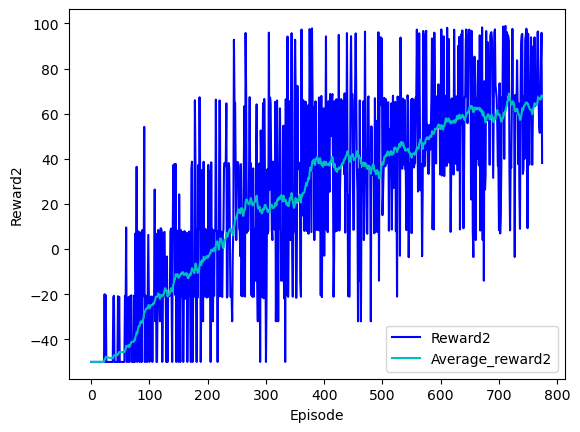

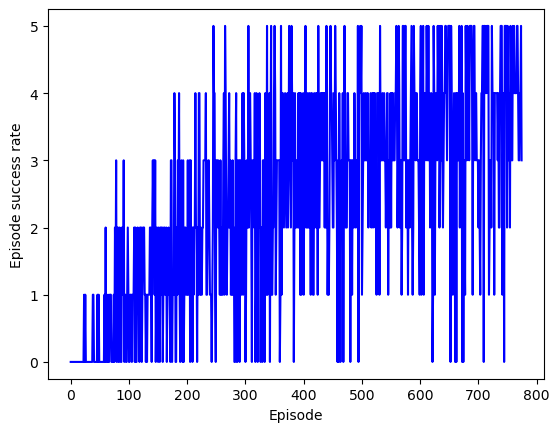

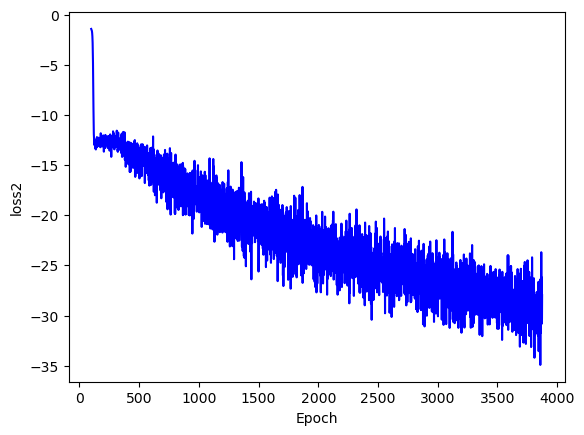

***** epoch 155 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83520.89952469959
r_em 54634.17298101196
54634.17298101196
ReWard2/R0 10.926834596202392
reward2 is: 18.92683459620239
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 1 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79988.1128856597
r_em 54686.15708376618
54686.15708376618
ReWard2/R0 10.937231416753235
reward2 is: 18.937231416753235
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 2 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84137.71163428134
r_em 54001.72751558577
54001.72751558577
ReWard2/R0 10.800345503117155
reward2 is: 18.800345503117157
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 3 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83137.43582397778
r_em 54048.756450521854
54048.756450521854
ReWard2/R0 10.809751290104371
reward2 is: 18.809751290104373
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 4 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.15092492026620585
***** epoch 155 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 6 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 7 *****
we ch

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.15054798508923203
***** epoch 155 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93933.40610601999
r_em 51418.20731089889
51418.20731089889
ReWard2/R0 10.283641462179778
reward2 is: 18.28364146217978
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 11 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93307.08373551581
r_em 49589.9873074175
49589.9873074175
ReWard2/R0 9.9179974614835
reward2 is: 17.917997461483502
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 12 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94021.42086432216
r_em 49818.05883830693
49818.05883830693
ReWard2/R0 9.963611767661387
reward2 is: 17.963611767661387
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 13 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92248.51836051505
r_em 48789.25038580205
48789.25038580205
ReWard2/R0 9.75785007716041
reward2 is: 17.757850077160413
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 14 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.15017199130833375
***** epoch 155 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82236.27419444436
r_em 55730.14246775445
55730.14246775445
ReWard2/R0 11.14602849355089
reward2 is: 19.14602849355089
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 16 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83334.15089910099
r_em 55637.35828008141
55637.35828008141
ReWard2/R0 11.127471656016283
reward2 is: 19.127471656016283
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 17 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83094.52664909302
r_em 54991.873834411315
54991.873834411315
ReWard2/R0 10.998374766882263
reward2 is: 18.998374766882264
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 18 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84650.49551600727
r_em 55074.29480812571
55074.29480812571
ReWard2/R0 11.014858961625142
reward2 is: 19.014858961625144
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 19 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86102.04075732746
r_em 54907.46220852433
54907.46220852433
ReWard2/R0 10.981492441704866
reward2 is: 18.981492441704866
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.1497969365723732
***** epoch 155 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 21 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 22 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
**

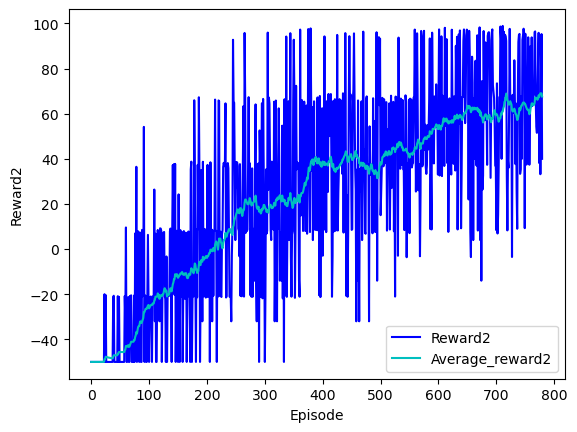

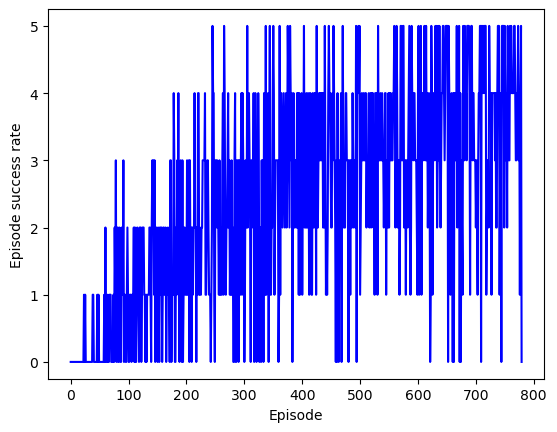

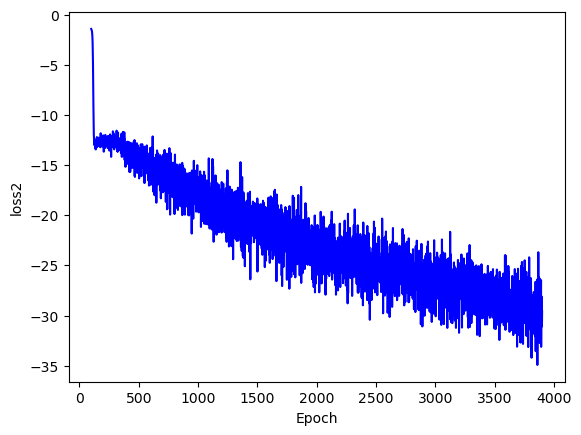

***** epoch 156 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 1 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82970.53282789333
r_em 57164.82891870994
57164.82891870994
ReWard2/R0 11.432965783741988
reward2 is: 19.432965783741988
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 2 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82198.4522895124
r_em 57457.464680883444
57457.464680883444
ReWard2/R0 11.491492936176689
reward2 is: 19.49149293617669
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 3 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81000.81855130133
r_em 57222.0810006714
57222.0810006714
ReWard2/R0 11.444416200134281
reward2 is: 19.44441620013428
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 4 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84877.38191059101
r_em 57850.23582495275
57850.23582495275
ReWard2/R0 11.57004716499055
reward2 is: 19.570047164990548
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.14904963486005865
***** epoch 156 episode 1 *****
***** frame 5 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 6 *****
1/1 [==============================] - 0s 19ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86367.38767783662
r_em 54213.790907819515
54213.790907819515
ReWard2/R0 10.842758181563903
reward2 is: 18.8427581815639
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 7 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 8 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86244.13772050866
r_em 53575.2040032133
53575.2040032133
ReWard2/R0 10.71504080064266
reward2 is: 18.71504080064266
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 9 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85590.74122854948
r_em 54380.27827840875
54380.27827840875
ReWard2/R0 10.87605565568175
reward2 is: 18.87605565568175
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.14867738321073024
***** epoch 156 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81805.27971655165
r_em 54406.61359213598
54406.61359213598
ReWard2/R0 10.881322718427196
reward2 is: 18.881322718427196
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 11 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82067.85444311597
r_em 54784.667994220945
54784.667994220945
ReWard2/R0 10.95693359884419
reward2 is: 18.956933598844188
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 12 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81718.88428783644
r_em 54590.59224924868
54590.59224924868
ReWard2/R0 10.918118449849736
reward2 is: 18.918118449849736
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 13 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82824.21476130192
r_em 54133.97360631161
54133.97360631161
ReWard2/R0 10.82679472126232
reward2 is: 18.82679472126232
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 14 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81819.15836213721
r_em 52949.07087394934
52949.07087394934
ReWard2/R0 10.589814174789868
reward2 is: 18.58981417478987
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.1483060612603612
***** epoch 156 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94387.23387744019
r_em 56789.23668572794
56789.23668572794
ReWard2/R0 11.357847337145587
reward2 is: 19.357847337145586
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 16 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94480.28918479239
r_em 57196.63594019009
57196.63594019009
ReWard2/R0 11.439327188038018
reward2 is: 19.439327188038018
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 17 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93698.71278170557
r_em 56245.03277622413
56245.03277622413
ReWard2/R0 11.249006555244826
reward2 is: 19.249006555244826
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 18 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93684.45037344849
r_em 56562.662496384764
56562.662496384764
ReWard2/R0 11.312532499276953
reward2 is: 19.312532499276955
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 19 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93572.81141223194
r_em 56083.77611368934
56083.77611368934
ReWard2/R0 11.216755222737868
reward2 is: 19.216755222737866
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.1479356666870272
***** epoch 156 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 21 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 22 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
**

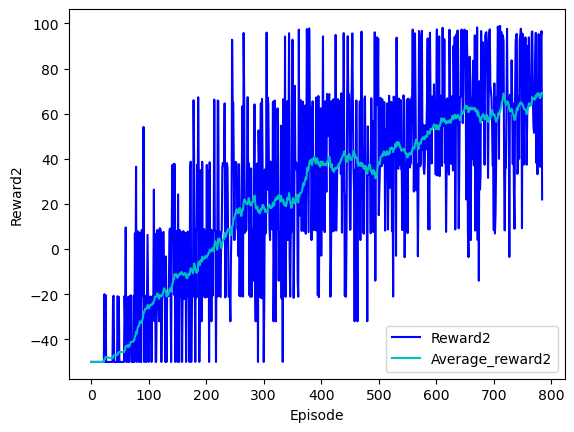

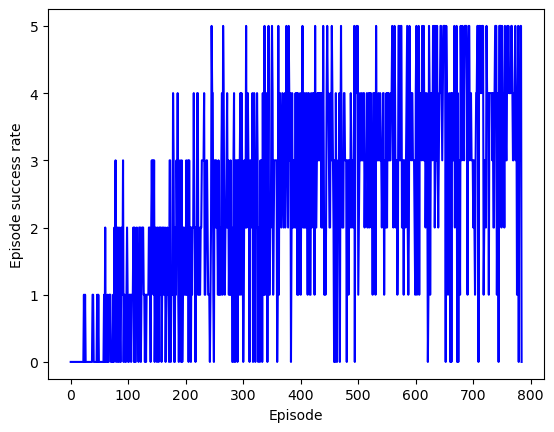

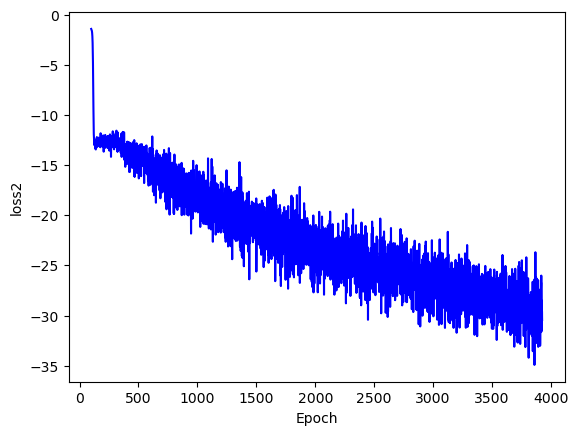

***** epoch 157 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77545.69174533778
r_em 55641.215774479286
55641.215774479286
ReWard2/R0 11.128243154895857
reward2 is: 19.128243154895856
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 1 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 86380.60255974391
r_em 54553.76905703908
54553.76905703908
ReWard2/R0 10.910753811407815
reward2 is: 18.910753811407815
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step
***** frame 2 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77321.45050936686
r_em 54810.43073217293
54810.43073217293
ReWard2/R0 10.962086146434586
reward2 is: 18.962086146434586
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 3 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 85887.73301467182
r_em 55111.103913780345
55111.103913780345
ReWard2/R0 11.022220782756069
reward2 is: 19.02222078275607
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step
***** frame 4 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 86955.61078118748
r_em 55716.15637252242
55716.15637252242
ReWard2/R0 11.143231274504483
reward2 is: 19.143231274504483
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.14719765041274788
***** epoch 157 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 23ms/step
we 

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 6 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93957.36346558966
r_em 58357.882691524464
58357.882691524464
ReWard2/R0 11.671576538304892
reward2 is: 19.67157653830489
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 7 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93987.62136007225
r_em 57792.94057883248
57792.94057883248
ReWard2/R0 11.558588115766495
reward2 is: 19.558588115766497
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 8 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93847.36912392564
r_em 58135.89333667504
58135.89333667504
ReWard2/R0 11.62717866733501
reward2 is: 19.62717866733501
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 9 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.14683002409689105
***** epoch 157 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79944.36804239365
r_em 57491.45369684368
57491.45369684368
ReWard2/R0 11.498290739368736
reward2 is: 19.498290739368734
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 11 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79804.70570903941
r_em 58004.60018949381
58004.60018949381
ReWard2/R0 11.600920037898762
reward2 is: 19.60092003789876
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 12 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83537.44714222314
r_em 57943.12744515713
57943.12744515713
ReWard2/R0 11.588625489031426
reward2 is: 19.588625489031426
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 13 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84421.30796748314
r_em 57397.4416645338
57397.4416645338
ReWard2/R0 11.47948833290676
reward2 is: 19.47948833290676
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 14 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84783.70488303744
r_em 56173.78585883515
56173.78585883515
ReWard2/R0 11.234757171767031
reward2 is: 19.23475717176703
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.14646331592821749
***** epoch 157 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83372.01877807632
r_em 57020.623883220134
57020.623883220134
ReWard2/R0 11.404124776644027
reward2 is: 19.404124776644025
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 16 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82751.23663434657
r_em 57143.286832764934
57143.286832764934
ReWard2/R0 11.428657366552986
reward2 is: 19.428657366552986
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 17 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 18 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82879.98969328089
r_em 56729.20612951193
56729.20612951193
ReWard2/R0 11.345841225902385
reward2 is: 19.345841225902383
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 19 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82267.21764737077
r_em 57065.63127036956
57065.63127036956
ReWard2/R0 11.413126254073912
reward2 is: 19.413126254073912
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.1460975236136534
***** epoch 157 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 21 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 22 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
**

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.14573264486585208


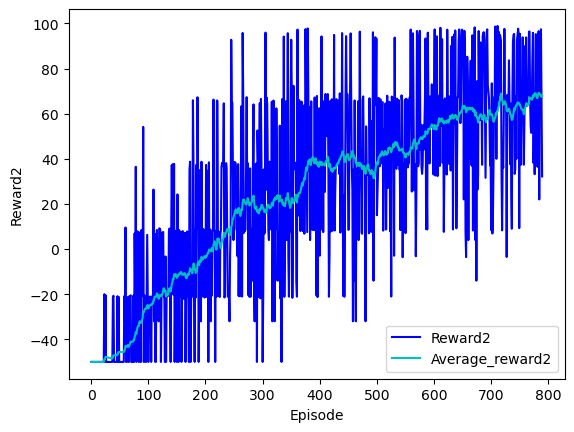

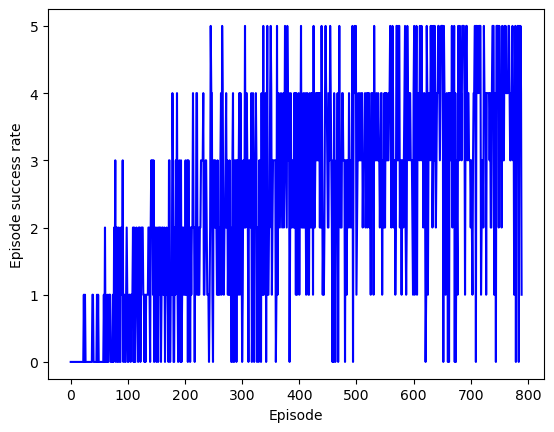

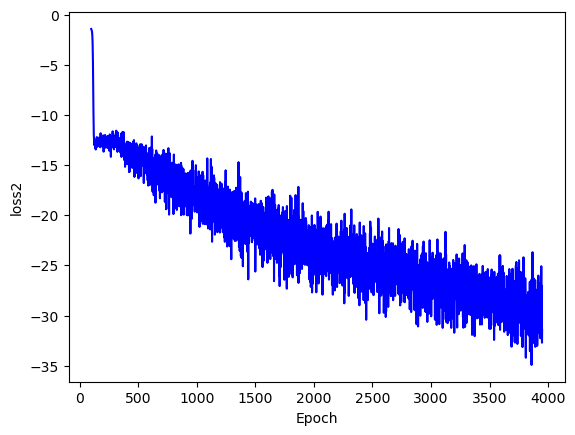

***** epoch 158 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92320.25494863035
r_em 53159.30233805952
53159.30233805952
ReWard2/R0 10.631860467611904
reward2 is: 18.631860467611904
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 1 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93550.02385925729
r_em 54039.421915338135
54039.421915338135
ReWard2/R0 10.807884383067627
reward2 is: 18.807884383067627
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 2 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92959.50357734857
r_em 54658.906583644835
54658.906583644835
ReWard2/R0 10.931781316728967
reward2 is: 18.931781316728966
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 4 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94079.68980222654
r_em 55724.11523637284
55724.11523637284
ReWard2/R0 11.144823047274567
reward2 is: 19.144823047274567
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.14536867740317935
***** epoch 158 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 101889.78026399326
r_em 62074.34825821581
62074.34825821581
ReWard2/R0 12.414869651643162
reward2 is: 20.414869651643162
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step
***** frame 6 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 104720.11807572882
r_em 60242.25279046257
60242.25279046257
ReWard2/R0 12.048450558092513
reward2 is: 20.04845055809251
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 7 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 8 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 100727.5823494241
r_em 61203.088964736875
61203.088964736875
ReWard2/R0 12.240617792947376
reward2 is: 20.240617792947376
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 9 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 103952.84785017825
r_em 59880.50771863584
59880.50771863584
ReWard2/R0 11.976101543727168
reward2 is: 19.976101543727168
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.14500561894969952
***** epoch 158 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 11 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91993.79217971367
r_em 52093.12236806335
52093.12236806335
ReWard2/R0 10.41862447361267
reward2 is: 18.41862447361267
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 12 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 13 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 14 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.14464346723516094
***** epoch 158 episode 3 *****
*

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 16 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77150.45869177248
r_em 56920.46008841017
56920.46008841017
ReWard2/R0 11.384092017682033
reward2 is: 19.384092017682033
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 17 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77778.08602230811
r_em 56587.40096659514
56587.40096659514
ReWard2/R0 11.317480193319028
reward2 is: 19.317480193319028
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 18 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 19 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80005.6202859452
r_em 57544.35487055976
57544.35487055976
ReWard2/R0 11.508870974111952
reward2 is: 19.50887097411195
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.14428221999498203
***** epoch 158 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89743.02495032737
r_em 48414.805920011866
48414.805920011866
ReWard2/R0 9.682961184002373
reward2 is: 17.682961184002373
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 21 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 22 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90287.41099892242
r_em 49919.08970526147
49919.08970526147
ReWard2/R0 9.983817941052294
reward2 is: 17.983817941052294
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 23 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90964.16088919522
r_em 51449.367225151276
51449.367225151276
ReWard2/R0 10.289873445030254
reward2 is: 18.289873445030253
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 24 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90503.35771505954
r_em 49945.69289688559
49945.69289688559
ReWard2/R0 9.989138579377117
reward2 is: 17.98913857937712
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.1439218749702369


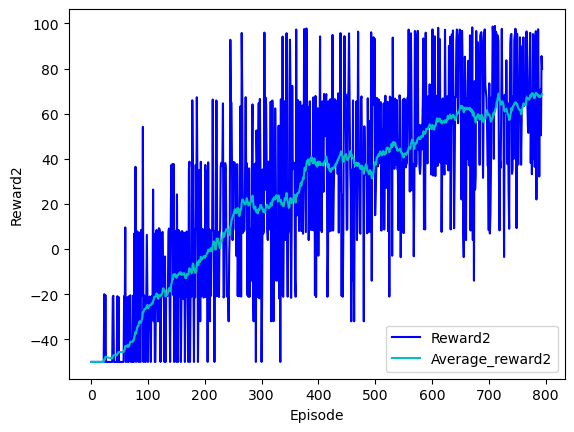

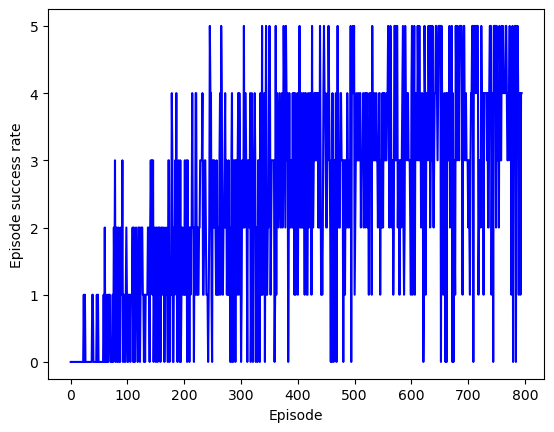

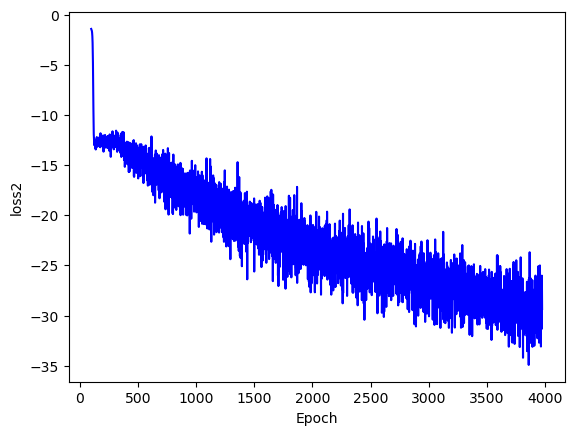

***** epoch 159 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 1 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 91114.33094034108
r_em 52267.61934755829
52267.61934755829
ReWard2/R0 10.453523869511658
reward2 is: 18.453523869511656
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step
***** frame 2 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 90556.57234736306
r_em 51285.208510926444
51285.208510926444
ReWard2/R0 10.257041702185289
reward2 is: 18.25704170218529
total number of ur2 RBs

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 4 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 90922.71050061242
r_em 51558.977646249725
51558.977646249725
ReWard2/R0 10.311795529249945
reward2 is: 18.311795529249945
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.14356242990764143
***** epoch 159 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81878.85406145241
r_em 54180.18943695199
54180.18943695199
ReWard2/R0 10.836037887390397
reward2 is: 18.836037887390397
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 6 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82851.75922310005
r_em 53577.66915480147
53577.66915480147
ReWard2/R0 10.715533830960295
reward2 is: 18.715533830960297
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 7 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83213.07360787154
r_em 52968.82457832095
52968.82457832095
ReWard2/R0 10.59376491566419
reward2 is: 18.593764915664188
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 8 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83148.77252395893
r_em 51481.9298466367
51481.9298466367
ReWard2/R0 10.296385969327341
reward2 is: 18.29638596932734
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 9 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83342.24263303309
r_em 50552.423007714
50552.423007714
ReWard2/R0 10.110484601542801
reward2 is: 18.1104846015428
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.14320388255953895
***** epoch 159 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77223.01238941158
r_em 54601.569491031376
54601.569491031376
ReWard2/R0 10.920313898206276
reward2 is: 18.920313898206274
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 11 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 12 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77225.96088809191
r_em 57836.93589769153
57836.93589769153
ReWard2/R0 11.567387179538306
reward2 is: 19.567387179538308
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 13 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 74296.65947474386
r_em 52633.14379802563
52633.14379802563
ReWard2/R0 10.526628759605126
reward2 is: 18.526628759605124
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 14 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.14284623068388644
***** epoch 159 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95832.30572183592
r_em 54401.780828975025
54401.780828975025
ReWard2/R0 10.880356165795005
reward2 is: 18.880356165795007
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 16 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96094.99124217767
r_em 53395.561829654835
53395.561829654835
ReWard2/R0 10.679112365930967
reward2 is: 18.67911236593097
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 17 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 18 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 19 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.1424894720442403
***** epoch 159 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 21 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88676.89747089152
r_em 57131.69453168986
57131.69453168986
ReWard2/R0 11.426338906337971
reward2 is: 19.42633890633797
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 22 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89035.2527626403
r_em 56468.4631843823
56468.4631843823
ReWard2/R0 11.293692636876461
reward2 is: 19.29369263687646
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 23 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89758.30817620447
r_em 56733.06345921364
56733.06345921364
ReWard2/R0 11.346612691842727
reward2 is: 19.34661269184273
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 24 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90070.95107021504
r_em 57176.88770364237
57176.88770364237
ReWard2/R0 11.435377540728474
reward2 is: 19.435377540728474
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.14213360440974254


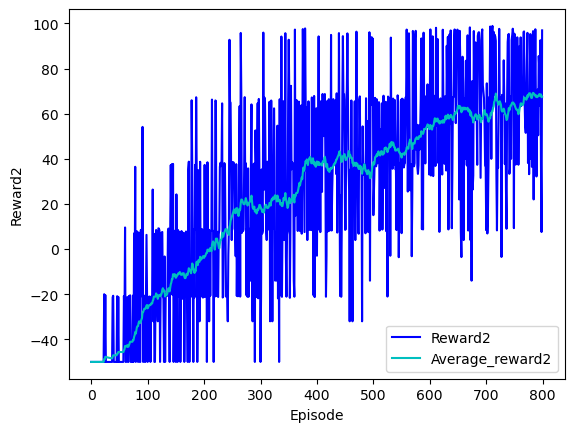

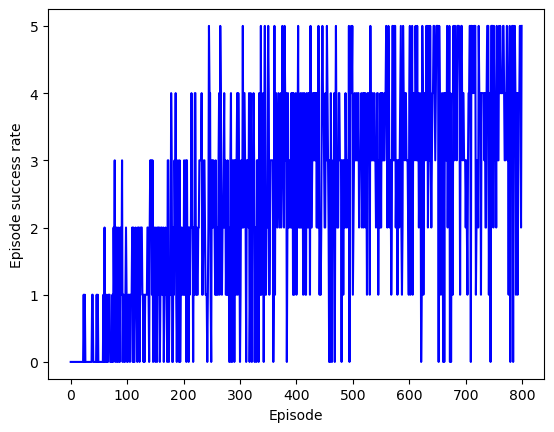

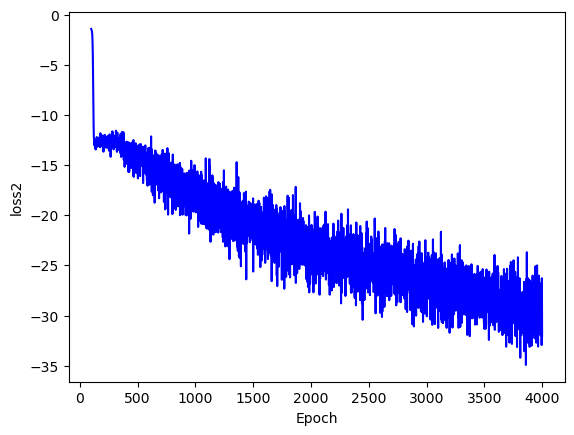

***** epoch 160 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 101807.92266350763
r_em 58391.72987996969
58391.72987996969
ReWard2/R0 11.678345975993938
reward2 is: 19.67834597599394
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 1 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 100532.6917605294
r_em 57733.08220597968
57733.08220597968
ReWard2/R0 11.546616441195935
reward2 is: 19.546616441195937
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 2 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 99248.28596293987
r_em 57855.282464807555
57855.282464807555
ReWard2/R0 11.57105649296151
reward2 is: 19.57105649296151
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 3 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 97682.49061187627
r_em 58156.09753749322
58156.09753749322
ReWard2/R0 11.631219507498644
reward2 is: 19.631219507498642
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 4 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 98942.4960632161
r_em 57840.84155423904
57840.84155423904
ReWard2/R0 11.568168310847808
reward2 is: 19.56816831084781
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.14177862555510667
***** epoch 160 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 6 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 7 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84687.8622732409
r_em 57473.76932515192
57473.76932515192
ReWard2/R0 11.494753865030384
reward2 is: 19.494753865030383
total number of ur2 RBs: 8.0
total n

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 8 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 9 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.14142453326060386
***** epoch 160 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82447.60960790454
r_em 53048.89262242046
53048.89262242046
ReWard2/R0 10.609778524484092
reward2 is: 18.609778524484092
total number 

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 11 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80121.82913211046
r_em 54254.14538538644
54254.14538538644
ReWard2/R0 10.850829077077288
reward2 is: 18.850829077077286
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 12 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 13 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83390.19557272553
r_em 54032.42333778979
54032.42333778979
ReWard2/R0 10.806484667557958
reward2 is: 18.80648466755796
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 14 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84498.27616955891
r_em 54744.57761893934
54744.57761893934
ReWard2/R0 10.948915523787868
reward2 is: 18.948915523787868
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.14107132531204905
***** epoch 160 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 16 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 17 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
*

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 21 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87838.55954188871
r_em 51999.78709973872
51999.78709973872
ReWard2/R0 10.399957419947745
reward2 is: 18.399957419947746
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 23 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89895.22364845568
r_em 51209.19931651485
51209.19931651485
ReWard2/R0 10.241839863302971
reward2 is: 18.24183986330297
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.1403675536236792


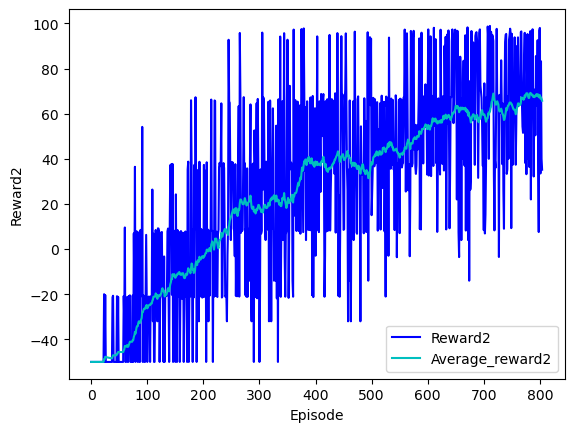

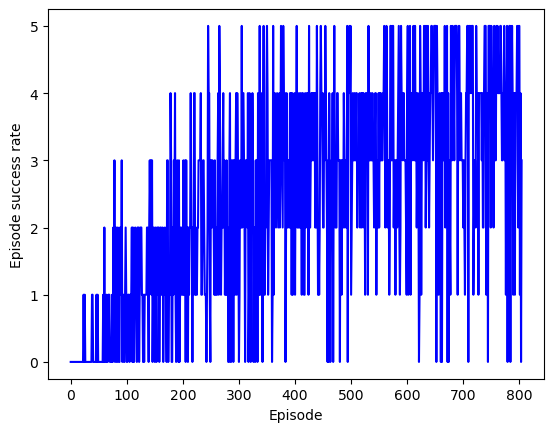

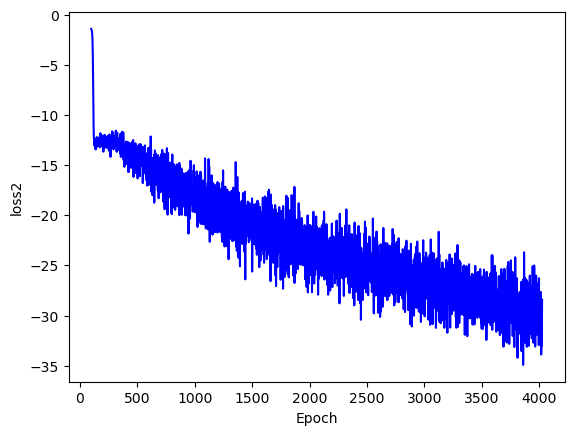

***** epoch 161 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85996.66425160685
r_em 49311.89893727843
49311.89893727843
ReWard2/R0 9.862379787455685
reward2 is: 17.862379787455687
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 1 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86703.51110381001
r_em 48722.113622861194
48722.113622861194
ReWard2/R0 9.744422724572239
reward2 is: 17.74442272457224
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 3 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87493.12151639018
r_em 50553.40748440611
50553.40748440611
ReWard2/R0 10.110681496881222
reward2 is: 18.11068149688122
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 4 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88036.96664548645
r_em 51372.56967863197
51372.56967863197
ReWard2/R0 10.274513935726393
reward2 is: 18.274513935726393
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.14001698548308852
***** epoch 161 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81497.70928242146
r_em 54989.64926659599
54989.64926659599
ReWard2/R0 10.997929853319198
reward2 is: 18.9979298533192
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 6 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86953.12870003087
r_em 55366.22058392489
55366.22058392489
ReWard2/R0 11.073244116784979
reward2 is: 19.073244116784977
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 7 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86087.14176450485
r_em 54927.43551165962
54927.43551165962
ReWard2/R0 10.985487102331923
reward2 is: 18.985487102331923
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 8 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88465.95097978115
r_em 54343.84114732591
54343.84114732591
ReWard2/R0 10.868768229465182
reward2 is: 18.868768229465182
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 9 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88324.15261881414
r_em 54490.5173706247
54490.5173706247
ReWard2/R0 10.898103474124941
reward2 is: 18.89810347412494
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.13966729288686708
***** epoch 161 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83545.44993194836
r_em 53268.80508741287
53268.80508741287
ReWard2/R0 10.653761017482573
reward2 is: 18.653761017482573
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 11 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 76793.6721063971
r_em 53688.02110364604
53688.02110364604
ReWard2/R0 10.737604220729208
reward2 is: 18.73760422072921
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 12 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83721.50032277098
r_em 54142.597424103675
54142.597424103675
ReWard2/R0 10.828519484820735
reward2 is: 18.828519484820735
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 13 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 14 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85220.68413651
r_em 55787.71405237524
55787.71405237524
ReWard2/R0 11.157542810475048
reward2 is: 19.15754281047505
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.1393184736483417
***** epoch 161 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 76869.39566304351
r_em 56391.59055249987
56391.59055249987
ReWard2/R0 11.278318110499974
reward2 is: 19.278318110499974
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 16 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 75230.1916000205
r_em 56653.68482389563
56653.68482389563
ReWard2/R0 11.330736964779126
reward2 is: 19.330736964779128
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 17 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 76258.26424482884
r_em 57369.72118889174
57369.72118889174
ReWard2/R0 11.473944237778348
reward2 is: 19.473944237778348
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 18 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 72089.56439025913
r_em 57673.617760406494
57673.617760406494
ReWard2/R0 11.5347235520813
reward2 is: 19.5347235520813
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 19 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 72802.65722364206
r_em 57575.710042635976
57575.710042635976
ReWard2/R0 11.515142008527196
reward2 is: 19.515142008527196
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.13897052558630044
***** epoch 161 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85926.86979001484
r_em 54983.71206049831
54983.71206049831
ReWard2/R0 10.996742412099662
reward2 is: 18.996742412099664
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 21 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86583.85160993185
r_em 55144.53603643626
55144.53603643626
ReWard2/R0 11.02890720728725
reward2 is: 19.02890720728725
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 22 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86530.69119159173
r_em 54187.013652035406
54187.013652035406
ReWard2/R0 10.837402730407081
reward2 is: 18.83740273040708
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 23 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88607.90598578753
r_em 54046.38647627444
54046.38647627444
ReWard2/R0 10.809277295254889
reward2 is: 18.809277295254887
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 24 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87825.19178223299
r_em 54080.512914911356
54080.512914911356
ReWard2/R0 10.816102582982271
reward2 is: 18.81610258298227
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Epsilon_hist is: 0.13862344652497893


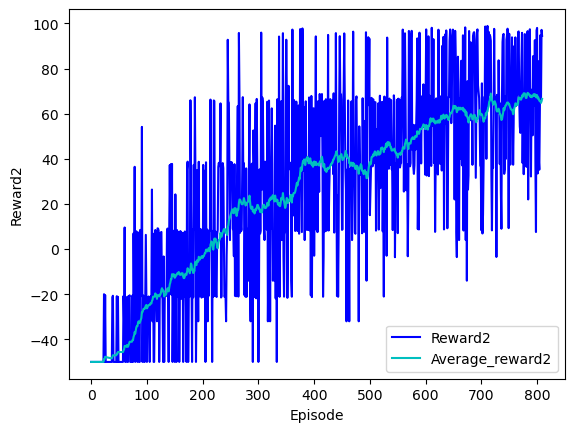

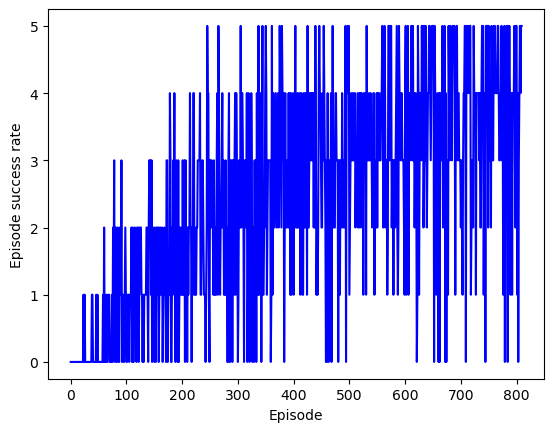

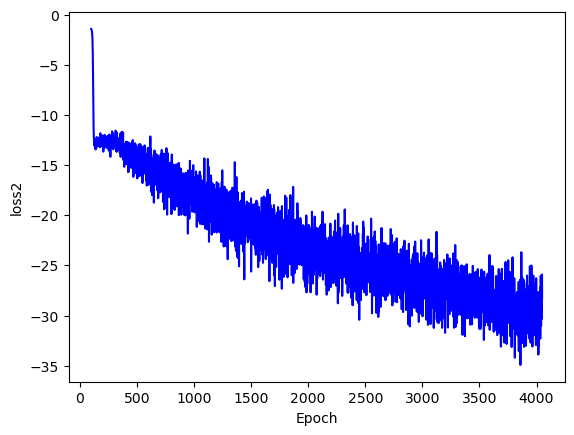

***** epoch 162 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 92221.6401577832
r_em 52198.82744407157
52198.82744407157
ReWard2/R0 10.439765488814313
reward2 is: 18.439765488814313
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 3ms/step
***** frame 1 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84861.54439686167
r_em 53700.87958924866
53700.87958924866
ReWard2/R0 10.740175917849731
reward2 is: 18.740175917849733
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 2 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82354.91022034203
r_em 54059.502153271045
54059.502153271045
ReWard2/R0 10.811900430654209
reward2 is: 18.81190043065421
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 4 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83920.1503538922
r_em 53316.33122881066
53316.33122881066
ReWard2/R0 10.663266245762133
reward2 is: 18.66326624576213
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 9ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
Epsilon_hist is: 0.13827723429404684
***** epoch 162 episode 1 *****
***** frame 5 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 5.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 13ms/step
***** frame 6 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 9ms/step
***** frame 7 *****
1/1 [==============================] - 0s 51ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95546.91816186525
r_em 57204.10414484724
57204.10414484724
ReWard2/R0 11.440820828969448
reward2 is: 19.44082082896945
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [====

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 12ms/step
***** frame 8 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 9ms/step
***** frame 9 *****
1/1 [==============================] - 0s 53ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95000.91302255969
r_em 56775.32643179556
56775.32643179556
ReWard2/R0 11.355065286359112
reward2 is: 19.355065286359114
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.13793188672859416
***** epoch 162 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 50ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87286.91066728423
r_em 53302.9986485155
53302.9986485155
ReWard2/R0 10.660599729703101
reward2 is: 18.6605997297031
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 11 *****
1/1 [==============================] - 0s 39ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86296.04518998189
r_em 53964.87717270155
53964.87717270155
ReWard2/R0 10.79297543454031
reward2 is: 18.79297543454031
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 9ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 9ms/step
***** frame 12 *****
1/1 [==============================] - 0s 51ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86953.7360229358
r_em 54202.06117993349
54202.06117993349
ReWard2/R0 10.840412235986697
reward2 is: 18.840412235986697
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 9ms/step
***** frame 13 *****
1/1 [==============================] - 0s 56ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87375.95177207852
r_em 53755.398159821016
53755.398159821016
ReWard2/R0 10.751079631964203
reward2 is: 18.751079631964203
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 9ms/step
***** frame 14 *****
1/1 [==============================] - 0s 43ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87187.52168361969
r_em 54148.869743943535
54148.869743943535
ReWard2/R0 10.829773948788707
reward2 is: 18.829773948788706
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.13758740166911776
***** epoch 162 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 16 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 17 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
*

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.1372437769615079
***** epoch 162 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88306.8546500233
r_em 55467.408903361225
55467.408903361225
ReWard2/R0 11.093481780672246
reward2 is: 19.093481780672246
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 21 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87797.88203561345
r_em 52419.34359165594
52419.34359165594
ReWard2/R0 10.483868718331188
reward2 is: 18.483868718331188
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 22 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89293.91894121817
r_em 50749.25343219244
50749.25343219244
ReWard2/R0 10.149850686438487
reward2 is: 18.149850686438487
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 23 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88763.31004984386
r_em 50637.76910484437
50637.76910484437
ReWard2/R0 10.127553820968874
reward2 is: 18.127553820968874
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 24 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.13690101045703473


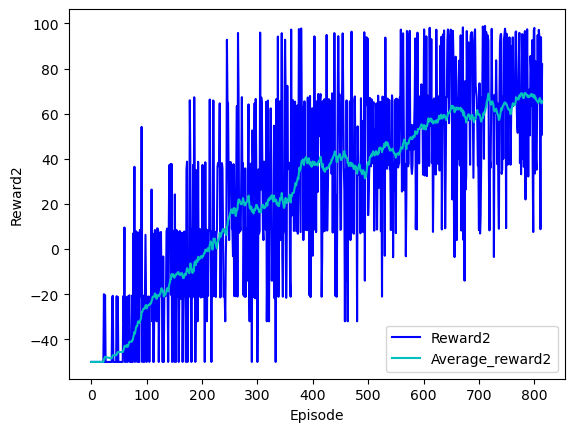

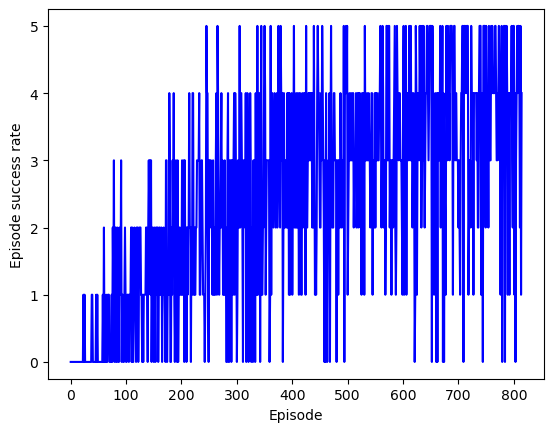

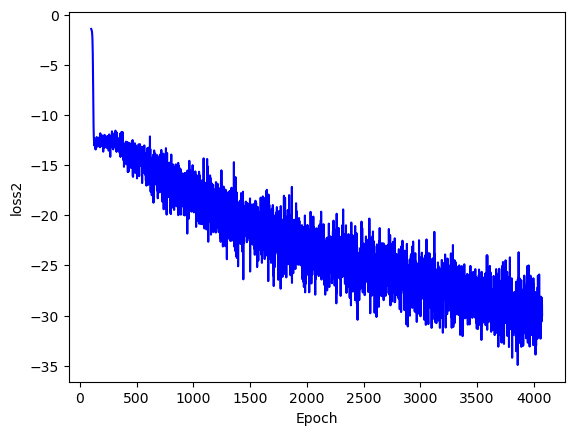

***** epoch 163 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 1 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 70215.57511997795
r_em 57838.74482343531
57838.74482343531
ReWard2/R0 11.56774896468706
reward2 is: 19.567748964687063
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 2 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 74644.01708391632
r_em 57901.43799160881
57901.43799160881
ReWard2/R0 11.580287598321762
reward2 is: 19.58028759832176
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 3 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88681.26797817598
r_em 58176.97198888418
58176.97198888418
ReWard2/R0 11.635394397776835
reward2 is: 19.635394397776835
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 4 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91111.01350763543
r_em 58390.998757499765
58390.998757499765
ReWard2/R0 11.678199751499953
reward2 is: 19.678199751499953
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.13655910001233484
***** epoch 163 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86515.44218772952
r_em 57441.54550665905
57441.54550665905
ReWard2/R0 11.48830910133181
reward2 is: 19.488309101331808
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 6 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85942.26735390746
r_em 57293.38996316408
57293.38996316408
ReWard2/R0 11.458677992632817
reward2 is: 19.458677992632815
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 7 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85606.11025652383
r_em 57943.34615924601
57943.34615924601
ReWard2/R0 11.588669231849202
reward2 is: 19.588669231849202
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 8 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87297.80554050024
r_em 57601.06740334869
57601.06740334869
ReWard2/R0 11.520213480669737
reward2 is: 19.52021348066974
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 9 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85316.25889965295
r_em 57513.82095027817
57513.82095027817
ReWard2/R0 11.502764190055634
reward2 is: 19.502764190055636
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.13621804348939787
***** epoch 163 episode 2 *****
***** frame 10 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 11 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93207.3956675149
r_em 57593.44876452691
57593.44876452691
ReWard2/R0 11.518689752905383
reward2 is: 19.51868975290538
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 12 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 93577.69998758253
r_em 57528.75187928111
57528.75187928111
ReWard2/R0 11.505750375856222
reward2 is: 19.505750375856223
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step
***** frame 13 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94642.75365239326
r_em 57716.69224270264
57716.69224270264
ReWard2/R0 11.543338448540528
reward2 is: 19.543338448540528
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 14 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.13587783875555312
***** epoch 163 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82357.18864535443
r_em 55089.72920231947
55089.72920231947
ReWard2/R0 11.017945840463893
reward2 is: 19.017945840463895
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 16 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81616.08477749466
r_em 54877.82290564963
54877.82290564963
ReWard2/R0 10.975564581129925
reward2 is: 18.975564581129923
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 17 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81293.09525717991
r_em 54878.777382531276
54878.777382531276
ReWard2/R0 10.975755476506254
reward2 is: 18.975755476506254
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 18 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81343.74247215282
r_em 54826.07355147163
54826.07355147163
ReWard2/R0 10.965214710294326
reward2 is: 18.965214710294326
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 19 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81216.79075998045
r_em 55745.940743814994
55745.940743814994
ReWard2/R0 11.149188148762999
reward2 is: 19.149188148763
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.13553848368345633
***** epoch 163 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 88073.7846506935
r_em 56869.656356619395
56869.656356619395
ReWard2/R0 11.37393127132388
reward2 is: 19.37393127132388
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step
***** frame 21 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82856.95904719272
r_em 56840.32963489282
56840.32963489282
ReWard2/R0 11.368065926978565
reward2 is: 19.368065926978566
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
***** frame 23 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84323.59900025872
r_em 56778.084209348635
56778.084209348635
ReWard2/R0 11.355616841869727
reward2 is: 19.355616841869725
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 24 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88890.32860446353
r_em 56926.10740514468
56926.10740514468
ReWard2/R0 11.385221481028935
reward2 is: 19.385221481028935
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.1351999761510762


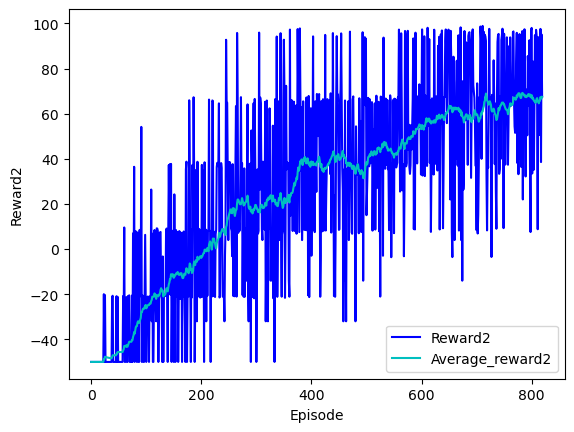

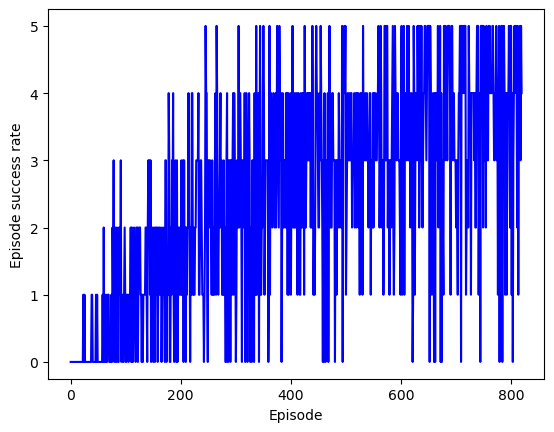

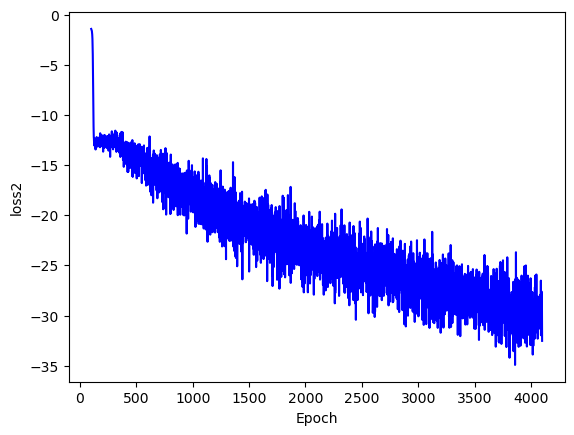

***** epoch 164 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95815.91401818334
r_em 56802.349272320615
56802.349272320615
ReWard2/R0 11.360469854464123
reward2 is: 19.36046985446412
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 1 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94120.4367895322
r_em 57139.03943450205
57139.03943450205
ReWard2/R0 11.427807886900409
reward2 is: 19.42780788690041
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 2 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95899.45568614767
r_em 56823.242568902395
56823.242568902395
ReWard2/R0 11.364648513780478
reward2 is: 19.36464851378048
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 3 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94130.2752117501
r_em 57483.28395480558
57483.28395480558
ReWard2/R0 11.496656790961115
reward2 is: 19.496656790961115
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 4 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95032.79826098961
r_em 57689.37347702132
57689.37347702132
ReWard2/R0 11.537874695404264
reward2 is: 19.537874695404263
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.1348623140416812
***** epoch 164 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91451.44865029585
r_em 56980.08885214608
56980.08885214608
ReWard2/R0 11.396017770429216
reward2 is: 19.396017770429218
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 6 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90305.05947082509
r_em 56985.568566195514
56985.568566195514
ReWard2/R0 11.397113713239102
reward2 is: 19.3971137132391
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 7 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 8 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89791.60580422994
r_em 56876.00308870939
56876.00308870939
ReWard2/R0 11.375200617741879
reward2 is: 19.37520061774188
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 9 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90945.64271508125
r_em 56511.45832814823
56511.45832814823
ReWard2/R0 11.302291665629646
reward2 is: 19.302291665629646
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.1345254952438264
***** epoch 164 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90686.35851710069
r_em 54188.581033709415
54188.581033709415
ReWard2/R0 10.837716206741883
reward2 is: 18.83771620674188
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 11 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87423.05941900314
r_em 53738.077535134966
53738.077535134966
ReWard2/R0 10.747615507026993
reward2 is: 18.747615507026993
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 12 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93800.74133845468
r_em 53214.29411577997
53214.29411577997
ReWard2/R0 10.642858823155995
reward2 is: 18.642858823155997
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 13 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92959.52133762868
r_em 51318.17427698733
51318.17427698733
ReWard2/R0 10.263634855397466
reward2 is: 18.263634855397466
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 14 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 5.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.13418951765134016
***** epoch 164 episode 3 *****
***** frame 15 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 16 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 97704.24482639538
r_em 55779.411358627374
55779.411358627374
ReWard2/R0 11.155882271725474
reward2 is: 19.155882271725474
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 17 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96794.93469980982
r_em 55268.87850152463
55268.87850152463
ReWard2/R0 11.053775700304927
reward2 is: 19.053775700304925
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 18 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95669.62037510265
r_em 55470.03863213332
55470.03863213332
ReWard2/R0 11.094007726426664
reward2 is: 19.094007726426664
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 19 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.13385437916331103
***** epoch 164 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83838.55539946634
r_em 56081.12864349215
56081.12864349215
ReWard2/R0 11.21622572869843
reward2 is: 19.21622572869843
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 23 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85043.84861742836
r_em 55891.06175209923
55891.06175209923
ReWard2/R0 11.178212350419846
reward2 is: 19.178212350419848
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 24 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84501.22136379046
r_em 55470.551419143165
55470.551419143165
ReWard2/R0 11.094110283828632
reward2 is: 19.094110283828634
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
Epsilon_hist is: 0.13352007768407453


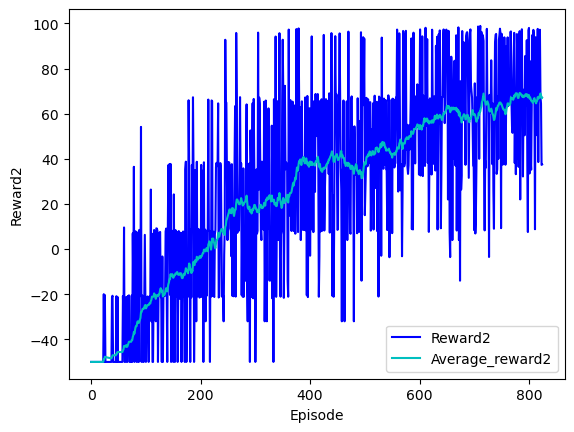

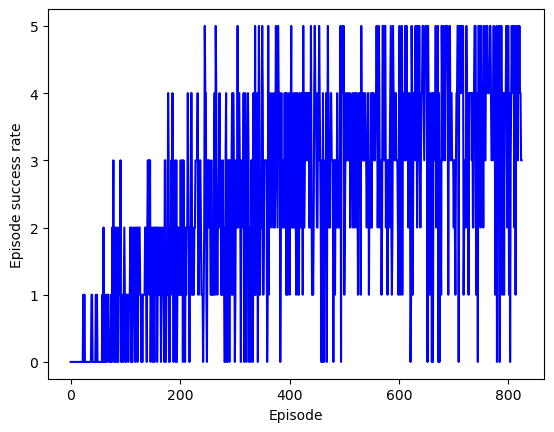

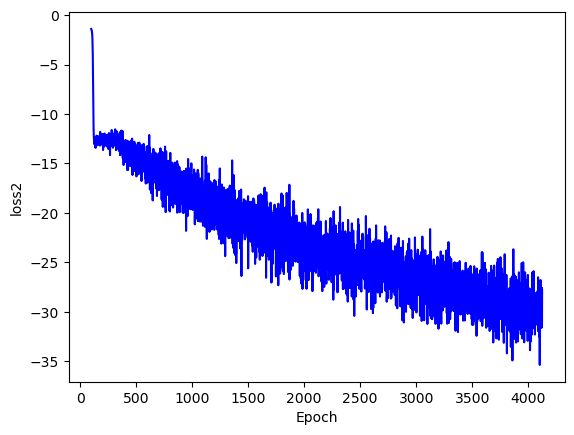

***** epoch 165 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90499.34510357695
r_em 56021.752392363196
56021.752392363196
ReWard2/R0 11.204350478472639
reward2 is: 19.20435047847264
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 1 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88519.35707245725
r_em 56221.215411864614
56221.215411864614
ReWard2/R0 11.244243082372924
reward2 is: 19.244243082372925
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 3 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89058.32501025224
r_em 54404.39213102721
54404.39213102721
ReWard2/R0 10.880878426205442
reward2 is: 18.88087842620544
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 4 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90619.51441408633
r_em 54212.13914596964
54212.13914596964
ReWard2/R0 10.842427829193928
reward2 is: 18.84242782919393
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.13318661112320024
***** epoch 165 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 6 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87830.99976820324
r_em 54990.082417894024
54990.082417894024
ReWard2/R0 10.998016483578805
reward2 is: 18.998016483578805
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 7 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89770.91362760557
r_em 55515.47553673158
55515.47553673158
ReWard2/R0 11.103095107346316
reward2 is: 19.103095107346316
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 8 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 9 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 90530.96595783431
r_em 55074.77907680982
55074.77907680982
ReWard2/R0 11.014955815361963
reward2 is: 19.014955815361965
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.13285397739547844
***** epoch 165 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 87190.19302943436
r_em 54030.75956

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 18 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 19 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 86920.4191011975
r_em 53656.769634306664
53656.769634306664
ReWard2/R0 10.731353926861333
reward2 is: 18.73135392686133
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.13219120012467986
***** epoch 165 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 R

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 22 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88905.2353992471
r_em 56066.86999352692
56066.86999352692
ReWard2/R0 11.213373998705384
reward2 is: 19.213373998705386
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 23 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88294.59420358564
r_em 56244.6041271609
56244.6041271609
ReWard2/R0 11.24892082543218
reward2 is: 19.24892082543218
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 24 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87500.31437751775
r_em 56370.705799136405
56370.705799136405
ReWard2/R0 11.27414115982728
reward2 is: 19.27414115982728
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.13186105243717083


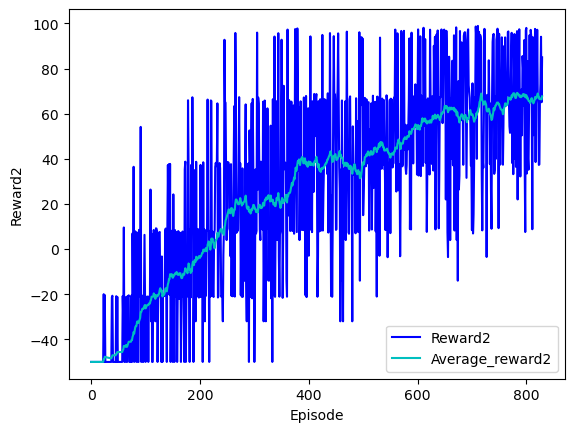

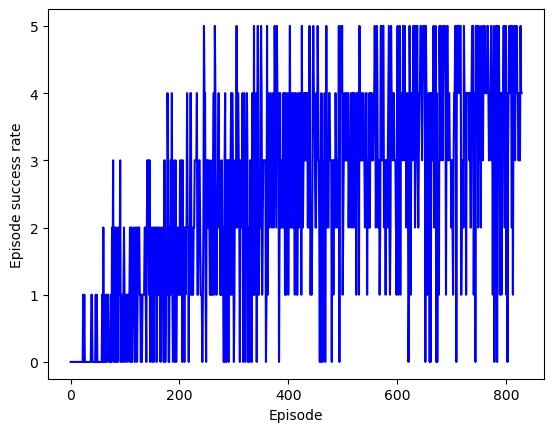

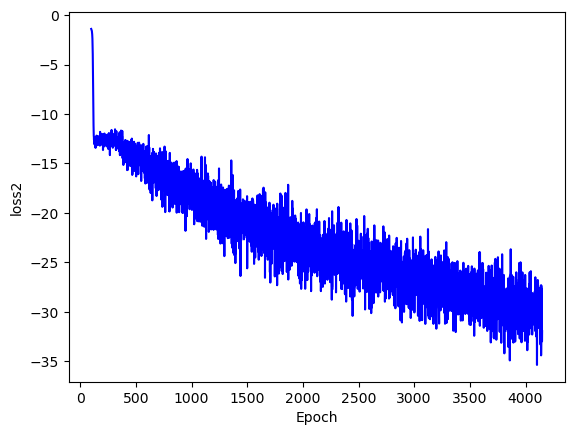

***** epoch 166 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95122.31663167842
r_em 56707.51319654614
56707.51319654614
ReWard2/R0 11.341502639309228
reward2 is: 19.341502639309226
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 1 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93868.37113094896
r_em 56642.02990826746
56642.02990826746
ReWard2/R0 11.328405981653493
reward2 is: 19.328405981653493
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 2 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93250.7396972421
r_em 56250.81778721293
56250.81778721293
ReWard2/R0 11.250163557442587
reward2 is: 19.250163557442587
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 3 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92864.43453369461
r_em 56275.2823516863
56275.2823516863
ReWard2/R0 11.25505647033726
reward2 is: 19.25505647033726
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 4 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91081.18535719872
r_em 56350.332361014924
56350.332361014924
ReWard2/R0 11.270066472202984
reward2 is: 19.270066472202984
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.13153172929392393
***** epoch 166 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89017.05851618554
r_em 59383.06553147278
59383.06553147278
ReWard2/R0 11.876613106294556
reward2 is: 19.876613106294556
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 6 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88858.77361408985
r_em 59228.66094768446
59228.66094768446
ReWard2/R0 11.845732189536893
reward2 is: 19.845732189536893
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 7 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89230.54378187231
r_em 59169.70959792698
59169.70959792698
ReWard2/R0 11.833941919585396
reward2 is: 19.833941919585396
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 8 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 9 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90259.51637687717
r_em 59087.037228838584
59087.037228838584
ReWard2/R0 11.817407445767717
reward2 is: 19.817407445767717
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.13120322863563882
***** epoch 166 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95554.53534764645
r_em 54876.24128880041
54876.24128880041
ReWard2/R0 10.975248257760082
reward2 is: 18.975248257760082
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 11 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 12 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95992.03294758374
r_em 54053.68590032067
54053.68590032067
ReWard2/R0 10.810737180064134
reward2 is: 18.810737180064134
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 13 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 14 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.13087554840815832
***** epoch 166 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82612.54543791065
r_em 53792.288563686365
53792.288563686365
ReWard2/R0 10.758457712737274
reward2 is: 18.758457712737275
total num

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 16 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78751.94383614958
r_em 53906.209906219825
53906.209906219825
ReWard2/R0 10.781241981243966
reward2 is: 18.781241981243966
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 17 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80233.13868997645
r_em 54925.17835112512
54925.17835112512
ReWard2/R0 10.985035670225024
reward2 is: 18.985035670225024
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 18 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81259.53390676789
r_em 54323.22357687252
54323.22357687252
ReWard2/R0 10.864644715374505
reward2 is: 18.864644715374503
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 19 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79487.41176006678
r_em 53249.68362926171
53249.68362926171
ReWard2/R0 10.649936725852342
reward2 is: 18.649936725852342
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.13054868656245544
***** epoch 166 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91635.43953997862
r_em 51908.91007318884
51908.91007318884
ReWard2/R0 10.381782014637768
reward2 is: 18.381782014637768
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 21 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93543.30421966795
r_em 52752.337049015536
52752.337049015536
ReWard2/R0 10.550467409803106
reward2 is: 18.550467409803105
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 22 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 93861.52112296675
r_em 53142.158761748535
53142.158761748535
ReWard2/R0 10.628431752349707
reward2 is: 18.628431752349705
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step
***** frame 23 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 93409.20281819004
r_em 54340.20021441404
54340.20021441404
ReWard2/R0 10.868040042882809
reward2 is: 18.86804004288281
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step
***** frame 24 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: opt

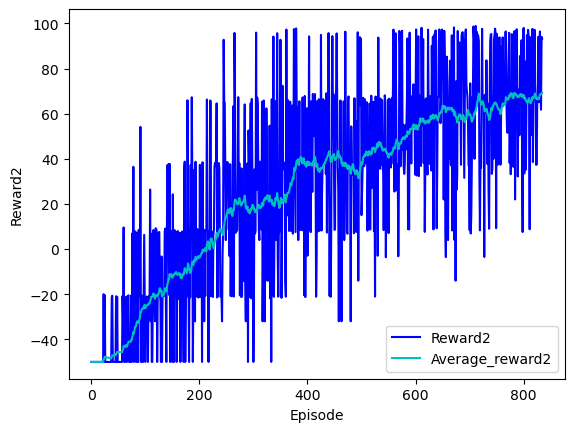

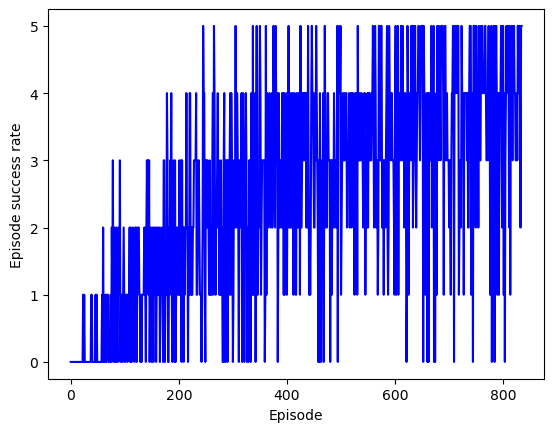

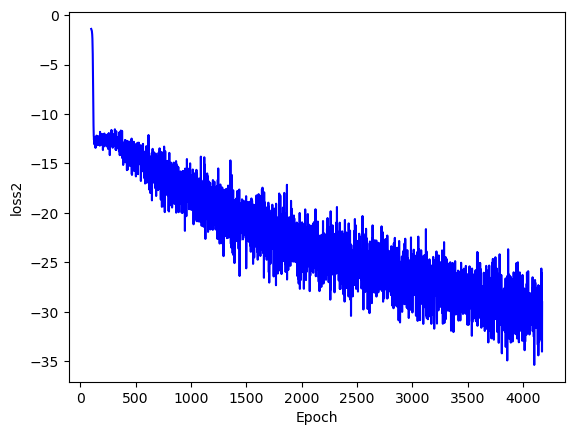

***** epoch 167 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85896.22983813212
r_em 53224.64330520264
53224.64330520264
ReWard2/R0 10.644928661040527
reward2 is: 18.644928661040527
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 1 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85527.22855786922
r_em 53338.78901218194
53338.78901218194
ReWard2/R0 10.667757802436387
reward2 is: 18.667757802436387
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 2 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 3 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 4 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84887.5721871134
r_em 51980.979939721576
51980.979939721576
ReWard2/R0 10.396195987944315
reward2 is: 18.396195987944317
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.12989740984584922
***** epoch 167 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 75811.08727666504
r_em 53915.03170357175
53915.03170357175
ReWard2/R0 10.783006340714351
reward2 is: 18.78300634071435
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 6 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 76849.23003512433
r_em 55160.345608040014
55160.345608040014
ReWard2/R0 11.032069121608004
reward2 is: 19.032069121608004
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 7 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 76871.37670388649
r_em 54399.259881855236
54399.259881855236
ReWard2/R0 10.879851976371047
reward2 is: 18.879851976371047
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 8 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 9 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 76436.46810716888
r_em 55621.51154521122
55621.51154521122
ReWard2/R0 11.124302309042244
reward2 is: 19.124302309042243
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.1295729909024281
***** epoch 167 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89693.63933757588
r_em 56146.84294274602
56146.84294274602
ReWard2/R0 11.229368588549205
reward2 is: 19.229368588549207
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 11 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91384.56339161852
r_em 55786.06759686281
55786.06759686281
ReWard2/R0 11.157213519372563
reward2 is: 19.15721351937256
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 12 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91535.51726491061
r_em 55998.78350267165
55998.78350267165
ReWard2/R0 11.19975670053433
reward2 is: 19.19975670053433
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 13 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94217.21169217183
r_em 56582.2944352301
56582.2944352301
ReWard2/R0 11.31645888704602
reward2 is: 19.316458887046018
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 14 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95387.47390874846
r_em 56691.85900471808
56691.85900471808
ReWard2/R0 11.338371800943616
reward2 is: 19.338371800943616
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.12924938219572357
***** epoch 167 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80944.89786738361
r_em 54741.65882451726
54741.65882451726
ReWard2/R0 10.948331764903452
reward2 is: 18.94833176490345
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 17 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77458.6215246558
r_em 54623.939940791235
54623.939940791235
ReWard2/R0 10.924787988158247
reward2 is: 18.924787988158247
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 18 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78401.13508375478
r_em 54381.88309246532
54381.88309246532
ReWard2/R0 10.876376618493065
reward2 is: 18.876376618493065
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 19 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80977.09158260988
r_em 54671.50105846248
54671.50105846248
ReWard2/R0 10.934300211692497
reward2 is: 18.934300211692495
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.12892658170216845
***** epoch 167 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79893.0743063098
r_em 52597.92501930812
52597.92501930812
ReWard2/R0 10.519585003861623
reward2 is: 18.51958500386162
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 21 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 22 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83544.74459150113
r_em 52359.66611121505
52359.66611121505
ReWard2/R0 10.47193322224301
reward2 is: 18.47193322224301
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 23 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 76950.38879333202
r_em 51579.29228586643
51579.29228586643
ReWard2/R0 10.315858457173286
reward2 is: 18.315858457173285
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 24 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79434.90313264405
r_em 52935.36700793636
52935.36700793636
ReWard2/R0 10.587073401587272
reward2 is: 18.587073401587272
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.12860458740324937


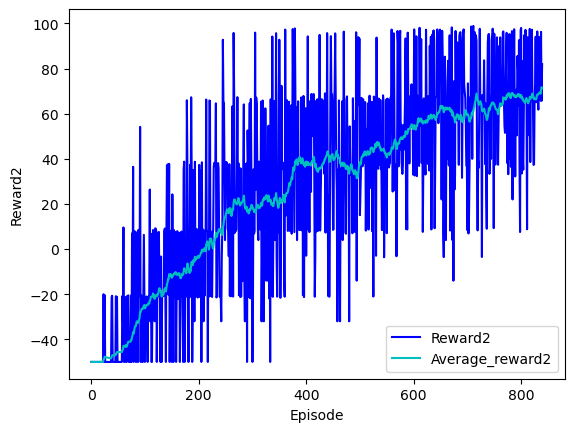

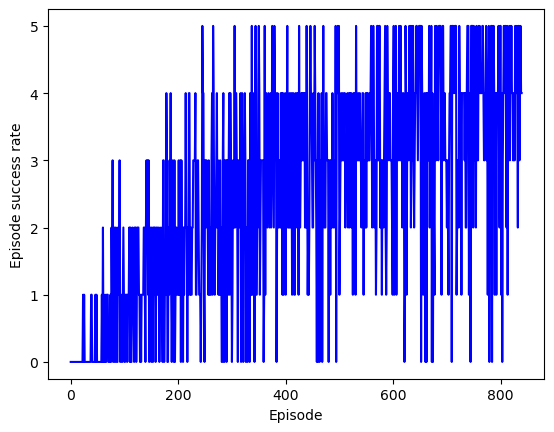

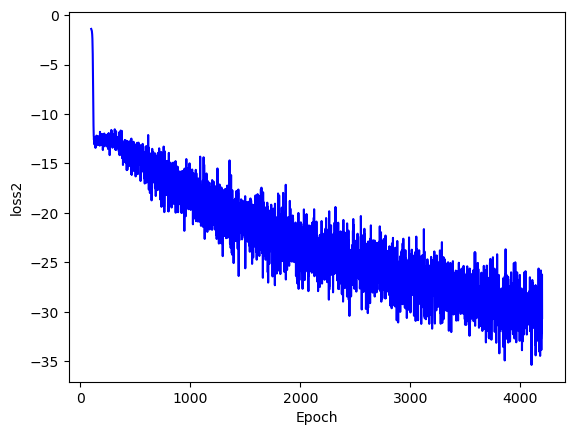

***** epoch 168 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86739.54429516135
r_em 55806.022582307094
55806.022582307094
ReWard2/R0 11.161204516461419
reward2 is: 19.161204516461417
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 1 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89053.2802008501
r_em 56416.84721326636
56416.84721326636
ReWard2/R0 11.283369442653273
reward2 is: 19.283369442653274
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 2 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91123.07166728546
r_em 55998.65750471865
55998.65750471865
ReWard2/R0 11.199731500943729
reward2 is: 19.199731500943727
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 3 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90141.24382445788
r_em 55997.294210048654
55997.294210048654
ReWard2/R0 11.199458842009731
reward2 is: 19.199458842009733
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 4 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90197.24631085365
r_em 56249.34173703943
56249.34173703943
ReWard2/R0 11.249868347407887
reward2 is: 19.249868347407887
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.12828339728549426
***** epoch 168 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83243.63826763729
r_em 57233.679336786714
57233.679336786714
ReWard2/R0 11.446735867357344
reward2 is: 19.446735867357344
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 6 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80247.5730922612
r_em 57057.25846635285
57057.25846635285
ReWard2/R0 11.41145169327057
reward2 is: 19.41145169327057
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 7 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80950.71384268333
r_em 56634.348380640804
56634.348380640804
ReWard2/R0 11.32686967612816
reward2 is: 19.32686967612816
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 8 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81435.96414478823
r_em 56528.87455855647
56528.87455855647
ReWard2/R0 11.305774911711294
reward2 is: 19.305774911711296
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 9 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80153.75411625102
r_em 56992.79324867113
56992.79324867113
ReWard2/R0 11.398558649734225
reward2 is: 19.398558649734227
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.12796300934045962
***** epoch 168 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 68636.74117327698
r_em 56069.79295968502
56069.79295968502
ReWard2/R0 11.213958591937004
reward2 is: 19.213958591937004
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 11 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 68577.78842448647
r_em 55736.456099227726
55736.456099227726
ReWard2/R0 11.147291219845545
reward2 is: 19.147291219845545
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 12 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 68409.90209269573
r_em 56307.569040069975
56307.569040069975
ReWard2/R0 11.261513808013994
reward2 is: 19.261513808013994
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 13 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 5.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 14 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 70469.568854258
r_em 57072.28872466284
57072.28872466284
ReWard2/R0 11.414457744932568
reward2 is: 19.41445774493257
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.12764342156471808
***** epoch 168 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87574.01415657128
r_em 56567.04357374815
56567.04357374815
ReWard2/R0 11.313408714749631
reward2 is: 19.31340871474963
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 16 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85918.94934471298
r_em 56643.58014523045
56643.58014523045
ReWard2/R0 11.32871602904609
reward2 is: 19.32871602904609
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 17 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85511.8563758108
r_em 56551.90224250674
56551.90224250674
ReWard2/R0 11.310380448501348
reward2 is: 19.31038044850135
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 18 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85844.45502356021
r_em 56144.78650970713
56144.78650970713
ReWard2/R0 11.228957301941426
reward2 is: 19.228957301941428
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 19 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84180.3060806853
r_em 55993.66548435879
55993.66548435879
ReWard2/R0 11.198733096871758
reward2 is: 19.198733096871756
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.12732463195984584
***** epoch 168 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 21 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 91007.68182726033
r_em 56798.16734525904
56798.16734525904
ReWard2/R0 11.359633469051808
reward2 is: 19.359633469051808
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step
***** frame 22 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 89878.47917052067
r_em 56822.955

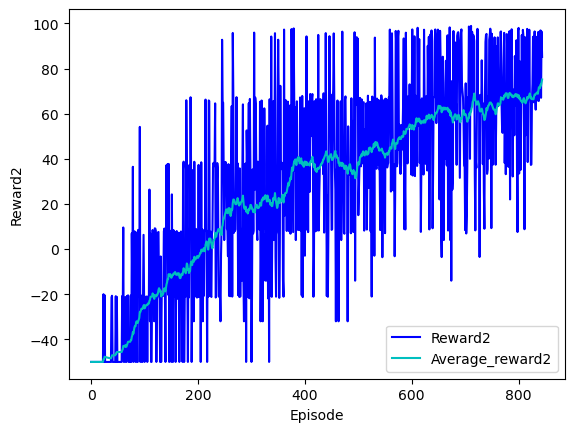

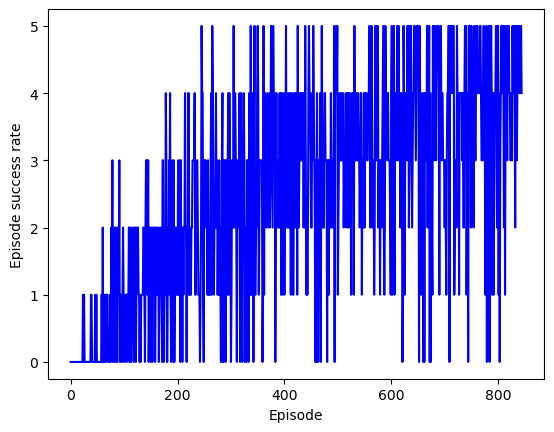

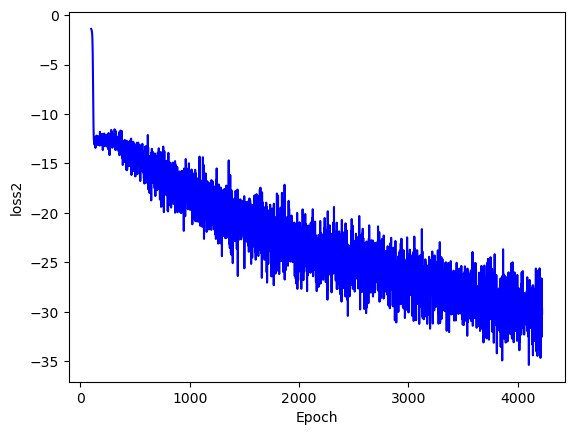

***** epoch 169 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78825.03306073368
r_em 52186.28214433775
52186.28214433775
ReWard2/R0 10.43725642886755
reward2 is: 18.43725642886755
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 1 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79151.43261804622
r_em 51438.37813726228
51438.37813726228
ReWard2/R0 10.287675627452456
reward2 is: 18.287675627452458
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 2 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77414.701220537
r_em 50741.44452014454
50741.44452014454
ReWard2/R0 10.148288904028908
reward2 is: 18.14828890402891
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 3 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 76993.34781347227
r_em 52273.94115366659
52273.94115366659
ReWard2/R0 10.454788230733318
reward2 is: 18.454788230733318
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 4 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.1266894392939569
***** epoch 169 episode 1 *****
***** frame 5 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 6 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87736.04236830093
r_em 52953.87248952434
52953.87248952434
ReWard2/R0 10.590774497904869
reward2 is: 18.590774497904867
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [=====

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 7 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88057.73847928127
r_em 51985.834531533306
51985.834531533306
ReWard2/R0 10.397166906306662
reward2 is: 18.397166906306662
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 8 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 9 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88868.64865797682
r_em 53094.9162650947
53094.9162650947
ReWard2/R0 10.61898325301894
reward2 is: 18.61898325301894
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.12637303226099805
***** epoch 169 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96872.25754781743
r_em 54489.3608774038
54489.3608774038
ReWard2/R0 10.89787217548076
reward2 is: 18.89787217548076
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 11 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96597.36918976577
r_em 53723.458324740415
53723.458324740415
ReWard2/R0 10.744691664948084
reward2 is: 18.744691664948085
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 12 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 13 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 97581.80629822833
r_em 53594.20753442813
53594.20753442813
ReWard2/R0 10.718841506885626
reward2 is: 18.718841506885624
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 14 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94806.9183414618
r_em 54188.42043182176
54188.42043182176
ReWard2/R0 10.837684086364352
reward2 is: 18.83768408636435
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.12605741545499943
***** epoch 169 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80915.6282701478
r_em 55884.42474901442
55884.42474901442
ReWard2/R0 11.176884949802885
reward2 is: 19.176884949802883
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 16 *****
1/1 [==============================] - 0s 20ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80325.35151213044
r_em 55928.84558437642
55928.84558437642
ReWard2/R0 11.185769116875283
reward2 is: 19.185769116875285
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 17 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87592.95651833984
r_em 56539.55445441145
56539.55445441145
ReWard2/R0 11.30791089088229
reward2 is: 19.30791089088229
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 18 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90086.58017832602
r_em 56369.81192790235
56369.81192790235
ReWard2/R0 11.27396238558047
reward2 is: 19.273962385580468
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 19 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91206.58641688483
r_em 56771.27212421958
56771.27212421958
ReWard2/R0 11.354254424843916
reward2 is: 19.354254424843916
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.12574258690236825
***** epoch 169 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81203.7426688864
r_em 53066.230412756115
53066.230412756115
ReWard2/R0 10.613246082551223
reward2 is: 18.61324608255122
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 21 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81485.6618964467
r_em 52822.923885265554
52822.923885265554
ReWard2/R0 10.564584777053112
reward2 is: 18.564584777053113
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 22 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90332.0834550021
r_em 52416.23459050963
52416.23459050963
ReWard2/R0 10.483246918101926
reward2 is: 18.483246918101926
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 23 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91369.70032552391
r_em 52887.62200490141
52887.62200490141
ReWard2/R0 10.577524400980282
reward2 is: 18.57752440098028
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 24 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91901.96680113817
r_em 53280.41380326407
53280.41380326407
ReWard2/R0 10.656082760652813
reward2 is: 18.656082760652815
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.1254285446344407


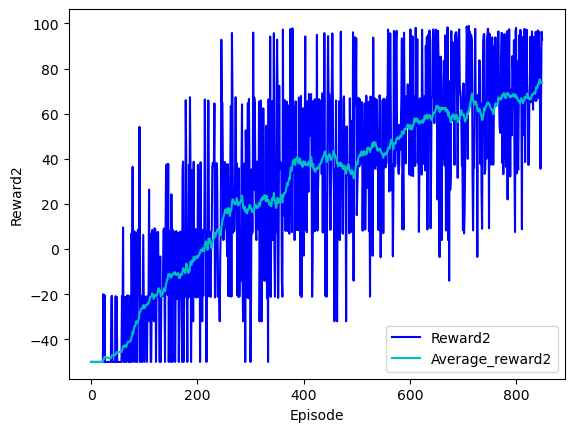

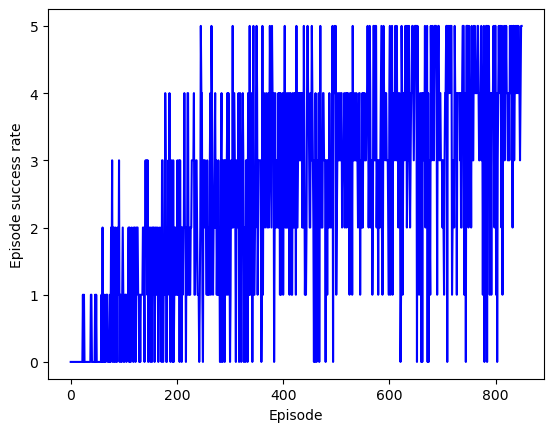

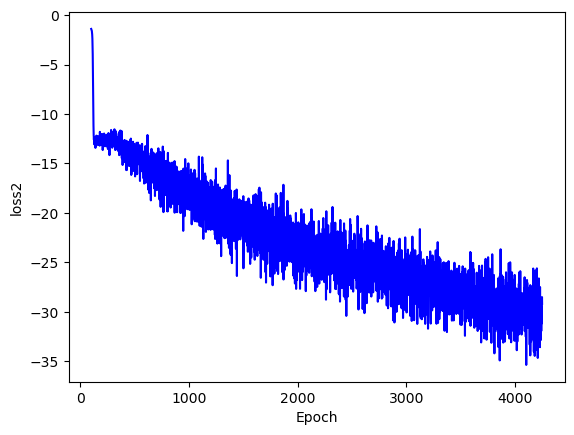

***** epoch 170 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90588.40811028311
r_em 54421.73324271942
54421.73324271942
ReWard2/R0 10.884346648543884
reward2 is: 18.884346648543882
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 1 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89681.14047990329
r_em 53619.13842162165
53619.13842162165
ReWard2/R0 10.723827684324329
reward2 is: 18.723827684324327
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 2 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90095.50170479598
r_em 52475.03519690917
52475.03519690917
ReWard2/R0 10.495007039381834
reward2 is: 18.495007039381832
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 3 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89746.54818335731
r_em 53527.282480873684
53527.282480873684
ReWard2/R0 10.705456496174737
reward2 is: 18.705456496174737
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 4 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90123.69373748131
r_em 53519.178827391515
53519.178827391515
ReWard2/R0 10.703835765478303
reward2 is: 18.703835765478303
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.12511528668746974
***** epoch 170 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 73169.12637372417
r_em 53011.13421992619
53011.13421992619
ReWard2/R0 10.602226843985239
reward2 is: 18.60222684398524
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 6 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 68067.09204907925
r_em 53317.449937892714
53317.449937892714
ReWard2/R0 10.663489987578544
reward2 is: 18.663489987578544
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 7 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 76982.10481164795
r_em 52475.61204189996
52475.61204189996
ReWard2/R0 10.495122408379993
reward2 is: 18.49512240837999
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 8 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 76874.07724769687
r_em 52392.460180745635
52392.460180745635
ReWard2/R0 10.478492036149127
reward2 is: 18.478492036149127
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 9 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77654.83502012062
r_em 52108.9479070665
52108.9479070665
ReWard2/R0 10.4217895814133
reward2 is: 18.4217895814133
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.1248028111026128
***** epoch 170 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91578.87693108321
r_em 50439.30860770144
50439.30860770144
ReWard2/R0 10.087861721540287
reward2 is: 18.087861721540285
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 11 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92436.49970047464
r_em 49159.081649764754
49159.081649764754
ReWard2/R0 9.83181632995295
reward2 is: 17.83181632995295
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 12 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92006.7810038367
r_em 51326.4059443348
51326.4059443348
ReWard2/R0 10.265281188866961
reward2 is: 18.26528118886696
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 13 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 14 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93691.0258087633
r_em 49773.52063720342
49773.52063720342
ReWard2/R0 9.954704127440685
reward2 is: 17.954704127440685
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.12449111592591955
***** epoch 170 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 96802.83322550422
r_em 53044.64847238728
53044.64847238728
ReWard2/R0 10.608929694477455
reward2 is: 18.608929694477453
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step
***** frame 16 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 97396.84066417029
r_em 53443.151790990014
53443.151790990014
ReWard2/R0 10.688630358198003
reward2 is: 18.688630358198004
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step
***** frame 17 *****
1/1 [==============================] - 0s 23ms/step

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 21 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 76578.70194648704
r_em 53460.19087137428
53460.19087137428
ReWard2/R0 10.692038174274856
reward2 is: 18.692038174274856
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 22 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88275.14570858079
r_em 52818.11916973828
52818.11916973828
ReWard2/R0 10.563623833947656
reward2 is: 18.563623833947656
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 23 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 24 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87622.75155443944
r_em 52169.42362363257
52169.42362363257
ReWard2/R0 10.433884724726513
reward2 is: 18.43388472472651
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.12387005900561042


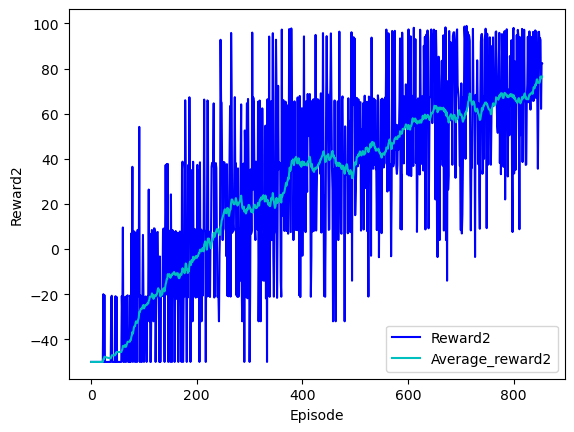

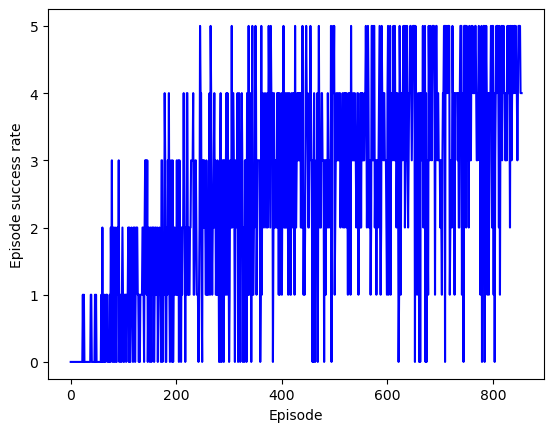

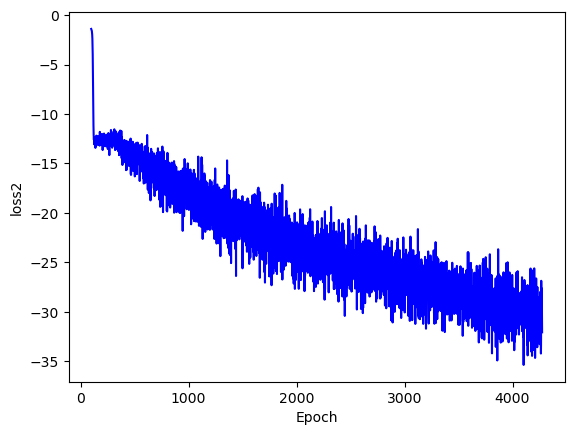

***** epoch 171 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 92556.42518462047
r_em 52128.318662210295
52128.318662210295
ReWard2/R0 10.42566373244206
reward2 is: 18.42566373244206
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step
***** frame 1 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 90406.62073010419
r_em 50954.178767149155
50954.178767149155
ReWard2/R0 10.19083575342983
reward2 is: 18.19083575342983
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 5.0
total n

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 6 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84546.81384088538
r_em 57128.70233352101
57128.70233352101
ReWard2/R0 11.425740466704202
reward2 is: 19.4257404667042
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 7 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85296.74362619063
r_em 57686.642659297395
57686.642659297395
ReWard2/R0 11.53732853185948
reward2 is: 19.53732853185948
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 8 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88337.68632340667
r_em 57978.653369258194
57978.653369258194
ReWard2/R0 11.595730673851639
reward2 is: 19.59573067385164
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 9 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89806.9672726736
r_em 57698.38905534927
57698.38905534927
ReWard2/R0 11.539677811069854
reward2 is: 19.539677811069854
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.1232521003923202
***** epoch 171 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83790.16632282702
r_em 53122.06272632402
53122.06272632402
ReWard2/R0 10.624412545264803
reward2 is: 18.624412545264803
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 11 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84069.19194159475
r_em 54326.60224326562
54326.60224326562
ReWard2/R0 10.865320448653124
reward2 is: 18.865320448653122
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 12 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87624.46720552536
r_em 54117.81195202414
54117.81195202414
ReWard2/R0 10.823562390404827
reward2 is: 18.823562390404827
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 13 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88610.2283988296
r_em 52574.76340386863
52574.76340386863
ReWard2/R0 10.514952680773726
reward2 is: 18.514952680773725
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 14 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.12294427811756381
***** epoch 171 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 16 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 17 *****
1

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.12233093800755339


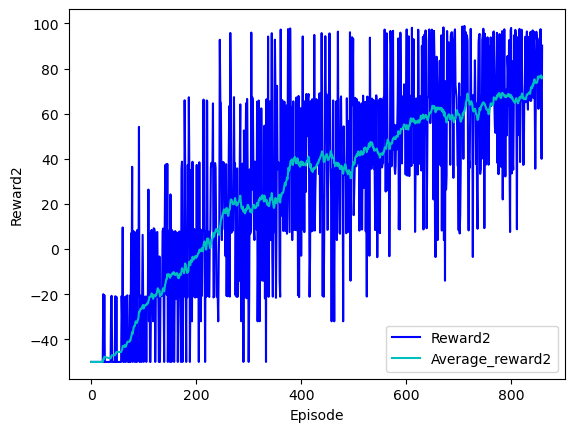

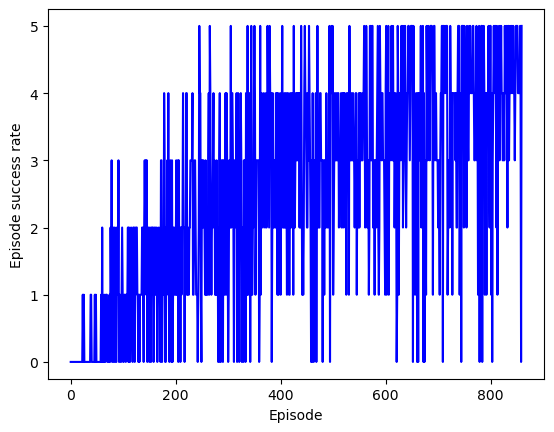

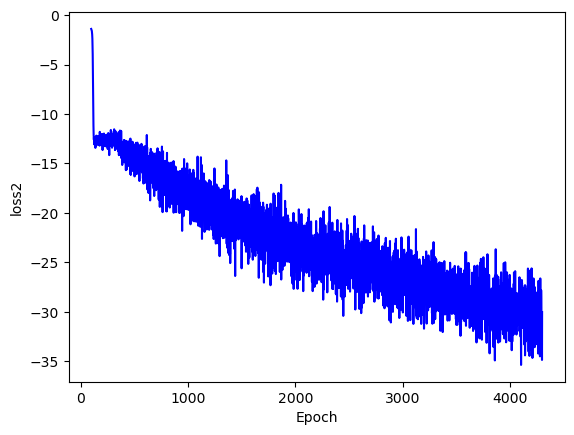

***** epoch 172 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86984.87828150221
r_em 56878.967133292215
56878.967133292215
ReWard2/R0 11.375793426658444
reward2 is: 19.375793426658444
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 1 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86674.83813779277
r_em 57349.16418054099
57349.16418054099
ReWard2/R0 11.469832836108198
reward2 is: 19.469832836108196
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 2 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84742.21100534887
r_em 56701.796168534245
56701.796168534245
ReWard2/R0 11.340359233706849
reward2 is: 19.34035923370685
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 4 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87490.57294314951
r_em 57638.17557892052
57638.17557892052
ReWard2/R0 11.527635115784104
reward2 is: 19.527635115784104
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.1220254163370041
***** epoch 172 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 76954.56223274475
r_em 56066.89267707607
56066.89267707607
ReWard2/R0 11.213378535415215
reward2 is: 19.213378535415217
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 6 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79858.45027710461
r_em 55364.44493904781
55364.44493904781
ReWard2/R0 11.072888987809563
reward2 is: 19.072888987809563
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 7 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77832.7665457489
r_em 54587.49567166073
54587.49567166073
ReWard2/R0 10.917499134332145
reward2 is: 18.917499134332147
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 8 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80966.90806099922
r_em 52470.33540154023
52470.33540154023
ReWard2/R0 10.494067080308046
reward2 is: 18.494067080308046
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 9 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80574.06763604016
r_em 52570.37591084342
52570.37591084342
ReWard2/R0 10.514075182168684
reward2 is: 18.514075182168682
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.12172065770720882
***** epoch 172 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 11 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88166.1896804523
r_em 54341.815910786165
54341.815910786165
ReWard2/R0 10.868363182157234
reward2 is: 18.868363182157232
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 12 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 13 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 14 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87618.43080121829
r_em 53543.43970844419
53543.43970844419
ReWard2/R0 10.708687941688838
reward2 is: 18.708687941688837
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.12141666021247231
***** epoch 172 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93725.19907374487
r_em 53944.52761789022
53944.52761789022
ReWard2/R0 10.788905523578045
reward2 is: 18.788905523578045
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 17 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93885.17029768034
r_em 53407.41599174192
53407.41599174192
ReWard2/R0 10.681483198348383
reward2 is: 18.68148319834838
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 18 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 19 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.12111342195185881
***** epoch 172 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84087.95441897745
r_em 56586.584626070544
56586.584626070544
ReWard2/R0 11.317316925214108
reward2 is: 19.317316925214108
total num

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 21 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84230.15309306615
r_em 56426.702176553634
56426.702176553634
ReWard2/R0 11.285340435310728
reward2 is: 19.28534043531073
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 23 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81729.87637369204
r_em 56426.27029230037
56426.27029230037
ReWard2/R0 11.285254058460074
reward2 is: 19.285254058460076
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.12081094102918016


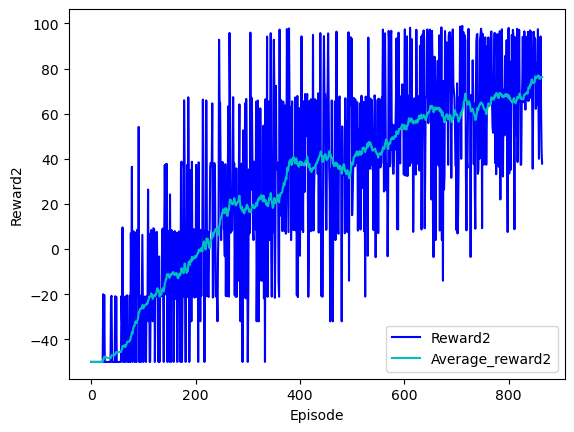

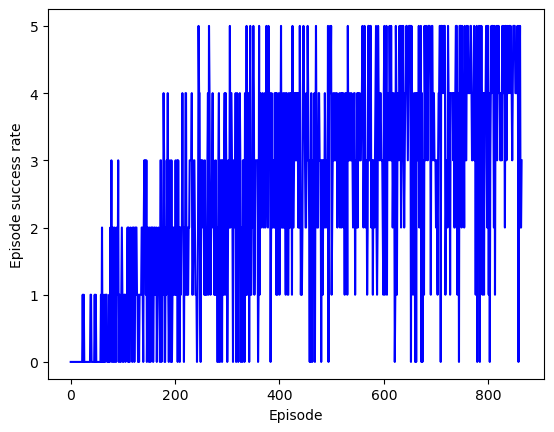

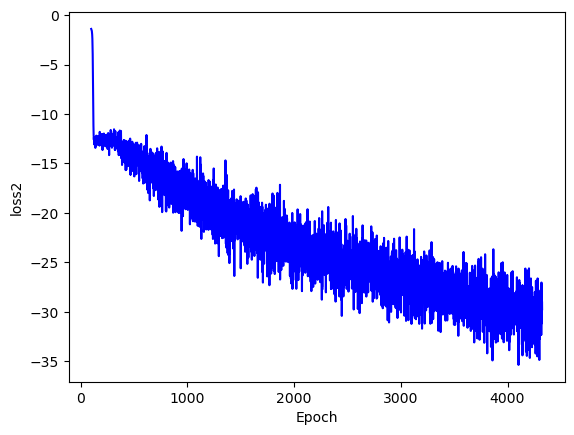

***** epoch 173 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86592.00028864964
r_em 53553.1368158963
53553.1368158963
ReWard2/R0 10.71062736317926
reward2 is: 18.71062736317926
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 1 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85156.87234721077
r_em 53988.929424389455
53988.929424389455
ReWard2/R0 10.797785884877891
reward2 is: 18.79778588487789
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 2 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84551.83919991714
r_em 53839.61087662148
53839.61087662148
ReWard2/R0 10.767922175324296
reward2 is: 18.767922175324294
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 3 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86777.37990187225
r_em 54549.62100790045
54549.62100790045
ReWard2/R0 10.90992420158009
reward2 is: 18.90992420158009
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 4 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87605.6545795741
r_em 55052.30225433833
55052.30225433833
ReWard2/R0 11.010460450867665
reward2 is: 19.010460450867665
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.1205092155529839
***** epoch 173 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 95684.41232118363
r_em 57186.035083067436
57186.035083067436
ReWard2/R0 11.437207016613486
reward2 is: 19.437207016613485
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step
***** frame 6 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 94529.75349004692
r_em 56236.70006117258
56236.70006117258
ReWard2/R0 11.247340012234517
reward2 is: 19.247340012234517
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step
***** frame 7 *****
1/1 [==============================] - 0s 27ms/step
we 

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 11 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93410.13185717011
r_em 57175.621592202406
57175.621592202406
ReWard2/R0 11.435124318440481
reward2 is: 19.43512431844048
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 12 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94285.7652417841
r_em 57161.24036549954
57161.24036549954
ReWard2/R0 11.432248073099908
reward2 is: 19.432248073099906
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 13 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94820.70265244029
r_em 57327.84230972236
57327.84230972236
ReWard2/R0 11.465568461944471
reward2 is: 19.46556846194447
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 14 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94053.51147828656
r_em 57251.452290126676
57251.452290126676
ReWard2/R0 11.450290458025336
reward2 is: 19.450290458025336
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.1199080233978365
***** epoch 173 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82585.82594534494
r_em 59356.73685877955
59356.73685877955
ReWard2/R0 11.87134737175591
reward2 is: 19.87134737175591
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 16 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80088.50520600435
r_em 54202.945647119486
54202.945647119486
ReWard2/R0 10.840589129423897
reward2 is: 18.840589129423897
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 17 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81190.79542579495
r_em 53592.51904209333
53592.51904209333
ReWard2/R0 10.718503808418665
reward2 is: 18.718503808418667
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 18 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81922.36285464383
r_em 53367.02030340966
53367.02030340966
ReWard2/R0 10.673404060681932
reward2 is: 18.673404060681932
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 19 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.11960855295955289
***** epoch 173 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91889.67680920303
r_em 54746.78767553524
54746.78767553524
ReWard2/R0 10.949357535107048
reward2 is: 18.949357535107048
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 21 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94482.8984494172
r_em 54627.996412006454
54627.996412006454
ReWard2/R0 10.92559928240129
reward2 is: 18.92559928240129
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 22 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93954.43885401078
r_em 53798.391428974974
53798.391428974974
ReWard2/R0 10.759678285794994
reward2 is: 18.759678285794994
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 23 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94189.5665067785
r_em 53830.519275455576
53830.519275455576
ReWard2/R0 10.766103855091115
reward2 is: 18.766103855091117
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 24 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94852.7301270994
r_em 53781.185939721174
53781.185939721174
ReWard2/R0 10.756237187944235
reward2 is: 18.756237187944237
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.11930983044906313


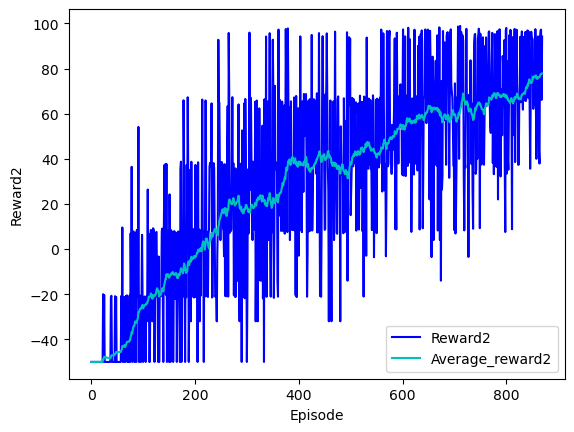

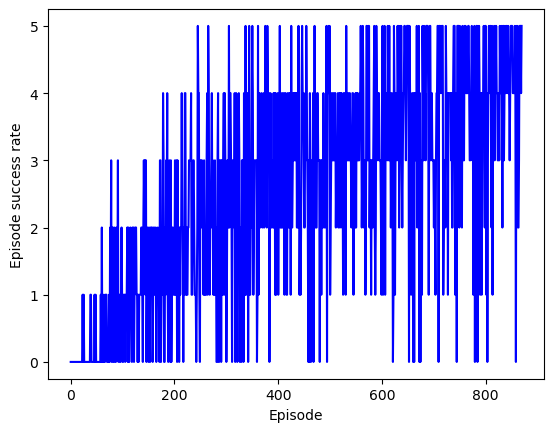

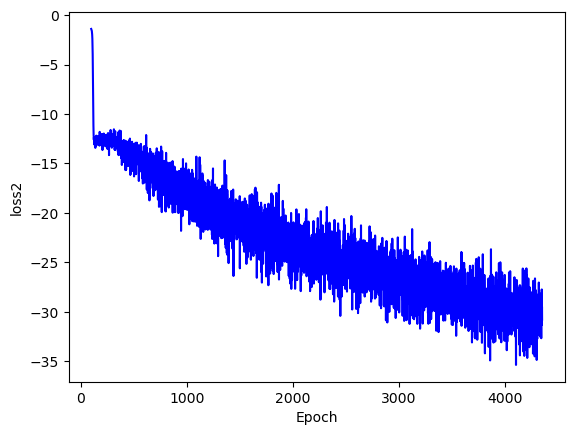

***** epoch 174 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 1 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 94563.4431227772
r_em 55063.53639896073
55063.53639896073
ReWard2/R0 11.012707279792146
reward2 is: 19.012707279792146
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 3 *****
we c

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.11901185399841661
***** epoch 174 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 6 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 7 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
****

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 9 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93806.59292391627
r_em 54296.23184965204
54296.23184965204
ReWard2/R0 10.859246369930407
reward2 is: 18.859246369930407
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.11871462174432797
***** epoch 174 episode 2 *****
***** frame 10 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 11 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84921.58260866808
r_em 54731.20906878878
54731.20906878878
ReWard2/R0 10.946241813757757
reward2 is: 18.94624181375776
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 12 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85476.38249675592
r_em 55310.61770130581
55310.61770130581
ReWard2/R0 11.062123540261162
reward2 is: 19.06212354026116
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 13 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87587.25845502947
r_em 55016.26178842969
55016.26178842969
ReWard2/R0 11.00325235768594
reward2 is: 19.003252357685938
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 14 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84118.69642828716
r_em 55051.92306490853
55051.92306490853
ReWard2/R0 11.010384612981706
reward2 is: 19.010384612981706
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.11841813182816537
***** epoch 174 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93486.63807756317
r_em 56926.680503543
56926.680503543
ReWard2/R0 11.3853361007086
reward2 is: 19.3853361007086
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 16 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92385.85191680837
r_em 56766.94184244816
56766.94184244816
ReWard2/R0 11.353388368489632
reward2 is: 19.353388368489632
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 17 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93339.29893938541
r_em 57031.149296031945
57031.149296031945
ReWard2/R0 11.40622985920639
reward2 is: 19.40622985920639
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 18 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94591.3795571904
r_em 56197.825707043434
56197.825707043434
ReWard2/R0 11.239565141408686
reward2 is: 19.239565141408686
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 19 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 97472.788100565
r_em 56071.40482636784
56071.40482636784
ReWard2/R0 11.214280965273568
reward2 is: 19.214280965273566
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.11812238239593889
***** epoch 174 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80138.63654260966
r_em 57077.188763004
57077.188763004
ReWard2/R0 11.4154377526008
reward2 is: 19.415437752600802
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 21 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81560.74306430512
r_em 56550.618214643415
56550.618214643415
ReWard2/R0 11.310123642928684
reward2 is: 19.310123642928684
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 22 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81084.61272674962
r_em 56149.88300418609
56149.88300418609
ReWard2/R0 11.229976600837219
reward2 is: 19.22997660083722
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 23 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80590.59367356253
r_em 55257.99761965664
55257.99761965664
ReWard2/R0 11.051599523931328
reward2 is: 19.05159952393133
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 24 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 92558.21341863912
r_em 55157.07569904407
55157.07569904407
ReWard2/R0 11.031415139808814
reward2 is: 19.031415139808814
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.117827371598289


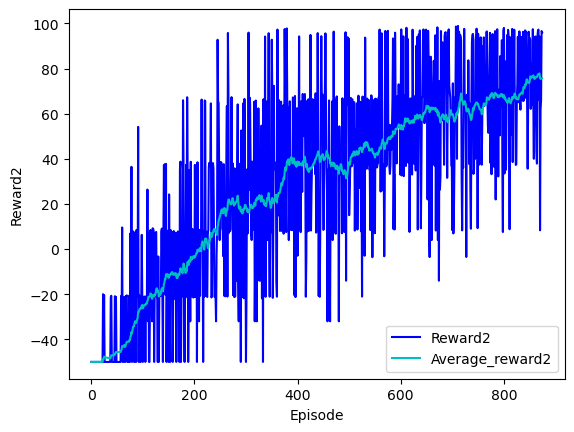

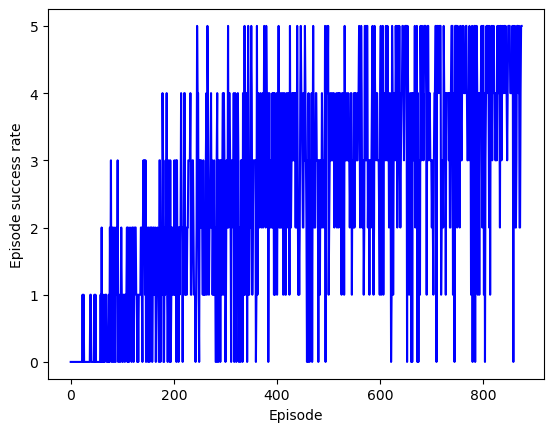

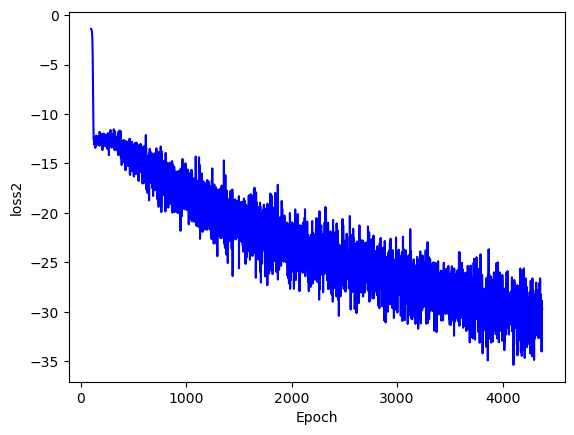

***** epoch 175 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85166.5026289948
r_em 54386.63233019957
54386.63233019957
ReWard2/R0 10.877326466039914
reward2 is: 18.877326466039914
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 1 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86365.5572941161
r_em 54259.69752429409
54259.69752429409
ReWard2/R0 10.851939504858818
reward2 is: 18.85193950485882
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 3 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89632.45554858647
r_em 52849.51454871105
52849.51454871105
ReWard2/R0 10.56990290974221
reward2 is: 18.56990290974221
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 4 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89876.32372916202
r_em 53142.23836265254
53142.23836265254
ReWard2/R0 10.628447672530507
reward2 is: 18.628447672530505
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.11753309759047491
***** epoch 175 episode 1 *****
***** frame 5 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 6 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 7 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 8 *****
1/1 [

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 33ms/step
***** frame 11 *****
1/1 [==============================] - 0s 54ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 12 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 8ms/step
***** frame 13 *****
1/1 [==============================] - 0s 50ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 9ms/step
***** frame 14 *****
1/1 [==============================] - 0s 31ms/s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.1169467525884157
***** epoch 175 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 46ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93276.05379098533
r_em 54847.445960946614
54847.445960946614
ReWard2/R0 10.969489192189323
reward2 is: 18.96948919218932
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 17 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94139.56697892828
r_em 55069.957665717215
55069.957665717215
ReWard2/R0 11.013991533143443
reward2 is: 19.013991533143443
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 18 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93529.63285390973
r_em 54615.24233261902
54615.24233261902
ReWard2/R0 10.923048466523804
reward2 is: 18.923048466523802
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 19 *****
1/1 [==============================] - 0s 43ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95387.8498001372
r_em 54925.35769392445
54925.35769392445
ReWard2/R0 10.98507153878489
reward2 is: 18.98507153878489
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.11665467792767928
***** epoch 175 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 98673.76653470875
r_em 52595.13912645134
52595.13912645134
ReWard2/R0 10.519027825290268
reward2 is: 18.519027825290266
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step
***** frame 21 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 97912.73734571283
r_em 52114.08200417628
52114.08200417628
ReWard2/R0 10.422816400835256
reward2 is: 18.422816400835256
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step
***** frame 22 *****
1/1 [==============================] - 0s 26ms/step
w

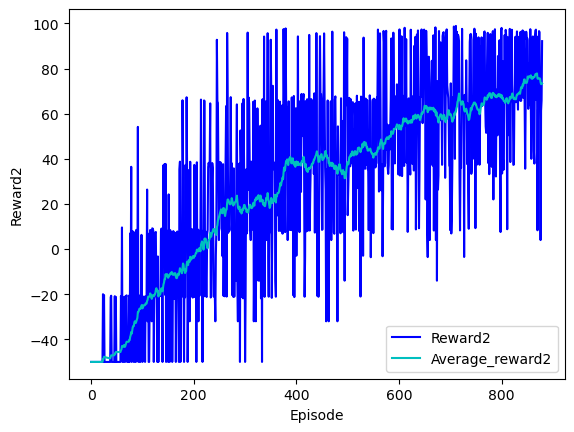

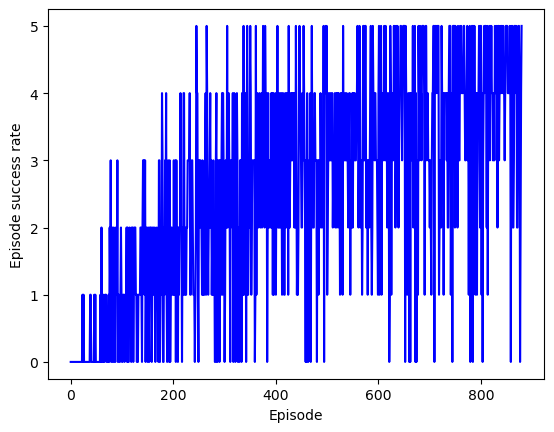

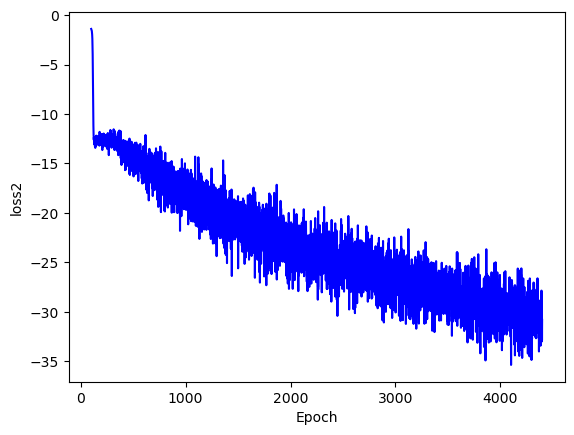

***** epoch 176 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83364.89667082994
r_em 52222.50687769639
52222.50687769639
ReWard2/R0 10.444501375539279
reward2 is: 18.44450137553928
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 1 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84063.21853025451
r_em 52404.304566923405
52404.304566923405
ReWard2/R0 10.480860913384682
reward2 is: 18.48086091338468
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 2 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84279.03215882277
r_em 52256.481284433714
52256.481284433714
ReWard2/R0 10.451296256886742
reward2 is: 18.451296256886742
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 3 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84091.579969417
r_em 50757.962337072604
50757.962337072604
ReWard2/R0 10.15159246741452
reward2 is: 18.15159246741452
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 4 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85311.17795908419
r_em 49489.89727932115
49489.89727932115
ReWard2/R0 9.89797945586423
reward2 is: 17.89797945586423
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.11607271515487763
***** epoch 176 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88126.1441082558
r_em 54137.23316862112
54137.23316862112
ReWard2/R0 10.827446633724223
reward2 is: 18.82744663372422
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 6 *****
1/1 [==============================] - 0s 40ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88014.20774388917
r_em 53958.75568834576
53958.75568834576
ReWard2/R0 10.791751137669152
reward2 is: 18.791751137669152
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 7 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88390.39522829052
r_em 54156.637282858304
54156.637282858304
ReWard2/R0 10.83132745657166
reward2 is: 18.83132745657166
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 8 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88906.8727794891
r_em 53649.81302146593
53649.81302146593
ReWard2/R0 10.729962604293187
reward2 is: 18.729962604293185
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 9 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88237.34044076622
r_em 53848.727809216165
53848.727809216165
ReWard2/R0 10.769745561843234
reward2 is: 18.769745561843234
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.11578282340372373
***** epoch 176 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93255.37930409434
r_em 57446.59957593762
57446.59957593762
ReWard2/R0 11.489319915187524
reward2 is: 19.489319915187522
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 11 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93173.90574664605
r_em 57263.700005146966
57263.700005146966
ReWard2/R0 11.452740001029394
reward2 is: 19.452740001029394
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 12 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92927.8382842098
r_em 57255.974420305334
57255.974420305334
ReWard2/R0 11.451194884061067
reward2 is: 19.451194884061067
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 13 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92295.90902964445
r_em 57231.73396436893
57231.73396436893
ReWard2/R0 11.446346792873785
reward2 is: 19.446346792873783
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 14 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91278.84927684751
r_em 57267.196446055736
57267.196446055736
ReWard2/R0 11.453439289211147
reward2 is: 19.453439289211147
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.1154936556575806
***** epoch 176 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89420.5356399
r_em 54163.584849941515
54163.584849941515
ReWard2/R0 10.832716969988303
reward2 is: 18.832716969988304
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 16 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90182.57177119263
r_em 54213.39851249448
54213.39851249448
ReWard2/R0 10.842679702498897
reward2 is: 18.8426797024989
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 17 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 90007.40826312394
r_em 54466.84737676059
54466.84737676059
ReWard2/R0 10.893369475352118
reward2 is: 18.893369475352117
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step
***** frame 18 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 89584.74989197246
r_em 54350.45018904544
54350.45018904544
ReWard2/R0 10.870090037809089
reward2 is: 18.87009003780909
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step
***** frame 19 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optim

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.11520521010824485
***** epoch 176 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 86138.85862335202
r_em 52709.074840805566
52709.074840805566
ReWard2/R0 10.541814968161113
reward2 is: 18.541814968161113
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step
***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 22 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 

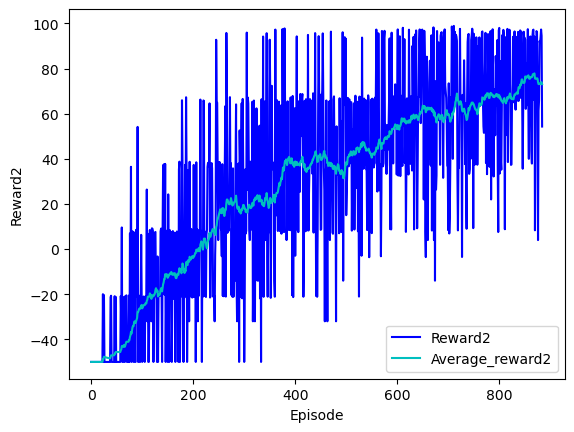

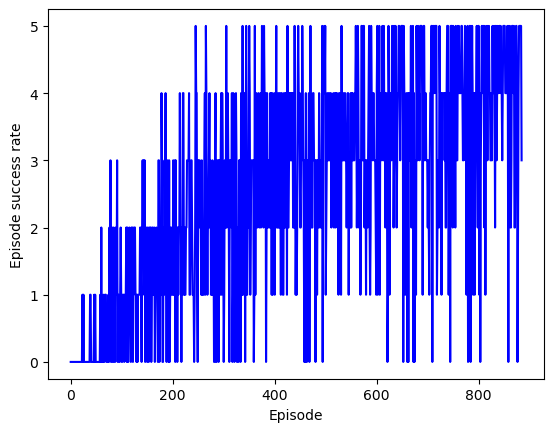

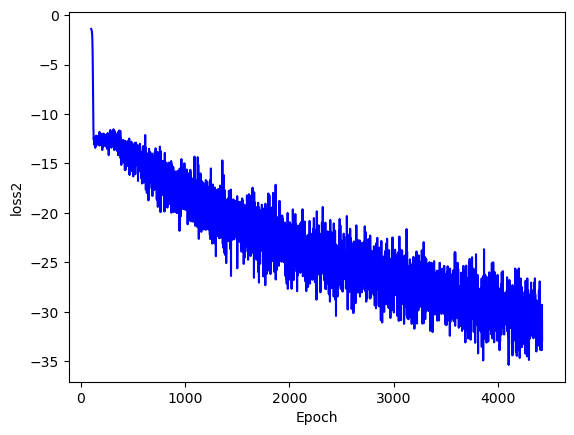

***** epoch 177 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88118.59677858291
r_em 51479.96836530513
51479.96836530513
ReWard2/R0 10.295993673061027
reward2 is: 18.295993673061027
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 1 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 2 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 4 *****
1/1 [==============================] - 0s 40ms/step
we choose action2 with

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 6 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86928.44134812184
r_em 51991.54294243395
51991.54294243395
ReWard2/R0 10.39830858848679
reward2 is: 18.398308588486792
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 7 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 87205.93463919072
r_em 51726.71965537265
51726.71965537265
ReWard2/R0 10.345343931074531
reward2 is: 18.34534393107453
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step
***** frame 8 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 84661.1452617931
r_em 52565.092094946594
52565.092094946594
ReWard2/R0 10.513018418989319
reward2 is: 18.51301841898932
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step
***** frame 9 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 11 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87508.50211989293
r_em 55677.32086614671
55677.32086614671
ReWard2/R0 11.135464173229341
reward2 is: 19.13546417322934
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 12 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90452.35202342366
r_em 54236.26721485548
54236.26721485548
ReWard2/R0 10.847253442971095
reward2 is: 18.847253442971095
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 13 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89542.88809714407
r_em 54381.45893736668
54381.45893736668
ReWard2/R0 10.876291787473336
reward2 is: 18.876291787473335
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 14 *****
1/1 [==============================] - 0s 41ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91954.09059660317
r_em 54123.774720569825
54123.774720569825
ReWard2/R0 10.824754944113964
reward2 is: 18.824754944113963
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
Epsilon_hist is: 0.11405861387273004
***** epoch 177 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 57ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87201.93595645677
r_em 53675.419408006754
53675.419408006754
ReWard2/R0 10.735083881601351
reward2 is: 18.73508388160135
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 12ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 12ms/step
***** frame 16 *****
1/1 [==============================] - 0s 57ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88339.72764680235
r_em 55113.8129924473
55113.8129924473
ReWard2/R0 11.02276259848946
reward2 is: 19.02276259848946
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 17 *****
1/1 [==============================] - 0s 85ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88011.92343810176
r_em 55772.195682751255
55772.195682751255
ReWard2/R0 11.15443913655025
reward2 is: 19.154439136550252
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 18 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88300.24882727965
r_em 56085.06116524333
56085.06116524333
ReWard2/R0 11.217012233048665
reward2 is: 19.217012233048663
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 19 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87774.67646525789
r_em 55644.1971570671
55644.1971570671
ReWard2/R0 11.12883943141342
reward2 is: 19.128839431413418
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.11377375234204529
***** epoch 177 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 21 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 22 *****
1/1 [==============================] - 0s 45ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 12ms/step


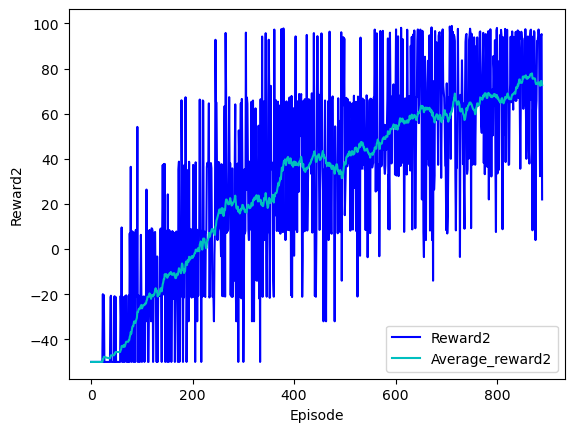

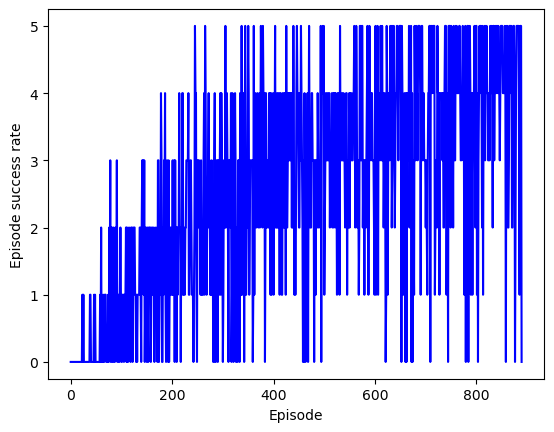

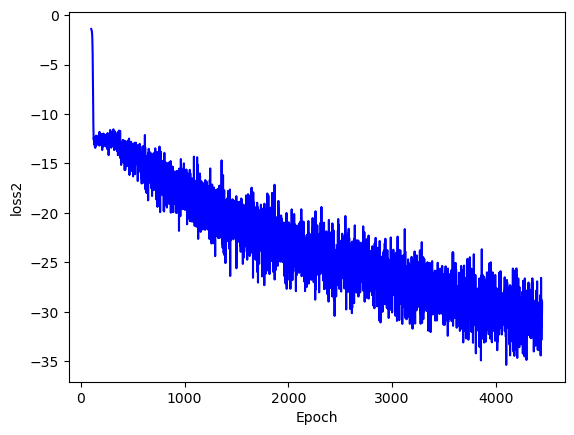

***** epoch 178 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 76857.62511673236
r_em 53537.19905206572
53537.19905206572
ReWard2/R0 10.707439810413144
reward2 is: 18.707439810413142
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 1 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 76926.34136030797
r_em 53381.94397805376
53381.94397805376
ReWard2/R0 10.676388795610752
reward2 is: 18.67638879561075
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 2 *****
1/1 [==============================] - 0s 40ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 75965.03167751392
r_em 53348.97113690881
53348.97113690881
ReWard2/R0 10.669794227381763
reward2 is: 18.669794227381765
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 8ms/step
***** frame 4 *****
1/1 [==============================] - 0s 43ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 73055.25218808887
r_em 54217.27813321194
54217.27813321194
ReWard2/R0 10.843455626642388
reward2 is: 18.84345562664239
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.11320616182993508
***** epoch 178 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 42ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84531.27848609426
r_em 55821.95961570663
55821.95961570663
ReWard2/R0 11.164391923141327
reward2 is: 19.164391923141327
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 6 *****
1/1 [==============================] - 0s 50ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84972.17388218273
r_em 55565.153505030816
55565.153505030816
ReWard2/R0 11.113030701006164
reward2 is: 19.113030701006164
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 9ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 9ms/step
***** frame 7 *****
1/1 [==============================] - 0s 48ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86852.70117890823
r_em 55613.42333946909
55613.42333946909
ReWard2/R0 11.122684667893818
reward2 is: 19.122684667893818
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 8 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86731.99660267185
r_em 56063.070129899395
56063.070129899395
ReWard2/R0 11.21261402597988
reward2 is: 19.21261402597988
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 9 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86619.3570276824
r_em 55098.310699483736
55098.310699483736
ReWard2/R0 11.019662139896747
reward2 is: 19.019662139896745
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
Epsilon_hist is: 0.11292342929929253
***** epoch 178 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 43ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88987.21307832011
r_em 53293.24425333209
53293.24425333209
ReWard2/R0 10.658648850666417
reward2 is: 18.658648850666417
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 11 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89432.53752154652
r_em 55612.7876569921
55612.7876569921
ReWard2/R0 11.122557531398419
reward2 is: 19.12255753139842
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 12 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 13 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86622.89178556437
r_em 54969.465624668344
54969.465624668344
ReWard2/R0 10.993893124933669
reward2 is: 18.99389312493367
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 14 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88309.78987023613
r_em 54430.7641227163
54430.7641227163
ReWard2/R0 10.88615282454326
reward2 is: 18.88615282454326
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
Epsilon_hist is: 0.11264140289349857
***** epoch 178 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 45ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96384.11804076585
r_em 55456.87183704741
55456.87183704741
ReWard2/R0 11.091374367409482
reward2 is: 19.091374367409482
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 16 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96361.24659606884
r_em 56110.33259738342
56110.33259738342
ReWard2/R0 11.222066519476684
reward2 is: 19.222066519476684
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 10ms/step
***** frame 17 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96262.20823530431
r_em 55662.484256550044
55662.484256550044
ReWard2/R0 11.132496851310009
reward2 is: 19.13249685131001
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 18 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 95172.2051654214
r_em 55563.28469150115
55563.28469150115
ReWard2/R0 11.11265693830023
reward2 is: 19.11265693830023
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step
***** frame 19 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.11236008084900552
***** epoch 178 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86700.39804011027
r_em 56352.13166224083
5635

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 21 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 87709.14230619256
r_em 56201.67051470057
56201.67051470057
ReWard2/R0 11.240334102940114
reward2 is: 19.240334102940114
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step
***** frame 22 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 87467.19387004162
r_em 55732.100477981076
55732.100477981076
ReWard2/R0 11.146420095596214
reward2 is: 19.146420095596213
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step
***** frame 23 *****
1/1 [==============================] - 0s 39ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: op

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 24 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84361.29514427707
r_em 55866.32728506764
55866.32728506764
ReWard2/R0 11.173265457013528
reward2 is: 19.173265457013528
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.11207946140667016


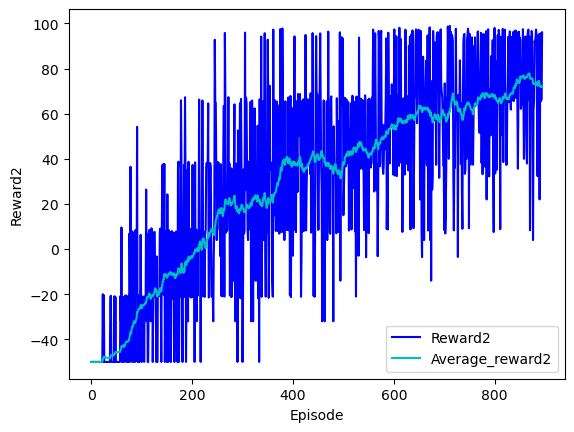

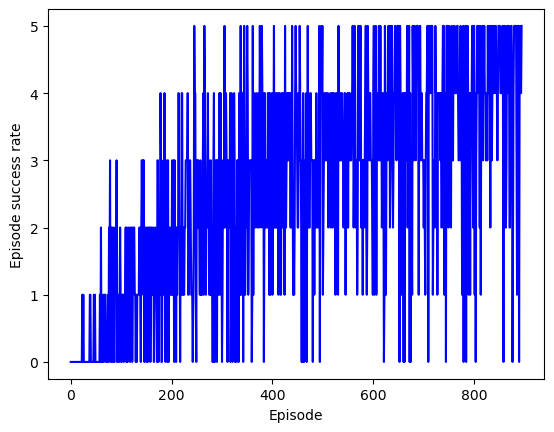

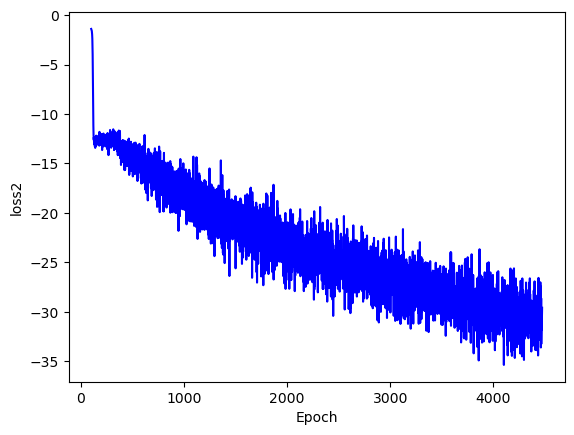

***** epoch 179 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83428.44818087209
r_em 56558.78297093452
56558.78297093452
ReWard2/R0 11.311756594186903
reward2 is: 19.311756594186903
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 10ms/step
***** frame 1 *****
1/1 [==============================] - 0s 51ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81750.8201253473
r_em 55724.547382652876
55724.547382652876
ReWard2/R0 11.144909476530575
reward2 is: 19.144909476530575
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 2 *****
1/1 [==============================] - 0s 45ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81530.59644769882
r_em 54982.63215320604
54982.63215320604
ReWard2/R0 10.996526430641207
reward2 is: 18.996526430641207
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 3 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 82903.63191890156
r_em 54800.891886685706
54800.891886685706
ReWard2/R0 10.960178377337142
reward2 is: 18.960178377337144
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step
***** frame 4 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79927.72875845096
r_em 54352.29160421758
54352.29160421758
ReWard2/R0 10.870458320843516
reward2 is: 18.870458320843518
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.11179954281174273
***** epoch 179 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84969.22038549816
r_em 55098.80207266679
55098.80207266679
ReWard2/R0 11.019760414533359
reward2 is: 19.01976041453336
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 6 *****
1/1 [==============================] - 0s 39ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84431.38267964785
r_em 54274.85778552157
54274.85778552157
ReWard2/R0 10.854971557104314
reward2 is: 18.854971557104314
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 7 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83944.2213784678
r_em 55327.344044255704
55327.344044255704
ReWard2/R0 11.06546880885114
reward2 is: 19.06546880885114
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 8 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83586.82150513245
r_em 54380.13886694577
54380.13886694577
ReWard2/R0 10.876027773389154
reward2 is: 18.876027773389154
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 9 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84171.70379053935
r_em 55322.13534971016
55322.13534971016
ReWard2/R0 11.064427069942031
reward2 is: 19.06442706994203
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.11152032331385595
***** epoch 179 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93491.73944150013
r_em 55891.202809068476
55891.202809068476
ReWard2/R0 11.178240561813695
reward2 is: 19.178240561813695
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 11 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94698.18108951686
r_em 56021.61902411722
56021.61902411722
ReWard2/R0 11.204323804823444
reward2 is: 19.204323804823446
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 12 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95431.65338834867
r_em 56035.58875334753
56035.58875334753
ReWard2/R0 11.207117750669507
reward2 is: 19.207117750669507
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 13 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96411.79994570576
r_em 56275.523671791634
56275.523671791634
ReWard2/R0 11.255104734358326
reward2 is: 19.255104734358326
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 14 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.11124180116701406
***** epoch 179 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85983.76966038976
r_em 53145.819171344054
53145.819171344054
ReWard2/R0 10.62916383426881
reward2 is: 18.62916383426881
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 16 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85174.6180735609
r_em 53011.07538086383
53011.07538086383
ReWard2/R0 10.602215076172767
reward2 is: 18.60221507617277
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 17 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84955.15772194046
r_em 51998.50599384197
51998.50599384197
ReWard2/R0 10.399701198768394
reward2 is: 18.399701198768394
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 18 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83993.90458044283
r_em 52900.59935850627
52900.59935850627
ReWard2/R0 10.580119871701253
reward2 is: 18.580119871701253
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 19 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83446.30102509499
r_em 52891.505610146356
52891.505610146356
ReWard2/R0 10.578301122029272
reward2 is: 18.578301122029274
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.11096397462958196
***** epoch 179 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83658.34288229115
r_em 52971.87513790857
52971.87513790857
ReWard2/R0 10.594375027581714
reward2 is: 18.594375027581712
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 21 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82044.01353275076
r_em 52408.7140064004
52408.7140064004
ReWard2/R0 10.48174280128008
reward2 is: 18.481742801280078
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 22 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81964.39291012284
r_em 52332.66202313293
52332.66202313293
ReWard2/R0 10.466532404626586
reward2 is: 18.466532404626584
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 23 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83458.15822960492
r_em 53375.52158655553
53375.52158655553
ReWard2/R0 10.675104317311106
reward2 is: 18.675104317311106
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 24 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 80929.49223733175
r_em 53924.955204260645
53924.955204260645
ReWard2/R0 10.784991040852129
reward2 is: 18.784991040852127
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.11068684196427431


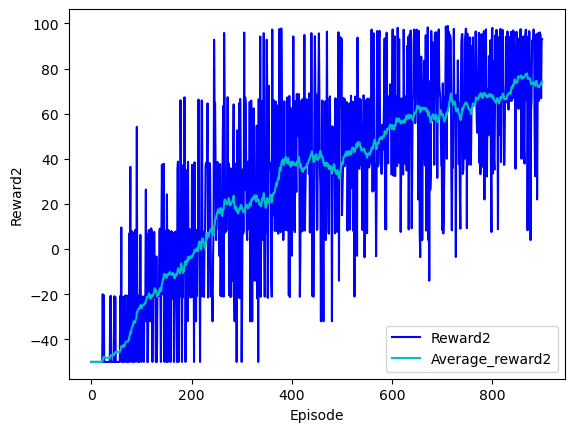

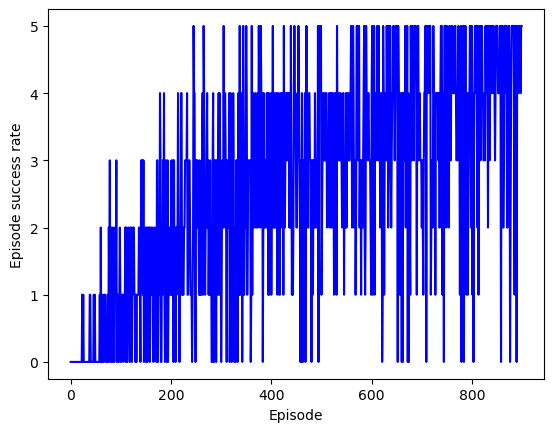

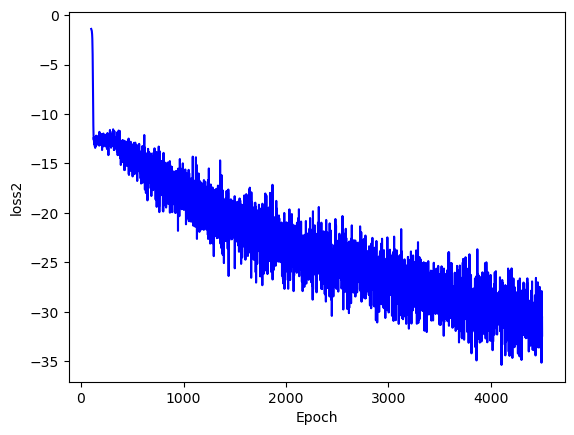

***** epoch 180 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85520.10316698889
r_em 53035.30756122608
53035.30756122608
ReWard2/R0 10.607061512245217
reward2 is: 18.607061512245217
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 1 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83939.38288471641
r_em 52605.93413701927
52605.93413701927
ReWard2/R0 10.521186827403854
reward2 is: 18.521186827403852
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 2 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84568.36096125026
r_em 52842.98686649019
52842.98686649019
ReWard2/R0 10.568597373298038
reward2 is: 18.56859737329804
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 3 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84691.88416629046
r_em 52948.241050443656
52948.241050443656
ReWard2/R0 10.58964821008873
reward2 is: 18.589648210088733
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 4 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84837.28268564424
r_em 53947.655875283905
53947.655875283905
ReWard2/R0 10.789531175056782
reward2 is: 18.78953117505678
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.11041040143814458
***** epoch 180 episode 1 *****
***** frame 5 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 6 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 86284.34443189674
r_em 51526.58119264543
51526.58119264543
ReWard2/R0 10.305316238529088
reward2 is: 18.305316238529088
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step
***** frame 7 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 85756.1784579877
r_em 51884.65721403664
51884.6572140366

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 11 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84882.86384765168
r_em 55099.388391069064
55099.388391069064
ReWard2/R0 11.019877678213813
reward2 is: 19.019877678213813
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 12 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85876.88747532463
r_em 55524.66845961218
55524.66845961218
ReWard2/R0 11.104933691922435
reward2 is: 19.104933691922433
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 13 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86224.28902425779
r_em 56339.19429394125
56339.19429394125
ReWard2/R0 11.267838858788249
reward2 is: 19.26783885878825
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 14 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.10985958989326235
***** epoch 180 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92848.30605394315
r_em 56529.99699771998
56529.99699771998
ReWard2/R0 11.305999399543996
reward2 is: 19.305999399543996
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 16 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 17 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85787.21978960687
r_em 56569.38797732945
56569.38797732945
ReWard2/R0 11.31387759546589
reward2 is: 19.31387759546589
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 18 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 19 *****
1/1 [==============================] - 0s 21ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88448.36151184553
r_em 57499.56211410895
57499.56211410895
ReWard2/R0 11.49991242282179
reward2 is: 19.49991242282179
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.1095852154302138
***** epoch 180 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 21 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90272.24897774562
r_em 56514.224099943625
56514.224099943625
ReWard2/R0 11.302844819988724
reward2 is: 19.302844819988724
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 22 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88262.49765316499
r_em 56557.668356728005
56557.668356728005
ReWard2/R0 11.3115336713456
reward2 is: 19.3115336713456
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 23 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90338.97473018747
r_em 57133.54517657879
57133.54517657879
ReWard2/R0 11.426709035315758
reward2 is: 19.42670903531576
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 24 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91086.5643712315
r_em 57052.280459827285
57052.280459827285
ReWard2/R0 11.410456091965457
reward2 is: 19.410456091965457
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.10931152621772958


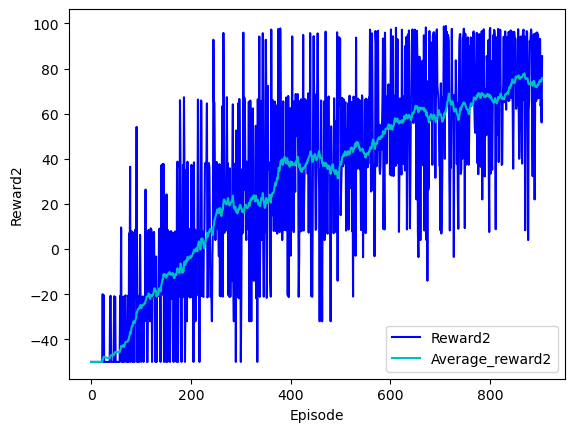

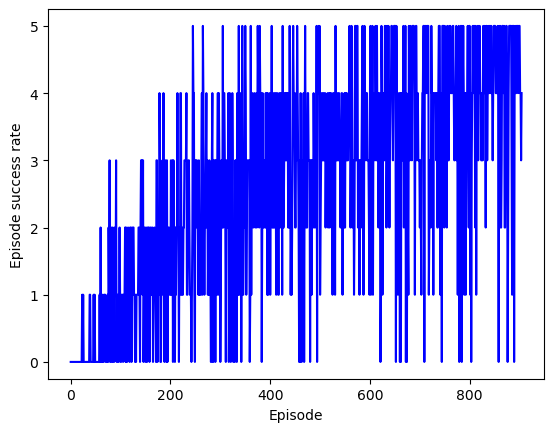

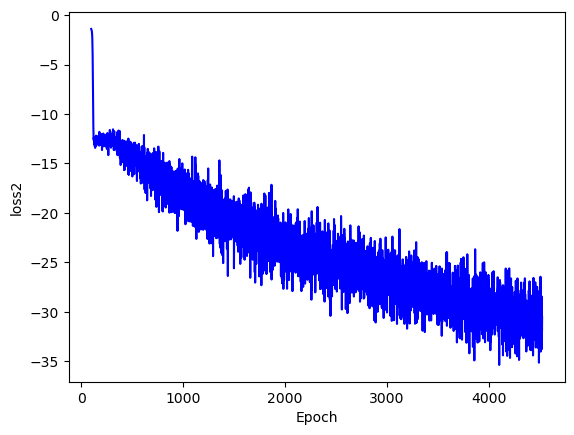

***** epoch 181 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88985.18674987639
r_em 58119.651545887915
58119.651545887915
ReWard2/R0 11.623930309177583
reward2 is: 19.62393030917758
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 1 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88648.92236445456
r_em 58630.718774253575
58630.718774253575
ReWard2/R0 11.726143754850716
reward2 is: 19.726143754850717
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 3 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87926.51610531437
r_em 59003.19312997986
59003.19312997986
ReWard2/R0 11.800638625995973
reward2 is: 19.800638625995973
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 4 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87815.60681315859
r_em 58929.31223472136
58929.31223472136
ReWard2/R0 11.785862446944272
reward2 is: 19.78586244694427
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.10903852054439558
***** epoch 181 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81943.47052295603
r_em 54762.676004309535
54762.676004309535
ReWard2/R0 10.952535200861908
reward2 is: 18.95253520086191
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 6 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82222.45985239466
r_em 54639.87470827969
54639.87470827969
ReWard2/R0 10.927974941655938
reward2 is: 18.92797494165594
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 7 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 8 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81907.14704665617
r_em 55451.585854247525
55451.585854247525
ReWard2/R0 11.090317170849506
reward2 is: 19.090317170849506
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 9 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81912.36003229278
r_em 55627.86376538457
55627.86376538457
ReWard2/R0 11.125572753076915
reward2 is: 19.125572753076916
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.1087661967030719
***** epoch 181 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 75837.68104350935
r_em 56819.94272351084
56819.94272351084
ReWard2/R0 11.363988544702167
reward2 is: 19.363988544702167
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 11 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 75672.5071353631
r_em 56573.23287767221
56573.23287767221
ReWard2/R0 11.314646575534443
reward2 is: 19.314646575534443
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 12 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 13 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 76621.76015278118
r_em 57314.06005424039
57314.06005424039
ReWard2/R0 11.462812010848078
reward2 is: 19.462812010848076
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 10ms/step
***** frame 14 *****
1/1 [==============================] - 0s 42ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.10849455299088225
***** epoch 181 episode 3 *****
***** frame 15 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 16 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 68242.35984798698
r_em 55435.413010767996
55435.413010767996
ReWard2/R0 11.087082602153599
reward2 is: 19.0870826021536
total number of ur2 RBs: 8.0
to

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 17 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 70895.89106031736
r_em 55896.389521591
55896.389521591
ReWard2/R0 11.1792779043182
reward2 is: 19.179277904318198
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 18 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 74591.31850482854
r_em 55672.244228007105
55672.244228007105
ReWard2/R0 11.13444884560142
reward2 is: 19.13444884560142
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 19 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 73580.38133258827
r_em 56227.39510455316
56227.39510455316
ReWard2/R0 11.245479020910631
reward2 is: 19.24547902091063
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.10822358770920325
***** epoch 181 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96395.01296839924
r_em 56141.07773330504
56141.07773330504
ReWard2/R0 11.228215546661009
reward2 is: 19.22821554666101
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 21 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87022.29340697858
r_em 54691.70788723822
54691.70788723822
ReWard2/R0 10.938341577447645
reward2 is: 18.938341577447645
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 22 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89029.80478991619
r_em 55050.1626907531
55050.1626907531
ReWard2/R0 11.01003253815062
reward2 is: 19.010032538150618
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 23 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90916.73165494578
r_em 54915.58185993402
54915.58185993402
ReWard2/R0 10.983116371986805
reward2 is: 18.983116371986803
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.10795329916365388


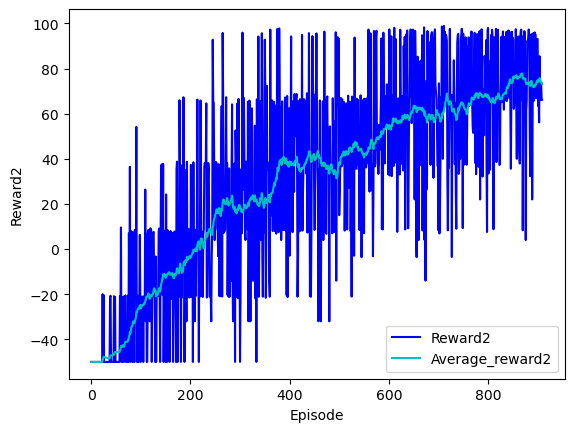

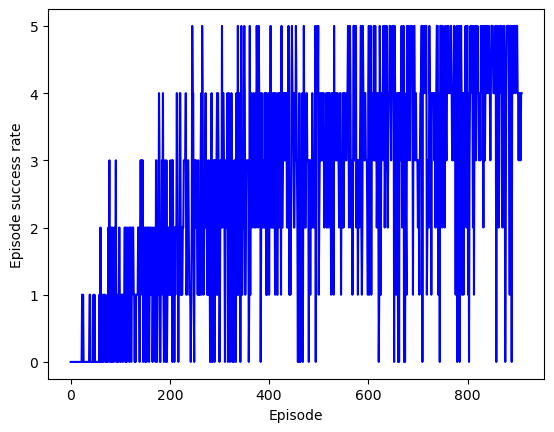

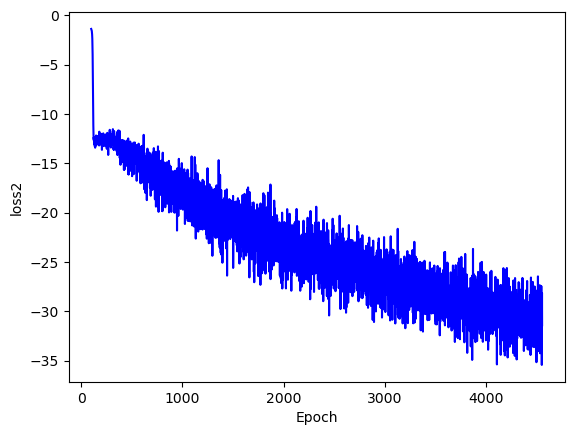

***** epoch 182 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92000.50128717402
r_em 57097.55896772649
57097.55896772649
ReWard2/R0 11.419511793545297
reward2 is: 19.419511793545297
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 1 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91517.58191547373
r_em 57074.01879254707
57074.01879254707
ReWard2/R0 11.414803758509413
reward2 is: 19.414803758509414
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 2 *****
1/1 [==============================] - 0s 40ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91839.12395215909
r_em 56567.806987156015
56567.806987156015
ReWard2/R0 11.313561397431203
reward2 is: 19.3135613974312
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 3 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92601.11669966602
r_em 56379.707763185
56379.707763185
ReWard2/R0 11.275941552636999
reward2 is: 19.275941552637
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 4 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91079.7760865705
r_em 55977.20251056416
55977.20251056416
ReWard2/R0 11.195440502112831
reward2 is: 19.19544050211283
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.1076836856640848
***** epoch 182 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89778.82116139312
r_em 54545.31834039028
54545.31834039028
ReWard2/R0 10.909063668078057
reward2 is: 18.909063668078055
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 6 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89353.23426761206
r_em 54697.54069881748
54697.54069881748
ReWard2/R0 10.939508139763497
reward2 is: 18.939508139763497
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 7 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90676.24383823195
r_em 55158.1696760346
55158.1696760346
ReWard2/R0 11.031633935206921
reward2 is: 19.03163393520692
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 8 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92508.33863222
r_em 56534.41420844815
56534.41420844815
ReWard2/R0 11.30688284168963
reward2 is: 19.306882841689628
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 9 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.10741474552456781
***** epoch 182 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77284.05755274158
r_em 55272.572301741886
55272.572301741886
ReWard2/R0 11.054514460348377
reward2 is: 19.05451446034838
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 11 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77282.7753978376
r_em 56092.77547965311
56092.77547965311
ReWard2/R0 11.218555095930622
reward2 is: 19.218555095930622
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 12 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77203.50144686729
r_em 56228.12072795822
56228.12072795822
ReWard2/R0 11.245624145591645
reward2 is: 19.245624145591645
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 13 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 76890.26851439424
r_em 55914.00036895433
55914.00036895433
ReWard2/R0 11.182800073790865
reward2 is: 19.182800073790865
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 14 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 75307.44559755178
r_em 56025.5604570078
56025.5604570078
ReWard2/R0 11.20511209140156
reward2 is: 19.20511209140156
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.10714647706338536
***** epoch 182 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 91669.61005604114
r_em 56042.80907520801
56042.80907520801
ReWard2/R0 11.208561815041602
reward2 is: 19.2085618150416
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step
***** frame 16 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 92357.95486229911
r_em 55592.961101136694
55592.961101136694
ReWard2/R0 11.118592220227338
reward2 is: 19.118592220227338
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step
***** frame 17 *****
1/1 [==============================] - 0s 30ms/step
w

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 23 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87359.84601702697
r_em 57371.634716779336
57371.634716779336
ReWard2/R0 11.474326943355868
reward2 is: 19.47432694335587
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 24 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84141.96085704076
r_em 57245.84235172394
57245.84235172394
ReWard2/R0 11.44916847034479
reward2 is: 19.449168470344787
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.10661194847014373


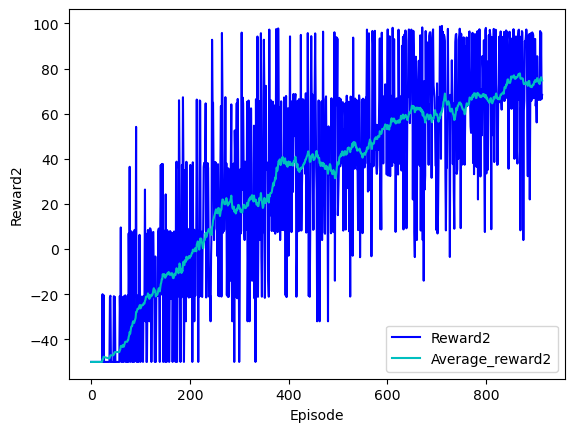

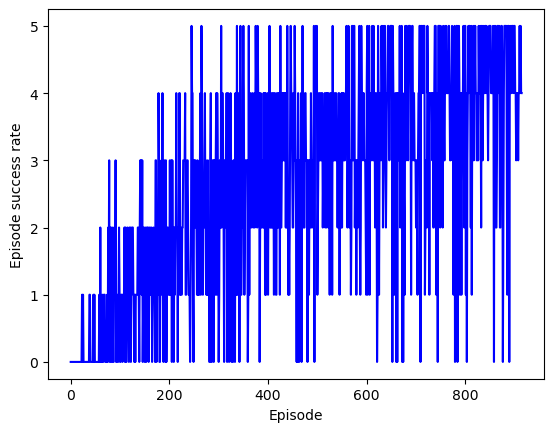

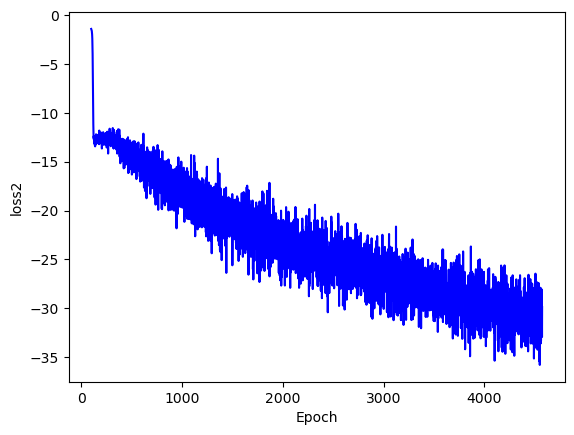

***** epoch 183 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90241.98233106085
r_em 50166.86102438471
50166.86102438471
ReWard2/R0 10.033372204876942
reward2 is: 18.03337220487694
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 1 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89709.55691113738
r_em 51163.645776937534
51163.645776937534
ReWard2/R0 10.232729155387506
reward2 is: 18.232729155387506
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 2 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86639.80343068091
r_em 52806.44837622719
52806.44837622719
ReWard2/R0 10.561289675245439
reward2 is: 18.56128967524544
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 3 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 4 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82123.89640688756
r_em 52942.9096098053
52942.9096098053
ReWard2/R0 10.58858192196106
reward2 is: 18.588581921961058
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.10634568499560795
***** epoch 183 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90614.37021831967
r_em 55763.8859216222
55763.8859216222
ReWard2/R0 11.152777184324439
reward2 is: 19.15277718432444
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 6 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89015.99187632193
r_em 55581.90886578727
55581.90886578727
ReWard2/R0 11.116381773157455
reward2 is: 19.116381773157457
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 7 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88919.36236138793
r_em 54174.163468295534
54174.163468295534
ReWard2/R0 10.834832693659108
reward2 is: 18.83483269365911
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 8 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 9 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87946.29863522033
r_em 52809.25447724201
52809.25447724201
ReWard2/R0 10.561850895448401
reward2 is: 18.5618508954484
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.10608008651443257
***** epoch 183 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86234.17306187097
r_em 54671.21138074968
54671.21138074968
ReWard2/R0 10.934242276149936
reward2 is: 18.934242276149938
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 11 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86225.01419256104
r_em 53142.865498065104
53142.865498065104
ReWard2/R0 10.628573099613021
reward2 is: 18.62857309961302
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 12 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85524.14457868371
r_em 53116.55775788627
53116.55775788627
ReWard2/R0 10.623311551577254
reward2 is: 18.623311551577252
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 3ms/step
***** frame 13 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87648.483080476
r_em 54385.26714393913
54385.26714393913
ReWard2/R0 10.877053428787825
reward2 is: 18.877053428787825
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 14 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88058.78630205162
r_em 53651.554497219644
53651.554497219644
ReWard2/R0 10.730310899443928
reward2 is: 18.73031089944393
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.10581515136579583
***** epoch 183 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90987.46479373256
r_em 54994.21856657395
54994.21856657395
ReWard2/R0 10.998843713314791
reward2 is: 18.99884371331479
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 17 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89412.95098906175
r_em 55055.92503722528
55055.92503722528
ReWard2/R0 11.011185007445055
reward2 is: 19.011185007445057
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 18 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 19 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90717.30929532164
r_em 54518.87908153654
54518.87908153654
ReWard2/R0 10.90377581630731
reward2 is: 18.90377581630731
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.10555087789302389
***** epoch 183 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80346.8632707408
r_em 55424.834453043855
55424.834453043855
ReWard2/R0 11.08496689060877
reward2 is: 19.08496689060877
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 21 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83885.82485817146
r_em 53318.685548836314
53318.685548836314
ReWard2/R0 10.663737109767263
reward2 is: 18.66373710976726
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 22 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90701.33186237098
r_em 53630.52830221462
53630.52830221462
ReWard2/R0 10.726105660442924
reward2 is: 18.726105660442926
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 23 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93672.75227027209
r_em 53533.4474003812
53533.4474003812
ReWard2/R0 10.706689480076239
reward2 is: 18.70668948007624
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 24 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96113.52774809941
r_em 54044.632251968505
54044.632251968505
ReWard2/R0 10.8089264503937
reward2 is: 18.8089264503937
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.10528726444358047


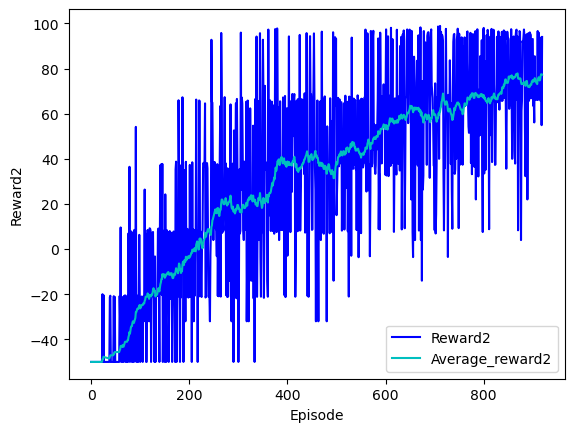

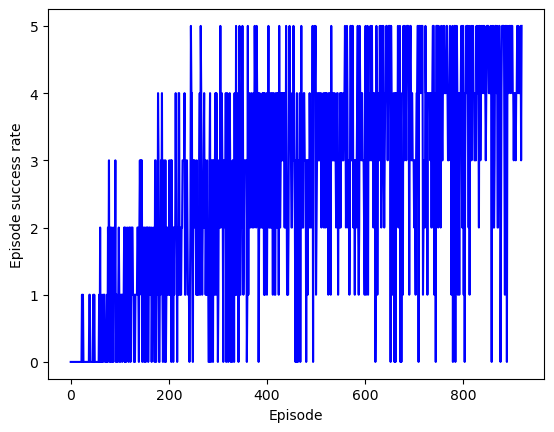

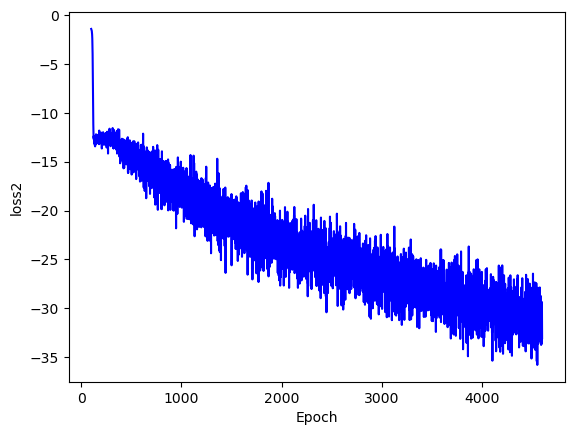

***** epoch 184 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85238.65063729943
r_em 51986.481721608245
51986.481721608245
ReWard2/R0 10.39729634432165
reward2 is: 18.39729634432165
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 1 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84455.03908832389
r_em 51471.629478599025
51471.629478599025
ReWard2/R0 10.294325895719805
reward2 is: 18.294325895719805
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 3 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 95377.66195199016
r_em 51884.249789389316
51884.249789389316
ReWard2/R0 10.376849957877862
reward2 is: 18.376849957877862
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step
***** frame 4 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87451.30710511065
r_em 52210.1102858842
52210.1102858842
ReWard2/R0 10.442022057176839
reward2 is: 18.442022057

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.10502430936905649
***** epoch 184 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81647.14442681092
r_em 56214.87141647601
56214.87141647601
ReWard2/R0 11.242974283295203
reward2 is: 19.242974283295204
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 9ms/step
***** frame 6 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84047.67917225731
r_em 55789.85953135605
55789.85953135605
ReWard2/R0 11.15797190627121
reward2 is: 19.15797190627121
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 7 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83623.369595304
r_em 55075.75685785285
55075.75685785285
ReWard2/R0 11.015151371570571
reward2 is: 19.01515137157057
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 10ms/step
***** frame 8 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83612.82014835611
r_em 55716.64814134633
55716.64814134633
ReWard2/R0 11.143329628269267
reward2 is: 19.143329628269267
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 11ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 11ms/step
***** frame 9 *****
1/1 [==============================] - 0s 48ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 92067.03241414322
r_em 56137.45397619782
56137.45397619782
ReWard2/R0 11.227490795239564
reward2 is: 19.227490795239564
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.10476201102515974
***** epoch 184 episode 2 *****
***** frame 10 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 11 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 76499.53694869755
r_em 56844.254859134424

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 12 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77308.04530652054
r_em 56995.56524324235
56995.56524324235
ReWard2/R0 11.39911304864847
reward2 is: 19.39911304864847
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 13 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 14 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77945.7205241008
r_em 56953.63074347871
56953.63074347871
ReWard2/R0 11.390726148695741
reward2 is: 19.39072614869574
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 9ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.10450036777170466
***** epoch 184 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 75546.24941905608
r_em 52715.64319756679
52715.64319756679
ReWard2/R0 10.543128639513357
reward2 is: 18.543128639513355
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 16 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 75878.33956775026
r_em 51676.68994351983
51676.68994351983
ReWard2/R0 10.335337988703966
reward2 is: 18.335337988703966
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 17 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 75004.62515234342
r_em 53709.17291046009
53709.17291046009
ReWard2/R0 10.741834582092018
reward2 is: 18.741834582092018
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 18 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 72561.02511520796
r_em 53452.25141904102
53452.25141904102
ReWard2/R0 10.690450283808204
reward2 is: 18.690450283808204
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 19 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 73591.57629435782
r_em 54036.50639387251
54036.50639387251
ReWard2/R0 10.807301278774501
reward2 is: 18.807301278774503
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.10423937797260206
***** epoch 184 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78576.05552603072
r_em 56754.80962712931
56754.80962712931
ReWard2/R0 11.350961925425862
reward2 is: 19.350961925425864
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 21 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78038.72315545328
r_em 56417.35166924393
56417.35166924393
ReWard2/R0 11.283470333848786
reward2 is: 19.283470333848786
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 22 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 23 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80308.63855260132
r_em 55024.402130303606
55024.402130303606
ReWard2/R0 11.004880426060721
reward2 is: 19.004880426060723
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 24 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79061.68957376177
r_em 54492.817157407895
54492.817157407895
ReWard2/R0 10.898563431481579
reward2 is: 18.898563431481577
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.10397903999584887


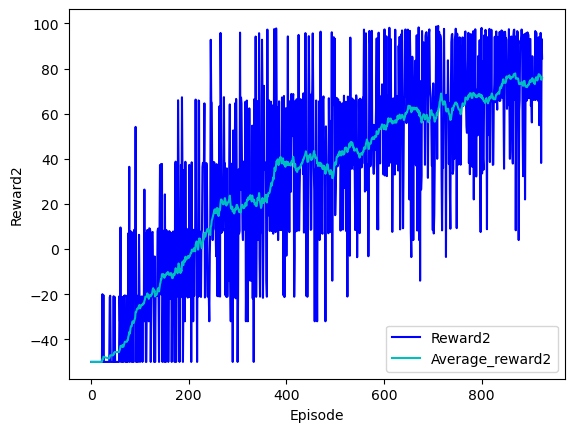

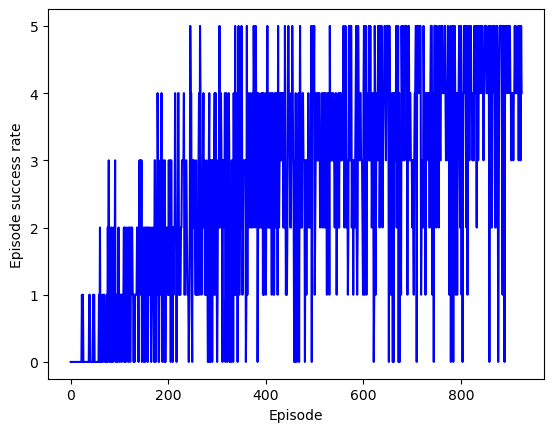

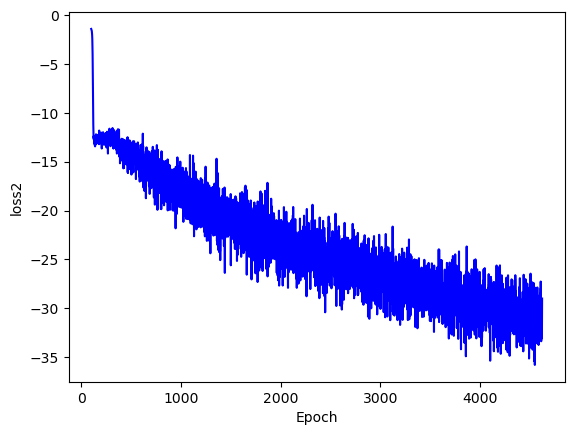

***** epoch 185 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79872.13897126098
r_em 55222.950545801585
55222.950545801585
ReWard2/R0 11.044590109160318
reward2 is: 19.044590109160318
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 1 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80521.48500664157
r_em 55609.26977018641
55609.26977018641
ReWard2/R0 11.121853954037281
reward2 is: 19.12185395403728
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 4 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81161.19934348104
r_em 55016.0025528323
55016.0025528323
ReWard2/R0 11.00320051056646
reward2 is: 19.003200510566458
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 9ms/step
Epsilon_hist is: 0.10371935221351795
***** epoch 185 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94214.60069374289
r_em 56070.21880072044
56070.21880072044
ReWard2/R0 11.214043760144088
reward2 is: 19.214043760144087
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 6 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93774.25076908433
r_em 56146.7646058481
56146.7646058481
ReWard2/R0 11.22935292116962
reward2 is: 19.22935292116962
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 7 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93416.79951923822
r_em 55875.82981487144
55875.82981487144
ReWard2/R0 11.175165962974289
reward2 is: 19.17516596297429
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 8 *****
1/1 [==============================] - 0s 40ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95026.30039352883
r_em 55866.1988991949
55866.1988991949
ReWard2/R0 11.17323977983898
reward2 is: 19.17323977983898
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 9 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95321.88037511439
r_em 55125.540760478136
55125.540760478136
ReWard2/R0 11.025108152095628
reward2 is: 19.025108152095626
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.10346031300174793
***** epoch 185 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91069.37289773738
r_em 57731.45953035362
57731.45953035362
ReWard2/R0 11.546291906070724
reward2 is: 19.546291906070724
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 11 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90558.56769312407
r_em 57918.72555462035
57918.72555462035
ReWard2/R0 11.58374511092407
reward2 is: 19.58374511092407
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 12 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 13 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90954.37040217273
r_em 58390.78281419054
58390.78281419054
ReWard2/R0 11.678156562838108
reward2 is: 19.678156562838108
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 14 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.10320192074073303
***** epoch 185 episode 3 *****
***** frame 15 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 16 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 98019.51682631945
r_em 54830.628139364984
54830.628139364984
ReWard2/R0 10.966125627872996
reward2 is: 18.966125627872998
total number of ur2 RBs: 8.0
total number of em2 R

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 17 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96620.06667311853
r_em 54489.32048517835
54489.32048517835
ReWard2/R0 10.89786409703567
reward2 is: 18.897864097035672
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 18 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96609.17641221717
r_em 55281.38243555374
55281.38243555374
ReWard2/R0 11.056276487110749
reward2 is: 19.05627648711075
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 19 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96693.128491026
r_em 55282.926545674345
55282.926545674345
ReWard2/R0 11.056585309134869
reward2 is: 19.056585309134867
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.10294417381471291
***** epoch 185 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91804.9352689783
r_em 55445.494470402205
55445.494470402205
ReWard2/R0 11.089098894080442
reward2 is: 19.089098894080443
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 21 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 22 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 23 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89254.25786998661
r_em 54348.78776411348
54348.78776411348
ReWard2/R0 10.869757552822696
reward2 is: 18.869757552822698
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 13ms/step
Epsilon_hist is: 0.10268707061196264


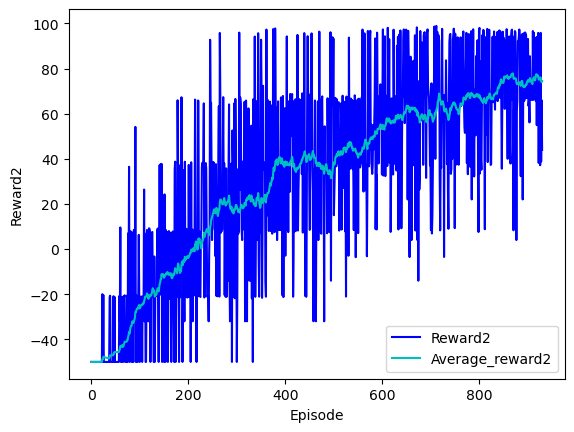

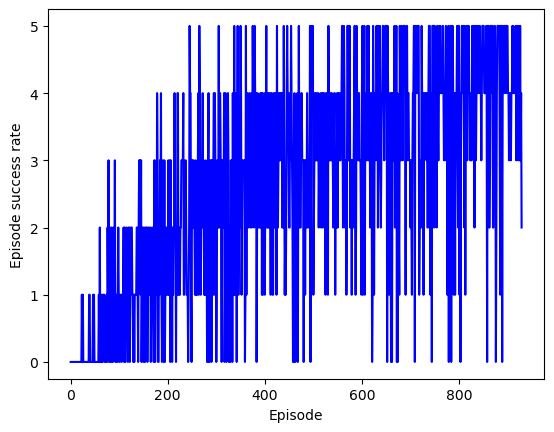

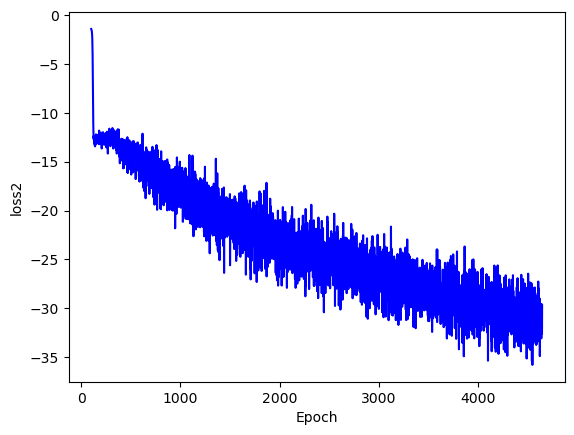

***** epoch 186 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82494.54801038673
r_em 57218.8441413868
57218.8441413868
ReWard2/R0 11.44376882827736
reward2 is: 19.44376882827736
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 15ms/step
***** frame 1 *****
1/1 [==============================] - 0s 70ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82473.01782942537
r_em 57063.12995124732
57063.12995124732
ReWard2/R0 11.412625990249463
reward2 is: 19.412625990249463
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 12ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 12ms/step
***** frame 2 *****
1/1 [==============================] - 0s 46ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83389.63651042226
r_em 56934.9299086267
56934.9299086267
ReWard2/R0 11.38698598172534
reward2 is: 19.38698598172534
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 9ms/step
***** frame 3 *****
1/1 [==============================] - 0s 43ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88324.84435701024
r_em 56863.282074233466
56863.282074233466
ReWard2/R0 11.372656414846693
reward2 is: 19.372656414846695
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 9ms/step
***** frame 4 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86760.38384909046
r_em 55934.25143916924
55934.25143916924
ReWard2/R0 11.186850287833847
reward2 is: 19.18685028783385
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.10243060952478254
***** epoch 186 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 9ms/step
***** frame 6 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85964.78480083274
r_em 53524.18641581448
53524.18641581448
ReWard2/R0 10.704837283162897
reward2 is: 18.704837283162895
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 7 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84035.64728810804
r_em 53400.05722701064
53400.05722701064
ReWard2/R0 10.680011445402128
reward2 is: 18.68001144540213
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 8 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82715.31661601242
r_em 53972.55495271607
53972.55495271607
ReWard2/R0 10.794510990543214
reward2 is: 18.794510990543216
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 9 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.10217478894948816
***** epoch 186 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94420.00298652503
r_em 56297.39165648691
56297.39165648691
ReWard2/R0 11.259478331297382
reward2 is: 19.25947833129738
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 11 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 12 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 97484.11601516251
r_em 56808.41344106331
56808.41344106331
ReWard2/R0 11.361682688212662
reward2 is: 19.36168268821266
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 13 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96983.4539743305
r_em 55948.59676072743
55948.59676072743
ReWard2/R0 11.189719352145486
reward2 is: 19.189719352145488
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 14 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95481.1988188757
r_em 56735.4948407501
56735.4948407501
ReWard2/R0 11.34709896815002
reward2 is: 19.34709896815002
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.10191960728640029
***** epoch 186 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96666.44418077174
r_em 51395.44493586552
51395.44493586552
ReWard2/R0 10.279088987173104
reward2 is: 18.279088987173104
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 16 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 101926.57626381164
r_em 51028.56040776657
51028.56040776657
ReWard2/R0 10.205712081553314
reward2 is: 18.205712081553315
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 17 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 99891.79495888477
r_em 51862.3964951002
51862.3964951002
ReWard2/R0 10.37247929902004
reward2 is: 18.37247929902004
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 13ms/step
***** frame 18 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94831.6844652393
r_em 52788.925160919374
52788.925160919374
ReWard2/R0 10.557785032183874
reward2 is: 18.557785032183872
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 19 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93185.30971792538
r_em 52305.43005889824
52305.43005889824
ReWard2/R0 10.461086011779647
reward2 is: 18.46108601177965
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.10166506293983486
***** epoch 186 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96255.43015712721
r_em 54220.42018206646
54220.42018206646
ReWard2/R0 10.844084036413292
reward2 is: 18.844084036413292
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 21 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96198.33688535748
r_em 54430.174535214486
54430.174535214486
ReWard2/R0 10.886034907042898
reward2 is: 18.886034907042898
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 22 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96109.7147444777
r_em 54935.27985608854
54935.27985608854
ReWard2/R0 10.987055971217709
reward2 is: 18.987055971217707
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 23 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 98725.39870226567
r_em 55567.65776457575
55567.65776457575
ReWard2/R0 11.11353155291515
reward2 is: 19.11353155291515
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 24 *****
1/1 [==============================] - 0s 39ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96188.97436101158
r_em 55406.51895936721
55406.51895936721
ReWard2/R0 11.081303791873442
reward2 is: 19.08130379187344
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.10141115431809308


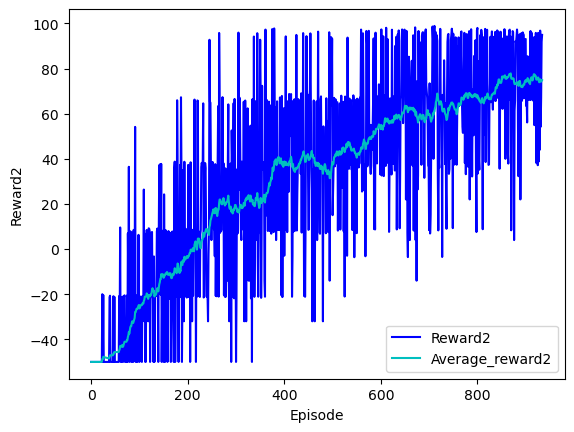

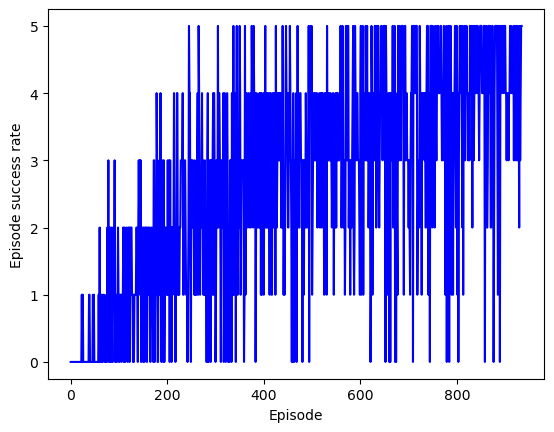

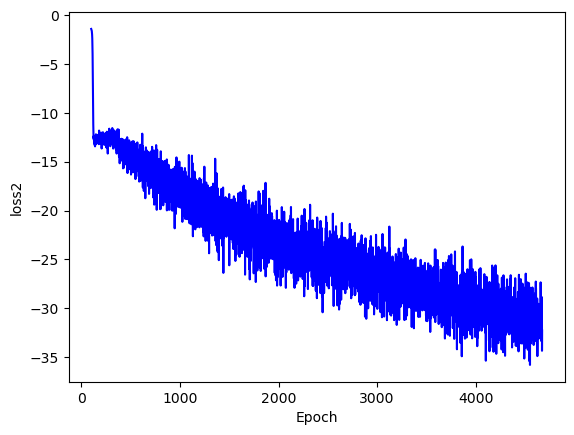

***** epoch 187 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90693.02884921634
r_em 54075.96307338777
54075.96307338777
ReWard2/R0 10.815192614677555
reward2 is: 18.815192614677557
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 12ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 9ms/step
***** frame 1 *****
1/1 [==============================] - 0s 41ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91988.91808351089
r_em 54292.57930785563
54292.57930785563
ReWard2/R0 10.858515861571126
reward2 is: 18.858515861571128
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 2 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92188.71250022751
r_em 53991.78214231635
53991.78214231635
ReWard2/R0 10.79835642846327
reward2 is: 18.798356428463272
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 4 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92826.56134800575
r_em 55103.00390774911
55103.00390774911
ReWard2/R0 11.020600781549822
reward2 is: 19.020600781549824
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.10115787983345143
***** epoch 187 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81819.95569851242
r_em 55622.68308043428
55622.68308043428
ReWard2/R0 11.124536616086857
reward2 is: 19.124536616086857
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 6 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79661.36797816044
r_em 56080.176053715506
56080.176053715506
ReWard2/R0 11.216035210743101
reward2 is: 19.2160352107431
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 7 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79542.83192592014
r_em 55958.02563445349
55958.02563445349
ReWard2/R0 11.191605126890698
reward2 is: 19.1916051268907
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 8 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81367.78210490476
r_em 55586.18311166973
55586.18311166973
ReWard2/R0 11.117236622333946
reward2 is: 19.117236622333948
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 9 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81205.75899354162
r_em 55796.09894029634
55796.09894029634
ReWard2/R0 11.159219788059268
reward2 is: 19.159219788059268
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.10090523790215165
***** epoch 187 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 98442.77158961754
r_em 54266.89290988432
54266.89290988432
ReWard2/R0 10.853378581976864
reward2 is: 18.853378581976862
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step
***** frame 11 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 99375.90705058792
r_em 54750.46052642259
54750.46052642259
ReWard2/R0 10.950092105284519
reward2 is: 18.95009210528452
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step
***** frame 12 *****
1/1 [==============================] - 0s 31ms/step
we

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 16 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90645.26787704443
r_em 48759.405421530384
48759.405421530384
ReWard2/R0 9.751881084306078
reward2 is: 17.751881084306078
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 17 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90236.57558186934
r_em 50059.63901457267
50059.63901457267
ReWard2/R0 10.011927802914533
reward2 is: 18.011927802914535
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 18 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91491.73514680476
r_em 51357.53659731339
51357.53659731339
ReWard2/R0 10.271507319462678
reward2 is: 18.27150731946268
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 19 *****
1/1 [==============================] - 0s 40ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91700.92978371606
r_em 51139.773941017025
51139.773941017025
ReWard2/R0 10.227954788203405
reward2 is: 18.227954788203405
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.10040184538431238
***** epoch 187 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93385.03198689762
r_em 54581.15944535883
54581.15944535883
ReWard2/R0 10.916231889071767
reward2 is: 18.916231889071767
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 21 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93741.70737960919
r_em 53733.47675135384
53733.47675135384
ReWard2/R0 10.746695350270768
reward2 is: 18.74669535027077
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 23 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92268.8537178277
r_em 53425.86617217917
53425.86617217917
ReWard2/R0 10.685173234435835
reward2 is: 18.685173234435837
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 24 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93076.69416566512
r_em 54130.9604125351
54130.9604125351
ReWard2/R0 10.82619208250702
reward2 is: 18.82619208250702
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.10015109164999415


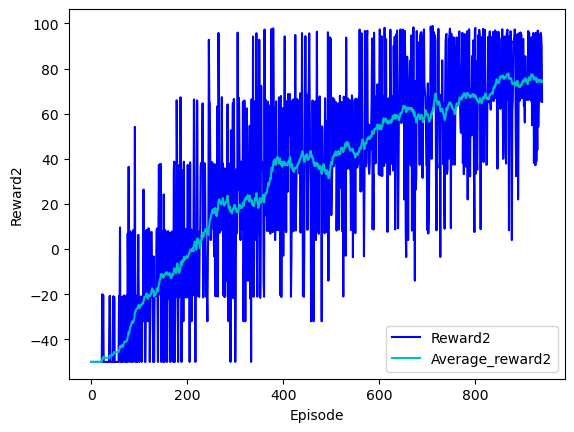

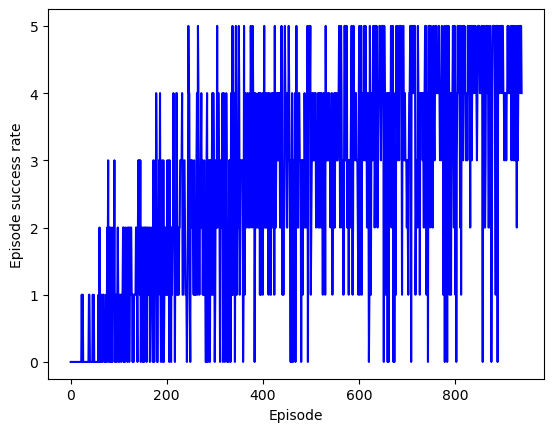

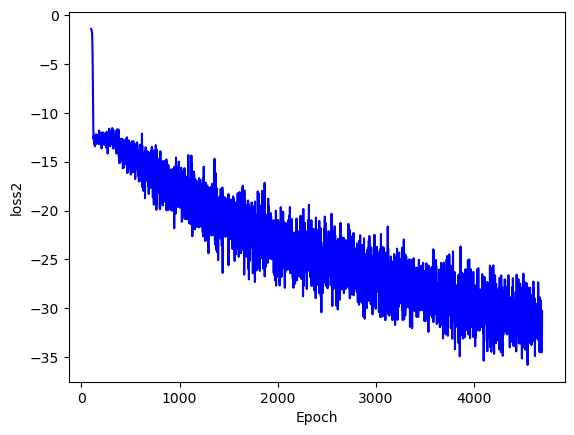

***** epoch 188 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 74351.2624623296
r_em 58199.95501597622
58199.95501597622
ReWard2/R0 11.639991003195245
reward2 is: 19.639991003195245
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 1 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 74534.36428213712
r_em 58749.03324781706
58749.03324781706
ReWard2/R0 11.749806649563412
reward2 is: 19.74980664956341
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 9ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 10ms/step
***** frame 2 *****
1/1 [==============================] - 0s 51ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 73808.29971271873
r_em 58606.05370643402
58606.05370643402
ReWard2/R0 11.721210741286804
reward2 is: 19.721210741286804
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 3 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 75476.45541710622
r_em 58581.61955145632
58581.61955145632
ReWard2/R0 11.716323910291264
reward2 is: 19.716323910291266
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 4 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.09990096417344076
***** epoch 188 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 41ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86769.68059384903
r_em 52855.26884907883
52855.26884907883
ReWard2/R0 10.571053769815766
reward2 is: 18.571053769815766
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 6 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88854.19855689192
r_em 52309.97049340932
52309.97049340932
ReWard2/R0 10.461994098681863
reward2 is: 18.461994098681863
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 7 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89560.3740685106
r_em 52355.12280436574
52355.12280436574
ReWard2/R0 10.471024560873149
reward2 is: 18.471024560873147
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 8 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92325.89012728518
r_em 53318.26744840199
53318.26744840199
ReWard2/R0 10.663653489680398
reward2 is: 18.6636534896804
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 9 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91264.54639563744
r_em 52207.72309938477
52207.72309938477
ReWard2/R0 10.441544619876954
reward2 is: 18.441544619876954
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.09965146139057263
***** epoch 188 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 11 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 76614.06789776325
r_em 55938.45175788162
55938.45175788162
ReWard2/R0 11.187690351576325
reward2 is: 19.187690351576325
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 12 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77749.78797624669
r_em 56078.36463516923
56078.36463516923
ReWard2/R0 11.215672927033847
reward2 is: 19.215672927033847
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 13 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78976.65353048244
r_em 56231.246812529615
56231.246812529615
ReWard2/R0 11.246249362505923
reward2 is: 19.24624936250592
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 14 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79431.01990650289
r_em 56057.99140546056
56057.99140546056
ReWard2/R0 11.211598281092112
reward2 is: 19.21159828109211
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.09940258174121651
***** epoch 188 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88023.37576898038
r_em 56350.752115500145
56350.752115500145
ReWard2/R0 11.270150423100029
reward2 is: 19.270150423100027
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 16 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87776.45810331496
r_em 56225.39923557011
56225.39923557011
ReWard2/R0 11.245079847114022
reward2 is: 19.24507984711402
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 17 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88598.4476663356
r_em 56557.385994293545
56557.385994293545
ReWard2/R0 11.311477198858709
reward2 is: 19.31147719885871
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 18 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86910.10431802721
r_em 56682.6126803248
56682.6126803248
ReWard2/R0 11.33652253606496
reward2 is: 19.33652253606496
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 19 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88640.78645078136
r_em 56473.38513340648
56473.38513340648
ReWard2/R0 11.294677026681297
reward2 is: 19.2946770266813
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.09915432366909567
***** epoch 188 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85565.65522711529
r_em 55988.62029952633
55988.62029952633
ReWard2/R0 11.197724059905266
reward2 is: 19.197724059905266
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 21 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85684.9257940891
r_em 56411.94616398276
56411.94616398276
ReWard2/R0 11.282389232796552
reward2 is: 19.282389232796554
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 22 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83855.50745926707
r_em 56455.7899678718
56455.7899678718
ReWard2/R0 11.29115799357436
reward2 is: 19.29115799357436
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 23 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82269.89470007157
r_em 56646.25185996896
56646.25185996896
ReWard2/R0 11.329250371993792
reward2 is: 19.329250371993794
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.0989066856218202


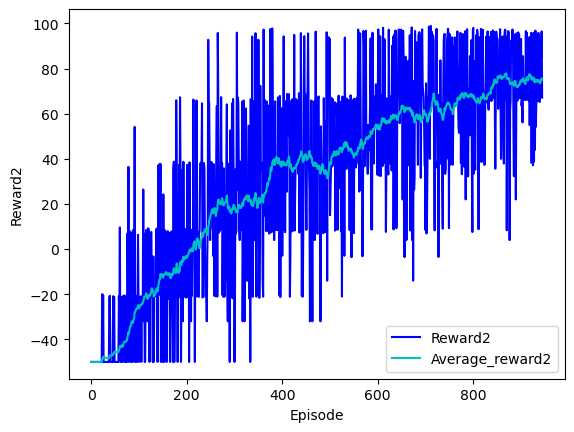

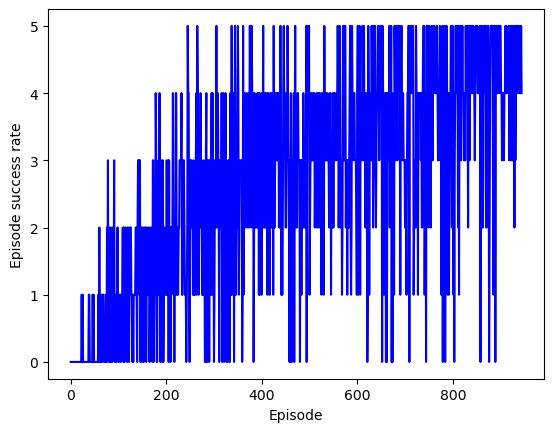

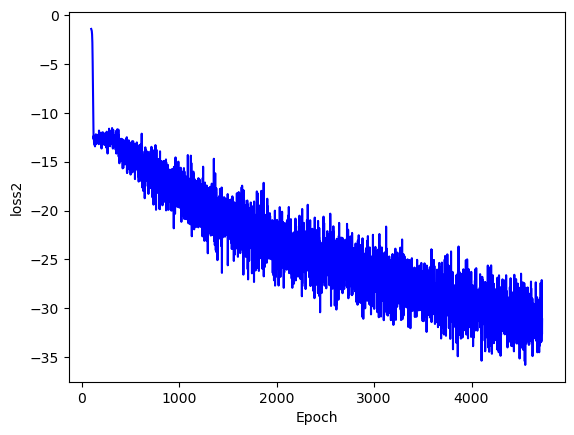

***** epoch 189 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88128.38128025111
r_em 56307.74853520924
56307.74853520924
ReWard2/R0 11.261549707041848
reward2 is: 19.261549707041848
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 1 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86825.53274435706
r_em 56377.21652891345
56377.21652891345
ReWard2/R0 11.27544330578269
reward2 is: 19.27544330578269
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 2 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88466.3326342768
r_em 56305.36801157769
56305.36801157769
ReWard2/R0 11.261073602315538
reward2 is: 19.261073602315538
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 3 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86511.2391946812
r_em 55886.0529497567
55886.0529497567
ReWard2/R0 11.17721058995134
reward2 is: 19.17721058995134
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 4 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87800.88676027609
r_em 54682.16136415837
54682.16136415837
ReWard2/R0 10.936432272831674
reward2 is: 18.936432272831674
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.09865966605087727
***** epoch 189 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88827.75042426845
r_em 52199.17432248169
52199.17432248169
ReWard2/R0 10.439834864496337
reward2 is: 18.439834864496337
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 6 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86256.66438839096
r_em 51819.6556548625
51819.6556548625
ReWard2/R0 10.3639311309725
reward2 is: 18.3639311309725
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 7 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86378.54030649774
r_em 52726.976462004845
52726.976462004845
ReWard2/R0 10.545395292400968
reward2 is: 18.54539529240097
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 8 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87847.02586602067
r_em 52929.57240512318
52929.57240512318
ReWard2/R0 10.585914481024636
reward2 is: 18.585914481024638
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 9 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88415.73787570454
r_em 52669.67218486591
52669.67218486591
ReWard2/R0 10.533934436973182
reward2 is: 18.533934436973183
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.09841326341162147
***** epoch 189 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 73612.65271731997
r_em 58116.0990568369
58116.0990568369
ReWard2/R0 11.623219811367381
reward2 is: 19.62321981136738
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 11 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 76124.62484351787
r_em 58053.16428287313
58053.16428287313
ReWard2/R0 11.610632856574625
reward2 is: 19.610632856574625
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 12 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 75499.79503541047
r_em 57970.222978541424
57970.222978541424
ReWard2/R0 11.594044595708285
reward2 is: 19.594044595708283
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 13 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77089.01070622237
r_em 57824.73560894589
57824.73560894589
ReWard2/R0 11.564947121789178
reward2 is: 19.564947121789178
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 14 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 74685.88101066012
r_em 57869.58503881349
57869.58503881349
ReWard2/R0 11.573917007762699
reward2 is: 19.5739170077627
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.09816747616326515
***** epoch 189 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82572.7901587318
r_em 55063.1629248938
55063.1629248938
ReWard2/R0 11.012632584978759
reward2 is: 19.01263258497876
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 16 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 17 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 18 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 19 *****
1/1 [==============================] - 0s 35ms/st

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 10ms/step
***** frame 21 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79128.03802154312
r_em 53855.7716596909
53855.7716596909
ReWard2/R0 10.771154331938181
reward2 is: 18.77115433193818
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 22 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81677.12313332835
r_em 53403.460963220845
53403.460963220845
ReWard2/R0 10.68069219264417
reward2 is: 18.68069219264417
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 23 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79508.44228783346
r_em 53622.390059887985
53622.390059887985
ReWard2/R0 10.724478011977597
reward2 is: 18.724478011977595
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 24 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80134.200866727
r_em 53038.02245521628
53038.02245521628
ReWard2/R0 10.607604491043256
reward2 is: 18.607604491043254
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.09767774169533124


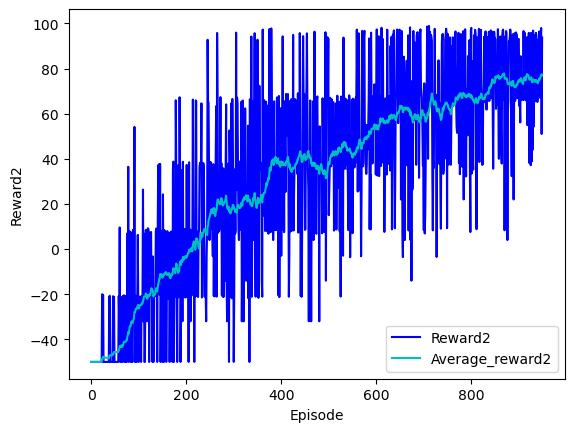

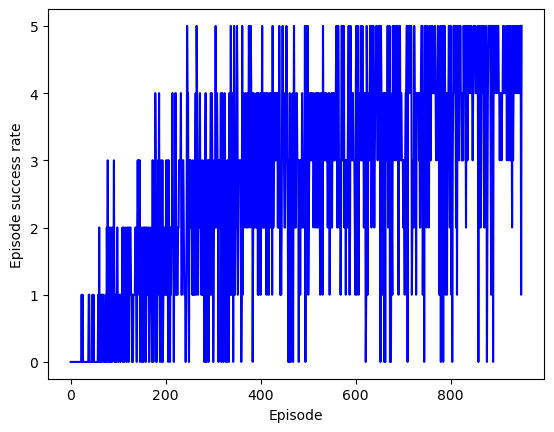

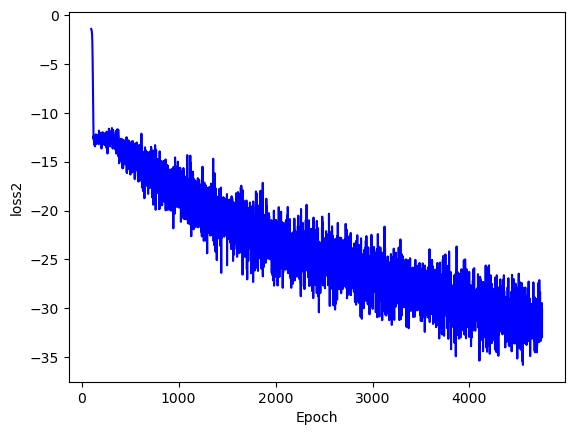

***** epoch 190 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 1 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 2 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 3 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 wi

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 7 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96436.618140919
r_em 53275.06108720717
53275.06108720717
ReWard2/R0 10.655012217441435
reward2 is: 18.655012217441435
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 8 *****
1/1 [==============================] - 0s 39ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96195.39617345275
r_em 53502.473898614604
53502.473898614604
ReWard2/R0 10.70049477972292
reward2 is: 18.70049477972292
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 9 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.09719045039756383
***** epoch 190 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81892.31233358243
r_em 57326.41266458191
57326.41266458191
ReWard2/R0 11.465282532916383
reward2 is: 19.465282532916383
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 11 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82771.79389261513
r_em 57295.41796596621
57295.41796596621
ReWard2/R0 11.459083593193242
reward2 is: 19.45908359319324
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 12 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80830.71965410063
r_em 56893.83688392442
56893.83688392442
ReWard2/R0 11.378767376784884
reward2 is: 19.378767376784886
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 13 *****
1/1 [==============================] - 0s 41ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80091.92186421971
r_em 56665.34849576673
56665.34849576673
ReWard2/R0 11.333069699153347
reward2 is: 19.33306969915335
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 14 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89456.24214838941
r_em 56790.59743378296
56790.59743378296
ReWard2/R0 11.358119486756593
reward2 is: 19.358119486756593
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.09694771712623826
***** epoch 190 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 100874.3446020059
r_em 55554.04230815085
55554.04230815085
ReWard2/R0 11.11080846163017
reward2 is: 19.11080846163017
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 16 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 101692.13660435867
r_em 56136.16290224028
56136.16290224028
ReWard2/R0 11.227232580448055
reward2 is: 19.227232580448053
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 17 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 103190.6470913528
r_em 56207.591891844495
56207.591891844495
ReWard2/R0 11.241518378368898
reward2 is: 19.241518378368898
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 18 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 103306.39909724587
r_em 55960.654928388096
55960.654928388096
ReWard2/R0 11.192130985677618
reward2 is: 19.19213098567762
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 19 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 103896.72635999248
r_em 56762.20229073434
56762.20229073434
ReWard2/R0 11.352440458146868
reward2 is: 19.352440458146866
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 10ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
Epsilon_hist is: 0.09670559008156115
***** epoch 190 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87270.17201883855
r_em 54965.02003327821
54965.02003327821
ReWard2/R0 10.993004006655642
reward2 is: 18.993004006655642
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 10ms/step
***** frame 21 *****
1/1 [==============================] - 0s 42ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87718.47380424972
r_em 55233.22080680829
55233.22080680829
ReWard2/R0 11.046644161361659
reward2 is: 19.04664416136166
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 12ms/step
***** frame 22 *****
1/1 [==============================] - 0s 69ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90652.81330528355
r_em 55299.3589893261
55299.3589893261
ReWard2/R0 11.05987179786522
reward2 is: 19.05987179786522
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 11ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 12ms/step
***** frame 23 *****
1/1 [==============================] - 0s 56ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87567.26722367533
r_em 55866.27977165153
55866.27977165153
ReWard2/R0 11.173255954330305
reward2 is: 19.173255954330305
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.09646406774948073


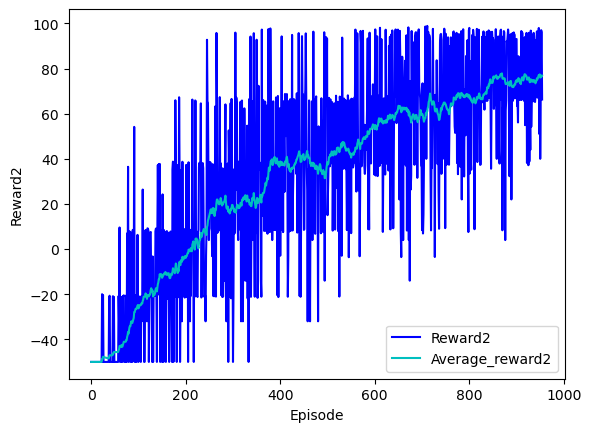

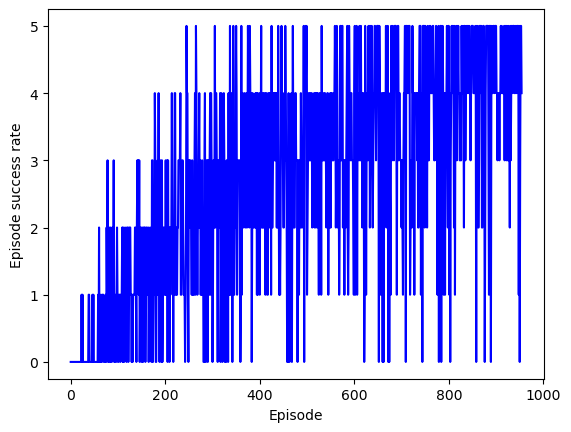

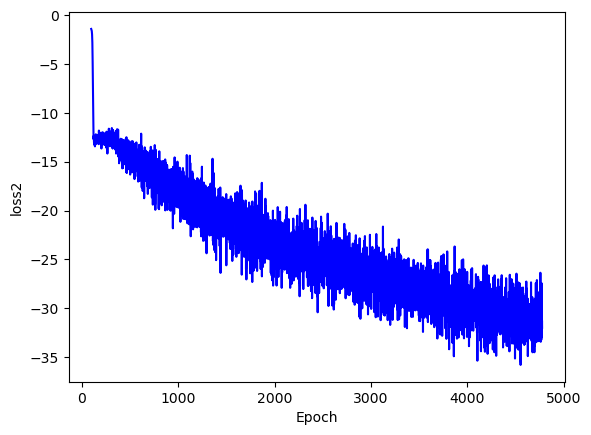

***** epoch 191 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81280.48580959304
r_em 60149.57665424673
60149.57665424673
ReWard2/R0 12.029915330849347
reward2 is: 20.02991533084935
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 1 *****
1/1 [==============================] - 0s 41ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81190.36670368435
r_em 53413.23496854283
53413.23496854283
ReWard2/R0 10.682646993708566
reward2 is: 18.682646993708566
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 2 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81523.20352872832
r_em 53709.977894665106
53709.977894665106
ReWard2/R0 10.741995578933022
reward2 is: 18.74199557893302
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 3 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81428.27666901934
r_em 54121.709790367844
54121.709790367844
ReWard2/R0 10.82434195807357
reward2 is: 18.824341958073568
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 10ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 12ms/step
***** frame 4 *****
1/1 [==============================] - 0s 56ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82518.74419848467
r_em 54472.72411514988
54472.72411514988
ReWard2/R0 10.894544823029976
reward2 is: 18.894544823029975
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 11ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 11ms/step
Epsilon_hist is: 0.09622314861972649
***** epoch 191 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 44ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95985.95354017403
r_em 56201.897845989726
56201.897845989726
ReWard2/R0 11.240379569197945
reward2 is: 19.240379569197945
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 6 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 97853.4043146708
r_em 56720.569074387124
56720.569074387124
ReWard2/R0 11.344113814877424
reward2 is: 19.344113814877424
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 7 *****
1/1 [==============================] - 0s 40ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 98760.23942535228
r_em 54662.33400996503
54662.33400996503
ReWard2/R0 10.932466801993007
reward2 is: 18.93246680199301
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 8 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 97715.2847852466
r_em 55172.099786144914
55172.099786144914
ReWard2/R0 11.034419957228982
reward2 is: 19.034419957228984
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 9 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 99338.77253386703
r_em 56078.84214166509
56078.84214166509
ReWard2/R0 11.215768428333018
reward2 is: 19.215768428333018
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.0959828311857999
***** epoch 191 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86144.0478590837
r_em 55345.400444612336
55345.400444612336
ReWard2/R0 11.069080088922467
reward2 is: 19.06908008892247
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 11 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86834.30389747112
r_em 56078.01251976336
56078.01251976336
ReWard2/R0 11.215602503952672
reward2 is: 19.215602503952674
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 12 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86122.06364059552
r_em 55481.751674728584
55481.751674728584
ReWard2/R0 11.096350334945717
reward2 is: 19.09635033494572
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 13 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85223.58065981192
r_em 56158.82266829746
56158.82266829746
ReWard2/R0 11.231764533659492
reward2 is: 19.231764533659494
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 14 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84773.16699530413
r_em 55765.920405318226
55765.920405318226
ReWard2/R0 11.153184081063646
reward2 is: 19.153184081063646
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.09574311394496485
***** epoch 191 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93283.19984648716
r_em 57660.54792195016
57660.54792195016
ReWard2/R0 11.532109584390032
reward2 is: 19.53210958439003
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 16 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93204.26328665664
r_em 57616.42994097762
57616.42994097762
ReWard2/R0 11.523285988195525
reward2 is: 19.523285988195525
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 17 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93579.73268716205
r_em 57464.917740733945
57464.917740733945
ReWard2/R0 11.492983548146789
reward2 is: 19.49298354814679
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 18 *****
1/1 [==============================] - 0s 43ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93909.09448729719
r_em 57625.39864583106
57625.39864583106
ReWard2/R0 11.525079729166212
reward2 is: 19.52507972916621
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 19 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.09550399539823835
***** epoch 191 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 92567.9826493494
r_em 52480.07828915099
52480.07828915099
ReWard2/R0 10.496015657830197
reward2 is: 18.4960156578302
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step
***** frame 21 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 93074.24850574917
r_em 52203.85923562219
52203.859235622

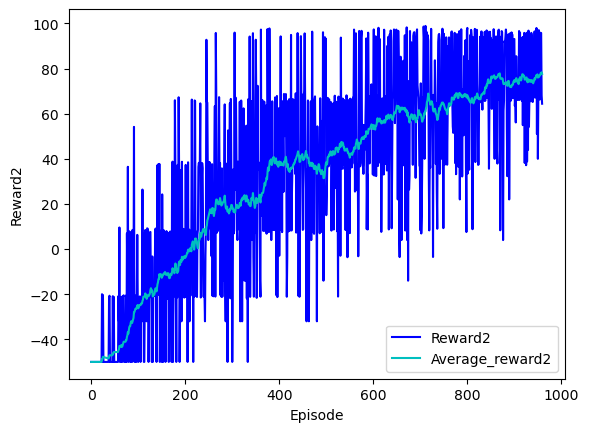

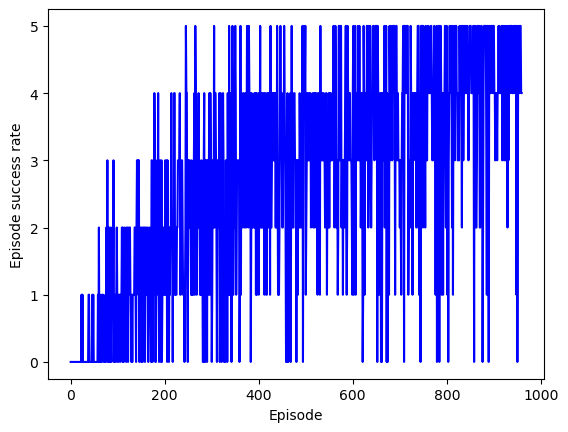

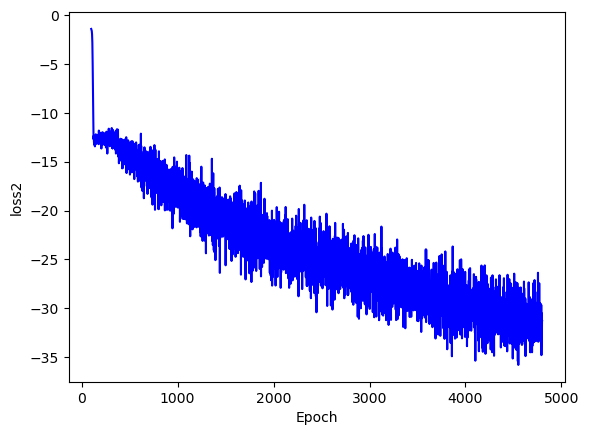

***** epoch 192 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78029.11335378958
r_em 58367.015384971935
58367.015384971935
ReWard2/R0 11.673403076994386
reward2 is: 19.673403076994386
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 9ms/step
***** frame 1 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78719.44568340913
r_em 58279.630600188066
58279.630600188066
ReWard2/R0 11.655926120037613
reward2 is: 19.655926120037613
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 2 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77507.24852809036
r_em 58388.805907652
58388.805907652
ReWard2/R0 11.6777611815304
reward2 is: 19.6777611815304
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 3 *****
1/1 [==============================] - 0s 43ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 76920.70843636591
r_em 57925.47287297259
57925.47287297259
ReWard2/R0 11.585094574594518
reward2 is: 19.585094574594518
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 4 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78046.65893372647
r_em 57955.66657594929
57955.66657594929
ReWard2/R0 11.591133315189857
reward2 is: 19.591133315189857
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 10ms/step
Epsilon_hist is: 0.09502754840988827
***** epoch 192 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84545.81536039656
r_em 58511.702429430574
58511.702429430574
ReWard2/R0 11.702340485886115
reward2 is: 19.702340485886115
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 6 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84599.4927194742
r_em 57368.03028676234
57368.03028676234
ReWard2/R0 11.473606057352468
reward2 is: 19.47360605735247
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 7 *****
1/1 [==============================] - 0s 40ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85935.28981615399
r_em 58276.04665460175
58276.04665460175
ReWard2/R0 11.65520933092035
reward2 is: 19.65520933092035
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 8 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85843.74077215977
r_em 58026.23147887316
58026.23147887316
ReWard2/R0 11.605246295774633
reward2 is: 19.605246295774634
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 9 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86147.56945086332
r_em 56888.1858792317
56888.1858792317
ReWard2/R0 11.37763717584634
reward2 is: 19.37763717584634
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.09479021698897987
***** epoch 192 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 42ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 96532.08746223443
r_em 56592.972833589185
56592.972833589185
ReWard2/R0 11.318594566717836
reward2 is: 19.318594566717834
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step
***** frame 11 *****
1/1 [==============================] - 0s 101ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 95738.41743287219
r_em 57258.00015643225
57258.00015643225
ReWard2/R0 11.45160003128645
reward2 is: 19.45160003128645
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step
***** frame 12 *****
1/1 [==============================] - 0s 40ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 16 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88269.53927481442
r_em 58092.68148659323
58092.68148659323
ReWard2/R0 11.618536297318647
reward2 is: 19.61853629731865
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 17 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 18 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89963.62681888221
r_em 57529.21315085289
57529.21315085289
ReWard2/R0 11.505842630170578
reward2 is: 19.505842630170577
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 19 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91127.48440483572
r_em 57419.581508834235
57419.581508834235
ReWard2/R0 11.483916301766847
reward2 is: 19.483916301766847
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.09431733087336629
***** epoch 192 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84928.01905298862
r_em 55408.923876474255
55408.923876474255
ReWard2/R0 11.081784775294851
reward2 is: 19.08178477529485
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 21 *****
1/1 [==============================] - 0s 42ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86273.00246155403
r_em 55635.61489428332
55635.61489428332
ReWard2/R0 11.127122978856663
reward2 is: 19.12712297885666
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 22 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88060.48033896531
r_em 55472.05648460589
55472.05648460589
ReWard2/R0 11.094411296921178
reward2 is: 19.09441129692118
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 23 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87090.04594395499
r_em 56175.90995853148
56175.90995853148
ReWard2/R0 11.235181991706297
reward2 is: 19.2351819917063
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 24 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88014.5281310132
r_em 55342.77294077227
55342.77294077227
ReWard2/R0 11.068554588154454
reward2 is: 19.068554588154456
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 13ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.09408177322164288


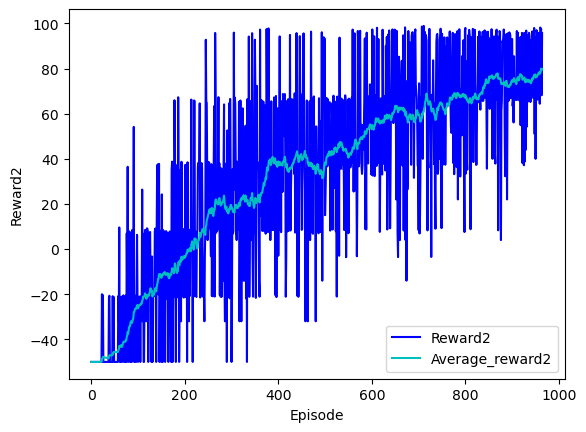

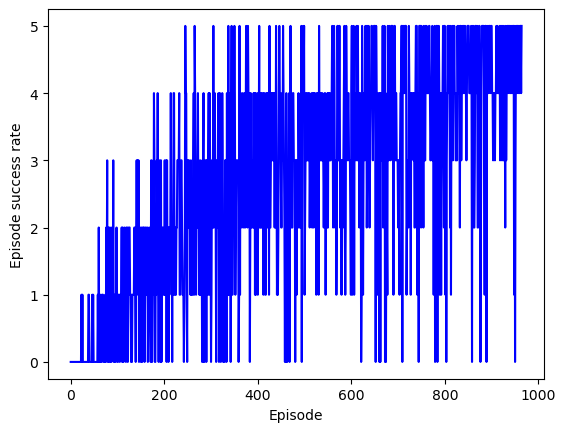

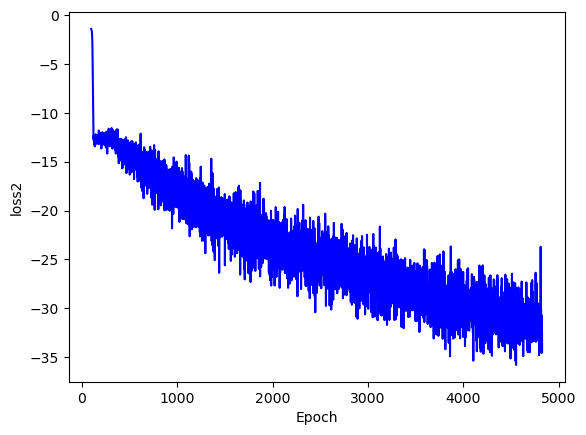

***** epoch 193 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85765.12515270917
r_em 54524.094184573594
54524.094184573594
ReWard2/R0 10.90481883691472
reward2 is: 18.90481883691472
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 1 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86458.28823391623
r_em 54980.649432229315
54980.649432229315
ReWard2/R0 10.996129886445862
reward2 is: 18.996129886445864
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 3 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86108.29538002779
r_em 54238.41640657338
54238.41640657338
ReWard2/R0 10.847683281314676
reward2 is: 18.847683281314676
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 4 *****
1/1 [==============================] - 0s 45ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85886.7524616752
r_em 54591.24247730152
54591.24247730152
ReWard2/R0 10.918248495460304
reward2 is: 18.918248495460304
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.09384680387544904
***** epoch 193 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 22ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 92332.56543033727
r_em 54355.34464517856
54355.34464517856
ReWard2/R0 10.871068929035712
reward2 is: 18.87106892903571
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step
***** frame 6 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 91523.07441816898
r_em 54409.845528298756
54409.845528298756
ReWard2/R0 10.881969105659751
reward2 is: 18.88196910565975
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step
***** frame 7 *****
1/1 [==============================] - 0s 31ms/step
we c

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 12 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84066.70565181084
r_em 58264.54570122562
58264.54570122562
ReWard2/R0 11.652909140245125
reward2 is: 19.652909140245125
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 13 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82645.77281097893
r_em 57828.75432748575
57828.75432748575
ReWard2/R0 11.56575086549715
reward2 is: 19.56575086549715
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 14 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81178.72923709053
r_em 57913.416856933654
57913.416856933654
ReWard2/R0 11.58268337138673
reward2 is: 19.58268337138673
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.09337862422614437
***** epoch 193 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94681.47528431717
r_em 54275.743543188044
54275.743543188044
ReWard2/R0 10.855148708637609
reward2 is: 18.855148708637607
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 16 *****
1/1 [==============================] - 0s 44ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93720.29142045065
r_em 53852.73063402938
53852.73063402938
ReWard2/R0 10.770546126805876
reward2 is: 18.770546126805876
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 17 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 18 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96799.13739298793
r_em 53927.36563606676
53927.36563606676
ReWard2/R0 10.785473127213352
reward2 is: 18.78547312721335
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 19 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 97296.09902573367
r_em 52907.23312622568
52907.23312622568
ReWard2/R0 10.581446625245135
reward2 is: 18.581446625245135
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.09314541099544553
***** epoch 193 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91014.57350833056
r_em 53267.425118583145
53267.425118583145
ReWard2/R0 10.653485023716629
reward2 is: 18.653485023716627
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 21 *****
1/1 [==============================] - 0s 39ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88651.64958299784
r_em 54052.69397607507
54052.69397607507
ReWard2/R0 10.810538795215013
reward2 is: 18.810538795215013
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 22 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88191.74455307244
r_em 54195.56914142653
54195.56914142653
ReWard2/R0 10.839113828285306
reward2 is: 18.839113828285306
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 23 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93858.46763703921
r_em 54435.508189787484
54435.508189787484
ReWard2/R0 10.887101637957496
reward2 is: 18.887101637957496
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 24 *****
1/1 [==============================] - 0s 40ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93282.40590911327
r_em 54489.214600348
54489.214600348
ReWard2/R0 10.8978429200696
reward2 is: 18.8978429200696
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.09291278021508176


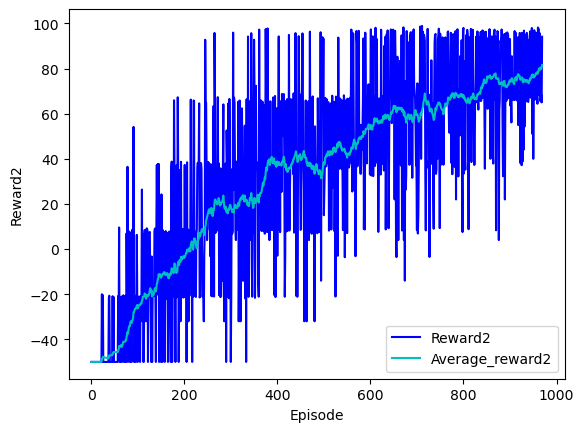

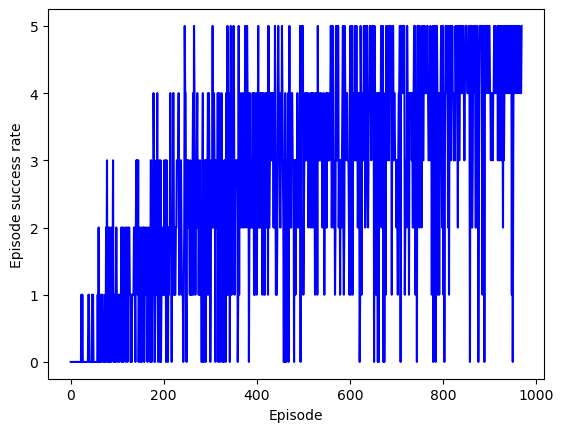

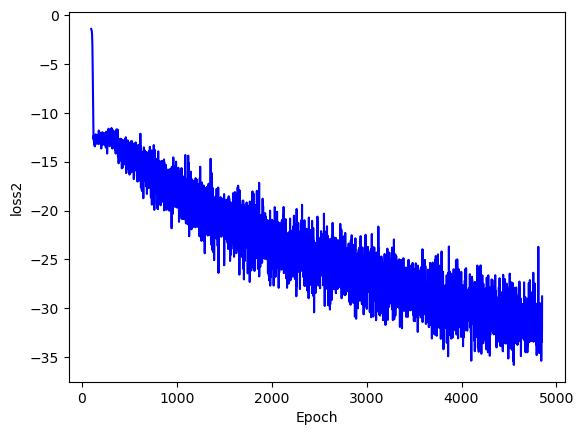

***** epoch 194 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 91891.32274571327
r_em 51437.290005134455
51437.290005134455
ReWard2/R0 10.287458001026891
reward2 is: 18.28745800102689
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step
***** frame 1 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 91797.9700655594
r_em 50870.7720871102
50870.7720871102
ReWard2/R0 10.17415441742204
reward2 is: 18.174154417422038
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step
***** frame 2 *****
1/1 [==============================] - 0s 45ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 91095.3409690726

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 6 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87090.67332045147
r_em 56777.67920593846
56777.67920593846
ReWard2/R0 11.355535841187692
reward2 is: 19.35553584118769
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 7 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87591.91640275212
r_em 56739.111218071346
56739.111218071346
ReWard2/R0 11.347822243614269
reward2 is: 19.347822243614267
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 8 *****
1/1 [==============================] - 0s 39ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83619.40273366141
r_em 55797.33387940254
55797.33387940254
ReWard2/R0 11.159466775880508
reward2 is: 19.15946677588051
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 9 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82991.85194312232
r_em 56160.00994571345
56160.00994571345
ReWard2/R0 11.23200198914269
reward2 is: 19.232001989142688
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.09244926019031086
***** epoch 194 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 39ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95462.43462666625
r_em 55814.84438521447
55814.84438521447
ReWard2/R0 11.162968877042895
reward2 is: 19.162968877042893
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 11 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 12 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96106.9480924658
r_em 55836.64487383933
55836.64487383933
ReWard2/R0 11.167328974767866
reward2 is: 19.167328974767866
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 13 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96677.15913726136
r_em 56209.63246155832
56209.63246155832
ReWard2/R0 11.241926492311665
reward2 is: 19.241926492311663
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 14 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 97607.22633402259
r_em 55855.058317498784
55855.058317498784
ReWard2/R0 11.171011663499756
reward2 is: 19.171011663499755
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.09221836804745288
***** epoch 194 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91946.62914832543
r_em 52196.473271061615
52196.473271061615
ReWard2/R0 10.439294654212324
reward2 is: 18.439294654212325
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 16 *****
1/1 [==============================] - 0s 39ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92493.00112221173
r_em 53329.23132702221
53329.23132702221
ReWard2/R0 10.665846265404442
reward2 is: 18.66584626540444
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 17 *****
1/1 [==============================] - 0s 40ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94475.44950818304
r_em 52577.520800534236
52577.520800534236
ReWard2/R0 10.515504160106847
reward2 is: 18.515504160106847
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 18 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94615.45581358552
r_em 50985.06248024202
50985.06248024202
ReWard2/R0 10.197012496048405
reward2 is: 18.197012496048405
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 19 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91560.85174512041
r_em 51322.577642008175
51322.577642008175
ReWard2/R0 10.264515528401635
reward2 is: 18.264515528401635
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.09198805255801025
***** epoch 194 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 94182.26481955386
r_em 54339.26207087301
54339.26207087301
ReWard2/R0 10.867852414174601
reward2 is: 18.8678524141746
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step
***** frame 21 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 94543.36591754702
r_em 55406.70546841435
55406.70546841435
ReWard2/R0 11.08134109368287
reward2 is: 19.08134109368287
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step
***** frame 22 *****
1/1 [==============================] - 0s 40ms/step
we ch

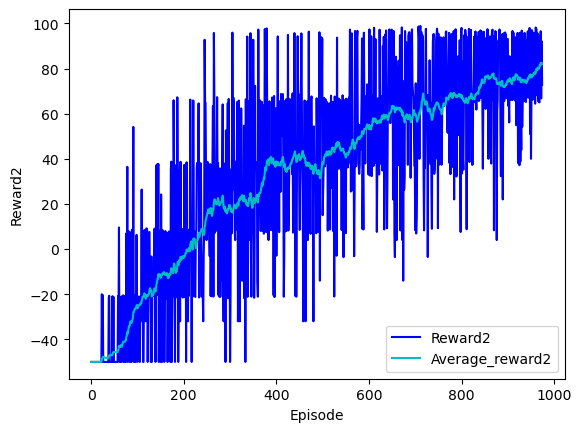

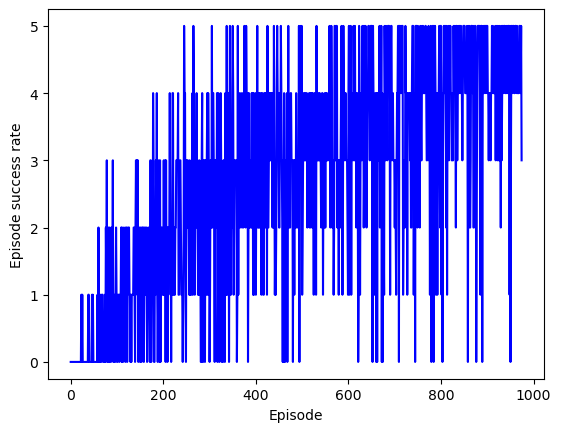

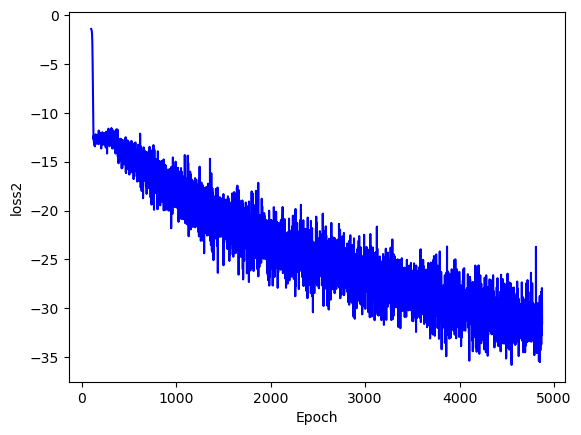

***** epoch 195 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83516.64188744017
r_em 55072.124120347966
55072.124120347966
ReWard2/R0 11.014424824069593
reward2 is: 19.014424824069593
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 1 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83942.69335506624
r_em 53892.27727025506
53892.27727025506
ReWard2/R0 10.778455454051011
reward2 is: 18.778455454051013
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 2 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84799.0949228908
r_em 53377.87770713032
53377.87770713032
ReWard2/R0 10.675575541426063
reward2 is: 18.675575541426063
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 3 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85792.97428114797
r_em 53179.97623462351
53179.97623462351
ReWard2/R0 10.635995246924702
reward2 is: 18.6359952469247
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 4 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85752.22953623938
r_em 54652.06004412535
54652.06004412535
ReWard2/R0 10.93041200882507
reward2 is: 18.93041200882507
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.09152914578219735
***** epoch 195 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77779.78490905065
r_em 54597.05976576695
54597.05976576695
ReWard2/R0 10.91941195315339
reward2 is: 18.91941195315339
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 6 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 74280.30916171386
r_em 55505.70134380226
55505.70134380226
ReWard2/R0 11.101140268760453
reward2 is: 19.101140268760453
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 7 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 72840.61551699894
r_em 55546.56067637917
55546.56067637917
ReWard2/R0 11.109312135275834
reward2 is: 19.109312135275836
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 8 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 9 *****
1/1 [==============================] - 0s 39ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80645.14460393
r_em 55132.027279326256
55132.027279326256
ReWard2/R0 11.026405455865252
reward2 is: 19.026405455865252
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.09130055162622351
***** epoch 195 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81499.87963417891
r_em 50570.97284694632
50570.97284694632
ReWard2/R0 10.114194569389264
reward2 is: 18.114194569389262
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 11 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81642.23225273496
r_em 49150.95786260195
49150.95786260195
ReWard2/R0 9.83019157252039
reward2 is: 17.83019157252039
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 12 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80776.62683926705
r_em 51925.80810240229
51925.80810240229
ReWard2/R0 10.385161620480458
reward2 is: 18.38516162048046
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 13 *****
1/1 [==============================] - 0s 39ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82346.47533230174
r_em 52285.08697871565
52285.08697871565
ReWard2/R0 10.45701739574313
reward2 is: 18.45701739574313
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 14 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93745.08969251075
r_em 53188.78226271252
53188.78226271252
ReWard2/R0 10.637756452542504
reward2 is: 18.637756452542504
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.0910725283844399
***** epoch 195 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83079.3461282544
r_em 56665.29092355205
56665.29092355205
ReWard2/R0 11.33305818471041
reward2 is: 19.33305818471041
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 16 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81721.92240764466
r_em 56009.07345417996
56009.07345417996
ReWard2/R0 11.201814690835992
reward2 is: 19.20181469083599
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 17 *****
1/1 [==============================] - 0s 40ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81356.11667897727
r_em 55585.11025446971
55585.11025446971
ReWard2/R0 11.117022050893942
reward2 is: 19.117022050893944
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 18 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81223.87939259072
r_em 55346.01906354725
55346.01906354725
ReWard2/R0 11.06920381270945
reward2 is: 19.06920381270945
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 19 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81795.61482301175
r_em 55588.61812033839
55588.61812033839
ReWard2/R0 11.117723624067677
reward2 is: 19.11772362406768
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.09084507463098758
***** epoch 195 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93530.57588851672
r_em 56409.0996098516
56409.0996098516
ReWard2/R0 11.28181992197032
reward2 is: 19.281819921970317
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 21 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93473.71414121671
r_em 55971.24071180506
55971.24071180506
ReWard2/R0 11.194248142361012
reward2 is: 19.194248142361012
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 22 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95244.87882334032
r_em 56108.95915522936
56108.95915522936
ReWard2/R0 11.221791831045872
reward2 is: 19.22179183104587
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 23 *****
1/1 [==============================] - 0s 40ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93469.4099010551
r_em 56732.72592221431
56732.72592221431
ReWard2/R0 11.346545184442862
reward2 is: 19.34654518444286
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 24 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94933.49184252553
r_em 56810.61665049644
56810.61665049644
ReWard2/R0 11.362123330099289
reward2 is: 19.362123330099287
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.09061818894356875


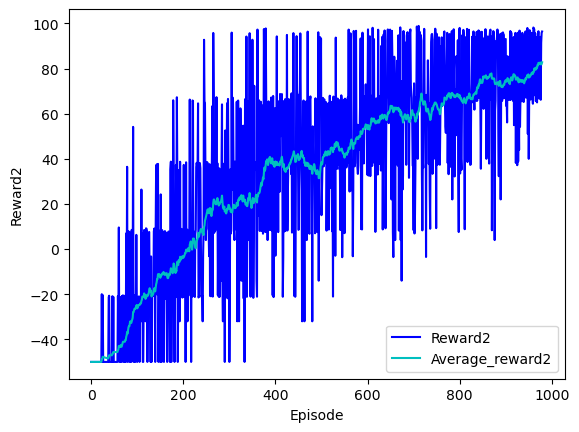

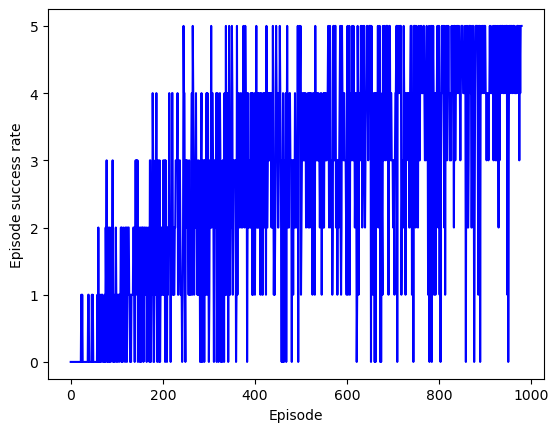

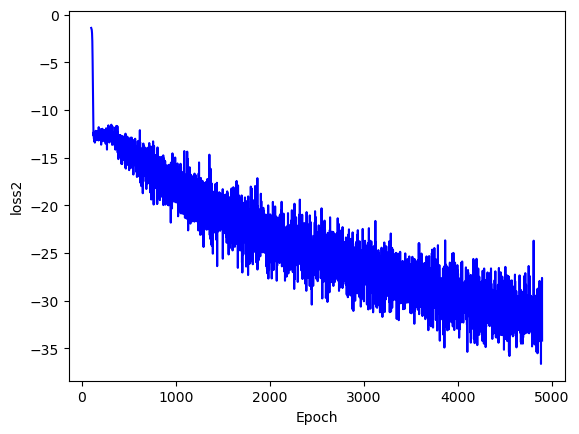

***** epoch 196 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 93882.81765576228
r_em 55613.112740576275
55613.112740576275
ReWard2/R0 11.122622548115254
reward2 is: 19.122622548115253
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step
***** frame 1 *****
1/1 [==============================] - 0s 43ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 93240.83055588609
r_em 53981.8613074271
53981.8613074271
ReWard2/R0 10.79637226148542
reward2 is: 18.79637226148542
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step
***** frame 2 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 9275

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 3 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 94585.14563541686
r_em 52879.01393754062
52879.01393754062
ReWard2/R0 10.575802787508124
reward2 is: 18.575802787508124
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step
***** frame 4 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93800.74885421112
r_em 52389.309504156256
52389.309504156256
ReWard2/R0 10.47786190083125
reward2 is: 18.47786190083125
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 9ms/step
Epsilon_hist is: 0.09039186990343778
***** epoch 196 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 41ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80089.68791762227
r_em 53014.295447012664
53014.295447012664
ReWard2/R0 10.602859089402532
reward2 is: 18.602859089402532
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 6 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81165.40939050546
r_em 53562.26715195181
53562.26715195181
ReWard2/R0 10.712453430390362
reward2 is: 18.71245343039036
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 7 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81734.21150458863
r_em 54052.768092646416
54052.768092646416
ReWard2/R0 10.810553618529283
reward2 is: 18.810553618529283
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 8 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80006.90247017688
r_em 53993.079956500835
53993.079956500835
ReWard2/R0 10.798615991300167
reward2 is: 18.798615991300167
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 9 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.09016611609539238
***** epoch 196 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 11 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 12 *****
1/1 [================

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 16 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91271.36608734998
r_em 55534.79720639927
55534.79720639927
ReWard2/R0 11.106959441279853
reward2 is: 19.106959441279855
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 17 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90932.87883030233
r_em 54840.655854078424
54840.655854078424
ReWard2/R0 10.968131170815685
reward2 is: 18.968131170815685
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 18 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88087.43422837576
r_em 53922.094384088785
53922.094384088785
ReWard2/R0 10.784418876817757
reward2 is: 18.784418876817757
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 19 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.08971629853241253
***** epoch 196 episode 4 *****
***** frame 20 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 21 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95041.12366248688
r_em 56684.781344258
56684.781344258
ReWard2/R0 11.3369562688516
reward2 is: 19.3369562688516
total number of ur2 RBs: 8.0
total numbe

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 22 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94499.93633252173
r_em 55960.8767036919
55960.8767036919
ReWard2/R0 11.19217534073838
reward2 is: 19.19217534073838
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 23 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93574.5868899792
r_em 55982.6745883764
55982.6745883764
ReWard2/R0 11.19653491767528
reward2 is: 19.19653491767528
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 24 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92064.7829534564
r_em 55732.18226419731
55732.18226419731
ReWard2/R0 11.146436452839463
reward2 is: 19.146436452839463
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.08949223196471051


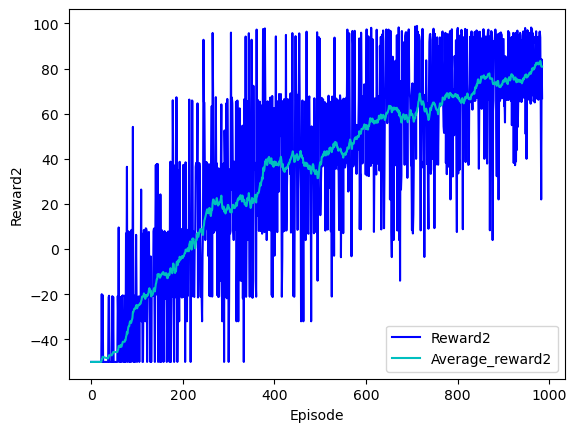

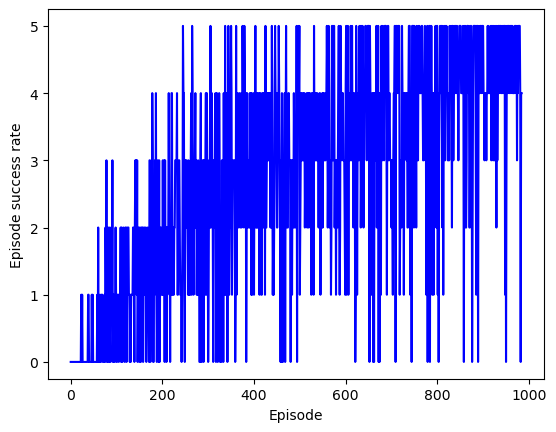

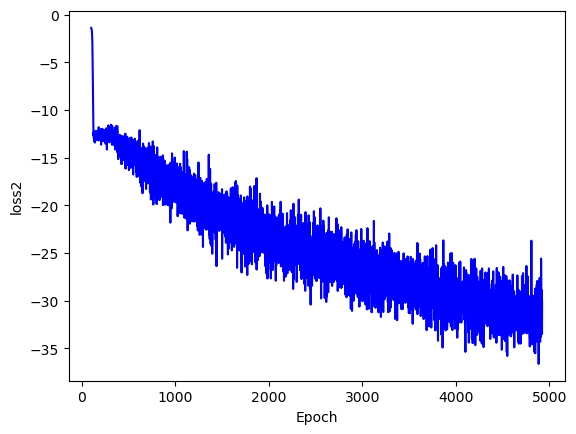

***** epoch 197 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88132.69145068662
r_em 53915.681407774115
53915.681407774115
ReWard2/R0 10.783136281554823
reward2 is: 18.783136281554825
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 1 *****
1/1 [==============================] - 0s 40ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88077.76565437418
r_em 53675.42367443434
53675.42367443434
ReWard2/R0 10.735084734886868
reward2 is: 18.73508473488687
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 3 *****
1/1 [==============================] - 0s 47ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89224.1038298021
r_em 52426.81876048571
52426.81876048571
ReWard2/R0 10.485363752097141
reward2 is: 18.485363752097143
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 4 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89057.02298876352
r_em 51127.664431051504
51127.664431051504
ReWard2/R0 10.225532886210301
reward2 is: 18.225532886210303
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.08926872500354135
***** epoch 197 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 6 *****
1/1 [==============================] - 0s 47ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 7 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
****

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 12 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88175.90789669486
r_em 52627.648588801254
52627.648588801254
ReWard2/R0 10.52552971776025
reward2 is: 18.52552971776025
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 13 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86711.94454365056
r_em 52031.41542611766
52031.41542611766
ReWard2/R0 10.406283085223532
reward2 is: 18.40628308522353
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 14 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.08882338431382006
***** epoch 197 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 83933.72426860115
r_em 53859.3060672579
53859.3060672579
ReWard2/R0 10.77186121345158
reward2 is: 18.77186121345158
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step
***** frame 16 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs:

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.08860154780049484
***** epoch 197 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86511.01975221552
r_em 52674.43697058992
52674.43697058992
ReWard2/R0 10.534887394117984
reward2 is: 18.534887394117984
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 21 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84846.25072071816
r_em 53012.05275109474
53012.05275109474
ReWard2/R0 10.602410550218949
reward2 is: 18.60241055021895
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 13ms/step
***** frame 22 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84211.47466058654
r_em 52922.970162468184
52922.970162468184
ReWard2/R0 10.584594032493637
reward2 is: 18.584594032493637
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 23 *****
1/1 [==============================] - 0s 40ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 83959.82371938083
r_em 52926.13325557686
52926.13325557686
ReWard2/R0 10.585226651115372
reward2 is: 18.58522665111537
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step
***** frame 24 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85094.28302726366
r_em 54406.60951395519
54406.60951395519
ReWard2/R0 10.881321902791038
reward2 is: 18.881321902791036
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.08838026532413888


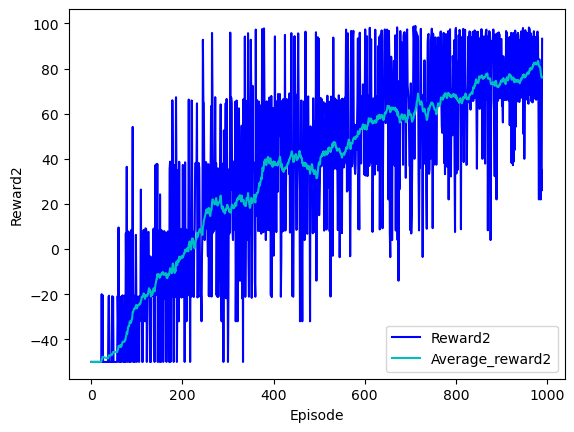

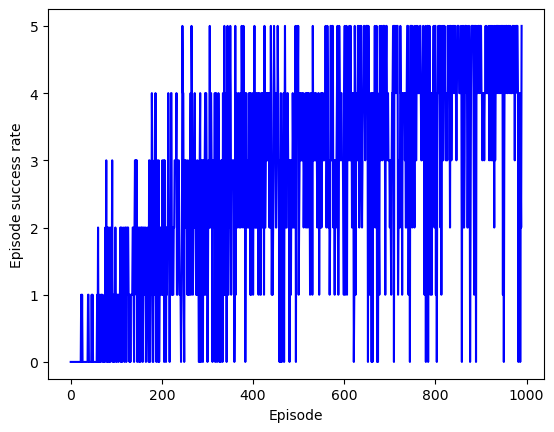

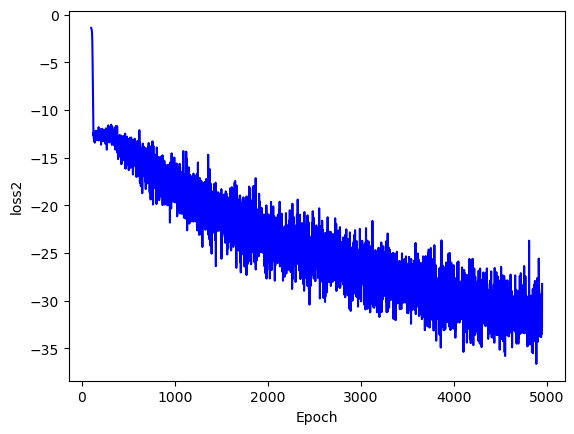

***** epoch 198 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81836.79318943895
r_em 56835.92469987438
56835.92469987438
ReWard2/R0 11.367184939974875
reward2 is: 19.367184939974877
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 1 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83401.17091965335
r_em 57396.68288143629
57396.68288143629
ReWard2/R0 11.479336576287258
reward2 is: 19.47933657628726
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 2 *****
1/1 [==============================] - 0s 42ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82794.07277500522
r_em 57011.22023343596
57011.22023343596
ReWard2/R0 11.402244046687192
reward2 is: 19.402244046687194
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 3 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 4 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83295.26738808469
r_em 57519.129910661395
57519.129910661395
ReWard2/R0 11.503825982132279
reward2 is: 19.503825982132277
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.08815953550104416
***** epoch 198 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87921.36355747352
r_em 50089.04614260213
50089.04614260213
ReWard2/R0 10.017809228520425
reward2 is: 18.017809228520427
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 6 *****
1/1 [==============================] - 0s 44ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83401.35413314922
r_em 52765.28464685151
52765.28464685151
ReWard2/R0 10.553056929370303
reward2 is: 18.553056929370303
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 7 *****
1/1 [==============================] - 0s 39ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91257.19411904822
r_em 52382.14911914457
52382.14911914457
ReWard2/R0 10.476429823828914
reward2 is: 18.476429823828916
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 8 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 9 *****
1/1 [==============================] - 0s 40ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90889.73472812277
r_em 53658.52136309468
53658.52136309468
ReWard2/R0 10.731704272618936
reward2 is: 18.731704272618934
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 10ms/step
Epsilon_hist is: 0.08793935695095845
***** epoch 198 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86427.72120236684
r_em 56446.408673206664
56446.408673206664
ReWard2/R0 11.289281734641333
reward2 is: 19.289281734641335
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 9ms/step
***** frame 11 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84372.98533749266
r_em 55849.09702131873
55849.09702131873
ReWard2/R0 11.169819404263746
reward2 is: 19.169819404263748
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 12 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86815.0021052598
r_em 55999.38993410332
55999.38993410332
ReWard2/R0 11.199877986820663
reward2 is: 19.199877986820663
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 13 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 14 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92099.81275094743
r_em 56772.70020442366
56772.70020442366
ReWard2/R0 11.354540040884732
reward2 is: 19.354540040884732
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.08771972829707674
***** epoch 198 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 100769.27993600235
r_em 57173.402428436646
57173.402428436646
ReWard2/R0 11.434680485687329
reward2 is: 19.43468048568733
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step
***** frame 16 *****
1/1 [==============================] - 0s 39ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 97727.6976025788
r_em 56582.18716612221
56582.18716612221
ReWard2/R0 11.316437433224442
reward2 is: 19.316437433224444
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 17 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 18 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 97799.82296331268
r_em 56814.09478250772
56814.09478250772
ReWard2/R0 11.362818956501544
reward2 is: 19.362818956501542
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 19 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 97514.82076589906
r_em 56743.652276937304
56743.652276937304
ReWard2/R0 11.34873045538746
reward2 is: 19.34873045538746
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.08750064816603256
***** epoch 198 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87980.5332211536
r_em 60001.73415880471
60001.73415880471
ReWard2/R0 12.000346831760943
reward2 is: 20.000346831760943
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 21 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87604.1784016049
r_em 59788.170345078055
59788.170345078055
ReWard2/R0 11.957634069015612
reward2 is: 19.95763406901561
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 22 *****
1/1 [==============================] - 0s 46ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87946.40617606431
r_em 59559.47823539721
59559.47823539721
ReWard2/R0 11.911895647079442
reward2 is: 19.91189564707944
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 23 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 24 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 88766.53958365197
r_em 59197.82222361436
59197.82222361436
ReWard2/R0 11.839564444722873
reward2 is: 19.839564444722875
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.08728211518788946


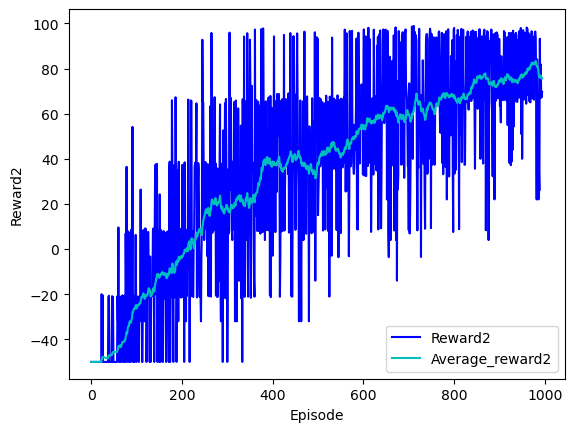

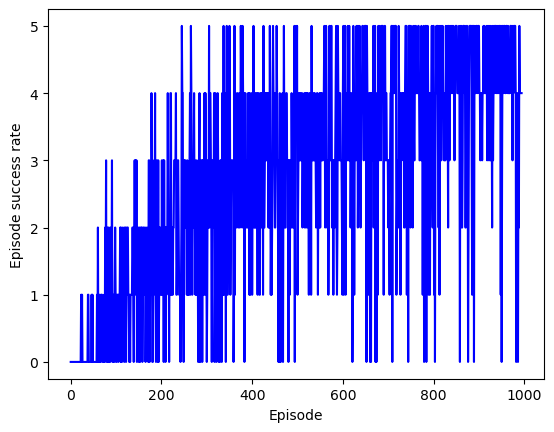

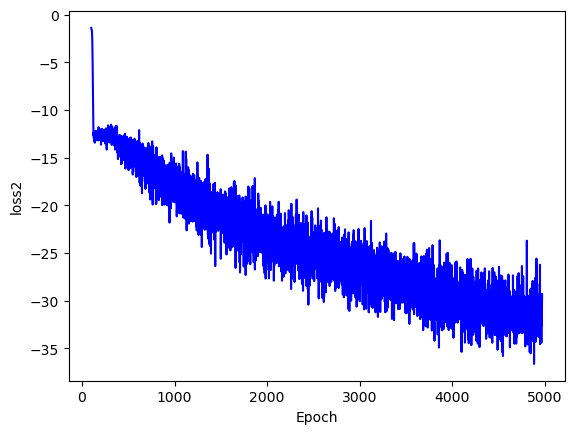

***** epoch 199 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91150.27406679772
r_em 55129.79171965716
55129.79171965716
ReWard2/R0 11.025958343931432
reward2 is: 19.025958343931432
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 1 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 2 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 3 *****
1/1 [==============================] - 0s 42ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92653.39279267193
r_em 54442.42468642765
54442.42468642765
ReWard2/R0 10.88848493728553
reward2 is: 18.88848493728553
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 4 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92165.41148207715
r_em 53720.26917039315
53720.26917039315
ReWard2/R0 10.74405383407863
reward2 is: 18.744053834078628
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.08706412799613236
***** epoch 199 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80249.70067007266
r_em 50499.2612356883
50499.2612356883
ReWard2/R0 10.09985224713766
reward2 is: 18.09985224713766
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 6 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81982.35036566452
r_em 51888.90837064698
51888.90837064698
ReWard2/R0 10.377781674129396
reward2 is: 18.377781674129395
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 7 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81190.82970400622
r_em 51756.80432202288
51756.80432202288
ReWard2/R0 10.351360864404576
reward2 is: 18.351360864404576
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 8 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 9 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 93193.19696752168
r_em 52700.55446038366
52700.55446038366
ReWard2/R0 10.540110892076733
reward2 is: 18.540110892076733
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.0868466852276591
***** epoch 199 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87066.46412720988
r_em 53791.291235098004
5

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 11 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86833.81827921228
r_em 53225.396419253135
53225.396419253135
ReWard2/R0 10.645079283850627
reward2 is: 18.645079283850627
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 12 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86066.14551229487
r_em 53049.40658420836
53049.40658420836
ReWard2/R0 10.60988131684167
reward2 is: 18.609881316841673
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 13 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86350.56952716468
r_em 53043.39210160236
53043.39210160236
ReWard2/R0 10.608678420320471
reward2 is: 18.608678420320473
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 14 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85761.06853492798
r_em 53276.124246187406
53276.124246187406
ReWard2/R0 10.65522484923748
reward2 is: 18.65522484923748
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.08662978552277184
***** epoch 199 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78756.44211316755
r_em 56292.72521519395
56292.72521519395
ReWard2/R0 11.25854504303879
reward2 is: 19.25854504303879
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 17 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78780.47201918154
r_em 55802.56928871407
55802.56928871407
ReWard2/R0 11.160513857742814
reward2 is: 19.160513857742814
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 18 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78970.47793773198
r_em 57163.92278987443
57163.92278987443
ReWard2/R0 11.432784557974886
reward2 is: 19.432784557974884
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 19 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.08641342752516859
***** epoch 199 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 40ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 83011.9746879167
r_em 55901.59236246233
55901.59236246233
ReWard2/R0 11.180318472492466
reward2 is: 19.180318472492466
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step
***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number o

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 24 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80123.70001155282
r_em 56503.275885825635
56503.275885825635
ReWard2/R0 11.300655177165128
reward2 is: 19.300655177165126
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.08619760988193471


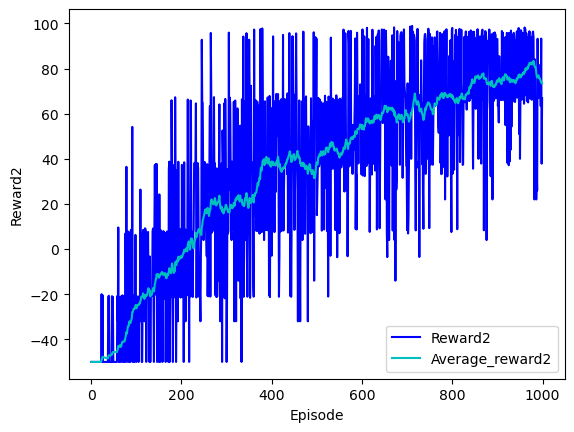

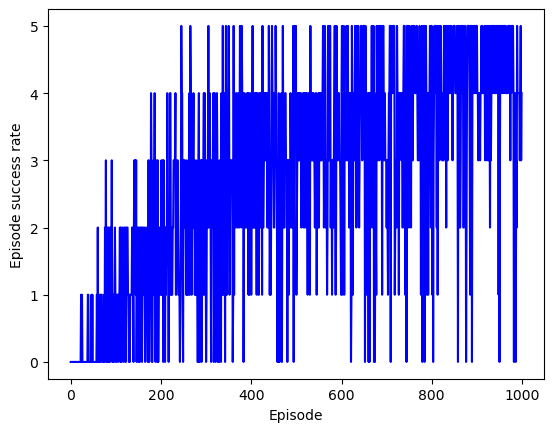

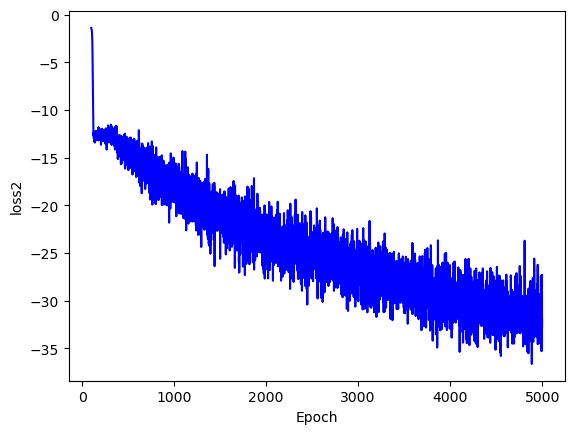

***** epoch 200 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 46ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93402.09319715327
r_em 55979.316345131476
55979.316345131476
ReWard2/R0 11.195863269026296
reward2 is: 19.195863269026297
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 2 *****
1/1 [==============================] - 0s 43ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93128.54221086226
r_em 55516.47053159723
55516.47053159723
ReWard2/R0 11.103294106319446
reward2 is: 19.103294106319446
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 3 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92571.74834263953
r_em 55386.73291946916
55386.73291946916
ReWard2/R0 11.077346583893833
reward2 is: 19.077346583893835
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 4 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92520.27219765406
r_em 54949.9145758745
54949.9145758745
ReWard2/R0 10.9899829151749
reward2 is: 18.9899829151749
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.08598233124353452
***** epoch 200 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 6 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81796.64843829183
r_em 54018.29179117318
54018.29179117318
ReWard2/R0 10.803658358234635
reward2 is: 18.803658358234635
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 7 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 8 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81421.1940158132
r_em 54359.348014893316
54359.348014893316
ReWard2/R0 10.871869602978663
reward2 is: 18.871869602978663
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 9 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81587.49203185871
r_em 54374.14750392484
54374.14750392484
ReWard2/R0 10.874829500784967
reward2 is: 18.87482950078497
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.08576759026380278
***** epoch 200 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80168.87791815691
r_em 56863.18386902482
56863.18386902482
ReWard2/R0 11.372636773804963
reward2 is: 19.372636773804963
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 11 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80705.92991229522
r_em 57200.84019120532
57200.84019120532
ReWard2/R0 11.440168038241065
reward2 is: 19.440168038241065
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 12 *****
1/1 [==============================] - 0s 42ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80576.6470719712
r_em 57477.2143744135
57477.2143744135
ReWard2/R0 11.4954428748827
reward2 is: 19.4954428748827
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 13 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80851.69041878649
r_em 57294.12195968814
57294.12195968814
ReWard2/R0 11.458824391937629
reward2 is: 19.45882439193763
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 14 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80246.14543559581
r_em 57496.9383153593
57496.9383153593
ReWard2/R0 11.499387663071861
reward2 is: 19.49938766307186
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.08555338559993626
***** epoch 200 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 16 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 17 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
*

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.08533971591248544
***** epoch 200 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 75133.65541565091
r_em 53263.96904318615
53263.96904318615
ReWard2/R0 10.652793808637231
reward2 is: 18.65279380863723
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 21 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 74814.53764273586
r_em 53516.89576015517
53516.89576015517
ReWard2/R0 10.703379152031033
reward2 is: 18.703379152031033
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 22 *****
1/1 [==============================] - 0s 40ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 74240.90648960706
r_em 53466.86198752337
53466.86198752337
ReWard2/R0 10.693372397504675
reward2 is: 18.693372397504675
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 23 *****
1/1 [==============================] - 0s 46ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 74345.14117429714
r_em 54063.70962744998
54063.70962744998
ReWard2/R0 10.812741925489995
reward2 is: 18.812741925489995
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 24 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 74172.56037269166
r_em 54495.41675616385
54495.41675616385
ReWard2/R0 10.89908335123277
reward2 is: 18.89908335123277
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.08512657986534605


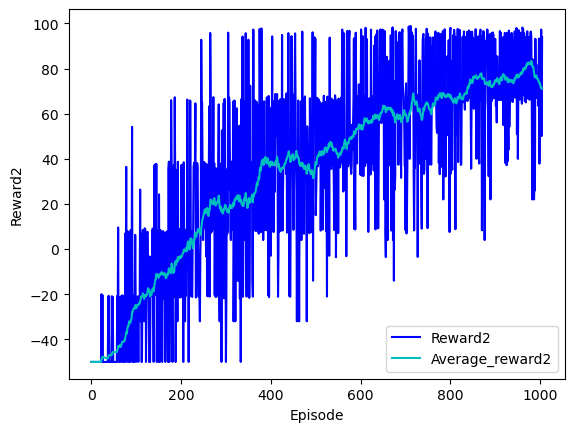

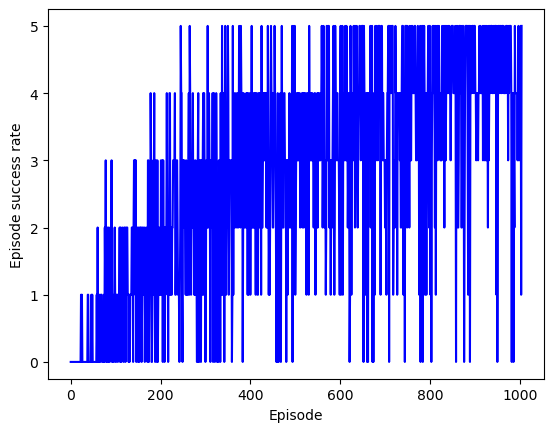

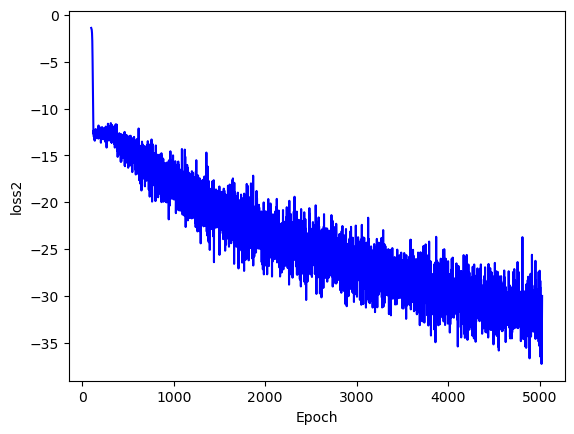

***** epoch 201 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 88904.28626529672
r_em 50116.64656661054
50116.64656661054
ReWard2/R0 10.023329313322108
reward2 is: 18.023329313322108
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step
***** frame 1 *****
1/1 [==============================] - 0s 45ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 91811.15032671287
r_em 55131.727306545064
55131.727306545064
ReWard2/R0 11.026345461309013
reward2 is: 19.026345461309013
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 6 *****
1/1 [==============================] - 0s 40ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92984.45906047848
r_em 53807.229499750814
53807.229499750814
ReWard2/R0 10.761445899950163
reward2 is: 18.76144589995016
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 7 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94283.64635035193
r_em 51911.06201241892
51911.06201241892
ReWard2/R0 10.382212402483784
reward2 is: 18.382212402483784
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 8 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93668.94875234153
r_em 50488.46813446172
50488.46813446172
ReWard2/R0 10.097693626892344
reward2 is: 18.097693626892344
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 9 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93701.39658551401
r_em 52527.231114885355
52527.231114885355
ReWard2/R0 10.50544622297707
reward2 is: 18.50544622297707
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.08470190336426077
***** epoch 201 episode 2 *****
***** frame 10 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 11 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82348.05797912527
r_em 52826.831066366205
52826.831066366205
ReWard2/R0 10.565366213273242
reward2 is: 18.565366213273244
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 12 *****
1/1 [==============================] - 0s 43ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91562.006090426
r_em 52131.20557262446
52131.20557262446
ReWard2/R0 10.426241114524892
reward2 is: 18.426241114524892
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 13 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90233.43841107798
r_em 51511.48250484559
51511.48250484559
ReWard2/R0 10.302296500969119
reward2 is: 18.30229650096912
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 14 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 93106.36080277078
r_em 52414.39184328938
52414.39184328938
ReWard2/R0 10.482878368657875
reward2 is: 18.482878368657875
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 4ms/step
Epsilon_hist is: 0.08449036025475762
***** epoch 201 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 92723.36113934642
r_em 54620.158045833276
54620.158045833276
ReWard2/R0 10.924031609166654
reward2 is: 18.924031609166654
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step
***** frame 16 *****
1/1 [==============================] - 0s 35ms/step

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 18 *****
1/1 [==============================] - 0s 41ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 19 *****
1/1 [==============================] - 0s 39ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95033.41324218214
r_em 54735.685465633615
54735.685465633615
ReWard2/R0 10.947137093126724
reward2 is: 18.947137093126724
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.08427934547443484
***** epoch 201 episode 4 *****
***** frame 20 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 21 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 92063.26287515729
r_em 53531.29221987272
53531.29221987272
ReWard2/R0 10.706258443974544
reward2 is: 18.706258443974544
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step
***** frame 22 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 89810.5722693511
r_em 52621.134945048994
52621.134945

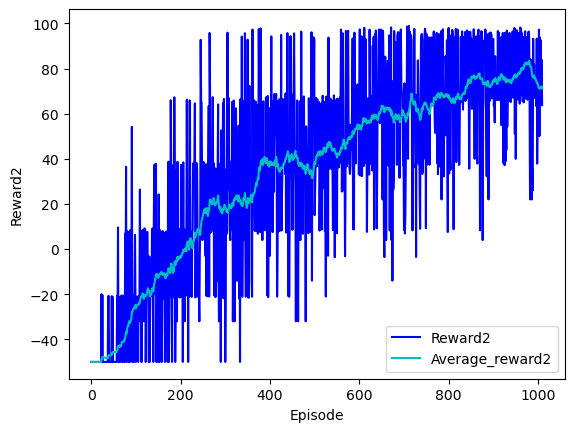

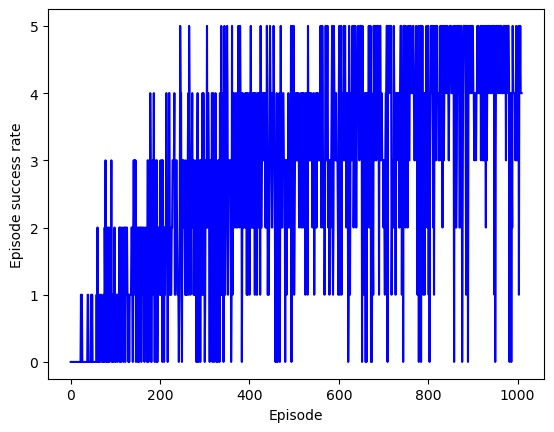

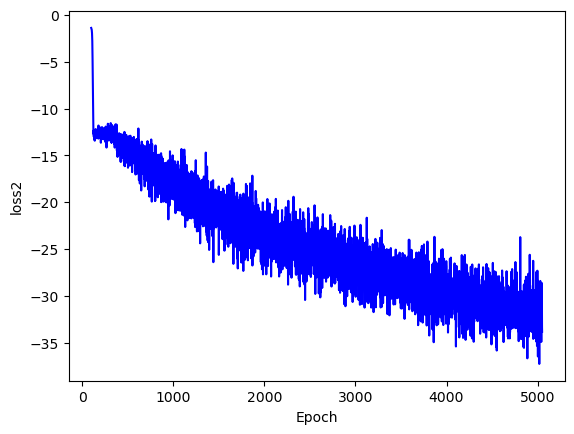

***** epoch 202 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82374.665255593
r_em 56751.18799431434
56751.18799431434
ReWard2/R0 11.350237598862869
reward2 is: 19.35023759886287
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 1 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83108.17256058537
r_em 57029.758638180414
57029.758638180414
ReWard2/R0 11.405951727636083
reward2 is: 19.405951727636083
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 2 *****
1/1 [==============================] - 0s 43ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79503.63285022139
r_em 56905.136256337355
56905.136256337355
ReWard2/R0 11.38102725126747
reward2 is: 19.38102725126747
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 3 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78531.8864309419
r_em 56558.07675137342
56558.07675137342
ReWard2/R0 11.311615350274684
reward2 is: 19.311615350274685
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 4 *****
1/1 [==============================] - 0s 39ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77966.08863595186
r_em 56768.78888984766
56768.78888984766
ReWard2/R0 11.353757777969532
reward2 is: 19.353757777969534
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.08385889562661462
***** epoch 202 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82858.2544763181
r_em 53674.46754980331
53674.46754980331
ReWard2/R0 10.734893509960662
reward2 is: 18.734893509960663
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 6 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 4ms/step
***** frame 7 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78072.3150160271
r_em 53916.71083735451
53916.71083735451
ReWard2/R0 10.783342167470902
reward2 is: 18.783342167470902
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 8 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81084.15737674944
r_em 54568.49295052706
54568.49295052706
ReWard2/R0 10.913698590105412
reward2 is: 18.91369859010541
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 9 *****
1/1 [==============================] - 0s 39ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 75289.99927036105
r_em 53480.81961548864
53480.81961548864
ReWard2/R0 10.696163923097728
reward2 is: 18.69616392309773
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.08364945792998978
***** epoch 202 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84221.82082377444
r_em 54495.06779056469
54495.06779056469
ReWard2/R0 10.899013558112937
reward2 is: 18.899013558112937
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 11 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83780.23782262849
r_em 55553.96405244919
55553.96405244919
ReWard2/R0 11.110792810489839
reward2 is: 19.11079281048984
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 12 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83612.86962319158
r_em 55141.559778105955
55141.559778105955
ReWard2/R0 11.028311955621191
reward2 is: 19.02831195562119
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 13 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85526.87479868818
r_em 53479.92089535338
53479.92089535338
ReWard2/R0 10.695984179070676
reward2 is: 18.695984179070678
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 14 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84880.64762701519
r_em 54169.47817332781
54169.47817332781
ReWard2/R0 10.833895634665561
reward2 is: 18.83389563466556
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.08344054330427397
***** epoch 202 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89949.55808954194
r_em 57821.98132472498
57821.98132472498
ReWard2/R0 11.564396264944996
reward2 is: 19.564396264944996
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 16 *****
1/1 [==============================] - 0s 49ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85925.84981874126
r_em 54831.595460768134
54831.595460768134
ReWard2/R0 10.966319092153627
reward2 is: 18.966319092153626
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 17 *****
1/1 [==============================] - 0s 45ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86210.71371324488
r_em 55272.38761663927
55272.38761663927
ReWard2/R0 11.054477523327854
reward2 is: 19.054477523327854
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 18 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86051.0426562959
r_em 55120.81117703851
55120.81117703851
ReWard2/R0 11.024162235407701
reward2 is: 19.0241622354077
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 19 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84815.35630521602
r_em 54735.22489308316
54735.22489308316
ReWard2/R0 10.947044978616633
reward2 is: 18.94704497861663
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.08323215044309698
***** epoch 202 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 42ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85173.69984562503
r_em 57102.3747170516
57102.3747170516
ReWard2/R0 11.42047494341032
reward2 is: 19.42047494341032
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 21 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84115.76403453905
r_em 57597.316632554364
57597.316632554364
ReWard2/R0 11.519463326510873
reward2 is: 19.519463326510873
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 22 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 91703.64568258099
r_em 57728.05522401114
57728.05522401114
ReWard2/R0 11.545611044802229
reward2 is: 19.54561104480223
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step
***** frame 23 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 93378.86358684041
r_em 57488.8451852299
57488.8451852299
ReWard2/R0 11.497769037045979
reward2 is: 19.497769037045977
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step
***** frame 24 *****
1/1 [==============================] - 0s 47ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.08302427804335118


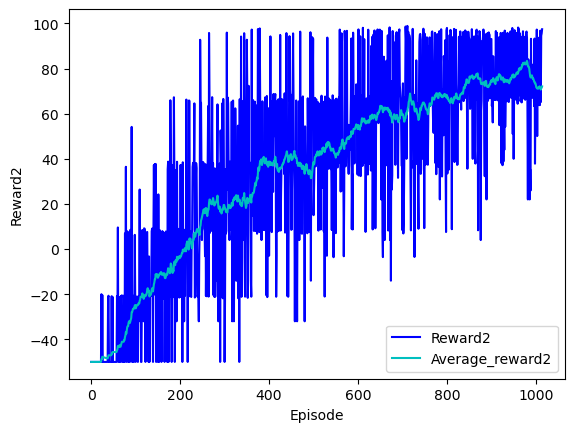

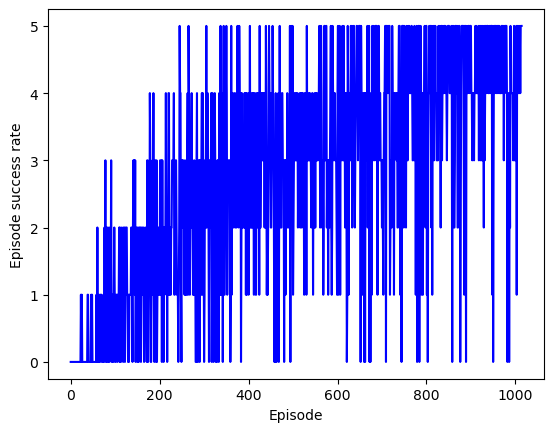

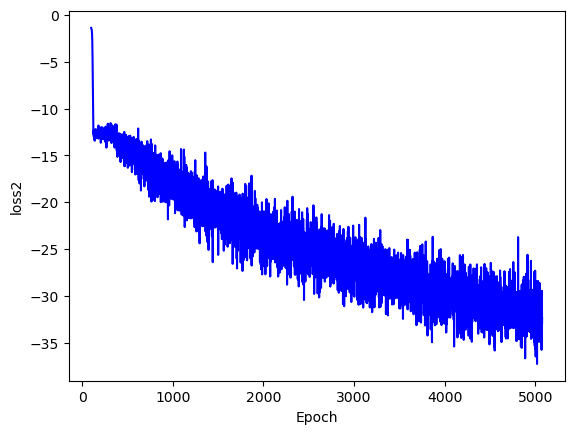

***** epoch 203 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 1 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85567.20743073462
r_em 54839.47349915038
54839.47349915038
ReWard2/R0 10.967894699830076
reward2 is: 18.967894699830076
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 2 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 3 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85824.36077530088
r_em 55160.667342122135
55160.667342122135
ReWard2/R0 11.032133468424426
reward2 is: 19.032133468424426
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 4 *****
1/1 [==============================] - 0s 50ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85781.58061945596
r_em 55930.56126117679
55930.56126117679
ReWard2/R0 11.186112252235358
reward2 is: 19.186112252235358
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.08281692480518352
***** epoch 203 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95998.48895728652
r_em 55174.66387111342
55174.66387111342
ReWard2/R0 11.034932774222684
reward2 is: 19.034932774222682
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 9ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 9ms/step
***** frame 6 *****
1/1 [==============================] - 0s 39ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96784.93843132787
r_em 54862.04177057856
54862.04177057856
ReWard2/R0 10.972408354115712
reward2 is: 18.972408354115714
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 7 *****
1/1 [==============================] - 0s 44ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 97845.8772638769
r_em 55476.55995695791
55476.55995695791
ReWard2/R0 11.095311991391583
reward2 is: 19.095311991391583
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 8 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 97422.89949723447
r_em 54938.57787538205
54938.57787538205
ReWard2/R0 10.98771557507641
reward2 is: 18.987715575076408
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 9 *****
1/1 [==============================] - 0s 41ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.08261008943198732
***** epoch 203 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 97407.15484872999
r_em 56002.427966976684
56002.427966976684
ReWard2/R0 11.200485593395337
reward2 is: 19.200485593395335
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 11 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 97070.40342382691
r_em 55661.608606216025
55661.608606216025
ReWard2/R0 11.132321721243205
reward2 is: 19.132321721243205
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 12 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 98387.98879524223
r_em 55040.71634784818
55040.71634784818
ReWard2/R0 11.008143269569636
reward2 is: 19.008143269569636
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 13 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 97856.04945840965
r_em 52796.61157663049
52796.61157663049
ReWard2/R0 10.559322315326098
reward2 is: 18.5593223153261
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 10ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 14 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 99100.41584537632
r_em 53561.151625854276
53561.151625854276
ReWard2/R0 10.712230325170855
reward2 is: 18.712230325170857
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.08240377063039415
***** epoch 203 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94043.94024980294
r_em 58412.03175726866
58412.03175726866
ReWard2/R0 11.682406351453732
reward2 is: 19.682406351453732
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 16 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94008.3106780935
r_em 56412.7889963115
56412.7889963115
ReWard2/R0 11.2825577992623
reward2 is: 19.2825577992623
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 17 *****
1/1 [==============================] - 0s 41ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93962.27826058335
r_em 56720.11757518523
56720.11757518523
ReWard2/R0 11.344023515037046
reward2 is: 19.344023515037044
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 18 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94970.50477134727
r_em 57434.25256158013
57434.25256158013
ReWard2/R0 11.486850512316025
reward2 is: 19.486850512316025
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 19 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95095.17852677556
r_em 57467.48842399413
57467.48842399413
ReWard2/R0 11.493497684798827
reward2 is: 19.493497684798825
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.08219796711026581
***** epoch 203 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 46ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85011.75330824853
r_em 54741.30032265621
54741.30032265621
ReWard2/R0 10.948260064531242
reward2 is: 18.94826006453124
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 21 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85624.94858727942
r_em 55077.512014372565
55077.512014372565
ReWard2/R0 11.015502402874514
reward2 is: 19.015502402874514
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 12ms/step
***** frame 22 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85961.69615593237
r_em 55234.67464822603
55234.67464822603
ReWard2/R0 11.046934929645206
reward2 is: 19.046934929645204
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 23 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85534.00892895137
r_em 54665.822261194146
54665.822261194146
ReWard2/R0 10.93316445223883
reward2 is: 18.933164452238827
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 11ms/step
***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.08199267758468616


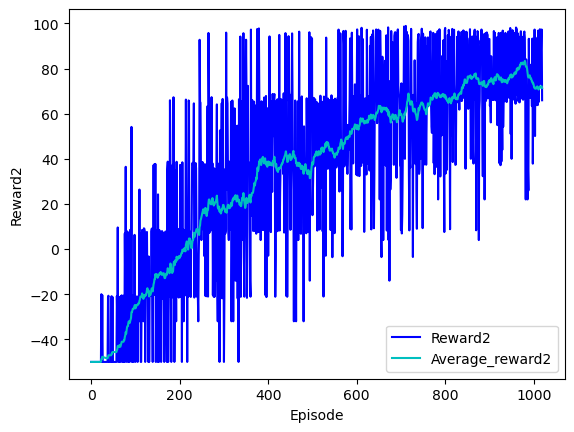

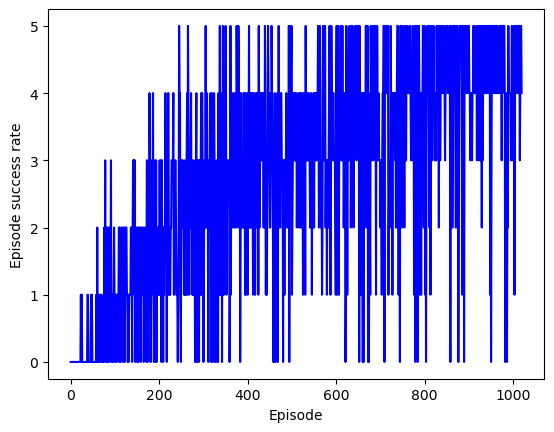

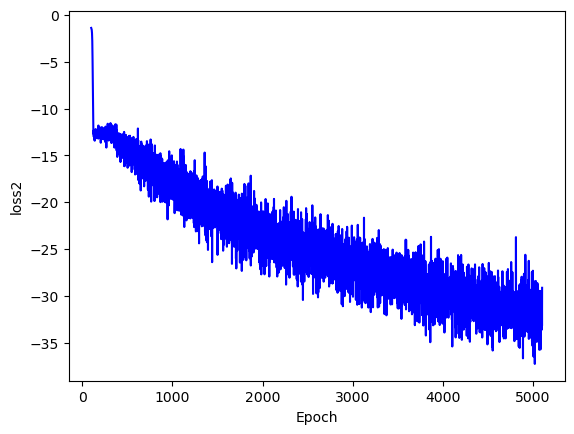

***** epoch 204 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 24ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89061.17050569766
r_em 57480.03620982224
57480.03620982224
ReWard2/R0 11.496007241964447
reward2 is: 19.49600724196445
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 1 *****
1/1 [==============================] - 0s 42ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88834.62361551983
r_em 57094.14600066302
57094.14600066302
ReWard2/R0 11.418829200132604
reward2 is: 19.418829200132606
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 2 *****
1/1 [==============================] - 0s 42ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91169.91976168269
r_em 57329.58889424576
57329.58889424576
ReWard2/R0 11.465917778849152
reward2 is: 19.465917778849153
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 3 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90743.4338418325
r_em 57392.50362486808
57392.50362486808
ReWard2/R0 11.478500724973616
reward2 is: 19.478500724973614
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 4 *****
1/1 [==============================] - 0s 45ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89392.18869000775
r_em 56947.29826280131
56947.29826280131
ReWard2/R0 11.389459652560262
reward2 is: 19.389459652560262
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.0817879007699532
***** epoch 204 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 84542.14285931166
r_em 62300.49751238408
62300.49751238408
ReWard2/R0 12.460099502476815
reward2 is: 20.460099502476815
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step
***** frame 6 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 94862.16155895649
r_em 57724.042632587436
57724.042632587436
ReWard2/R0 11.544808526517487
reward2 is: 19.544808526517485
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step
***** frame 7 *****
1/1 [==============================] - 0s 37ms/step
we 

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 11 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 73718.25093917848
r_em 56242.413601792905
56242.413601792905
ReWard2/R0 11.24848272035858
reward2 is: 19.24848272035858
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 12 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 75920.98597178482
r_em 56451.33423653738
56451.33423653738
ReWard2/R0 11.290266847307477
reward2 is: 19.29026684730748
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 13 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 75283.05771187873
r_em 56231.68567609126
56231.68567609126
ReWard2/R0 11.246337135218253
reward2 is: 19.246337135218255
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 14 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 72819.28881747095
r_em 54131.3628223842
54131.3628223842
ReWard2/R0 10.82627256447684
reward2 is: 18.826272564476838
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.08137988015424144
***** epoch 204 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90512.56259327987
r_em 57994.646155942515
57994.646155942515
ReWard2/R0 11.598929231188503
reward2 is: 19.598929231188503
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 16 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89884.14990495883
r_em 57926.579082839045
57926.579082839045
ReWard2/R0 11.585315816567809
reward2 is: 19.585315816567807
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 17 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89836.94916739305
r_em 57074.91641673284
57074.91641673284
ReWard2/R0 11.414983283346569
reward2 is: 19.41498328334657
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 18 *****
1/1 [==============================] - 0s 23ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89009.33094445603
r_em 56951.01123722282
56951.01123722282
ReWard2/R0 11.390202247444563
reward2 is: 19.390202247444563
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 19 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89061.51641683924
r_em 57599.69018744941
57599.69018744941
ReWard2/R0 11.519938037489881
reward2 is: 19.51993803748988
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.08117663380185683
***** epoch 204 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85243.94358628162
r_em 53726.89907446975
53726.89907446975
ReWard2/R0 10.74537981489395
reward2 is: 18.74537981489395
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 21 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84347.85299130957
r_em 54580.44972531603
54580.44972531603
ReWard2/R0 10.916089945063206
reward2 is: 18.916089945063206
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 22 *****
1/1 [==============================] - 0s 40ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82485.825237452
r_em 54357.37389323005
54357.37389323005
ReWard2/R0 10.871474778646009
reward2 is: 18.87147477864601
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 23 *****
1/1 [==============================] - 0s 25ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84206.27709244928
r_em 53050.203223455545
53050.203223455545
ReWard2/R0 10.610040644691109
reward2 is: 18.61004064469111
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 4ms/step
***** frame 24 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83538.52387945596
r_em 52759.763193177874
52759.763193177874
ReWard2/R0 10.551952638635575
reward2 is: 18.551952638635576
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.08097389505749128


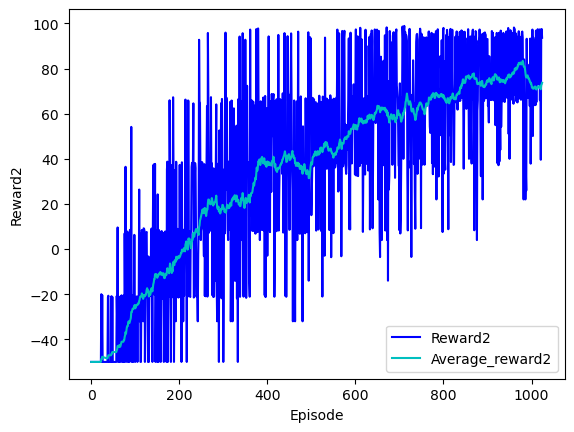

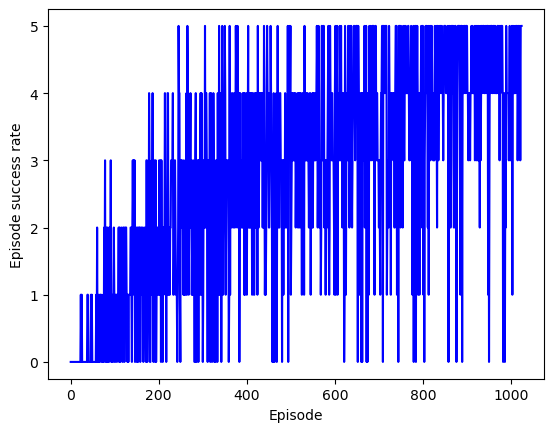

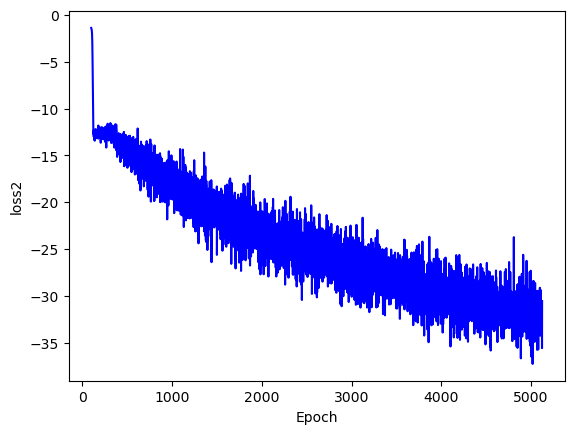

***** epoch 205 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 1 *****
1/1 [==============================] - 0s 50ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94110.20639596976
r_em 53585.54010587577
53585.54010587577
ReWard2/R0 10.717108021175154
reward2 is: 18.717108021175154
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 2 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94043.80713975495
r_em 53818.5341234902
53818.5341234902
ReWard2/R0 10.76370682469804
reward2 is: 18.76370682469804
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 3 *****
1/1 [==============================] - 0s 42ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93346.17415994043
r_em 53770.99343159601
53770.99343159601
ReWard2/R0 10.754198686319203
reward2 is: 18.754198686319203
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 4 *****
1/1 [==============================] - 0s 41ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92497.15249591981
r_em 53748.53602918009
53748.53602918009
ReWard2/R0 10.749707205836017
reward2 is: 18.749707205836017
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.08077166265339315
***** epoch 205 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78396.72204552143
r_em 54453.52669691146
54453.52669691146
ReWard2/R0 10.890705339382292
reward2 is: 18.890705339382293
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 6 *****
1/1 [==============================] - 0s 41ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77686.07205419535
r_em 54578.724333451726
54578.724333451726
ReWard2/R0 10.915744866690344
reward2 is: 18.915744866690346
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 7 *****
1/1 [==============================] - 0s 41ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77803.22049298971
r_em 55033.900286511
55033.900286511
ReWard2/R0 11.0067800573022
reward2 is: 19.0067800573022
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 8 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78109.61191595232
r_em 54935.60691512118
54935.60691512118
ReWard2/R0 10.987121383024235
reward2 is: 18.987121383024235
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 9 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77793.50425080488
r_em 53837.46169070598
53837.46169070598
ReWard2/R0 10.767492338141196
reward2 is: 18.767492338141196
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.08056993532497697
***** epoch 205 episode 2 *****
***** frame 10 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 11 *****
1/1 [==============================] - 0s 39ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83604.78220608945
r_em 55078.09716035829
55078.09716035829
ReWard2/R0 11.015619432071658
reward2 is: 19.01561943207166
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 12 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83750.47046601388
r_em 54448.305139068376
54448.305139068376
ReWard2/R0 10.889661027813675
reward2 is: 18.889661027813673
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 13 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84314.54429596665
r_em 55991.95490469173
55991.95490469173
ReWard2/R0 11.198390980938346
reward2 is: 19.198390980938346
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 14 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85601.46945653298
r_em 57059.72365850238
57059.72365850238
ReWard2/R0 11.411944731700476
reward2 is: 19.411944731700476
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.08036871181081562
***** epoch 205 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 44ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83354.11837932127
r_em 55580.842508525144
55580.842508525144
ReWard2/R0 11.11616850170503
reward2 is: 19.11616850170503
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 16 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86477.95141240093
r_em 55273.41453337688
55273.41453337688
ReWard2/R0 11.054682906675376
reward2 is: 19.054682906675374
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 17 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87581.52359163508
r_em 55439.2999749814
55439.2999749814
ReWard2/R0 11.087859994996279
reward2 is: 19.08785999499628
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 18 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86212.53756820138
r_em 55712.679108311706
55712.679108311706
ReWard2/R0 11.14253582166234
reward2 is: 19.142535821662342
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 10ms/step
***** frame 19 *****
1/1 [==============================] - 0s 44ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85774.731781045
r_em 55683.17851137056
55683.17851137056
ReWard2/R0 11.136635702274113
reward2 is: 19.136635702274113
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 10ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.08016799085263235
***** epoch 205 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82885.82122909068
r_em 51151.496813354184
51151.496813354184
ReWard2/R0 10.230299362670836
reward2 is: 18.230299362670834
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 22 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88108.01204654938
r_em 51378.37578443392
51378.37578443392
ReWard2/R0 10.275675156886784
reward2 is: 18.275675156886784
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 23 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 24 *****
1/1 [==============================] - 0s 40ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86677.68463697385
r_em 50438.4375989846
50438.4375989846
ReWard2/R0 10.087687519796921
reward2 is: 18.087687519796923
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.07996777119529298


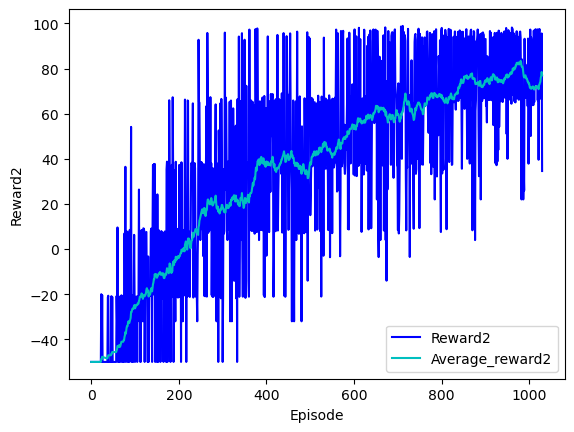

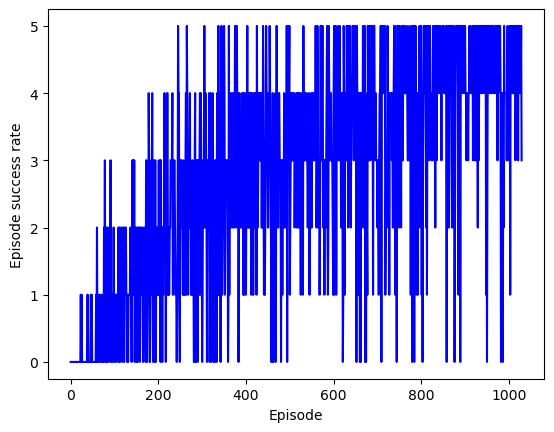

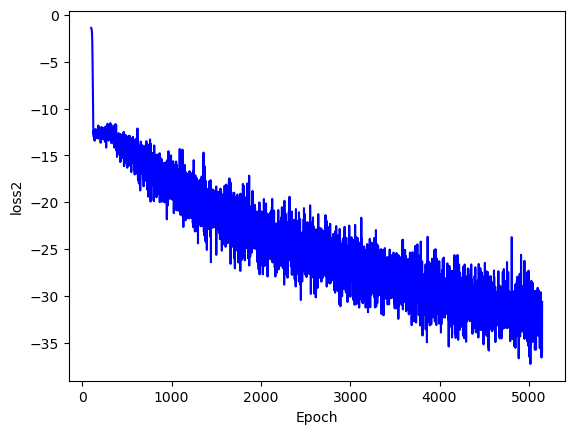

***** epoch 206 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82694.45455983834
r_em 56952.94902994315
56952.94902994315
ReWard2/R0 11.390589805988629
reward2 is: 19.39058980598863
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 1 *****
1/1 [==============================] - 0s 41ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84271.05739292633
r_em 56982.779866742756
56982.779866742756
ReWard2/R0 11.396555973348551
reward2 is: 19.39655597334855
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 2 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83711.67354249537
r_em 56811.258070666496
56811.258070666496
ReWard2/R0 11.3622516141333
reward2 is: 19.3622516141333
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 3 *****
1/1 [==============================] - 0s 45ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82510.2139920615
r_em 56275.8256178073
56275.8256178073
ReWard2/R0 11.25516512356146
reward2 is: 19.25516512356146
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 4 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80426.60842864476
r_em 56317.52030227372
56317.52030227372
ReWard2/R0 11.263504060454745
reward2 is: 19.263504060454743
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
Epsilon_hist is: 0.07976805158679803
***** epoch 206 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 100299.57437130353
r_em 57446.23309849141
57446.23309849141
ReWard2/R0 11.489246619698282
reward2 is: 19.48924661969828
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step
***** frame 6 *****
1/1 [==============================] - 0s 45ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 101385.90429604803
r_em 57388.178985878236
57388.178985878236
ReWard2/R0 11.477635797175648
reward2 is: 19.477635797175648
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step
***** frame 7 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOp

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 11 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84669.54655483141
r_em 53637.756072241296
53637.756072241296
ReWard2/R0 10.72755121444826
reward2 is: 18.727551214448262
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 12 *****
1/1 [==============================] - 0s 51ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82596.62818937343
r_em 55267.884837590565
55267.884837590565
ReWard2/R0 11.053576967518113
reward2 is: 19.05357696751811
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 13 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81796.96175328038
r_em 55720.37566709051
55720.37566709051
ReWard2/R0 11.144075133418102
reward2 is: 19.144075133418102
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 14 *****
1/1 [==============================] - 0s 42ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81978.54179223286
r_em 55059.38951950905
55059.38951950905
ReWard2/R0 11.01187790390181
reward2 is: 19.011877903901812
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.07937010752396999
***** epoch 206 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84997.40142314878
r_em 54882.085692738816
54882.085692738816
ReWard2/R0 10.976417138547763
reward2 is: 18.976417138547763
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 16 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89168.74748940286
r_em 54938.25429176199
54938.25429176199
ReWard2/R0 10.987650858352398
reward2 is: 18.987650858352396
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 17 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89005.16343870884
r_em 54724.992080510914
54724.992080510914
ReWard2/R0 10.944998416102182
reward2 is: 18.94499841610218
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 18 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88895.71650146312
r_em 54389.66759832725
54389.66759832725
ReWard2/R0 10.87793351966545
reward2 is: 18.87793351966545
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 19 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.07917188058124107
***** epoch 206 episode 4 *****
***** frame 20 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 21 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87028.42100066635
r_em 56065.06782006633
56065.06782006633
ReWard2/R0 11.213013564013266
reward2 is: 19.213013564013266
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 22 *****
1/1 [==============================] - 0s 46ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86704.3970802359
r_em 56698.60546786012
56698.60546786012
ReWard2/R0 11.339721093572024
reward2 is: 19.339721093572024
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 23 *****
1/1 [==============================] - 0s 45ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87187.09137168685
r_em 56445.42979047715
56445.42979047715
ReWard2/R0 11.28908595809543
reward2 is: 19.28908595809543
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 24 *****
1/1 [==============================] - 0s 39ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89125.20720199656
r_em 55441.10688590181
55441.10688590181
ReWard2/R0 11.088221377180362
reward2 is: 19.08822137718036
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.07897414871054934


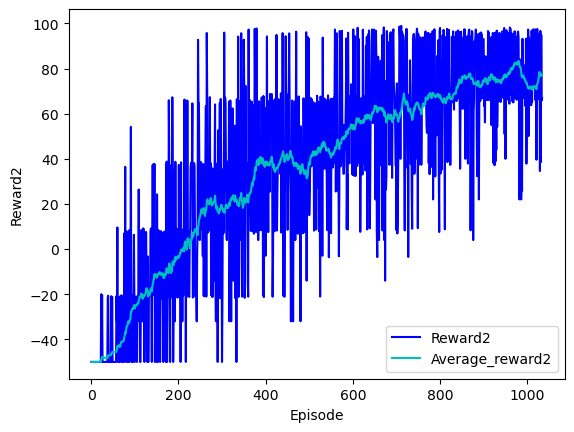

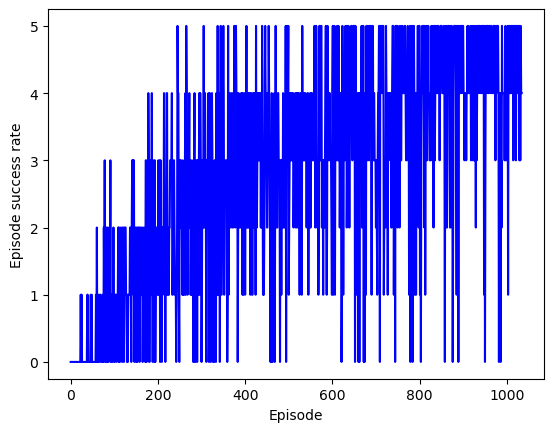

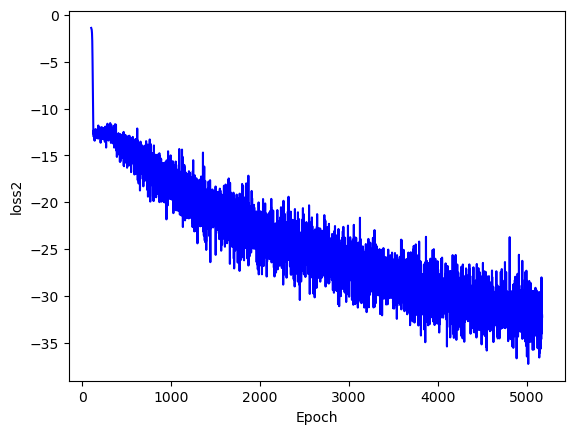

***** epoch 207 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 1 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79950.84236258142
r_em 54139.431005289254
54139.431005289254
ReWard2/R0 10.82788620105785
reward2 is: 18.82788620105785
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 2 *****
1/1 [==============================] - 0s 40ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80438.53032292982
r_em 53739.46240419274
53739.46240419274
ReWard2/R0 10.747892480838548
reward2 is: 18.747892480838548
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 3 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82128.43786811072
r_em 53972.89834672887
53972.89834672887
ReWard2/R0 10.794579669345774
reward2 is: 18.794579669345772
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 4 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91095.92690750063
r_em 54317.906298864305
54317.906298864305
ReWard2/R0 10.863581259772861
reward2 is: 18.86358125977286
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.07877691067545174
***** epoch 207 episode 1 *****
***** frame 5 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 8ms/step
***** frame 6 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90180.65679091985
r_em 56467.3658594845
56467.3658594845
ReWard2/R0 11.293473171896899
reward2 is: 19.2934731718969
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 7 *****
1/1 [==============================] - 0s 41ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88666.177799536
r_em 56704.83451878099
56704.83451878099
ReWard2/R0 11.340966903756199
reward2 is: 19.340966903756197
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 8 *****
1/1 [==============================] - 0s 41ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90952.6985619115
r_em 57027.966802124145
57027.966802124145
ReWard2/R0 11.40559336042483
reward2 is: 19.40559336042483
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 9 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89849.50811973962
r_em 56640.783094925835
56640.783094925835
ReWard2/R0 11.328156618985167
reward2 is: 19.32815661898517
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.0785801652425933
***** epoch 207 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 44ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 93848.56284872745
r_em 56865.48376254818
56865.48376254818
ReWard2/R0 11.373096752509637
reward2 is: 19.37309675250964
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step
***** frame 11 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 92687.33085047004
r_em 56713.51292223146
56713.51292223146
ReWard2/R0 11.342702584446291
reward2 is: 19.342702584446293
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step
***** frame 12 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps 

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 16 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 76971.63576930454
r_em 55115.96770211519
55115.96770211519
ReWard2/R0 11.023193540423037
reward2 is: 19.023193540423037
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 12ms/step
***** frame 17 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 18 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 75919.95299903656
r_em 53677.970487238774
53677.970487238774
ReWard2/R0 10.735594097447756
reward2 is: 18.735594097447756
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 19 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89682.1225000199
r_em 53320.44774038431
53320.44774038431
ReWard2/R0 10.664089548076863
reward2 is: 18.664089548076863
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.0781881472655676
***** epoch 207 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 76500.2115125063
r_em 57547.26138124178
57547.26138124178
ReWard2/R0 11.509452276248355
reward2 is: 19.509452276248354
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 21 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79833.26079714813
r_em 58255.66712764964
58255.66712764964
ReWard2/R0 11.651133425529927
reward2 is: 19.651133425529927
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 22 *****
1/1 [==============================] - 0s 45ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78146.65959856226
r_em 57315.38396962625
57315.38396962625
ReWard2/R0 11.46307679392525
reward2 is: 19.46307679392525
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 23 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77116.85729051394
r_em 57038.64839090777
57038.64839090777
ReWard2/R0 11.407729678181555
reward2 is: 19.407729678181553
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 9ms/step
***** frame 24 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 75987.11681018636
r_em 55756.47146218206
55756.47146218206
ReWard2/R0 11.151294292436413
reward2 is: 19.15129429243641
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.0779928722700611


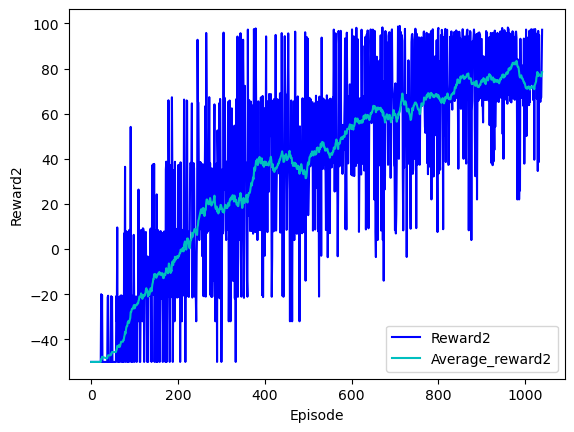

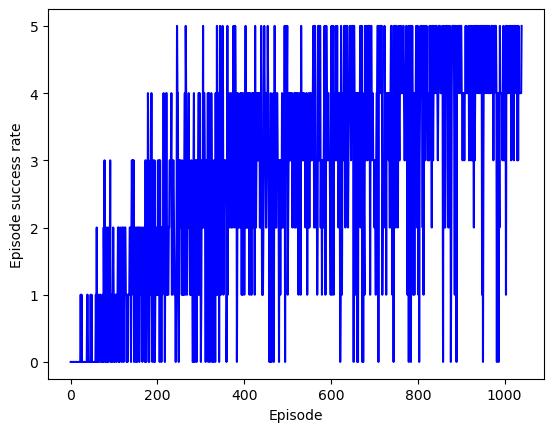

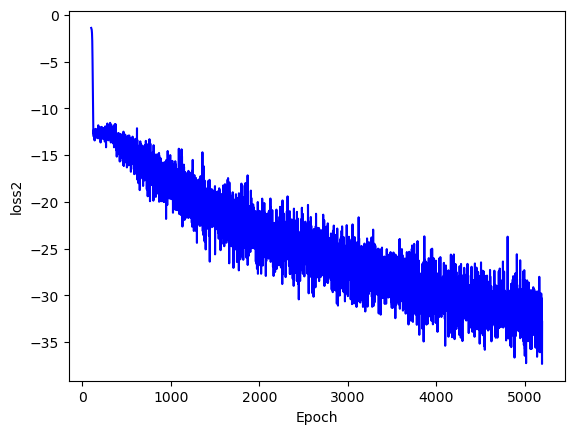

***** epoch 208 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 76938.39510775507
r_em 50698.63186338233
50698.63186338233
ReWard2/R0 10.139726372676467
reward2 is: 18.139726372676467
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 1 *****
1/1 [==============================] - 0s 47ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77593.21832772506
r_em 51316.39866619471
51316.39866619471
ReWard2/R0 10.263279733238942
reward2 is: 18.263279733238942
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 2 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 76479.35894955794
r_em 52687.22412209811
52687.22412209811
ReWard2/R0 10.537444824419621
reward2 is: 18.537444824419623
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 3 *****
1/1 [==============================] - 0s 40ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 72387.6717074528
r_em 51926.1724708083
51926.1724708083
ReWard2/R0 10.38523449416166
reward2 is: 18.385234494161658
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 4 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 74049.62693519123
r_em 51596.018044360404
51596.018044360404
ReWard2/R0 10.319203608872082
reward2 is: 18.31920360887208
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.07779808497409992
***** epoch 208 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 100579.17969685432
r_em 52022.883380467116
52022.883380467116
ReWard2/R0 10.404576676093424
reward2 is: 18.404576676093424
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step
***** frame 6 *****
1/1 [==============================] - 0s 53ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 98856.76369134532
r_em 51221.98422952641
51221.98422952641
ReWard2/R0 10.244396845905282
reward2 is: 18.244396845905282
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step
***** frame 7 *****
1/1 [==============================] - 0s 48ms/step
w

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 8 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 96935.29102745137
r_em 49183.72548996334
49183.72548996334
ReWard2/R0 9.836745097992669
reward2 is: 17.83674509799267
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step
***** frame 9 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 95837.63979361067
r_em 50626.14879569517
50626.14879569517
ReWard2/R0 10.125229759139033
reward2 is: 18.12522975913903
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.07760378415965381
***** epoch 208 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 30ms/step
we cho

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 11 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89292.12193879386
r_em 54642.347738972996
54642.347738972996
ReWard2/R0 10.928469547794599
reward2 is: 18.9284695477946
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 12 *****
1/1 [==============================] - 0s 41ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87547.4763327202
r_em 53364.42533832165
53364.42533832165
ReWard2/R0 10.67288506766433
reward2 is: 18.672885067664332
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 13 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88668.60610083124
r_em 51483.061221091826
51483.061221091826
ReWard2/R0 10.296612244218366
reward2 is: 18.296612244218366
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 14 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.07740996861173462
***** epoch 208 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 16 *****
1/1 [==============================] - 0s 44ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
*

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 18 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 19 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.07721663711838857
***** epoch 208 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95282.24146745242
r_em 55462.695302164226
55462.695302164226
ReWard2/R0 11.092539060432845
reward2 is: 19.092539060432845
total number of ur2 RBs: 8.0

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 21 *****
1/1 [==============================] - 0s 41ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94992.5327331077
r_em 56236.56009337997
56236.56009337997
ReWard2/R0 11.247312018675995
reward2 is: 19.247312018675995
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 22 *****
1/1 [==============================] - 0s 49ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92841.58994797184
r_em 56993.91007439419
56993.91007439419
ReWard2/R0 11.398782014878838
reward2 is: 19.39878201487884
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 23 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93794.76960712358
r_em 56802.44057223547
56802.44057223547
ReWard2/R0 11.360488114447094
reward2 is: 19.360488114447094
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 24 *****
1/1 [==============================] - 0s 41ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92935.00236638932
r_em 56736.64557055573
56736.64557055573
ReWard2/R0 11.347329114111146
reward2 is: 19.347329114111147
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.07702378847068873


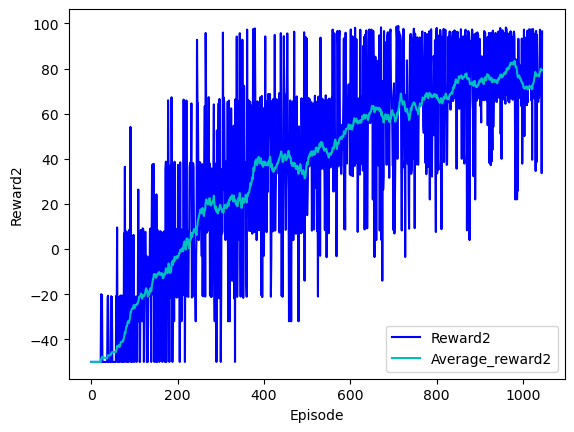

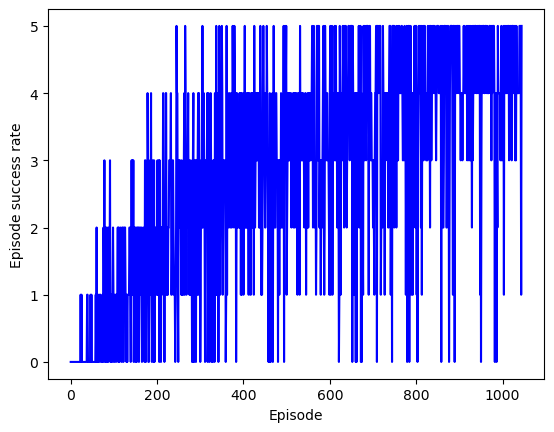

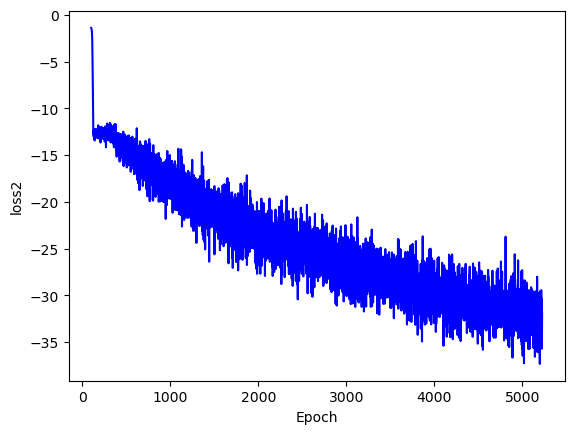

***** epoch 209 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 40ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 73498.87773249796
r_em 49974.13650438648
49974.13650438648
ReWard2/R0 9.994827300877295
reward2 is: 17.994827300877297
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 1 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 74868.31434060878
r_em 51260.50645921867
51260.50645921867
ReWard2/R0 10.252101291843733
reward2 is: 18.252101291843733
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 2 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 75123.76460939208
r_em 52478.44545197272
52478.44545197272
ReWard2/R0 10.495689090394544
reward2 is: 18.495689090394542
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 3 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 76927.40401320143
r_em 53872.909756016525
53872.909756016525
ReWard2/R0 10.774581951203304
reward2 is: 18.774581951203302
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 4 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 75959.73878551516
r_em 54683.48030443436
54683.48030443436
ReWard2/R0 10.936696060886872
reward2 is: 18.936696060886874
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
Epsilon_hist is: 0.07683142146272753
***** epoch 209 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 6 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 93052.5622536822
r_em 51009.387402805274
51009.387402805274
ReWard2/R0 10.201877480561055
reward2 is: 18.201877480561055
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step
***** frame 7 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 93104.45113982316
r_em 50669.36403

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.07663953489160913
***** epoch 209 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 94945.81100944479
r_em 52088.48767033778
52088.48767033778
ReWard2/R0 10.417697534067557
reward2 is: 18.417697534067557
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step
***** frame 11 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 95167.00224544217
r_em 51508.0396478881
51508.0396478881
ReWard2/R0 10.30160792957762
reward2 is: 18.30160792957762
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step
***** frame 12 *****
1/1 [==============================] - 0s 34ms/step
we ch

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 16 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 17 *****
1/1 [==============================] - 0s 43ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 18 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83940.51628397268
r_em 55423.18926775573
55423.18926775573
ReWard2/R0 11.084637853551147
reward2 is: 19.084637853551147
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 19 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83257.76273041982
r_em 56139.441561746455
56139.441561746455
ReWard2/R0 11.227888312349291
reward2 is: 19.227888312349293
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.07625719826333091
***** epoch 209 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 44ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 74087.90296000673
r_em 57786.69748526558
57786.69748526558
ReWard2/R0 11.557339497053116
reward2 is: 19.557339497053114
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 21 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 75043.95368672429
r_em 57845.5273279178
57845.5273279178
ReWard2/R0 11.56910546558356
reward2 is: 19.56910546558356
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 22 *****
1/1 [==============================] - 0s 47ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 76366.31816187497
r_em 57326.54354435572
57326.54354435572
ReWard2/R0 11.465308708871145
reward2 is: 19.465308708871145
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 23 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 76400.5460387147
r_em 57676.52471081974
57676.52471081974
ReWard2/R0 11.535304942163949
reward2 is: 19.535304942163947
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 24 *****
1/1 [==============================] - 0s 44ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 76150.23152420511
r_em 57596.05669292821
57596.05669292821
ReWard2/R0 11.519211338585642
reward2 is: 19.51921133858564
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.07606674581537061


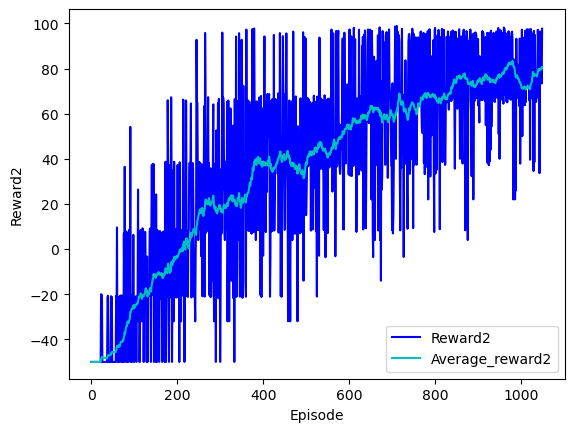

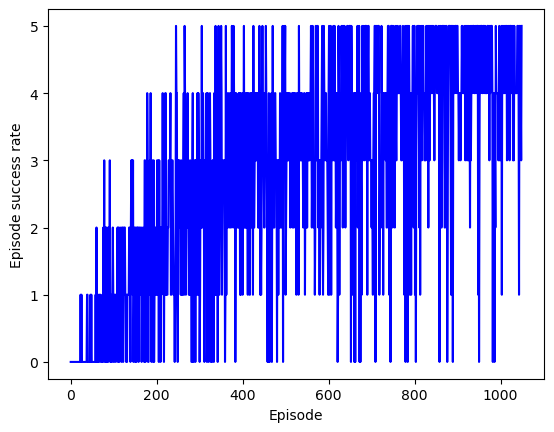

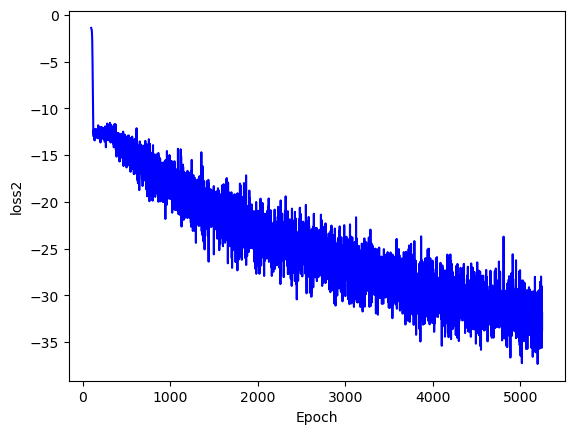

***** epoch 210 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93379.22365898719
r_em 53259.88257001085
53259.88257001085
ReWard2/R0 10.65197651400217
reward2 is: 18.651976514002172
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 1 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93913.10276382884
r_em 53878.346574309406
53878.346574309406
ReWard2/R0 10.775669314861881
reward2 is: 18.77566931486188
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 2 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94139.6727722447
r_em 54854.89587282039
54854.89587282039
ReWard2/R0 10.970979174564077
reward2 is: 18.97097917456408
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 3 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93623.508612367
r_em 55151.46034654249
55151.46034654249
ReWard2/R0 11.030292069308498
reward2 is: 19.030292069308498
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 4 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94489.12774259364
r_em 55463.87619253722
55463.87619253722
ReWard2/R0 11.092775238507443
reward2 is: 19.092775238507443
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.07587676902263708
***** epoch 210 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83775.51801345276
r_em 52070.67407422799
52070.67407422799
ReWard2/R0 10.414134814845598
reward2 is: 18.414134814845596
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 6 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81978.97153800922
r_em 51497.98049026176
51497.98049026176
ReWard2/R0 10.299596098052353
reward2 is: 18.299596098052355
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 7 *****
1/1 [==============================] - 0s 41ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81650.3821804644
r_em 53391.81423873628
53391.81423873628
ReWard2/R0 10.678362847747257
reward2 is: 18.67836284774726
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 8 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84445.29402494649
r_em 53726.06899206104
53726.06899206104
ReWard2/R0 10.745213798412207
reward2 is: 18.74521379841221
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 9 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81985.54323785251
r_em 52824.24367483443
52824.24367483443
ReWard2/R0 10.564848734966887
reward2 is: 18.564848734966887
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.07568726669718082
***** epoch 210 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 74659.20077704813
r_em 55970.27176588835
55970.27176588835
ReWard2/R0 11.19405435317767
reward2 is: 19.19405435317767
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 11 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 75811.65775698128
r_em 55979.74503853942
55979.74503853942
ReWard2/R0 11.195949007707883
reward2 is: 19.19594900770788
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 12 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77792.48829248323
r_em 55371.717819365644
55371.717819365644
ReWard2/R0 11.074343563873128
reward2 is: 19.07434356387313
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 13 *****
1/1 [==============================] - 0s 47ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77702.56061445188
r_em 54350.009921877405
54350.009921877405
ReWard2/R0 10.870001984375481
reward2 is: 18.87000198437548
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 14 *****
1/1 [==============================] - 0s 46ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 74329.12073437996
r_em 54910.018273829504
54910.018273829504
ReWard2/R0 10.9820036547659
reward2 is: 18.9820036547659
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.07549823765401918
***** epoch 210 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 43ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 16 *****
1/1 [==============================] - 0s 46ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 17 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80937.74886650196
r_em 50121.4355446167
50121.4355446167
ReWard2/R0 10.02428710892334
reward2 is: 18.02428710892334
total number of

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 18 *****
1/1 [==============================] - 0s 42ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82418.83519604075
r_em 51992.953705684085
51992.953705684085
ReWard2/R0 10.398590741136816
reward2 is: 18.398590741136815
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 19 *****
1/1 [==============================] - 0s 44ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82589.9513053123
r_em 52629.07555965775
52629.07555965775
ReWard2/R0 10.52581511193155
reward2 is: 18.52581511193155
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.07530968071112908
***** epoch 210 episode 4 *****
***** frame 20 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 5.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 21 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89374.84001342741
r_em 54809.97441125961
54809.97441125961
ReWard2/R0 10.961994882251922
reward2 is: 18.961994882251922
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 22 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89738.76574691979
r_em 54778.539516132805
54778.539516132805
ReWard2/R0 10.95570790322656
reward2 is: 18.95570790322656
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 23 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89588.7104128914
r_em 55277.56004259348
55277.56004259348
ReWard2/R0 11.055512008518697
reward2 is: 19.055512008518697
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 24 *****
1/1 [==============================] - 0s 43ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92241.50170821682
r_em 54661.73846543552
54661.73846543552
ReWard2/R0 10.932347693087104
reward2 is: 18.932347693087102
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.07512159468943949


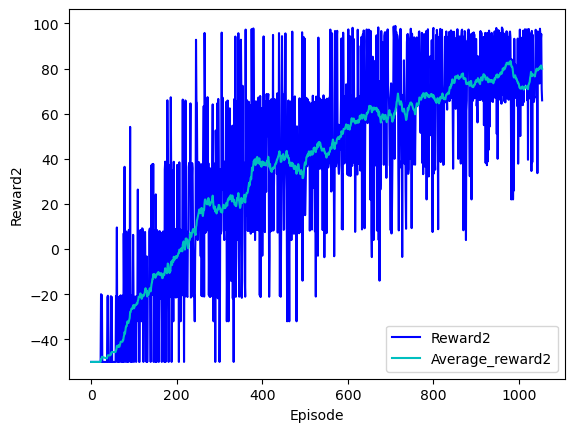

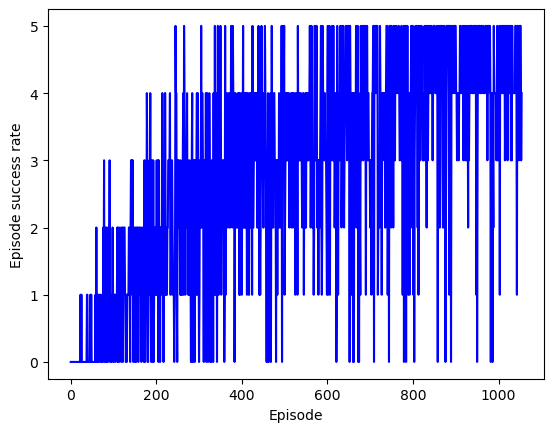

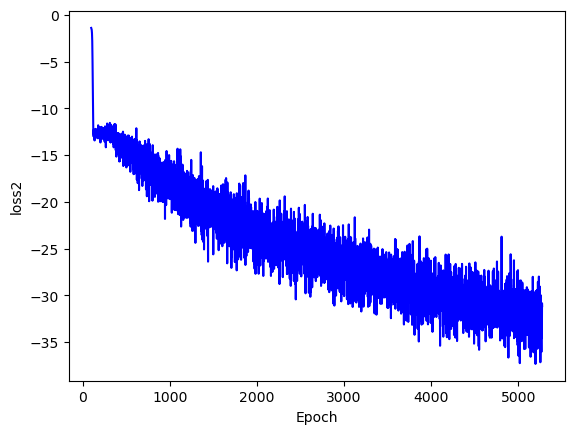

***** epoch 211 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 2 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 3 *****
1/1 [==============================] - 0s 45ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Outpu

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 6 *****
1/1 [==============================] - 0s 50ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83503.61149425563
r_em 54051.84582401806
54051.84582401806
ReWard2/R0 10.810369164803612
reward2 is: 18.81036916480361
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 7 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 76849.855188741
r_em 53704.17357889307
53704.17357889307
ReWard2/R0 10.740834715778613
reward2 is: 18.74083471577861
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 8 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84394.9829065135
r_em 54894.30777979461
54894.30777979461
ReWard2/R0 10.978861555958922
reward2 is: 18.97886155595892
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 9 *****
1/1 [==============================] - 0s 49ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87910.19091981539
r_em 55327.57130759933
55327.57130759933
ReWard2/R0 11.065514261519867
reward2 is: 19.065514261519866
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.07474683070809404
***** epoch 211 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 43ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88235.17025029233
r_em 53949.679186523
53949.679186523
ReWard2/R0 10.789935837304599
reward2 is: 18.789935837304597
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 11 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88671.01747386406
r_em 54286.0557851684
54286.0557851684
ReWard2/R0 10.85721115703368
reward2 is: 18.85721115703368
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 12 *****
1/1 [==============================] - 0s 41ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89577.15647190611
r_em 54260.66580450463
54260.66580450463
ReWard2/R0 10.852133160900925
reward2 is: 18.852133160900927
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 13 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90656.21113259831
r_em 53514.00631005547
53514.00631005547
ReWard2/R0 10.702801262011095
reward2 is: 18.702801262011093
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 14 *****
1/1 [==============================] - 0s 44ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92597.07499430032
r_em 54876.472706400666
54876.472706400666
ReWard2/R0 10.975294541280133
reward2 is: 18.975294541280135
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.07456015040499041
***** epoch 211 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93843.4420229941
r_em 56987.735410177105
56987.735410177105
ReWard2/R0 11.397547082035421
reward2 is: 19.397547082035423
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 16 *****
1/1 [==============================] - 0s 47ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 93594.7178096478
r_em 57220.601907768985
57220.601907768985
ReWard2/R0 11.444120381553796
reward2 is: 19.444120381553795
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step
***** frame 17 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 18 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91375.82076860276
r_em 57670.73290731506
57670.73290731506
ReWard2/R0 11.534146581463013
reward2 is: 19.534146

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 19 *****
1/1 [==============================] - 0s 46ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93690.9307787425
r_em 57391.31258675157
57391.31258675157
ReWard2/R0 11.478262517350315
reward2 is: 19.478262517350316
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.07437393633617707
***** epoch 211 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81468.26774579349
r_em 56540.8603194198
56540.8603194198
ReWard2/R0 11.30817206388396
reward2 is: 19.30817206388396
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 21 *****
1/1 [==============================] - 0s 40ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83538.70422042708
r_em 56584.12488998643
56584.12488998643
ReWard2/R0 11.316824977997285
reward2 is: 19.316824977997285
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 22 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85730.97437686188
r_em 56495.22526223888
56495.22526223888
ReWard2/R0 11.299045052447775
reward2 is: 19.299045052447774
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 23 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86303.31916574345
r_em 57114.98909335318
57114.98909335318
ReWard2/R0 11.422997818670636
reward2 is: 19.422997818670638
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 24 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84547.12345541622
r_em 56951.22990547581
56951.22990547581
ReWard2/R0 11.390245981095163
reward2 is: 19.390245981095163
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.07418818733723333


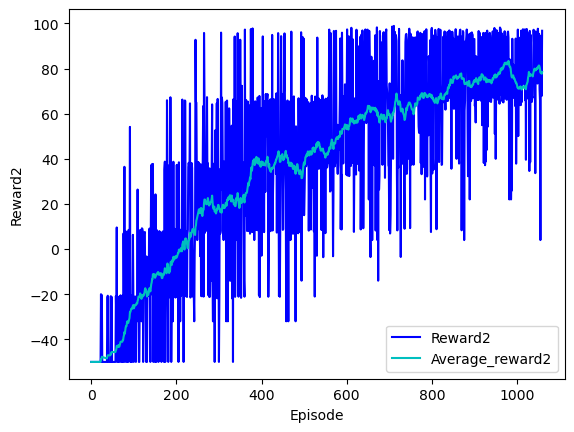

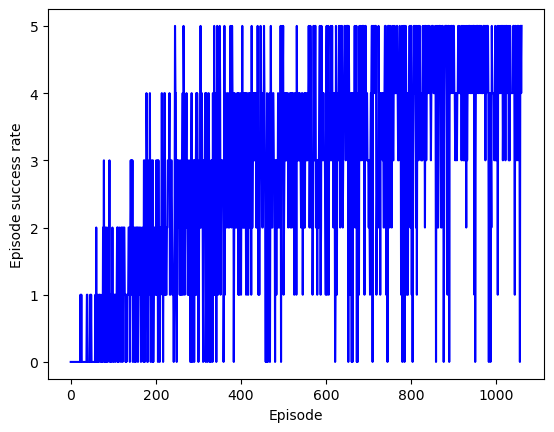

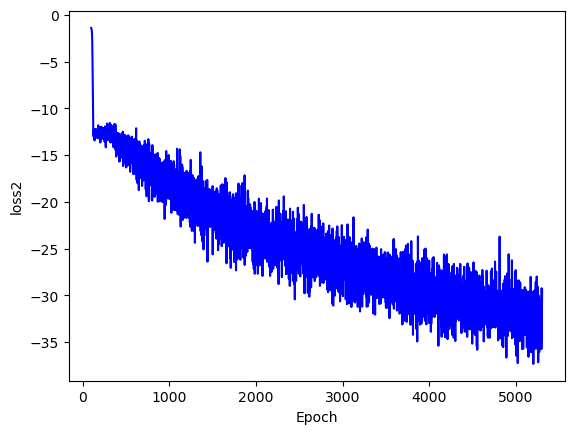

***** epoch 212 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93510.53026481187
r_em 54647.59926493419
54647.59926493419
ReWard2/R0 10.92951985298684
reward2 is: 18.92951985298684
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 1 *****
1/1 [==============================] - 0s 44ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92789.63778852911
r_em 54763.771875283026
54763.771875283026
ReWard2/R0 10.952754375056605
reward2 is: 18.952754375056607
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 2 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93815.95774510378
r_em 54692.749146327806
54692.749146327806
ReWard2/R0 10.938549829265561
reward2 is: 18.93854982926556
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 3 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93168.43190475085
r_em 55141.62335725555
55141.62335725555
ReWard2/R0 11.02832467145111
reward2 is: 19.02832467145111
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 4 *****
1/1 [==============================] - 0s 43ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92832.76778152741
r_em 55025.89522854533
55025.89522854533
ReWard2/R0 11.005179045709065
reward2 is: 19.005179045709063
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.07400290224664655
***** epoch 212 episode 1 *****
***** frame 5 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 6 *****
1/1 [==============================] - 0s 44ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 7 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 8ms/step
***** frame 8 *****
1/1

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 14 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90000.30882909837
r_em 53203.23312683175
53203.23312683175
ReWard2/R0 10.64064662536635
reward2 is: 18.64064662536635
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.0736337191589908
***** epoch 212 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94249.90163145476
r_em 54586.046553486514
54586.046553486514
ReWard2/R0 10.917209310697302
reward2 is: 18.917209310697302
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 16 *****
1/1 [==============================] - 0s 42ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93555.09894445239
r_em 54088.359299215124
54088.359299215124
ReWard2/R0 10.817671859843024
reward2 is: 18.817671859843024
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 17 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 18 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95186.05867206321
r_em 54627.78220098667
54627.78220098667
ReWard2/R0 10.925556440197335
reward2 is: 18.925556440197333
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 19 *****
1/1 [==============================] - 0s 40ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95821.8302648552
r_em 54114.19556715608
54114.19556715608
ReWard2/R0 10.822839113431217
reward2 is: 18.822839113431215
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.0734498188533721
***** epoch 212 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 45ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92020.82588519307
r_em 57605.01076591478
57605.01076591478
ReWard2/R0 11.521002153182957
reward2 is: 19.521002153182955
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 21 *****
1/1 [==============================] - 0s 41ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92527.93539119295
r_em 54946.85238903212
54946.85238903212
ReWard2/R0 10.989370477806425
reward2 is: 18.989370477806425
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 22 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93735.75781036253
r_em 55011.803077901604
55011.803077901604
ReWard2/R0 11.00236061558032
reward2 is: 19.002360615580322
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 23 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 24 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92683.33761243969
r_em 54539.24956604466
54539.24956604466
ReWard2/R0 10.907849913208931
reward2 is: 18.90784991320893
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.0732663778389965


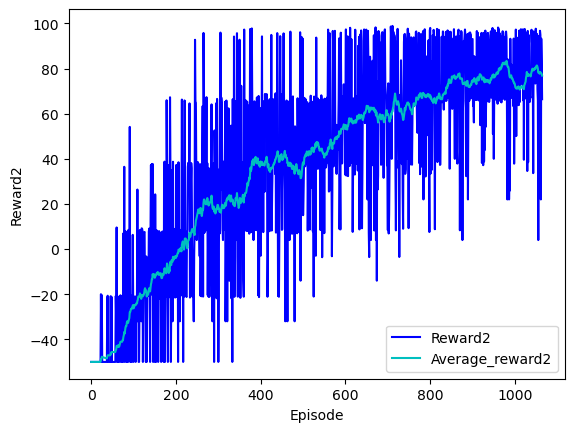

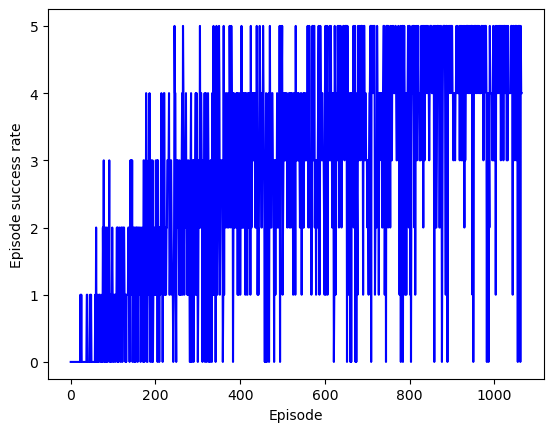

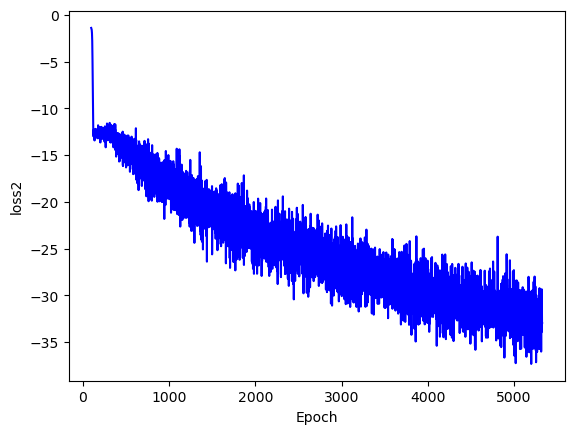

***** epoch 213 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 80971.62175609433
r_em 52036.02501660308
52036.02501660308
ReWard2/R0 10.407205003320616
reward2 is: 18.407205003320616
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step
***** frame 1 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80915.68146334289
r_em 51635.23262617797
51635.23262617797
ReWard2/R0 10.327046525235593
reward2 is: 18.327046525235595
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 2 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 81519.74530750839
r_em 53132.42837716821
53132.42837716821
ReWard2/R0 10.626485675433642
reward2 is: 18.626485675433642
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step
***** frame 3 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 81420.77895102851
r_em 52852.35331999321
52852.35331999321
ReWard2/R0 10.570470663998643
reward2 is: 18.57047066399864
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step
***** frame 4 *****
1/1 [==============================] - 0s 46ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 6 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87165.9430121551
r_em 52485.86029945369
52485.86029945369
ReWard2/R0 10.497172059890739
reward2 is: 18.497172059890737
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 7 *****
1/1 [==============================] - 0s 42ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83797.41198425004
r_em 51541.313287225115
51541.313287225115
ReWard2/R0 10.308262657445024
reward2 is: 18.308262657445024
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 8 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91076.28821383881
r_em 50236.941116897404
50236.941116897404
ReWard2/R0 10.04738822337948
reward2 is: 18.04738822337948
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 9 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90954.92345779209
r_em 49859.867155099586
49859.867155099586
ReWard2/R0 9.971973431019917
reward2 is: 17.97197343101992
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 10ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.07290086909851762
***** epoch 213 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 39ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82046.52799701637
r_em 54537.80788520491
54537.80788520491
ReWard2/R0 10.907561577040982
reward2 is: 18.90756157704098
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 11 *****
1/1 [==============================] - 0s 47ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82010.74473727828
r_em 54634.473728436526
54634.473728436526
ReWard2/R0 10.926894745687305
reward2 is: 18.926894745687306
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 12 *****
1/1 [==============================] - 0s 44ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81910.88037063209
r_em 55389.178756128815
55389.178756128815
ReWard2/R0 11.077835751225763
reward2 is: 19.077835751225763
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 13 *****
1/1 [==============================] - 0s 42ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81404.60989823657
r_em 56053.504971978415
56053.504971978415
ReWard2/R0 11.210700994395683
reward2 is: 19.210700994395683
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 14 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.07271879908684077
***** epoch 213 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 45ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 90798.97259385002
r_em 50953.86945413876
50953.86945413876
ReWard2/R0 10.190773890827751
reward2 is: 18.19077389082775
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step
***** frame 16 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 91466.3386176127
r_em 53089.19497888941
53089.19497888

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 19 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82946.66266878981
r_em 54826.69143473238
54826.69143473238
ReWard2/R0 10.965338286946475
reward2 is: 18.965338286946476
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.07253718379524565
***** epoch 213 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 46ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77218.3137031232
r_em 56305.275160845034
56305.275160845034
ReWard2/R0 11.261055032169008
reward2 is: 19.261055032169008
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 21 *****
1/1 [==============================] - 0s 40ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80795.89405957608
r_em 55916.21086737955
55916.21086737955
ReWard2/R0 11.18324217347591
reward2 is: 19.18324217347591
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 22 *****
1/1 [==============================] - 0s 48ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77289.41247032324
r_em 55740.88335090645
55740.88335090645
ReWard2/R0 11.14817667018129
reward2 is: 19.14817667018129
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 23 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 75429.65307480178
r_em 54983.35645774726
54983.35645774726
ReWard2/R0 10.996671291549452
reward2 is: 18.996671291549454
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 24 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 80027.80268770711
r_em 54271.50383732344
54271.50383732344
ReWard2/R0 10.854300767464688
reward2 is: 18.854300767464686
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.07235602208806824


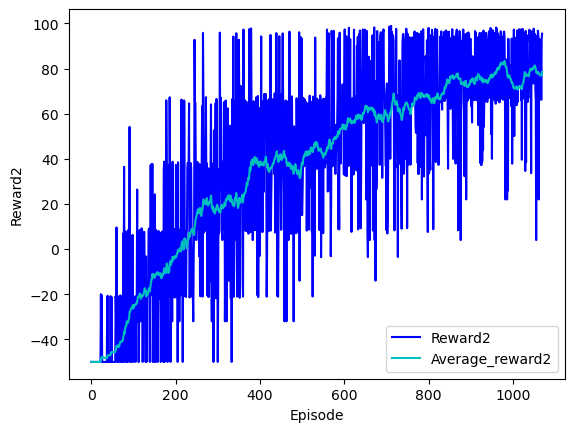

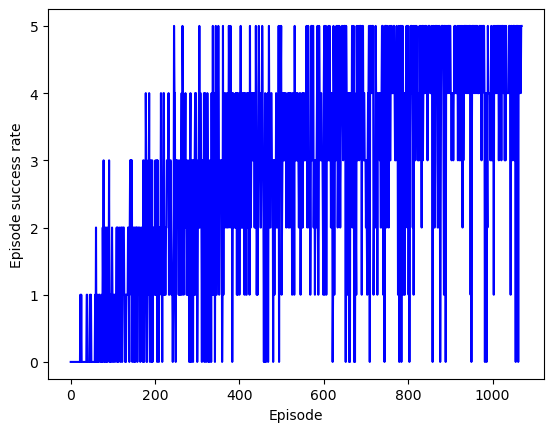

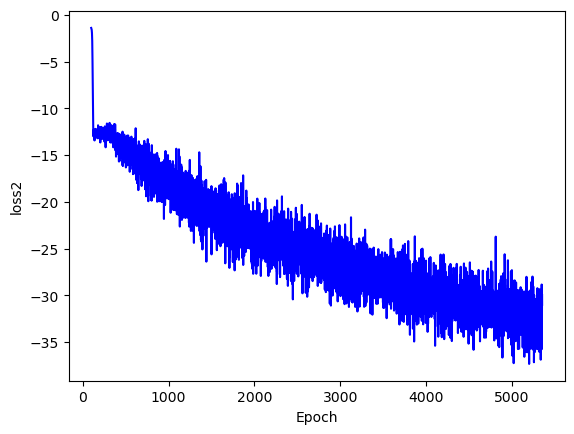

***** epoch 214 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 39ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 95642.61082472553
r_em 58863.64298126059
58863.64298126059
ReWard2/R0 11.772728596252119
reward2 is: 19.77272859625212
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step
***** frame 1 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 98180.69093395013
r_em 55478.27044932245
55478.27044932245
ReWard2/R0 11.09565408986449
reward2 is: 19.09565408986449
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 2 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 100488.30245226464
r_em 55882.03759812197
55882.03759812197
ReWard2/R0 11.176407519624394
reward2 is: 19.176407519624394
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step
***** frame 3 *****
1/1 [==============================] - 0s 39ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 99375.33120661788
r_em 55077.37364943083
55077.37364943083
ReWard2/R0 11.015474729886167
reward2 is: 19.015474729886165
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 4 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 99545.1397855617
r_em 54608.34230586033
54608.34230586033
ReWard2/R0 10.921668461172066
reward2 is: 18.921668461172068
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.0721753128324809
***** epoch 214 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96276.70489445442
r_em 55717.11872468378
55717.11872468378
ReWard2/R0 11.143423744936756
reward2 is: 19.143423744936754
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 6 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95638.00588799587
r_em 55445.15640288187
55445.15640288187
ReWard2/R0 11.089031280576373
reward2 is: 19.08903128057637
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 7 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96045.37018869515
r_em 55233.89859992664
55233.89859992664
ReWard2/R0 11.046779719985327
reward2 is: 19.046779719985327
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 8 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 9 *****
1/1 [==============================] - 0s 52ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95203.77918663924
r_em 55343.02273474586
55343.02273474586
ReWard2/R0 11.068604546949171
reward2 is: 19.06860454694917
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.07199505489848522
***** epoch 214 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 93733.54455538256
r_em 51039.449004489805
51039.449004489805
ReWard2/R0 10.207889800897961
reward2 is: 18.20788980089796
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step
***** frame 11 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 94171.11221416321
r_em 51296.29737963238
51296.29737963238
ReWard2/R0 10.259259475926475
reward2 is: 18.259259475926477
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step
***** frame 12 *****
1/1 [==============================] - 0s 36ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 14 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.07181524715890494
***** epoch 214 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 41ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 93285.09542563213
r_em 52573.292675040226
52573.292675040226
ReWard2/R0 10.514658535008046
reward2 is: 18.514658535008046
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step
***** frame 16 *****
1/1 [==============================] - 0s 42ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93410.41130570557
r

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 17 *****
1/1 [==============================] - 0s 49ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92766.21731707672
r_em 50855.83367037309
50855.83367037309
ReWard2/R0 10.171166734074617
reward2 is: 18.171166734074617
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 18 *****
1/1 [==============================] - 0s 43ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91894.34297118465
r_em 51965.72635366971
51965.72635366971
ReWard2/R0 10.39314527073394
reward2 is: 18.39314527073394
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 19 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.07163588848937898
***** epoch 214 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86128.07721512808
r_em 56000.4754253107
56000.4754253107
ReWard2/R0 11.20009508506214
reward2 is: 19.200095085062138
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 21 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89881.38135812318
r_em 56889.49559298401
56889.49559298401
ReWard2/R0 11.377899118596801
reward2 is: 19.3778991185968
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 23 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89060.66202383599
r_em 56914.38271069799
56914.38271069799
ReWard2/R0 11.382876542139597
reward2 is: 19.3828765421396
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 24 *****
1/1 [==============================] - 0s 43ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91310.60056124319
r_em 57662.38735751225
57662.38735751225
ReWard2/R0 11.53247747150245
reward2 is: 19.53247747150245
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
Epsilon_hist is: 0.07145697776835429


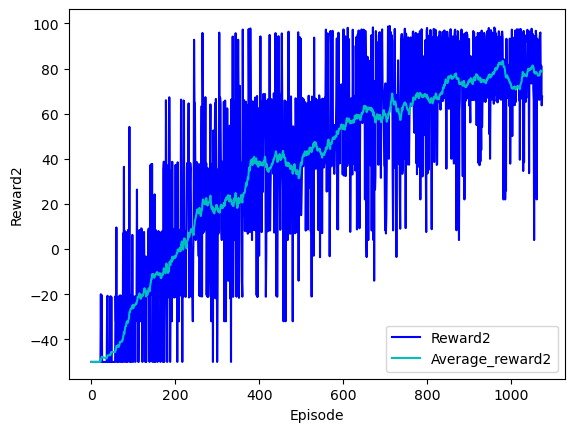

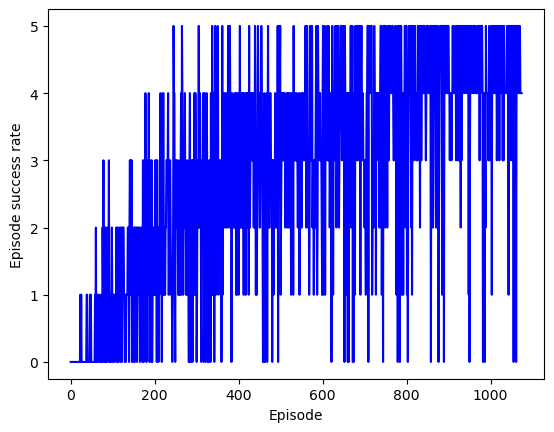

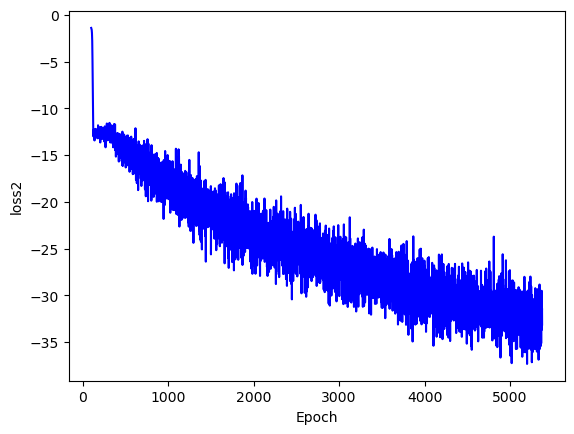

***** epoch 215 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 1 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84486.41530156153
r_em 56158.69410813733
56158.69410813733
ReWard2/R0 11.231738821627467
reward2 is: 19.231738821627467
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 2 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84739.1200409602
r_em 56276.9206364252
56276.9206364252
ReWard2/R0 11.25538412728504
reward2 is: 19.25538412728504
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 3 *****
1/1 [==============================] - 0s 40ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84472.43253188996
r_em 56215.590001410565
56215.590001410565
ReWard2/R0 11.243118000282113
reward2 is: 19.243118000282113
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 4 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82498.84263645699
r_em 56037.247603986
56037.247603986
ReWard2/R0 11.2074495207972
reward2 is: 19.207449520797198
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
Epsilon_hist is: 0.07127851387707895
***** epoch 215 episode 1 *****
***** frame 5 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 6 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83975.02936014453
r_em 53649.01724188763
53649.01724188763
ReWard2/R0 10.729803448377526
reward2 is: 18.729803448377524
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 7 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84425.33886043589
r_em 53427.57383070131
53427.57383070131
ReWard2/R0 10.685514766140262
reward2 is: 18.685514766140262
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 8 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85284.38301597288
r_em 53299.70267990122
53299.70267990122
ReWard2/R0 10.659940535980244
reward2 is: 18.659940535980244
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 9 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86614.94672046391
r_em 52829.54397613635
52829.54397613635
ReWard2/R0 10.565908795227271
reward2 is: 18.565908795227273
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.0711004956995951
***** epoch 215 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 86387.48370370083
r_em 52938.557730507404
52938.557730507404
ReWard2/R0 10.587711546101481
reward2 is: 18.58771154610148
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step
***** frame 11 *****
1/1 [==============================] - 0s 41ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 89321.5615041898
r_em 53705.747883928416
53705.747883928416
ReWard2/R0 10.741149576785682
reward2 is: 18.74114957678568
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step
***** frame 12 *****
1/1 [==============================] - 0s 41ms/step
w

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 21 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96284.66952963668
r_em 54623.73202457778
54623.73202457778
ReWard2/R0 10.924746404915556
reward2 is: 18.924746404915556
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 22 *****
1/1 [==============================] - 0s 47ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 99591.68087413721
r_em 54994.522121978385
54994.522121978385
ReWard2/R0 10.998904424395677
reward2 is: 18.998904424395676
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 23 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 100298.624502098
r_em 54866.02014135395
54866.02014135395
ReWard2/R0 10.97320402827079
reward2 is: 18.97320402827079
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 24 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 101099.27597360755
r_em 54737.559246585435
54737.559246585435
ReWard2/R0 10.947511849317086
reward2 is: 18.947511849317088
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.07056910433207873


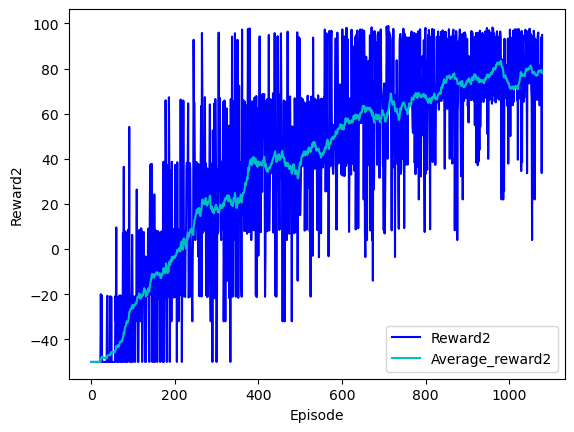

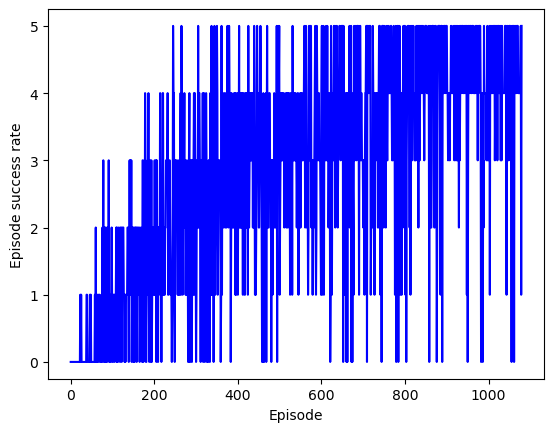

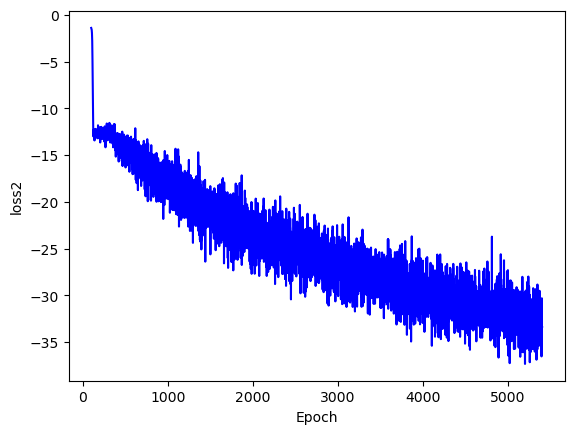

***** epoch 216 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92493.29251317786
r_em 57652.295362257224
57652.295362257224
ReWard2/R0 11.530459072451444
reward2 is: 19.530459072451443
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 1 *****
1/1 [==============================] - 0s 49ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93508.26036664598
r_em 57427.090858419266
57427.090858419266
ReWard2/R0 11.485418171683854
reward2 is: 19.485418171683854
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 2 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93520.40781457542
r_em 56655.92607092467
56655.92607092467
ReWard2/R0 11.331185214184933
reward2 is: 19.331185214184934
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 3 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93143.61927841508
r_em 56661.89015832883
56661.89015832883
ReWard2/R0 11.332378031665767
reward2 is: 19.33237803166577
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 4 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93840.26917253583
r_em 56615.80250911027
56615.80250911027
ReWard2/R0 11.323160501822054
reward2 is: 19.323160501822052
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.07039285790582007
***** epoch 216 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83629.89652761324
r_em 56349.05265960043
56349.05265960043
ReWard2/R0 11.269810531920086
reward2 is: 19.269810531920086
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 6 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83305.0810259438
r_em 56330.03276672382
56330.03276672382
ReWard2/R0 11.266006553344765
reward2 is: 19.266006553344766
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 7 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83820.09659387375
r_em 55967.517104688086
55967.517104688086
ReWard2/R0 11.193503420937617
reward2 is: 19.193503420937617
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 8 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83445.13298233878
r_em 56056.58229030675
56056.58229030675
ReWard2/R0 11.21131645806135
reward2 is: 19.21131645806135
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 9 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82506.01107016088
r_em 55646.28488344248
55646.28488344248
ReWard2/R0 11.129256976688495
reward2 is: 19.129256976688495
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.07021705165523123
***** epoch 216 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87992.03893495142
r_em 54650.21242771436
54650.21242771436
ReWard2/R0 10.930042485542872
reward2 is: 18.93004248554287
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 11 *****
1/1 [==============================] - 0s 46ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87554.07022771546
r_em 55653.79127510144
55653.79127510144
ReWard2/R0 11.130758255020288
reward2 is: 19.13075825502029
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 9ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 12 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83787.01750138233
r_em 55282.180962469516
55282.180962469516
ReWard2/R0 11.056436192493903
reward2 is: 19.056436192493905
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 13 *****
1/1 [==============================] - 0s 39ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86700.60590795713
r_em 55234.34773956661
55234.34773956661
ReWard2/R0 11.046869547913323
reward2 is: 19.046869547913325
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 14 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82646.34721559717
r_em 54725.39590029595
54725.39590029595
ReWard2/R0 10.94507918005919
reward2 is: 18.94507918005919
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.07004168448097293
***** epoch 216 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 46ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 93577.3646887644
r_em 54768.82952151224
54768.82952151224
ReWard2/R0 10.953765904302449
reward2 is: 18.95376590430245
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step
***** frame 16 *****
1/1 [==============================] - 0s 45ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 93088.70592126955
r_em 54739.51689714774
54739.51689714774
ReWard2/R0 10.947903379429547
reward2 is: 18.947903379429547
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step
***** frame 17 *****
1/1 [==============================] - 0s 34ms/step
we 

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 22 *****
1/1 [==============================] - 0s 48ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 98568.38301681809
r_em 52669.117029794215
52669.117029794215
ReWard2/R0 10.533823405958843
reward2 is: 18.53382340595884
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 23 *****
1/1 [==============================] - 0s 46ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 98343.02483159742
r_em 50695.548577716734
50695.548577716734
ReWard2/R0 10.139109715543347
reward2 is: 18.13910971554335
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 24 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 97451.02640503857
r_em 53444.69942255304
53444.69942255304
ReWard2/R0 10.688939884510608
reward2 is: 18.68893988451061
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 10ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.069692262977812


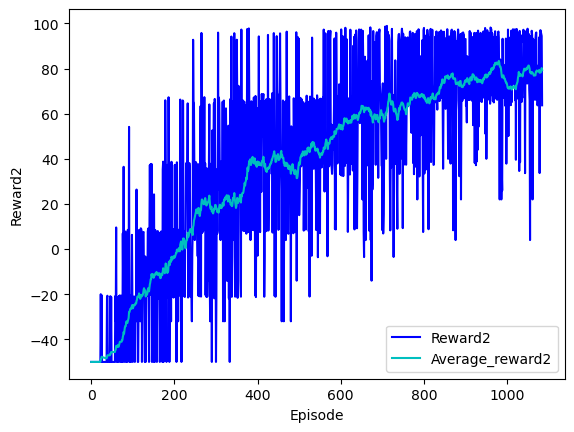

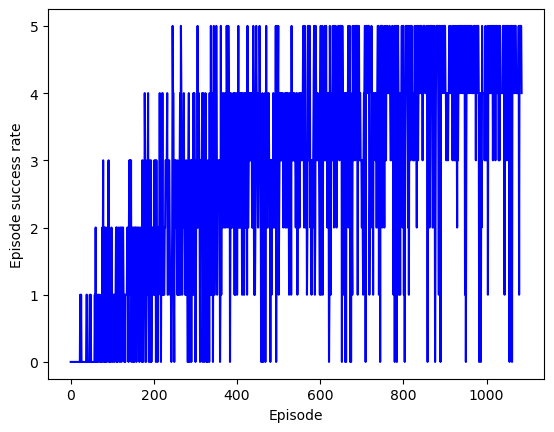

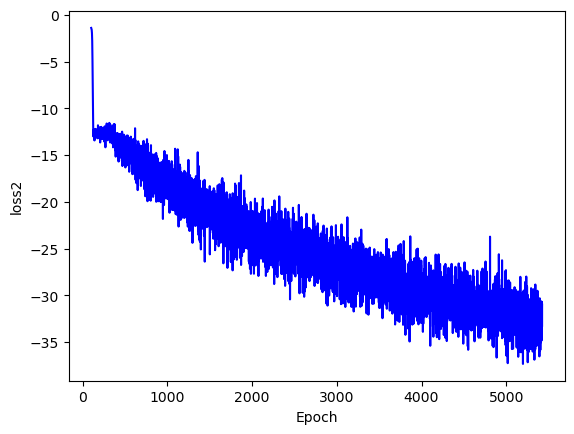

***** epoch 217 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85862.50175389266
r_em 58821.856458081835
58821.856458081835
ReWard2/R0 11.764371291616367
reward2 is: 19.764371291616367
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 1 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85168.63243185406
r_em 58450.96646412116
58450.96646412116
ReWard2/R0 11.690193292824231
reward2 is: 19.690193292824233
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 2 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85443.88515761736
r_em 58685.630758613355
58685.630758613355
ReWard2/R0 11.737126151722672
reward2 is: 19.73712615172267
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 3 *****
1/1 [==============================] - 0s 42ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85778.06033228696
r_em 58693.093944709886
58693.093944709886
ReWard2/R0 11.738618788941977
reward2 is: 19.738618788941977
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 4 *****
1/1 [==============================] - 0s 41ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85612.24791811632
r_em 58760.88604719682
58760.88604719682
ReWard2/R0 11.752177209439365
reward2 is: 19.752177209439367
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.06951820646393138
***** epoch 217 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86220.95121571823
r_em 57045.92317813891
57045.92317813891
ReWard2/R0 11.409184635627781
reward2 is: 19.40918463562778
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 6 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88296.54348258825
r_em 57496.780699564755
57496.780699564755
ReWard2/R0 11.499356139912951
reward2 is: 19.49935613991295
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 7 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93016.6294990397
r_em 56701.18638771105
56701.18638771105
ReWard2/R0 11.34023727754221
reward2 is: 19.340237277542208
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 8 *****
1/1 [==============================] - 0s 50ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93009.74863657806
r_em 56861.91616668368
56861.91616668368
ReWard2/R0 11.372383233336736
reward2 is: 19.372383233336734
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 9 *****
1/1 [==============================] - 0s 49ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94562.472229388
r_em 56563.58472987023
56563.58472987023
ReWard2/R0 11.312716945974046
reward2 is: 19.312716945974046
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.0693445846564117
***** epoch 217 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92729.0467295309
r_em 55342.58768952944
55342.58768952944
ReWard2/R0 11.068517537905889
reward2 is: 19.06851753790589
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 11 *****
1/1 [==============================] - 0s 44ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89150.08432246596
r_em 56091.62212170884
56091.62212170884
ReWard2/R0 11.218324424341768
reward2 is: 19.218324424341766
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 12 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90713.70089582703
r_em 56744.551904719876
56744.551904719876
ReWard2/R0 11.348910380943975
reward2 is: 19.348910380943977
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 13 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90681.24681836765
r_em 57180.54342515975
57180.54342515975
ReWard2/R0 11.43610868503195
reward2 is: 19.43610868503195
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 11ms/step
***** frame 14 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.06917139646957328
***** epoch 217 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 45ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90340.43208002341
r_em 58138.2809128138
58138.2809128138
ReWard2/R0 11.627656182562761
reward2 is: 19.62765618256276
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 16 *****
1/1 [==============================] - 0s 45ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89375.3808507433
r_em 57235.012475175696
57235.012475175696
ReWard2/R0 11.44700249503514
reward2 is: 19.44700249503514
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 17 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88194.82754908188
r_em 57174.88375624868
57174.88375624868
ReWard2/R0 11.434976751249737
reward2 is: 19.434976751249735
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 18 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 19 *****
1/1 [==============================] - 0s 40ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87986.57392508759
r_em 58063.064168782475
58063.064168782475
ReWard2/R0 11.612612833756495
reward2 is: 19.612612833756494
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.0689986408204479
***** epoch 217 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86997.1833624517
r_em 53727.98622248246
53727.98622248246
ReWard2/R0 10.745597244496492
reward2 is: 18.745597244496494
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 21 *****
1/1 [==============================] - 0s 50ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88679.35890678511
r_em 53870.06148232135
53870.06148232135
ReWard2/R0 10.774012296464269
reward2 is: 18.77401229646427
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 22 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90354.04682515874
r_em 54901.0861632395
54901.0861632395
ReWard2/R0 10.9802172326479
reward2 is: 18.980217232647902
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 23 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90010.22880895881
r_em 53486.09650158809
53486.09650158809
ReWard2/R0 10.697219300317617
reward2 is: 18.697219300317617
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 24 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91230.12194182018
r_em 53001.81093553836
53001.81093553836
ReWard2/R0 10.600362187107672
reward2 is: 18.60036218710767
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.0688263166287721


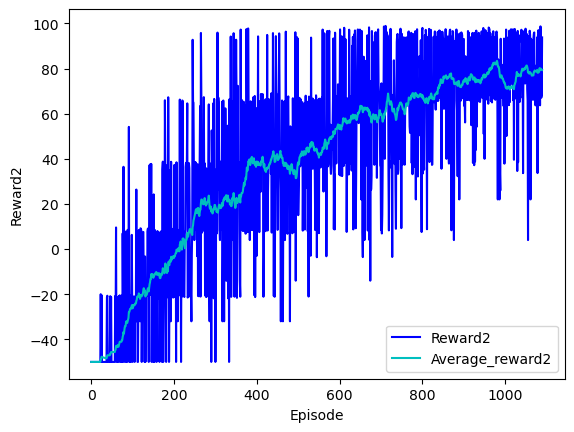

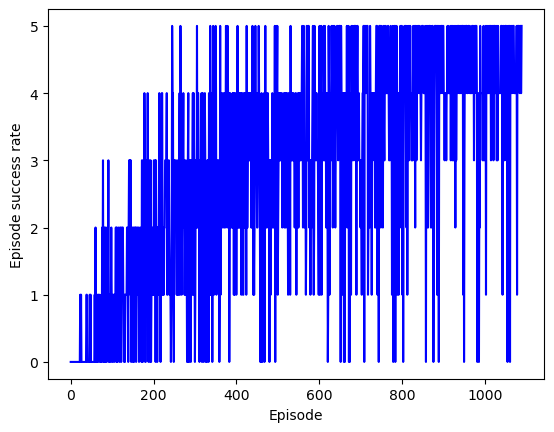

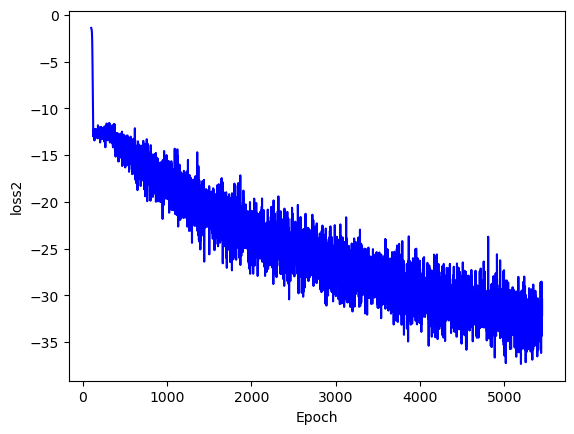

***** epoch 218 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82464.3688403132
r_em 52909.29078471782
52909.29078471782
ReWard2/R0 10.581858156943564
reward2 is: 18.581858156943564
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 1 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82774.44247954048
r_em 54369.46077868718
54369.46077868718
ReWard2/R0 10.873892155737435
reward2 is: 18.873892155737437
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 2 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81559.24043473054
r_em 55751.95787335006
55751.95787335006
ReWard2/R0 11.150391574670012
reward2 is: 19.15039157467001
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 3 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81471.30081505378
r_em 55644.9457230837
55644.9457230837
ReWard2/R0 11.12898914461674
reward2 is: 19.12898914461674
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 4 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80888.58050500182
r_em 53610.33806124822
53610.33806124822
ReWard2/R0 10.722067612249644
reward2 is: 18.722067612249646
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.06865442281698036
***** epoch 218 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89170.85545258856
r_em 56053.21755004583
56053.21755004583
ReWard2/R0 11.210643510009167
reward2 is: 19.210643510009167
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 6 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88600.23506553749
r_em 55765.83126003665
55765.83126003665
ReWard2/R0 11.15316625200733
reward2 is: 19.15316625200733
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 7 *****
1/1 [==============================] - 0s 46ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89282.61096597515
r_em 55109.84355893241
55109.84355893241
ReWard2/R0 11.021968711786482
reward2 is: 19.02196871178648
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 8 *****
1/1 [==============================] - 0s 50ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91150.43925830766
r_em 55957.08800131001
55957.08800131001
ReWard2/R0 11.191417600262001
reward2 is: 19.191417600262
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 9 *****
1/1 [==============================] - 0s 43ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86460.45880841828
r_em 55540.11440484859
55540.11440484859
ReWard2/R0 11.108022880969717
reward2 is: 19.108022880969717
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.06848295831019839
***** epoch 218 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93840.38366159548
r_em 53348.18181826879
53348.18181826879
ReWard2/R0 10.669636363653758
reward2 is: 18.66963636365376
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 11 *****
1/1 [==============================] - 0s 46ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94253.63054511716
r_em 53696.513735685934
53696.513735685934
ReWard2/R0 10.739302747137186
reward2 is: 18.739302747137188
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 12 *****
1/1 [==============================] - 0s 46ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 13 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 14 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94058.87329075468
r_em 54896.57543901513
54896.57543901513
ReWard2/R0 10.979315087803025
reward2 is: 18.979315087803023
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [================

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.0683119220362364
***** epoch 218 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86457.83253471798
r_em 56588.02982700099
56588.02982700099
ReWard2/R0 11.317605965400197
reward2 is: 19.317605965400197
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 16 *****
1/1 [==============================] - 0s 39ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85770.04586356098
r_em 55964.320438
55964.320438
ReWard2/R0 11.1928640876
reward2 is: 19.1928640876
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 17 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89021.48859901378
r_em 56501.95413241591
56501.95413241591
ReWard2/R0 11.30039082648318
reward2 is: 19.30039082648318
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 18 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88656.00797771999
r_em 56996.62815166313
56996.62815166313
ReWard2/R0 11.399325630332626
reward2 is: 19.399325630332626
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 19 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89458.74657494019
r_em 56677.879434373936
56677.879434373936
ReWard2/R0 11.335575886874787
reward2 is: 19.335575886874786
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.06814131292558234
***** epoch 218 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 46ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88442.934709336
r_em 57448.722305298856
57448.722305298856
ReWard2/R0 11.489744461059772
reward2 is: 19.48974446105977
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 9ms/step
***** frame 21 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92089.0046911195
r_em 57132.11367759036
57132.11367759036
ReWard2/R0 11.426422735518072
reward2 is: 19.426422735518074
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 22 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91189.15427018322
r_em 57062.36144169222
57062.36144169222
ReWard2/R0 11.412472288338444
reward2 is: 19.412472288338442
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 9ms/step
***** frame 23 *****
1/1 [==============================] - 0s 40ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90553.65582786861
r_em 56805.538085890505
56805.538085890505
ReWard2/R0 11.361107617178101
reward2 is: 19.3611076171781
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 24 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90485.55690045457
r_em 56602.588073518156
56602.588073518156
ReWard2/R0 11.32051761470363
reward2 is: 19.320517614703633
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.06797112991139537


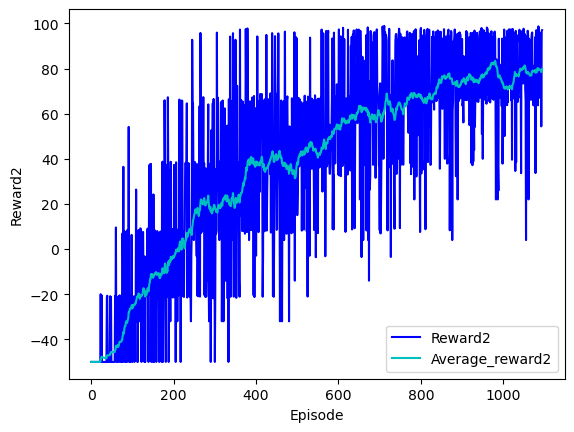

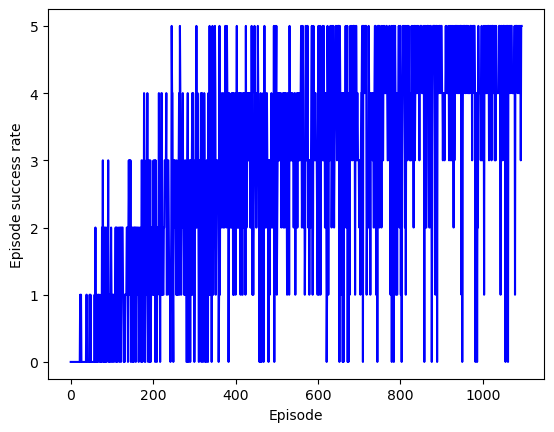

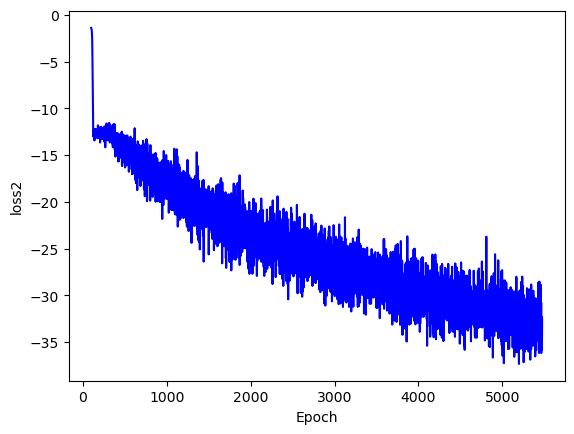

***** epoch 219 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 95996.4178830308
r_em 54591.68466005327
54591.68466005327
ReWard2/R0 10.918336932010655
reward2 is: 18.918336932010654
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step
***** frame 1 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 94715.5893146295
r_em 54584.081313902076
54584.081313902076
ReWard2/R0 10.916816262780415
reward2 is: 18.916816262780415
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step
***** frame 2 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 96523.8369046

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 4 *****
1/1 [==============================] - 0s 41ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96656.19491610763
r_em 54356.09117680513
54356.09117680513
ReWard2/R0 10.871218235361026
reward2 is: 18.871218235361027
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.067801371929499
***** epoch 219 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 42ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85766.20851958716
r_em 56689.2040934358
56689.2040934358
ReWard2/R0 11.33784081868716
reward2 is: 19.337840818687162
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 6 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85811.06996856033
r_em 56998.77217959315
56998.77217959315
ReWard2/R0 11.39975443591863
reward2 is: 19.39975443591863
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 7 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86902.6628426383
r_em 56888.43564017608
56888.43564017608
ReWard2/R0 11.377687128035216
reward2 is: 19.377687128035216
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 9ms/step
***** frame 8 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87391.04934938735
r_em 57586.932968068104
57586.932968068104
ReWard2/R0 11.51738659361362
reward2 is: 19.517386593613622
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 9 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.06763203791837455
***** epoch 219 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82576.90765957405
r_em 55775.426500343456
55775.426500343456
ReWard2/R0 11.155085300068691
reward2 is: 19.15508530006869
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 11 *****
1/1 [==============================] - 0s 42ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87331.43138292088
r_em 55439.67495977545
55439.67495977545
ReWard2/R0 11.087934991955091
reward2 is: 19.08793499195509
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 12 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91618.34065601397
r_em 54637.777006611956
54637.777006611956
ReWard2/R0 10.92755540132239
reward2 is: 18.92755540132239
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 13 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85969.24044035455
r_em 55148.89213467204
55148.89213467204
ReWard2/R0 11.029778426934408
reward2 is: 19.029778426934406
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 14 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90747.302616829
r_em 55222.25969248826
55222.25969248826
ReWard2/R0 11.044451938497652
reward2 is: 19.04445193849765
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.06746312681915449
***** epoch 219 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92911.41698289996
r_em 54692.15396019043
54692.15396019043
ReWard2/R0 10.938430792038085
reward2 is: 18.938430792038083
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 16 *****
1/1 [==============================] - 0s 39ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 17 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 18 *****
1/1 [==============================] - 0s 46ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 19 *****
1/1 [==============================] - 0s 49ms/st

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 22 *****
1/1 [==============================] - 0s 45ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 23 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 24 *****
1/1 [==============================] - 0s 47ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.06712656913417349


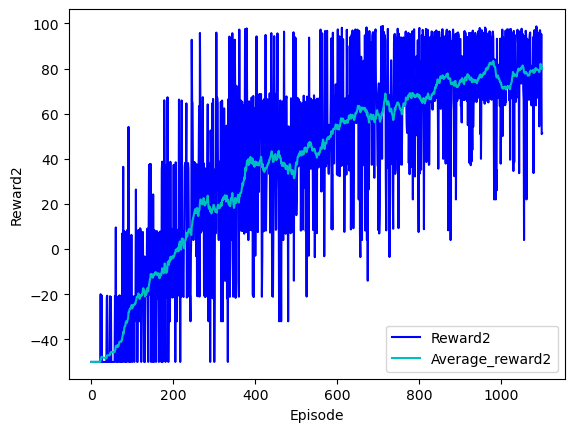

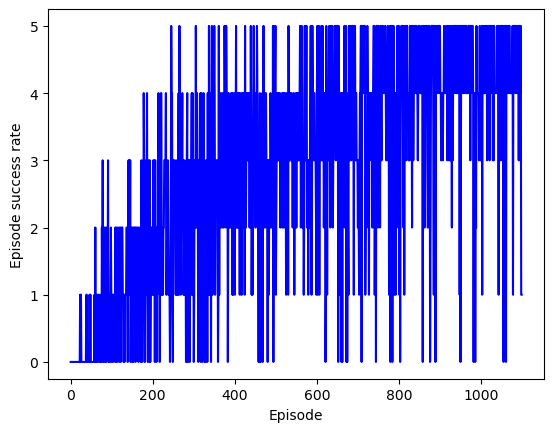

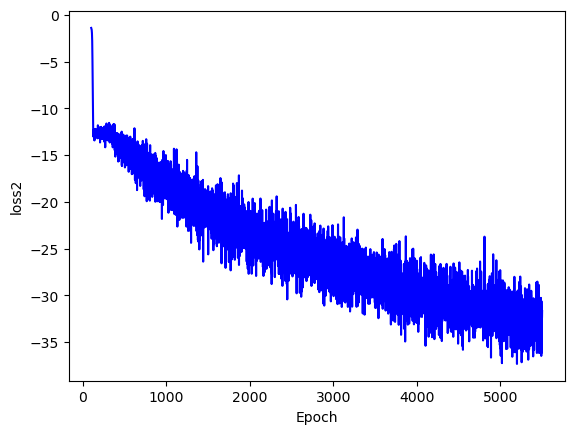

***** epoch 220 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90141.76706843804
r_em 50943.89196476088
50943.89196476088
ReWard2/R0 10.188778392952175
reward2 is: 18.188778392952173
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 1 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90244.2364643569
r_em 52241.12355103041
52241.12355103041
ReWard2/R0 10.448224710206082
reward2 is: 18.448224710206084
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 2 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90420.50332838687
r_em 53446.322323048524
53446.322323048524
ReWard2/R0 10.689264464609705
reward2 is: 18.689264464609707
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 3 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88384.84589034962
r_em 53126.65483749905
53126.65483749905
ReWard2/R0 10.62533096749981
reward2 is: 18.62533096749981
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 4 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92419.70669826452
r_em 53675.284317023434
53675.284317023434
ReWard2/R0 10.735056863404687
reward2 is: 18.735056863404687
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
Epsilon_hist is: 0.06695892044387368
***** epoch 220 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 39ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94364.36479027648
r_em 57259.05591620598
57259.05591620598
ReWard2/R0 11.451811183241196
reward2 is: 19.451811183241198
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 6 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92596.7339987421
r_em 56475.35855840709
56475.35855840709
ReWard2/R0 11.295071711681418
reward2 is: 19.295071711681416
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 7 *****
1/1 [==============================] - 0s 41ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91744.44266016998
r_em 55232.08228568361
55232.08228568361
ReWard2/R0 11.046416457136722
reward2 is: 19.046416457136722
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 8 *****
1/1 [==============================] - 0s 49ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92715.23376582193
r_em 55467.925149883566
55467.925149883566
ReWard2/R0 11.093585029976714
reward2 is: 19.093585029976715
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 9 *****
1/1 [==============================] - 0s 45ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93193.45282216415
r_em 55200.73923724893
55200.73923724893
ReWard2/R0 11.040147847449786
reward2 is: 19.040147847449788
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.0667916904563874
***** epoch 220 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96697.93551167574
r_em 54654.603045637974
54654.603045637974
ReWard2/R0 10.930920609127595
reward2 is: 18.930920609127597
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 11 *****
1/1 [==============================] - 0s 40ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95933.55653973852
r_em 54538.3622652626
54538.3622652626
ReWard2/R0 10.90767245305252
reward2 is: 18.90767245305252
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 9ms/step
***** frame 12 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96570.88339655053
r_em 55572.50260568084
55572.50260568084
ReWard2/R0 11.114500521136168
reward2 is: 19.11450052113617
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 13 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96144.99979718537
r_em 54806.10929755973
54806.10929755973
ReWard2/R0 10.961221859511946
reward2 is: 18.961221859511944
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 14 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.06662487812600386
***** epoch 220 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85415.41538467574
r_em 55141.440521429926
55141.440521429926
ReWard2/R0 11.028288104285986
reward2 is: 19.028288104285984
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 16 *****
1/1 [==============================] - 0s 45ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86506.06785318966
r_em 54493.41147550235
54493.41147550235
ReWard2/R0 10.89868229510047
reward2 is: 18.89868229510047
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 17 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85162.0290854208
r_em 55470.86970217842
55470.86970217842
ReWard2/R0 11.094173940435683
reward2 is: 19.09417394043568
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 18 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86427.32251373923
r_em 55699.60593459803
55699.60593459803
ReWard2/R0 11.139921186919606
reward2 is: 19.139921186919608
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 19 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86191.6979043409
r_em 54517.02081477029
54517.02081477029
ReWard2/R0 10.903404162954057
reward2 is: 18.903404162954057
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.06645848240962389
***** epoch 220 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81527.79425125073
r_em 52448.41270180001
52448.41270180001
ReWard2/R0 10.489682540360002
reward2 is: 18.48968254036
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 21 *****
1/1 [==============================] - 0s 48ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 22 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79946.39947420337
r_em 52997.10876986034
52997.10876986034
ReWard2/R0 10.599421753972067
reward2 is: 18.599421753972067
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 23 *****
1/1 [==============================] - 0s 44ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80233.12391036913
r_em 53851.0844120527
53851.0844120527
ReWard2/R0 10.77021688241054
reward2 is: 18.77021688241054
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 24 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82452.49463640348
r_em 53713.34904423193
53713.34904423193
ReWard2/R0 10.742669808846387
reward2 is: 18.742669808846387
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.06629250226675355


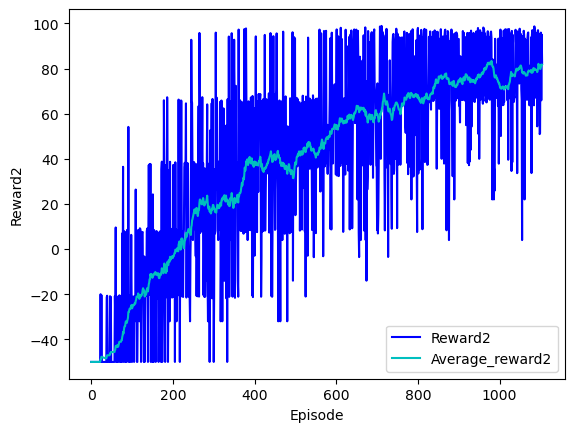

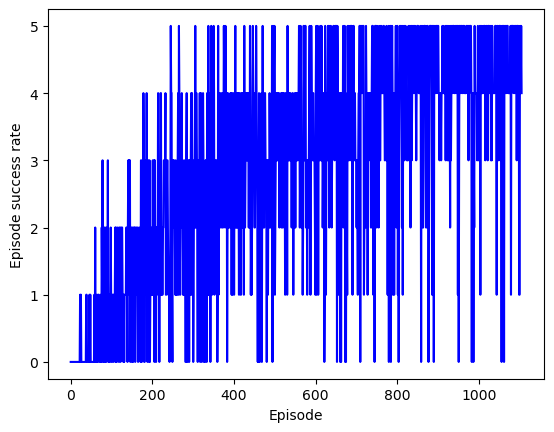

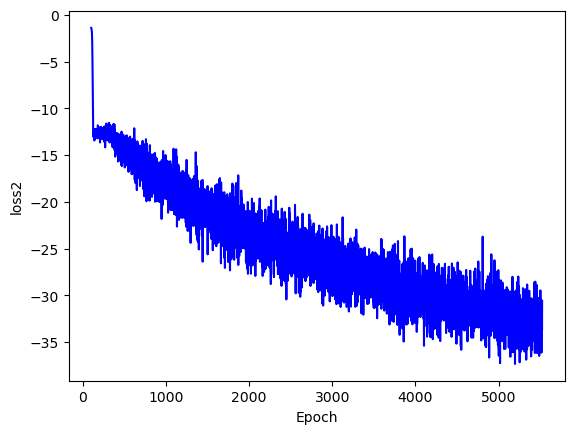

***** epoch 221 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80317.5860757221
r_em 54651.123195804576
54651.123195804576
ReWard2/R0 10.930224639160915
reward2 is: 18.930224639160915
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 1 *****
1/1 [==============================] - 0s 42ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79306.34443818242
r_em 55288.96213062818
55288.96213062818
ReWard2/R0 11.057792426125635
reward2 is: 19.057792426125637
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 2 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80342.17623742673
r_em 54574.62073022974
54574.62073022974
ReWard2/R0 10.914924146045948
reward2 is: 18.914924146045948
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 3 *****
1/1 [==============================] - 0s 46ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81415.98847758009
r_em 55576.803247078926
55576.803247078926
ReWard2/R0 11.115360649415786
reward2 is: 19.115360649415784
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 4 *****
1/1 [==============================] - 0s 45ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79969.8881844318
r_em 54983.63015963205
54983.63015963205
ReWard2/R0 10.996726031926409
reward2 is: 18.996726031926407
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.06612693665949743
***** epoch 221 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84524.7893808953
r_em 55290.00436172626
55290.00436172626
ReWard2/R0 11.058000872345252
reward2 is: 19.058000872345254
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 6 *****
1/1 [==============================] - 0s 43ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84693.95406976699
r_em 55782.3282692598
55782.3282692598
ReWard2/R0 11.15646565385196
reward2 is: 19.15646565385196
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 7 *****
1/1 [==============================] - 0s 48ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82463.81830544159
r_em 56713.18958483745
56713.18958483745
ReWard2/R0 11.34263791696749
reward2 is: 19.34263791696749
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 8 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82175.86340545576
r_em 56735.95520399594
56735.95520399594
ReWard2/R0 11.347191040799188
reward2 is: 19.34719104079919
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 9 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78032.53123088274
r_em 56758.048470329304
56758.048470329304
ReWard2/R0 11.35160969406586
reward2 is: 19.35160969406586
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.06596178455255233
***** epoch 221 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85213.31234328562
r_em 52058.55436620637
52058.55436620637
ReWard2/R0 10.411710873241274
reward2 is: 18.411710873241276
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 11 *****
1/1 [==============================] - 0s 50ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85483.7456286497
r_em 52672.617521467466
52672.617521467466
ReWard2/R0 10.534523504293492
reward2 is: 18.534523504293492
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 12 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88979.11327906928
r_em 52665.481346530985
52665.481346530985
ReWard2/R0 10.533096269306197
reward2 is: 18.5330962693062
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 13 *****
1/1 [==============================] - 0s 43ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86559.11757888032
r_em 52625.59517932071
52625.59517932071
ReWard2/R0 10.525119035864142
reward2 is: 18.525119035864144
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 14 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.06579704491320074
***** epoch 221 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 48ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91014.72013382771
r_em 54275.95490478014
54275.95490478014
ReWard2/R0 10.855190980956028
reward2 is: 18.855190980956028
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 16 *****
1/1 [==============================] - 0s 43ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91686.91487910658
r_em 53555.064127773374
53555.064127773374
ReWard2/R0 10.711012825554675
reward2 is: 18.711012825554675
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 17 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91251.09496945082
r_em 53205.11397745531
53205.11397745531
ReWard2/R0 10.641022795491061
reward2 is: 18.64102279549106
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 18 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91601.55756023
r_em 53792.90189475006
53792.90189475006
ReWard2/R0 10.758580378950011
reward2 is: 18.75858037895001
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 19 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90120.28707580804
r_em 54102.11000809327
54102.11000809327
ReWard2/R0 10.820422001618653
reward2 is: 18.820422001618653
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.06563271671130429
***** epoch 221 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Output is: optimal_inaccurate
r_ur 92897.58924937462
r_em 57396.93651152842
57396.93651152842
ReWard2/R0 11.479387302305685
reward2 is: 19.479387302305685
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step
***** frame 21 *****
1/1 [==============================] - 0s 42ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92873.86036348918
r_em 57211.54628241225
57211.54628241225
ReWard2/R0 11.442309256482451
reward2 is: 19.442309256482453
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 22 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92997.91515461024
r_em 57579.47029808401
57579.47029808401
ReWard2/R0 11.515894059616802
reward2 is: 19.5158940596168
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 23 *****
1/1 [==============================] - 0s 48ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93219.62326436662
r_em 58019.561746499945
58019.561746499945
ReWard2/R0 11.60391234929999
reward2 is: 19.60391234929999
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 24 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93902.29405384907
r_em 57653.9499804277
57653.9499804277
ReWard2/R0 11.53078999608554
reward2 is: 19.530789996085538
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.06546879891929745


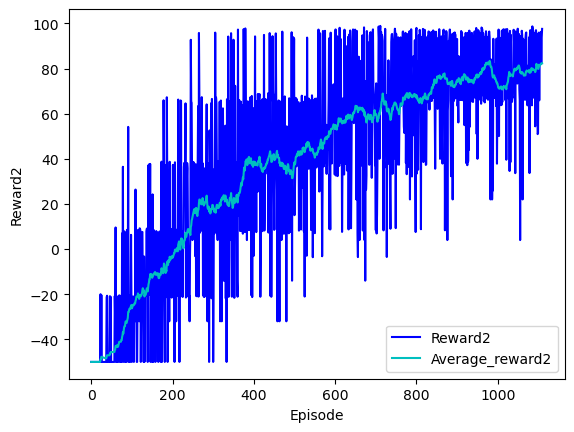

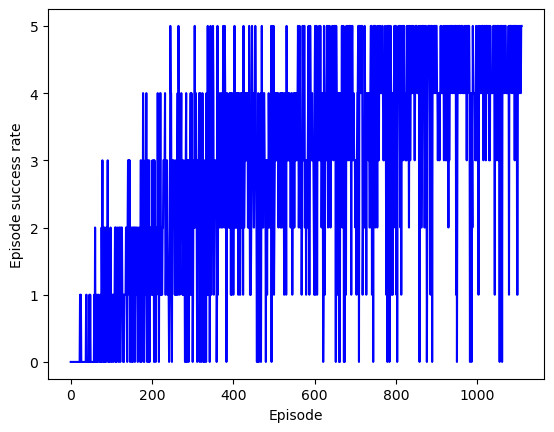

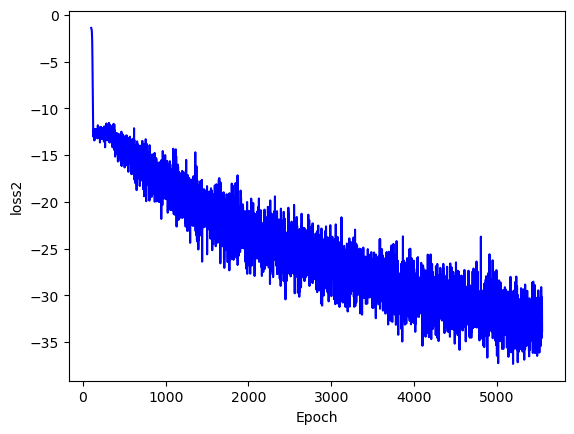

***** epoch 222 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 77027.52569010526
r_em 53614.11977842378
53614.11977842378
ReWard2/R0 10.722823955684756
reward2 is: 18.722823955684756
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step
***** frame 1 *****
1/1 [==============================] - 0s 45ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 76783.74620133989
r_em 53317.69466109806
53317.69466109806
ReWard2/R0 10.663538932219613
reward2 is: 18.663538932219613
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step
***** frame 2 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 76479.9363312

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 4 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 76670.58778860653
r_em 51740.273354936435
51740.273354936435
ReWard2/R0 10.348054670987286
reward2 is: 18.34805467098729
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.06530529051218098
***** epoch 222 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 97158.95731229322
r_em 57902.758849859805
57902.758849859805
ReWard2/R0 11.580551769971962
reward2 is: 19.58055176997196
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 6 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 97120.9927015336
r_em 57629.97106213786
57629.97106213786
ReWard2/R0 11.525994212427573
reward2 is: 19.525994212427573
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 7 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96188.81377557263
r_em 56608.04243954785
56608.04243954785
ReWard2/R0 11.32160848790957
reward2 is: 19.32160848790957
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 8 *****
1/1 [==============================] - 0s 48ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96771.30400386237
r_em 55705.18807955914
55705.18807955914
ReWard2/R0 11.141037615911829
reward2 is: 19.141037615911827
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 9 *****
1/1 [==============================] - 0s 47ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 97502.7316920886
r_em 56420.02126004518
56420.02126004518
ReWard2/R0 11.284004252009035
reward2 is: 19.284004252009034
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.0651421904675156
***** epoch 222 episode 2 *****
***** frame 10 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 11 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90175.68123221517
r_em 54715.42444507073
54715.42444507073
ReWard2/R0 10.943084889014145
reward2 is: 18.943084889014145
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 12 *****
1/1 [==============================] - 0s 42ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90773.41104442903
r_em 54550.454955379086
54550.454955379086
ReWard2/R0 10.910090991075817
reward2 is: 18.91009099107582
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 13 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91547.84324844337
r_em 55279.58541711105
55279.58541711105
ReWard2/R0 11.055917083422209
reward2 is: 19.05591708342221
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 14 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89679.59081605164
r_em 54820.48122760896
54820.48122760896
ReWard2/R0 10.964096245521791
reward2 is: 18.96409624552179
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.06497949776541559
***** epoch 222 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80063.82648618422
r_em 54920.7357156099
54920.7357156099
ReWard2/R0 10.98414714312198
reward2 is: 18.98414714312198
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 17 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80767.93714997271
r_em 53417.81734917404
53417.81734917404
ReWard2/R0 10.683563469834807
reward2 is: 18.68356346983481
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 18 *****
1/1 [==============================] - 0s 47ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 19 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.06481721138854242
***** epoch 222 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85499.72666021727
r_em 54851.98646358154
54851.98646358154
ReWard2/R0 10.970397292716308
reward2 is: 18.970397292716306
total number of ur2 RBs: 8.0
tot

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 21 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83840.35903209331
r_em 55091.516188100424
55091.516188100424
ReWard2/R0 11.018303237620085
reward2 is: 19.018303237620085
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 22 *****
1/1 [==============================] - 0s 56ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84811.8626584375
r_em 55905.97545490814
55905.97545490814
ReWard2/R0 11.181195090981628
reward2 is: 19.18119509098163
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 23 *****
1/1 [==============================] - 0s 55ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85107.79478380366
r_em 56856.01594235308
56856.01594235308
ReWard2/R0 11.371203188470616
reward2 is: 19.371203188470616
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 24 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87227.50888222412
r_em 56256.292257451416
56256.292257451416
ReWard2/R0 11.251258451490283
reward2 is: 19.251258451490283
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
Epsilon_hist is: 0.06465533032209828


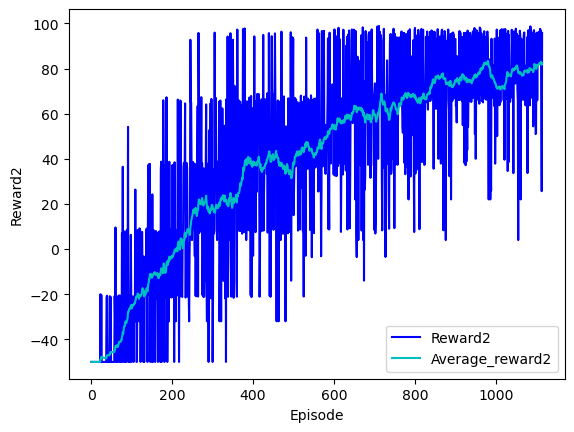

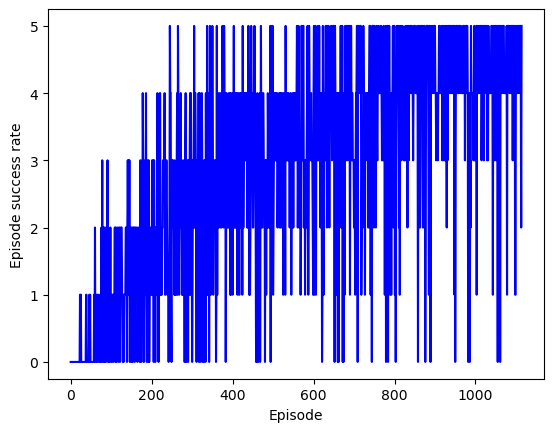

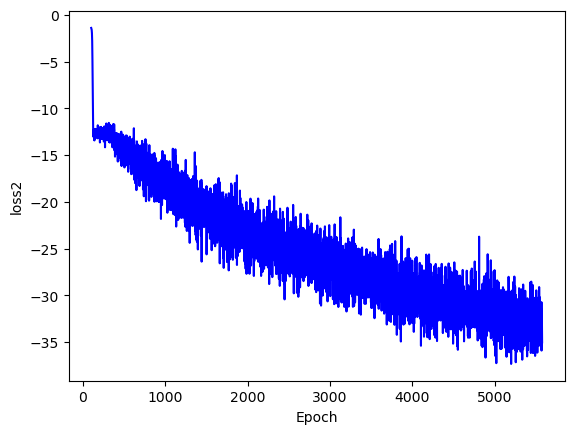

***** epoch 223 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84885.2139210353
r_em 55384.40167086843
55384.40167086843
ReWard2/R0 11.076880334173685
reward2 is: 19.076880334173687
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 1 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85203.9816103692
r_em 55712.28338342845
55712.28338342845
ReWard2/R0 11.14245667668569
reward2 is: 19.14245667668569
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 2 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88206.06429644741
r_em 55403.577569243775
55403.577569243775
ReWard2/R0 11.080715513848755
reward2 is: 19.080715513848755
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 3 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 84947.65266893347
r_em 54647.844204282126
54647.844204282126
ReWard2/R0 10.929568840856426
reward2 is: 18.929568840856426
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step
***** frame 4 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 86459.11078028007
r_em 54525.470500280244
54525.470500280244
ReWard2/R0 10.905094100056049
reward2 is: 18.905094100056047
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.06449385355381988
***** epoch 223 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 40ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 11 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 12 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 13 *****
1/1 [==============================] - 0s 47ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 14 *****
1/1 [==============================] - 0s 29ms/st

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.06417210887534146
***** epoch 223 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 16 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 17 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90230.444748337
r_em 50714.79378349993
50714.79378349993
ReWard2/R0 10.142958756699986
reward2 is: 18.142958756699986
total number 

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 18 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 19 *****
1/1 [==============================] - 0s 43ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88009.64853254955
r_em 51513.07825508901
51513.07825508901
ReWard2/R0 10.3026156510178
reward2 is: 18.302615651017803
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.06401183895323023
***** epoch 223 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 21 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91067.95544416414
r_em 52461.498457967995
52461.498457967995
ReWard2/R0 10.4922996915936
reward2 is: 18.4922996915936
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 22 *****
1/1 [==============================] - 0s 41ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 9ms/step
***** frame 23 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 24 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.06385196930544977


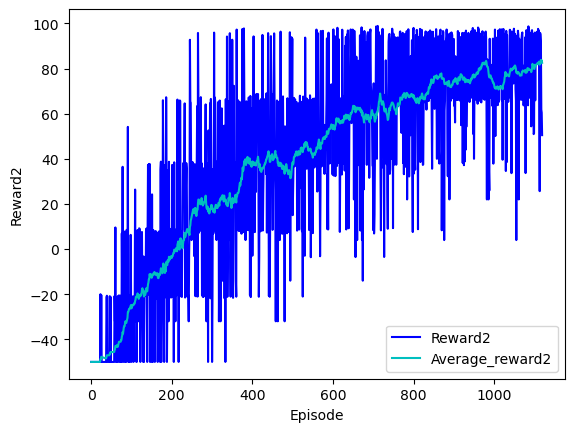

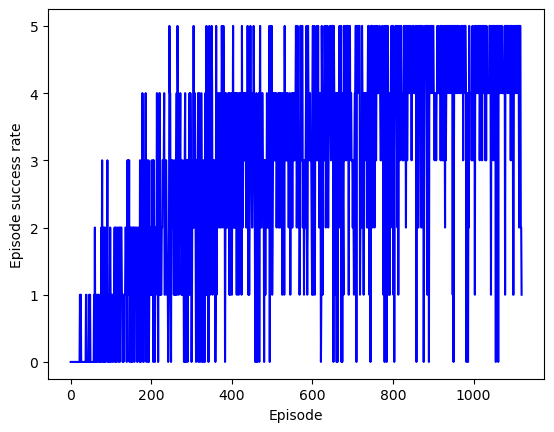

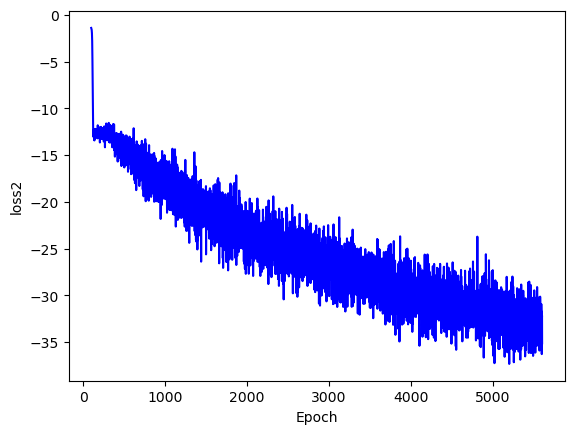

***** epoch 224 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 1 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 86147.29486255461
r_em 49169.53110334247
49169.53110334247
ReWard2/R0 9.833906220668494
reward2 is: 17.833906220668496
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step
***** frame 2 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87870.01417365961
r_em 49538.68672330316
49538.68672330316
ReWard2/R0 9.907737344660632
reward2 is: 17.9077373446

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 3 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80903.10798018095
r_em 48880.03129436226
48880.03129436226
ReWard2/R0 9.776006258872453
reward2 is: 17.776006258872453
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 4 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.0636924989323144
***** epoch 224 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 41ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 6 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 9ms/step
*****

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.06353342683663525
***** epoch 224 episode 2 *****
***** frame 10 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 11 *****
1/1 [==============================] - 0s 48ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87605.46319860185
r_em 55654.799803938804
55654.799803938804
ReWard2/R0 11.130959960787761
reward2 is: 19.130959960787763
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 12 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 13 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88371.1280882593
r_em 54285.406144435685
54285.406144435685
ReWard2/R0 10.857081228887138
reward2 is: 18.85708122888714
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 14 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85396.15293123701
r_em 53917.20956474741
53917.20956474741
ReWard2/R0 10.783441912949483
reward2 is: 18.783441912949485
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.06337475202371384
***** epoch 224 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77759.4799982924
r_em 56505.526353045105
56505.526353045105
ReWard2/R0 11.301105270609021
reward2 is: 19.30110527060902
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 16 *****
1/1 [==============================] - 0s 46ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 68436.62708848415
r_em 56822.3991018164
56822.3991018164
ReWard2/R0 11.36447982036328
reward2 is: 19.36447982036328
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 17 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 75925.05965987645
r_em 56571.205402439475
56571.205402439475
ReWard2/R0 11.314241080487895
reward2 is: 19.314241080487896
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 18 *****
1/1 [==============================] - 0s 49ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 70934.71228534552
r_em 56175.95695086637
56175.95695086637
ReWard2/R0 11.235191390173274
reward2 is: 19.235191390173274
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 19 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77177.95982072323
r_em 55388.41047900628
55388.41047900628
ReWard2/R0 11.077682095801256
reward2 is: 19.077682095801258
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.063216473501336
***** epoch 224 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84368.41825773887
r_em 53897.95312109787
53897.95312109787
ReWard2/R0 10.779590624219573
reward2 is: 18.779590624219573
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 21 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 23 *****
1/1 [==============================] - 0s 50ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87638.04357607474
r_em 55440.67591005418
55440.67591005418
ReWard2/R0 11.088135182010836
reward2 is: 19.088135182010838
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 24 *****
1/1 [==============================] - 0s 46ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88414.97400984494
r_em 55904.384005695894
55904.384005695894
ReWard2/R0 11.18087680113918
reward2 is: 19.180876801139178
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.0630585902797656


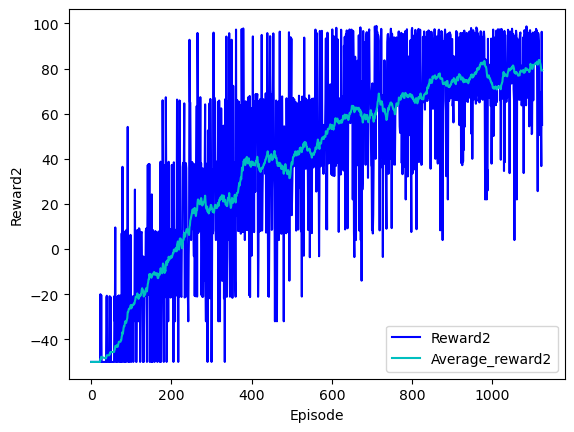

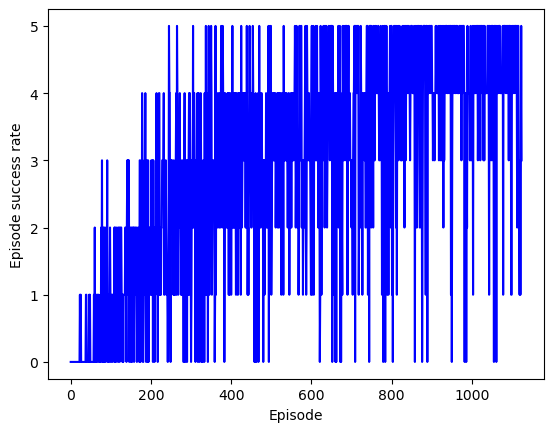

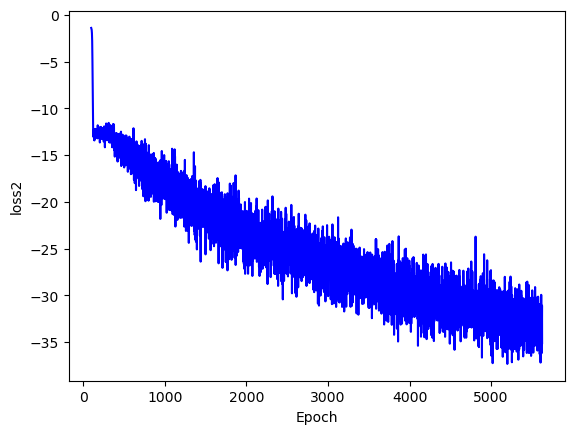

***** epoch 225 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 1 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90009.13641315134
r_em 54327.27396026377
54327.27396026377
ReWard2/R0 10.865454792052754
reward2 is: 18.865454792052752
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 2 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 3 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 4 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88361.00757765135
r_em 53898.82750738935
53898.82750738935
ReWard2/R0 10.77976550147787
reward2 is: 18.77976550147787
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.06290110137173838
***** epoch 225 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 85055.9966189486
r_em 54894.868191051275
54894.868191051275
ReWard2/R0 10.978973638210254
reward2 is: 18.978973638210256
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step
***** frame 6 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85370.0768023411
r_em 55506.452570630914
55506.452570630914
ReWard2/R0 11.101290514126182
reward2 is: 19.101290514126184
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 7 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 88363.17006481907
r_em 55224.8088336674
55224.8088336674
ReWard2/R0 11.04496176673348
reward2 is: 19.04496176673348
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 9ms/step
***** frame 8 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 83108.07806567746
r_em 54875.014623772644
54875.014623772644
ReWard2/R0 10.975002924754529
reward2 is: 18.975002924754527
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step
***** frame 9 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 R

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 11 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81461.4811130388
r_em 54937.47176376704
54937.47176376704
ReWard2/R0 10.987494352753409
reward2 is: 18.98749435275341
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 12 *****
1/1 [==============================] - 0s 45ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82022.93451149318
r_em 54637.76776269657
54637.76776269657
ReWard2/R0 10.927553552539313
reward2 is: 18.927553552539315
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 13 *****
1/1 [==============================] - 0s 44ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85882.40382047495
r_em 54322.585668820815
54322.585668820815
ReWard2/R0 10.864517133764164
reward2 is: 18.864517133764164
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 14 *****
1/1 [==============================] - 0s 47ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85624.10535034374
r_em 53748.681442246954
53748.681442246954
ReWard2/R0 10.749736288449391
reward2 is: 18.74973628844939
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.0625873025595787
***** epoch 225 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 94286.60129275272
r_em 60197.75030697479
60197.75030697479
ReWard2/R0 12.039550061394959
reward2 is: 20.03955006139496
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step
***** frame 16 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 98593.43687698562
r_em 56978.79949375884
56978.79949375884
ReWard2/R0 11.395759898751768
reward2 is: 19.39575989875177
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step
***** frame 17 *****
1/1 [==============================] - 0s 43ms/step
we c

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 21 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90080.74551111077
r_em 56536.20209816346
56536.20209816346
ReWard2/R0 11.307240419632693
reward2 is: 19.30724041963269
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 22 *****
1/1 [==============================] - 0s 39ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 94272.1034364927
r_em 56913.88213336365
56913.88213336365
ReWard2/R0 11.38277642667273
reward2 is: 19.38277642667273
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step
***** frame 23 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 93550.58553176995
r_em 56474.66318157413
56474.66318157413
ReWard2/R0 11.294932636314826
reward2 is: 19.294932636314826
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step
***** frame 24 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal

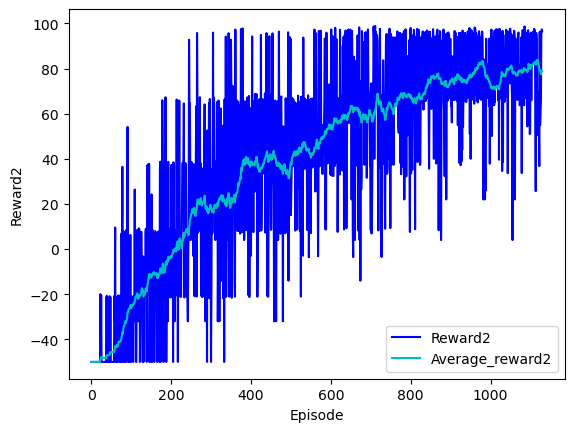

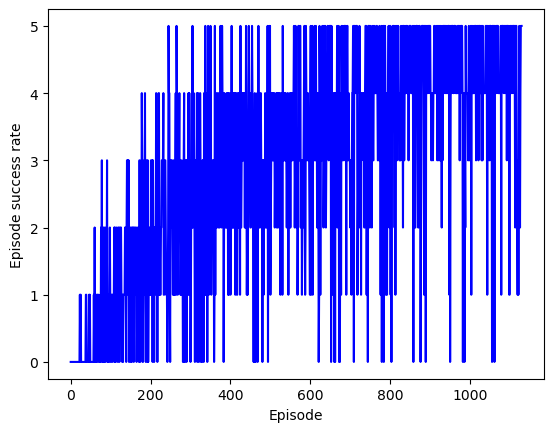

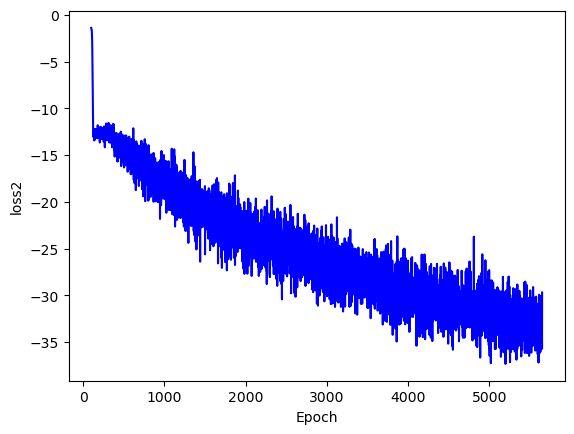

***** epoch 226 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87130.57987317823
r_em 55139.55322846523
55139.55322846523
ReWard2/R0 11.027910645693046
reward2 is: 19.027910645693048
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 1 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87953.77639495839
r_em 55232.91742232906
55232.91742232906
ReWard2/R0 11.046583484465812
reward2 is: 19.046583484465813
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 2 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86587.01655022358
r_em 56034.15306143189
56034.15306143189
ReWard2/R0 11.206830612286378
reward2 is: 19.206830612286378
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 3 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 4 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85090.48024780242
r_em 55554.695700219316
55554.695700219316
ReWard2/R0 11.110939140043863
reward2 is: 19.11093914004386
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.062119537152754895
***** epoch 226 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89361.33446099237
r_em 54750.17015093694
54750.17015093694
ReWard2/R0 10.950034030187387
reward2 is: 18.95003403018739
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 9ms/step
***** frame 6 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91908.70469307568
r_em 55311.67066158647
55311.67066158647
ReWard2/R0 11.062334132317293
reward2 is: 19.062334132317293
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 7 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 91192.7124997179
r_em 55080.30175956062
55080.30175956062
ReWard2/R0 11.016060351912124
reward2 is: 19.016060351912124
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step
***** frame 8 *****
1/1 [==============================] - 0s 45ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91609.27850298694
r_em 54873.32367276723
54873.32367276723
ReWard2/R0 10.974664734553444
reward2 is: 18.974664734553443
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 9 *****
1/1 [==============================] - 0s 47ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90957.55390036869
r_em 54369.604072753464
54369.604072753464
ReWard2/R0 10.873920814550694
reward2 is: 18.873920814550694
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.06196439353108588
***** epoch 226 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86290.94819375341
r_em 55024.94871273015
55024.94871273015
ReWard2/R0 11.00498974254603
reward2 is: 19.00498974254603
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 11 *****
1/1 [==============================] - 0s 47ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88540.56921905151
r_em 55719.41296710308
55719.41296710308
ReWard2/R0 11.143882593420617
reward2 is: 19.143882593420617
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 12 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87012.34327142511
r_em 56028.19837861617
56028.19837861617
ReWard2/R0 11.205639675723235
reward2 is: 19.205639675723233
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 13 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87503.22442836409
r_em 56222.38393540711
56222.38393540711
ReWard2/R0 11.244476787081421
reward2 is: 19.24447678708142
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 14 *****
1/1 [==============================] - 0s 51ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86642.51236180964
r_em 56612.22535514788
56612.22535514788
ReWard2/R0 11.322445071029575
reward2 is: 19.322445071029577
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
Epsilon_hist is: 0.06180963738080588
***** epoch 226 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 46ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85748.51590984101
r_em 54201.404408640374
54201.404408640374
ReWard2/R0 10.840280881728075
reward2 is: 18.840280881728077
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 9ms/step
***** frame 16 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86186.98140214484
r_em 54443.92358467772
54443.92358467772
ReWard2/R0 10.888784716935545
reward2 is: 18.888784716935547
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 9ms/step
***** frame 17 *****
1/1 [==============================] - 0s 39ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87181.2665774702
r_em 52956.19849735664
52956.19849735664
ReWard2/R0 10.591239699471329
reward2 is: 18.59123969947133
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 18 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 19 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85649.37099463564
r_em 54885.16378739045
54885.16378739045
ReWard2/R0 10.977032757478089
reward2 is: 18.97703275747809
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.0616552677342046
***** epoch 226 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88443.87465518533
r_em 55805.27852836392
55805.27852836392
ReWard2/R0 11.161055705672783
reward2 is: 19.161055705672783
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 21 *****
1/1 [==============================] - 0s 46ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88234.41059016345
r_em 55413.32684821176
55413.32684821176
ReWard2/R0 11.082665369642351
reward2 is: 19.08266536964235
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 22 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88073.02440274393
r_em 55989.06146269237
55989.06146269237
ReWard2/R0 11.197812292538474
reward2 is: 19.197812292538472
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 23 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89046.24316807627
r_em 55673.02079790656
55673.02079790656
ReWard2/R0 11.134604159581311
reward2 is: 19.13460415958131
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 24 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89619.61572127088
r_em 56118.52737196235
56118.52737196235
ReWard2/R0 11.223705474392471
reward2 is: 19.22370547439247
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.061501283625988626


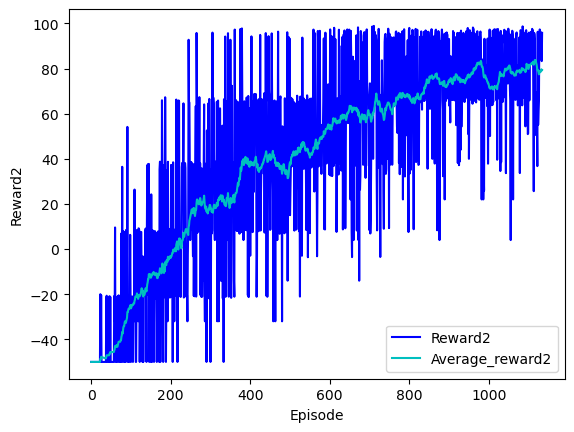

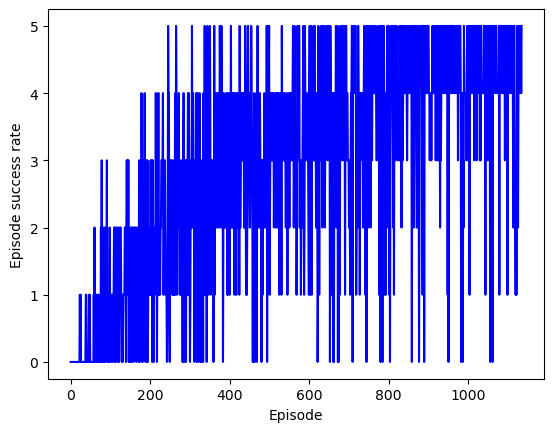

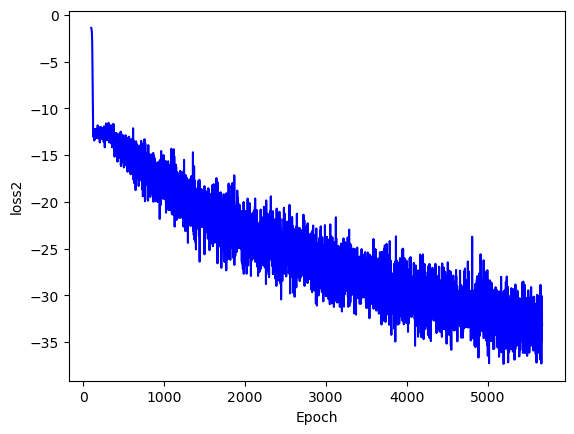

***** epoch 227 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78553.46281571248
r_em 56309.21818850137
56309.21818850137
ReWard2/R0 11.261843637700274
reward2 is: 19.261843637700274
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 1 *****
1/1 [==============================] - 0s 53ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81105.10875135474
r_em 55767.07477850081
55767.07477850081
ReWard2/R0 11.153414955700162
reward2 is: 19.153414955700164
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 2 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83251.92929302868
r_em 54767.6671135544
54767.6671135544
ReWard2/R0 10.95353342271088
reward2 is: 18.95353342271088
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 3 *****
1/1 [==============================] - 0s 41ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83339.01260008119
r_em 54977.71825861273
54977.71825861273
ReWard2/R0 10.995543651722546
reward2 is: 18.995543651722546
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 4 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82836.75951551482
r_em 54206.235527540135
54206.235527540135
ReWard2/R0 10.841247105508026
reward2 is: 18.841247105508025
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.06134768409327535
***** epoch 227 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85012.64048755848
r_em 57035.96647094438
57035.96647094438
ReWard2/R0 11.407193294188877
reward2 is: 19.40719329418888
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 6 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84269.42245242899
r_em 57072.32814510393
57072.32814510393
ReWard2/R0 11.414465629020786
reward2 is: 19.414465629020786
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 7 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83745.12760274205
r_em 56287.42062443988
56287.42062443988
ReWard2/R0 11.257484124887975
reward2 is: 19.257484124887974
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 8 *****
1/1 [==============================] - 0s 52ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83470.29382782525
r_em 56413.71902543408
56413.71902543408
ReWard2/R0 11.282743805086817
reward2 is: 19.282743805086817
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 9 *****
1/1 [==============================] - 0s 40ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83079.58706410229
r_em 56322.39548394049
56322.39548394049
ReWard2/R0 11.264479096788097
reward2 is: 19.264479096788097
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 9ms/step
Epsilon_hist is: 0.06119446817558698
***** epoch 227 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81353.37753777634
r_em 54594.62389185196
54594.62389185196
ReWard2/R0 10.918924778370393
reward2 is: 18.918924778370393
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 11 *****
1/1 [==============================] - 0s 47ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80998.76234768835
r_em 54005.136046318585
54005.136046318585
ReWard2/R0 10.801027209263717
reward2 is: 18.801027209263715
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 9ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 12 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81159.79500847988
r_em 54418.487256786335
54418.487256786335
ReWard2/R0 10.883697451357268
reward2 is: 18.883697451357268
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 13 *****
1/1 [==============================] - 0s 40ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80461.0738558099
r_em 55130.76386869956
55130.76386869956
ReWard2/R0 11.026152773739913
reward2 is: 19.026152773739913
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 14 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79112.82957915714
r_em 55045.92307409963
55045.92307409963
ReWard2/R0 11.009184614819926
reward2 is: 19.009184614819926
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 11ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
Epsilon_hist is: 0.0610416349148445
***** epoch 227 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84434.54805959386
r_em 54731.84145828833
54731.84145828833
ReWard2/R0 10.946368291657665
reward2 is: 18.946368291657663
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 16 *****
1/1 [==============================] - 0s 51ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85845.66641489613
r_em 54963.332902979695
54963.332902979695
ReWard2/R0 10.99266658059594
reward2 is: 18.992666580595937
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 17 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86373.28387435526
r_em 54573.11114623236
54573.11114623236
ReWard2/R0 10.914622229246472
reward2 is: 18.914622229246472
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 18 *****
1/1 [==============================] - 0s 40ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86383.87113734338
r_em 54576.0124989057
54576.0124989057
ReWard2/R0 10.91520249978114
reward2 is: 18.915202499781138
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 19 *****
1/1 [==============================] - 0s 45ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86916.90036762782
r_em 54152.261210242796
54152.261210242796
ReWard2/R0 10.830452242048558
reward2 is: 18.83045224204856
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.06088918335536172
***** epoch 227 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84678.70931662916
r_em 58492.33382997445
58492.33382997445
ReWard2/R0 11.69846676599489
reward2 is: 19.69846676599489
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 21 *****
1/1 [==============================] - 0s 50ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84321.29061630825
r_em 58906.24730129948
58906.24730129948
ReWard2/R0 11.781249460259897
reward2 is: 19.781249460259897
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 22 *****
1/1 [==============================] - 0s 39ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84456.66400384306
r_em 58666.30851972033
58666.30851972033
ReWard2/R0 11.733261703944066
reward2 is: 19.733261703944066
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 23 *****
1/1 [==============================] - 0s 45ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85087.50892022041
r_em 59167.21760575393
59167.21760575393
ReWard2/R0 11.833443521150787
reward2 is: 19.833443521150787
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 24 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85706.40815543832
r_em 59376.23913505758
59376.23913505758
ReWard2/R0 11.875247827011515
reward2 is: 19.875247827011513
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
Epsilon_hist is: 0.06073711254383927


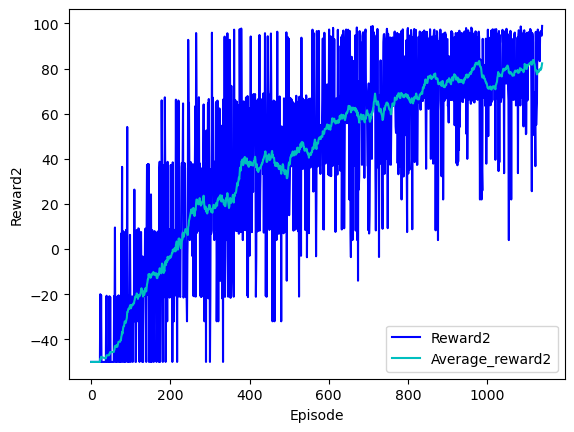

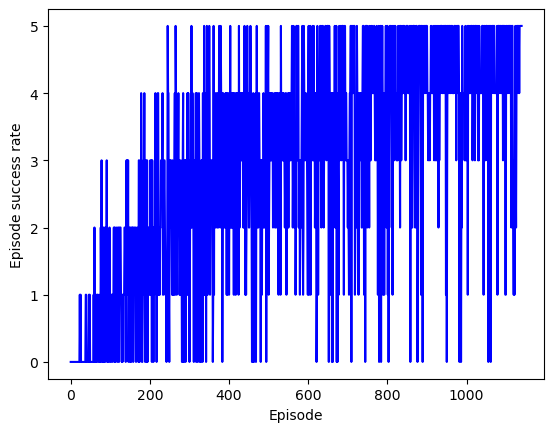

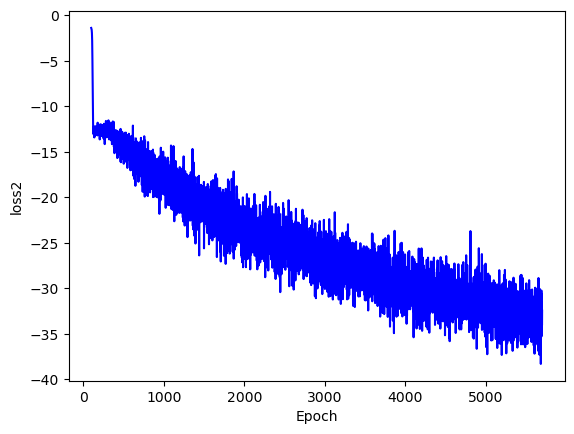

***** epoch 228 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82665.9598069915
r_em 53888.97346095554
53888.97346095554
ReWard2/R0 10.777794692191108
reward2 is: 18.777794692191108
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 1 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 2 *****
1/1 [==============================] - 0s 49ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83912.48502538698
r_em 54038.57462216587
54038.57462216587
ReWard2/R0 10.807714924433174
reward2 is: 18.807714924433174
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 3 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84493.0676781117
r_em 54580.4289308847
54580.4289308847
ReWard2/R0 10.91608578617694
reward2 is: 18.91608578617694
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 4 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83734.89723033988
r_em 55000.012641613896
55000.012641613896
ReWard2/R0 11.00000252832278
reward2 is: 19.00000252832278
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
Epsilon_hist is: 0.06058542152935864
***** epoch 228 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 40ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 72986.56001219957
r_em 53246.42510440406
53246.42510440406
ReWard2/R0 10.64928502088081
reward2 is: 18.64928502088081
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 6 *****
1/1 [==============================] - 0s 43ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 72679.06635295186
r_em 53507.04481130874
53507.04481130874
ReWard2/R0 10.701408962261748
reward2 is: 18.70140896226175
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 7 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 74606.10658478789
r_em 54377.84383825312
54377.84383825312
ReWard2/R0 10.875568767650623
reward2 is: 18.875568767650623
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 8 *****
1/1 [==============================] - 0s 48ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 75216.84470977425
r_em 54742.64112105174
54742.64112105174
ReWard2/R0 10.948528224210348
reward2 is: 18.94852822421035
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 9 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 73716.85019452355
r_em 54508.71675928465
54508.71675928465
ReWard2/R0 10.90174335185693
reward2 is: 18.90174335185693
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
Epsilon_hist is: 0.06043410936337624
***** epoch 228 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 41ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91094.27591237171
r_em 52673.22709992252
52673.22709992252
ReWard2/R0 10.534645419984505
reward2 is: 18.534645419984507
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 11 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90509.96607601029
r_em 53296.152907544914
53296.152907544914
ReWard2/R0 10.659230581508982
reward2 is: 18.659230581508982
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 12 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86219.41555320464
r_em 54568.19223169337
54568.19223169337
ReWard2/R0 10.913638446338673
reward2 is: 18.913638446338673
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 13 *****
1/1 [==============================] - 0s 42ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89153.25423931793
r_em 55529.74774676827
55529.74774676827
ReWard2/R0 11.105949549353653
reward2 is: 19.105949549353653
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 14 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90894.16920771352
r_em 55200.17994777259
55200.17994777259
ReWard2/R0 11.040035989554518
reward2 is: 19.040035989554518
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.06028317509971747
***** epoch 228 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 88264.3970938168
r_em 53590.597533762295
53590.597533762295
ReWard2/R0 10.718119506752458
reward2 is: 18.71811950675246
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step
***** frame 16 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 88030.28144071987
r_em 54113.63991742612
54113.63991742612
ReWard2/R0 10.822727983485223
reward2 is: 18.822727983485223
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step
***** frame 17 *****
1/1 [==============================] - 0s 33ms/step
w

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 21 *****
1/1 [==============================] - 0s 45ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95668.36093950442
r_em 51935.64730173577
51935.64730173577
ReWard2/R0 10.387129460347154
reward2 is: 18.387129460347154
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 22 *****
1/1 [==============================] - 0s 41ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95577.59247299933
r_em 52957.01748304327
52957.01748304327
ReWard2/R0 10.591403496608654
reward2 is: 18.591403496608656
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 23 *****
1/1 [==============================] - 0s 51ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 98117.45206724247
r_em 53292.01435793181
53292.01435793181
ReWard2/R0 10.658402871586363
reward2 is: 18.65840287158636
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 24 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95853.81106121512
r_em 52259.0373549547
52259.0373549547
ReWard2/R0 10.45180747099094
reward2 is: 18.45180747099094
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.0599824365064819


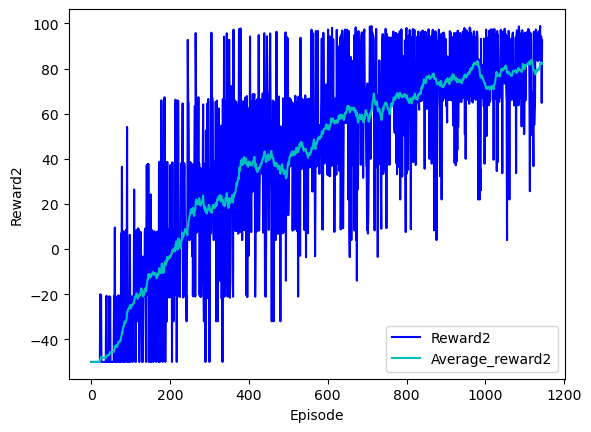

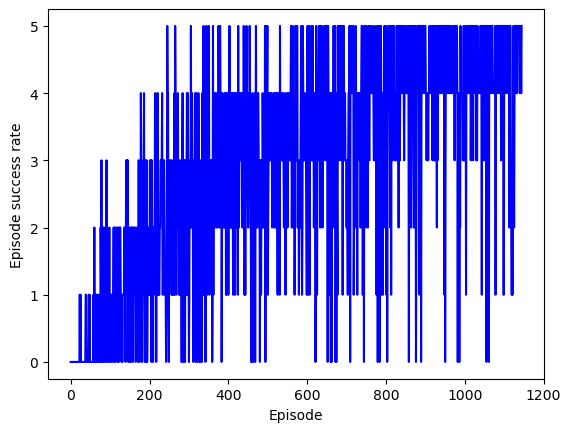

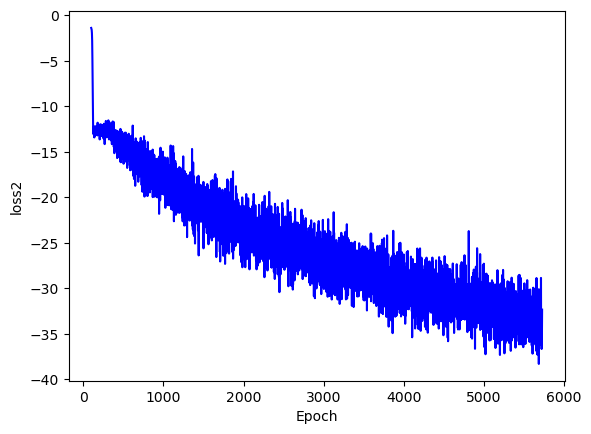

***** epoch 229 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 83272.97490741263
r_em 52255.18421767759
52255.18421767759
ReWard2/R0 10.451036843535517
reward2 is: 18.45103684353552
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step
***** frame 1 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 83227.33364187338
r_em 50897.799453184576
50897.799453184576
ReWard2/R0 10.179559890636915
reward2 is: 18.179559890636916
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step
***** frame 2 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 83177.727043

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 6 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 86714.02935129589
r_em 54205.69496664024
54205.69496664024
ReWard2/R0 10.841138993328048
reward2 is: 18.841138993328048
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step
***** frame 7 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 87350.78395688836
r_em 55399.93909528578
55399.93909528578
ReWard2/R0 11.079987819057155
reward2 is: 19.079987819057155
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step
***** frame 8 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 11 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88877.65789697769
r_em 53616.129122761675
53616.129122761675
ReWard2/R0 10.723225824552335
reward2 is: 18.723225824552337
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 12 *****
1/1 [==============================] - 0s 46ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88448.33203978016
r_em 54711.28156672211
54711.28156672211
ReWard2/R0 10.942256313344421
reward2 is: 18.942256313344423
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 13 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89569.62922257138
r_em 54421.37365842151
54421.37365842151
ReWard2/R0 10.884274731684302
reward2 is: 18.8842747316843
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 14 *****
1/1 [==============================] - 0s 51ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90784.30319672341
r_em 55236.82213467878
55236.82213467878
ReWard2/R0 11.047364426935756
reward2 is: 19.047364426935758
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.05953413936525218
***** epoch 229 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81815.38857346395
r_em 54647.21547448549
54647.21547448549
ReWard2/R0 10.929443094897099
reward2 is: 18.9294430948971
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 16 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87559.06951094577
r_em 54249.81108094259
54249.81108094259
ReWard2/R0 10.84996221618852
reward2 is: 18.84996221618852
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 17 *****
1/1 [==============================] - 0s 39ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87113.2383443288
r_em 54981.12474299803
54981.12474299803
ReWard2/R0 10.996224948599606
reward2 is: 18.996224948599604
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 18 *****
1/1 [==============================] - 0s 50ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 85557.48067428471
r_em 54264.80714587167
54264.80714587167
ReWard2/R0 10.852961429174334
reward2 is: 18.852961429174336
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step
***** frame 19 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80030.1239843602
r_em 53917.48281618608
53917.48281618608
ReWard2/R0 10.783496563237216
reward2 is: 18.783496563237215
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.059385452777788415
***** epoch 229 episode 4 *****
***** frame 20 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 8ms/step
***** frame 21 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92664.96327876579
r_em 55952.652835521745
55952.652835521745
ReWard2/R0 11.190530567104348
reward2 is: 19.190530567104346
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 22 *****
1/1 [==============================] - 0s 42ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93475.29307290853
r_em 54704.741060148546
54704.741060148546
ReWard2/R0 10.94094821202971
reward2 is: 18.94094821202971
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 23 *****
1/1 [==============================] - 0s 48ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90831.46668537434
r_em 54810.06241177594
54810.06241177594
ReWard2/R0 10.962012482355188
reward2 is: 18.96201248235519
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 24 *****
1/1 [==============================] - 0s 52ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91076.29650434255
r_em 54477.57207947081
54477.57207947081
ReWard2/R0 10.895514415894162
reward2 is: 18.895514415894162
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.05923713753526264


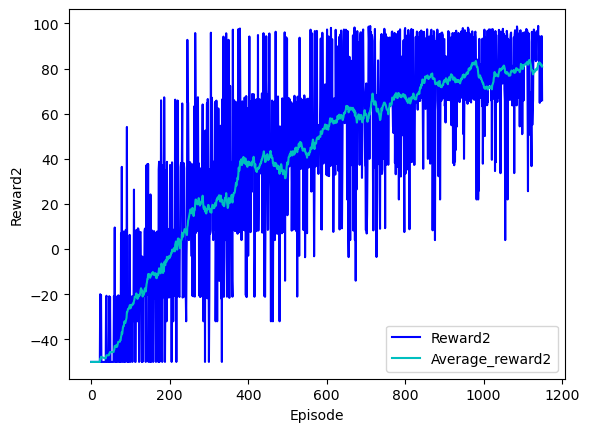

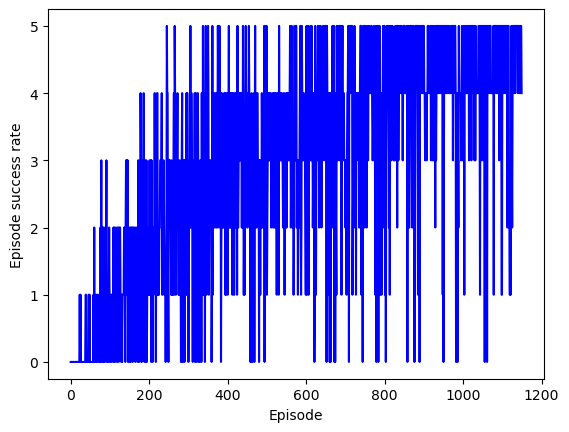

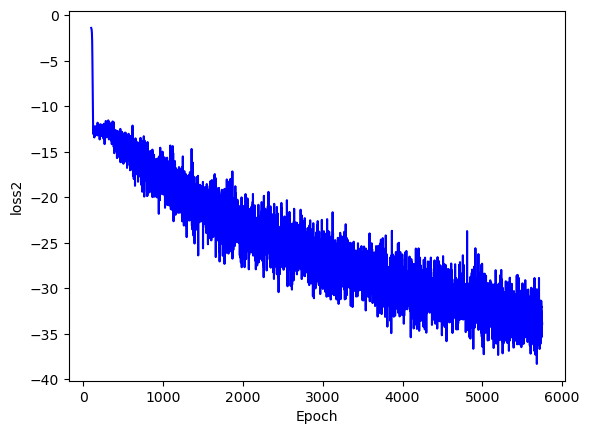

***** epoch 230 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 2 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 3 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Out

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 4 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85685.97648416786
r_em 55544.91758881194
55544.91758881194
ReWard2/R0 11.108983517762388
reward2 is: 19.10898351776239
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.059089192710240435
***** epoch 230 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91487.45095000826
r_em 54750.14714197245
54750.14714197245
ReWard2/R0 10.95002942839449
reward2 is: 18.95002942839449
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 6 *****
1/1 [==============================] - 0s 40ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89037.25725978836
r_em 54903.79355603601
54903.79355603601
ReWard2/R0 10.980758711207203
reward2 is: 18.9807587112072
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 7 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88749.93276718183
r_em 55237.33223200385
55237.33223200385
ReWard2/R0 11.04746644640077
reward2 is: 19.04746644640077
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 10ms/step
***** frame 8 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 9 *****
1/1 [==============================] - 0s 52ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 8ms/step
Epsilon_hist is: 0.058941617377603596
***** epoch 230 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90040.74726609606
r_em 53819.05905236666
53819.05905236666
ReWard2/R0 10.763811810473332
reward2 is: 18.76381181047333
total number of ur2 RBs: 8.0
to

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 11 *****
1/1 [==============================] - 0s 41ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90556.19032916443
r_em 53314.756933002944
53314.756933002944
ReWard2/R0 10.66295138660059
reward2 is: 18.66295138660059
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 12 *****
1/1 [==============================] - 0s 48ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90455.82025637868
r_em 52316.945684669845
52316.945684669845
ReWard2/R0 10.46338913693397
reward2 is: 18.46338913693397
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 13 *****
1/1 [==============================] - 0s 42ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90447.23840441373
r_em 52488.72501007478
52488.72501007478
ReWard2/R0 10.497745002014955
reward2 is: 18.497745002014955
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 14 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89328.58463755761
r_em 52636.73398644073
52636.73398644073
ReWard2/R0 10.527346797288146
reward2 is: 18.527346797288146
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.05879441061454444
***** epoch 230 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 16 *****
1/1 [==============================] - 0s 39ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91192.79613257674
r_em 53763.83321024059
53763.83321024059
ReWard2/R0 10.752766642048119
reward2 is: 18.75276664204812
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 17 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93442.67194559924
r_em 53415.845754431
53415.845754431
ReWard2/R0 10.6831691508862
reward2 is: 18.6831691508862
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 18 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 19 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94086.92375478153
r_em 51722.33648625829
51722.33648625829
ReWard2/R0 10.344467297251658
reward2 is: 18.344467297251658
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.058647571500559985
***** epoch 230 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 51ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90997.61033821653
r_em 57163.22394907135
57163.22394907135
ReWard2/R0 11.432644789814269
reward2 is: 19.43264478981427
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 22 *****
1/1 [==============================] - 0s 42ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88435.00304730139
r_em 56785.852549284864
56785.852549284864
ReWard2/R0 11.357170509856973
reward2 is: 19.35717050985697
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 10ms/step
***** frame 23 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88622.10390589261
r_em 57393.07402404179
57393.07402404179
ReWard2/R0 11.478614804808357
reward2 is: 19.47861480480836
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 24 *****
1/1 [==============================] - 0s 50ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89475.61809736774
r_em 57292.90236662225
57292.90236662225
ReWard2/R0 11.45858047332445
reward2 is: 19.45858047332445
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.05850109911744622


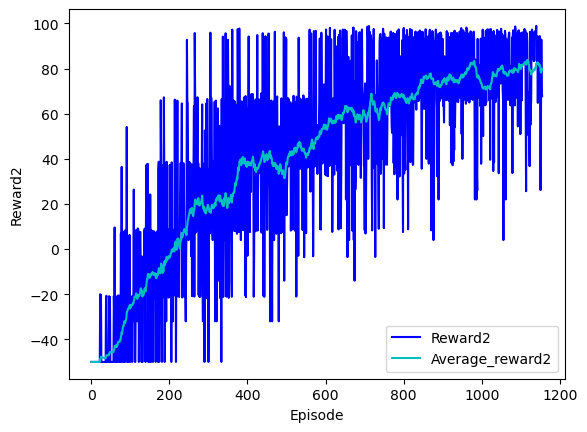

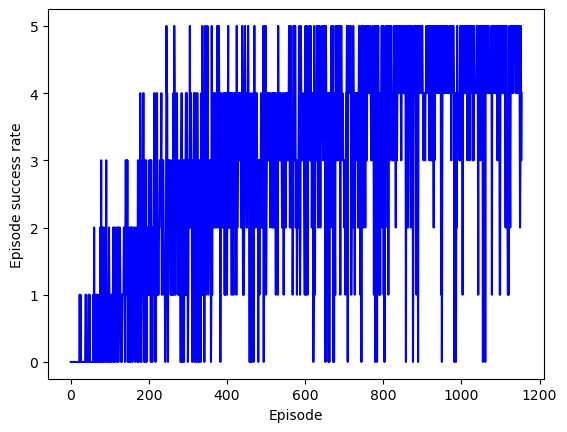

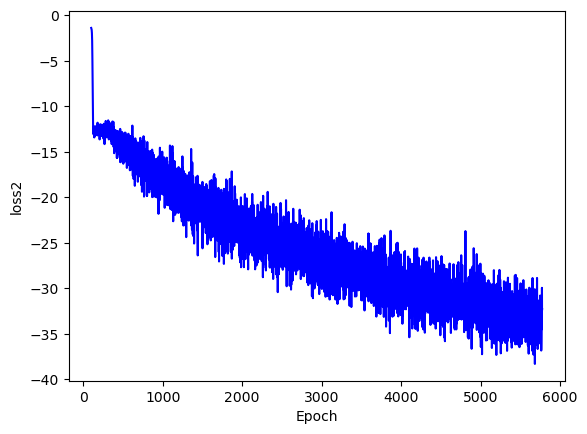

***** epoch 231 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89481.07886635125
r_em 54013.23176785058
54013.23176785058
ReWard2/R0 10.802646353570116
reward2 is: 18.80264635357012
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 1 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89980.41578255274
r_em 53648.97920776497
53648.97920776497
ReWard2/R0 10.729795841552994
reward2 is: 18.729795841552992
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 8ms/step
***** frame 3 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90634.29391848501
r_em 53939.78332788463
53939.78332788463
ReWard2/R0 10.787956665576926
reward2 is: 18.787956665576928
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 4 *****
1/1 [==============================] - 0s 49ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89880.58971798138
r_em 54290.57732076301
54290.57732076301
ReWard2/R0 10.858115464152602
reward2 is: 18.858115464152604
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.05835499254929232
***** epoch 231 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80731.35167051174
r_em 51389.601537353105
51389.601537353105
ReWard2/R0 10.277920307470621
reward2 is: 18.277920307470623
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 6 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78083.36129601949
r_em 50135.691224087874
50135.691224087874
ReWard2/R0 10.027138244817575
reward2 is: 18.027138244817575
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 7 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 81162.49402778623
r_em 52960.00017523289
52960.00017523289
ReWard2/R0 10.592000035046578
reward2 is: 18.592000035046578
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step
***** frame 8 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 80724.90338221822
r_em 53143.68128294429
53143.68128294429
ReWard2/R0 10.628736256588859
reward2 is: 18.62873625658886
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step
***** frame 9 *****
1/1 [==============================] - 0s 56ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 16 *****
1/1 [==============================] - 0s 44ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 17 *****
1/1 [==============================] - 0s 42ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91269.94004149092
r_em 56728.275963219436
56728.275963219436
ReWard2/R0 11.345655192643887
reward2 is: 19.34565519264389
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 18 *****
1/1 [==============================] - 0s 48ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92751.71883150136
r_em 57142.56310500341
57142.56310500341
ReWard2/R0 11.428512621000683
reward2 is: 19.428512621000685
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 19 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92300.59211592241
r_em 56715.25764335356
56715.25764335356
ReWard2/R0 11.343051528670712
reward2 is: 19.343051528670713
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.05791885860975983
***** epoch 231 episode 4 *****
***** frame 20 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 21 *****
1/1 [==============================] - 0s 44ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 97473.31021442998
r_em 54189.99582488342
54189.99582488342
ReWard2/R0 10.837999164976685
reward2 is: 18.837999164976686
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 22 *****
1/1 [==============================] - 0s 41ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 97405.02355557478
r_em 54389.01912706306
54389.01912706306
ReWard2/R0 10.877803825412611
reward2 is: 18.877803825412613
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 23 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 97030.90188870116
r_em 56156.8027900504
56156.8027900504
ReWard2/R0 11.231360558010081
reward2 is: 19.23136055801008
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 24 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.0577742061880015


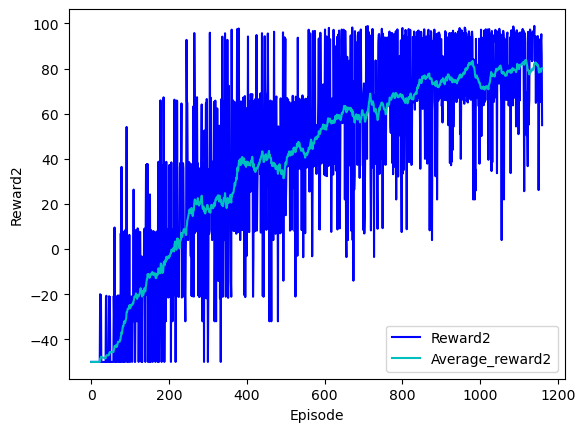

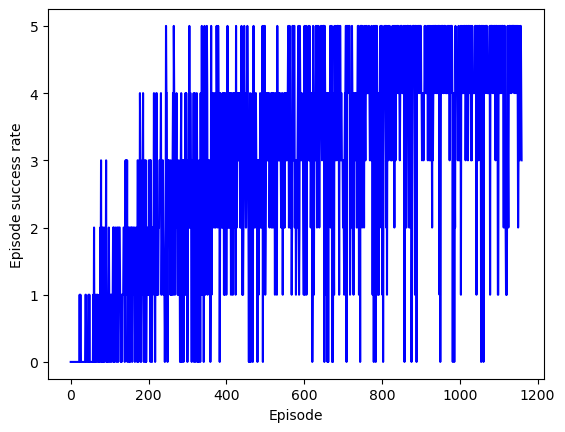

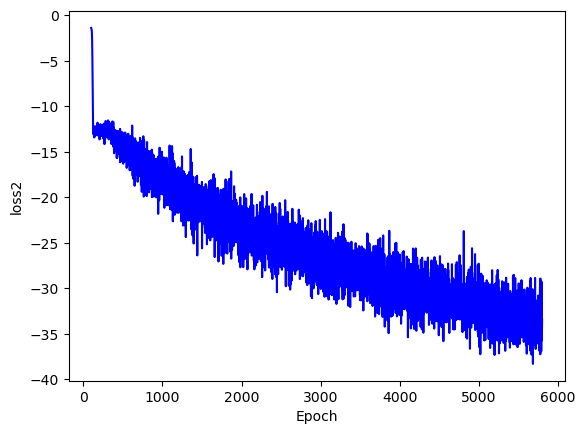

***** epoch 232 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 40ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85130.02637192779
r_em 52772.240416358545
52772.240416358545
ReWard2/R0 10.554448083271708
reward2 is: 18.55444808327171
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 1 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84630.47794892384
r_em 53994.567099865424
53994.567099865424
ReWard2/R0 10.798913419973085
reward2 is: 18.798913419973083
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 2 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86880.42585063605
r_em 53197.63542770768
53197.63542770768
ReWard2/R0 10.639527085541536
reward2 is: 18.639527085541538
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 3 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 4 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88519.63670677823
r_em 53623.734076231936
53623.734076231936
ReWard2/R0 10.724746815246387
reward2 is: 18.724746815246387
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
Epsilon_hist is: 0.05762991503584728
***** epoch 232 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 6 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92109.34085749759
r_em 56706.51957953174
56706.51957953174
ReWard2/R0 11.341303915906348
reward2 is: 19.341303915906348
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 7 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92057.63498823009
r_em 55889.79260450883
55889.79260450883
ReWard2/R0 11.177958520901766
reward2 is: 19.17795852090177
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 8 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 9 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92471.58736824388
r_em 55337.36757231803
55337.36757231803
ReWard2/R0 11.067473514463606
reward2 is: 19.067473514463607
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.057485984251025884
***** epoch 232 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 102153.73283107147
r_em 58673.47481035894
58673.47481035894
ReWard2/R0 11.734694962071787
reward2 is: 19.734694962071785
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 11 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 102846.64667618461
r_em 56711.29479429548
56711.29479429548
ReWard2/R0 11.342258958859096
reward2 is: 19.342258958859098
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 12 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 102143.0711973287
r_em 56691.938589502126
56691.938589502126
ReWard2/R0 11.338387717900424
reward2 is: 19.338387717900424
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 13 *****
1/1 [==============================] - 0s 40ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 102865.68463320899
r_em 57148.316515908286
57148.316515908286
ReWard2/R0 11.429663303181657
reward2 is: 19.429663303181655
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 14 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 104610.17478782205
r_em 56984.12336831016
56984.12336831016
ReWard2/R0 11.396824673662032
reward2 is: 19.39682467366203
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.057342412933519445
***** epoch 232 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85891.41914053018
r_em 51346.06644725208
51346.06644725208
ReWard2/R0 10.269213289450416
reward2 is: 18.269213289450416
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 16 *****
1/1 [==============================] - 0s 48ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 17 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85501.68195785234
r_em 52188.52215505342
52188.52215505342
ReWard2/R0 10.437704431010683
reward2 is: 18.437704431010683
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 18 *****
1/1 [==============================] - 0s 47ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 19 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.0571992001855579
***** epoch 232 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87288.60521557582
r_em 55088.84778276582
55088.84778276582
ReWard2/R0 11.017769556553164
reward2 is: 19.017769556553162
total number

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 21 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88929.79495216232
r_em 55918.46085335414
55918.46085335414
ReWard2/R0 11.183692170670827
reward2 is: 19.183692170670827
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 22 *****
1/1 [==============================] - 0s 47ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93220.00290876743
r_em 56470.54764999807
56470.54764999807
ReWard2/R0 11.294109529999615
reward2 is: 19.294109529999616
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 23 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94987.30154928225
r_em 56247.93770861154
56247.93770861154
ReWard2/R0 11.249587541722308
reward2 is: 19.249587541722306
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 24 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95219.238602757
r_em 55040.43460688413
55040.43460688413
ReWard2/R0 11.008086921376826
reward2 is: 19.008086921376826
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
Epsilon_hist is: 0.057056345111613345


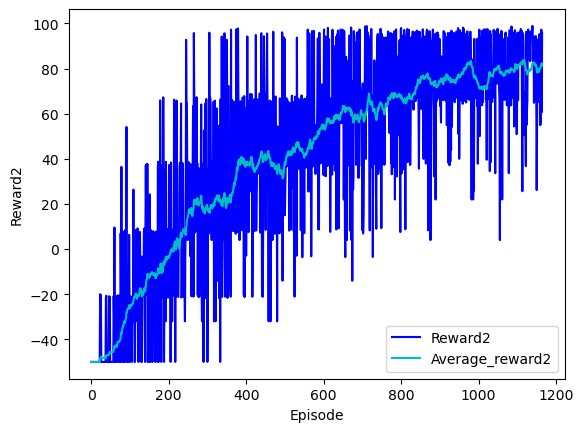

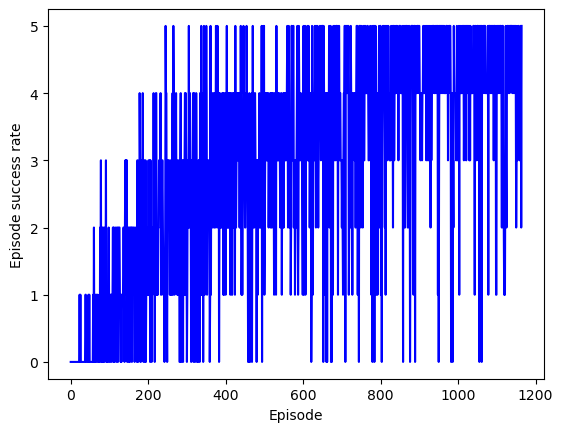

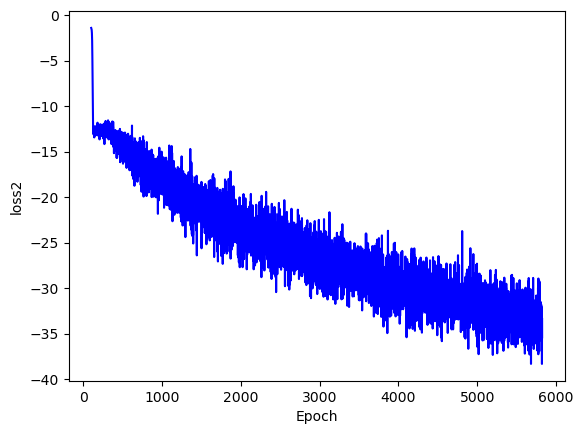

***** epoch 233 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77559.71958460657
r_em 53692.27624560445
53692.27624560445
ReWard2/R0 10.73845524912089
reward2 is: 18.73845524912089
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 1 *****
1/1 [==============================] - 0s 44ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77372.44700968091
r_em 53425.75060020035
53425.75060020035
ReWard2/R0 10.68515012004007
reward2 is: 18.68515012004007
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 2 *****
1/1 [==============================] - 0s 41ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 72259.51181549649
r_em 54109.6109895856
54109.6109895856
ReWard2/R0 10.82192219791712
reward2 is: 18.821922197917118
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 9ms/step
***** frame 3 *****
1/1 [==============================] - 0s 49ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 74194.8563394228
r_em 53216.526443945484
53216.526443945484
ReWard2/R0 10.643305288789097
reward2 is: 18.643305288789097
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 4 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82146.46371053977
r_em 52443.80010718406
52443.80010718406
ReWard2/R0 10.488760021436812
reward2 is: 18.48876002143681
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
Epsilon_hist is: 0.056913846818394516
***** epoch 233 episode 1 *****
***** frame 5 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 8ms/step
***** frame 6 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 105822.22187387876
r_em 57173.980743472246
57173.980743472246
ReWard2/R0 11.43479614869445
reward2 is: 19.43479614869445
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 7 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 104032.59173744894
r_em 57724.567648011
57724.567648011
ReWard2/R0 11.5449135296022
reward2 is: 19.544913529602198
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 8 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 104616.26768403078
r_em 57710.106773985295
57710.106773985295
ReWard2/R0 11.54202135479706
reward2 is: 19.542021354797058
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 9 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 104297.30806939065
r_em 57096.004857001535
57096.004857001535
ReWard2/R0 11.419200971400308
reward2 is: 19.419200971400308
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.056771704414841064
***** epoch 233 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 11 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 12 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 16 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91548.59070498767
r_em 55391.122255052454
55391.122255052454
ReWard2/R0 11.078224451010492
reward2 is: 19.07822445101049
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 17 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91751.19221767332
r_em 55005.93459731175
55005.93459731175
ReWard2/R0 11.00118691946235
reward2 is: 19.00118691946235
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 18 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 19 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 93124.23351809621
r_em 55814.366650057484
55814.366650057484
ReWard2/R0 11.162873330011497
reward2 is: 19.162873330011497
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step
Epsilon_hist is: 0.05648848372361067
***** epoch 233 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 72387.5827252441
r_em 49427.56560960181
49427.56560960181
ReWard2/R0 9.88

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 21 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 70655.33102223017
r_em 50297.979674808535
50297.979674808535
ReWard2/R0 10.059595934961708
reward2 is: 18.059595934961706
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 22 *****
1/1 [==============================] - 0s 47ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78500.36974839824
r_em 51588.93155810868
51588.93155810868
ReWard2/R0 10.317786311621736
reward2 is: 18.317786311621738
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 23 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 79137.57436972218
r_em 50497.31886457948
50497.31886457948
ReWard2/R0 10.099463772915897
reward2 is: 18.099463772915897
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step
***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 5.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.05634740366491801


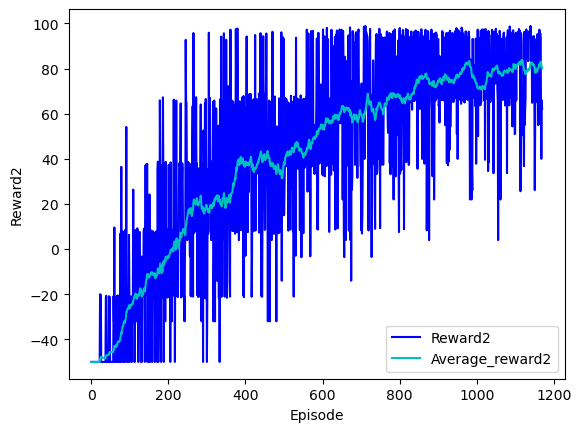

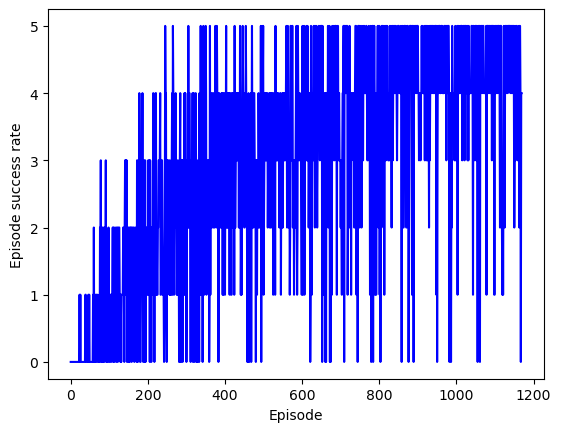

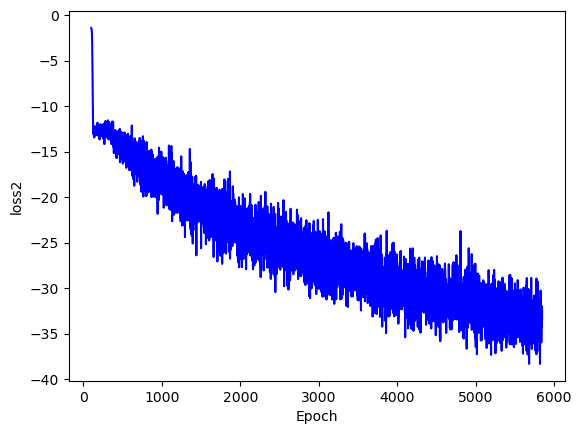

***** epoch 234 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84467.84912127038
r_em 54537.865979956405
54537.865979956405
ReWard2/R0 10.907573195991281
reward2 is: 18.907573195991283
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 1 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83542.27227830596
r_em 55014.929220432874
55014.929220432874
ReWard2/R0 11.002985844086576
reward2 is: 19.002985844086574
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 2 *****
1/1 [==============================] - 0s 43ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82869.65693955963
r_em 54774.68411838592
54774.68411838592
ReWard2/R0 10.954936823677185
reward2 is: 18.954936823677187
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 3 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88192.21581877621
r_em 54373.990854554846
54373.990854554846
ReWard2/R0 10.87479817091097
reward2 is: 18.87479817091097
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 4 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79742.8829072605
r_em 55678.28457653047
55678.28457653047
ReWard2/R0 11.135656915306093
reward2 is: 19.135656915306093
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.05620667595384825
***** epoch 234 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 42ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 6 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90459.51684575262
r_em 53401.96061626167
53401.96061626167
ReWard2/R0 10.680392123252334
reward2 is: 18.680392123252332
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 7 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90540.22044956707
r_em 53110.82087139632
53110.82087139632
ReWard2/R0 10.622164174279263
reward2 is: 18.622164174279263
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 8 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90886.74909480999
r_em 51182.73597829851
51182.73597829851
ReWard2/R0 10.236547195659702
reward2 is: 18.236547195659703
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 9ms/step
***** frame 9 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91473.81500426299
r_em 53131.66946095088
53131.66946095088
ReWard2/R0 10.626333892190175
reward2 is: 18.626333892190175
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.05606629971041275
***** epoch 234 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 92376.10771686271
r_em 52455.52139734106
52455.52139734106
ReWard2/R0 10.491104279468212
reward2 is: 18.49110427946821
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step
***** frame 11 *****
1/1 [==============================] - 0s 51ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90679.48426763425
r_em 52610.63492607545
52610.63492607545
ReWard2/R0 10.52212698521509
reward2 is: 18.52212698521509
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 9ms/step
***** frame 12 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 89837.54537562853
r_em 52009.12053168134
52009.12053168134
ReWard2/R0 10.401824106336269
reward2 is: 18.40182410633627
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 9ms/step
***** frame 13 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 89221.05606035527
r_em 52040.9074982343
52040.9074982343
ReWard2/R0 10.40818149964686
reward2 is: 18.408181499646858
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step
***** frame 14 *****
1/1 [==============================] - 0s 43ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.05592627405682066
***** epoch 234 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83847.00184969575
r_em 54787.22540467646
54787.22540467646
ReWard2/R0 10.957445080935292
reward2 is: 18.957445080935294
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 16 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83556.7566169194
r_em 55096.01429034225
55096.01429034225
ReWard2/R0 11.01920285806845
reward2 is: 19.01920285806845
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 17 *****
1/1 [==============================] - 0s 53ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 85044.67546313882
r_em 55020.44956169793
55020.44956169793
ReWard2/R0 11.004089912339587
reward2 is: 19.004089912339587
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step
***** frame 18 *****
1/1 [==============================] - 0s 49ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 84143.49530124234
r_em 54686.035636042994
54686.035636042994
ReWard2/R0 10.937207127208598
reward2 is: 18.937207127208598
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step
***** frame 19 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: op

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 21 *****
1/1 [==============================] - 0s 48ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92740.45640618348
r_em 54233.22898369185
54233.22898369185
ReWard2/R0 10.84664579673837
reward2 is: 18.846645796738372
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 22 *****
1/1 [==============================] - 0s 43ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92361.15523057632
r_em 55048.60208020867
55048.60208020867
ReWard2/R0 11.009720416041734
reward2 is: 19.009720416041734
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 23 *****
1/1 [==============================] - 0s 49ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91329.87702999852
r_em 55824.829674151566
55824.829674151566
ReWard2/R0 11.164965934830313
reward2 is: 19.164965934830313
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 9ms/step
***** frame 24 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88001.83845003152
r_em 54746.995199781144
54746.995199781144
ReWard2/R0 10.949399039956228
reward2 is: 18.949399039956226
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 11ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 9ms/step
Epsilon_hist is: 0.0556472710189592


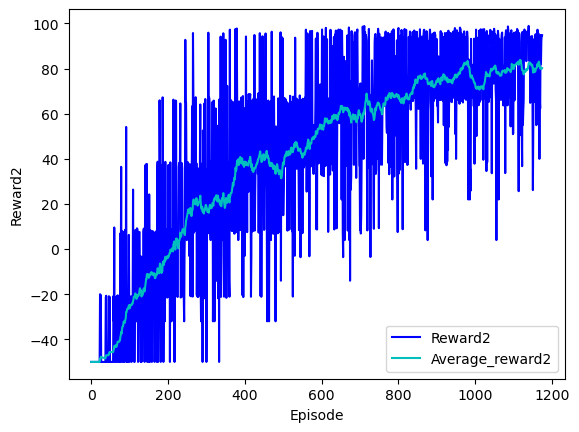

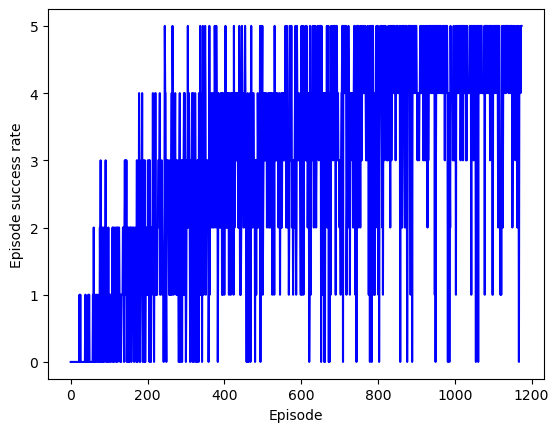

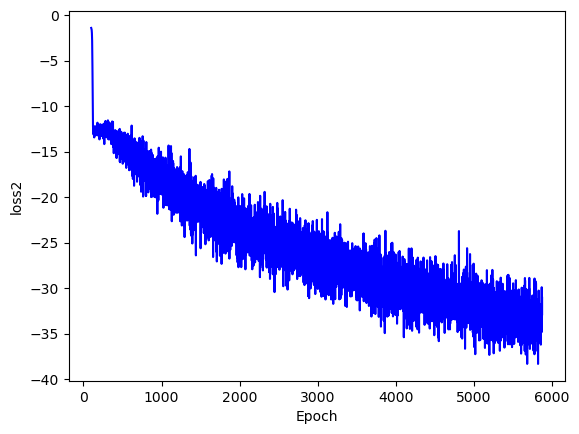

***** epoch 235 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92961.96523394466
r_em 55927.088547955886
55927.088547955886
ReWard2/R0 11.185417709591178
reward2 is: 19.185417709591178
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 9ms/step
***** frame 1 *****
1/1 [==============================] - 0s 42ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 8ms/step
***** frame 2 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94146.45901938443
r_em 56390.95130696239
56390.95130696239
ReWard2/R0 11.27819026139248
reward2 is: 19.27819026139248
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 3 *****
1/1 [==============================] - 0s 39ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94818.13848261608
r_em 56430.46661034827
56430.46661034827
ReWard2/R0 11.286093322069654
reward2 is: 19.286093322069654
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 4 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94304.80934858462
r_em 56146.30542722023
56146.30542722023
ReWard2/R0 11.229261085444046
reward2 is: 19.229261085444044
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
Epsilon_hist is: 0.05550829189004766
***** epoch 235 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80210.77328868338
r_em 55677.96627575957
55677.96627575957
ReWard2/R0 11.135593255151914
reward2 is: 19.135593255151914
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 6 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81820.63006895818
r_em 55037.01667783687
55037.01667783687
ReWard2/R0 11.007403335567375
reward2 is: 19.007403335567375
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 7 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80647.04913622914
r_em 55250.450623035395
55250.450623035395
ReWard2/R0 11.05009012460708
reward2 is: 19.05009012460708
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 8 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80077.59507342518
r_em 54812.798197611606
54812.798197611606
ReWard2/R0 10.962559639522322
reward2 is: 18.962559639522322
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 10ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 12ms/step
***** frame 9 *****
1/1 [==============================] - 0s 61ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82150.07390738526
r_em 54699.72121042485
54699.72121042485
ReWard2/R0 10.93994424208497
reward2 is: 18.93994424208497
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 12ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
Epsilon_hist is: 0.05536965986168427
***** epoch 235 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 49ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 11 *****
1/1 [==============================] - 0s 41ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 97994.71595719141
r_em 57133.00027570567
57133.00027570567
ReWard2/R0 11.426600055141135
reward2 is: 19.426600055141137
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 12 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95482.8473351688
r_em 56686.27587721534
56686.27587721534
ReWard2/R0 11.337255175443067
reward2 is: 19.33725517544307
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 13 *****
1/1 [==============================] - 0s 47ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96846.99943260576
r_em 56713.7063295215
56713.7063295215
ReWard2/R0 11.3427412659043
reward2 is: 19.3427412659043
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 14 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 97588.67546295526
r_em 56984.10857945208
56984.10857945208
ReWard2/R0 11.396821715890415
reward2 is: 19.396821715890415
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.05523137406698495
***** epoch 235 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 44ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82031.89276982521
r_em 55355.777277333036
55355.777277333036
ReWard2/R0 11.071155455466608
reward2 is: 19.07115545546661
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 16 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82539.39777631807
r_em 54922.53038463469
54922.53038463469
ReWard2/R0 10.984506076926937
reward2 is: 18.984506076926937
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 17 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79532.93035757342
r_em 53836.51718581443
53836.51718581443
ReWard2/R0 10.767303437162886
reward2 is: 18.767303437162887
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 18 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78898.86204832456
r_em 52123.54103680464
52123.54103680464
ReWard2/R0 10.42470820736093
reward2 is: 18.42470820736093
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 19 *****
1/1 [==============================] - 0s 42ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78591.39649424324
r_em 52140.776629575244
52140.776629575244
ReWard2/R0 10.428155325915048
reward2 is: 18.42815532591505
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 9ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
Epsilon_hist is: 0.05509343364123071
***** epoch 235 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90830.20747697256
r_em 52844.03900735897
52844.03900735897
ReWard2/R0 10.568807801471795
reward2 is: 18.568807801471795
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 9ms/step
***** frame 21 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91432.9333375971
r_em 53901.30273606478
53901.30273606478
ReWard2/R0 10.780260547212956
reward2 is: 18.780260547212954
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 22 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92492.47080228089
r_em 54554.58810378182
54554.58810378182
ReWard2/R0 10.910917620756363
reward2 is: 18.910917620756365
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 5ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 23 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92511.0502340588
r_em 54542.00025699202
54542.00025699202
ReWard2/R0 10.908400051398404
reward2 is: 18.908400051398402
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 9ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 10ms/step
***** frame 24 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91421.74347151956
r_em 54967.03688291851
54967.03688291851
ReWard2/R0 10.993407376583702
reward2 is: 18.993407376583704
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.054955837721862175


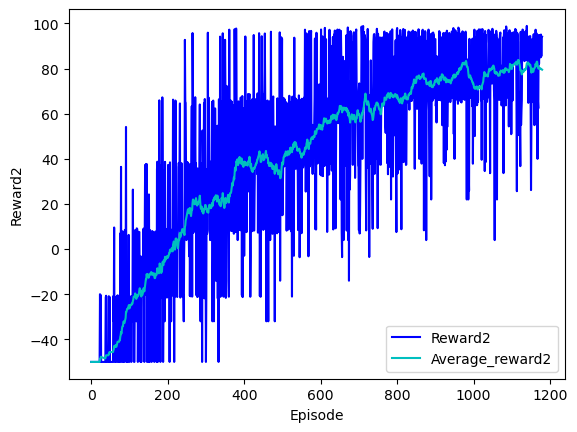

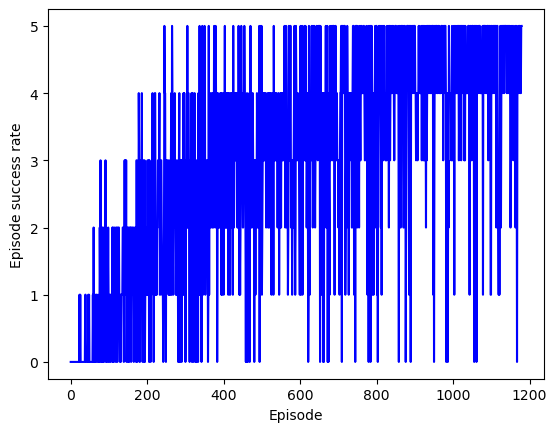

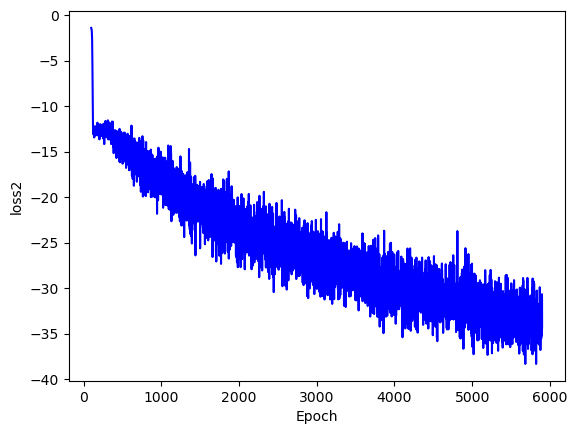

***** epoch 236 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 39ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91943.8128463673
r_em 53173.3688966851
53173.3688966851
ReWard2/R0 10.63467377933702
reward2 is: 18.63467377933702
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 1 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89601.88725260318
r_em 53514.029960710846
53514.029960710846
ReWard2/R0 10.702805992142169
reward2 is: 18.702805992142167
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 9ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 8ms/step
***** frame 3 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92517.1076867725
r_em 53277.799328165835
53277.799328165835
ReWard2/R0 10.655559865633167
reward2 is: 18.655559865633165
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 4 *****
1/1 [==============================] - 0s 44ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 93817.41901918696
r_em 53171.429752587945
53171.429752587945
ReWard2/R0 10.634285950517588
reward2 is: 18.634285950517587
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.05481858544847421
***** epoch 236 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 49ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82319.20325427917
r_em 55341.26375571475
55341.26375571475
ReWard2/R0 11.06825275114295
reward2 is: 19.06825275114295
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 6 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83199.46329487214
r_em 54308.56420005025
54308.56420005025
ReWard2/R0 10.86171284001005
reward2 is: 18.86171284001005
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 7 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 8 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83392.81129763415
r_em 52636.40518956969
52636.40518956969
ReWard2/R0 10.527281037913937
reward2 is: 18.527281037913937
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 9ms/step
***** frame 9 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83203.45389867973
r_em 53661.87700613788
53661.87700613788
ReWard2/R0 10.732375401227577
reward2 is: 18.73237540122758
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.054681675962810566
***** epoch 236 episode 2 *****
***** frame 10 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 11 *****
1/1 [==============================] - 0s 40ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78311.45820200576
r_em 56737.917571363956
56737.917571363956
ReWard2/R0 11.347583514272792
reward2 is: 19.34758351427279
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 9ms/step
***** frame 12 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80779.2955100232
r_em 56096.6696101383
56096.6696101383
ReWard2/R0 11.21933392202766
reward2 is: 19.21933392202766
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 13 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88339.5557727112
r_em 54430.47445955585
54430.47445955585
ReWard2/R0 10.88609489191117
reward2 is: 18.88609489191117
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 14 *****
1/1 [==============================] - 0s 47ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87750.67755023015
r_em 54298.38258815779
54298.38258815779
ReWard2/R0 10.859676517631558
reward2 is: 18.859676517631556
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.05454510840875845
***** epoch 236 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95384.53445499722
r_em 54445.27815239493
54445.27815239493
ReWard2/R0 10.889055630478985
reward2 is: 18.889055630478985
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 16 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96195.27857410183
r_em 52279.655187109165
52279.655187109165
ReWard2/R0 10.455931037421832
reward2 is: 18.455931037421834
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 17 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95811.36593993462
r_em 53249.58587336706
53249.58587336706
ReWard2/R0 10.649917174673412
reward2 is: 18.649917174673412
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 18 *****
1/1 [==============================] - 0s 54ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 96380.51755670182
r_em 52058.92697447869
52058.92697447869
ReWard2/R0 10.411785394895738
reward2 is: 18.411785394895738
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 19 *****
1/1 [==============================] - 0s 48ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95932.36922541451
r_em 52861.14784370084
52861.14784370084
ReWard2/R0 10.572229568740168
reward2 is: 18.57222956874017
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.054408881932343243
***** epoch 236 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94388.54912750442
r_em 55768.7064526604
55768.7064526604
ReWard2/R0 11.15374129053208
reward2 is: 19.153741290532082
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 21 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 23 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 91188.57032269619
r_em 54247.89314492521
54247.89314492521
ReWard2/R0 10.849578628985043
reward2 is: 18.849578628985043
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


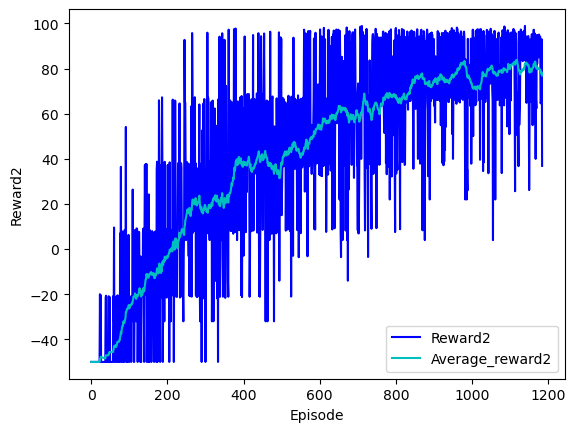

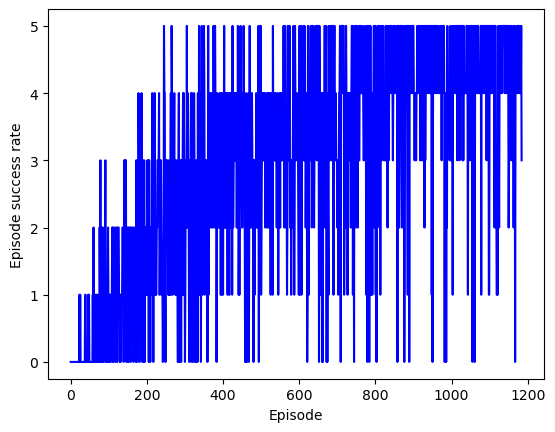

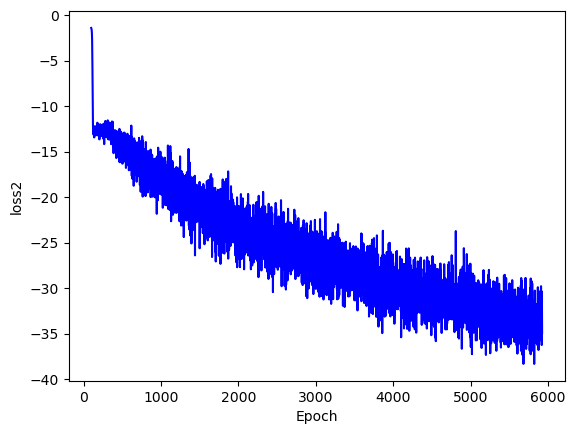

***** epoch 237 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84327.83390839277
r_em 55946.05533111529
55946.05533111529
ReWard2/R0 11.189211066223058
reward2 is: 19.18921106622306
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 1 *****
1/1 [==============================] - 0s 50ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


Output is: optimal_inaccurate
r_ur 83842.80347585535
r_em 56216.07365268657
56216.07365268657
ReWard2/R0 11.243214730537314
reward2 is: 19.243214730537314
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step
***** frame 2 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82986.10237438098
r_em 55982.63294775444
55982.63294775444
ReWard2/R0 11.196526589550889
reward2 is: 19.19652658955089
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 3 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81662.61969636308
r_em 55235.49645590697
55235.49645590697
ReWard2/R0 11.047099291181395
reward2 is: 19.047099291181397
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 4 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82376.12415404602
r_em 55734.647189682626
55734.647189682626
ReWard2/R0 11.146929437936524
reward2 is: 19.146929437936524
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.054137448807183755
***** epoch 237 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84632.51039882947
r_em 53325.16066174796
53325.16066174796
ReWard2/R0 10.665032132349593
reward2 is: 18.665032132349594
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 6 *****
1/1 [==============================] - 0s 43ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85357.05918491122
r_em 51919.510861544695
51919.510861544695
ReWard2/R0 10.38390217230894
reward2 is: 18.38390217230894
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 7 *****
1/1 [==============================] - 0s 46ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85226.80421730202
r_em 52263.03847020086
52263.03847020086
ReWard2/R0 10.452607694040172
reward2 is: 18.45260769404017
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 8 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 86479.6171266618
r_em 53149.60742368397
53149.60742368397
ReWard2/R0 10.629921484736794
reward2 is: 18.629921484736794
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step
***** frame 9 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83986.61243959496
r_em 53675.42800340862
53675.42800340862
ReWard2/R0 10.735085600681725
reward2 is: 18.735085600681725
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.05400224046113293
***** epoch 237 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 47ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90104.75692161583
r_em 56712.079684686585
56712.079684686585
ReWard2/R0 11.342415936937318
reward2 is: 19.342415936937318
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 11 *****
1/1 [==============================] - 0s 44ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89464.81515870788
r_em 56624.59882039796
56624.59882039796
ReWard2/R0 11.324919764079592
reward2 is: 19.324919764079592
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 12 *****
1/1 [==============================] - 0s 49ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85698.32019236256
r_em 56077.81531859982
56077.81531859982
ReWard2/R0 11.215563063719964
reward2 is: 19.215563063719962
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 13 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86541.27413341998
r_em 55251.36818570164
55251.36818570164
ReWard2/R0 11.050273637140329
reward2 is: 19.05027363714033
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 14 *****
1/1 [==============================] - 0s 47ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86723.21881507864
r_em 54464.5676046566
54464.5676046566
ReWard2/R0 10.89291352093132
reward2 is: 18.89291352093132
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.053867369798095345
***** epoch 237 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78030.364437081
r_em 51822.51548016415
51822.51548016415
ReWard2/R0 10.364503096032829
reward2 is: 18.364503096032827
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 16 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78831.90317368074
r_em 52056.04935230304
52056.04935230304
ReWard2/R0 10.411209870460608
reward2 is: 18.41120987046061
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 17 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 18 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 19 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.05373283597470724
***** epoch 237 episode 4 *****
*

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 21 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87808.38054813762
r_em 55826.7206457945
55826.7206457945
ReWard2/R0 11.1653441291589
reward2 is: 19.1653441291589
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 22 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87429.59498136268
r_em 55897.63805051872
55897.63805051872
ReWard2/R0 11.179527610103744
reward2 is: 19.179527610103744
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 23 *****
1/1 [==============================] - 0s 47ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86878.15658104375
r_em 56588.96196672013
56588.96196672013
ReWard2/R0 11.317792393344027
reward2 is: 19.31779239334403
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 24 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85975.81458348101
r_em 56833.27267307531
56833.27267307531
ReWard2/R0 11.366654534615062
reward2 is: 19.366654534615062
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.053598638149711164


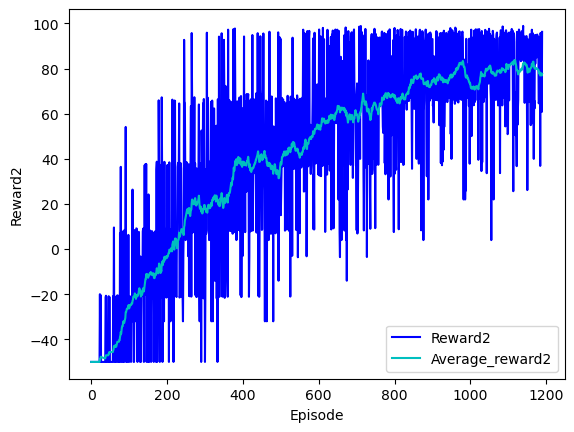

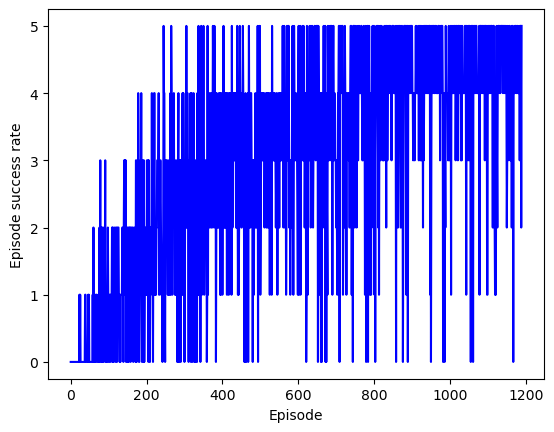

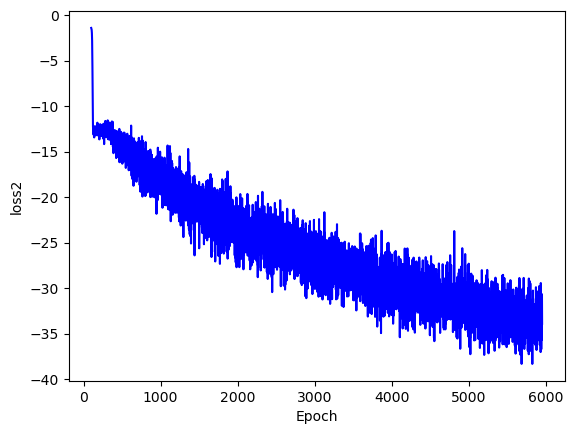

***** epoch 238 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 42ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 1 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 2 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 3 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 wi

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.053331247140365315
***** epoch 238 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87948.33906210697
r_em 54141.632515165766
54141.632515165766
ReWard2/R0 10.828326503033153
reward2 is: 18.828326503033153
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 11 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86613.8976261801
r_em 54048.977232376084
54048.977232376084
ReWard2/R0 10.809795446475217
reward2 is: 18.809795446475217
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 12 *****
1/1 [==============================] - 0s 48ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88037.65033339009
r_em 54259.05374242084
54259.05374242084
ReWard2/R0 10.851810748484167
reward2 is: 18.85181074848417
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 13 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88087.51015828911
r_em 53482.76658001836
53482.76658001836
ReWard2/R0 10.696553316003673
reward2 is: 18.696553316003673
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 14 *****
1/1 [==============================] - 0s 48ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89875.44167510005
r_em 53956.974530427135
53956.974530427135
ReWard2/R0 10.791394906085428
reward2 is: 18.79139490608543
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.05319805228398488
***** epoch 238 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 16 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 8ms/step
***** frame 17 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 18 *****

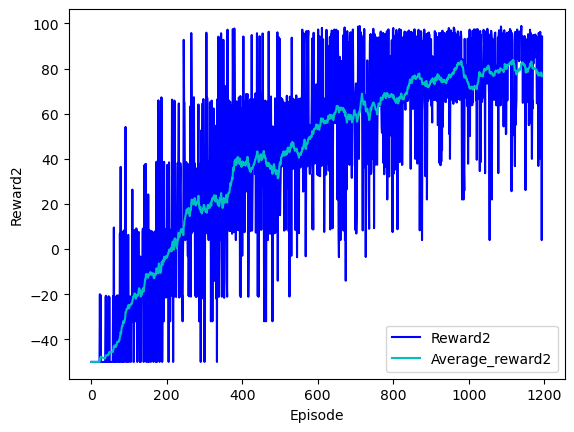

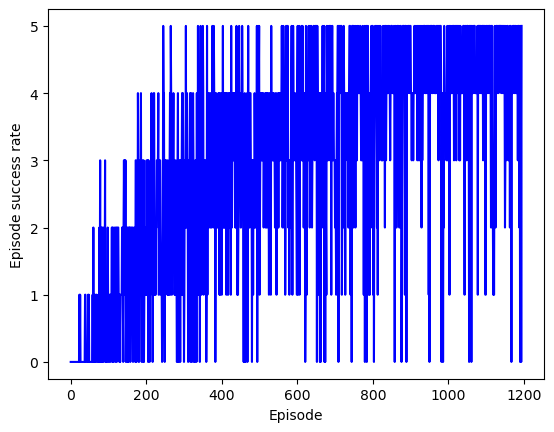

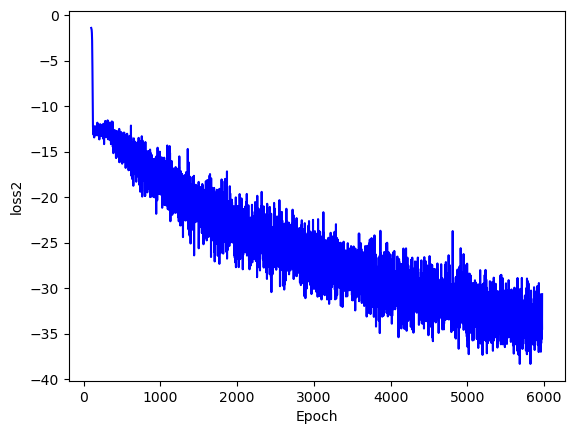

***** epoch 239 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 44ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83105.71886804163
r_em 57039.89368360745
57039.89368360745
ReWard2/R0 11.407978736721489
reward2 is: 19.40797873672149
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 1 *****
1/1 [==============================] - 0s 44ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82931.49454360071
r_em 56751.287421768786
56751.287421768786
ReWard2/R0 11.350257484353758
reward2 is: 19.350257484353758
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 2 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82779.32365046206
r_em 57253.68516338002
57253.68516338002
ReWard2/R0 11.450737032676004
reward2 is: 19.450737032676003
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 3 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82447.68518476494
r_em 57020.44723656666
57020.44723656666
ReWard2/R0 11.404089447313332
reward2 is: 19.404089447313332
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 4 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80246.26943455047
r_em 57104.7179910032
57104.7179910032
ReWard2/R0 11.42094359820064
reward2 is: 19.42094359820064
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.05280046031962176
***** epoch 239 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 47ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88830.48275161692
r_em 54504.34928731259
54504.34928731259
ReWard2/R0 10.900869857462517
reward2 is: 18.900869857462517
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 6 *****
1/1 [==============================] - 0s 42ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87304.07058557357
r_em 54608.522836157565
54608.522836157565
ReWard2/R0 10.921704567231513
reward2 is: 18.921704567231515
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 7 *****
1/1 [==============================] - 0s 39ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88719.67006224615
r_em 54028.51747811536
54028.51747811536
ReWard2/R0 10.805703495623073
reward2 is: 18.80570349562307
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 8 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90329.75692330996
r_em 53923.921806716615
53923.921806716615
ReWard2/R0 10.784784361343323
reward2 is: 18.784784361343323
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 9 *****
1/1 [==============================] - 0s 39ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92544.11041917757
r_em 52965.3537394745
52965.3537394745
ReWard2/R0 10.5930707478949
reward2 is: 18.5930707478949
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.05266859110398944
***** epoch 239 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77642.47484729058
r_em 55886.86119622484
55886.86119622484
ReWard2/R0 11.177372239244969
reward2 is: 19.177372239244967
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 11 *****
1/1 [==============================] - 0s 48ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90503.71653378649
r_em 55861.70610712916
55861.70610712916
ReWard2/R0 11.172341221425832
reward2 is: 19.17234122142583
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 12 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88584.78405068505
r_em 55891.36357488672
55891.36357488672
ReWard2/R0 11.178272714977343
reward2 is: 19.178272714977343
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 13 *****
1/1 [==============================] - 0s 50ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91350.25536928508
r_em 55672.22537149798
55672.22537149798
ReWard2/R0 11.134445074299597
reward2 is: 19.1344450742996
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 14 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94097.12909253594
r_em 55785.607221486775
55785.607221486775
ReWard2/R0 11.157121444297355
reward2 is: 19.157121444297353
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.05253705123188797
***** epoch 239 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 39ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86766.65882513534
r_em 53941.627148229556
53941.627148229556
ReWard2/R0 10.78832542964591
reward2 is: 18.78832542964591
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 9ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 11ms/step
***** frame 16 *****
1/1 [==============================] - 0s 46ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86829.94903888763
r_em 52753.923131214084
52753.923131214084
ReWard2/R0 10.550784626242816
reward2 is: 18.550784626242816
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 17 *****
1/1 [==============================] - 0s 46ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86512.59767325515
r_em 53266.92698322867
53266.92698322867
ReWard2/R0 10.653385396645735
reward2 is: 18.653385396645735
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 18 *****
1/1 [==============================] - 0s 46ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86477.43006013449
r_em 53067.90092685976
53067.90092685976
ReWard2/R0 10.613580185371951
reward2 is: 18.61358018537195
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 19 *****
1/1 [==============================] - 0s 40ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.052405839880781444
***** epoch 239 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93181.93640843275
r_em 54143.0491467525
54143.0491467525
ReWard2/R0 10.8286098293505
reward2 is: 18.828609829350498
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 21 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 22 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 23 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 24 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 

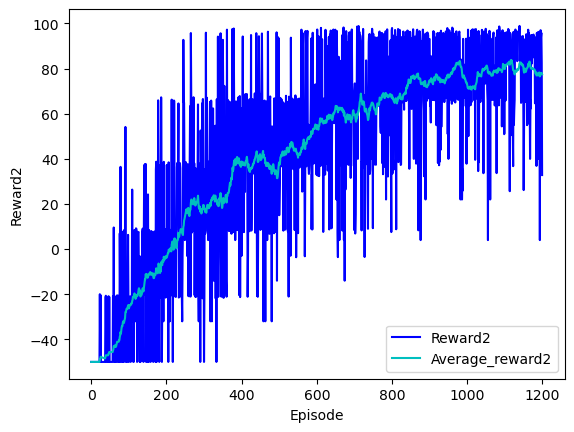

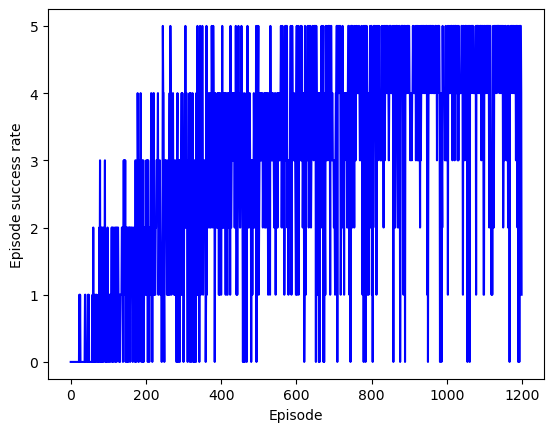

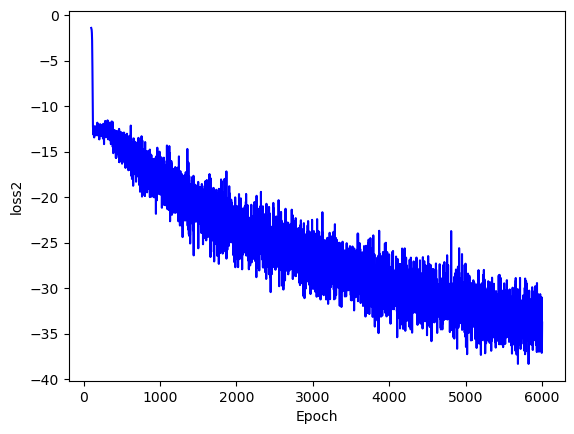

***** epoch 240 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79471.82260381762
r_em 53570.230078799104
53570.230078799104
ReWard2/R0 10.714046015759822
reward2 is: 18.71404601575982
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 1 *****
1/1 [==============================] - 0s 39ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78609.45321427779
r_em 54728.484890502186
54728.484890502186
ReWard2/R0 10.945696978100438
reward2 is: 18.945696978100436
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 2 *****
1/1 [==============================] - 0s 26ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80586.25887669985
r_em 54058.05701018363
54058.05701018363
ReWard2/R0 10.811611402036725
reward2 is: 18.811611402036725
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 3 *****
1/1 [==============================] - 0s 42ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83759.9703535222
r_em 53749.00210243748
53749.00210243748
ReWard2/R0 10.749800420487496
reward2 is: 18.749800420487496
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 4 *****
1/1 [==============================] - 0s 48ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85059.4759899988
r_em 54219.5028224361
54219.5028224361
ReWard2/R0 10.843900564487221
reward2 is: 18.84390056448722
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.05214439946167604
***** epoch 240 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 6 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 7 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88083.87718894474
r_em 54742.43510546578
54742.43510546578
ReWard2/R0 10.948487021093156
reward2 is: 18.948487021093158
total number o

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 8 *****
1/1 [==============================] - 0s 43ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87419.04772585575
r_em 54943.651944977464
54943.651944977464
ReWard2/R0 10.988730388995492
reward2 is: 18.988730388995492
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 9 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.052014168758856304
***** epoch 240 episode 2 *****
***** frame 10 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 11 *****
1/1 [==============================] - 0s 49ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91775.48631437065
r_em 54086.07292124946
54086.07292124946
ReWard2/R0 10.817214584249893
reward2 is: 18.817214584249893
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, y

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 12 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92890.68968875642
r_em 54287.64253350219
54287.64253350219
ReWard2/R0 10.857528506700438
reward2 is: 18.85752850670044
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 13 *****
1/1 [==============================] - 0s 46ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93296.89461517945
r_em 53653.69533161882
53653.69533161882
ReWard2/R0 10.730739066323764
reward2 is: 18.730739066323764
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 14 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92456.93532790856
r_em 53434.608039325976
53434.608039325976
ReWard2/R0 10.686921607865195
reward2 is: 18.686921607865195
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.051884263307379615
***** epoch 240 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 40ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82853.14646377145
r_em 54477.77143127692
54477.77143127692
ReWard2/R0 10.895554286255383
reward2 is: 18.895554286255383
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 9ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 9ms/step
***** frame 16 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86099.02315824767
r_em 54467.60379016103
54467.60379016103
ReWard2/R0 10.893520758032206
reward2 is: 18.893520758032206
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 17 *****
1/1 [==============================] - 0s 44ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87846.35459570034
r_em 54171.349186192165
54171.349186192165
ReWard2/R0 10.834269837238432
reward2 is: 18.83426983723843
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 18 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88807.82042807204
r_em 54877.98956239749
54877.98956239749
ReWard2/R0 10.975597912479497
reward2 is: 18.975597912479497
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 19 *****
1/1 [==============================] - 0s 45ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87502.2231397311
r_em 53972.482831830166
53972.482831830166
ReWard2/R0 10.794496566366034
reward2 is: 18.794496566366035
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.051754682294930326
***** epoch 240 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89413.93712755914
r_em 55461.50972431469
55461.50972431469
ReWard2/R0 11.092301944862937
reward2 is: 19.09230194486294
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 21 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90195.93218069321
r_em 55168.28590206985
55168.28590206985
ReWard2/R0 11.03365718041397
reward2 is: 19.033657180413968
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 22 *****
1/1 [==============================] - 0s 42ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92043.7265953662
r_em 55007.495352946025
55007.495352946025
ReWard2/R0 11.001499070589205
reward2 is: 19.001499070589205
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 23 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 24 *****
1/1 [==============================] - 0s 47ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92158.72256356738
r_em 55420.77596921212
55420.77596921212
ReWard2/R0 11.084155193842424
reward2 is: 19.084155193842424
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.051625424911221574


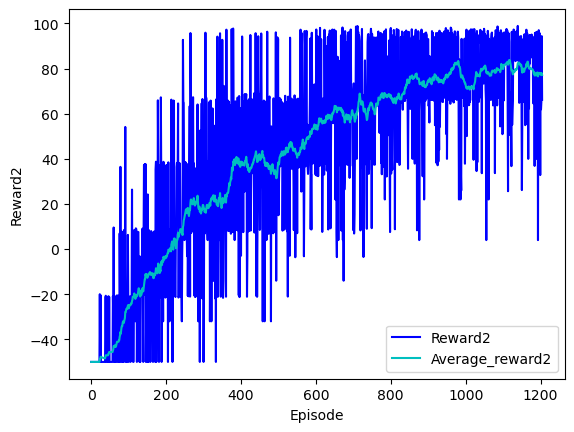

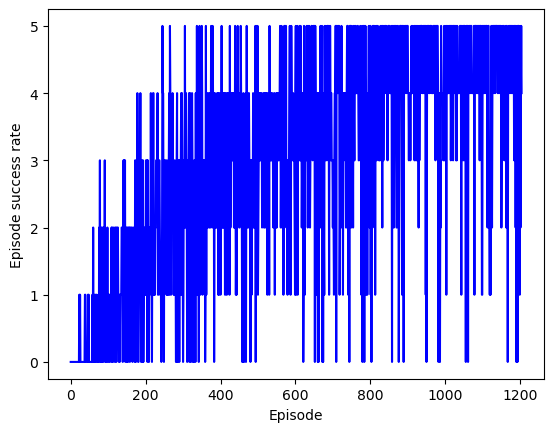

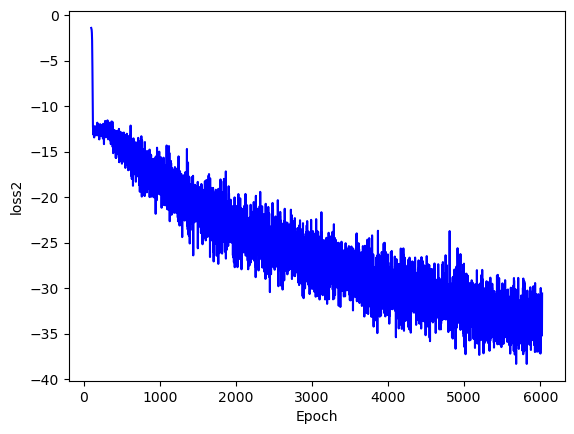

***** epoch 241 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 87075.11550368645
r_em 54836.29887923724
54836.29887923724
ReWard2/R0 10.967259775847449
reward2 is: 18.96725977584745
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 10ms/step
***** frame 1 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 89016.6352358535
r_em 55484.39429854676
55484.39429854676
ReWard2/R0 11.096878859709351
reward2 is: 19.09687885970935
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step
***** frame 2 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 7822

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 3 *****
1/1 [==============================] - 0s 42ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 87726.81747232159
r_em 54617.10144040154
54617.10144040154
ReWard2/R0 10.923420288080308
reward2 is: 18.923420288080308
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step
***** frame 4 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 88300.47448170958
r_em 54909.75665877477
54909.75665877477
ReWard2/R0 10.981951331754955
reward2 is: 18.981951331754956
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step
Epsilon_hist is: 0.05149649034799016
***** epoch 241 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 41ms/step
we c

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 11 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86785.69364907673
r_em 56280.61484705903
56280.61484705903
ReWard2/R0 11.256122969411805
reward2 is: 19.256122969411805
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 12 *****
1/1 [==============================] - 0s 54ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86782.00359900568
r_em 56928.214533380895
56928.214533380895
ReWard2/R0 11.385642906676178
reward2 is: 19.38564290667618
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 13 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 14 *****
1/1 [==============================] - 0s 44ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88904.86077254933
r_em 57409.54109082063
57409.54109082063
ReWard2/R0 11.481908218164126
reward2 is: 19.481908218164126
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.05123958645999479
***** epoch 241 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94375.65883492646
r_em 53756.74806930605
53756.74806930605
ReWard2/R0 10.75134961386121
reward2 is: 18.75134961386121
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 16 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93800.65640853919
r_em 52544.93429574135
52544.93429574135
ReWard2/R0 10.50898685914827
reward2 is: 18.50898685914827
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 17 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 18 *****
1/1 [==============================] - 0s 39ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94200.58836911658
r_em 51214.58679650427
51214.58679650427
ReWard2/R0 10.242917359300854
reward2 is: 18.242917359300854
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 19 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93709.71217492048
r_em 52997.11539104098
52997.11539104098
ReWard2/R0 10.599423078208195
reward2 is: 18.599423078208197
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.05111161552877749
***** epoch 241 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 42ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 21 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 22 *****
1/1 [==============================] - 0s 47ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78897.89525735873
r_em 53160.680082087776
53160.680082087776
ReWard2/R0 10.632136016417554
reward2 is: 18.632136016417554
total num

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 23 *****
1/1 [==============================] - 0s 49ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82509.24502325668
r_em 53523.01689343638
53523.01689343638
ReWard2/R0 10.704603378687276
reward2 is: 18.704603378687274
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 24 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.05098396420512083


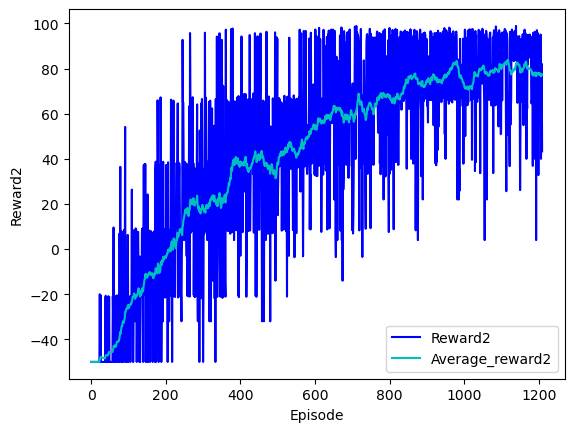

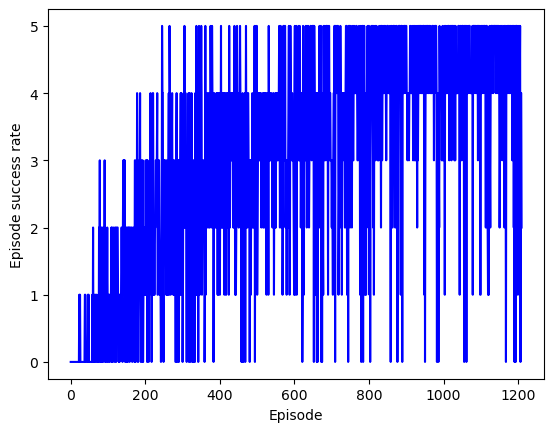

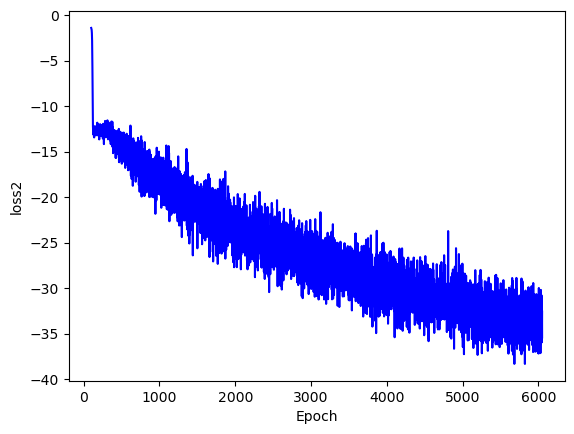

***** epoch 242 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 40ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 1 *****
1/1 [==============================] - 0s 43ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 2 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 9ms/step
***** frame 3 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 wi

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 7 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89037.28267869556
r_em 52716.23625373035
52716.23625373035
ReWard2/R0 10.54324725074607
reward2 is: 18.54324725074607
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 8 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 9 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 90225.33372096469
r_em 51681.23318421816
51681.23318421816
ReWard2/R0 10.336246636843631
reward2 is: 18.336246636843633
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.05072961718960186
***** epoch 242 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84351.7487353639
r_em 5

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 11 *****
1/1 [==============================] - 0s 39ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85019.32207978997
r_em 56131.18337680624
56131.18337680624
ReWard2/R0 11.226236675361248
reward2 is: 19.22623667536125
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 12 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85068.82815276779
r_em 56328.72996369478
56328.72996369478
ReWard2/R0 11.265745992738957
reward2 is: 19.265745992738957
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 13 *****
1/1 [==============================] - 0s 44ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86510.2986700767
r_em 55785.0665611792
55785.0665611792
ReWard2/R0 11.15701331223584
reward2 is: 19.15701331223584
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 14 *****
1/1 [==============================] - 0s 43ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82564.8205297213
r_em 56149.532361828155
56149.532361828155
ReWard2/R0 11.22990647236563
reward2 is: 19.22990647236563
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.050602919907274675
***** epoch 242 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 51ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84889.94822807064
r_em 55554.71992186219
55554.71992186219
ReWard2/R0 11.110943984372438
reward2 is: 19.11094398437244
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 16 *****
1/1 [==============================] - 0s 47ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 91185.0345031817
r_em 55280.976009974016
55280.976009974016
ReWard2/R0 11.056195201994804
reward2 is: 19.056195201994804
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step
***** frame 17 *****
1/1 [==============================] - 0s 43ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91740.14046512415
r_em 56218.36788801279
56218.36788801279
ReWard2/R0 11.243673577602559
reward2 is: 19.243673577602557
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 18 *****
1/1 [==============================] - 0s 52ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90971.2825064826
r_em 56075.35806358452
56075.35806358452
ReWard2/R0 11.215071612716905
reward2 is: 19.215071612716905
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 19 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85954.05955837468
r_em 56424.36683126047
56424.36683126047
ReWard2/R0 11.284873366252095
reward2 is: 19.284873366252093
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.05047653905156843
***** epoch 242 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86069.16005070256
r_em 58361.90004855105
58361.90004855105
ReWard2/R0 11.67238000971021
reward2 is: 19.67238000971021
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 21 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88381.3904681606
r_em 58605.47607327234
58605.47607327234
ReWard2/R0 11.721095214654467
reward2 is: 19.72109521465447
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 22 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89646.28494472295
r_em 58288.22697880936
58288.22697880936
ReWard2/R0 11.657645395761872
reward2 is: 19.65764539576187
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 23 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89909.38113373796
r_em 58564.81786282412
58564.81786282412
ReWard2/R0 11.712963572564824
reward2 is: 19.712963572564824
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 24 *****
1/1 [==============================] - 0s 43ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91643.18569794032
r_em 58483.90362340379
58483.90362340379
ReWard2/R0 11.696780724680758
reward2 is: 19.696780724680757
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 9ms/step
Epsilon_hist is: 0.050350473832207254


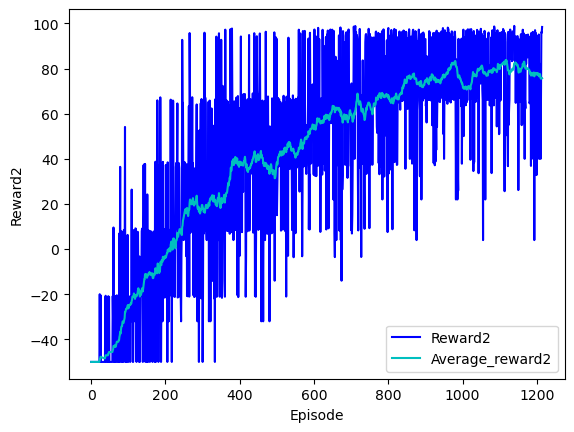

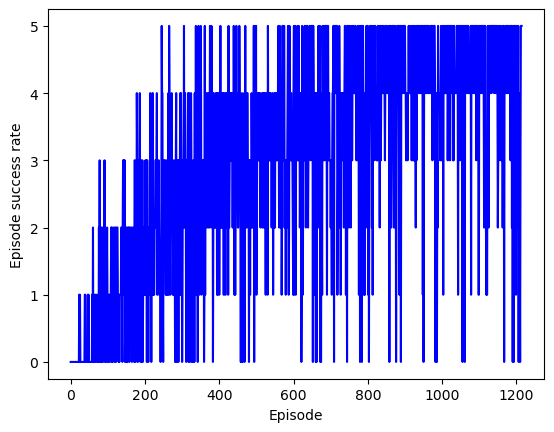

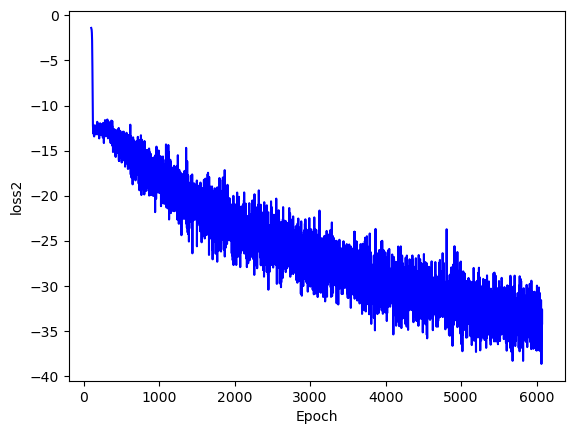

***** epoch 243 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 99467.00628987042
r_em 54756.770590601984
54756.770590601984
ReWard2/R0 10.951354118120397
reward2 is: 18.9513541181204
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 1 *****
1/1 [==============================] - 0s 41ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 98959.62738477296
r_em 54009.732055780565
54009.732055780565
ReWard2/R0 10.801946411156113
reward2 is: 18.801946411156113
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 2 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 98800.55859429303
r_em 53515.91548712349
53515.91548712349
ReWard2/R0 10.703183097424699
reward2 is: 18.7031830974247
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 3 *****
1/1 [==============================] - 0s 45ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 99843.60071815399
r_em 54340.18412867589
54340.18412867589
ReWard2/R0 10.868036825735178
reward2 is: 18.868036825735178
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 4 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 101860.54094219665
r_em 53902.164089274826
53902.164089274826
ReWard2/R0 10.780432817854965
reward2 is: 18.780432817854965
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.050224723460888965
***** epoch 243 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 48ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 6 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 7 *****
1/1 [==============================] - 0s 44ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78184.14429302812
r_em 51829.99360285218
51829.99360285218
ReWard2/R0 10.365998720570435
reward2 is: 18.365998720570435
total number 

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 9ms/step
***** frame 8 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 77846.29777507366
r_em 50939.68627301672
50939.68627301672
ReWard2/R0 10.187937254603344
reward2 is: 18.187937254603344
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 9 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82343.90663206278
r_em 50646.971024082864
50646.971024082864
ReWard2/R0 10.129394204816572
reward2 is: 18.12939420481657
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.05009928715128019
***** epoch 243 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 44ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 11 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 5ms/step
***** frame 12 *****
1/1 [==============================] - 0s 47ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89585.3481721441
r_em 53452.37978540976
53452.37978540976
ReWard2/R0 10.69047595708195
reward2 is: 18.69047595708195
total number o

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 13 *****
1/1 [==============================] - 0s 41ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93461.62104269626
r_em 53384.62776972961
53384.62776972961
ReWard2/R0 10.676925553945923
reward2 is: 18.67692555394592
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 14 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93872.97560290826
r_em 54686.04788402538
54686.04788402538
ReWard2/R0 10.937209576805076
reward2 is: 18.937209576805074
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.04997416411901142
***** epoch 243 episode 3 *****
***** frame 15 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 16 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80995.91321049606
r_em 55832.23469745702
55832.23469745702
ReWard2/R0 11.166446939491404
reward2 is: 19.166446939491404
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 17 *****
1/1 [==============================] - 0s 43ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 92560.49234228492
r_em 56435.031610521386
56435.031610521386
ReWard2/R0 11.287006322104277
reward2 is: 19.287006322104276
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step
***** frame 18 *****
1/1 [==============================] - 0s 43ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 93787.54026702183
r_em 57027.9433475652
57027.9433475652
ReWard2/R0 11.405588669513039
reward2 is: 19.405588669513037
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step
***** frame 19 *****
1/1 [==============================] - 0s 48ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: opti

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 21 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90874.15500553921
r_em 57128.771315353
57128.771315353
ReWard2/R0 11.4257542630706
reward2 is: 19.4257542630706
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 22 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92346.0022561155
r_em 56923.729439757946
56923.729439757946
ReWard2/R0 11.384745887951588
reward2 is: 19.38474588795159
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 23 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92574.14283513208
r_em 56734.04021877965
56734.04021877965
ReWard2/R0 11.34680804375593
reward2 is: 19.346808043755928
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 24 *****
1/1 [==============================] - 0s 45ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93404.46757378161
r_em 57203.00252676095
57203.00252676095
ReWard2/R0 11.44060050535219
reward2 is: 19.44060050535219
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.04972485475880578


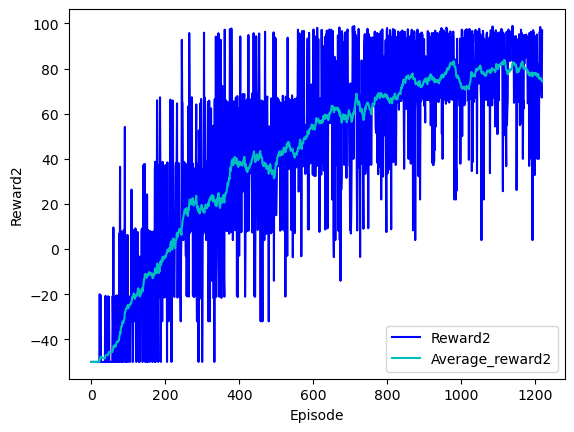

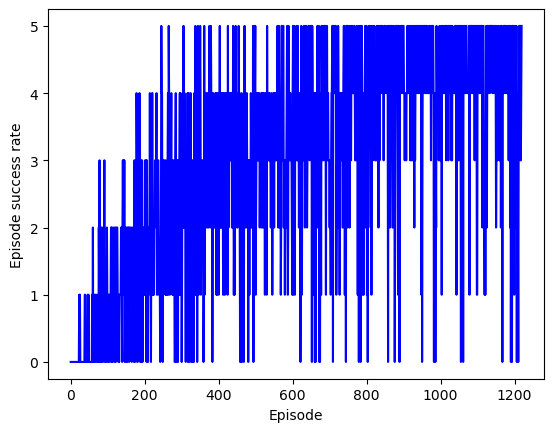

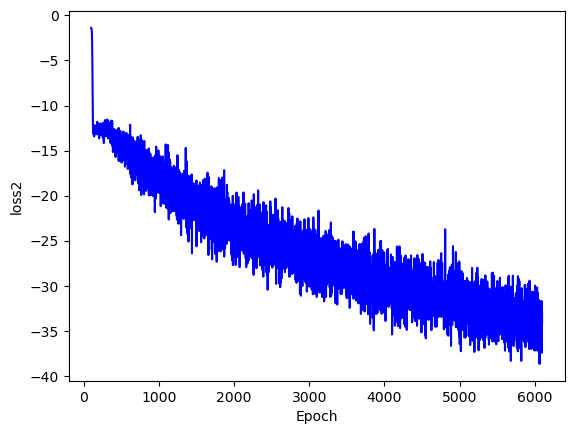

***** epoch 244 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.125
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 1 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 9ms/step
***** frame 2 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85276.81884962057
r_em 55783.82824662794
55783.82824662794
ReWard2/R0 11.156765649325589
reward2 is: 19.15676564932559
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 3 *****
1/1 [==============================] - 0s 48ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84350.90979514288
r_em 55360.45056339532
55360.45056339532
ReWard2/R0 11.072090112679065
reward2 is: 19.072090112679064
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 4 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85738.63649037723
r_em 55003.539010230415
55003.539010230415
ReWard2/R0 11.000707802046083
reward2 is: 19.000707802046083
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.04960066687190514
***** epoch 244 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85062.27000801318
r_em 54042.51317111418
54042.51317111418
ReWard2/R0 10.808502634222837
reward2 is: 18.808502634222837
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 6 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84902.22872104049
r_em 54502.23272171345
54502.23272171345
ReWard2/R0 10.90044654434269
reward2 is: 18.900446544342692
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 9ms/step
***** frame 7 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83014.96772653318
r_em 54751.637488033986
54751.637488033986
ReWard2/R0 10.950327497606798
reward2 is: 18.9503274976068
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 8 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88890.02616398135
r_em 55137.54394883743
55137.54394883743
ReWard2/R0 11.027508789767486
reward2 is: 19.027508789767488
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 9 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90349.7514785044
r_em 54481.387648148884
54481.387648148884
ReWard2/R0 10.896277529629776
reward2 is: 18.896277529629778
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 9ms/step
Epsilon_hist is: 0.049476789144407236
***** epoch 244 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 40ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89068.8006419308
r_em 56799.877969001456
56799.877969001456
ReWard2/R0 11.359975593800291
reward2 is: 19.359975593800293
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 11 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93821.09115559455
r_em 56880.858139726115
56880.858139726115
ReWard2/R0 11.376171627945222
reward2 is: 19.376171627945222
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 9ms/step
***** frame 12 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92671.8847867192
r_em 55691.38960559673
55691.38960559673
ReWard2/R0 11.138277921119345
reward2 is: 19.138277921119347
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 13 *****
1/1 [==============================] - 0s 43ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92369.52152957975
r_em 55925.05389216952
55925.05389216952
ReWard2/R0 11.185010778433904
reward2 is: 19.185010778433906
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 14 *****
1/1 [==============================] - 0s 39ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90924.9580680862
r_em 55365.89997727607
55365.89997727607
ReWard2/R0 11.073179995455215
reward2 is: 19.073179995455213
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 10ms/step
Epsilon_hist is: 0.049353220801688566
***** epoch 244 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 44ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 90575.26152898025
r_em 55305.91431869997
55305.91431869997
ReWard2/R0 11.061182863739994
reward2 is: 19.061182863739994
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step
***** frame 16 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 90239.93931069793
r_em 55345.18407275283
55345.18407275283
ReWard2/R0 11.069036814550566
reward2 is: 19.069036814550564
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step
***** frame 17 *****
1/1 [==============================] - 0s 32ms/step

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 21 *****
1/1 [==============================] - 0s 44ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 22 *****
1/1 [==============================] - 0s 46ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 85552.67345669004
r_em 54572.90758628194
54572.90758628194
ReWard2/R0 10.914581517256387
reward2 is: 18.914581517256387
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 23 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 8ms/step
***** frame 24 *****
1/1 [==============================] - 0s 40ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88122.70023280504
r_em 53977.64676222959
53977.64676222959
ReWard2/R0 10.795529352445918
reward2 is: 18.795529352445918
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.04910700918176323


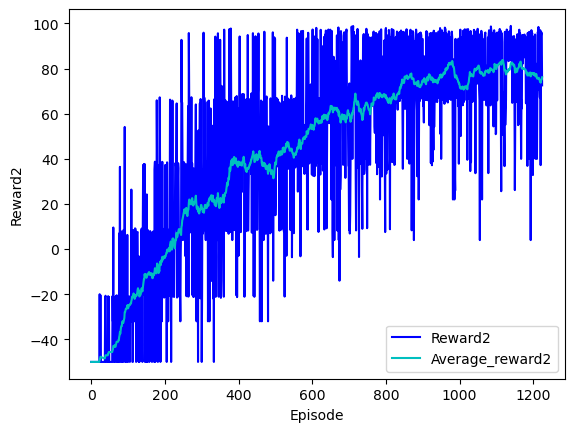

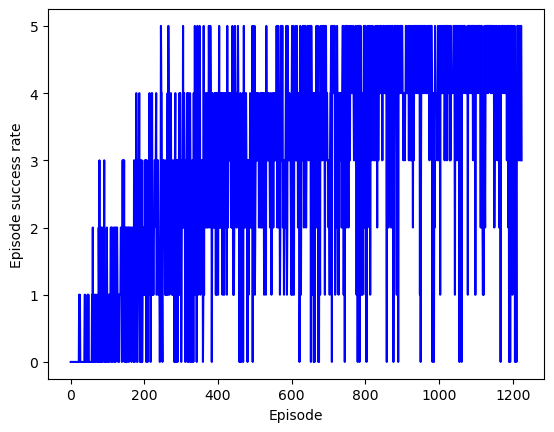

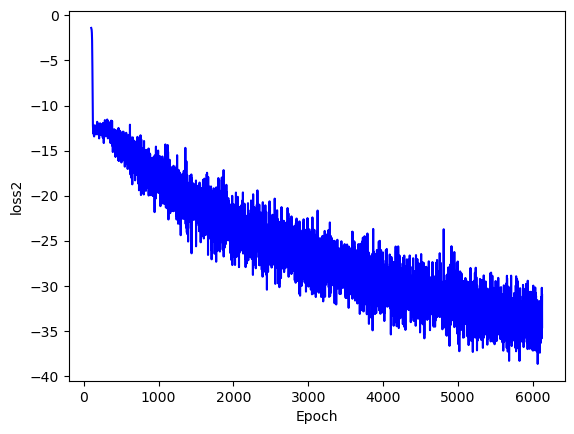

***** epoch 245 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 97214.88508994307
r_em 59761.42569160325
59761.42569160325
ReWard2/R0 11.952285138320649
reward2 is: 19.952285138320647
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step
***** frame 1 *****
1/1 [==============================] - 0s 45ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 98158.67708330341
r_em 58055.227388900894
58055.227388900894
ReWard2/R0 11.611045477780179
reward2 is: 19.61104547778018
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 10ms/step
***** frame 2 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 3 *****
1/1 [==============================] - 0s 39ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 98007.20106536895
r_em 57881.1172390968
57881.1172390968
ReWard2/R0 11.576223447819359
reward2 is: 19.57622344781936
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 4 *****
1/1 [==============================] - 0s 40ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 99182.4109948403
r_em 58474.439367863226
58474.439367863226
ReWard2/R0 11.694887873572645
reward2 is: 19.694887873572647
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.048984364364963374
***** epoch 245 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89848.08140314824
r_em 58326.3922787043
58326.3922787043
ReWard2/R0 11.665278455740859
reward2 is: 19.66527845574086
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 6 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90817.91155478942
r_em 58197.57220905952
58197.57220905952
ReWard2/R0 11.639514441811905
reward2 is: 19.639514441811905
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 7 *****
1/1 [==============================] - 0s 42ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 91725.10872386963
r_em 58517.41745284018
58517.41745284018
ReWard2/R0 11.703483490568036
reward2 is: 19.703483490568036
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 8 *****
1/1 [==============================] - 0s 41ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92337.38350082742
r_em 58395.101293814114
58395.101293814114
ReWard2/R0 11.679020258762822
reward2 is: 19.679020258762822
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 9ms/step
***** frame 9 *****
1/1 [==============================] - 0s 43ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92406.55451851919
r_em 58116.74053306571
58116.74053306571
ReWard2/R0 11.623348106613143
reward2 is: 19.623348106613143
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
Epsilon_hist is: 0.04886202585374675
***** epoch 245 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83076.88597688492
r_em 54774.320714143214
54774.320714143214
ReWard2/R0 10.954864142828642
reward2 is: 18.95486414282864
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 11 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 79292.53863923185
r_em 52092.30574747794
52092.30574747794
ReWard2/R0 10.418461149495588
reward2 is: 18.418461149495588
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 12 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 78369.98487595044
r_em 52667.807303958
52667.807303958
ReWard2/R0 10.5335614607916
reward2 is: 18.5335614607916
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 13 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80732.3143851774
r_em 53238.02934313097
53238.02934313097
ReWard2/R0 10.647605868626194
reward2 is: 18.647605868626194
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 14 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80811.95364168772
r_em 53071.84465450181
53071.84465450181
ReWard2/R0 10.614368930900362
reward2 is: 18.614368930900362
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 10ms/step
Epsilon_hist is: 0.048739992883114765
***** epoch 245 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 40ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87462.12807933056
r_em 54109.17372070903
54109.17372070903
ReWard2/R0 10.821834744141805
reward2 is: 18.821834744141803
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 16 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90528.75845782267
r_em 53081.392080001286
53081.392080001286
ReWard2/R0 10.616278416000258
reward2 is: 18.616278416000256
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 17 *****
1/1 [==============================] - 0s 48ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89741.86883364395
r_em 54283.61012134779
54283.61012134779
ReWard2/R0 10.856722024269558
reward2 is: 18.85672202426956
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 18 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88977.39382051975
r_em 55429.250837591746
55429.250837591746
ReWard2/R0 11.08585016751835
reward2 is: 19.085850167518352
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 9ms/step
***** frame 19 *****
1/1 [==============================] - 0s 41ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 87489.02875849893
r_em 55850.929170265495
55850.929170265495
ReWard2/R0 11.170185834053099
reward2 is: 19.1701858340531
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.04861826468997943
***** epoch 245 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 47ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81008.64150290778
r_em 54181.247816702285
54181.247816702285
ReWard2/R0 10.836249563340457
reward2 is: 18.83624956334046
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 21 *****
1/1 [==============================] - 0s 41ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80536.5123316142
r_em 53670.7404774934
53670.7404774934
ReWard2/R0 10.734148095498679
reward2 is: 18.73414809549868
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 22 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80006.69397726367
r_em 55132.167643672874
55132.167643672874
ReWard2/R0 11.026433528734575
reward2 is: 19.026433528734575
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 23 *****
1/1 [==============================] - 0s 40ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81494.25256124856
r_em 55856.62023074097
55856.62023074097
ReWard2/R0 11.171324046148193
reward2 is: 19.171324046148193
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 24 *****
1/1 [==============================] - 0s 50ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81287.5049276675
r_em 56741.24363644923
56741.24363644923
ReWard2/R0 11.348248727289846
reward2 is: 19.348248727289846
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.04849684051315858


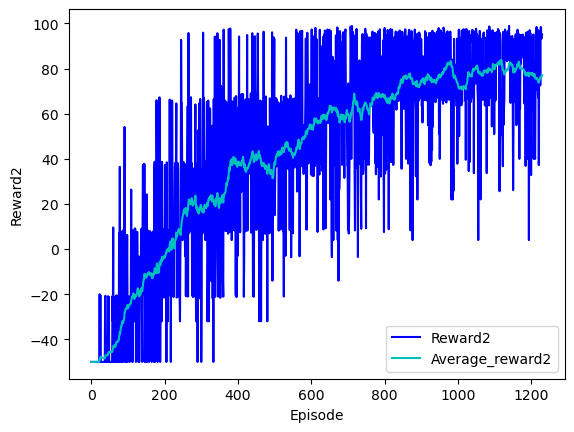

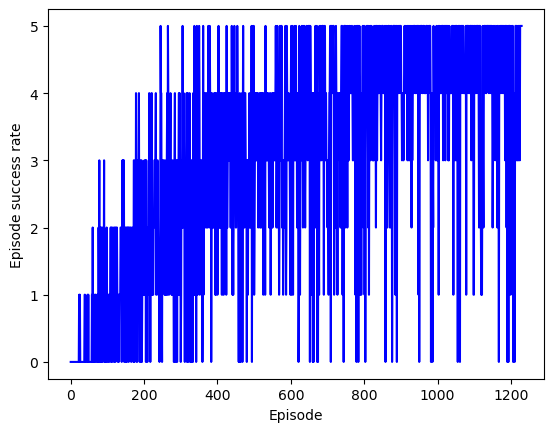

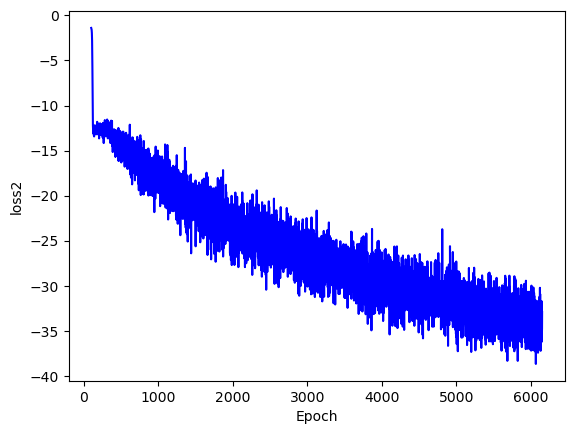

***** epoch 246 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 43ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 91874.78572630658
r_em 53780.28358210008
53780.28358210008
ReWard2/R0 10.756056716420016
reward2 is: 18.756056716420016
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step
***** frame 1 *****
1/1 [==============================] - 0s 40ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88279.45073187904
r_em 53969.861737619394
53969.861737619394
ReWard2/R0 10.793972347523878
reward2 is: 18.793972347523876
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 2 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.0
reward2 is: -10
total number of ur2 RBs: 0.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 3 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 89707.66334752139
r_em 53150.586718269
53150.586718269
ReWard2/R0 10.630117343653799
reward2 is: 18.6301173436538
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step
***** frame 4 *****
1/1 [==============================] - 0s 27ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 89535.88788305063
r_em 53247.96651402509
53247.96651402509
ReWard2/R0 10.649593302805018
reward2 is: 18.649593302805016
total numbe

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 6 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95481.32866725157
r_em 55505.25234022367
55505.25234022367
ReWard2/R0 11.101050468044734
reward2 is: 19.101050468044733
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 7 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95135.10188514914
r_em 55546.76991883151
55546.76991883151
ReWard2/R0 11.109353983766303
reward2 is: 19.109353983766304
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 10ms/step
***** frame 8 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94880.88425590946
r_em 55472.2773307094
55472.2773307094
ReWard2/R0 11.09445546614188
reward2 is: 19.09445546614188
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 9 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94549.51690029574
r_em 55924.27848638542
55924.27848638542
ReWard2/R0 11.184855697277083
reward2 is: 19.184855697277083
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
Epsilon_hist is: 0.048254901173232105
***** epoch 246 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92981.45372790484
r_em 57515.28970464552
57515.28970464552
ReWard2/R0 11.503057940929104
reward2 is: 19.503057940929104
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 11 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93934.64143430843
r_em 56932.68561987944
56932.68561987944
ReWard2/R0 11.386537123975888
reward2 is: 19.386537123975888
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 12 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 92763.63307700127
r_em 57518.66095117709
57518.66095117709
ReWard2/R0 11.503732190235418
reward2 is: 19.503732190235418
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 13 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94789.16759556092
r_em 57280.160832802896
57280.160832802896
ReWard2/R0 11.456032166560579
reward2 is: 19.45603216656058
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 14 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94196.46960795873
r_em 56932.388249823984
56932.388249823984
ReWard2/R0 11.386477649964796
reward2 is: 19.386477649964796
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.04813438449724842
***** epoch 246 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93000.59565451455
r_em 54129.543675759676
54129.543675759676
ReWard2/R0 10.825908735151936
reward2 is: 18.825908735151934
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 16 *****
1/1 [==============================] - 0s 48ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93538.11826797052
r_em 54709.3966645482
54709.3966645482
ReWard2/R0 10.94187933290964
reward2 is: 18.94187933290964
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 17 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 94057.59596700458
r_em 54938.150204737896
54938.150204737896
ReWard2/R0 10.987630040947579
reward2 is: 18.98763004094758
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 18 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 19 *****
1/1 [==============================] - 0s 39ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 93071.53061771925
r_em 55437.93845274832
55437.93845274832
ReWard2/R0 11.087587690549665
reward2 is: 19.087587690549665
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.04801416881181362
***** epoch 246 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 50ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95679.62152450021
r_em 51478.14413833808
51478.14413833808
ReWard2/R0 10.295628827667617
reward2 is: 18.295628827667617
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 9ms/step
***** frame 21 *****
1/1 [==============================] - 0s 42ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95608.66979131287
r_em 52112.435385676625
52112.435385676625
ReWard2/R0 10.422487077135324
reward2 is: 18.422487077135322
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 22 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95316.37396404763
r_em 53607.44868377249
53607.44868377249
ReWard2/R0 10.721489736754497
reward2 is: 18.7214897367545
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 23 *****
1/1 [==============================] - 0s 30ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95146.08438987196
r_em 53862.39691618464
53862.39691618464
ReWard2/R0 10.772479383236927
reward2 is: 18.772479383236927
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 24 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 95733.84779442099
r_em 54078.6069720855
54078.6069720855
ReWard2/R0 10.8157213944171
reward2 is: 18.8157213944171
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.047894253365203414


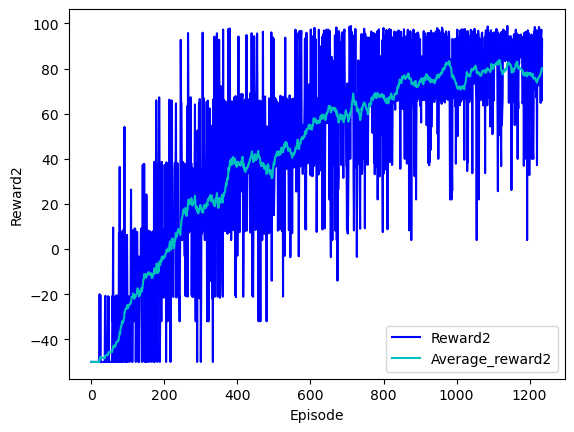

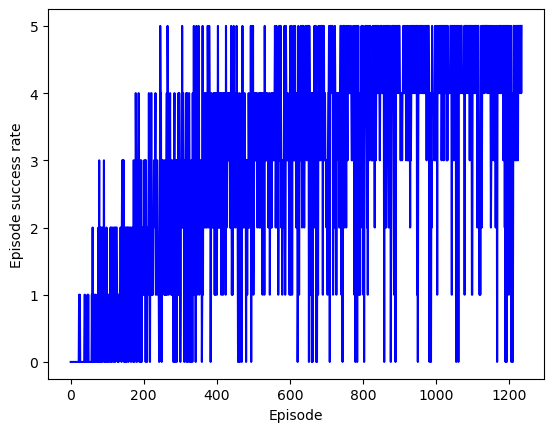

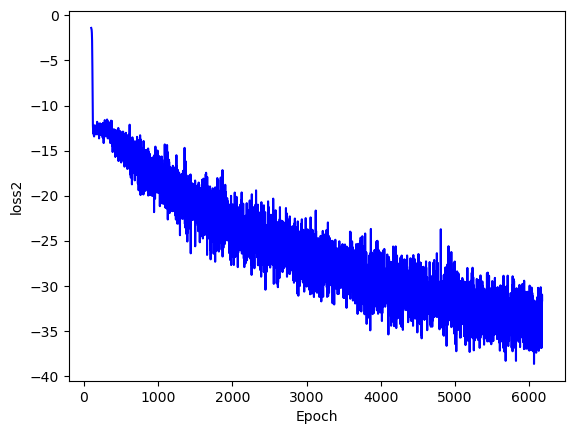

***** epoch 247 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 3.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 8ms/step
***** frame 1 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89907.42673568119
r_em 52954.05154726666
52954.05154726666
ReWard2/R0 10.590810309453332
reward2 is: 18.59081030945333
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 2 *****
1/1 [==============================] - 0s 40ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88237.84850750312
r_em 51306.633762692865
51306.633762692865
ReWard2/R0 10.261326752538572
reward2 is: 18.261326752538572
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 9ms/step
***** frame 3 *****
1/1 [==============================] - 0s 28ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88195.07120654953
r_em 49553.11921537483
49553.11921537483
ReWard2/R0 9.910623843074966
reward2 is: 17.910623843074966
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 4 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 99372.31235990293
r_em 50251.06432962539
50251.06432962539
ReWard2/R0 10.050212865925078
reward2 is: 18.050212865925076
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.04777463740757098
***** epoch 247 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 42ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 8ms/step
***** frame 6 *****
1/1 [==============================] - 0s 44ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
tota

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 16 *****
1/1 [==============================] - 0s 41ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 8ms/step
***** frame 17 *****
1/1 [==============================] - 0s 45ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 101050.17769369218
r_em 56506.41574695748
56506.41574695748
ReWard2/R0 11.301283149391496
reward2 is: 19.301283149391494
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 18 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 101956.2860839609
r_em 56160.95618824616
56160.95618824616
ReWard2/R0 11.232191237649232
reward2 is: 19.232191237649232
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 19 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 103216.05861529778
r_em 55726.4429169674
55726.4429169674
ReWard2/R0 11.14528858339348
reward2 is: 19.14528858339348
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.04741757899813498
***** epoch 247 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81651.1597436933
r_em 57326.335411235705
57326.335411235705
ReWard2/R0 11.465267082247141
reward2 is: 19.46526708224714
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 21 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83400.09670318394
r_em 57202.16311988813
57202.16311988813
ReWard2/R0 11.440432623977626
reward2 is: 19.440432623977628
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 22 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81948.74830577685
r_em 56942.06984397567
56942.06984397567
ReWard2/R0 11.388413968795133
reward2 is: 19.388413968795135
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 23 *****
1/1 [==============================] - 0s 40ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84133.28380279544
r_em 56756.12279709012
56756.12279709012
ReWard2/R0 11.351224559418023
reward2 is: 19.35122455941802
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 24 *****
1/1 [==============================] - 0s 48ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81980.96301082254
r_em 57032.740910886154
57032.740910886154
ReWard2/R0 11.40654818217723
reward2 is: 19.406548182177232
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.04729915353532999


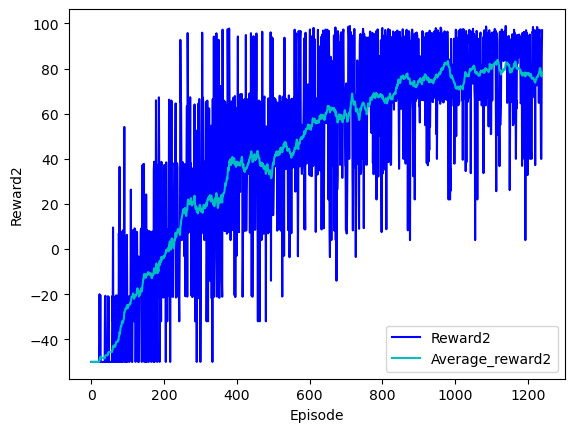

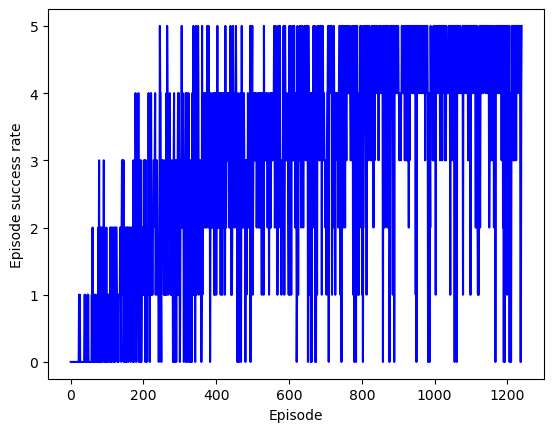

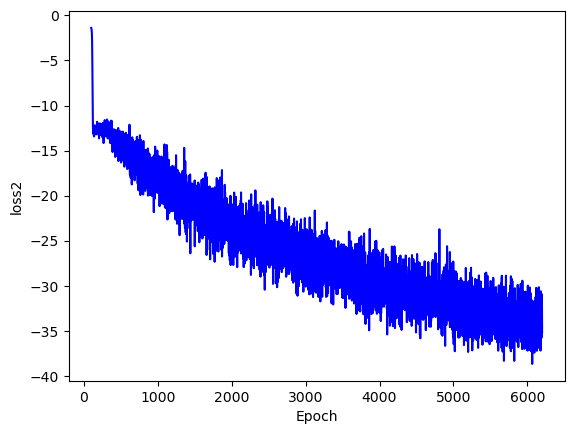

***** epoch 248 episode 0 *****
***** frame 0 *****
1/1 [==============================] - 0s 47ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82095.72089403043
r_em 52722.9144640356
52722.9144640356
ReWard2/R0 10.54458289280712
reward2 is: 18.54458289280712
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 1 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82136.07360188317
r_em 52813.71790930518
52813.71790930518
ReWard2/R0 10.562743581861037
reward2 is: 18.562743581861035
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 2 *****
1/1 [==============================] - 0s 42ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80958.6795294289
r_em 53591.16473382446
53591.16473382446
ReWard2/R0 10.718232946764891
reward2 is: 18.718232946764893
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 3 *****
1/1 [==============================] - 0s 43ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80818.29261569012
r_em 52617.33543985666
52617.33543985666
ReWard2/R0 10.523467087971332
reward2 is: 18.523467087971333
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 4 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81397.1709066403
r_em 51357.26537345755
51357.26537345755
ReWard2/R0 10.271453074691511
reward2 is: 18.27145307469151
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.04718102384026636
***** epoch 248 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 6 *****
1/1 [==============================] - 0s 35ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 7 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: non_feasible
ReWard2/R0 0.0
reward2 is: 8.0
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 8ms/step
****

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.047063189174263775
***** epoch 248 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 36ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84703.19326583832
r_em 55837.408665634204
55837.408665634204
ReWard2/R0 11.167481733126841
reward2 is: 19.16748173312684
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 11 *****
1/1 [==============================] - 0s 44ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87071.49320246276
r_em 55791.29759840135
55791.29759840135
ReWard2/R0 11.15825951968027
reward2 is: 19.15825951968027
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 12 *****
1/1 [==============================] - 0s 40ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87693.0417277631
r_em 54855.83467490329
54855.83467490329
ReWard2/R0 10.971166934980658
reward2 is: 18.97116693498066
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
***** frame 13 *****
1/1 [==============================] - 0s 33ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88703.66613093545
r_em 54405.112539183225
54405.112539183225
ReWard2/R0 10.881022507836645
reward2 is: 18.881022507836647
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 14 *****
1/1 [==============================] - 0s 45ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88558.84468003834
r_em 53538.43634303751
53538.43634303751
ReWard2/R0 10.707687268607502
reward2 is: 18.7076872686075
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.04694564880048679
***** epoch 248 episode 3 *****
***** frame 15 *****
1/1 [==============================] - 0s 44ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 84161.33075436829
r_em 55794.44985999462
55794.44985999462
ReWard2/R0 11.158889971998923
reward2 is: 19.158889971998924
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 16 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81892.08539907567
r_em 56083.65427241449
56083.65427241449
ReWard2/R0 11.216730854482897
reward2 is: 19.216730854482897
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 17 *****
1/1 [==============================] - 0s 29ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 80163.16234388546
r_em 55564.70598461148
55564.70598461148
ReWard2/R0 11.112941196922296
reward2 is: 19.112941196922296
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 18 *****
1/1 [==============================] - 0s 50ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 81430.29320535285
r_em 56417.43069724897
56417.43069724897
ReWard2/R0 11.283486139449794
reward2 is: 19.283486139449792
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 19 *****
1/1 [==============================] - 0s 31ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 83747.79957427135
r_em 56021.35338081417
56021.35338081417
ReWard2/R0 11.204270676162835
reward2 is: 19.204270676162835
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.046828401983940185
***** epoch 248 episode 4 *****
***** frame 20 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89961.95887109672
r_em 55110.653503107635
55110.653503107635
ReWard2/R0 11.022130700621528
reward2 is: 19.022130700621528
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 21 *****
1/1 [==============================] - 0s 46ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89574.67590531356
r_em 54733.657964126105
54733.657964126105
ReWard2/R0 10.946731592825222
reward2 is: 18.946731592825223
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 22 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.5
reward2 is: -10
total number of ur2 RBs: 4.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 23 *****
1/1 [==============================] - 0s 47ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90750.46920968042
r_em 54837.77302529001
54837.77302529001
ReWard2/R0 10.967554605058002
reward2 is: 18.967554605058
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
***** frame 24 *****
1/1 [==============================] - 0s 43ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 89841.27665261002
r_em 56231.80887060194
56231.80887060194
ReWard2/R0 11.246361774120388
reward2 is: 19.246361774120388
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 6ms/step
Epsilon_hist is: 0.04671144799146444


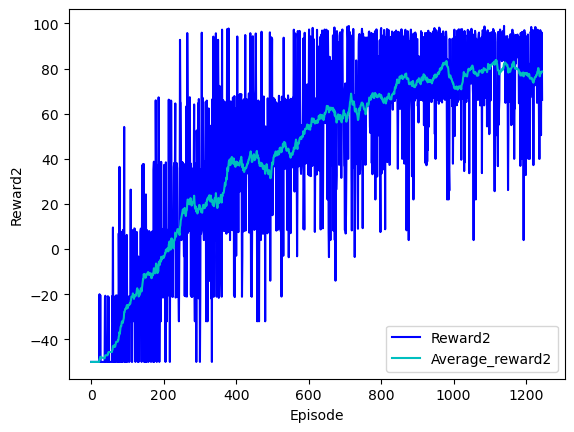

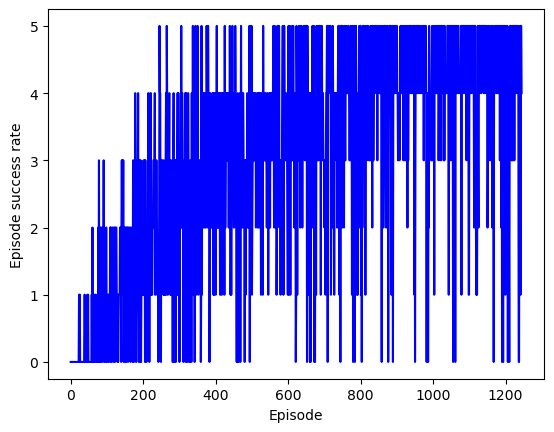

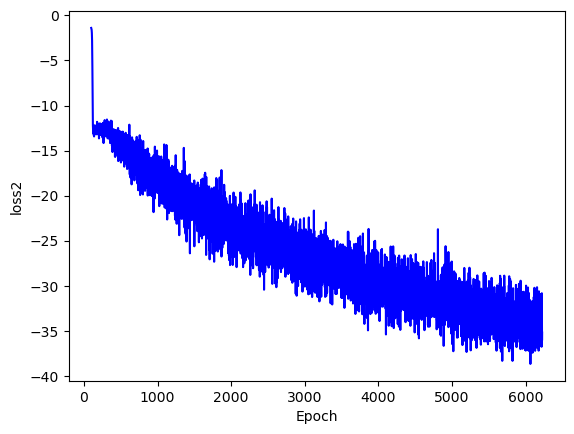

***** epoch 249 episode 0 *****
***** frame 0 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.25
reward2 is: -10
total number of ur2 RBs: 1.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 6ms/step
***** frame 1 *****
1/1 [==============================] - 0s 58ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88425.67644405508
r_em 55126.76333687764
55126.76333687764
ReWard2/R0 11.025352667375527
reward2 is: 19.02535266737553
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 6ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 5ms/step
***** frame 2 *****
1/1 [==============================] - 0s 59ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 88485.27122810564
r_em 54991.86954462114
54991.86954462114
ReWard2/R0 10.99837390892423
reward2 is: 18.99837390892423
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 3 *****
1/1 [==============================] - 0s 38ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86904.70929368588
r_em 54853.598427844736
54853.598427844736
ReWard2/R0 10.970719685568946
reward2 is: 18.970719685568945
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 4 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 86245.61176435798
r_em 54417.878860840516
54417.878860840516
ReWard2/R0 10.883575772168102
reward2 is: 18.8835757721681
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
Epsilon_hist is: 0.04659478609173106
***** epoch 249 episode 1 *****
***** frame 5 *****
1/1 [==============================] - 0s 40ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 87557.32462337986
r_em 54056.29773687856
54056.29773687856
ReWard2/R0 10.81125954737571
reward2 is: 18.811259547375712
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 6 *****
1/1 [==============================] - 0s 32ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal
r_ur 88503.67816409733
r_em 52641.73316498877
52641.73316498877
ReWard2/R0 10.528346632997755
reward2 is: 18.528346632997753
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 8ms/step
***** frame 7 *****
we choose action2 with: explore
e_ur2 [3. 3.]
OooooOps ...  e_ur2 is not met!!!!
OooooOps ...  e_ur2 is not met!!!!
t_ur 0.375
reward2 is: -10
total number of ur2 RBs: 2.0
total number of em2 RBs: 10.0
4/4 [==============================] - 0s 7ms/step
***** frame 8 *****
1/1 [==============================] - 0s 39ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90460.23593438686
r_em 52094.63260452458
52094.63260452458
ReWard2/R0 10.418926520904916
reward2 is: 18.41892652

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 9 *****
1/1 [==============================] - 0s 41ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 90896.20773325098
r_em 52696.982838096585
52696.982838096585
ReWard2/R0 10.539396567619317
reward2 is: 18.539396567619317
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 8ms/step
Epsilon_hist is: 0.04647841555523806
***** epoch 249 episode 2 *****
***** frame 10 *****
1/1 [==============================] - 0s 45ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82374.63715731209
r_em 55964.07787927985
55964.07787927985
ReWard2/R0 11.19281557585597
reward2 is: 19.19281557585597
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 7ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 11 *****
1/1 [==============================] - 0s 34ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82315.197266366
r_em 56419.07366189308
56419.07366189308
ReWard2/R0 11.283814732378616
reward2 is: 19.283814732378616
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 12 *****
1/1 [==============================] - 0s 37ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82504.19173850155
r_em 55581.412351355546
55581.412351355546
ReWard2/R0 11.11628247027111
reward2 is: 19.11628247027111
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
1/4 [======>.......................] - ETA: 0s

C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 7ms/step
***** frame 13 *****
1/1 [==============================] - 0s 40ms/step
we choose action2 with: exploit
e_ur2 [3. 3.]
t_ur 0.5
Output is: optimal_inaccurate
r_ur 82909.55006609863
r_em 55230.88818567175
55230.88818567175
ReWard2/R0 11.046177637134349
reward2 is: 19.04617763713435
total number of ur2 RBs: 8.0
total number of em2 RBs: 10.0
Yesss, you can... :)
4/4 [==============================] - 0s 13ms/step


C:\Users\fatemeh.kavehmadavan\AppData\Local\anaconda3\lib\site-packages\cvxpy\problems\problem.py:1385: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


4/4 [==============================] - 0s 13ms/step


In [ ]:
# Main Code for frq_domain
def binary_action(action):
    pi_ur2 = np.zeros((M, U_ur, f2, t2))
    pi_em1 = np.zeros((M, U_em, f1, t1))
    s2, s1 = action[0:dim2], action[dim2::]
    c2, c1 = np.zeros((M, U_ur, f2, t2)), np.zeros((M, U_em, f1, t1))
    
    for i, idx in enumerate(range(0, dim2, M*U_ur)):
        bb = s2[idx:idx+M*U_ur].reshape(M, U_ur, order='F')
        c2[:,:,i // t2, i % t2] = bb               
    for u in range(U_ur):
        pi_ur2[:,u,:,:] = c2[:,u,:,:]
    for i, idx in enumerate(range(0, dim1, M*U_em)):
        bb = s1[idx:idx+M*U_em].reshape(M, U_em, order='F')
        c1[:,:,i // t1, i % t1] = bb    
    for u in range(U_em):
        pi_em1[:,u,:,:] = c1[:,u,:,:]
        
    return pi_ur2, pi_em1

if __name__ == '__main__':
    
    start_time = datetime.now()
    
    Max_epoch = 20000
    Max_episode = 5
    Max_frame = 5 
    batch_size = 100
        
    ddqn_agent = DDQNAgent_frq(alpha=0.001, gamma=0.99, epsilon=1.0, batch_size= 100,
                               n_actions2=nA, input_dims2=nS)
    
    Score_episode2, Avg_Score_episode2, Score_epoch2, Avg_Score_epoch2 = [], [], [], []
    Epsilon_hist, LOSS2, COUNTER = [], [], []

    for epoch in range(Max_epoch):
        SCORE2 = 0
        
        for episode in range(Max_episode):
            print("***** epoch", epoch, 'episode', episode, "*****")
            
            #reset env
            start_frame = Max_frame*episode
            end_frame = Max_frame*episode + Max_frame
            state2, H_ur2, H_em1, pl_ur2, pl_em1, V,q = initial_frq(start_frame)
            done = False
            score2 = 0
            counter = 0
            
            for frame in range(start_frame, end_frame):
                print("***** frame", frame, "*****") 
                
                action2, mode = ddqn_agent.choose_action2(state2, nS)
                print('we choose action2 with:', mode)
                
                #reshape action to desired shape
                pi_ur2, pi_em1 = binary_action(action2)
                reward2, done, state_2, TEMP, HH_ur2, HH_em1, VV,qq,r_em,t_ur= envornmt_frq(pi_ur2,pi_em1,frame,end_frame,
                                                                                P_max, H_ur2, H_em1, pl_ur2, pl_em1, V,q )
                print('reward2 is:', reward2)
                score2 += reward2
                print('total number of ur2 RBs:', np.sum(pi_ur2))
                print('total number of em2 RBs:', np.sum(pi_em1))
                
                if TEMP == 1:
                    counter +=1
                    print('Yesss, you can... :)')
                
                state2 = state2.reshape(nS,)
                state_2 = state_2.reshape(nS,)
                action2 = action2.reshape(nA,)
                state_mmry = ddqn_agent.remember(state2, action2, reward2, state_2, done)
                
                loss2 = ddqn_agent.learn()
                LOSS2.append(loss2)

                state2 = np.copy(state_2)
                H_ur2,H_em1 = np.copy(HH_ur2),np.copy(HH_em1)
                V, q = np.copy(VV) ,np.copy(qq)
                
            COUNTER.append(counter)
            Score_episode2.append(score2)
            Avg_Score_episode2.append(np.mean(Score_episode2[max(0, len(Score_episode2)-40):(len(Score_episode2)+1)]))
            Epsilon_hist.append(ddqn_agent.epsilon)
            print('Epsilon_hist is:', Epsilon_hist[-1])
            
            if episode % 4 == 0 and episode > 0:
                plt.plot(Score_episode2, color='b')
                plt.plot(Avg_Score_episode2, color='c')
                plt.xlabel("Episode")
                plt.ylabel("Reward2")
                plt.legend(['Reward2', 'Average_reward2'])
                plt.show()
                plt.plot(COUNTER, color='b')
                plt.xlabel("Episode")
                plt.ylabel("Episode success rate")
                plt.show()
                plt.plot(LOSS2, color='b')
                plt.xlabel("Epoch")
                plt.ylabel("loss2")
                plt.show()
 
        SCORE2 += np.mean(Score_episode2[-Max_episode:])
        Score_epoch2.append(SCORE2)
        Avg_Score_epoch2.append(np.mean(Score_epoch2[max(0, epoch-10):(epoch+1)]))

    end_time = datetime.now()
    print('Duration: {}'.format(end_time - start_time))

In [ ]:
np.savetxt("Score_episode2_time.csv", Score_episode2, delimiter=',')
np.savetxt("Avg_Score_episode2_time.csv", Avg_Score_episode2, delimiter=',')

In [ ]:
ddqn_agent.save_model()
# Register the custom activation function
tensorflow.keras.utils.get_custom_objects()['binary_softmax2'] = binary_softmax2
# call trained model
Model_2 = load_model('agent_time.h5')
Model_2.summary()

In [ ]:
start_frame = 0
end_frame = 10

rate_em = []
latency_ur = []
queue = []
P_max= 10**1

state2, H_ur2, H_em1, pl_ur2, pl_em1, V, q= initial_frq(start_frame)

for frame in range(start_frame,end_frame):
    state2 = state2.reshape(1,nS)
    action2 = Model_2.predict(state2)
    #reshape action to desired shape
    pi_ur2, pi_em1 = binary_action(action2[0])
    reward2, done, state_2, TEMP, Hh_ur2, Hh_em1, Vv,qq,r_em,t_ur= envornmt_frq(pi_ur2,pi_em1,frame,end_frame,
                                                                                P_max, H_ur2, H_em1, pl_ur2, pl_em1, V,q )
    print('total number of ur2 RBs:', np.sum(pi_ur2))
    print('total number of em1 RBs:', np.sum(pi_em1))
    print('Flag', TEMP)
    state2 = np.copy(state_2)
    H_ur2,H_em1 = np.copy(Hh_ur2),np.copy(Hh_em1)
    V, q = np.copy(Vv) ,np.copy(qq)
    rate_em.append(np.sum(r_em))
    latency_ur.append(t_ur)
    queue.append(np.sum(qq))
                
print(np.mean(rate_em))
print(np.mean(latency_ur))
print(np.mean(queue))